In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import time
from modelutility_v2 import *

# define folder location
model_name = 'CNN_1.0_Log_Interval'
dir_path = os.getcwd()
log_interval_all = [10,20,30,40,60,80,100,120]
norm_path = os.path.join(dir_path, "data_pred_expanded",'norm_param.npz')
data_folder_parent = os.path.join(dir_path, "data_pred_expanded")
output_folder = os.path.join('models',model_name)

# define model characteristics
width = 24
filter_size = [3,3]
dense_size = 1024
drop_rate = 0.4

# define training time parameters
num_epochs = 100
num_rep = 10
plotting = True
learning_rate = 3e-6
batch_size = 256

In [2]:
# The model
def cnn_33_model(X,X2, y, is_training):
    # CBP sandwich 1
    conv1 = tf.layers.conv2d(
        inputs=X,
        filters=width,
        kernel_size=filter_size,
        padding="same",
        activation=tf.nn.relu)
    bn1 = tf.layers.batch_normalization(inputs=conv1, axis=-1, training = is_training)
    pool1 = tf.layers.max_pooling2d(inputs=bn1, pool_size=[2, 2], strides=2)

    # CBP sandwich 2
    conv3 = tf.layers.conv2d(
        inputs=pool1,
        filters=width*2,
        kernel_size=filter_size,
        padding="same",
        activation=tf.nn.relu)
    bn3 = tf.layers.batch_normalization(inputs=conv3, axis=-1,training = is_training)
    pool2 = tf.layers.max_pooling2d(inputs=bn3, pool_size=[2, 2], strides=2)

    down_rate = 4
        
    # Two fully connected nets
    pool2_flat = tf.reshape(pool2, [-1, int(64/down_rate*64/down_rate*width*2)])
    pool2_flat_aug = tf.concat([pool2_flat,X2],axis=1)
    
    dense1 = tf.layers.dense(inputs=pool2_flat_aug, units=dense_size, activation=tf.nn.relu)
    dropout1 = tf.layers.dropout(inputs=dense1, rate=drop_rate, training = is_training)
    dense2 = tf.layers.dense(inputs=dropout1, units=dense_size, activation=tf.nn.relu)
    dropout2 = tf.layers.dropout(inputs=dense2, rate=drop_rate, training = is_training)
    
    regression = tf.layers.dense(inputs=dropout2, units=1)
    regression = tf.reshape(regression, [-1])
    return regression

In [3]:
def load_data(data_folder, set_name = 'trainval'): 
    
    # define the input filename format
    image_log_name = 'image_log'
    pv_log_name = 'pv_log'
    pv_pred_name = 'pv_pred'
    times_name = 'times'
    
    print('loading data')
    # load PV output and images
    pv_log = np.load(os.path.join(data_folder,pv_log_name+'_'+set_name+'.npy'))
    images = np.load(os.path.join(data_folder,image_log_name+'_'+set_name+'.npy'))
    pv_pred = np.load(os.path.join(data_folder,pv_pred_name+'_'+set_name+'.npy'))
    times = np.load(os.path.join(data_folder,times_name+'_'+set_name+'.npy'))


#     #Side length is important for the model
#     side_len = images_trainval.shape[2]
    
#     ## Data normalization
#     # loading normalization parameter
#     norm_par = np.load(norm_path)
#     pv_mean = norm_par['pv_mean']
#     pv_std = norm_par['pv_std']
    
#     # PV value standardization
#     print('Normalizing pv values')
#     pv_log_trainval  = (pv_log_trainval - pv_mean)/pv_std
#     pv_pred_trainval = (pv_pred_trainval - pv_mean)/pv_std
#     pv_log_test = (pv_log_test - pv_mean)/pv_std
#     pv_pred_test = (pv_pred_test - pv_mean)/pv_std

    # stack up the history and colors into a unified channel
    print('stacking image log\'s channels')
    images = images.transpose((0,2,3,4,1))
    images = images.reshape((images.shape[0],images.shape[1],images.shape[2],-1))

    
    # Shuffling by day blocks
    shuffled_idxs = day_block_shuffle(times)
    return [pv_log[shuffled_idxs],images[shuffled_idxs],pv_pred[shuffled_idxs]] 
    

In [4]:
# Build computational graph
tf.reset_default_graph()  # Reset computational graph

# x,y, pred_y 
x_var = tf.placeholder(tf.float32, [None, 64, 64, 16*3])  # x variable
x2_var = tf.placeholder(tf.float32, [None, 16])
y_var = tf.placeholder(tf.float32, [None])  # y variable
is_training = tf.placeholder(tf.bool) # a flag

pred_y_var = cnn_33_model(x_var,x2_var, y_var, is_training)  # model in use

# loss and other accuracy indicator
loss_var = tf.losses.mean_squared_error(y_var, pred_y_var)  # loss in use
y_var_std = tf.reduce_mean(tf.square(y_var-tf.reduce_mean(y_var)))
rel_err_var = tf.sqrt(loss_var/y_var_std)

# Define optimizer and optimize session parameter
optimizer = tf.train.AdamOptimizer(learning_rate)

# batch normalization in tensorflow requires this extra dependency
# update_ops consist of calculating running average
extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)

# make sure every time during training the moving average is updated
with tf.control_dependencies(extra_update_ops):
    train_step = optimizer.minimize(loss_var)
pass

log interval:  10 seconds
loading data
stacking image log's channels
Training
Iteration 0: with minibatch training loss = 204 and relative error of 1.6
Iteration 20: with minibatch training loss = 127 and relative error of 1.3
Iteration 40: with minibatch training loss = 79.8 and relative error of 1
Iteration 60: with minibatch training loss = 59.4 and relative error of 0.9
Iteration 80: with minibatch training loss = 47.8 and relative error of 0.79
Iteration 100: with minibatch training loss = 33.7 and relative error of 0.67
Iteration 120: with minibatch training loss = 24.5 and relative error of 0.57
Iteration 140: with minibatch training loss = 19.5 and relative error of 0.52
Iteration 160: with minibatch training loss = 20.7 and relative error of 0.53
Iteration 180: with minibatch training loss = 14.9 and relative error of 0.45
Iteration 200: with minibatch training loss = 14.7 and relative error of 0.43
Iteration 220: with minibatch training loss = 14.1 and relative error of 0.41


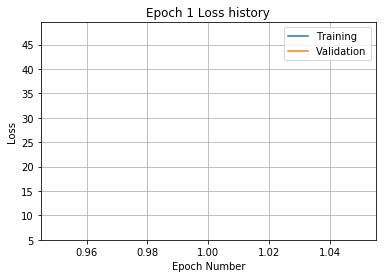

Training
Iteration 0: with minibatch training loss = 13.9 and relative error of 0.43
Iteration 20: with minibatch training loss = 13.2 and relative error of 0.44
Iteration 40: with minibatch training loss = 13.5 and relative error of 0.43
Iteration 60: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 80: with minibatch training loss = 11 and relative error of 0.38
Iteration 100: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 120: with minibatch training loss = 13 and relative error of 0.4
Iteration 140: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 160: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 180: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 200: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.57 and relative error of 0.33
Iteration 240: with minibatch training loss = 11.1 and relative er

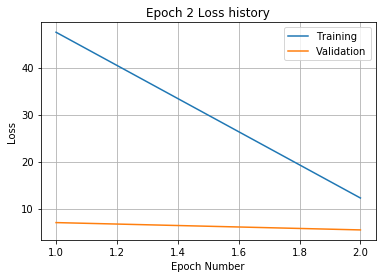

Training
Iteration 0: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 20: with minibatch training loss = 9.52 and relative error of 0.35
Iteration 40: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 60: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 80: with minibatch training loss = 10 and relative error of 0.36
Iteration 100: with minibatch training loss = 9.48 and relative error of 0.35
Iteration 120: with minibatch training loss = 10.3 and relative error of 0.38
Iteration 140: with minibatch training loss = 10.6 and relative error of 0.36
Iteration 160: with minibatch training loss = 11.8 and relative error of 0.37
Iteration 180: with minibatch training loss = 10.8 and relative error of 0.36
Iteration 200: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 220: with minibatch training loss = 9.59 and relative error of 0.37
Iteration 240: with minibatch training loss = 10.3 and relative 

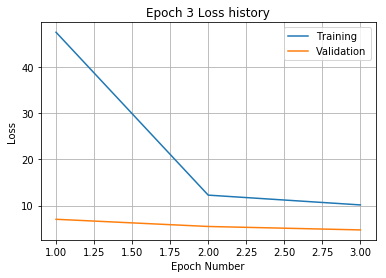

Training
Iteration 0: with minibatch training loss = 7.98 and relative error of 0.33
Iteration 20: with minibatch training loss = 10 and relative error of 0.35
Iteration 40: with minibatch training loss = 8.85 and relative error of 0.35
Iteration 60: with minibatch training loss = 9.47 and relative error of 0.35
Iteration 80: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 120: with minibatch training loss = 9.67 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 180: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 200: with minibatch training loss = 9.9 and relative error of 0.35
Iteration 220: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 240: with minibatch training loss = 11.1 and relative er

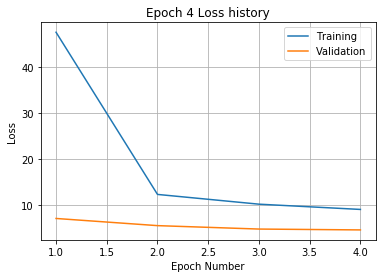

Training
Iteration 0: with minibatch training loss = 7.95 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.05 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.47 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.1 and relative error of 0.32
Iteration 80: with minibatch training loss = 9.55 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.2 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.4 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.07 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.61 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 240: with minibatch training loss = 10.2 and relative er

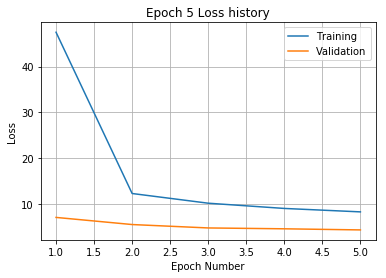

Training
Iteration 0: with minibatch training loss = 8.87 and relative error of 0.36
Iteration 20: with minibatch training loss = 8.02 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.59 and relative error of 0.31
Iteration 60: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 80: with minibatch training loss = 7.86 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 160: with minibatch training loss = 8.86 and relative error of 0.34
Iteration 180: with minibatch training loss = 8.08 and relative error of 0.32
Iteration 200: with minibatch training loss = 9 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 240: with minibatch training loss = 8.19 and relative er

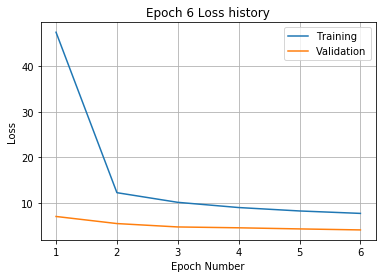

Training
Iteration 0: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.98 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.57 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.78 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 100: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 120: with minibatch training loss = 8.56 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 180: with minibatch training loss = 9.46 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.73 and relative error of 0.36
Iteration 220: with minibatch training loss = 8.83 and relative error of 0.33
Iteration 240: with minibatch training loss = 10.1 and relative 

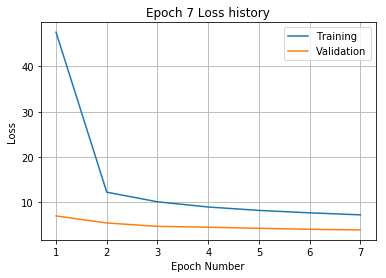

Training
Iteration 0: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.94 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.27 and relative error of 0.36
Iteration 60: with minibatch training loss = 7.38 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.19 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.71 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 240: with minibatch training loss = 8.26 and relativ

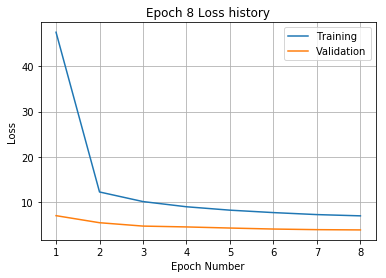

Training
Iteration 0: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 20: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 60: with minibatch training loss = 6 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.8 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.98 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.21 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.61 and relative e

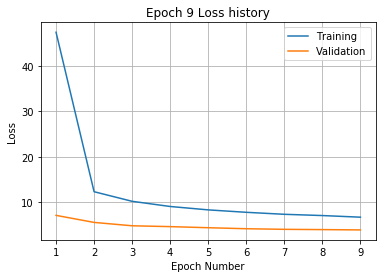

Training
Iteration 0: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.24 and relative error of 0.34
Iteration 120: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.4 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.97 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 220: with minibatch training loss = 5.67 and relative error of 0.26
Iteration 240: with minibatch training loss = 7.16 and relativ

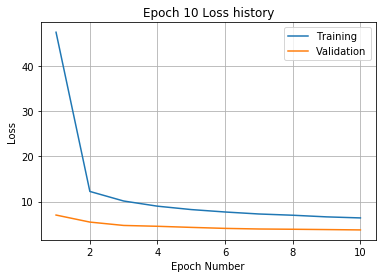

Training
Iteration 0: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.42 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.77 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.59 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.07 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 180: with minibatch training loss = 4 and relative error of 0.22
Iteration 200: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 240: with minibatch training loss = 7.38 and relative 

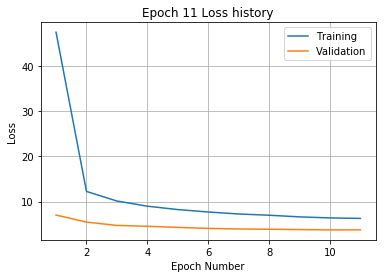

Training
Iteration 0: with minibatch training loss = 6 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.36 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.9 and relative error of 0.34
Iteration 80: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.05 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 220: with minibatch training loss = 3.81 and relative error of 0.22
Iteration 240: with minibatch training loss = 6.24 and relative err

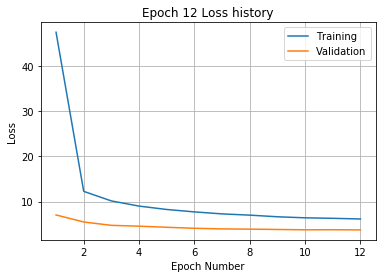

Training
Iteration 0: with minibatch training loss = 4.89 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.42 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.75 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.94 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.19 and relative error of 0.27
Iteration 240: with minibatch training loss = 9.24 and relativ

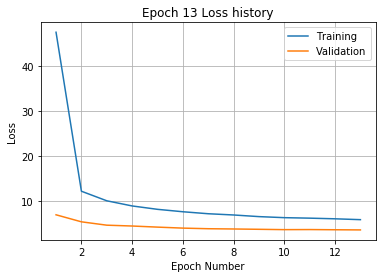

Training
Iteration 0: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.42 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.13 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.3 and relative er

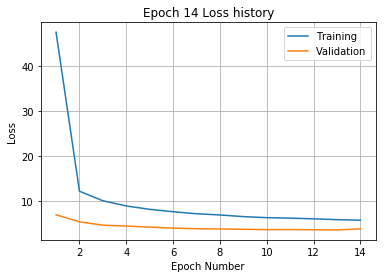

Training
Iteration 0: with minibatch training loss = 3.75 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.22 and relative error of 0.3
Iteration 40: with minibatch training loss = 3.39 and relative error of 0.21
Iteration 60: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 140: with minibatch training loss = 7 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.47 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.5 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.56 and relative erro

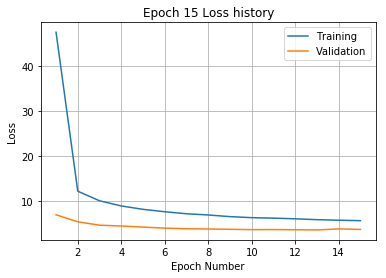

Training
Iteration 0: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 100: with minibatch training loss = 7.33 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.15 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.38 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 240: with minibatch training loss = 6.01 and relativ

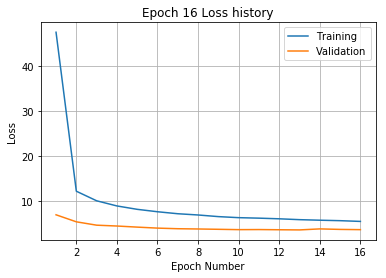

Training
Iteration 0: with minibatch training loss = 3.08 and relative error of 0.19
Iteration 20: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.03 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.11 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.88 and relati

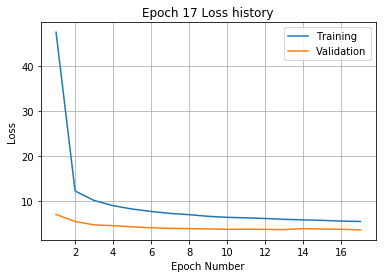

Training
Iteration 0: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 60: with minibatch training loss = 2.98 and relative error of 0.2
Iteration 80: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 180: with minibatch training loss = 2.97 and relative error of 0.2
Iteration 200: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.62 and relative 

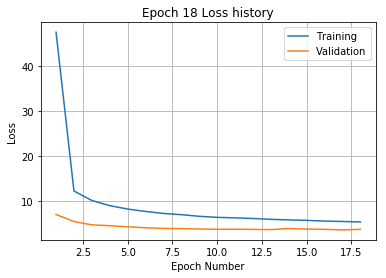

Training
Iteration 0: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 120: with minibatch training loss = 3.74 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.72 and relative error of 0.22
Iteration 180: with minibatch training loss = 3.64 and relative error of 0.21
Iteration 200: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.19 and relativ

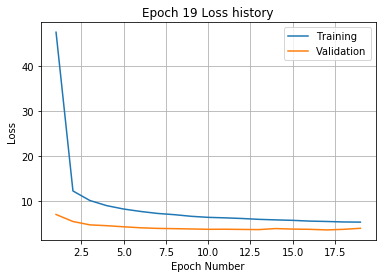

Training
Iteration 0: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 20: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.25 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.32 and relative error of 0.21
Iteration 160: with minibatch training loss = 4.81 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.24 and relative error of 0.23
Iteration 240: with minibatch training loss = 6 and relative er

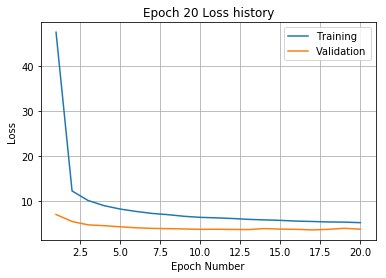

Training
Iteration 0: with minibatch training loss = 4.27 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.58 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.25 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.75 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.06 and relati

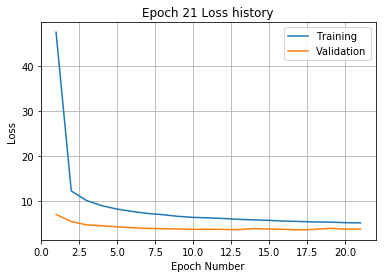

Training
Iteration 0: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 40: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 60: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 100: with minibatch training loss = 3.51 and relative error of 0.21
Iteration 120: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.16 and relative error of 0.22
Iteration 180: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 240: with minibatch training loss = 4.85 and relative 

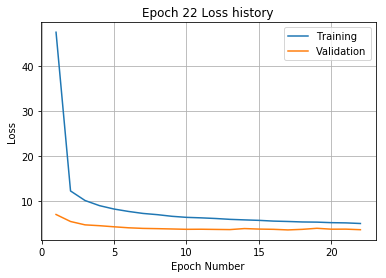

Validation error has stopped improving! Training on repetition 1 stopped!
Training
Iteration 0: with minibatch training loss = 200 and relative error of 1.6
Iteration 20: with minibatch training loss = 108 and relative error of 1.2
Iteration 40: with minibatch training loss = 75.4 and relative error of 1
Iteration 60: with minibatch training loss = 53.6 and relative error of 0.83
Iteration 80: with minibatch training loss = 43 and relative error of 0.74
Iteration 100: with minibatch training loss = 28.1 and relative error of 0.62
Iteration 120: with minibatch training loss = 27.7 and relative error of 0.61
Iteration 140: with minibatch training loss = 22.6 and relative error of 0.53
Iteration 160: with minibatch training loss = 17.4 and relative error of 0.48
Iteration 180: with minibatch training loss = 13.6 and relative error of 0.41
Iteration 200: with minibatch training loss = 14.7 and relative error of 0.43
Iteration 220: with minibatch training loss = 11.9 and relative error of 0

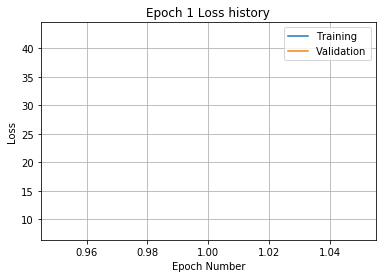

Training
Iteration 0: with minibatch training loss = 16.5 and relative error of 0.47
Iteration 20: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 40: with minibatch training loss = 11.6 and relative error of 0.41
Iteration 60: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 80: with minibatch training loss = 11.9 and relative error of 0.39
Iteration 100: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 120: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 140: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 160: with minibatch training loss = 11.7 and relative error of 0.39
Iteration 180: with minibatch training loss = 13.9 and relative error of 0.41
Iteration 200: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 220: with minibatch training loss = 13.4 and relative error of 0.41
Iteration 240: with minibatch training loss = 9.27 and relative

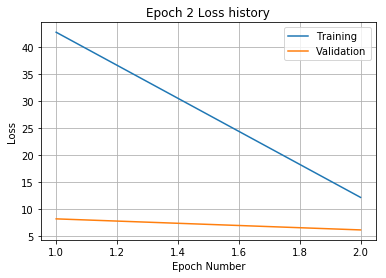

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.38
Iteration 20: with minibatch training loss = 9.91 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.69 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.62 and relative error of 0.34
Iteration 80: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 100: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 120: with minibatch training loss = 8.18 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.67 and relative error of 0.35
Iteration 160: with minibatch training loss = 11 and relative error of 0.38
Iteration 180: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 200: with minibatch training loss = 11.8 and relative error of 0.4
Iteration 220: with minibatch training loss = 9.91 and relative error of 0.38
Iteration 240: with minibatch training loss = 9.68 and relative 

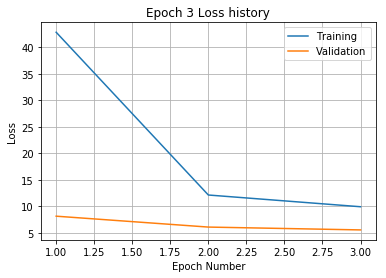

Training
Iteration 0: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 20: with minibatch training loss = 12.6 and relative error of 0.4
Iteration 40: with minibatch training loss = 9.96 and relative error of 0.36
Iteration 60: with minibatch training loss = 8.31 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.57 and relative error of 0.31
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.87 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 200: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 220: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 240: with minibatch training loss = 10.2 and relative e

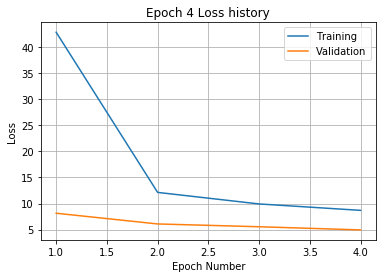

Training
Iteration 0: with minibatch training loss = 7.62 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.98 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.66 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 80: with minibatch training loss = 9.21 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.86 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.16 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 200: with minibatch training loss = 9.14 and relative error of 0.35
Iteration 220: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 240: with minibatch training loss = 8.2 and relative

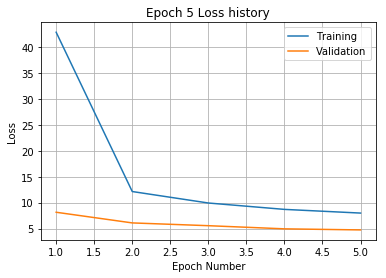

Training
Iteration 0: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.34 and relative error of 0.3
Iteration 40: with minibatch training loss = 8.43 and relative error of 0.34
Iteration 60: with minibatch training loss = 9.74 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.45 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.63 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.3 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.07 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.53 and relative e

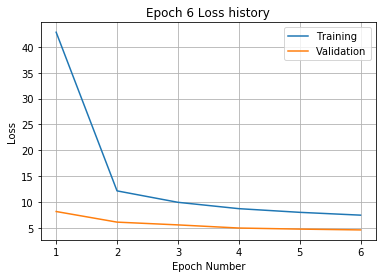

Training
Iteration 0: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 60: with minibatch training loss = 10 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.62 and relative error of 0.34
Iteration 100: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.69 and relative error of 0.26
Iteration 140: with minibatch training loss = 8.25 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.32 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.94 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.32 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 240: with minibatch training loss = 7.49 and relative 

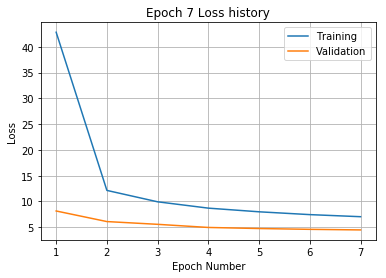

Training
Iteration 0: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 20: with minibatch training loss = 7 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.68 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.57 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.59 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.22 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 200: with minibatch training loss = 9.4 and relative error of 0.33
Iteration 220: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.71 and relative erro

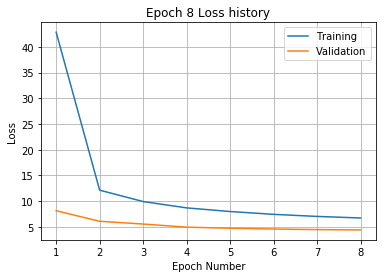

Training
Iteration 0: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.44 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 240: with minibatch training loss = 5.05 and relative e

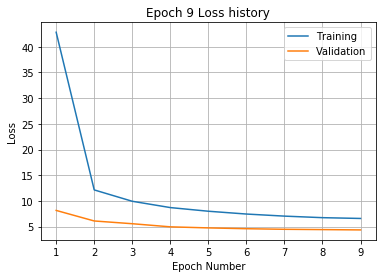

Training
Iteration 0: with minibatch training loss = 3.93 and relative error of 0.22
Iteration 20: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 40: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.15 and relative error of 0.25
Iteration 120: with minibatch training loss = 3.45 and relative error of 0.21
Iteration 140: with minibatch training loss = 8.17 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.33 and relativ

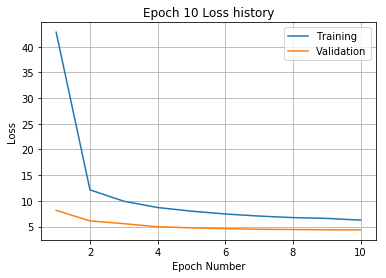

Training
Iteration 0: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.78 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 100: with minibatch training loss = 9.32 and relative error of 0.35
Iteration 120: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.93 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.2 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.86 and relative 

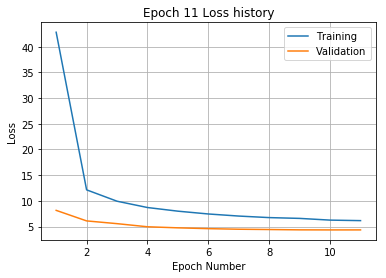

Training
Iteration 0: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.58 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.52 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 240: with minibatch training loss = 4.44 and relative 

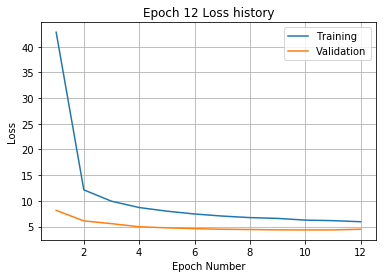

Training
Iteration 0: with minibatch training loss = 8.49 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.6 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.36 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.56 and relativ

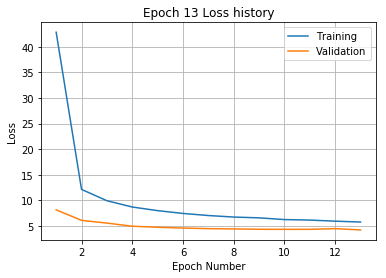

Training
Iteration 0: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 20: with minibatch training loss = 5 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.24 and relative error of 0.27
Iteration 60: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.26 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.76 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.62 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.47 and relative error of 0.33
Iteration 200: with minibatch training loss = 5.56 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.76 and relative error of 0.22
Iteration 240: with minibatch training loss = 3.78 and relative e

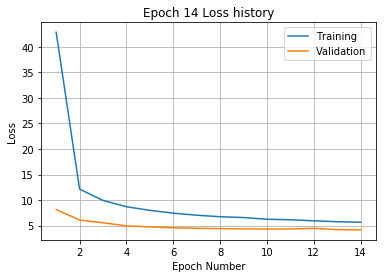

Training
Iteration 0: with minibatch training loss = 3.99 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.34 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.64 and relative error of 0.22
Iteration 240: with minibatch training loss = 5.01 and relativ

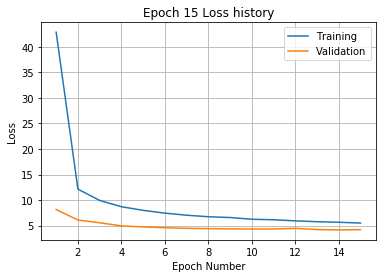

Training
Iteration 0: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.01 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.37 and relative error of 0.23
Iteration 80: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 140: with minibatch training loss = 3.72 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.15 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.86 and relative error of 0.29
Iteration 220: with minibatch training loss = 3.66 and relative error of 0.22
Iteration 240: with minibatch training loss = 6.85 and relati

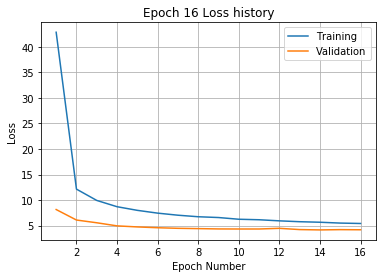

Training
Iteration 0: with minibatch training loss = 8.72 and relative error of 0.33
Iteration 20: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.33 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.09 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.14 and relativ

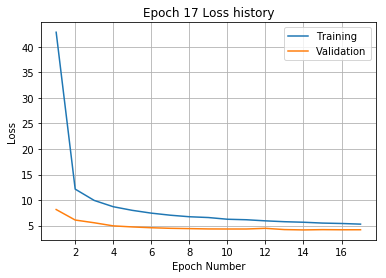

Training
Iteration 0: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 120: with minibatch training loss = 7.16 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.36 and relative error of 0.28
Iteration 180: with minibatch training loss = 5 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.06 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.3 and relative err

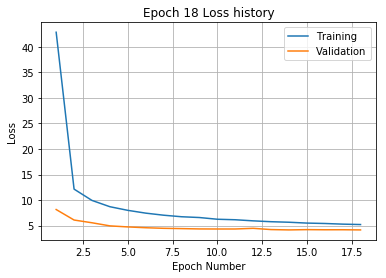

Training
Iteration 0: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.68 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.38 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.15 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.49 and relati

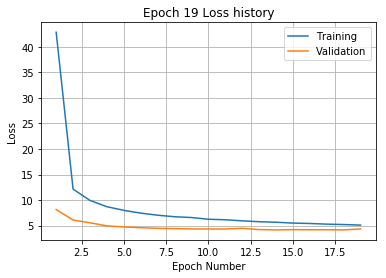

Training
Iteration 0: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 20: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.78 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.19 and relative error of 0.23
Iteration 140: with minibatch training loss = 3.38 and relative error of 0.21
Iteration 160: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 240: with minibatch training loss = 4.92 and relati

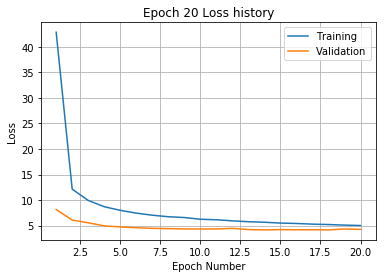

Training
Iteration 0: with minibatch training loss = 4.19 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.51 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 120: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 180: with minibatch training loss = 3.81 and relative error of 0.22
Iteration 200: with minibatch training loss = 3.83 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 240: with minibatch training loss = 5.18 and relati

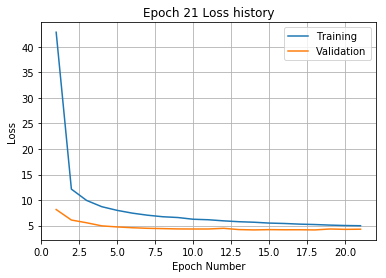

Training
Iteration 0: with minibatch training loss = 5.68 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.05 and relative error of 0.2
Iteration 40: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 60: with minibatch training loss = 2.69 and relative error of 0.19
Iteration 80: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.04 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.2 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 200: with minibatch training loss = 3.44 and relative error of 0.21
Iteration 220: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.64 and relative

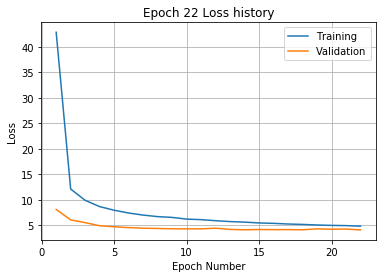

Training
Iteration 0: with minibatch training loss = 4.78 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.43 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.17 and relative error of 0.24
Iteration 140: with minibatch training loss = 3.39 and relative error of 0.21
Iteration 160: with minibatch training loss = 3.74 and relative error of 0.22
Iteration 180: with minibatch training loss = 3.98 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.13 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.6 and relative

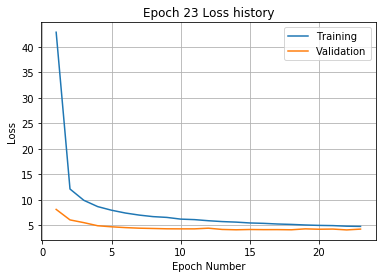

Training
Iteration 0: with minibatch training loss = 3.92 and relative error of 0.22
Iteration 20: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.51 and relative error of 0.24
Iteration 100: with minibatch training loss = 5 and relative error of 0.25
Iteration 120: with minibatch training loss = 6 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 180: with minibatch training loss = 3.79 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 240: with minibatch training loss = 5.51 and relative erro

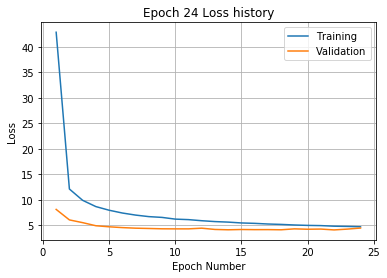

Training
Iteration 0: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.79 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.19 and relative error of 0.23
Iteration 100: with minibatch training loss = 3.08 and relative error of 0.2
Iteration 120: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.21 and relative error of 0.21
Iteration 240: with minibatch training loss = 5.56 and relativ

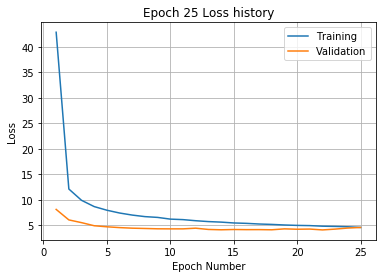

Training
Iteration 0: with minibatch training loss = 3.44 and relative error of 0.21
Iteration 20: with minibatch training loss = 5 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.21 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.26 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.49 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.74 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 180: with minibatch training loss = 3.44 and relative error of 0.21
Iteration 200: with minibatch training loss = 4.33 and relative error of 0.25
Iteration 220: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 240: with minibatch training loss = 4.4 and relative e

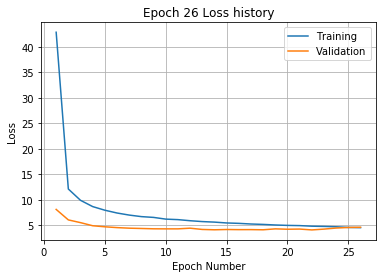

Training
Iteration 0: with minibatch training loss = 3.11 and relative error of 0.2
Iteration 20: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 40: with minibatch training loss = 2.93 and relative error of 0.2
Iteration 60: with minibatch training loss = 4 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 100: with minibatch training loss = 3.66 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 220: with minibatch training loss = 3.53 and relative error of 0.21
Iteration 240: with minibatch training loss = 4.47 and relative err

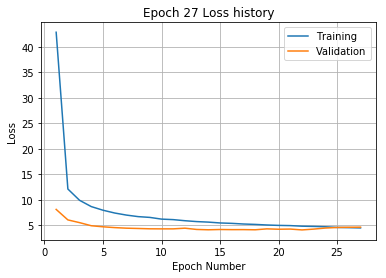

Validation error has stopped improving! Training on repetition 2 stopped!
Training
Iteration 0: with minibatch training loss = 226 and relative error of 1.7
Iteration 20: with minibatch training loss = 114 and relative error of 1.3
Iteration 40: with minibatch training loss = 82.6 and relative error of 1
Iteration 60: with minibatch training loss = 56.5 and relative error of 0.86
Iteration 80: with minibatch training loss = 44.5 and relative error of 0.76
Iteration 100: with minibatch training loss = 32 and relative error of 0.66
Iteration 120: with minibatch training loss = 26 and relative error of 0.59
Iteration 140: with minibatch training loss = 21.6 and relative error of 0.52
Iteration 160: with minibatch training loss = 18.8 and relative error of 0.53
Iteration 180: with minibatch training loss = 16.6 and relative error of 0.47
Iteration 200: with minibatch training loss = 16 and relative error of 0.46
Iteration 220: with minibatch training loss = 17.2 and relative error of 0.48


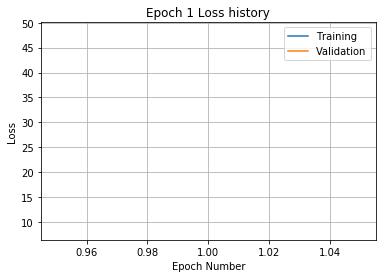

Training
Iteration 0: with minibatch training loss = 14.4 and relative error of 0.45
Iteration 20: with minibatch training loss = 14.3 and relative error of 0.42
Iteration 40: with minibatch training loss = 14.5 and relative error of 0.44
Iteration 60: with minibatch training loss = 15 and relative error of 0.44
Iteration 80: with minibatch training loss = 13.7 and relative error of 0.42
Iteration 100: with minibatch training loss = 13.8 and relative error of 0.42
Iteration 120: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 140: with minibatch training loss = 14.2 and relative error of 0.42
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 180: with minibatch training loss = 12.9 and relative error of 0.41
Iteration 200: with minibatch training loss = 10.6 and relative error of 0.36
Iteration 220: with minibatch training loss = 9.49 and relative error of 0.35
Iteration 240: with minibatch training loss = 11.6 and relative 

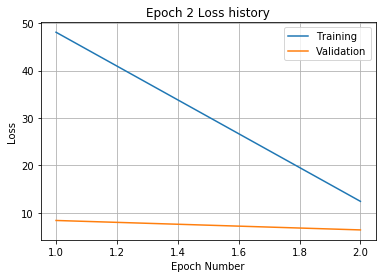

Training
Iteration 0: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 20: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 40: with minibatch training loss = 7.59 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.05 and relative error of 0.35
Iteration 80: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 100: with minibatch training loss = 10.8 and relative error of 0.4
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 140: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 160: with minibatch training loss = 7.63 and relative error of 0.31
Iteration 180: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 200: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 220: with minibatch training loss = 9.3 and relative error of 0.34
Iteration 240: with minibatch training loss = 10 and relative er

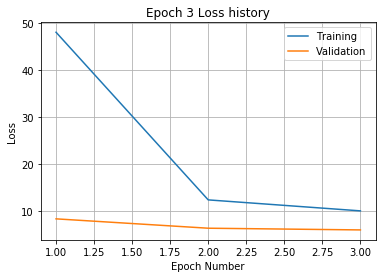

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 20: with minibatch training loss = 8.05 and relative error of 0.33
Iteration 40: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 60: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 80: with minibatch training loss = 9.34 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.48 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.01 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.1 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 200: with minibatch training loss = 9.66 and relative error of 0.36
Iteration 220: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 240: with minibatch training loss = 10.9 and relative 

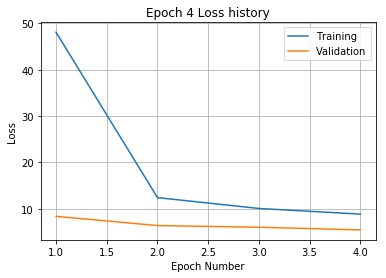

Training
Iteration 0: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 20: with minibatch training loss = 10 and relative error of 0.36
Iteration 40: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.95 and relative error of 0.33
Iteration 80: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 100: with minibatch training loss = 8.93 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 140: with minibatch training loss = 9.94 and relative error of 0.36
Iteration 160: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 180: with minibatch training loss = 7.65 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.07 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.59 and relative error of 0.33
Iteration 240: with minibatch training loss = 8.34 and relative 

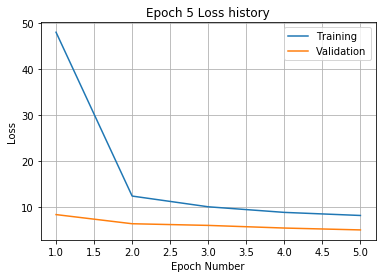

Training
Iteration 0: with minibatch training loss = 8.65 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.38 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.88 and relative error of 0.27
Iteration 60: with minibatch training loss = 8.58 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.37 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.34 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.99 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 220: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 240: with minibatch training loss = 8.36 and relative 

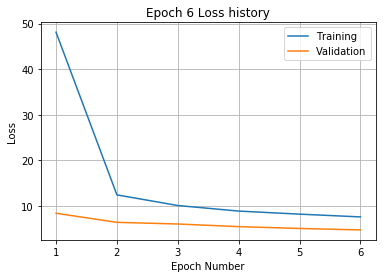

Training
Iteration 0: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.26 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.74 and relative error of 0.26
Iteration 140: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 160: with minibatch training loss = 7.98 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.8 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 240: with minibatch training loss = 5.21 and relative

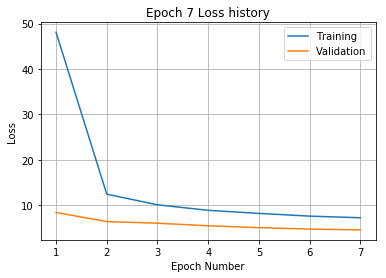

Training
Iteration 0: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.65 and relative error of 0.31
Iteration 240: with minibatch training loss = 8.52 and relative

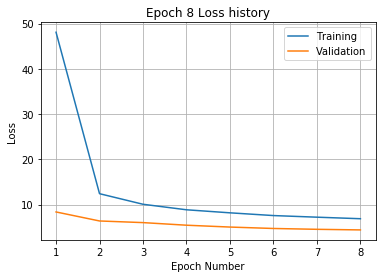

Training
Iteration 0: with minibatch training loss = 7.84 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.87 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 80: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 140: with minibatch training loss = 8.49 and relative error of 0.33
Iteration 160: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.07 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 240: with minibatch training loss = 7.02 and relative 

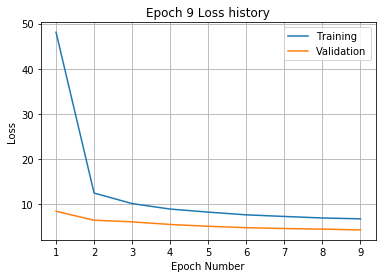

Training
Iteration 0: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.82 and relative error of 0.31
Iteration 60: with minibatch training loss = 10.9 and relative error of 0.39
Iteration 80: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.59 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.56 and relative error of 0.32
Iteration 240: with minibatch training loss = 6.31 and relative

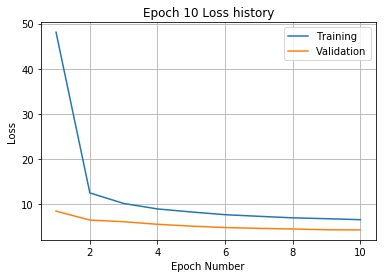

Training
Iteration 0: with minibatch training loss = 6.55 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 40: with minibatch training loss = 10 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.08 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.71 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.67 and relative error of 0.26
Iteration 160: with minibatch training loss = 9.86 and relative error of 0.35
Iteration 180: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.22 and relative error of 0.3
Iteration 220: with minibatch training loss = 8.62 and relative error of 0.33
Iteration 240: with minibatch training loss = 5.53 and relative 

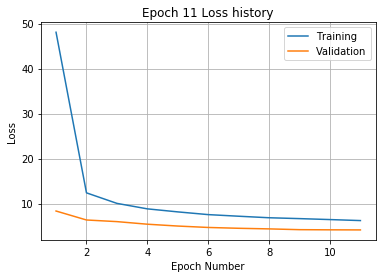

Training
Iteration 0: with minibatch training loss = 8.92 and relative error of 0.35
Iteration 20: with minibatch training loss = 6.62 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 60: with minibatch training loss = 4.06 and relative error of 0.23
Iteration 80: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.2 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.53 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 240: with minibatch training loss = 4.6 and relative e

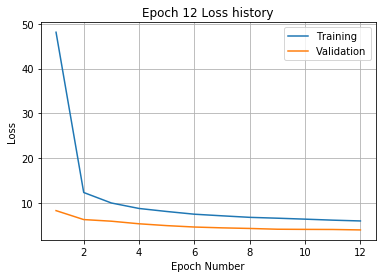

Training
Iteration 0: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.23 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 140: with minibatch training loss = 7 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.39 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 240: with minibatch training loss = 3.94 and relative er

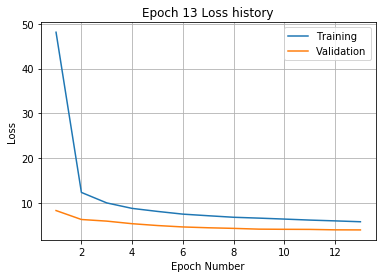

Training
Iteration 0: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.79 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.88 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.02 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.16 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 240: with minibatch training loss = 4.01 and relative

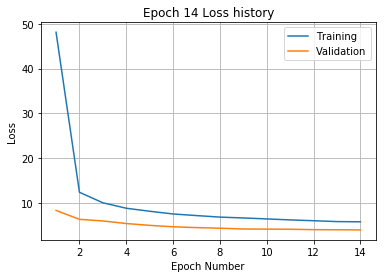

Training
Iteration 0: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 120: with minibatch training loss = 3.91 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.8 and relative 

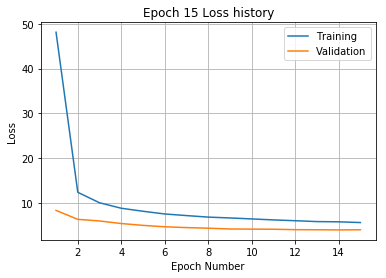

Training
Iteration 0: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 40: with minibatch training loss = 3.48 and relative error of 0.21
Iteration 60: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.07 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.6 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 200: with minibatch training loss = 3.95 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 240: with minibatch training loss = 6 and relative erro

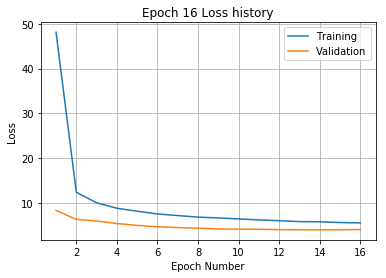

Training
Iteration 0: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 160: with minibatch training loss = 3.65 and relative error of 0.22
Iteration 180: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.08 and relative error of 0.22
Iteration 240: with minibatch training loss = 4.51 and relati

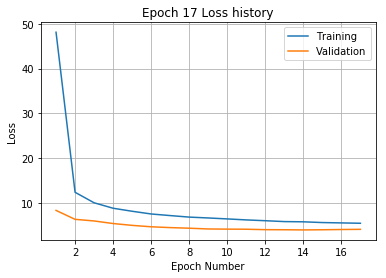

Training
Iteration 0: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.78 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.23 and relative error of 0.23
Iteration 140: with minibatch training loss = 7.59 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.26 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.09 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.85 and relativ

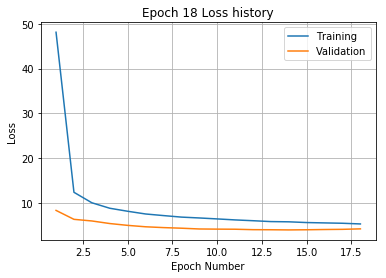

Training
Iteration 0: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.38 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.95 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 240: with minibatch training loss = 4.47 and relative

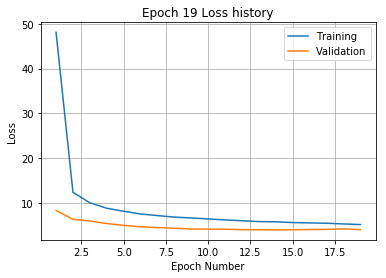

Validation error has stopped improving! Training on repetition 3 stopped!
Training
Iteration 0: with minibatch training loss = 171 and relative error of 1.5
Iteration 20: with minibatch training loss = 105 and relative error of 1.1
Iteration 40: with minibatch training loss = 78.2 and relative error of 1
Iteration 60: with minibatch training loss = 56.4 and relative error of 0.85
Iteration 80: with minibatch training loss = 42.4 and relative error of 0.72
Iteration 100: with minibatch training loss = 28.8 and relative error of 0.62
Iteration 120: with minibatch training loss = 23.3 and relative error of 0.54
Iteration 140: with minibatch training loss = 20.7 and relative error of 0.52
Iteration 160: with minibatch training loss = 16.1 and relative error of 0.44
Iteration 180: with minibatch training loss = 15.3 and relative error of 0.45
Iteration 200: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 220: with minibatch training loss = 13.7 and relative error of 

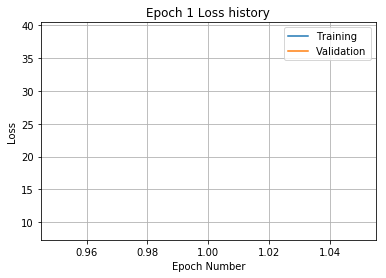

Training
Iteration 0: with minibatch training loss = 15.8 and relative error of 0.46
Iteration 20: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 40: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 60: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 80: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 100: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 120: with minibatch training loss = 8.41 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.25 and relative error of 0.36
Iteration 160: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.24 and relative error of 0.35
Iteration 200: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 220: with minibatch training loss = 8.95 and relative error of 0.33
Iteration 240: with minibatch training loss = 9.07 and relativ

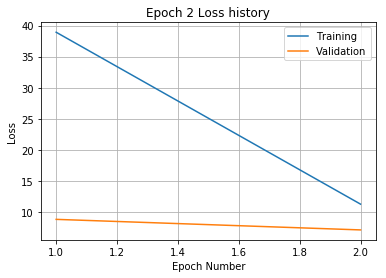

Training
Iteration 0: with minibatch training loss = 9.22 and relative error of 0.34
Iteration 20: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 40: with minibatch training loss = 9.63 and relative error of 0.35
Iteration 60: with minibatch training loss = 9.46 and relative error of 0.36
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 100: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 140: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 160: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 180: with minibatch training loss = 7.22 and relative error of 0.32
Iteration 200: with minibatch training loss = 9.41 and relative error of 0.35
Iteration 220: with minibatch training loss = 8.47 and relative error of 0.33
Iteration 240: with minibatch training loss = 7.64 and relative

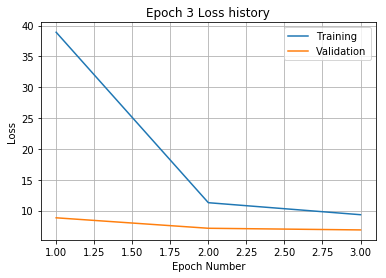

Training
Iteration 0: with minibatch training loss = 9.61 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.68 and relative error of 0.35
Iteration 40: with minibatch training loss = 8.33 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.75 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 120: with minibatch training loss = 9.27 and relative error of 0.34
Iteration 140: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.96 and relative error of 0.33
Iteration 180: with minibatch training loss = 9.29 and relative error of 0.35
Iteration 200: with minibatch training loss = 10 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.29 and relative error of 0.32
Iteration 240: with minibatch training loss = 7.68 and relative 

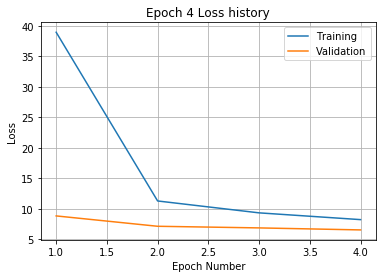

Training
Iteration 0: with minibatch training loss = 7.57 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.87 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.39 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.97 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.07 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.12 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.98 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.59 and relative error of 0.3
Iteration 200: with minibatch training loss = 8.17 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.09 and relative error of 0.34
Iteration 240: with minibatch training loss = 6.04 and relative 

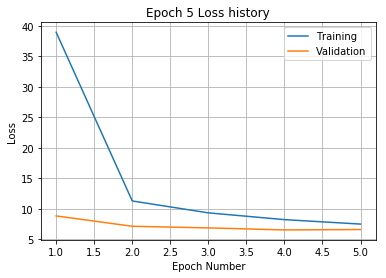

Training
Iteration 0: with minibatch training loss = 8.27 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 60: with minibatch training loss = 9 and relative error of 0.35
Iteration 80: with minibatch training loss = 7.39 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.14 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.4 and relative error of 0.31
Iteration 140: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 160: with minibatch training loss = 9.18 and relative error of 0.36
Iteration 180: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 200: with minibatch training loss = 8.15 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 240: with minibatch training loss = 8.25 and relative err

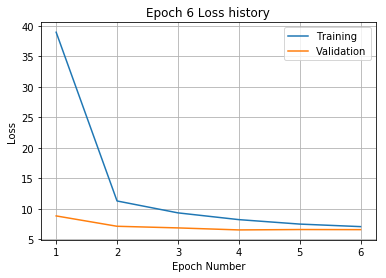

Training
Iteration 0: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.51 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.16 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.55 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.11 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.14 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.33 and relativ

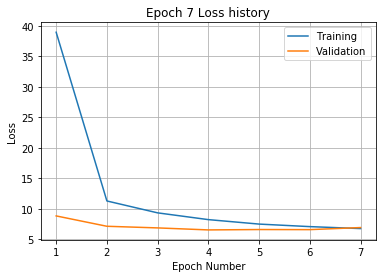

Training
Iteration 0: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.89 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.61 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.93 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 160: with minibatch training loss = 6 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.74 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.11 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.83 and relative error of 0.29
Iteration 240: with minibatch training loss = 7.44 and relative err

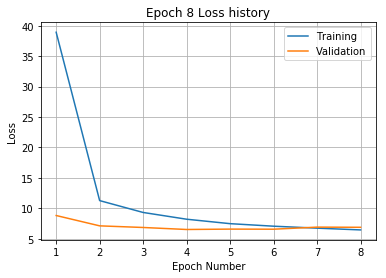

Training
Iteration 0: with minibatch training loss = 7.09 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.61 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.75 and relative error of 0.29
Iteration 200: with minibatch training loss = 5 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.04 and relative 

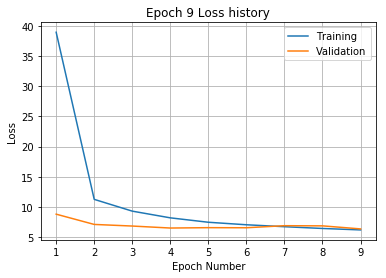

Training
Iteration 0: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.06 and relative error of 0.23
Iteration 60: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.88 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.41 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 240: with minibatch training loss = 6.62 and relativ

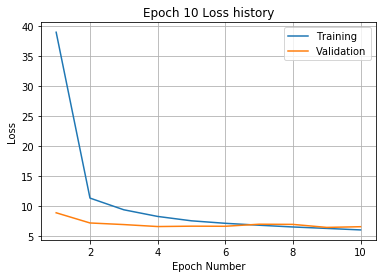

Training
Iteration 0: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.61 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 100: with minibatch training loss = 7 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.33 and relative error of 0.34
Iteration 140: with minibatch training loss = 5.22 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.77 and relative error of 0.26
Iteration 180: with minibatch training loss = 3.69 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.48 and relative er

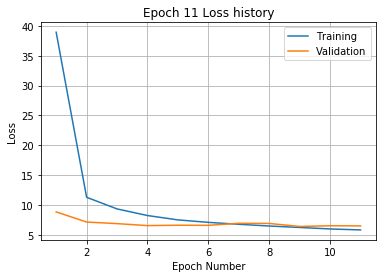

Training
Iteration 0: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.16 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.44 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.64 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.06 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.38 and relative error of 0.23
Iteration 240: with minibatch training loss = 6.84 and relative

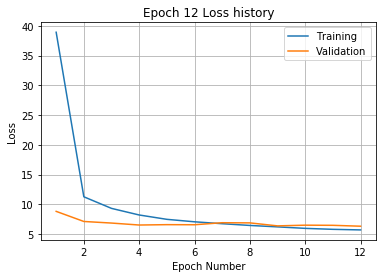

Training
Iteration 0: with minibatch training loss = 8.11 and relative error of 0.34
Iteration 20: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.1 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.09 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.66 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.38 and relativ

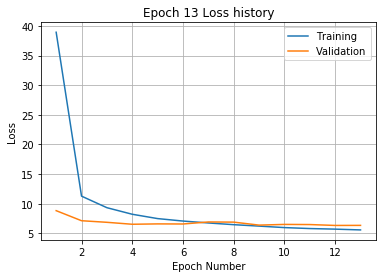

Training
Iteration 0: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.03 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.41 and relati

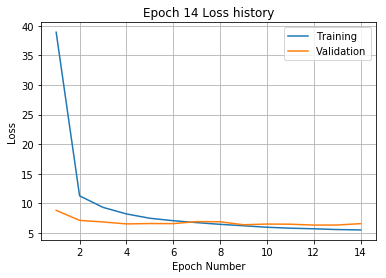

Training
Iteration 0: with minibatch training loss = 8.15 and relative error of 0.33
Iteration 20: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.18 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 100: with minibatch training loss = 3.17 and relative error of 0.2
Iteration 120: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.12 and relative error of 0.24
Iteration 180: with minibatch training loss = 3.65 and relative error of 0.22
Iteration 200: with minibatch training loss = 8.41 and relative error of 0.33
Iteration 220: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 240: with minibatch training loss = 7.52 and relativ

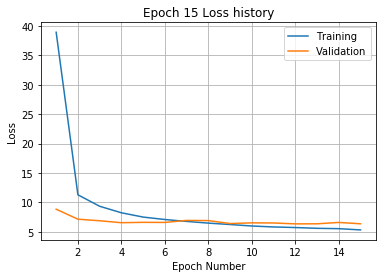

Training
Iteration 0: with minibatch training loss = 4.65 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.82 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.76 and relati

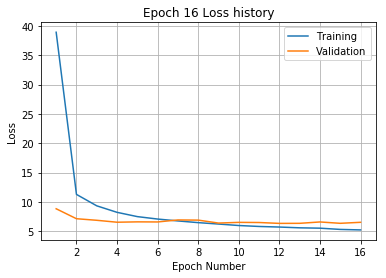

Training
Iteration 0: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 20: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 40: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.16 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.57 and relative error of 0.24
Iteration 140: with minibatch training loss = 7.58 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 200: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.21 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.76 and relati

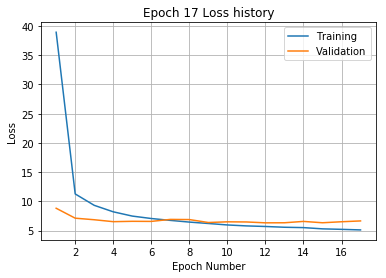

Validation error has stopped improving! Training on repetition 4 stopped!
Training
Iteration 0: with minibatch training loss = 186 and relative error of 1.6
Iteration 20: with minibatch training loss = 118 and relative error of 1.2
Iteration 40: with minibatch training loss = 83.5 and relative error of 1
Iteration 60: with minibatch training loss = 62.9 and relative error of 0.9
Iteration 80: with minibatch training loss = 42.6 and relative error of 0.74
Iteration 100: with minibatch training loss = 33.6 and relative error of 0.67
Iteration 120: with minibatch training loss = 25.4 and relative error of 0.6
Iteration 140: with minibatch training loss = 22.8 and relative error of 0.55
Iteration 160: with minibatch training loss = 18.1 and relative error of 0.5
Iteration 180: with minibatch training loss = 17.6 and relative error of 0.49
Iteration 200: with minibatch training loss = 16.2 and relative error of 0.42
Iteration 220: with minibatch training loss = 15 and relative error of 0.43

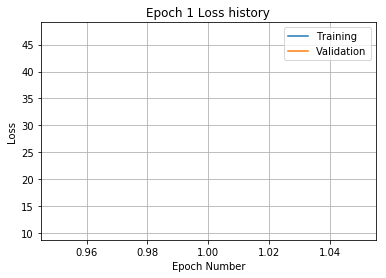

Training
Iteration 0: with minibatch training loss = 13.7 and relative error of 0.42
Iteration 20: with minibatch training loss = 16.5 and relative error of 0.47
Iteration 40: with minibatch training loss = 14 and relative error of 0.43
Iteration 60: with minibatch training loss = 13.6 and relative error of 0.41
Iteration 80: with minibatch training loss = 17.4 and relative error of 0.48
Iteration 100: with minibatch training loss = 14.2 and relative error of 0.42
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 140: with minibatch training loss = 12.9 and relative error of 0.41
Iteration 160: with minibatch training loss = 15.8 and relative error of 0.48
Iteration 180: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 200: with minibatch training loss = 9.56 and relative error of 0.36
Iteration 220: with minibatch training loss = 11.6 and relative error of 0.37
Iteration 240: with minibatch training loss = 9.38 and relative

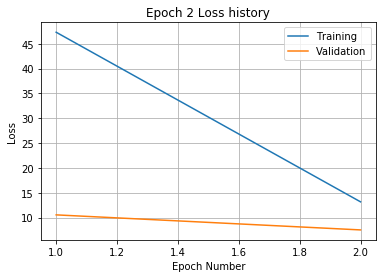

Training
Iteration 0: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 20: with minibatch training loss = 10.1 and relative error of 0.35
Iteration 40: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 60: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 80: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 100: with minibatch training loss = 9.52 and relative error of 0.36
Iteration 120: with minibatch training loss = 9.38 and relative error of 0.34
Iteration 140: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 160: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 180: with minibatch training loss = 8.88 and relative error of 0.34
Iteration 200: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 220: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 240: with minibatch training loss = 9.05 and relativ

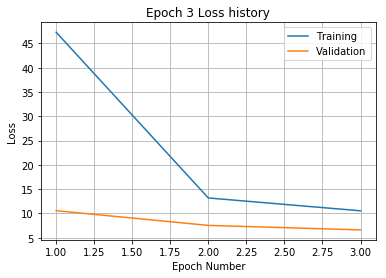

Training
Iteration 0: with minibatch training loss = 11.9 and relative error of 0.38
Iteration 20: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 40: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 60: with minibatch training loss = 9.12 and relative error of 0.34
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 100: with minibatch training loss = 8.26 and relative error of 0.32
Iteration 120: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 140: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 180: with minibatch training loss = 9.11 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.04 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 240: with minibatch training loss = 11.2 and relativ

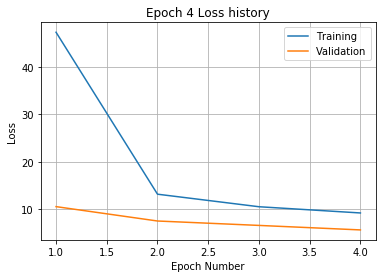

Training
Iteration 0: with minibatch training loss = 9.26 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 40: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 60: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.81 and relative error of 0.32
Iteration 100: with minibatch training loss = 9.96 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.86 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.07 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.54 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.43 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.57 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.12 and relative error of 0.29
Iteration 240: with minibatch training loss = 10.4 and relati

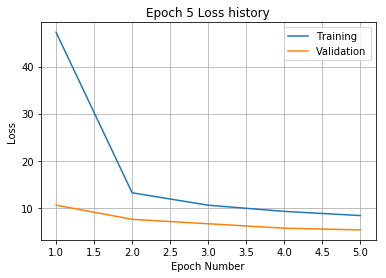

Training
Iteration 0: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 20: with minibatch training loss = 7.66 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.26 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.45 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.82 and relative error of 0.29
Iteration 160: with minibatch training loss = 8.77 and relative error of 0.35
Iteration 180: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 220: with minibatch training loss = 9.52 and relative error of 0.35
Iteration 240: with minibatch training loss = 7.98 and relativ

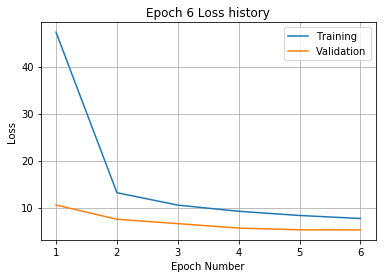

Training
Iteration 0: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 20: with minibatch training loss = 8.07 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 100: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.19 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.09 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.85 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.64 and relative error of 0.31
Iteration 240: with minibatch training loss = 7.47 and relative 

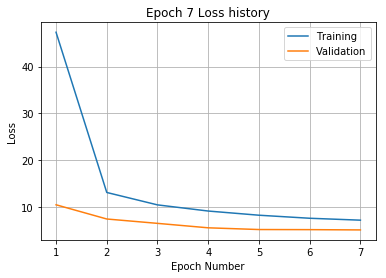

Training
Iteration 0: with minibatch training loss = 8.94 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.89 and relative error of 0.29
Iteration 40: with minibatch training loss = 7 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 80: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 100: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 240: with minibatch training loss = 9.87 and relative err

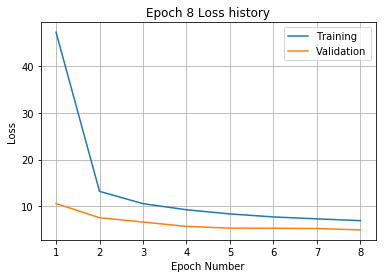

Training
Iteration 0: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 40: with minibatch training loss = 9.6 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 200: with minibatch training loss = 8.32 and relative error of 0.33
Iteration 220: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.91 and relative err

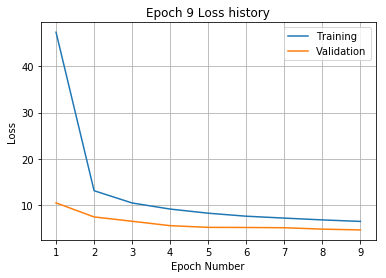

Training
Iteration 0: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.49 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.31 and relative error of 0.28
Iteration 140: with minibatch training loss = 8.98 and relative error of 0.35
Iteration 160: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 200: with minibatch training loss = 8.5 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.55 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.17 and relative

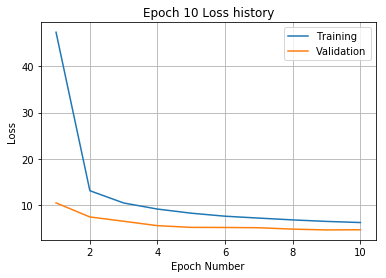

Training
Iteration 0: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.08 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.57 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.85 and relati

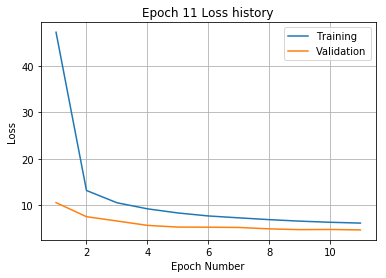

Training
Iteration 0: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.19 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.57 and relative error of 0.24
Iteration 80: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.69 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.68 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.42 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.59 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.47 and relative error of 0.3
Iteration 240: with minibatch training loss = 4.87 and relative

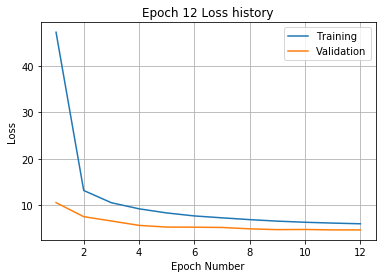

Training
Iteration 0: with minibatch training loss = 3.76 and relative error of 0.22
Iteration 20: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.92 and relative error of 0.24
Iteration 60: with minibatch training loss = 7.06 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 120: with minibatch training loss = 8.04 and relative error of 0.32
Iteration 140: with minibatch training loss = 3.46 and relative error of 0.22
Iteration 160: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.35 and relative error of 0.25
Iteration 220: with minibatch training loss = 8.94 and relative error of 0.34
Iteration 240: with minibatch training loss = 6.83 and relative

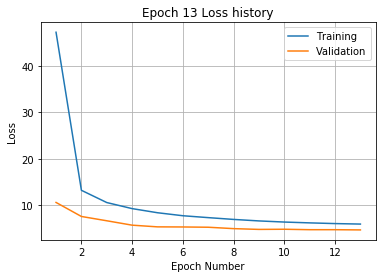

Training
Iteration 0: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 20: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 60: with minibatch training loss = 8.26 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.1 and relative error of 0.34
Iteration 100: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 120: with minibatch training loss = 5 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.24 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.45 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.62 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.28 and relative erro

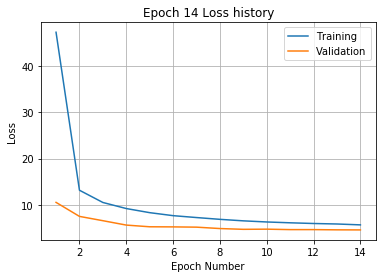

Training
Iteration 0: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 60: with minibatch training loss = 3.67 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.63 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 160: with minibatch training loss = 6.51 and relative error of 0.3
Iteration 180: with minibatch training loss = 3.65 and relative error of 0.21
Iteration 200: with minibatch training loss = 4.69 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 240: with minibatch training loss = 3.65 and relative 

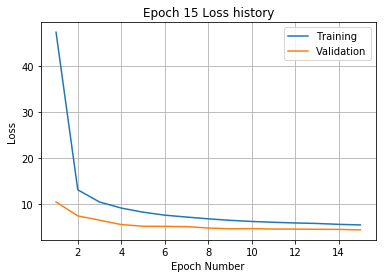

Training
Iteration 0: with minibatch training loss = 8.05 and relative error of 0.33
Iteration 20: with minibatch training loss = 3.84 and relative error of 0.22
Iteration 40: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 80: with minibatch training loss = 4 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.83 and relative error of 0.33
Iteration 140: with minibatch training loss = 3.74 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.97 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.14 and relative 

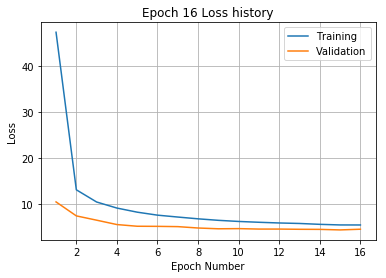

Training
Iteration 0: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 40: with minibatch training loss = 3.83 and relative error of 0.22
Iteration 60: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 100: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 120: with minibatch training loss = 3.8 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.79 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.23 and relative error of 0.25
Iteration 240: with minibatch training loss = 3.68 and relative

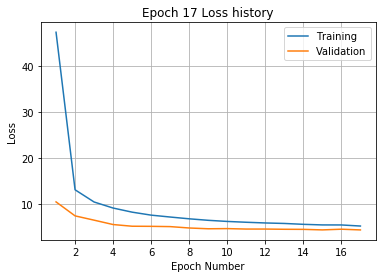

Training
Iteration 0: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.1 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.76 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 100: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 120: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 140: with minibatch training loss = 3.92 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.21 and relative error of 0.23
Iteration 200: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.17 and relativ

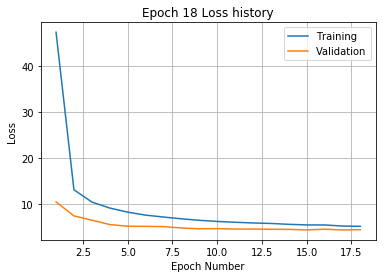

Training
Iteration 0: with minibatch training loss = 3.15 and relative error of 0.21
Iteration 20: with minibatch training loss = 5.28 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.26 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 140: with minibatch training loss = 3.82 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 200: with minibatch training loss = 3.75 and relative error of 0.22
Iteration 220: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 240: with minibatch training loss = 5.04 and relati

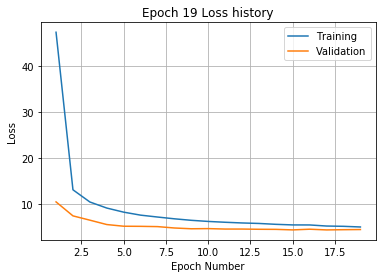

Training
Iteration 0: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 40: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 60: with minibatch training loss = 6.15 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.47 and relative error of 0.21
Iteration 100: with minibatch training loss = 3.94 and relative error of 0.22
Iteration 120: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.49 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.38 and relative

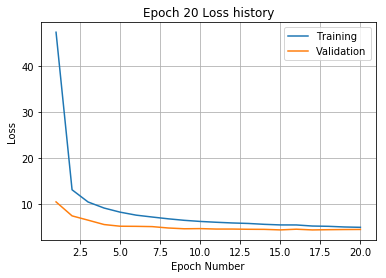

Training
Iteration 0: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.15 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.76 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 80: with minibatch training loss = 2.92 and relative error of 0.2
Iteration 100: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.46 and relativ

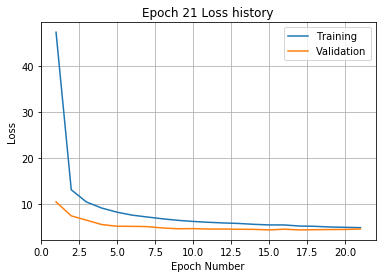

Training
Iteration 0: with minibatch training loss = 5.32 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.42 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.38 and relative error of 0.27
Iteration 60: with minibatch training loss = 6 and relative error of 0.28
Iteration 80: with minibatch training loss = 3.43 and relative error of 0.21
Iteration 100: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 140: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.88 and relative error of 0.23
Iteration 180: with minibatch training loss = 3.12 and relative error of 0.2
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 240: with minibatch training loss = 7.45 and relative er

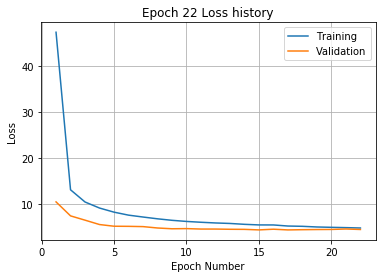

Validation error has stopped improving! Training on repetition 5 stopped!
Training
Iteration 0: with minibatch training loss = 248 and relative error of 1.8
Iteration 20: with minibatch training loss = 135 and relative error of 1.3
Iteration 40: with minibatch training loss = 88.5 and relative error of 1.1
Iteration 60: with minibatch training loss = 62.9 and relative error of 0.88
Iteration 80: with minibatch training loss = 53.4 and relative error of 0.83
Iteration 100: with minibatch training loss = 38.2 and relative error of 0.72
Iteration 120: with minibatch training loss = 30.8 and relative error of 0.62
Iteration 140: with minibatch training loss = 24.9 and relative error of 0.56
Iteration 160: with minibatch training loss = 17.7 and relative error of 0.49
Iteration 180: with minibatch training loss = 20.5 and relative error of 0.5
Iteration 200: with minibatch training loss = 14.5 and relative error of 0.45
Iteration 220: with minibatch training loss = 15.6 and relative error o

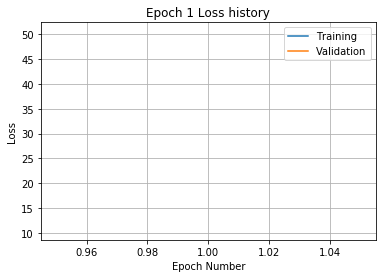

Training
Iteration 0: with minibatch training loss = 16.1 and relative error of 0.43
Iteration 20: with minibatch training loss = 12.9 and relative error of 0.41
Iteration 40: with minibatch training loss = 14.5 and relative error of 0.45
Iteration 60: with minibatch training loss = 15.5 and relative error of 0.43
Iteration 80: with minibatch training loss = 14.3 and relative error of 0.43
Iteration 100: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 120: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 140: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 160: with minibatch training loss = 12.4 and relative error of 0.39
Iteration 180: with minibatch training loss = 9.51 and relative error of 0.35
Iteration 200: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 220: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 240: with minibatch training loss = 9.34 and relativ

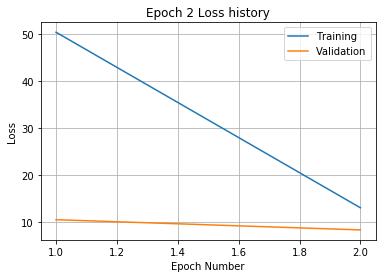

Training
Iteration 0: with minibatch training loss = 10.1 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.83 and relative error of 0.34
Iteration 40: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 60: with minibatch training loss = 8.56 and relative error of 0.35
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 100: with minibatch training loss = 9.13 and relative error of 0.34
Iteration 120: with minibatch training loss = 12.8 and relative error of 0.42
Iteration 140: with minibatch training loss = 9.01 and relative error of 0.34
Iteration 160: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 180: with minibatch training loss = 8.23 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.79 and relative error of 0.37
Iteration 220: with minibatch training loss = 9.87 and relative error of 0.36
Iteration 240: with minibatch training loss = 9 and relative 

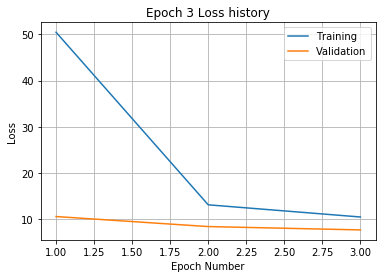

Training
Iteration 0: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 20: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.01 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.54 and relative error of 0.32
Iteration 100: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 120: with minibatch training loss = 8.05 and relative error of 0.32
Iteration 140: with minibatch training loss = 10 and relative error of 0.36
Iteration 160: with minibatch training loss = 9.22 and relative error of 0.35
Iteration 180: with minibatch training loss = 10.1 and relative error of 0.35
Iteration 200: with minibatch training loss = 8.24 and relative error of 0.34
Iteration 220: with minibatch training loss = 11.4 and relative error of 0.36
Iteration 240: with minibatch training loss = 7.62 and relative

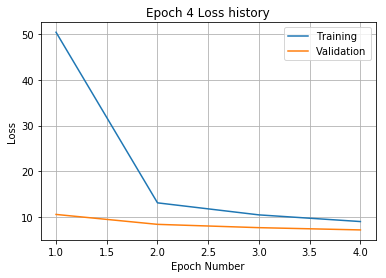

Training
Iteration 0: with minibatch training loss = 9.49 and relative error of 0.35
Iteration 20: with minibatch training loss = 10.3 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.82 and relative error of 0.35
Iteration 100: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 120: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 140: with minibatch training loss = 9.38 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.64 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.47 and relati

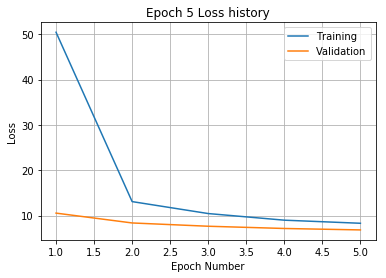

Training
Iteration 0: with minibatch training loss = 8.93 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.42 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.64 and relative error of 0.33
Iteration 100: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 120: with minibatch training loss = 8.52 and relative error of 0.34
Iteration 140: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.3 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.35 and relative error of 0.25
Iteration 220: with minibatch training loss = 9.04 and relative error of 0.34
Iteration 240: with minibatch training loss = 8.43 and relative

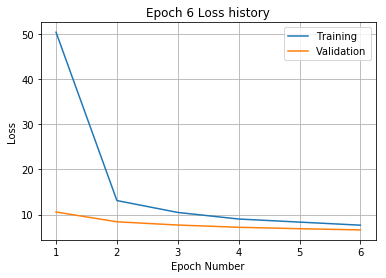

Training
Iteration 0: with minibatch training loss = 7.74 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.13 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.14 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.27 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.29 and relative error of 0.25
Iteration 180: with minibatch training loss = 8.82 and relative error of 0.35
Iteration 200: with minibatch training loss = 4.67 and relative error of 0.24
Iteration 220: with minibatch training loss = 9.37 and relative error of 0.36
Iteration 240: with minibatch training loss = 5.85 and relative

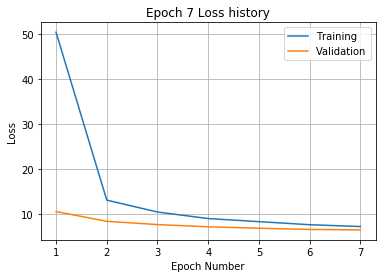

Training
Iteration 0: with minibatch training loss = 6.94 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 60: with minibatch training loss = 10 and relative error of 0.37
Iteration 80: with minibatch training loss = 7.91 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.12 and relative error of 0.25
Iteration 140: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.1 and relative er

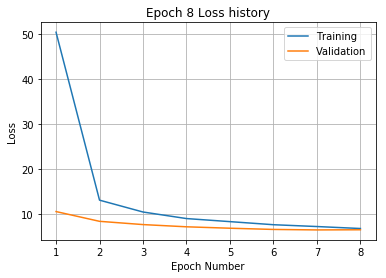

Training
Iteration 0: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.11 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.94 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.95 and relative error of 0.33
Iteration 100: with minibatch training loss = 4.18 and relative error of 0.22
Iteration 120: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 160: with minibatch training loss = 8.42 and relative error of 0.33
Iteration 180: with minibatch training loss = 4.51 and relative error of 0.24
Iteration 200: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.69 and relative

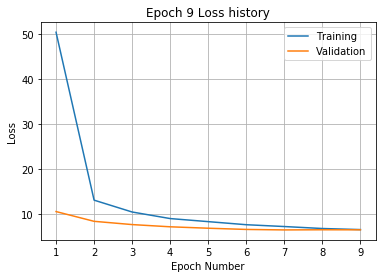

Training
Iteration 0: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 40: with minibatch training loss = 8 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.83 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.05 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.52 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.19 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 240: with minibatch training loss = 4.58 and relative 

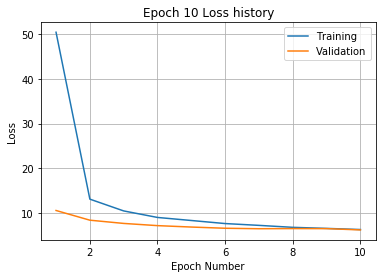

Training
Iteration 0: with minibatch training loss = 5.88 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.33 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 60: with minibatch training loss = 8.92 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.38 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 240: with minibatch training loss = 6.35 and relative

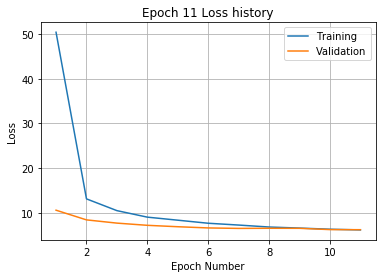

Training
Iteration 0: with minibatch training loss = 5.83 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.6 and relative error of 0.34
Iteration 80: with minibatch training loss = 5.03 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.61 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.78 and relative error of 0.31
Iteration 200: with minibatch training loss = 3.88 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.17 and relative 

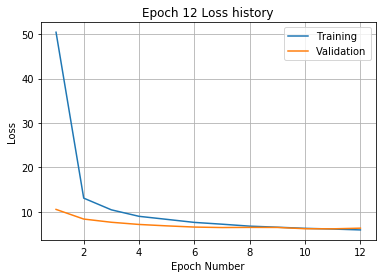

Training
Iteration 0: with minibatch training loss = 3.92 and relative error of 0.22
Iteration 20: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.64 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.08 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.2 and relative error of 0.23
Iteration 100: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.9 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.27 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.43 and relative e

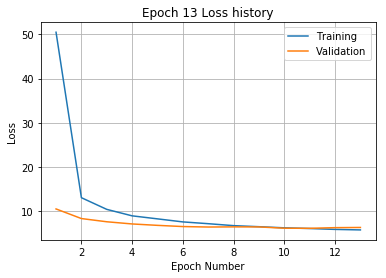

Training
Iteration 0: with minibatch training loss = 7.06 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.2 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.58 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.06 and relative

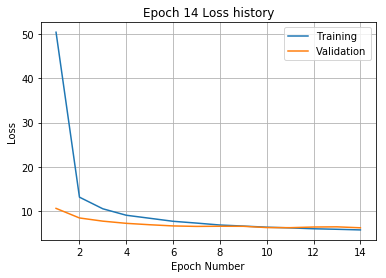

Training
Iteration 0: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.63 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 180: with minibatch training loss = 7.12 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.01 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.73 and relative error of 0.24
Iteration 240: with minibatch training loss = 6.18 and relati

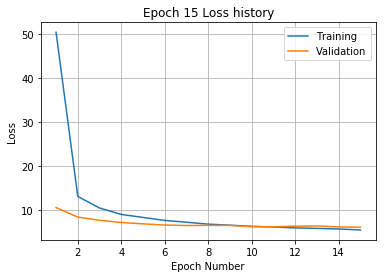

Training
Iteration 0: with minibatch training loss = 5 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.87 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 100: with minibatch training loss = 3.99 and relative error of 0.24
Iteration 120: with minibatch training loss = 7.87 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.31 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.64 and relative er

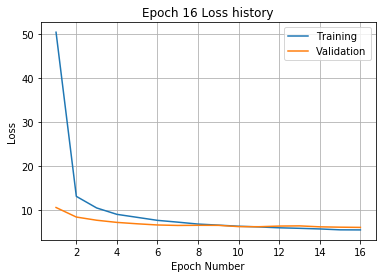

Training
Iteration 0: with minibatch training loss = 5 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.4 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.31 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.83 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 240: with minibatch training loss = 5.87 and relative err

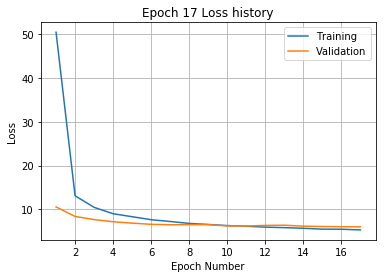

Training
Iteration 0: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.08 and relative error of 0.22
Iteration 140: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.3 and relative

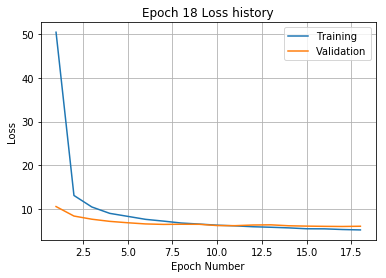

Training
Iteration 0: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.42 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 120: with minibatch training loss = 3.76 and relative error of 0.21
Iteration 140: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 200: with minibatch training loss = 3.07 and relative error of 0.2
Iteration 220: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.07 and relative

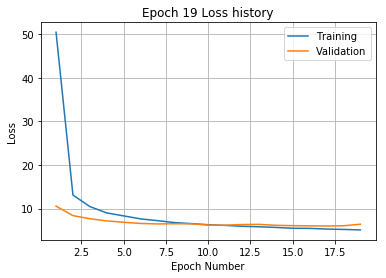

Training
Iteration 0: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.24 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.39 and relative error of 0.21
Iteration 100: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.97 and relative

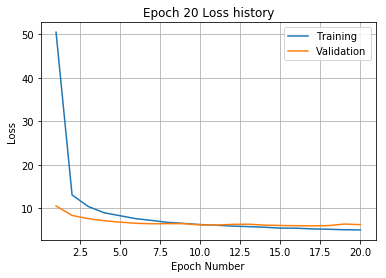

Training
Iteration 0: with minibatch training loss = 3.84 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 100: with minibatch training loss = 2.7 and relative error of 0.19
Iteration 120: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.59 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.17 and relative error of 0.25
Iteration 240: with minibatch training loss = 3.8 and relative 

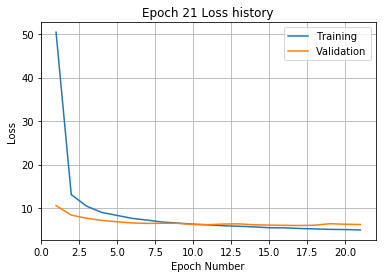

Training
Iteration 0: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.94 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.89 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.17 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.65 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.9 and relative

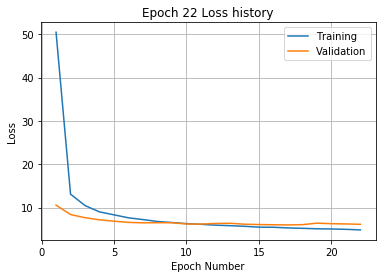

Validation error has stopped improving! Training on repetition 6 stopped!
Training
Iteration 0: with minibatch training loss = 259 and relative error of 1.9
Iteration 20: with minibatch training loss = 156 and relative error of 1.4
Iteration 40: with minibatch training loss = 103 and relative error of 1.2
Iteration 60: with minibatch training loss = 72.8 and relative error of 0.97
Iteration 80: with minibatch training loss = 50.5 and relative error of 0.85
Iteration 100: with minibatch training loss = 39.3 and relative error of 0.71
Iteration 120: with minibatch training loss = 31.1 and relative error of 0.62
Iteration 140: with minibatch training loss = 25.6 and relative error of 0.57
Iteration 160: with minibatch training loss = 21.5 and relative error of 0.54
Iteration 180: with minibatch training loss = 19.1 and relative error of 0.49
Iteration 200: with minibatch training loss = 19.8 and relative error of 0.51
Iteration 220: with minibatch training loss = 19.2 and relative error o

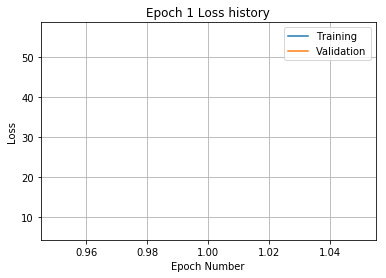

Training
Iteration 0: with minibatch training loss = 13.9 and relative error of 0.46
Iteration 20: with minibatch training loss = 15.3 and relative error of 0.43
Iteration 40: with minibatch training loss = 15.7 and relative error of 0.45
Iteration 60: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 80: with minibatch training loss = 15.4 and relative error of 0.45
Iteration 100: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 120: with minibatch training loss = 15.2 and relative error of 0.44
Iteration 140: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 160: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 180: with minibatch training loss = 8.98 and relative error of 0.33
Iteration 200: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 220: with minibatch training loss = 9.46 and relative error of 0.36
Iteration 240: with minibatch training loss = 9.09 and relativ

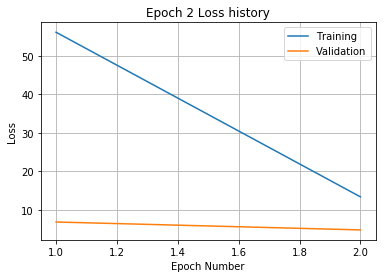

Training
Iteration 0: with minibatch training loss = 10.9 and relative error of 0.39
Iteration 20: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 40: with minibatch training loss = 13.8 and relative error of 0.41
Iteration 60: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 80: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 100: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 120: with minibatch training loss = 14 and relative error of 0.41
Iteration 140: with minibatch training loss = 12.6 and relative error of 0.41
Iteration 160: with minibatch training loss = 8.35 and relative error of 0.34
Iteration 180: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 200: with minibatch training loss = 9.07 and relative error of 0.34
Iteration 220: with minibatch training loss = 10.3 and relative error of 0.35
Iteration 240: with minibatch training loss = 13.8 and relative er

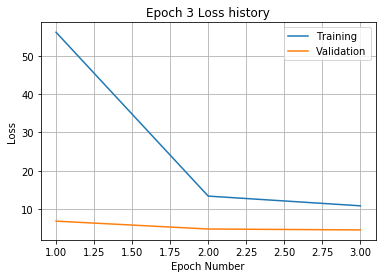

Training
Iteration 0: with minibatch training loss = 9.07 and relative error of 0.33
Iteration 20: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 40: with minibatch training loss = 7.46 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.8 and relative error of 0.34
Iteration 80: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 100: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 140: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 160: with minibatch training loss = 12 and relative error of 0.41
Iteration 180: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 200: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 220: with minibatch training loss = 7.5 and relative error of 0.33
Iteration 240: with minibatch training loss = 7.14 and relative e

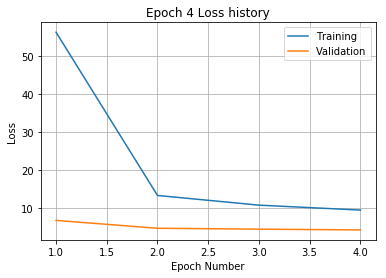

Training
Iteration 0: with minibatch training loss = 8.82 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.31 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.61 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.77 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.05 and relative error of 0.32
Iteration 100: with minibatch training loss = 9.09 and relative error of 0.36
Iteration 120: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 140: with minibatch training loss = 8.92 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 180: with minibatch training loss = 6 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.25 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.86 and relative error of 0.33
Iteration 240: with minibatch training loss = 8.78 and relative e

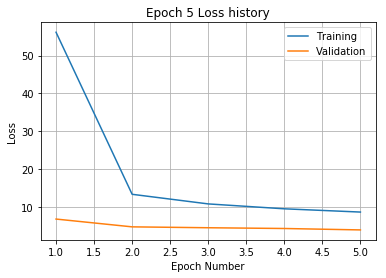

Training
Iteration 0: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 40: with minibatch training loss = 9.56 and relative error of 0.36
Iteration 60: with minibatch training loss = 6.05 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.82 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.38 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.35 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.4 and relative er

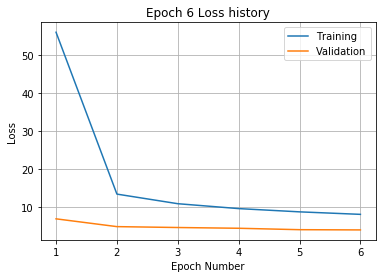

Training
Iteration 0: with minibatch training loss = 5.96 and relative error of 0.27
Iteration 20: with minibatch training loss = 9.33 and relative error of 0.36
Iteration 40: with minibatch training loss = 9.01 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 80: with minibatch training loss = 8.03 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.74 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.92 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.24 and relative error of 0.34
Iteration 160: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.79 and relativ

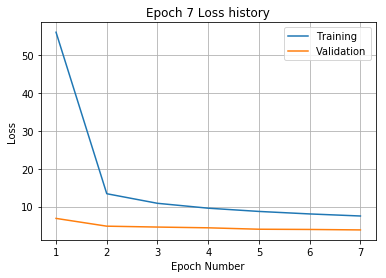

Training
Iteration 0: with minibatch training loss = 8.82 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.12 and relative error of 0.34
Iteration 40: with minibatch training loss = 5.83 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.58 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.64 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.65 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.7 and relative error of 0.34
Iteration 140: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.58 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.36 and relative er

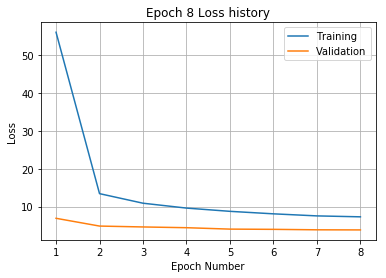

Training
Iteration 0: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.46 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.17 and relative error of 0.25
Iteration 160: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.79 and relative e

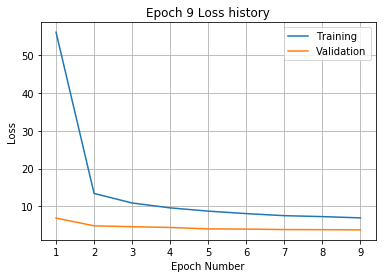

Training
Iteration 0: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 20: with minibatch training loss = 9.37 and relative error of 0.35
Iteration 40: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.25 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.83 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.61 and relative error of 0.35
Iteration 180: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 200: with minibatch training loss = 8.14 and relative error of 0.34
Iteration 220: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 240: with minibatch training loss = 7.13 and relative

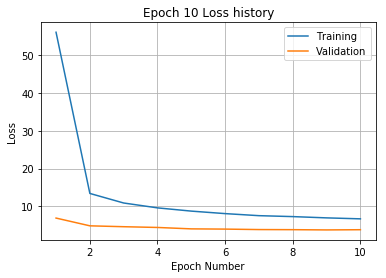

Training
Iteration 0: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.87 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 100: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 120: with minibatch training loss = 6.79 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.99 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 200: with minibatch training loss = 8.28 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.67 and relative

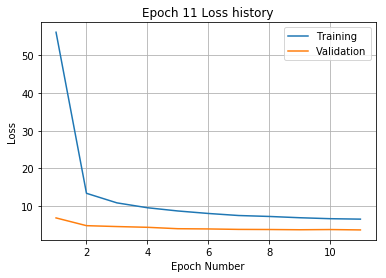

Training
Iteration 0: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.09 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 240: with minibatch training loss = 4.93 and relative e

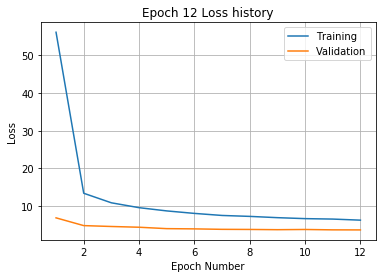

Training
Iteration 0: with minibatch training loss = 5.82 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.41 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 100: with minibatch training loss = 8.58 and relative error of 0.34
Iteration 120: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.75 and relative 

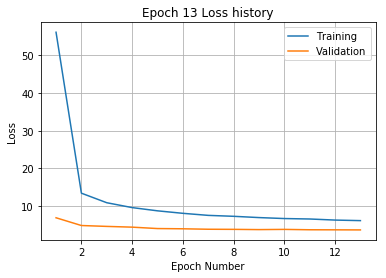

Training
Iteration 0: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.36 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.82 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 220: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 240: with minibatch training loss = 3.46 and relativ

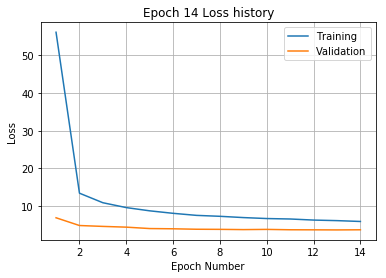

Training
Iteration 0: with minibatch training loss = 4.74 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.82 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.04 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.22 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.96 and relativ

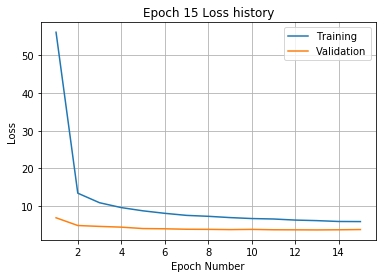

Training
Iteration 0: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.88 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.8 and relative error of 0.24
Iteration 80: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 100: with minibatch training loss = 3.33 and relative error of 0.2
Iteration 120: with minibatch training loss = 4.71 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.36 and relative error of 0.23
Iteration 180: with minibatch training loss = 7.64 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.31 and relative er

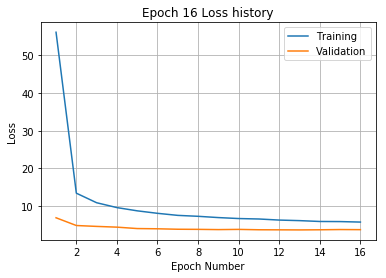

Training
Iteration 0: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.82 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 220: with minibatch training loss = 7.39 and relative error of 0.3
Iteration 240: with minibatch training loss = 5.73 and relative 

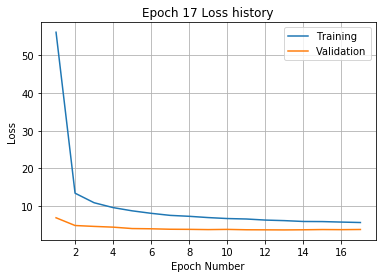

Training
Iteration 0: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.21 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.59 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 160: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 180: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.41 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.3 and relative 

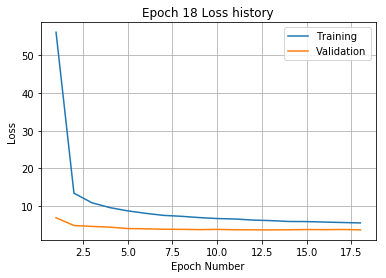

Validation error has stopped improving! Training on repetition 7 stopped!
Training
Iteration 0: with minibatch training loss = 225 and relative error of 1.7
Iteration 20: with minibatch training loss = 133 and relative error of 1.4
Iteration 40: with minibatch training loss = 99.4 and relative error of 1.1
Iteration 60: with minibatch training loss = 67.4 and relative error of 0.93
Iteration 80: with minibatch training loss = 48.9 and relative error of 0.8
Iteration 100: with minibatch training loss = 36.3 and relative error of 0.69
Iteration 120: with minibatch training loss = 25.6 and relative error of 0.61
Iteration 140: with minibatch training loss = 21 and relative error of 0.54
Iteration 160: with minibatch training loss = 19.3 and relative error of 0.53
Iteration 180: with minibatch training loss = 20.8 and relative error of 0.52
Iteration 200: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 220: with minibatch training loss = 17.3 and relative error of 

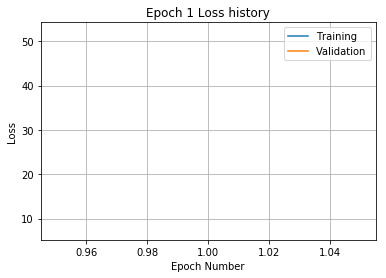

Training
Iteration 0: with minibatch training loss = 15.4 and relative error of 0.43
Iteration 20: with minibatch training loss = 14.9 and relative error of 0.44
Iteration 40: with minibatch training loss = 14.2 and relative error of 0.44
Iteration 60: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 80: with minibatch training loss = 13.1 and relative error of 0.4
Iteration 100: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 140: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 160: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 180: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 200: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 220: with minibatch training loss = 13.9 and relative error of 0.43
Iteration 240: with minibatch training loss = 12.8 and relativ

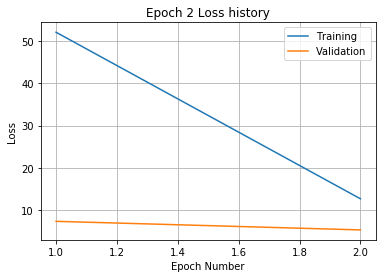

Training
Iteration 0: with minibatch training loss = 11 and relative error of 0.39
Iteration 20: with minibatch training loss = 12.6 and relative error of 0.39
Iteration 40: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 60: with minibatch training loss = 13.5 and relative error of 0.43
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 100: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 120: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 140: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 160: with minibatch training loss = 10 and relative error of 0.36
Iteration 180: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 200: with minibatch training loss = 9.54 and relative error of 0.36
Iteration 220: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 240: with minibatch training loss = 8.48 and relative er

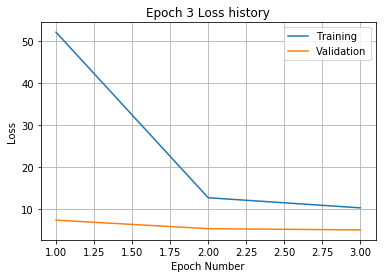

Training
Iteration 0: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 20: with minibatch training loss = 10.6 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.18 and relative error of 0.33
Iteration 60: with minibatch training loss = 9.26 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.35 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.51 and relative error of 0.33
Iteration 120: with minibatch training loss = 9.41 and relative error of 0.35
Iteration 140: with minibatch training loss = 10 and relative error of 0.38
Iteration 160: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.96 and relative error of 0.27
Iteration 200: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 220: with minibatch training loss = 8.42 and relative error of 0.34
Iteration 240: with minibatch training loss = 10.2 and relative 

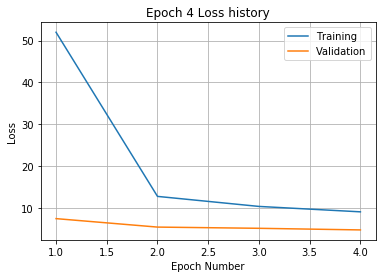

Training
Iteration 0: with minibatch training loss = 6.88 and relative error of 0.29
Iteration 20: with minibatch training loss = 10.8 and relative error of 0.36
Iteration 40: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.42 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.69 and relative error of 0.34
Iteration 100: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.07 and relative error of 0.31
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.2 and relative error of 0.38
Iteration 180: with minibatch training loss = 8.31 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.44 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 240: with minibatch training loss = 9.12 and relative

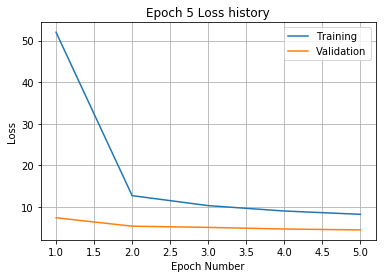

Training
Iteration 0: with minibatch training loss = 9.64 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.42 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.51 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.85 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 240: with minibatch training loss = 7.88 and relativ

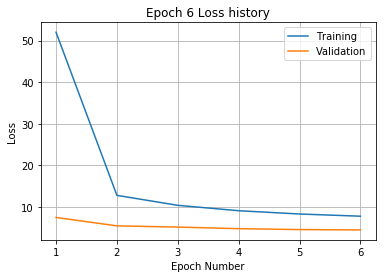

Training
Iteration 0: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.45 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.6 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 80: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 100: with minibatch training loss = 6.88 and relative error of 0.31
Iteration 120: with minibatch training loss = 9.21 and relative error of 0.34
Iteration 140: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.87 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.6 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.48 and relative error of 0.34
Iteration 240: with minibatch training loss = 8.69 and relative 

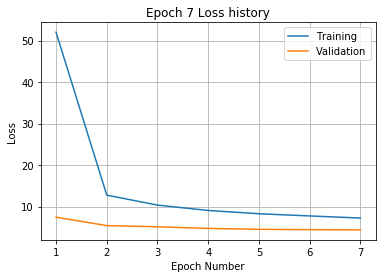

Training
Iteration 0: with minibatch training loss = 7.41 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.5 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.91 and relative e

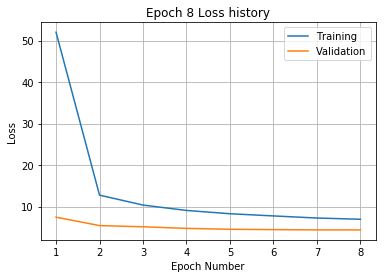

Training
Iteration 0: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.68 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.15 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.19 and relative er

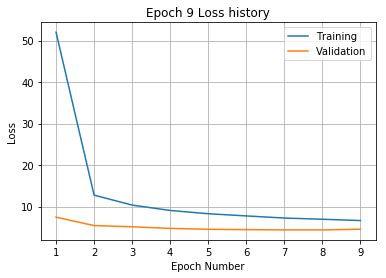

Training
Iteration 0: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.75 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 80: with minibatch training loss = 7 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.13 and relative erro

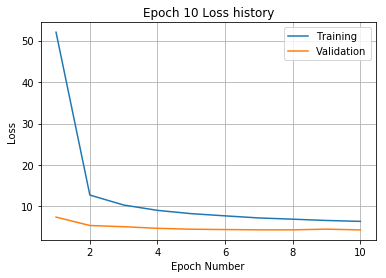

Training
Iteration 0: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.65 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.7 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.58 and relative error of 0.33
Iteration 140: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.4 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 240: with minibatch training loss = 6 and relative erro

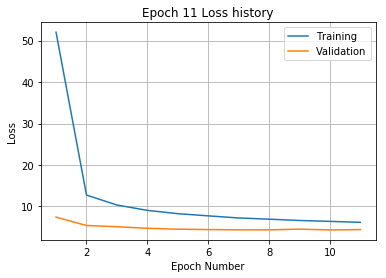

Training
Iteration 0: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.87 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.91 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 200: with minibatch training loss = 8.08 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 240: with minibatch training loss = 6.48 and relativ

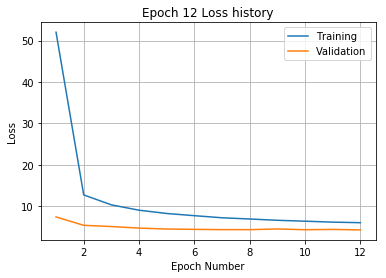

Training
Iteration 0: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 40: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.76 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.94 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.99 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.49 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.44 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.27 and relative e

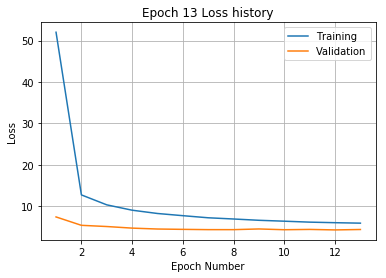

Training
Iteration 0: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 80: with minibatch training loss = 7.19 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.2 and relative error of 0.23
Iteration 140: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.59 and relative 

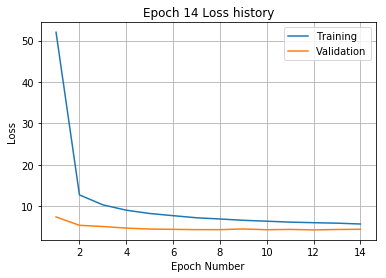

Training
Iteration 0: with minibatch training loss = 6.47 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.51 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 240: with minibatch training loss = 7.71 and relati

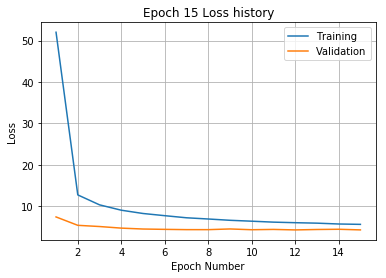

Training
Iteration 0: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.22 and relative error of 0.34
Iteration 40: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.59 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.19 and relative er

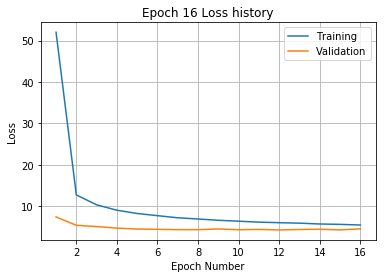

Training
Iteration 0: with minibatch training loss = 4.57 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.88 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.28 and relative error of 0.2
Iteration 120: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 160: with minibatch training loss = 3.76 and relative error of 0.21
Iteration 180: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.12 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.79 and relative error of 0.24
Iteration 240: with minibatch training loss = 5.16 and relativ

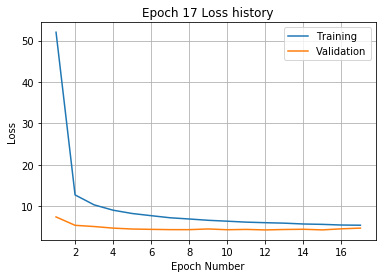

Validation error has stopped improving! Training on repetition 8 stopped!
Training
Iteration 0: with minibatch training loss = 205 and relative error of 1.6
Iteration 20: with minibatch training loss = 116 and relative error of 1.2
Iteration 40: with minibatch training loss = 79 and relative error of 0.95
Iteration 60: with minibatch training loss = 57.7 and relative error of 0.9
Iteration 80: with minibatch training loss = 41.8 and relative error of 0.74
Iteration 100: with minibatch training loss = 35.5 and relative error of 0.65
Iteration 120: with minibatch training loss = 25.9 and relative error of 0.57
Iteration 140: with minibatch training loss = 24.5 and relative error of 0.55
Iteration 160: with minibatch training loss = 16.6 and relative error of 0.46
Iteration 180: with minibatch training loss = 18.2 and relative error of 0.49
Iteration 200: with minibatch training loss = 18.3 and relative error of 0.49
Iteration 220: with minibatch training loss = 14.3 and relative error of

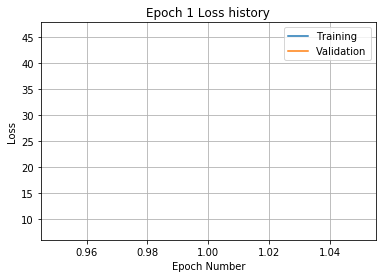

Training
Iteration 0: with minibatch training loss = 14.9 and relative error of 0.44
Iteration 20: with minibatch training loss = 12 and relative error of 0.39
Iteration 40: with minibatch training loss = 13.9 and relative error of 0.42
Iteration 60: with minibatch training loss = 13.1 and relative error of 0.42
Iteration 80: with minibatch training loss = 14.6 and relative error of 0.44
Iteration 100: with minibatch training loss = 17.1 and relative error of 0.47
Iteration 120: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 140: with minibatch training loss = 13.5 and relative error of 0.43
Iteration 160: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 180: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 200: with minibatch training loss = 12 and relative error of 0.39
Iteration 220: with minibatch training loss = 11.3 and relative error of 0.4
Iteration 240: with minibatch training loss = 11.1 and relative er

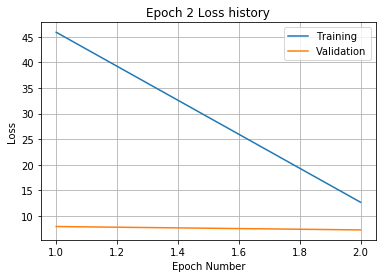

Training
Iteration 0: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 20: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 40: with minibatch training loss = 10.3 and relative error of 0.38
Iteration 60: with minibatch training loss = 8.86 and relative error of 0.33
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 100: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 120: with minibatch training loss = 9.36 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.6 and relative error of 0.36
Iteration 160: with minibatch training loss = 8.91 and relative error of 0.34
Iteration 180: with minibatch training loss = 9.02 and relative error of 0.35
Iteration 200: with minibatch training loss = 9.77 and relative error of 0.36
Iteration 220: with minibatch training loss = 9.35 and relative error of 0.35
Iteration 240: with minibatch training loss = 10.4 and relative

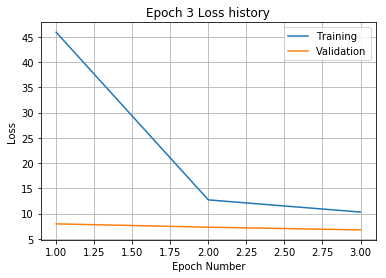

Training
Iteration 0: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 20: with minibatch training loss = 10.8 and relative error of 0.39
Iteration 40: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 60: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 80: with minibatch training loss = 8.27 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.55 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 140: with minibatch training loss = 9.56 and relative error of 0.35
Iteration 160: with minibatch training loss = 9.23 and relative error of 0.36
Iteration 180: with minibatch training loss = 9.86 and relative error of 0.35
Iteration 200: with minibatch training loss = 8.19 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.83 and relative error of 0.36
Iteration 240: with minibatch training loss = 9.28 and relativ

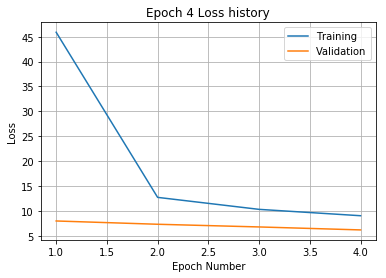

Training
Iteration 0: with minibatch training loss = 7.82 and relative error of 0.31
Iteration 20: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 40: with minibatch training loss = 8.17 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.83 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.53 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.67 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.29 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.35 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.4 and relative error of 0.31
Iteration 180: with minibatch training loss = 10 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.22 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.57 and relative error of 0.31
Iteration 240: with minibatch training loss = 9.27 and relative er

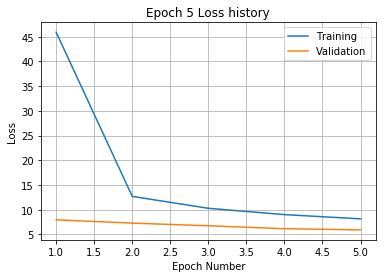

Training
Iteration 0: with minibatch training loss = 6.82 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.69 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.41 and relative error of 0.32
Iteration 60: with minibatch training loss = 9.63 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 240: with minibatch training loss = 9.09 and relative e

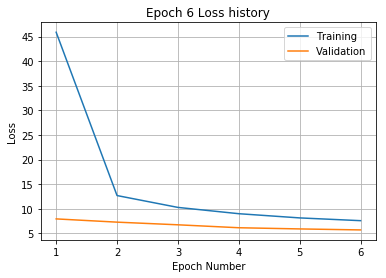

Training
Iteration 0: with minibatch training loss = 8.62 and relative error of 0.34
Iteration 20: with minibatch training loss = 9.08 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.9 and relative error of 0.33
Iteration 60: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 80: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.53 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.89 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.61 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.76 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.69 and relative error of 0.34
Iteration 240: with minibatch training loss = 6.91 and relative

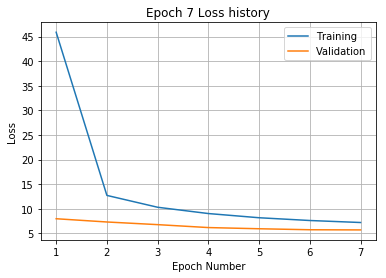

Training
Iteration 0: with minibatch training loss = 9.64 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.07 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.36 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.65 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 220: with minibatch training loss = 8.33 and relative error of 0.35
Iteration 240: with minibatch training loss = 4.86 and relative 

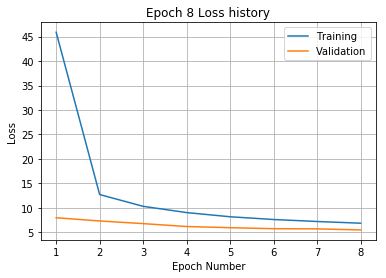

Training
Iteration 0: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.15 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.34 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.46 and relative error of 0.28
Iteration 180: with minibatch training loss = 9.36 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.35 and relative 

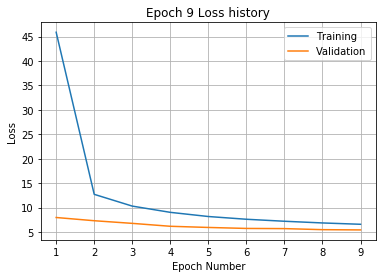

Training
Iteration 0: with minibatch training loss = 6.42 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 140: with minibatch training loss = 8.05 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.79 and relativ

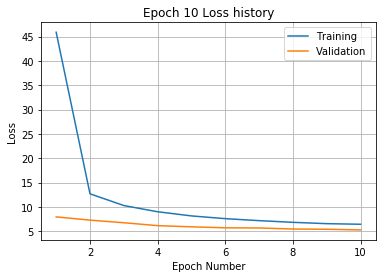

Training
Iteration 0: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.94 and relative error of 0.33
Iteration 140: with minibatch training loss = 10 and relative error of 0.35
Iteration 160: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.68 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.49 and relative 

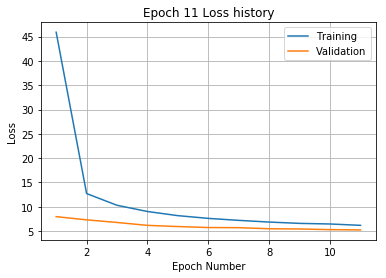

Training
Iteration 0: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.23 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.42 and relative error of 0.28
Iteration 120: with minibatch training loss = 9.21 and relative error of 0.35
Iteration 140: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 220: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 240: with minibatch training loss = 4.63 and relativ

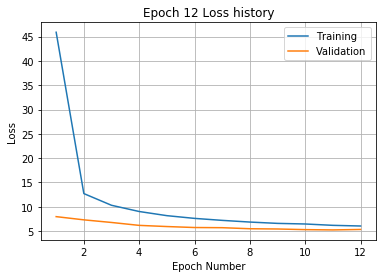

Training
Iteration 0: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.36 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.37 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 160: with minibatch training loss = 4 and relative error of 0.23
Iteration 180: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.47 and relative error of 0.25
Iteration 220: with minibatch training loss = 8.01 and relative error of 0.33
Iteration 240: with minibatch training loss = 4.12 and relative 

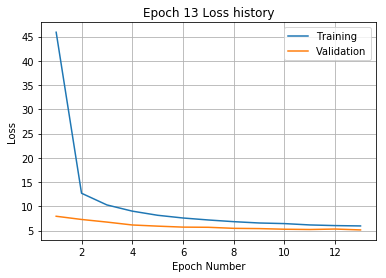

Training
Iteration 0: with minibatch training loss = 5.5 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 40: with minibatch training loss = 3.88 and relative error of 0.22
Iteration 60: with minibatch training loss = 5.53 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.17 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.88 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.91 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.8 and relative error of 0.22
Iteration 240: with minibatch training loss = 4.88 and relative

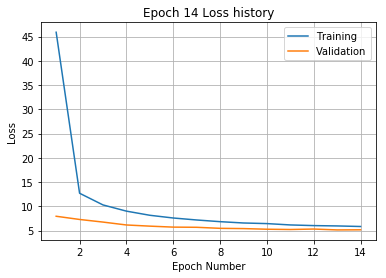

Training
Iteration 0: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 60: with minibatch training loss = 3.12 and relative error of 0.2
Iteration 80: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 240: with minibatch training loss = 7.24 and relative

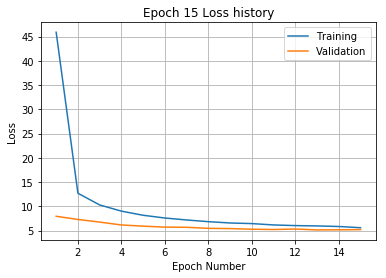

Training
Iteration 0: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 120: with minibatch training loss = 3.44 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.59 and relati

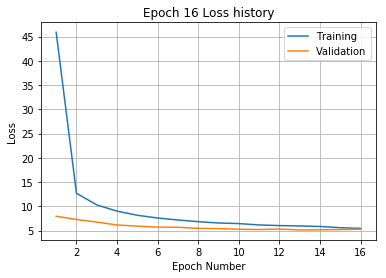

Training
Iteration 0: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.02 and relative error of 0.22
Iteration 80: with minibatch training loss = 5.04 and relative error of 0.24
Iteration 100: with minibatch training loss = 7.26 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 140: with minibatch training loss = 3.09 and relative error of 0.2
Iteration 160: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.84 and relative error of 0.23
Iteration 240: with minibatch training loss = 4.99 and relative

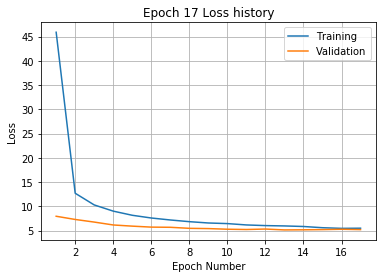

Training
Iteration 0: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.01 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.35 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.17 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 120: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.16 and relative

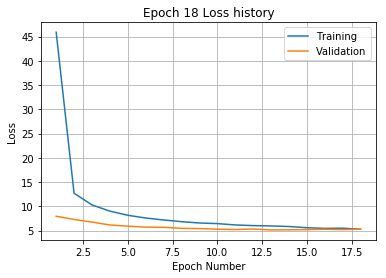

Validation error has stopped improving! Training on repetition 9 stopped!
Training
Iteration 0: with minibatch training loss = 235 and relative error of 1.7
Iteration 20: with minibatch training loss = 154 and relative error of 1.3
Iteration 40: with minibatch training loss = 76.6 and relative error of 1
Iteration 60: with minibatch training loss = 76.3 and relative error of 0.98
Iteration 80: with minibatch training loss = 47.4 and relative error of 0.81
Iteration 100: with minibatch training loss = 41.9 and relative error of 0.73
Iteration 120: with minibatch training loss = 30.6 and relative error of 0.64
Iteration 140: with minibatch training loss = 23.9 and relative error of 0.55
Iteration 160: with minibatch training loss = 23.1 and relative error of 0.54
Iteration 180: with minibatch training loss = 17.2 and relative error of 0.49
Iteration 200: with minibatch training loss = 18.6 and relative error of 0.5
Iteration 220: with minibatch training loss = 15.8 and relative error of 

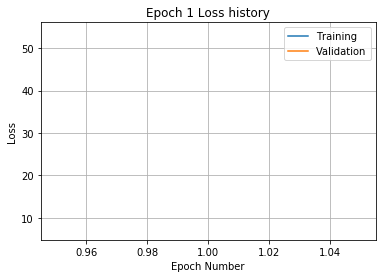

Training
Iteration 0: with minibatch training loss = 18.6 and relative error of 0.47
Iteration 20: with minibatch training loss = 15.3 and relative error of 0.45
Iteration 40: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 60: with minibatch training loss = 14.5 and relative error of 0.42
Iteration 80: with minibatch training loss = 15.1 and relative error of 0.43
Iteration 100: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 120: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 140: with minibatch training loss = 12.9 and relative error of 0.41
Iteration 160: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 180: with minibatch training loss = 9.99 and relative error of 0.37
Iteration 200: with minibatch training loss = 12.9 and relative error of 0.44
Iteration 220: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 240: with minibatch training loss = 13.1 and relativ

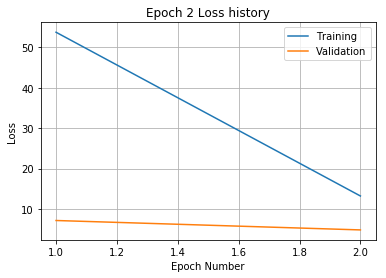

Training
Iteration 0: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 20: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 40: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 60: with minibatch training loss = 13.5 and relative error of 0.43
Iteration 80: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 100: with minibatch training loss = 11 and relative error of 0.37
Iteration 120: with minibatch training loss = 9.75 and relative error of 0.37
Iteration 140: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 160: with minibatch training loss = 9.3 and relative error of 0.36
Iteration 180: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 200: with minibatch training loss = 10.2 and relative error of 0.35
Iteration 220: with minibatch training loss = 9.13 and relative error of 0.34
Iteration 240: with minibatch training loss = 13 and relative err

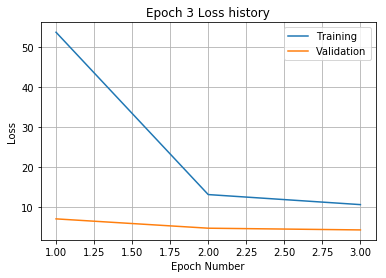

Training
Iteration 0: with minibatch training loss = 8.28 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.21 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.43 and relative error of 0.35
Iteration 60: with minibatch training loss = 9.49 and relative error of 0.34
Iteration 80: with minibatch training loss = 9 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.5 and relative error of 0.34
Iteration 120: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 140: with minibatch training loss = 11 and relative error of 0.39
Iteration 160: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 180: with minibatch training loss = 9.09 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.76 and relative error of 0.31
Iteration 220: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 240: with minibatch training loss = 7.1 and relative erro

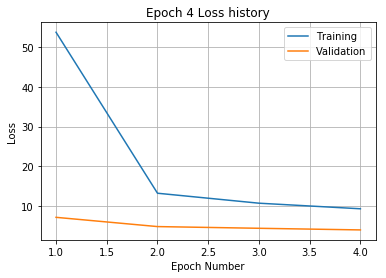

Training
Iteration 0: with minibatch training loss = 8.11 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.31 and relative error of 0.32
Iteration 40: with minibatch training loss = 10.1 and relative error of 0.35
Iteration 60: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 100: with minibatch training loss = 9.13 and relative error of 0.35
Iteration 120: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 140: with minibatch training loss = 8.44 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.81 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.76 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.83 and relative error of 0.35
Iteration 220: with minibatch training loss = 8.64 and relative error of 0.33
Iteration 240: with minibatch training loss = 7.3 and relative e

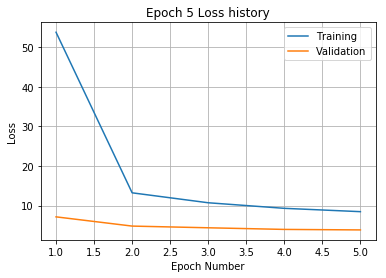

Training
Iteration 0: with minibatch training loss = 9.15 and relative error of 0.35
Iteration 20: with minibatch training loss = 8.3 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.27 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.26 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.39 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 120: with minibatch training loss = 9.71 and relative error of 0.35
Iteration 140: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 200: with minibatch training loss = 8.02 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 240: with minibatch training loss = 7.38 and relativ

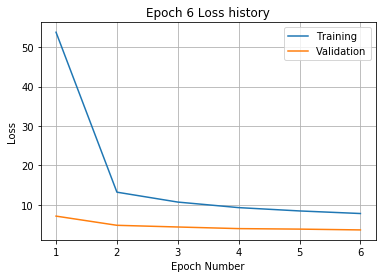

Training
Iteration 0: with minibatch training loss = 9.24 and relative error of 0.34
Iteration 20: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.82 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.81 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.8 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.46 and relative error of 0.28
Iteration 180: with minibatch training loss = 9.85 and relative error of 0.35
Iteration 200: with minibatch training loss = 5.14 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.3 and relative 

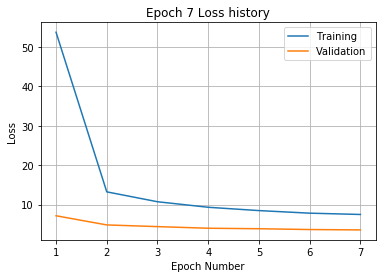

Training
Iteration 0: with minibatch training loss = 8.19 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.19 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 120: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 160: with minibatch training loss = 8.55 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.74 and relative error of 0.37
Iteration 200: with minibatch training loss = 8.31 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.51 and relative error of 0.35
Iteration 240: with minibatch training loss = 6.44 and relative e

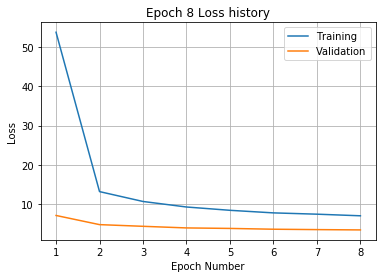

Training
Iteration 0: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.87 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.54 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.85 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.04 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.64 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.33 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.36 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.62 and relative

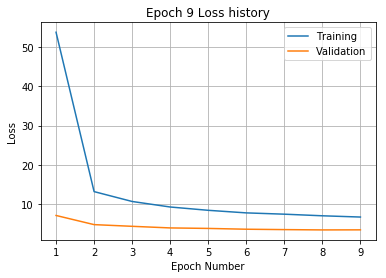

Training
Iteration 0: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.82 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 120: with minibatch training loss = 9.04 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.41 and relative error of 0.32
Iteration 160: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 180: with minibatch training loss = 8.21 and relative error of 0.32
Iteration 200: with minibatch training loss = 3.62 and relative error of 0.21
Iteration 220: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.68 and relativ

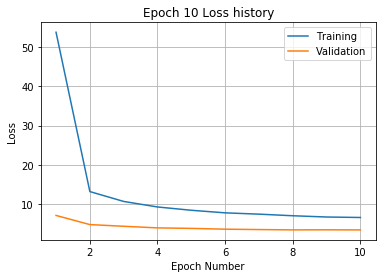

Training
Iteration 0: with minibatch training loss = 7.69 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.37 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.86 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 240: with minibatch training loss = 5.88 and relati

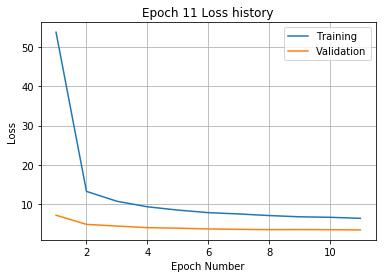

Training
Iteration 0: with minibatch training loss = 6.31 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.61 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.38 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.41 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.41 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.99 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.46 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.3 and relative error of 0.25
Iteration 240: with minibatch training loss = 6.18 and relativ

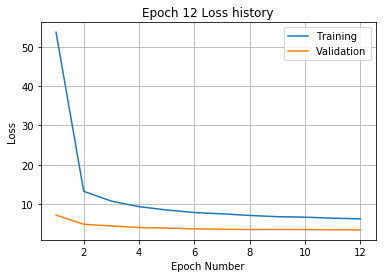

Training
Iteration 0: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.57 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.57 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.57 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.87 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 220: with minibatch training loss = 2.99 and relative error of 0.21
Iteration 240: with minibatch training loss = 6.68 and relativ

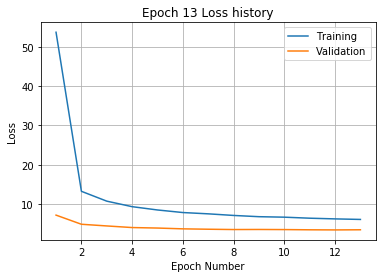

Training
Iteration 0: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 20: with minibatch training loss = 6 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.59 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.74 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.27 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.04 and relative e

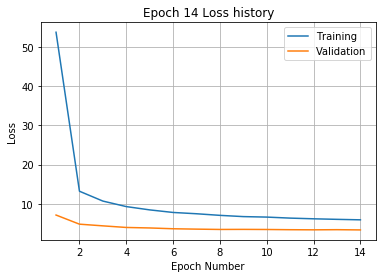

Training
Iteration 0: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.41 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.07 and relative error of 0.3
Iteration 80: with minibatch training loss = 3.96 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 120: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.72 and relative 

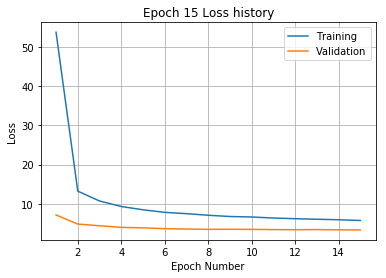

Training
Iteration 0: with minibatch training loss = 6.57 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.59 and relativ

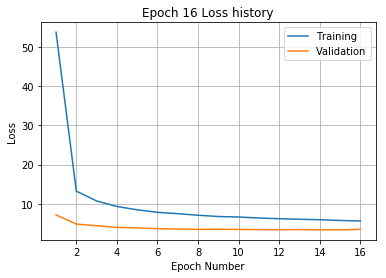

Training
Iteration 0: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 20: with minibatch training loss = 3.73 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.48 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 120: with minibatch training loss = 6.23 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.03 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.01 and relative

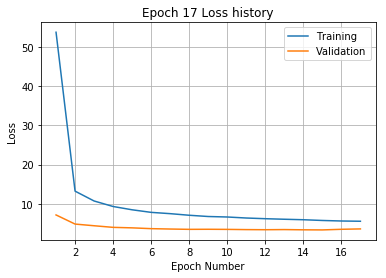

Training
Iteration 0: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 20: with minibatch training loss = 3.45 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 60: with minibatch training loss = 2.86 and relative error of 0.2
Iteration 80: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.13 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.03 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.33 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 240: with minibatch training loss = 6.97 and relative e

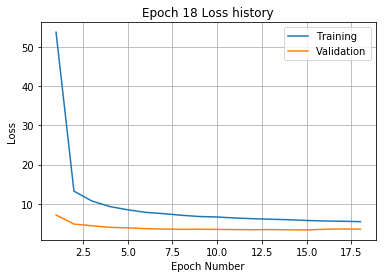

Training
Iteration 0: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 140: with minibatch training loss = 8.18 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 180: with minibatch training loss = 3.33 and relative error of 0.2
Iteration 200: with minibatch training loss = 4.69 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.37 and relative e

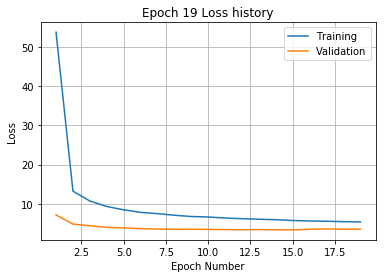

Training
Iteration 0: with minibatch training loss = 5.59 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 100: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 120: with minibatch training loss = 3.38 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.09 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.04 and relative error of 0.31
Iteration 220: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 240: with minibatch training loss = 5 and relative 

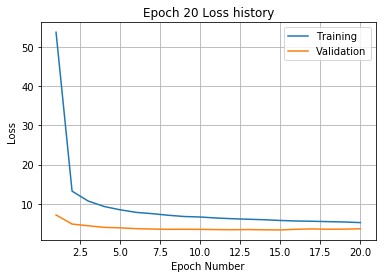

Validation error has stopped improving! Training on repetition 10 stopped!
log interval:  20 seconds
loading data
stacking image log's channels
Training
Iteration 0: with minibatch training loss = 211 and relative error of 1.7
Iteration 20: with minibatch training loss = 104 and relative error of 1.2
Iteration 40: with minibatch training loss = 66.9 and relative error of 0.94
Iteration 60: with minibatch training loss = 54.3 and relative error of 0.8
Iteration 80: with minibatch training loss = 38.2 and relative error of 0.71
Iteration 100: with minibatch training loss = 30.4 and relative error of 0.64
Iteration 120: with minibatch training loss = 24.8 and relative error of 0.57
Iteration 140: with minibatch training loss = 18.7 and relative error of 0.49
Iteration 160: with minibatch training loss = 17 and relative error of 0.48
Iteration 180: with minibatch training loss = 15.9 and relative error of 0.43
Iteration 200: with minibatch training loss = 13.9 and relative error of 0.42
It

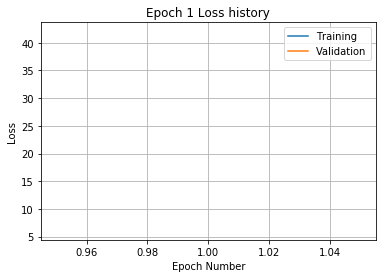

Training
Iteration 0: with minibatch training loss = 12.4 and relative error of 0.41
Iteration 20: with minibatch training loss = 12.1 and relative error of 0.38
Iteration 40: with minibatch training loss = 13.6 and relative error of 0.41
Iteration 60: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 100: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 120: with minibatch training loss = 11.1 and relative error of 0.41
Iteration 140: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 160: with minibatch training loss = 9.39 and relative error of 0.36
Iteration 180: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 200: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.9 and relative error of 0.34
Epoch 2, Overall loss = 11.9, relative error = 0.395, and proce

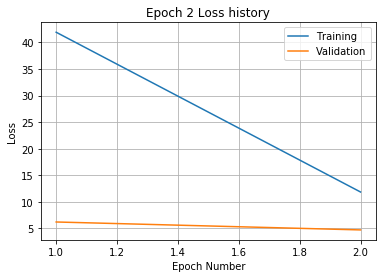

Training
Iteration 0: with minibatch training loss = 9.03 and relative error of 0.36
Iteration 20: with minibatch training loss = 11 and relative error of 0.38
Iteration 40: with minibatch training loss = 8.45 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.58 and relative error of 0.33
Iteration 80: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 100: with minibatch training loss = 9.79 and relative error of 0.37
Iteration 120: with minibatch training loss = 8.25 and relative error of 0.33
Iteration 140: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 160: with minibatch training loss = 7.93 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.39 and relative error of 0.33
Iteration 200: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 220: with minibatch training loss = 8.14 and relative error of 0.32
Epoch 3, Overall loss = 9.94, relative error = 0.361, and proce

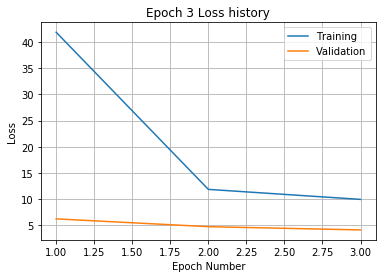

Training
Iteration 0: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.77 and relative error of 0.34
Iteration 40: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 60: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 80: with minibatch training loss = 8.36 and relative error of 0.32
Iteration 100: with minibatch training loss = 9.48 and relative error of 0.36
Iteration 120: with minibatch training loss = 9.24 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.35 and relative error of 0.34
Iteration 180: with minibatch training loss = 8.95 and relative error of 0.35
Iteration 200: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 220: with minibatch training loss = 7.07 and relative error of 0.31
Epoch 4, Overall loss = 8.76, relative error = 0.34, and proc

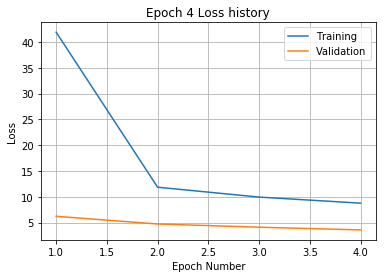

Training
Iteration 0: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.45 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.74 and relative error of 0.35
Iteration 60: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 80: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 100: with minibatch training loss = 8.91 and relative error of 0.35
Iteration 120: with minibatch training loss = 10 and relative error of 0.35
Iteration 140: with minibatch training loss = 6.75 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.65 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.58 and relative error of 0.3
Iteration 220: with minibatch training loss = 9.43 and relative error of 0.36
Epoch 5, Overall loss = 7.96, relative error = 0.323, and process

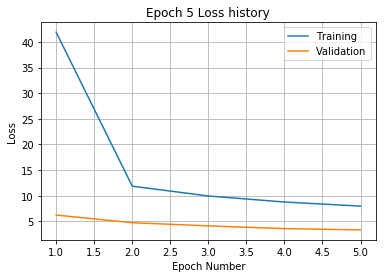

Training
Iteration 0: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 20: with minibatch training loss = 9.95 and relative error of 0.36
Iteration 40: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.35 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.96 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 220: with minibatch training loss = 8.92 and relative error of 0.34
Epoch 6, Overall loss = 7.43, relative error = 0.313, and proc

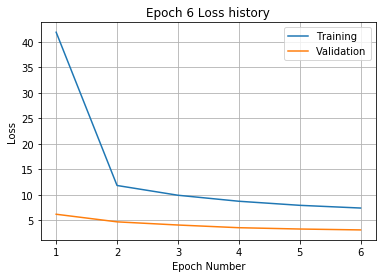

Training
Iteration 0: with minibatch training loss = 8.62 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.99 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.82 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.81 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.19 and relative error of 0.32
Epoch 7, Overall loss = 7.11, relative error = 0.305, and proces

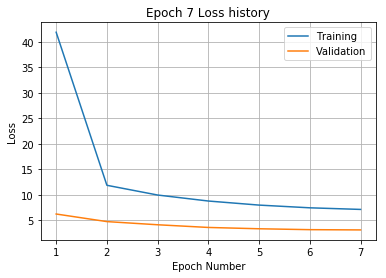

Training
Iteration 0: with minibatch training loss = 5.87 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.3 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.66 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.42 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 120: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 140: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.62 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.54 and relative error of 0.27
Epoch 8, Overall loss = 6.85, relative error = 0.3, and process

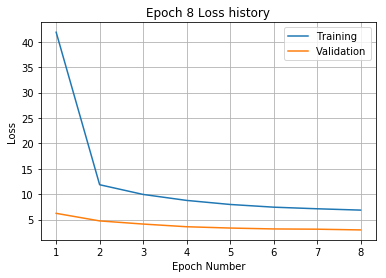

Training
Iteration 0: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 20: with minibatch training loss = 8.58 and relative error of 0.35
Iteration 40: with minibatch training loss = 7.07 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.37 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.06 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.32 and relative error of 0.25
Epoch 9, Overall loss = 6.54, relative error = 0.293, and process 

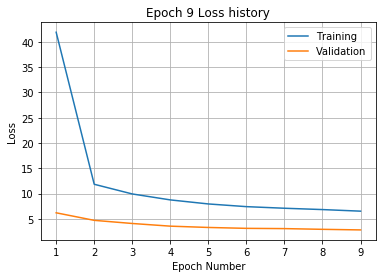

Training
Iteration 0: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.89 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.92 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.99 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.29 and relative error of 0.3
Epoch 10, Overall loss = 6.37, relative error = 0.289, and proc

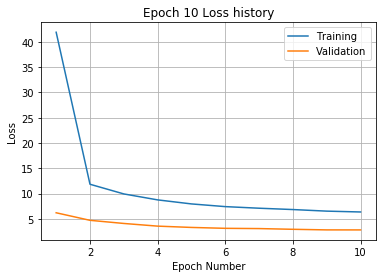

Training
Iteration 0: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.21 and relative error of 0.28
Epoch 11, Overall loss = 6.15, relative error = 0.284, and pro

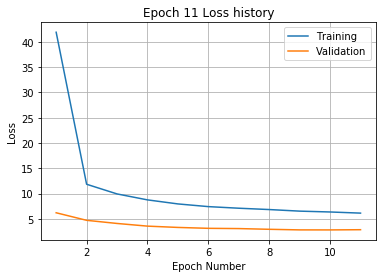

Training
Iteration 0: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 20: with minibatch training loss = 7.15 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.88 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.8 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.45 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.61 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.62 and relative error of 0.24
Epoch 12, Overall loss = 5.94, relative error = 0.279, and proc

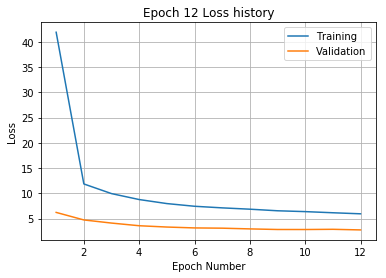

Training
Iteration 0: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 120: with minibatch training loss = 6 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.58 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.13 and relative error of 0.26
Epoch 13, Overall loss = 5.84, relative error = 0.277, and proce

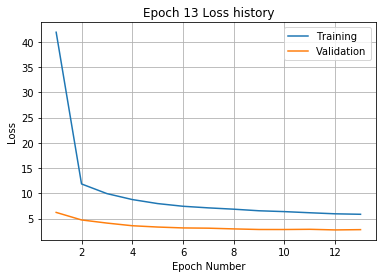

Training
Iteration 0: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.87 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.16 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.08 and relative error of 0.26
Epoch 14, Overall loss = 5.69, relative error = 0.273, and pro

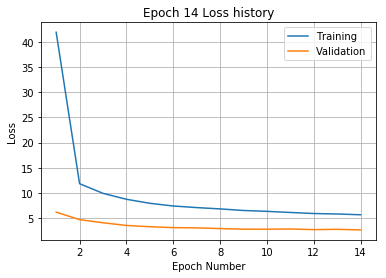

Training
Iteration 0: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 80: with minibatch training loss = 4.24 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.26 and relative error of 0.26
Epoch 15, Overall loss = 5.63, relative error = 0.272, and pro

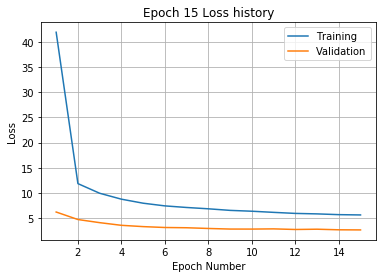

Training
Iteration 0: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.79 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.35 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.38 and relative error of 0.23
Epoch 16, Overall loss = 5.51, relative error = 0.269, and proc

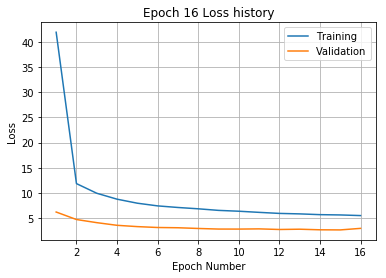

Training
Iteration 0: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 20: with minibatch training loss = 8.01 and relative error of 0.32
Iteration 40: with minibatch training loss = 3.96 and relative error of 0.22
Iteration 60: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 80: with minibatch training loss = 8.39 and relative error of 0.32
Iteration 100: with minibatch training loss = 4.75 and relative error of 0.24
Iteration 120: with minibatch training loss = 3.78 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 220: with minibatch training loss = 3.8 and relative error of 0.23
Epoch 17, Overall loss = 5.29, relative error = 0.263, and pro

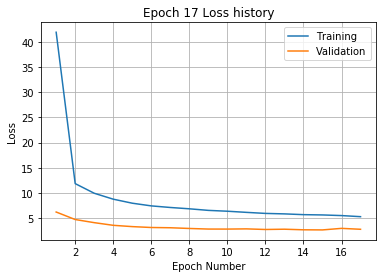

Training
Iteration 0: with minibatch training loss = 4.43 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.12 and relative error of 0.24
Iteration 40: with minibatch training loss = 8.01 and relative error of 0.33
Iteration 60: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.06 and relative error of 0.28
Epoch 18, Overall loss = 5.22, relative error = 0.262, and pro

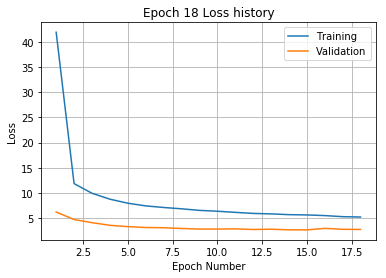

Training
Iteration 0: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.16 and relative error of 0.23
Iteration 60: with minibatch training loss = 3.21 and relative error of 0.21
Iteration 80: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 140: with minibatch training loss = 3.9 and relative error of 0.22
Iteration 160: with minibatch training loss = 3.43 and relative error of 0.21
Iteration 180: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.14 and relative error of 0.24
Epoch 19, Overall loss = 5.12, relative error = 0.259, and proce

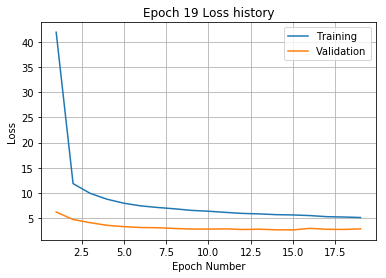

Training
Iteration 0: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.47 and relative error of 0.21
Iteration 40: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 60: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.01 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 120: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.33 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.35 and relative error of 0.26
Epoch 20, Overall loss = 5.05, relative error = 0.257, and pro

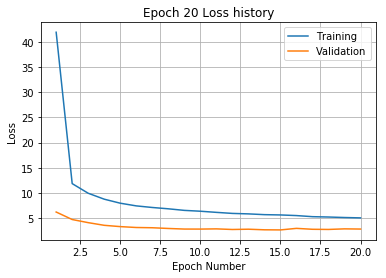

Validation error has stopped improving! Training on repetition 1 stopped!
Training
Iteration 0: with minibatch training loss = 177 and relative error of 1.5
Iteration 20: with minibatch training loss = 102 and relative error of 1.2
Iteration 40: with minibatch training loss = 69.3 and relative error of 0.95
Iteration 60: with minibatch training loss = 55.2 and relative error of 0.81
Iteration 80: with minibatch training loss = 40.2 and relative error of 0.69
Iteration 100: with minibatch training loss = 27.7 and relative error of 0.62
Iteration 120: with minibatch training loss = 22.9 and relative error of 0.55
Iteration 140: with minibatch training loss = 17 and relative error of 0.47
Iteration 160: with minibatch training loss = 19.2 and relative error of 0.51
Iteration 180: with minibatch training loss = 17.2 and relative error of 0.46
Iteration 200: with minibatch training loss = 16.3 and relative error of 0.46
Iteration 220: with minibatch training loss = 15.3 and relative error o

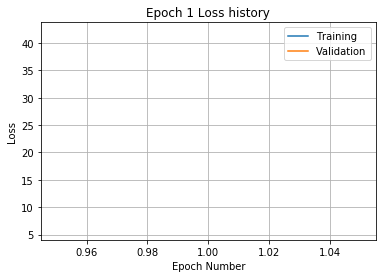

Training
Iteration 0: with minibatch training loss = 14.8 and relative error of 0.43
Iteration 20: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 40: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 60: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 80: with minibatch training loss = 15.7 and relative error of 0.44
Iteration 100: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 120: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 140: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 160: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 180: with minibatch training loss = 8.64 and relative error of 0.33
Iteration 200: with minibatch training loss = 13.2 and relative error of 0.41
Iteration 220: with minibatch training loss = 8.11 and relative error of 0.33
Epoch 2, Overall loss = 12.1, relative error = 0.398, and proc

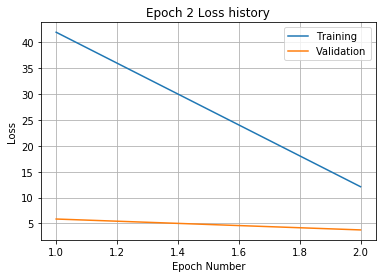

Training
Iteration 0: with minibatch training loss = 9.46 and relative error of 0.34
Iteration 20: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 40: with minibatch training loss = 8.11 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.87 and relative error of 0.34
Iteration 100: with minibatch training loss = 9.98 and relative error of 0.36
Iteration 120: with minibatch training loss = 9.82 and relative error of 0.35
Iteration 140: with minibatch training loss = 7.71 and relative error of 0.32
Iteration 160: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 180: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.98 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.21 and relative error of 0.34
Epoch 3, Overall loss = 9.79, relative error = 0.358, and pro

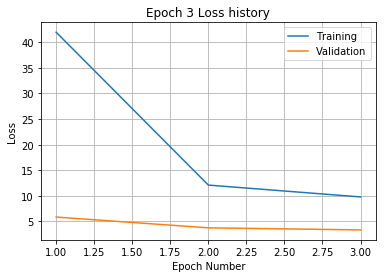

Training
Iteration 0: with minibatch training loss = 9.66 and relative error of 0.36
Iteration 20: with minibatch training loss = 9.01 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.51 and relative error of 0.35
Iteration 60: with minibatch training loss = 7.66 and relative error of 0.32
Iteration 80: with minibatch training loss = 12 and relative error of 0.4
Iteration 100: with minibatch training loss = 8.56 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 160: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 180: with minibatch training loss = 11.9 and relative error of 0.38
Iteration 200: with minibatch training loss = 7.59 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.74 and relative error of 0.32
Epoch 4, Overall loss = 8.63, relative error = 0.336, and proces

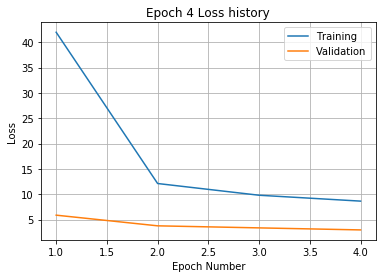

Training
Iteration 0: with minibatch training loss = 7.58 and relative error of 0.32
Iteration 20: with minibatch training loss = 9.17 and relative error of 0.35
Iteration 40: with minibatch training loss = 7.79 and relative error of 0.33
Iteration 60: with minibatch training loss = 7.96 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.74 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.46 and relative error of 0.28
Iteration 120: with minibatch training loss = 8.53 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 160: with minibatch training loss = 8.02 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 220: with minibatch training loss = 9.3 and relative error of 0.34
Epoch 5, Overall loss = 7.96, relative error = 0.322, and proce

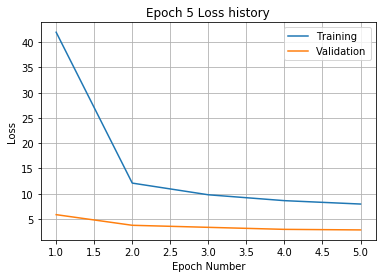

Training
Iteration 0: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.36 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.91 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 120: with minibatch training loss = 5.62 and relative error of 0.26
Iteration 140: with minibatch training loss = 8.82 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.71 and relative error of 0.3
Iteration 220: with minibatch training loss = 8.91 and relative error of 0.35
Epoch 6, Overall loss = 7.45, relative error = 0.312, and proce

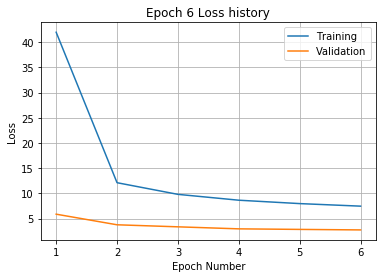

Training
Iteration 0: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.04 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.99 and relative error of 0.33
Iteration 120: with minibatch training loss = 5.79 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.84 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.78 and relative error of 0.24
Iteration 220: with minibatch training loss = 8.01 and relative error of 0.31
Epoch 7, Overall loss = 7.07, relative error = 0.304, and proces

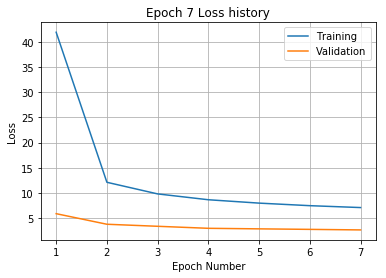

Training
Iteration 0: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 20: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 40: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.34
Iteration 100: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.91 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.62 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.56 and relative error of 0.29
Epoch 8, Overall loss = 6.73, relative error = 0.297, and proce

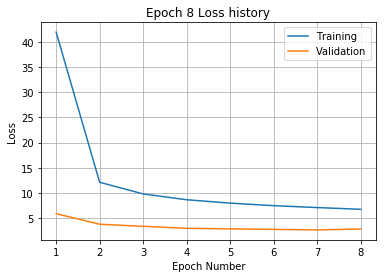

Training
Iteration 0: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.5 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.09 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.74 and relative error of 0.35
Iteration 160: with minibatch training loss = 5.76 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.54 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.29 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.79 and relative error of 0.29
Epoch 9, Overall loss = 6.5, relative error = 0.292, and process t

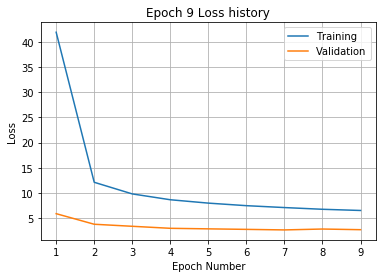

Training
Iteration 0: with minibatch training loss = 8.07 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.11 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 100: with minibatch training loss = 6 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 140: with minibatch training loss = 6 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.07 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.04 and relative error of 0.22
Epoch 10, Overall loss = 6.21, relative error = 0.285, and process t

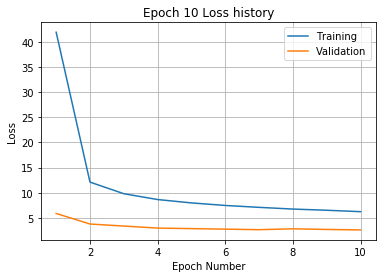

Training
Iteration 0: with minibatch training loss = 5.89 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 160: with minibatch training loss = 3.86 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.49 and relative error of 0.27
Epoch 11, Overall loss = 6.06, relative error = 0.281, and pr

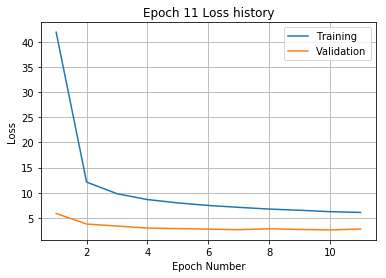

Training
Iteration 0: with minibatch training loss = 5.8 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.17 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.34 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.48 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.46 and relative error of 0.27
Epoch 12, Overall loss = 5.91, relative error = 0.278, and proc

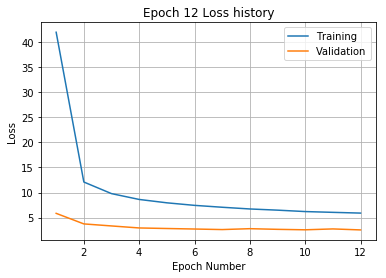

Training
Iteration 0: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.55 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 120: with minibatch training loss = 9.05 and relative error of 0.34
Iteration 140: with minibatch training loss = 5.16 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.36 and relative error of 0.34
Iteration 220: with minibatch training loss = 4.62 and relative error of 0.25
Epoch 13, Overall loss = 5.76, relative error = 0.274, and pr

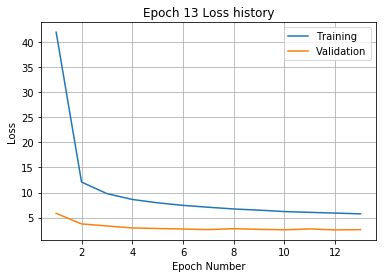

Training
Iteration 0: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 40: with minibatch training loss = 3.93 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 80: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.13 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.39 and relative error of 0.33
Iteration 220: with minibatch training loss = 3.24 and relative error of 0.2
Epoch 14, Overall loss = 5.62, relative error = 0.271, and proce

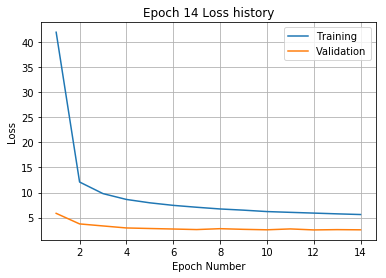

Training
Iteration 0: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 20: with minibatch training loss = 3.68 and relative error of 0.21
Iteration 40: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.17 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.93 and relative error of 0.23
Epoch 15, Overall loss = 5.5, relative error = 0.268, and pro

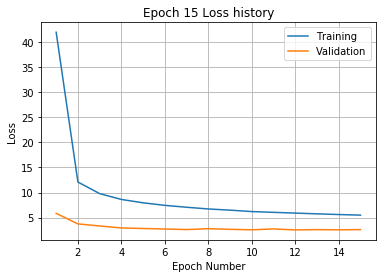

Training
Iteration 0: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.44 and relative error of 0.25
Iteration 40: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 60: with minibatch training loss = 3.98 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 200: with minibatch training loss = 6 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.44 and relative error of 0.26
Epoch 16, Overall loss = 5.4, relative error = 0.265, and process

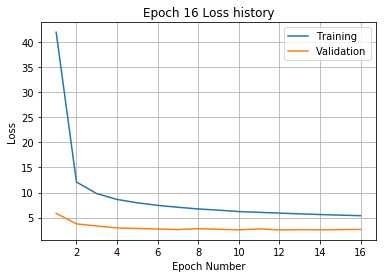

Training
Iteration 0: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.57 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.52 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.59 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.09 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.22 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.43 and relative error of 0.23
Epoch 17, Overall loss = 5.32, relative error = 0.263, and pro

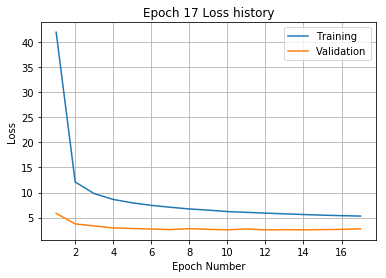

Validation error has stopped improving! Training on repetition 2 stopped!
Training
Iteration 0: with minibatch training loss = 194 and relative error of 1.6
Iteration 20: with minibatch training loss = 109 and relative error of 1.2
Iteration 40: with minibatch training loss = 71.8 and relative error of 1
Iteration 60: with minibatch training loss = 59.9 and relative error of 0.88
Iteration 80: with minibatch training loss = 43.6 and relative error of 0.77
Iteration 100: with minibatch training loss = 31.7 and relative error of 0.64
Iteration 120: with minibatch training loss = 23.9 and relative error of 0.56
Iteration 140: with minibatch training loss = 19.6 and relative error of 0.52
Iteration 160: with minibatch training loss = 18.8 and relative error of 0.47
Iteration 180: with minibatch training loss = 14.6 and relative error of 0.45
Iteration 200: with minibatch training loss = 14.2 and relative error of 0.42
Iteration 220: with minibatch training loss = 14.6 and relative error of

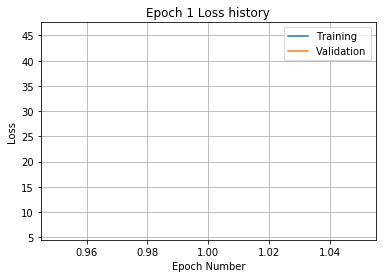

Training
Iteration 0: with minibatch training loss = 14.7 and relative error of 0.43
Iteration 20: with minibatch training loss = 18.4 and relative error of 0.49
Iteration 40: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 60: with minibatch training loss = 12.8 and relative error of 0.4
Iteration 80: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 100: with minibatch training loss = 12.3 and relative error of 0.39
Iteration 120: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 140: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 160: with minibatch training loss = 13.5 and relative error of 0.42
Iteration 180: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 200: with minibatch training loss = 13.1 and relative error of 0.43
Iteration 220: with minibatch training loss = 9.36 and relative error of 0.35
Epoch 2, Overall loss = 12.4, relative error = 0.404, and proce

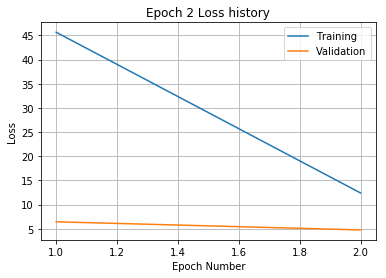

Training
Iteration 0: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 20: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 40: with minibatch training loss = 9.85 and relative error of 0.38
Iteration 60: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 80: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 100: with minibatch training loss = 8.51 and relative error of 0.34
Iteration 120: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 140: with minibatch training loss = 10 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.97 and relative error of 0.34
Iteration 180: with minibatch training loss = 8.04 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.31 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.82 and relative error of 0.34
Epoch 3, Overall loss = 10.1, relative error = 0.364, and process

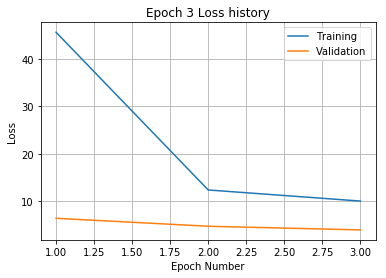

Training
Iteration 0: with minibatch training loss = 9.09 and relative error of 0.35
Iteration 20: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 40: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 60: with minibatch training loss = 10 and relative error of 0.36
Iteration 80: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 100: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 120: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 140: with minibatch training loss = 6.83 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.75 and relative error of 0.34
Iteration 180: with minibatch training loss = 9.95 and relative error of 0.37
Iteration 200: with minibatch training loss = 8.32 and relative error of 0.35
Iteration 220: with minibatch training loss = 9.46 and relative error of 0.35
Epoch 4, Overall loss = 8.92, relative error = 0.343, and proce

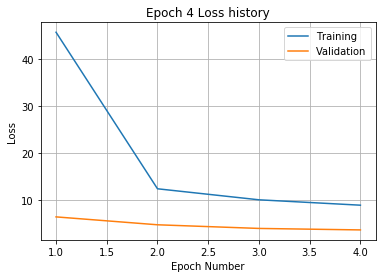

Training
Iteration 0: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.89 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 60: with minibatch training loss = 9.53 and relative error of 0.36
Iteration 80: with minibatch training loss = 7.4 and relative error of 0.3
Iteration 100: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 120: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.33 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 200: with minibatch training loss = 9.16 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.35 and relative error of 0.33
Epoch 5, Overall loss = 8.13, relative error = 0.327, and process

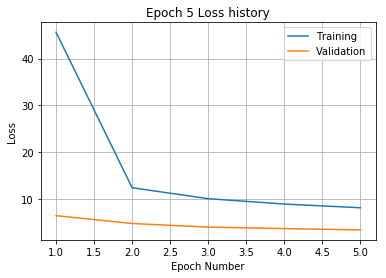

Training
Iteration 0: with minibatch training loss = 8.97 and relative error of 0.34
Iteration 20: with minibatch training loss = 9.46 and relative error of 0.35
Iteration 40: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 120: with minibatch training loss = 8.81 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.39 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.53 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.92 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.07 and relative error of 0.33
Epoch 6, Overall loss = 7.61, relative error = 0.316, and proc

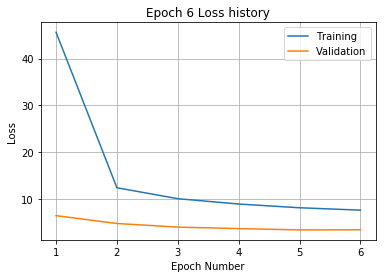

Training
Iteration 0: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 40: with minibatch training loss = 9.11 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.13 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.54 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.17 and relative error of 0.28
Epoch 7, Overall loss = 7.25, relative error = 0.308, and proce

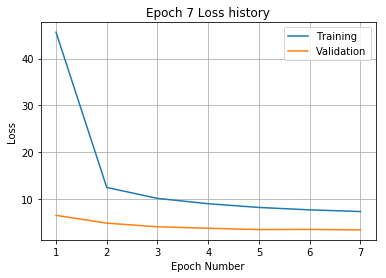

Training
Iteration 0: with minibatch training loss = 7.8 and relative error of 0.33
Iteration 20: with minibatch training loss = 5.77 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.91 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.02 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.81 and relative error of 0.34
Iteration 100: with minibatch training loss = 9.39 and relative error of 0.34
Iteration 120: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.26 and relative error of 0.33
Epoch 8, Overall loss = 6.87, relative error = 0.3, and proces

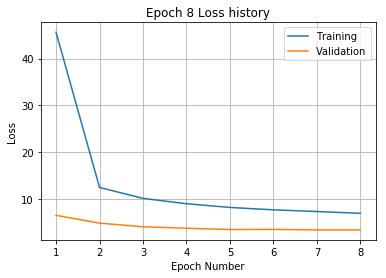

Training
Iteration 0: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.88 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.17 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.5 and relative error of 0.32
Epoch 9, Overall loss = 6.62, relative error = 0.295, and process 

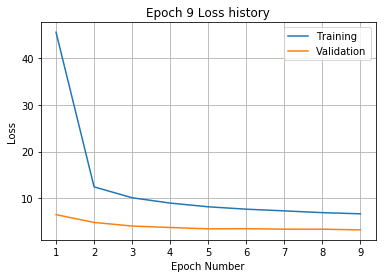

Training
Iteration 0: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.56 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.65 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 120: with minibatch training loss = 7.6 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.71 and relative error of 0.27
Epoch 10, Overall loss = 6.4, relative error = 0.29, and process

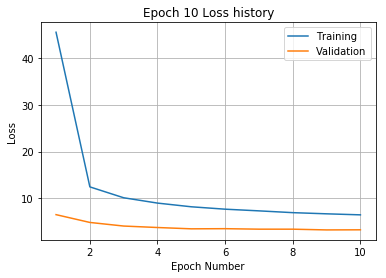

Training
Iteration 0: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 20: with minibatch training loss = 7.65 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 60: with minibatch training loss = 5.68 and relative error of 0.26
Iteration 80: with minibatch training loss = 7.54 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.87 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.71 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.71 and relative error of 0.29
Epoch 11, Overall loss = 6.23, relative error = 0.286, and pro

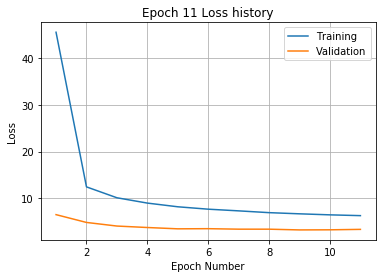

Training
Iteration 0: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 20: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.6 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.91 and relative error of 0.32
Epoch 12, Overall loss = 6.07, relative error = 0.282, and proce

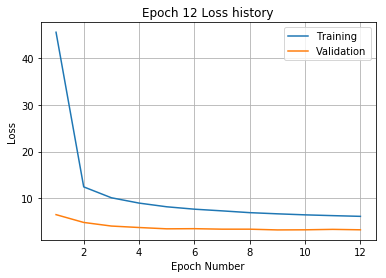

Training
Iteration 0: with minibatch training loss = 5.86 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 40: with minibatch training loss = 8.08 and relative error of 0.34
Iteration 60: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.36 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.84 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.91 and relative error of 0.32
Epoch 13, Overall loss = 5.9, relative error = 0.278, and proce

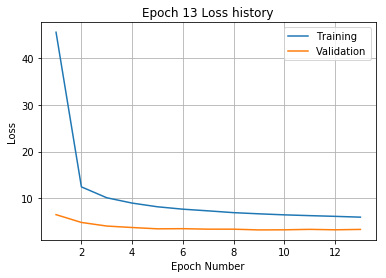

Training
Iteration 0: with minibatch training loss = 3.75 and relative error of 0.22
Iteration 20: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.55 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.21 and relative error of 0.28
Epoch 14, Overall loss = 5.81, relative error = 0.276, and proc

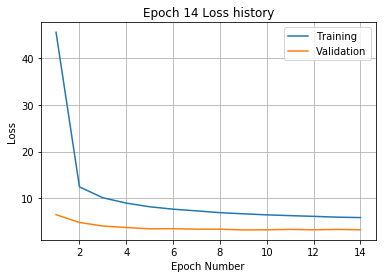

Validation error has stopped improving! Training on repetition 3 stopped!
Training
Iteration 0: with minibatch training loss = 235 and relative error of 1.8
Iteration 20: with minibatch training loss = 132 and relative error of 1.3
Iteration 40: with minibatch training loss = 86.5 and relative error of 1.1
Iteration 60: with minibatch training loss = 63.4 and relative error of 0.92
Iteration 80: with minibatch training loss = 46.7 and relative error of 0.79
Iteration 100: with minibatch training loss = 39.7 and relative error of 0.72
Iteration 120: with minibatch training loss = 28.1 and relative error of 0.6
Iteration 140: with minibatch training loss = 22.5 and relative error of 0.57
Iteration 160: with minibatch training loss = 21.2 and relative error of 0.53
Iteration 180: with minibatch training loss = 19.7 and relative error of 0.5
Iteration 200: with minibatch training loss = 18.4 and relative error of 0.48
Iteration 220: with minibatch training loss = 17.6 and relative error of

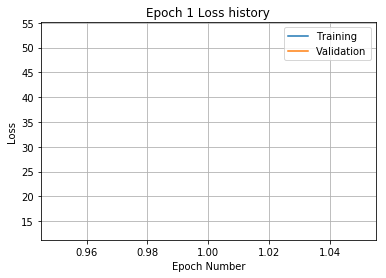

Training
Iteration 0: with minibatch training loss = 17.4 and relative error of 0.48
Iteration 20: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 40: with minibatch training loss = 12.6 and relative error of 0.43
Iteration 60: with minibatch training loss = 12.6 and relative error of 0.4
Iteration 80: with minibatch training loss = 12 and relative error of 0.38
Iteration 100: with minibatch training loss = 15.8 and relative error of 0.45
Iteration 120: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 140: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 160: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 180: with minibatch training loss = 10 and relative error of 0.37
Iteration 200: with minibatch training loss = 10 and relative error of 0.36
Iteration 220: with minibatch training loss = 12.1 and relative error of 0.39
Epoch 2, Overall loss = 12.8, relative error = 0.411, and process tim

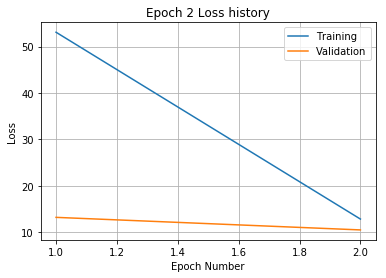

Training
Iteration 0: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 20: with minibatch training loss = 9.64 and relative error of 0.37
Iteration 40: with minibatch training loss = 11.9 and relative error of 0.38
Iteration 60: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 80: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 100: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 120: with minibatch training loss = 9.3 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.4 and relative error of 0.36
Iteration 160: with minibatch training loss = 8.12 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.5 and relative error of 0.33
Iteration 200: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 220: with minibatch training loss = 8.23 and relative error of 0.32
Epoch 3, Overall loss = 10.2, relative error = 0.366, and process

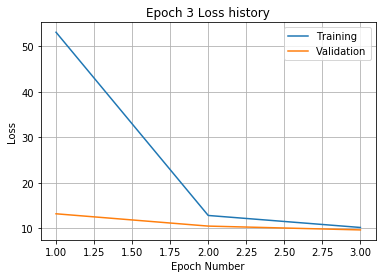

Training
Iteration 0: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 20: with minibatch training loss = 9.56 and relative error of 0.35
Iteration 40: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 60: with minibatch training loss = 9.16 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.25 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.77 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.13 and relative error of 0.34
Iteration 140: with minibatch training loss = 9.11 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.24 and relative error of 0.35
Iteration 180: with minibatch training loss = 7.01 and relative error of 0.29
Iteration 200: with minibatch training loss = 9.42 and relative error of 0.36
Iteration 220: with minibatch training loss = 6.2 and relative error of 0.3
Epoch 4, Overall loss = 9.09, relative error = 0.346, and proce

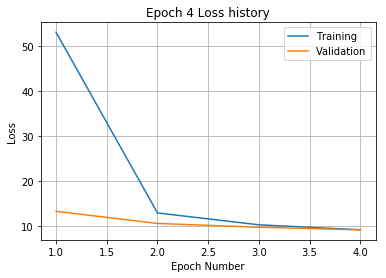

Training
Iteration 0: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 20: with minibatch training loss = 9.35 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 80: with minibatch training loss = 9.72 and relative error of 0.36
Iteration 100: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.3 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.69 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.06 and relative error of 0.3
Iteration 180: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 200: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 220: with minibatch training loss = 9.23 and relative error of 0.35
Epoch 5, Overall loss = 8.17, relative error = 0.328, and process

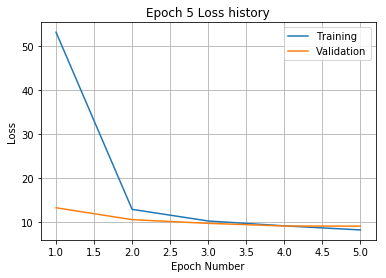

Training
Iteration 0: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.72 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.1 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.78 and relative error of 0.34
Iteration 140: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 160: with minibatch training loss = 8.7 and relative error of 0.34
Iteration 180: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 200: with minibatch training loss = 9.28 and relative error of 0.34
Iteration 220: with minibatch training loss = 9.97 and relative error of 0.35
Epoch 6, Overall loss = 7.61, relative error = 0.316, and process tim

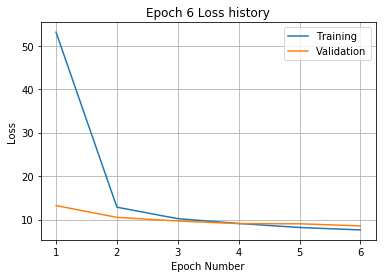

Training
Iteration 0: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.06 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.44 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.66 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.43 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.87 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.12 and relative error of 0.31
Epoch 7, Overall loss = 7.12, relative error = 0.306, and proces

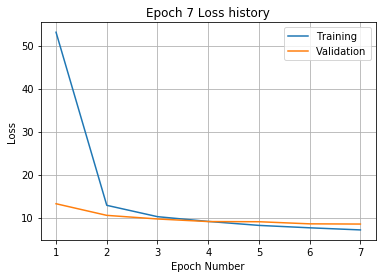

Training
Iteration 0: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.13 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.38 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.17 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.72 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.1 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.69 and relative error of 0.29
Epoch 8, Overall loss = 6.8, relative error = 0.299, and process

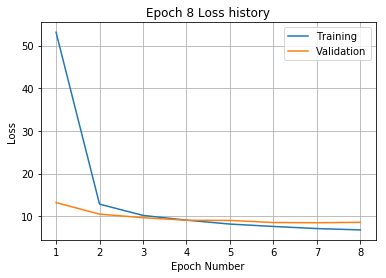

Training
Iteration 0: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.54 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.59 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.01 and relative error of 0.3
Epoch 9, Overall loss = 6.47, relative error = 0.291, and process t

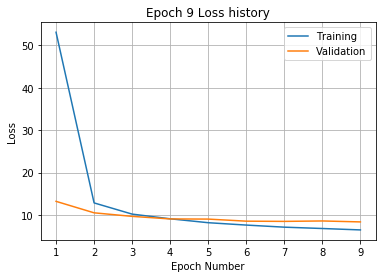

Training
Iteration 0: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.15 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.1 and relative error of 0.26
Epoch 10, Overall loss = 6.26, relative error = 0.287, and pro

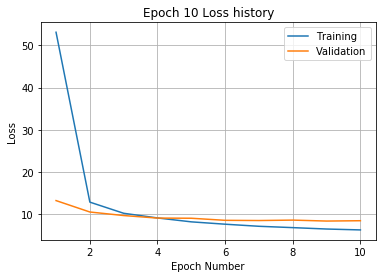

Training
Iteration 0: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 20: with minibatch training loss = 8.71 and relative error of 0.32
Iteration 40: with minibatch training loss = 3.85 and relative error of 0.23
Iteration 60: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.31 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.71 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.91 and relative error of 0.32
Iteration 140: with minibatch training loss = 9.49 and relative error of 0.34
Iteration 160: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.66 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.8 and relative error of 0.27
Epoch 11, Overall loss = 6.04, relative error = 0.281, and pro

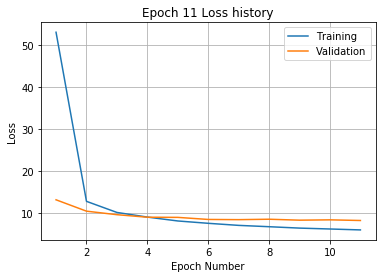

Training
Iteration 0: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.71 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.41 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 200: with minibatch training loss = 8.5 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.37 and relative error of 0.29
Epoch 12, Overall loss = 5.83, relative error = 0.277, and pro

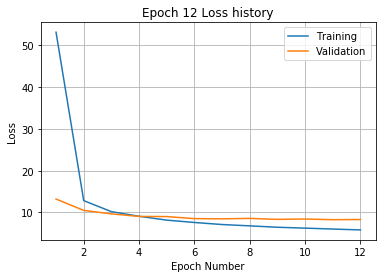

Training
Iteration 0: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.74 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.89 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.28 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.9 and relative error of 0.29
Epoch 13, Overall loss = 5.66, relative error = 0.272, and proces

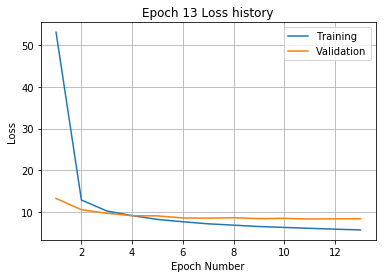

Training
Iteration 0: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.48 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.27 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.76 and relative error of 0.29
Epoch 14, Overall loss = 5.57, relative error = 0.27, and proc

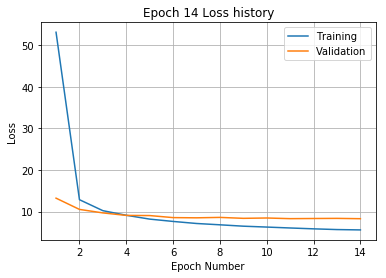

Training
Iteration 0: with minibatch training loss = 5.36 and relative error of 0.25
Iteration 20: with minibatch training loss = 3.86 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 120: with minibatch training loss = 7.12 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.12 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.86 and relative error of 0.26
Epoch 15, Overall loss = 5.38, relative error = 0.266, and proc

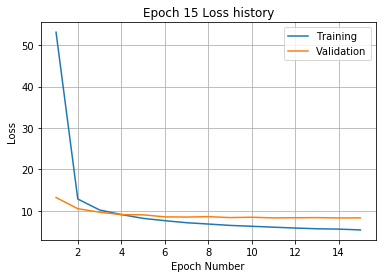

Training
Iteration 0: with minibatch training loss = 4.7 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 60: with minibatch training loss = 3.59 and relative error of 0.21
Iteration 80: with minibatch training loss = 5.89 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 140: with minibatch training loss = 3.84 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.13 and relative error of 0.25
Epoch 16, Overall loss = 5.3, relative error = 0.264, and proc

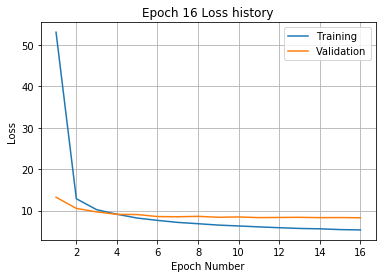

Training
Iteration 0: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.12 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 100: with minibatch training loss = 3.63 and relative error of 0.22
Iteration 120: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.19 and relative error of 0.27
Iteration 160: with minibatch training loss = 8.25 and relative error of 0.34
Iteration 180: with minibatch training loss = 3.54 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.78 and relative error of 0.25
Epoch 17, Overall loss = 5.17, relative error = 0.26, and proc

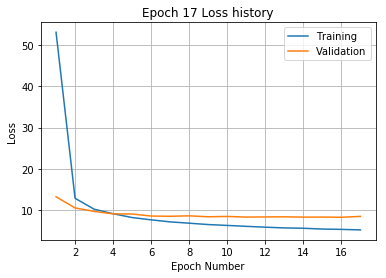

Training
Iteration 0: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.88 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.43 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.23 and relative error of 0.28
Epoch 18, Overall loss = 5.11, relative error = 0.259, and pro

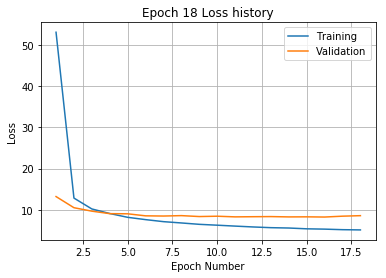

Training
Iteration 0: with minibatch training loss = 5.56 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.91 and relative error of 0.22
Iteration 40: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.14 and relative error of 0.21
Iteration 100: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 220: with minibatch training loss = 3.68 and relative error of 0.21
Epoch 19, Overall loss = 5, relative error = 0.256, and proces

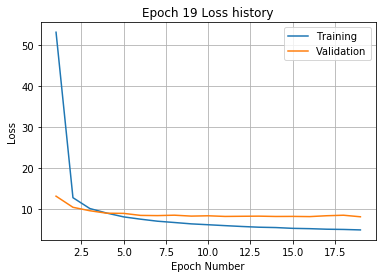

Training
Iteration 0: with minibatch training loss = 3.83 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 60: with minibatch training loss = 6 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 200: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.67 and relative error of 0.24
Epoch 20, Overall loss = 4.9, relative error = 0.254, and process t

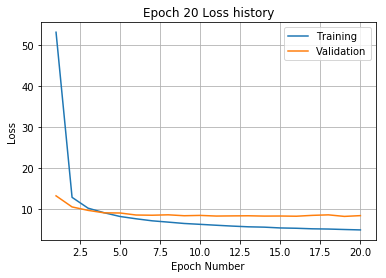

Training
Iteration 0: with minibatch training loss = 3.37 and relative error of 0.21
Iteration 20: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.81 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.31 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.96 and relative error of 0.23
Iteration 100: with minibatch training loss = 3.6 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.17 and relative error of 0.24
Iteration 200: with minibatch training loss = 3.8 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.12 and relative error of 0.25
Epoch 21, Overall loss = 4.84, relative error = 0.252, and proces

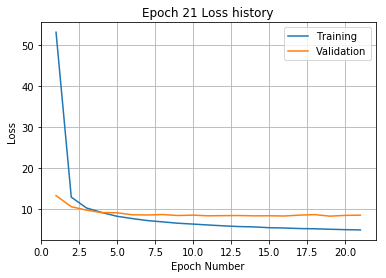

Training
Iteration 0: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 20: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 40: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.06 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.66 and relative error of 0.22
Iteration 100: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 220: with minibatch training loss = 2.91 and relative error of 0.2
Epoch 22, Overall loss = 4.76, relative error = 0.25, and proce

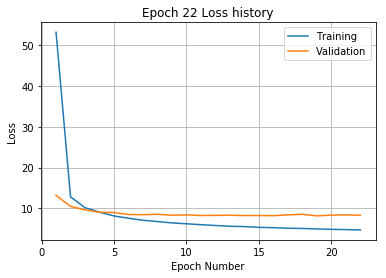

Training
Iteration 0: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 20: with minibatch training loss = 4.08 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 60: with minibatch training loss = 2.99 and relative error of 0.2
Iteration 80: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.51 and relative error of 0.21
Iteration 140: with minibatch training loss = 4.04 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.44 and relative error of 0.27
Epoch 23, Overall loss = 4.65, relative error = 0.247, and pro

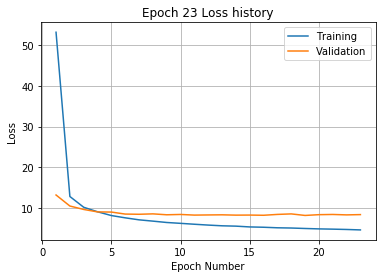

Training
Iteration 0: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.3 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.8 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 100: with minibatch training loss = 3.41 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 160: with minibatch training loss = 3.82 and relative error of 0.22
Iteration 180: with minibatch training loss = 3.45 and relative error of 0.21
Iteration 200: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.16 and relative error of 0.2
Epoch 24, Overall loss = 4.56, relative error = 0.244, and proce

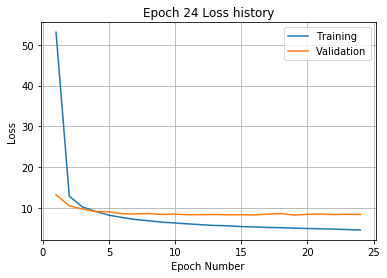

Validation error has stopped improving! Training on repetition 4 stopped!
Training
Iteration 0: with minibatch training loss = 252 and relative error of 1.8
Iteration 20: with minibatch training loss = 149 and relative error of 1.4
Iteration 40: with minibatch training loss = 88 and relative error of 1.1
Iteration 60: with minibatch training loss = 66.9 and relative error of 0.94
Iteration 80: with minibatch training loss = 51.8 and relative error of 0.83
Iteration 100: with minibatch training loss = 36.9 and relative error of 0.68
Iteration 120: with minibatch training loss = 32.2 and relative error of 0.62
Iteration 140: with minibatch training loss = 23 and relative error of 0.55
Iteration 160: with minibatch training loss = 16.8 and relative error of 0.46
Iteration 180: with minibatch training loss = 20.1 and relative error of 0.52
Iteration 200: with minibatch training loss = 19 and relative error of 0.48
Iteration 220: with minibatch training loss = 16.4 and relative error of 0.4

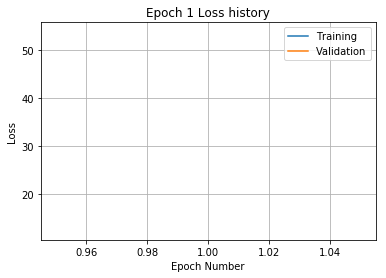

Training
Iteration 0: with minibatch training loss = 14.2 and relative error of 0.44
Iteration 20: with minibatch training loss = 14.9 and relative error of 0.44
Iteration 40: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 60: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 80: with minibatch training loss = 13.3 and relative error of 0.41
Iteration 100: with minibatch training loss = 15.7 and relative error of 0.46
Iteration 120: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 140: with minibatch training loss = 12.9 and relative error of 0.41
Iteration 160: with minibatch training loss = 11.1 and relative error of 0.37
Iteration 180: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 200: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 220: with minibatch training loss = 12.1 and relative error of 0.4
Epoch 2, Overall loss = 12.7, relative error = 0.408, and proce

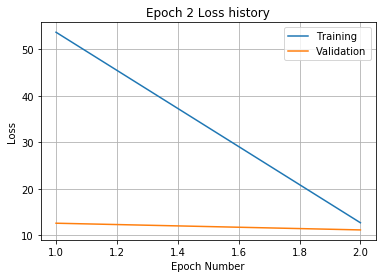

Training
Iteration 0: with minibatch training loss = 9.67 and relative error of 0.36
Iteration 20: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 40: with minibatch training loss = 12 and relative error of 0.41
Iteration 60: with minibatch training loss = 9.86 and relative error of 0.37
Iteration 80: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 100: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 120: with minibatch training loss = 8.53 and relative error of 0.34
Iteration 140: with minibatch training loss = 10.6 and relative error of 0.36
Iteration 160: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 180: with minibatch training loss = 7.81 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 220: with minibatch training loss = 8.75 and relative error of 0.34
Epoch 3, Overall loss = 10.3, relative error = 0.367, and proces

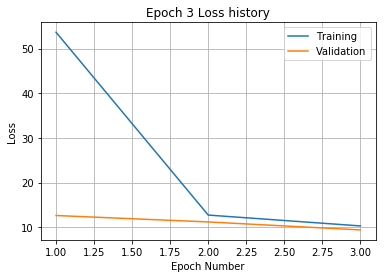

Training
Iteration 0: with minibatch training loss = 11.4 and relative error of 0.37
Iteration 20: with minibatch training loss = 9.79 and relative error of 0.37
Iteration 40: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 60: with minibatch training loss = 8.61 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 100: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 120: with minibatch training loss = 7.53 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.78 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.84 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.91 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.67 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.82 and relative error of 0.29
Epoch 4, Overall loss = 8.91, relative error = 0.342, and proc

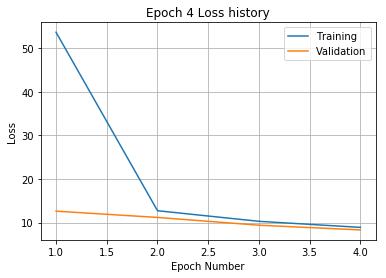

Training
Iteration 0: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.08 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.55 and relative error of 0.37
Iteration 60: with minibatch training loss = 9.29 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.14 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.06 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 180: with minibatch training loss = 11.4 and relative error of 0.4
Iteration 200: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.84 and relative error of 0.33
Epoch 5, Overall loss = 7.92, relative error = 0.322, and process

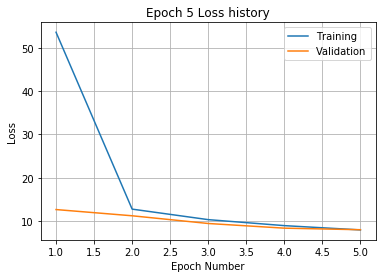

Training
Iteration 0: with minibatch training loss = 6.91 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.88 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.62 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.48 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.45 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.93 and relative error of 0.29
Iteration 200: with minibatch training loss = 9.35 and relative error of 0.35
Iteration 220: with minibatch training loss = 6.03 and relative error of 0.28
Epoch 6, Overall loss = 7.37, relative error = 0.31, and proc

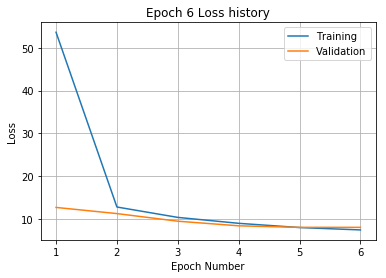

Training
Iteration 0: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 40: with minibatch training loss = 7.7 and relative error of 0.33
Iteration 60: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.44 and relative error of 0.3
Iteration 120: with minibatch training loss = 9.07 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.61 and relative error of 0.34
Epoch 7, Overall loss = 6.9, relative error = 0.3, and process 

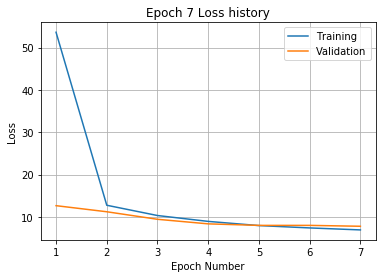

Training
Iteration 0: with minibatch training loss = 5.67 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.8 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 200: with minibatch training loss = 7 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.08 and relative error of 0.29
Epoch 8, Overall loss = 6.55, relative error = 0.292, and process t

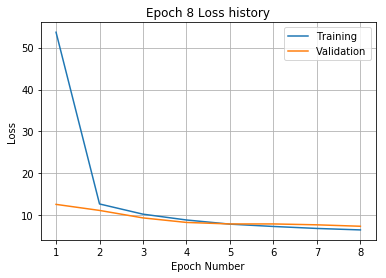

Training
Iteration 0: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.58 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.21 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.46 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.43 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.01 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.58 and relative error of 0.3
Epoch 9, Overall loss = 6.25, relative error = 0.286, and process 

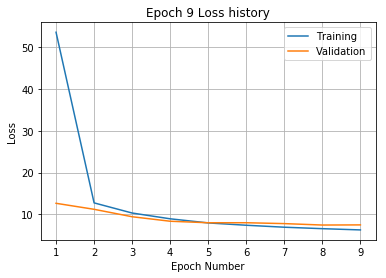

Training
Iteration 0: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 80: with minibatch training loss = 4.95 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.8 and relative error of 0.29
Epoch 10, Overall loss = 6.06, relative error = 0.281, and proc

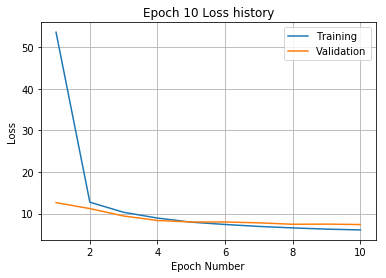

Training
Iteration 0: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.3 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.96 and relative error of 0.25
Epoch 11, Overall loss = 5.85, relative error = 0.276, and process

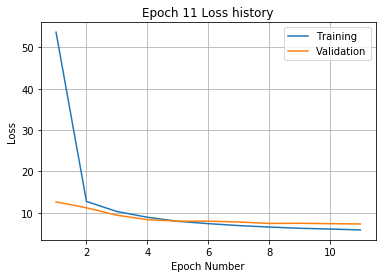

Training
Iteration 0: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 60: with minibatch training loss = 8.03 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.05 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.09 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.97 and relative error of 0.27
Epoch 12, Overall loss = 5.72, relative error = 0.273, and proce

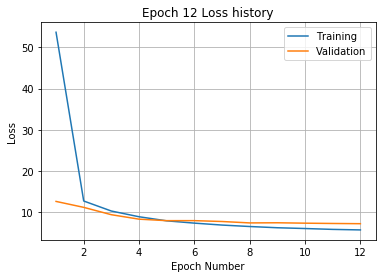

Training
Iteration 0: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.34 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.49 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.82 and relative error of 0.25
Epoch 13, Overall loss = 5.55, relative error = 0.269, and proc

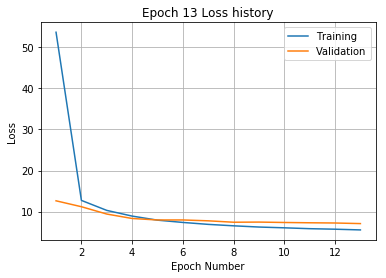

Training
Iteration 0: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 20: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 60: with minibatch training loss = 3.8 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.67 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.49 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 200: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.75 and relative error of 0.28
Epoch 14, Overall loss = 5.34, relative error = 0.264, and process

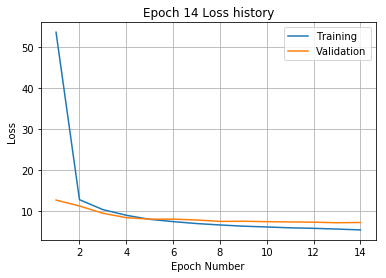

Training
Iteration 0: with minibatch training loss = 3.66 and relative error of 0.22
Iteration 20: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.72 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 80: with minibatch training loss = 3.83 and relative error of 0.21
Iteration 100: with minibatch training loss = 5.09 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.77 and relative error of 0.27
Epoch 15, Overall loss = 5.24, relative error = 0.262, and proc

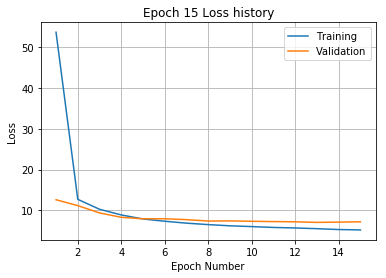

Training
Iteration 0: with minibatch training loss = 7.85 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.74 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.06 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.61 and relative error of 0.25
Epoch 16, Overall loss = 5.16, relative error = 0.259, and pro

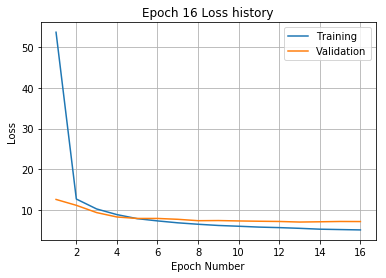

Training
Iteration 0: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.51 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.8 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.03 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.33 and relative error of 0.24
Epoch 17, Overall loss = 5.05, relative error = 0.257, and proc

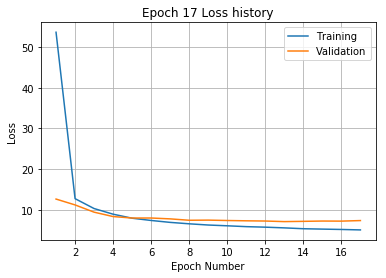

Training
Iteration 0: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 20: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 60: with minibatch training loss = 3.65 and relative error of 0.22
Iteration 80: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.53 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.09 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.96 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.88 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.68 and relative error of 0.25
Epoch 18, Overall loss = 4.95, relative error = 0.254, and pro

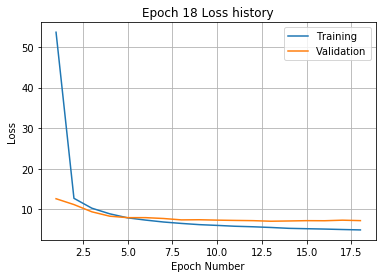

Validation error has stopped improving! Training on repetition 5 stopped!
Training
Iteration 0: with minibatch training loss = 161 and relative error of 1.4
Iteration 20: with minibatch training loss = 116 and relative error of 1.2
Iteration 40: with minibatch training loss = 65.4 and relative error of 0.93
Iteration 60: with minibatch training loss = 47.8 and relative error of 0.8
Iteration 80: with minibatch training loss = 40.3 and relative error of 0.73
Iteration 100: with minibatch training loss = 30.1 and relative error of 0.62
Iteration 120: with minibatch training loss = 28.9 and relative error of 0.6
Iteration 140: with minibatch training loss = 20.7 and relative error of 0.51
Iteration 160: with minibatch training loss = 16.8 and relative error of 0.46
Iteration 180: with minibatch training loss = 14.4 and relative error of 0.43
Iteration 200: with minibatch training loss = 15.5 and relative error of 0.45
Iteration 220: with minibatch training loss = 13.1 and relative error o

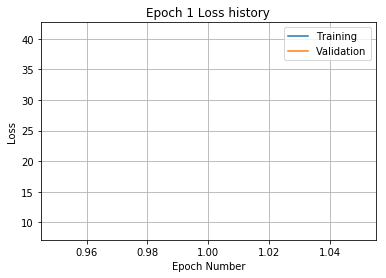

Training
Iteration 0: with minibatch training loss = 14.5 and relative error of 0.42
Iteration 20: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 40: with minibatch training loss = 13.8 and relative error of 0.41
Iteration 60: with minibatch training loss = 14.9 and relative error of 0.45
Iteration 80: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 100: with minibatch training loss = 9.01 and relative error of 0.36
Iteration 120: with minibatch training loss = 10 and relative error of 0.36
Iteration 140: with minibatch training loss = 12 and relative error of 0.42
Iteration 160: with minibatch training loss = 13 and relative error of 0.41
Iteration 180: with minibatch training loss = 8.8 and relative error of 0.35
Iteration 200: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 220: with minibatch training loss = 12.1 and relative error of 0.41
Epoch 2, Overall loss = 12.3, relative error = 0.401, and process tim

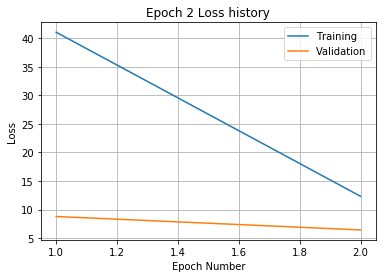

Training
Iteration 0: with minibatch training loss = 9.77 and relative error of 0.36
Iteration 20: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 40: with minibatch training loss = 11 and relative error of 0.37
Iteration 60: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 80: with minibatch training loss = 9.89 and relative error of 0.34
Iteration 100: with minibatch training loss = 9.92 and relative error of 0.35
Iteration 120: with minibatch training loss = 12 and relative error of 0.4
Iteration 140: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 160: with minibatch training loss = 9.17 and relative error of 0.34
Iteration 180: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 200: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 220: with minibatch training loss = 8.11 and relative error of 0.33
Epoch 3, Overall loss = 9.76, relative error = 0.357, and process 

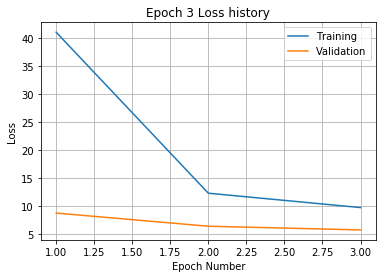

Training
Iteration 0: with minibatch training loss = 9.85 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.35 and relative error of 0.36
Iteration 40: with minibatch training loss = 9.4 and relative error of 0.37
Iteration 60: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 80: with minibatch training loss = 9.19 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.34 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.33 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.27 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.23 and relative error of 0.32
Iteration 200: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 220: with minibatch training loss = 6.83 and relative error of 0.3
Epoch 4, Overall loss = 8.71, relative error = 0.337, and proce

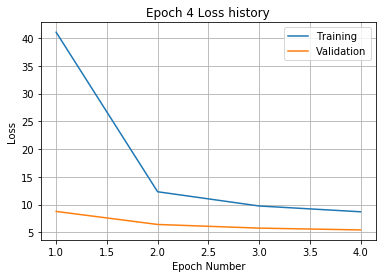

Training
Iteration 0: with minibatch training loss = 8.04 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.81 and relative error of 0.33
Iteration 60: with minibatch training loss = 9.99 and relative error of 0.36
Iteration 80: with minibatch training loss = 9.09 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.01 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.46 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 220: with minibatch training loss = 10.9 and relative error of 0.37
Epoch 5, Overall loss = 7.84, relative error = 0.32, and proce

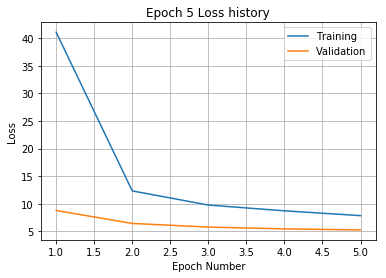

Training
Iteration 0: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 40: with minibatch training loss = 9.26 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.8 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 120: with minibatch training loss = 9.85 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 160: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 180: with minibatch training loss = 9.25 and relative error of 0.36
Iteration 200: with minibatch training loss = 5.99 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.15 and relative error of 0.3
Epoch 6, Overall loss = 7.43, relative error = 0.311, and proces

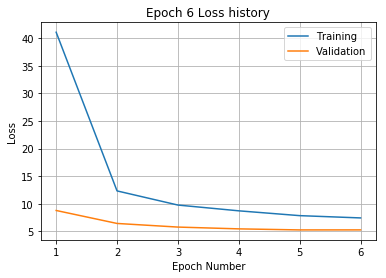

Training
Iteration 0: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.51 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.68 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.02 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.65 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.08 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.07 and relative error of 0.28
Epoch 7, Overall loss = 6.93, relative error = 0.3, and process

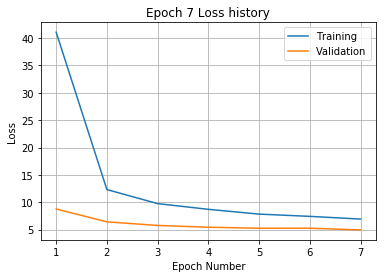

Training
Iteration 0: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 60: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 80: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.31 and relative error of 0.32
Iteration 140: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 160: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 180: with minibatch training loss = 9.99 and relative error of 0.37
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.78 and relative error of 0.27
Epoch 8, Overall loss = 6.62, relative error = 0.293, and proc

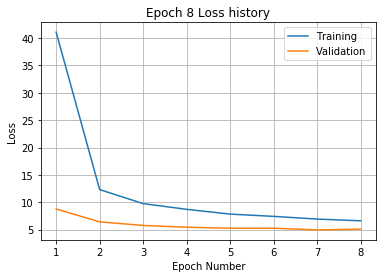

Training
Iteration 0: with minibatch training loss = 6.84 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.46 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.15 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.69 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.72 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.97 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.15 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.15 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.57 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.77 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.71 and relative error of 0.25
Epoch 9, Overall loss = 6.42, relative error = 0.289, and pro

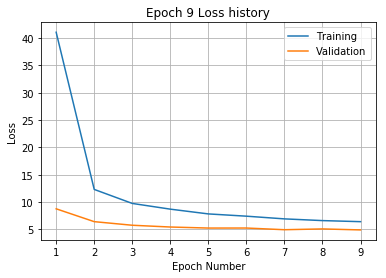

Training
Iteration 0: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 40: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 80: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.78 and relative error of 0.31
Iteration 140: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 160: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.21 and relative error of 0.3
Epoch 10, Overall loss = 6.15, relative error = 0.282, and proces

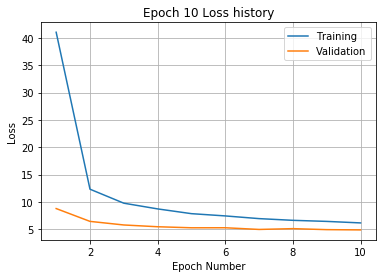

Training
Iteration 0: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.06 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 80: with minibatch training loss = 7.56 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.39 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 140: with minibatch training loss = 9.31 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.4 and relative error of 0.24
Epoch 11, Overall loss = 5.95, relative error = 0.278, and pro

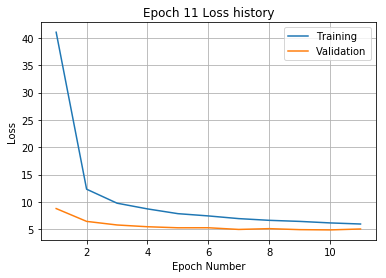

Training
Iteration 0: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.03 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.38 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.03 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.23 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.82 and relative error of 0.28
Epoch 12, Overall loss = 5.84, relative error = 0.275, and pr

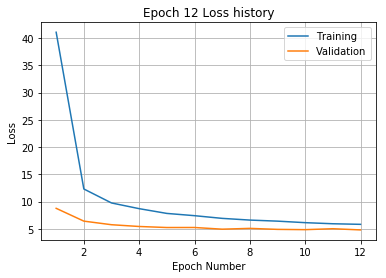

Training
Iteration 0: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.28 and relative error of 0.27
Iteration 40: with minibatch training loss = 4 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.37 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.47 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.95 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.06 and relative error of 0.3
Epoch 13, Overall loss = 5.66, relative error = 0.271, and process t

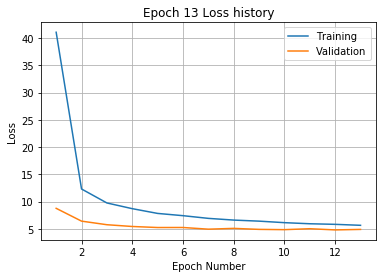

Training
Iteration 0: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 60: with minibatch training loss = 8.47 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.89 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.11 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.09 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.57 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.19 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.18 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.98 and relative error of 0.24
Epoch 14, Overall loss = 5.55, relative error = 0.268, and pro

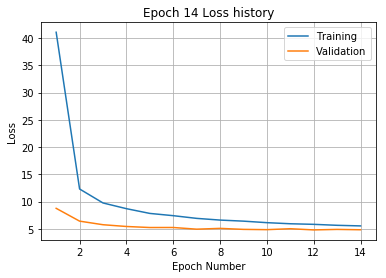

Training
Iteration 0: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.8 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.22 and relative error of 0.23
Epoch 15, Overall loss = 5.41, relative error = 0.265, and proc

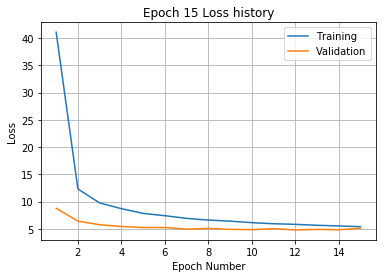

Training
Iteration 0: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.81 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.78 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.03 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.23 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.57 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.51 and relative error of 0.26
Epoch 16, Overall loss = 5.33, relative error = 0.263, and pr

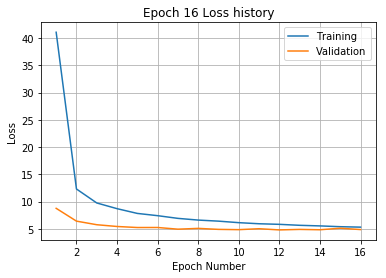

Training
Iteration 0: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.39 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.14 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.19 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.2 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.14 and relative error of 0.23
Epoch 17, Overall loss = 5.23, relative error = 0.261, and proc

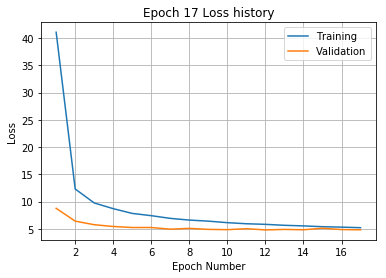

Validation error has stopped improving! Training on repetition 6 stopped!
Training
Iteration 0: with minibatch training loss = 228 and relative error of 1.7
Iteration 20: with minibatch training loss = 128 and relative error of 1.3
Iteration 40: with minibatch training loss = 75.3 and relative error of 1
Iteration 60: with minibatch training loss = 56.7 and relative error of 0.85
Iteration 80: with minibatch training loss = 50.5 and relative error of 0.8
Iteration 100: with minibatch training loss = 38.9 and relative error of 0.68
Iteration 120: with minibatch training loss = 27.2 and relative error of 0.6
Iteration 140: with minibatch training loss = 20 and relative error of 0.54
Iteration 160: with minibatch training loss = 18.9 and relative error of 0.49
Iteration 180: with minibatch training loss = 12.5 and relative error of 0.42
Iteration 200: with minibatch training loss = 17.8 and relative error of 0.5
Iteration 220: with minibatch training loss = 16.9 and relative error of 0.46

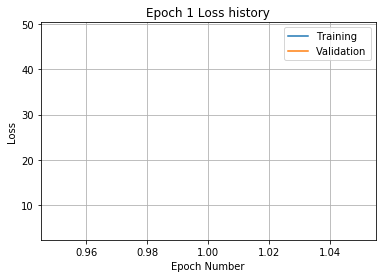

Training
Iteration 0: with minibatch training loss = 14 and relative error of 0.42
Iteration 20: with minibatch training loss = 16.3 and relative error of 0.45
Iteration 40: with minibatch training loss = 12.6 and relative error of 0.4
Iteration 60: with minibatch training loss = 14.6 and relative error of 0.43
Iteration 80: with minibatch training loss = 13.9 and relative error of 0.42
Iteration 100: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 120: with minibatch training loss = 13.3 and relative error of 0.41
Iteration 140: with minibatch training loss = 9.97 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.71 and relative error of 0.34
Iteration 180: with minibatch training loss = 13.3 and relative error of 0.41
Iteration 200: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 220: with minibatch training loss = 13.2 and relative error of 0.4
Epoch 2, Overall loss = 13, relative error = 0.41, and process tim

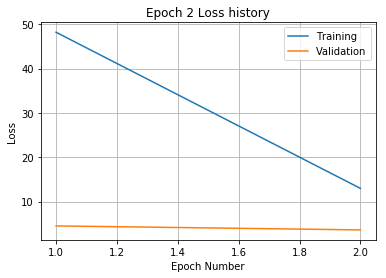

Training
Iteration 0: with minibatch training loss = 14.4 and relative error of 0.43
Iteration 20: with minibatch training loss = 13.5 and relative error of 0.42
Iteration 40: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 80: with minibatch training loss = 13 and relative error of 0.4
Iteration 100: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 120: with minibatch training loss = 11 and relative error of 0.39
Iteration 140: with minibatch training loss = 10.3 and relative error of 0.38
Iteration 160: with minibatch training loss = 9.54 and relative error of 0.36
Iteration 180: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 200: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 220: with minibatch training loss = 10.2 and relative error of 0.37
Epoch 3, Overall loss = 10.6, relative error = 0.37, and process t

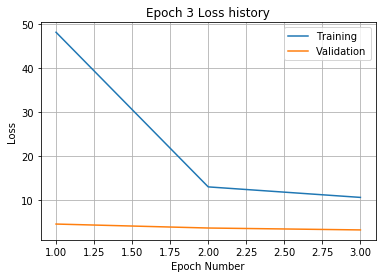

Training
Iteration 0: with minibatch training loss = 8.33 and relative error of 0.33
Iteration 20: with minibatch training loss = 9.38 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.8 and relative error of 0.36
Iteration 60: with minibatch training loss = 7.59 and relative error of 0.31
Iteration 80: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 100: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 120: with minibatch training loss = 9.33 and relative error of 0.35
Iteration 140: with minibatch training loss = 7.28 and relative error of 0.3
Iteration 160: with minibatch training loss = 8.26 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 200: with minibatch training loss = 9.11 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.69 and relative error of 0.31
Epoch 4, Overall loss = 9.28, relative error = 0.347, and proces

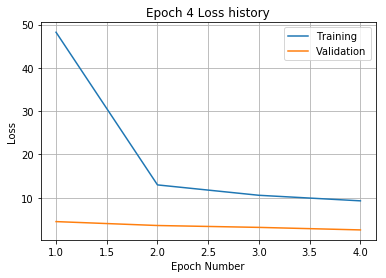

Training
Iteration 0: with minibatch training loss = 9.37 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 40: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 60: with minibatch training loss = 8.82 and relative error of 0.36
Iteration 80: with minibatch training loss = 9.23 and relative error of 0.35
Iteration 100: with minibatch training loss = 9.18 and relative error of 0.35
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 140: with minibatch training loss = 9.73 and relative error of 0.36
Iteration 160: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.89 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.81 and relative error of 0.34
Iteration 220: with minibatch training loss = 9.37 and relative error of 0.34
Epoch 5, Overall loss = 8.49, relative error = 0.332, and pro

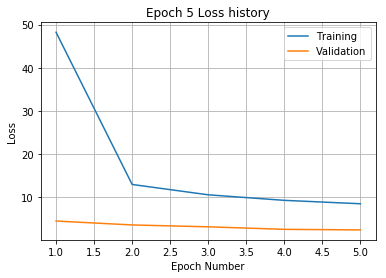

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 20: with minibatch training loss = 8.17 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.33 and relative error of 0.34
Iteration 60: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.92 and relative error of 0.33
Iteration 100: with minibatch training loss = 9.85 and relative error of 0.36
Iteration 120: with minibatch training loss = 9.12 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.69 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.47 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.89 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.7 and relative error of 0.33
Epoch 6, Overall loss = 7.94, relative error = 0.321, and proc

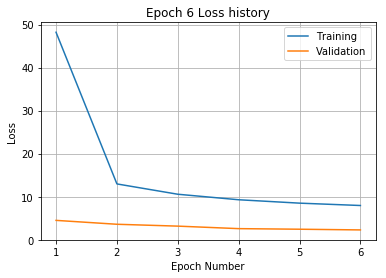

Training
Iteration 0: with minibatch training loss = 8.17 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.71 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.15 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 80: with minibatch training loss = 9.01 and relative error of 0.34
Iteration 100: with minibatch training loss = 6.37 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.44 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.29 and relative error of 0.28
Epoch 7, Overall loss = 7.46, relative error = 0.311, and proces

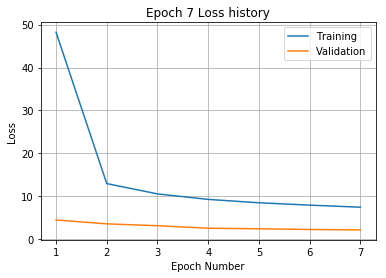

Training
Iteration 0: with minibatch training loss = 7.92 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 40: with minibatch training loss = 9.38 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.15 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.91 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.22 and relative error of 0.3
Iteration 140: with minibatch training loss = 9.97 and relative error of 0.36
Iteration 160: with minibatch training loss = 4.91 and relative error of 0.24
Iteration 180: with minibatch training loss = 8.32 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.29 and relative error of 0.29
Epoch 8, Overall loss = 7.09, relative error = 0.303, and proce

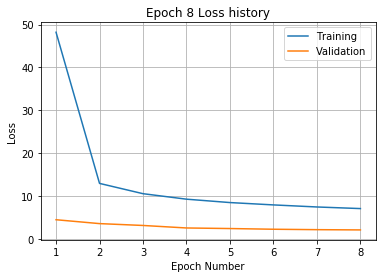

Training
Iteration 0: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.65 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.62 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.38 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 180: with minibatch training loss = 8.25 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.09 and relative error of 0.26
Epoch 9, Overall loss = 6.84, relative error = 0.298, and proce

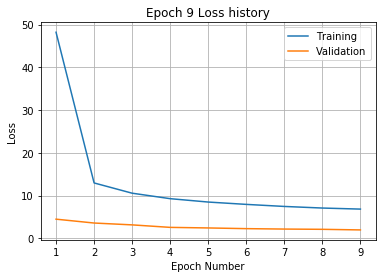

Training
Iteration 0: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 80: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.57 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.74 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.28 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.01 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.82 and relative error of 0.3
Epoch 10, Overall loss = 6.61, relative error = 0.293, and proces

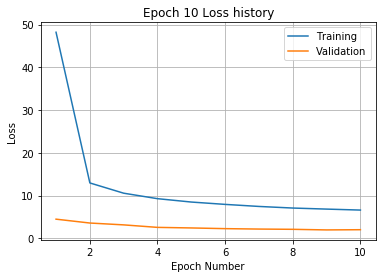

Training
Iteration 0: with minibatch training loss = 8.62 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.11 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.21 and relative error of 0.32
Iteration 140: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.93 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.48 and relative error of 0.26
Epoch 11, Overall loss = 6.45, relative error = 0.289, and pro

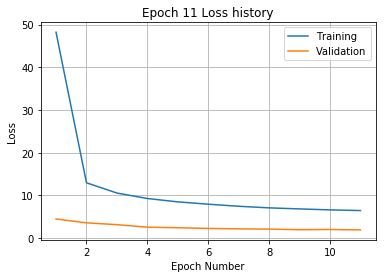

Training
Iteration 0: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 120: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.62 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.37 and relative error of 0.24
Epoch 12, Overall loss = 6.3, relative error = 0.285, and proce

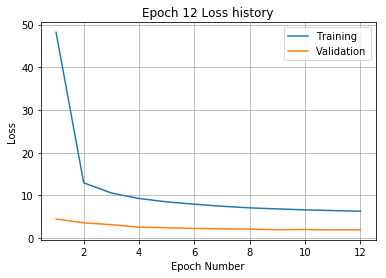

Training
Iteration 0: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 40: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.48 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.88 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 200: with minibatch training loss = 9.34 and relative error of 0.34
Iteration 220: with minibatch training loss = 5.32 and relative error of 0.28
Epoch 13, Overall loss = 6.08, relative error = 0.28, and process 

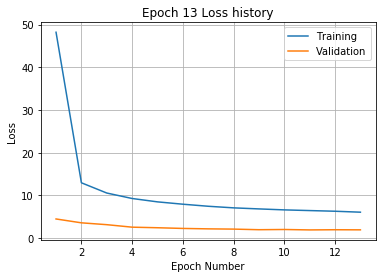

Training
Iteration 0: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.87 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.64 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.04 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.94 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.19 and relative error of 0.34
Iteration 120: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.3 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.77 and relative error of 0.25
Epoch 14, Overall loss = 5.98, relative error = 0.278, and proce

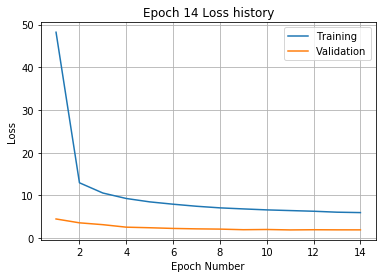

Training
Iteration 0: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 140: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.29 and relative error of 0.29
Epoch 15, Overall loss = 5.83, relative error = 0.275, and proce

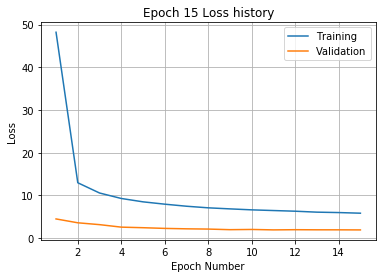

Training
Iteration 0: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.92 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.66 and relative error of 0.31
Iteration 160: with minibatch training loss = 5 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.03 and relative error of 0.19
Epoch 16, Overall loss = 5.75, relative error = 0.273, and proces

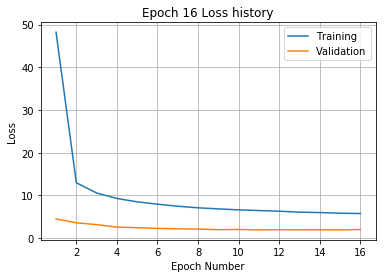

Training
Iteration 0: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 20: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.35 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.65 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.39 and relative error of 0.28
Epoch 17, Overall loss = 5.66, relative error = 0.27, and proc

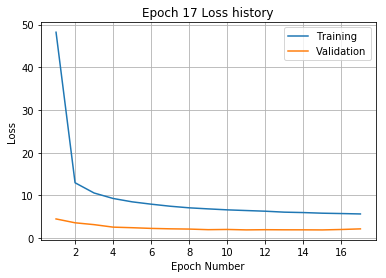

Training
Iteration 0: with minibatch training loss = 5.57 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.85 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.91 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.17 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.3 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.63 and relative error of 0.25
Epoch 18, Overall loss = 5.57, relative error = 0.268, and proces

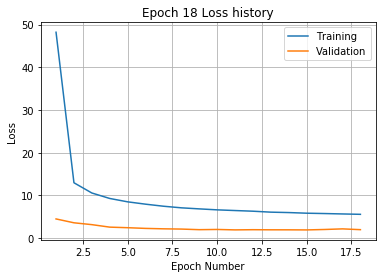

Training
Iteration 0: with minibatch training loss = 4.36 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.8 and relative error of 0.26
Iteration 40: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 60: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.91 and relative error of 0.24
Iteration 120: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.45 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 200: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 220: with minibatch training loss = 4.75 and relative error of 0.25
Epoch 19, Overall loss = 5.41, relative error = 0.264, and proce

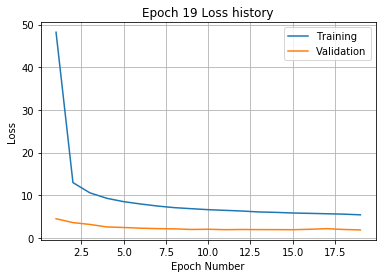

Training
Iteration 0: with minibatch training loss = 4.51 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.07 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.44 and relative error of 0.25
Epoch 20, Overall loss = 5.38, relative error = 0.264, and proc

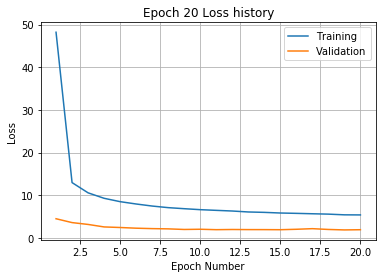

Training
Iteration 0: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.09 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.39 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.48 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.38 and relative error of 0.28
Epoch 21, Overall loss = 5.27, relative error = 0.261, and proc

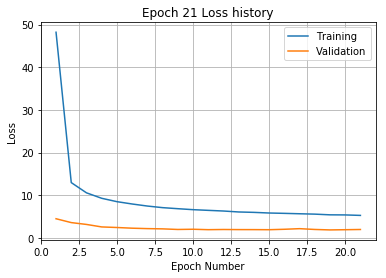

Training
Iteration 0: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.53 and relative error of 0.25
Epoch 22, Overall loss = 5.17, relative error = 0.259, and pro

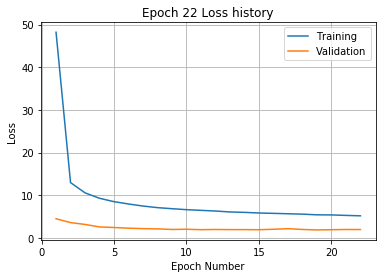

Training
Iteration 0: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.96 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.54 and relative error of 0.22
Iteration 100: with minibatch training loss = 6.31 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.79 and relative error of 0.24
Epoch 23, Overall loss = 5.11, relative error = 0.257, and proce

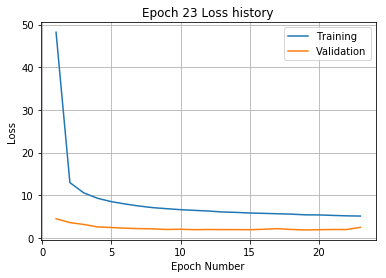

Training
Iteration 0: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.07 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 200: with minibatch training loss = 3.85 and relative error of 0.23
Iteration 220: with minibatch training loss = 3.22 and relative error of 0.2
Epoch 24, Overall loss = 5, relative error = 0.254, and process

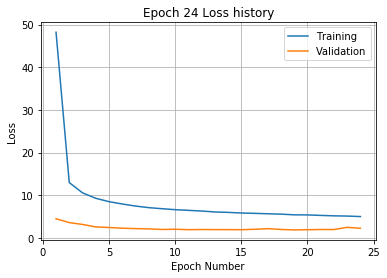

Validation error has stopped improving! Training on repetition 7 stopped!
Training
Iteration 0: with minibatch training loss = 166 and relative error of 1.5
Iteration 20: with minibatch training loss = 81.7 and relative error of 1.1
Iteration 40: with minibatch training loss = 62.4 and relative error of 0.89
Iteration 60: with minibatch training loss = 41.4 and relative error of 0.76
Iteration 80: with minibatch training loss = 34.1 and relative error of 0.65
Iteration 100: with minibatch training loss = 24.6 and relative error of 0.55
Iteration 120: with minibatch training loss = 18.4 and relative error of 0.5
Iteration 140: with minibatch training loss = 13.8 and relative error of 0.43
Iteration 160: with minibatch training loss = 15.5 and relative error of 0.44
Iteration 180: with minibatch training loss = 14.3 and relative error of 0.42
Iteration 200: with minibatch training loss = 13.5 and relative error of 0.42
Iteration 220: with minibatch training loss = 11.8 and relative error

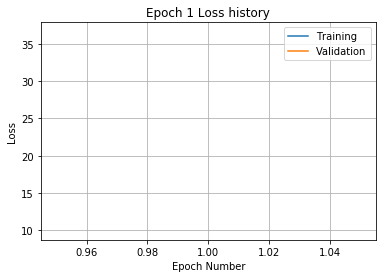

Training
Iteration 0: with minibatch training loss = 15.6 and relative error of 0.43
Iteration 20: with minibatch training loss = 14.5 and relative error of 0.42
Iteration 40: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 60: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 80: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 100: with minibatch training loss = 12.4 and relative error of 0.41
Iteration 120: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 140: with minibatch training loss = 7.61 and relative error of 0.32
Iteration 160: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.43 and relative error of 0.35
Iteration 200: with minibatch training loss = 10 and relative error of 0.37
Iteration 220: with minibatch training loss = 9.98 and relative error of 0.36
Epoch 2, Overall loss = 11.3, relative error = 0.384, and proce

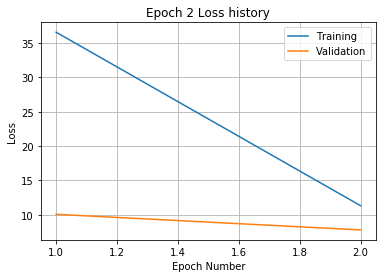

Training
Iteration 0: with minibatch training loss = 9.61 and relative error of 0.36
Iteration 20: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 40: with minibatch training loss = 8.76 and relative error of 0.36
Iteration 60: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 80: with minibatch training loss = 8.64 and relative error of 0.35
Iteration 100: with minibatch training loss = 9.42 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.95 and relative error of 0.37
Iteration 140: with minibatch training loss = 9.91 and relative error of 0.36
Iteration 160: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.58 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.68 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.93 and relative error of 0.33
Epoch 3, Overall loss = 9.25, relative error = 0.348, and pro

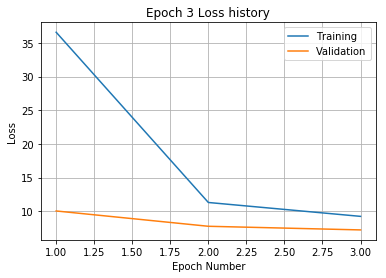

Training
Iteration 0: with minibatch training loss = 10.6 and relative error of 0.4
Iteration 20: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 40: with minibatch training loss = 9.23 and relative error of 0.35
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 80: with minibatch training loss = 7.96 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.78 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.59 and relative error of 0.35
Iteration 140: with minibatch training loss = 9.23 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.04 and relative error of 0.33
Iteration 180: with minibatch training loss = 9.43 and relative error of 0.36
Iteration 200: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.45 and relative error of 0.32
Epoch 4, Overall loss = 8.26, relative error = 0.328, and proc

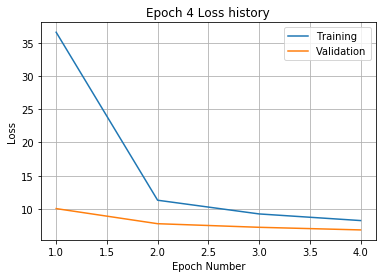

Training
Iteration 0: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 20: with minibatch training loss = 9.53 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 140: with minibatch training loss = 6 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.38 and relative error of 0.3
Epoch 5, Overall loss = 7.49, relative error = 0.312, and process tim

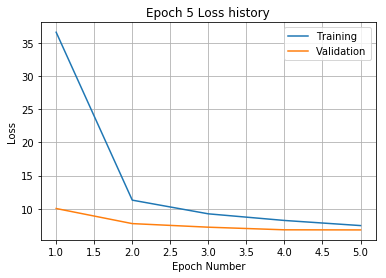

Training
Iteration 0: with minibatch training loss = 7.18 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.57 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 120: with minibatch training loss = 8.14 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.63 and relative error of 0.33
Iteration 160: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 180: with minibatch training loss = 6.85 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.43 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.55 and relative error of 0.27
Epoch 6, Overall loss = 7.03, relative error = 0.303, and pro

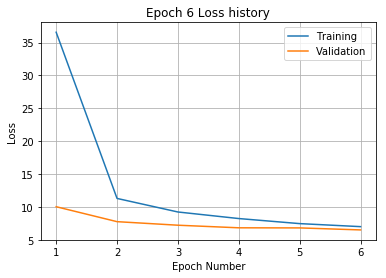

Training
Iteration 0: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.76 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.37 and relative error of 0.29
Epoch 7, Overall loss = 6.71, relative error = 0.296, and process

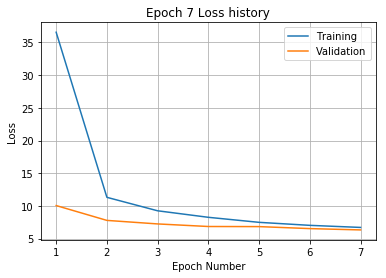

Training
Iteration 0: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.82 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.37 and relative error of 0.29
Epoch 8, Overall loss = 6.39, relative error = 0.289, and proc

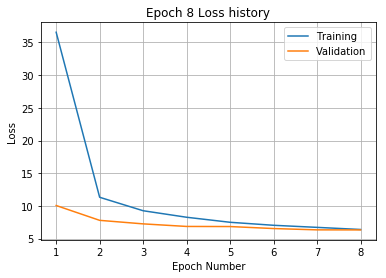

Training
Iteration 0: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.29 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.75 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.82 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 220: with minibatch training loss = 7.23 and relative error of 0.3
Epoch 9, Overall loss = 6.15, relative error = 0.283, and process

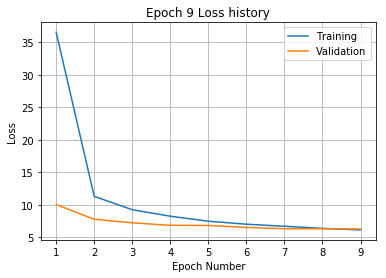

Training
Iteration 0: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.42 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.1 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.25 and relative error of 0.28
Epoch 10, Overall loss = 5.93, relative error = 0.278, and proce

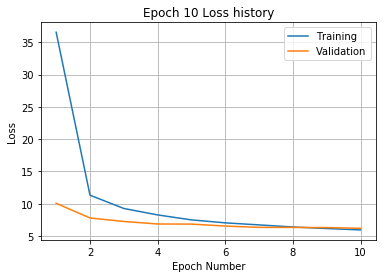

Training
Iteration 0: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.55 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.88 and relative error of 0.24
Epoch 11, Overall loss = 5.84, relative error = 0.276, and proc

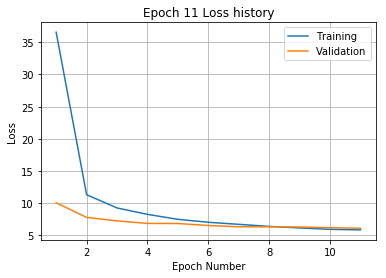

Training
Iteration 0: with minibatch training loss = 6.05 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 40: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.03 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.51 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.18 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.8 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.39 and relative error of 0.27
Epoch 12, Overall loss = 5.59, relative error = 0.27, and proces

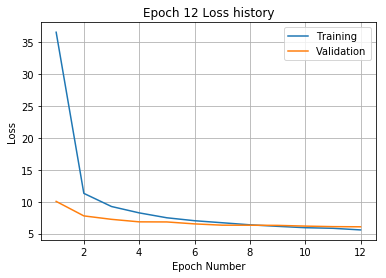

Training
Iteration 0: with minibatch training loss = 5.93 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.98 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.5 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.52 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 220: with minibatch training loss = 8.2 and relative error of 0.33
Epoch 13, Overall loss = 5.53, relative error = 0.268, and proce

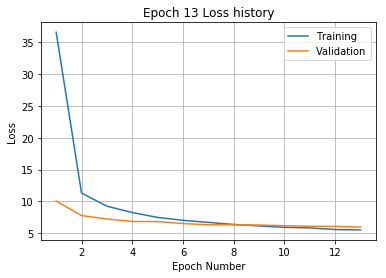

Training
Iteration 0: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.24 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.42 and relative error of 0.32
Iteration 100: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 160: with minibatch training loss = 7.81 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.47 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.02 and relative error of 0.28
Epoch 14, Overall loss = 5.34, relative error = 0.264, and proces

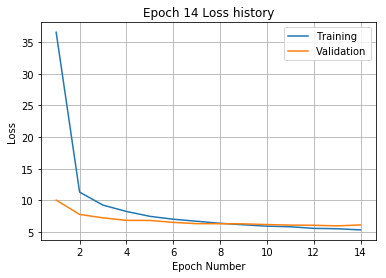

Training
Iteration 0: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 200: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.27 and relative error of 0.27
Epoch 15, Overall loss = 5.26, relative error = 0.262, and proces

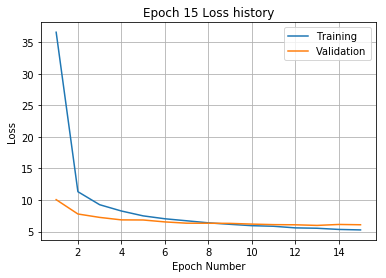

Training
Iteration 0: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.67 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.88 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.8 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 220: with minibatch training loss = 3.8 and relative error of 0.21
Epoch 16, Overall loss = 5.13, relative error = 0.258, and proces

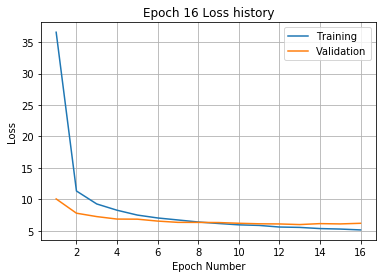

Training
Iteration 0: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 80: with minibatch training loss = 3.29 and relative error of 0.21
Iteration 100: with minibatch training loss = 8.7 and relative error of 0.35
Iteration 120: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.5 and relative error of 0.28
Epoch 17, Overall loss = 5.02, relative error = 0.256, and proce

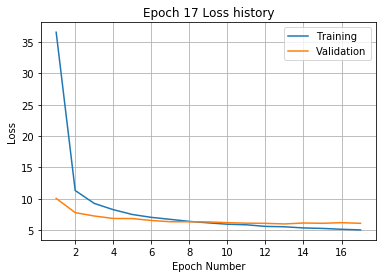

Training
Iteration 0: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.49 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 60: with minibatch training loss = 3.98 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.76 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.47 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.3 and relative error of 0.27
Epoch 18, Overall loss = 5, relative error = 0.255, and process

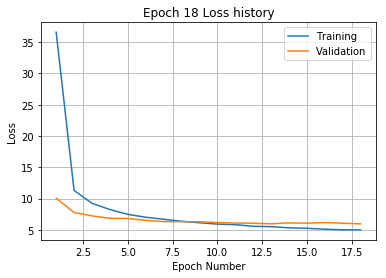

Training
Iteration 0: with minibatch training loss = 3.23 and relative error of 0.21
Iteration 20: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 80: with minibatch training loss = 5 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.91 and relative error of 0.23
Iteration 120: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.33 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.07 and relative error of 0.22
Iteration 220: with minibatch training loss = 4.41 and relative error of 0.25
Epoch 19, Overall loss = 4.88, relative error = 0.252, and proce

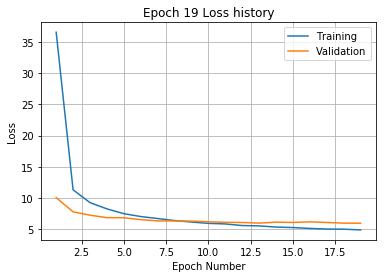

Training
Iteration 0: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 40: with minibatch training loss = 2.97 and relative error of 0.19
Iteration 60: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 100: with minibatch training loss = 4 and relative error of 0.23
Iteration 120: with minibatch training loss = 3.83 and relative error of 0.22
Iteration 140: with minibatch training loss = 3.76 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.64 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.2 and relative error of 0.25
Epoch 20, Overall loss = 4.75, relative error = 0.249, and proces

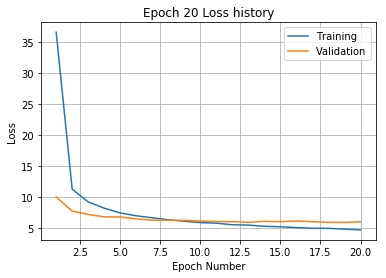

Training
Iteration 0: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 180: with minibatch training loss = 3.64 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.61 and relative error of 0.23
Epoch 21, Overall loss = 4.67, relative error = 0.247, and pro

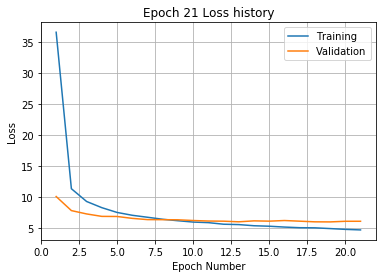

Training
Iteration 0: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 20: with minibatch training loss = 3.56 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.38 and relative error of 0.2
Iteration 100: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 120: with minibatch training loss = 3.55 and relative error of 0.21
Iteration 140: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 160: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.15 and relative error of 0.26
Epoch 22, Overall loss = 4.63, relative error = 0.246, and proc

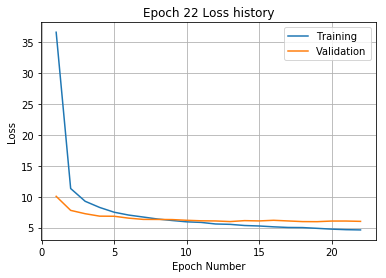

Training
Iteration 0: with minibatch training loss = 3.16 and relative error of 0.2
Iteration 20: with minibatch training loss = 3.72 and relative error of 0.22
Iteration 40: with minibatch training loss = 3.29 and relative error of 0.21
Iteration 60: with minibatch training loss = 3.36 and relative error of 0.21
Iteration 80: with minibatch training loss = 6.56 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.23 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 200: with minibatch training loss = 2.88 and relative error of 0.19
Iteration 220: with minibatch training loss = 4.66 and relative error of 0.25
Epoch 23, Overall loss = 4.54, relative error = 0.243, and proc

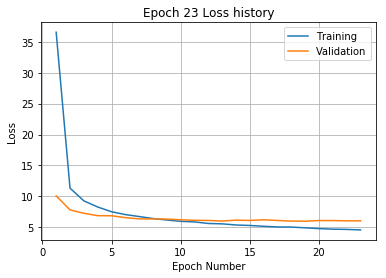

Training
Iteration 0: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.98 and relative error of 0.22
Iteration 40: with minibatch training loss = 3.48 and relative error of 0.21
Iteration 60: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 120: with minibatch training loss = 3.56 and relative error of 0.21
Iteration 140: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 180: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 200: with minibatch training loss = 5 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.83 and relative error of 0.26
Epoch 24, Overall loss = 4.49, relative error = 0.241, and proce

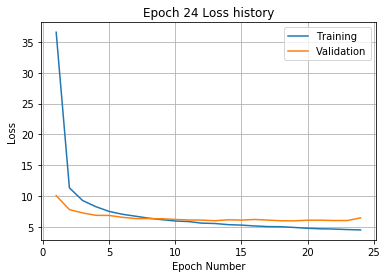

Validation error has stopped improving! Training on repetition 8 stopped!
Training
Iteration 0: with minibatch training loss = 184 and relative error of 1.6
Iteration 20: with minibatch training loss = 108 and relative error of 1.2
Iteration 40: with minibatch training loss = 83.6 and relative error of 1
Iteration 60: with minibatch training loss = 47.6 and relative error of 0.82
Iteration 80: with minibatch training loss = 41.1 and relative error of 0.74
Iteration 100: with minibatch training loss = 28.2 and relative error of 0.62
Iteration 120: with minibatch training loss = 22.4 and relative error of 0.55
Iteration 140: with minibatch training loss = 20.4 and relative error of 0.51
Iteration 160: with minibatch training loss = 15.6 and relative error of 0.45
Iteration 180: with minibatch training loss = 13.6 and relative error of 0.41
Iteration 200: with minibatch training loss = 16.6 and relative error of 0.47
Iteration 220: with minibatch training loss = 17.7 and relative error of

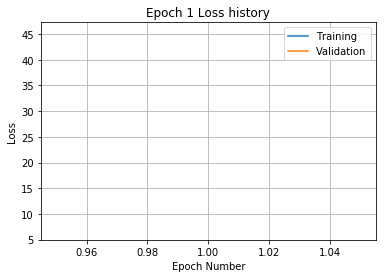

Training
Iteration 0: with minibatch training loss = 12.1 and relative error of 0.39
Iteration 20: with minibatch training loss = 14.9 and relative error of 0.45
Iteration 40: with minibatch training loss = 11.9 and relative error of 0.39
Iteration 60: with minibatch training loss = 14.2 and relative error of 0.44
Iteration 80: with minibatch training loss = 12.6 and relative error of 0.41
Iteration 100: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 140: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 180: with minibatch training loss = 12 and relative error of 0.39
Iteration 200: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 220: with minibatch training loss = 12.1 and relative error of 0.41
Epoch 2, Overall loss = 12, relative error = 0.396, and process

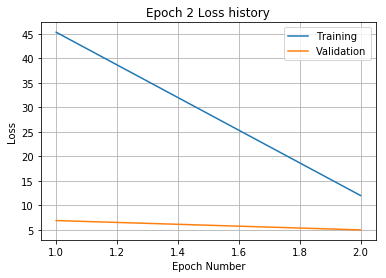

Training
Iteration 0: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 20: with minibatch training loss = 8.45 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.46 and relative error of 0.35
Iteration 60: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 80: with minibatch training loss = 9.86 and relative error of 0.36
Iteration 100: with minibatch training loss = 9.42 and relative error of 0.34
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 140: with minibatch training loss = 10.6 and relative error of 0.36
Iteration 160: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.29 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.22 and relative error of 0.33
Iteration 220: with minibatch training loss = 9.06 and relative error of 0.35
Epoch 3, Overall loss = 9.81, relative error = 0.358, and proc

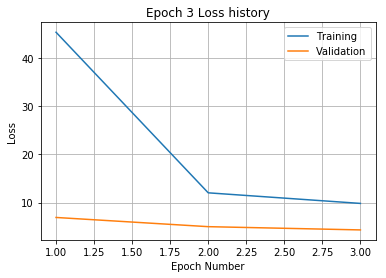

Training
Iteration 0: with minibatch training loss = 8.08 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.8 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.47 and relative error of 0.34
Iteration 60: with minibatch training loss = 9.43 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.64 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.55 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.53 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.94 and relative error of 0.35
Iteration 200: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 220: with minibatch training loss = 8.2 and relative error of 0.32
Epoch 4, Overall loss = 8.6, relative error = 0.335, and process 

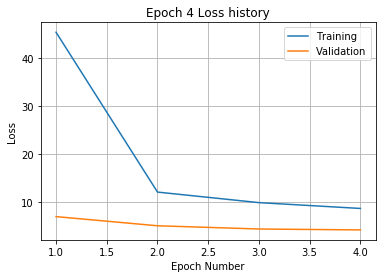

Training
Iteration 0: with minibatch training loss = 9.32 and relative error of 0.36
Iteration 20: with minibatch training loss = 8.33 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.48 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.19 and relative error of 0.3
Iteration 100: with minibatch training loss = 9.97 and relative error of 0.36
Iteration 120: with minibatch training loss = 6.64 and relative error of 0.28
Iteration 140: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.21 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.72 and relative error of 0.31
Iteration 200: with minibatch training loss = 9.91 and relative error of 0.35
Iteration 220: with minibatch training loss = 6.23 and relative error of 0.29
Epoch 5, Overall loss = 7.83, relative error = 0.32, and proces

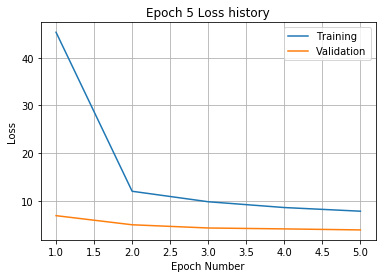

Training
Iteration 0: with minibatch training loss = 8.03 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.43 and relative error of 0.31
Iteration 100: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 120: with minibatch training loss = 6.56 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.56 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.72 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.26 and relative error of 0.28
Epoch 6, Overall loss = 7.35, relative error = 0.31, and process

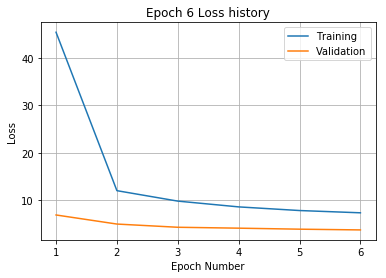

Training
Iteration 0: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 60: with minibatch training loss = 8.16 and relative error of 0.34
Iteration 80: with minibatch training loss = 5.75 and relative error of 0.29
Iteration 100: with minibatch training loss = 9.37 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.88 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.75 and relative error of 0.32
Iteration 220: with minibatch training loss = 9 and relative error of 0.33
Epoch 7, Overall loss = 7.04, relative error = 0.303, and proces

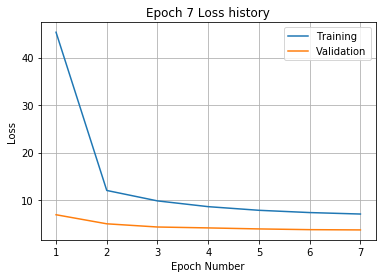

Training
Iteration 0: with minibatch training loss = 7.95 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.38 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.58 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.02 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.71 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.15 and relative error of 0.35
Epoch 8, Overall loss = 6.69, relative error = 0.295, and process

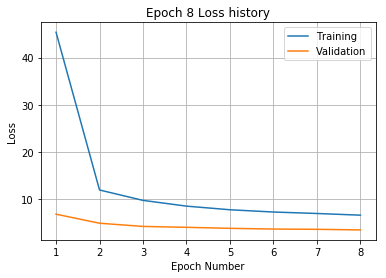

Training
Iteration 0: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.23 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.46 and relative error of 0.26
Epoch 9, Overall loss = 6.46, relative error = 0.29, and process 

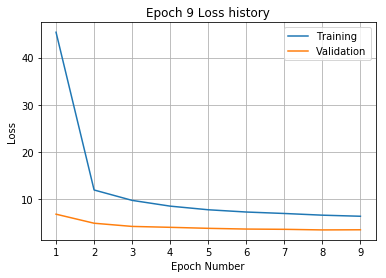

Training
Iteration 0: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.91 and relative error of 0.26
Epoch 10, Overall loss = 6.23, relative error = 0.285, and process

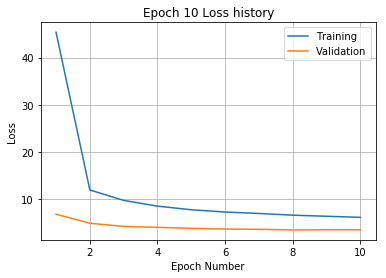

Training
Iteration 0: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.17 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.78 and relative error of 0.33
Iteration 120: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.94 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.97 and relative error of 0.3
Epoch 11, Overall loss = 6.07, relative error = 0.281, and proc

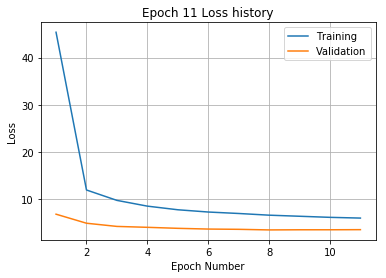

Training
Iteration 0: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 20: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 40: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.06 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.91 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 180: with minibatch training loss = 3.65 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.25 and relative error of 0.26
Epoch 12, Overall loss = 5.9, relative error = 0.277, and proc

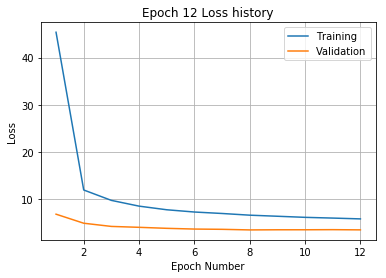

Training
Iteration 0: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.38 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.79 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.15 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.22 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.46 and relative error of 0.24
Epoch 13, Overall loss = 5.73, relative error = 0.273, and process

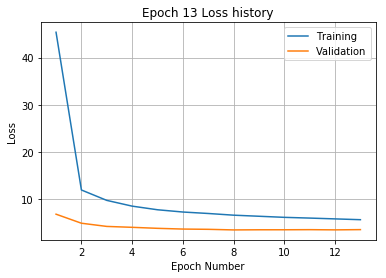

Validation error has stopped improving! Training on repetition 9 stopped!
Training
Iteration 0: with minibatch training loss = 205 and relative error of 1.6
Iteration 20: with minibatch training loss = 114 and relative error of 1.2
Iteration 40: with minibatch training loss = 80.5 and relative error of 1
Iteration 60: with minibatch training loss = 56.6 and relative error of 0.86
Iteration 80: with minibatch training loss = 42 and relative error of 0.73
Iteration 100: with minibatch training loss = 28.4 and relative error of 0.64
Iteration 120: with minibatch training loss = 21.3 and relative error of 0.53
Iteration 140: with minibatch training loss = 19.2 and relative error of 0.51
Iteration 160: with minibatch training loss = 19.8 and relative error of 0.52
Iteration 180: with minibatch training loss = 16.4 and relative error of 0.47
Iteration 200: with minibatch training loss = 16.1 and relative error of 0.47
Iteration 220: with minibatch training loss = 15.4 and relative error of 0

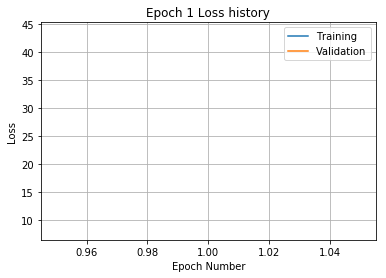

Training
Iteration 0: with minibatch training loss = 15.6 and relative error of 0.44
Iteration 20: with minibatch training loss = 18.1 and relative error of 0.5
Iteration 40: with minibatch training loss = 15.6 and relative error of 0.45
Iteration 60: with minibatch training loss = 14 and relative error of 0.44
Iteration 80: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 100: with minibatch training loss = 12.7 and relative error of 0.39
Iteration 120: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 140: with minibatch training loss = 12.6 and relative error of 0.42
Iteration 160: with minibatch training loss = 13.2 and relative error of 0.4
Iteration 180: with minibatch training loss = 8.82 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.9 and relative error of 0.37
Iteration 220: with minibatch training loss = 9.38 and relative error of 0.37
Epoch 2, Overall loss = 12.1, relative error = 0.398, and process t

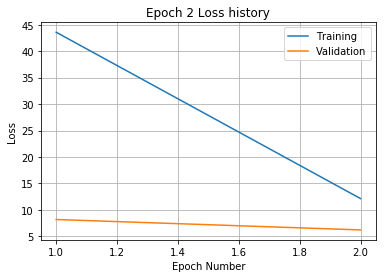

Training
Iteration 0: with minibatch training loss = 8.55 and relative error of 0.35
Iteration 20: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.23 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.53 and relative error of 0.34
Iteration 80: with minibatch training loss = 12.9 and relative error of 0.41
Iteration 100: with minibatch training loss = 8.91 and relative error of 0.33
Iteration 120: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 140: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.68 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.66 and relative error of 0.34
Iteration 220: with minibatch training loss = 10.2 and relative error of 0.35
Epoch 3, Overall loss = 9.77, relative error = 0.357, and proc

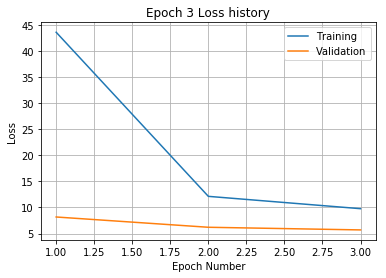

Training
Iteration 0: with minibatch training loss = 8.42 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.91 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.77 and relative error of 0.33
Iteration 60: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 80: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 100: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.19 and relative error of 0.34
Iteration 140: with minibatch training loss = 9.48 and relative error of 0.36
Iteration 160: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.8 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.11 and relative error of 0.33
Epoch 4, Overall loss = 8.59, relative error = 0.335, and proc

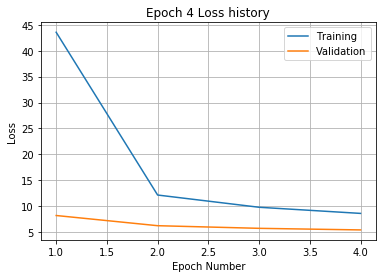

Training
Iteration 0: with minibatch training loss = 8.38 and relative error of 0.34
Iteration 20: with minibatch training loss = 9.59 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.9 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.91 and relative error of 0.34
Iteration 100: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 120: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 160: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.23 and relative error of 0.29
Epoch 5, Overall loss = 7.9, relative error = 0.321, and process

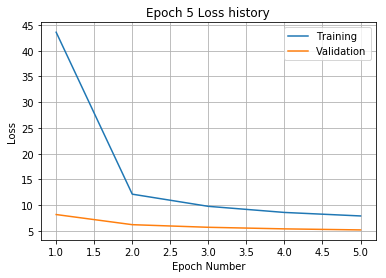

Training
Iteration 0: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.73 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.28 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.1 and relative error of 0.32
Iteration 100: with minibatch training loss = 9.45 and relative error of 0.35
Iteration 120: with minibatch training loss = 8.06 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.4 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.9 and relative error of 0.35
Iteration 180: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 200: with minibatch training loss = 9.79 and relative error of 0.36
Iteration 220: with minibatch training loss = 6.15 and relative error of 0.27
Epoch 6, Overall loss = 7.39, relative error = 0.31, and process t

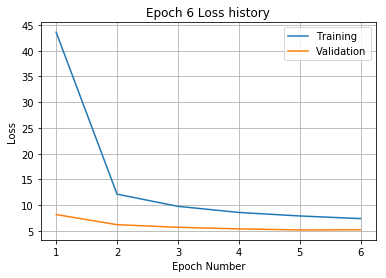

Training
Iteration 0: with minibatch training loss = 7.06 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.52 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.24 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 80: with minibatch training loss = 8.97 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.21 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.41 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 200: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.5 and relative error of 0.29
Epoch 7, Overall loss = 7.03, relative error = 0.303, and proce

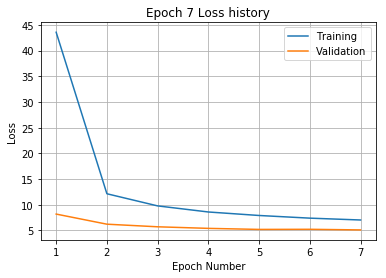

Training
Iteration 0: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 100: with minibatch training loss = 7 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.41 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.56 and relative error of 0.28
Epoch 8, Overall loss = 6.69, relative error = 0.295, and process t

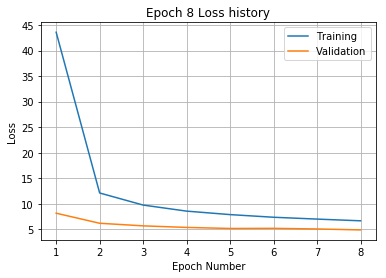

Training
Iteration 0: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.65 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.05 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 220: with minibatch training loss = 3.99 and relative error of 0.23
Epoch 9, Overall loss = 6.43, relative error = 0.29, and proce

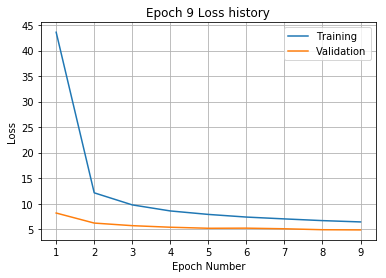

Training
Iteration 0: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.33 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.61 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.27 and relative error of 0.26
Epoch 10, Overall loss = 6.2, relative error = 0.284, and proces

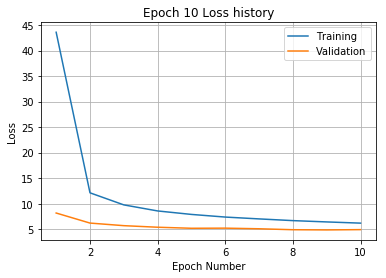

Training
Iteration 0: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.31 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.8 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.73 and relative error of 0.28
Epoch 11, Overall loss = 6.06, relative error = 0.281, and proce

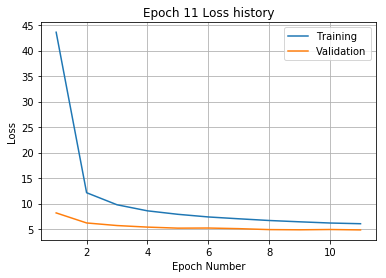

Training
Iteration 0: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.55 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 60: with minibatch training loss = 7 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.47 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.89 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.63 and relative error of 0.25
Epoch 12, Overall loss = 5.86, relative error = 0.276, and process t

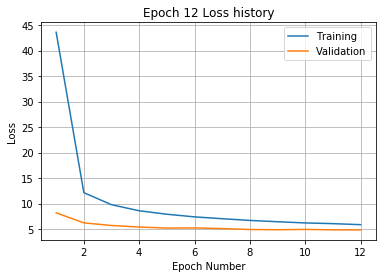

Training
Iteration 0: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 20: with minibatch training loss = 8.32 and relative error of 0.33
Iteration 40: with minibatch training loss = 8 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.98 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.69 and relative error of 0.24
Epoch 13, Overall loss = 5.74, relative error = 0.273, and process 

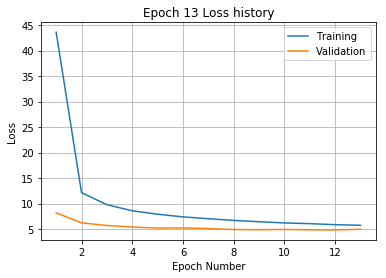

Training
Iteration 0: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.86 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.37 and relative error of 0.29
Epoch 14, Overall loss = 5.57, relative error = 0.269, and proces

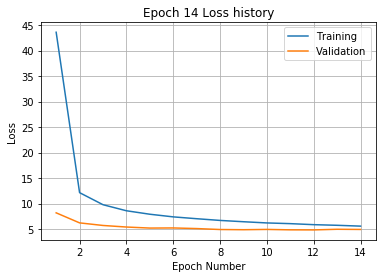

Training
Iteration 0: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 20: with minibatch training loss = 3.52 and relative error of 0.21
Iteration 40: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.98 and relative error of 0.22
Iteration 120: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.12 and relative error of 0.28
Epoch 15, Overall loss = 5.45, relative error = 0.266, and proc

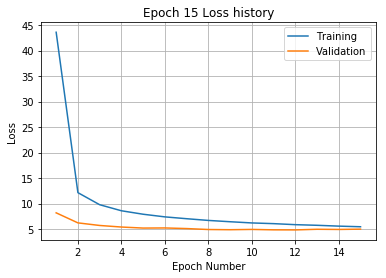

Training
Iteration 0: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.23 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.53 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 100: with minibatch training loss = 3.46 and relative error of 0.22
Iteration 120: with minibatch training loss = 3.34 and relative error of 0.21
Iteration 140: with minibatch training loss = 3.98 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.33 and relative error of 0.25
Iteration 180: with minibatch training loss = 3.11 and relative error of 0.2
Iteration 200: with minibatch training loss = 3.52 and relative error of 0.2
Iteration 220: with minibatch training loss = 6.17 and relative error of 0.29
Epoch 16, Overall loss = 5.35, relative error = 0.264, and proc

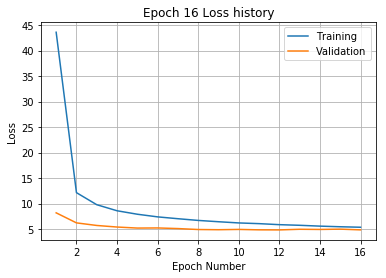

Training
Iteration 0: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.45 and relative error of 0.23
Iteration 40: with minibatch training loss = 8.98 and relative error of 0.35
Iteration 60: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.88 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.07 and relative error of 0.23
Epoch 17, Overall loss = 5.25, relative error = 0.261, and pr

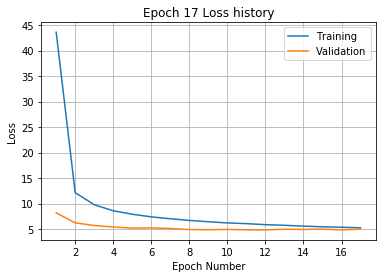

Validation error has stopped improving! Training on repetition 10 stopped!
log interval:  30 seconds
loading data
stacking image log's channels
Training
Iteration 0: with minibatch training loss = 180 and relative error of 1.6
Iteration 20: with minibatch training loss = 103 and relative error of 1.2
Iteration 40: with minibatch training loss = 66 and relative error of 0.92
Iteration 60: with minibatch training loss = 52.7 and relative error of 0.85
Iteration 80: with minibatch training loss = 36.8 and relative error of 0.7
Iteration 100: with minibatch training loss = 29.1 and relative error of 0.63
Iteration 120: with minibatch training loss = 22.8 and relative error of 0.55
Iteration 140: with minibatch training loss = 19.8 and relative error of 0.51
Iteration 160: with minibatch training loss = 18.1 and relative error of 0.5
Iteration 180: with minibatch training loss = 16.4 and relative error of 0.48
Iteration 200: with minibatch training loss = 16.1 and relative error of 0.47
Ite

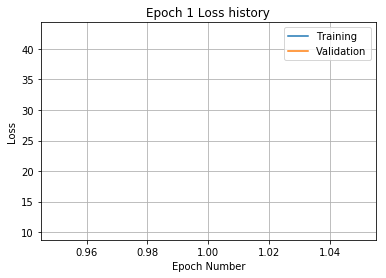

Training
Iteration 0: with minibatch training loss = 13.9 and relative error of 0.44
Iteration 20: with minibatch training loss = 18.4 and relative error of 0.5
Iteration 40: with minibatch training loss = 14.1 and relative error of 0.42
Iteration 60: with minibatch training loss = 14 and relative error of 0.43
Iteration 80: with minibatch training loss = 12.5 and relative error of 0.39
Iteration 100: with minibatch training loss = 13.1 and relative error of 0.41
Iteration 120: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 140: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 160: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 180: with minibatch training loss = 8.19 and relative error of 0.33
Iteration 200: with minibatch training loss = 9.91 and relative error of 0.36
Iteration 220: with minibatch training loss = 10.9 and relative error of 0.37
Epoch 2, Overall loss = 12.2, relative error = 0.404, and proces

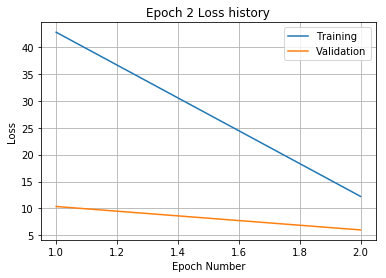

Training
Iteration 0: with minibatch training loss = 9.26 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.6 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.46 and relative error of 0.34
Iteration 60: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 80: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 100: with minibatch training loss = 10 and relative error of 0.37
Iteration 120: with minibatch training loss = 9.54 and relative error of 0.36
Iteration 140: with minibatch training loss = 11.9 and relative error of 0.39
Iteration 160: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.32 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 220: with minibatch training loss = 12.3 and relative error of 0.41
Epoch 3, Overall loss = 9.85, relative error = 0.362, and proces

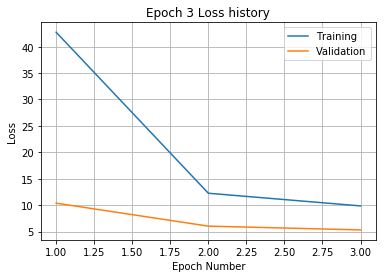

Training
Iteration 0: with minibatch training loss = 7.81 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.03 and relative error of 0.33
Iteration 40: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 60: with minibatch training loss = 7.83 and relative error of 0.34
Iteration 80: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 100: with minibatch training loss = 7.67 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.76 and relative error of 0.33
Iteration 140: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 160: with minibatch training loss = 8.09 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 200: with minibatch training loss = 8.57 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.44 and relative error of 0.31
Epoch 4, Overall loss = 8.68, relative error = 0.34, and proces

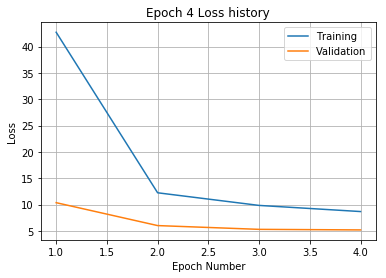

Training
Iteration 0: with minibatch training loss = 8.42 and relative error of 0.35
Iteration 20: with minibatch training loss = 8.04 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 60: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 80: with minibatch training loss = 7.93 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.41 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.93 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.81 and relative error of 0.35
Iteration 180: with minibatch training loss = 6.04 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 220: with minibatch training loss = 10.4 and relative error of 0.38
Epoch 5, Overall loss = 8.04, relative error = 0.327, and proce

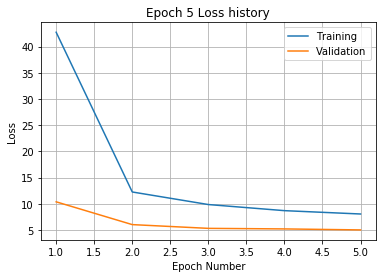

Training
Iteration 0: with minibatch training loss = 8.88 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.38 and relative error of 0.34
Iteration 60: with minibatch training loss = 7.34 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.68 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.46 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 140: with minibatch training loss = 9.13 and relative error of 0.35
Iteration 160: with minibatch training loss = 6.58 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 220: with minibatch training loss = 8.17 and relative error of 0.33
Epoch 6, Overall loss = 7.51, relative error = 0.316, and pro

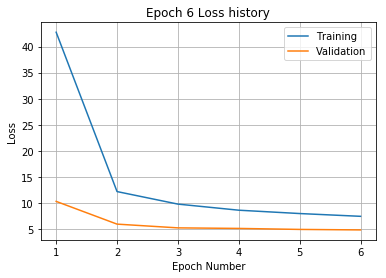

Training
Iteration 0: with minibatch training loss = 8.71 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.98 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 60: with minibatch training loss = 9.05 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.94 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.02 and relative error of 0.29
Iteration 160: with minibatch training loss = 8.93 and relative error of 0.35
Iteration 180: with minibatch training loss = 7.12 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.42 and relative error of 0.25
Epoch 7, Overall loss = 7.1, relative error = 0.307, and proce

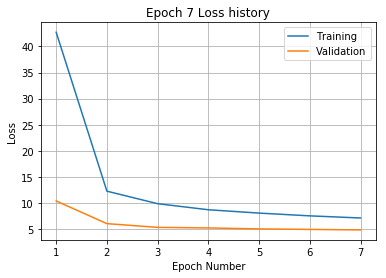

Training
Iteration 0: with minibatch training loss = 7.03 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 120: with minibatch training loss = 8.17 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.3 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.02 and relative error of 0.32
Epoch 8, Overall loss = 6.75, relative error = 0.299, and proce

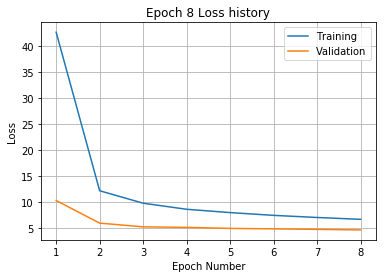

Training
Iteration 0: with minibatch training loss = 6.26 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.78 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.63 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.16 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.76 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.74 and relative error of 0.33
Iteration 220: with minibatch training loss = 5.65 and relative error of 0.27
Epoch 9, Overall loss = 6.47, relative error = 0.293, and process

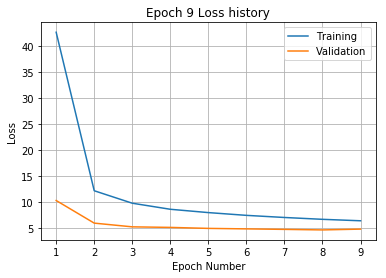

Training
Iteration 0: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.54 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.43 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.23 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.46 and relative error of 0.24
Epoch 10, Overall loss = 6.32, relative error = 0.29, and proce

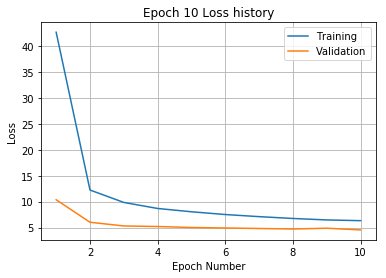

Training
Iteration 0: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.11 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.09 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.56 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 220: with minibatch training loss = 4.31 and relative error of 0.25
Epoch 11, Overall loss = 6.09, relative error = 0.284, and proc

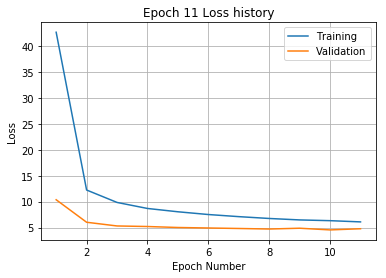

Training
Iteration 0: with minibatch training loss = 4.74 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.38 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.75 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.27 and relative error of 0.23
Iteration 140: with minibatch training loss = 7.65 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.72 and relative error of 0.25
Epoch 12, Overall loss = 5.97, relative error = 0.282, and pro

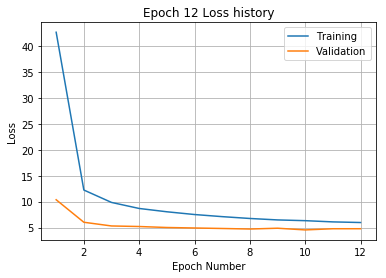

Training
Iteration 0: with minibatch training loss = 5.08 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.05 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.18 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 120: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 140: with minibatch training loss = 6.78 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.16 and relative error of 0.27
Epoch 13, Overall loss = 5.85, relative error = 0.279, and pro

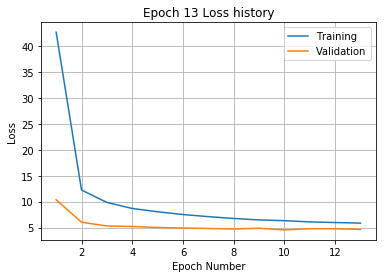

Training
Iteration 0: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 40: with minibatch training loss = 7.56 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.58 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.14 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.15 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.76 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.53 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.49 and relative error of 0.27
Epoch 14, Overall loss = 5.69, relative error = 0.275, and proce

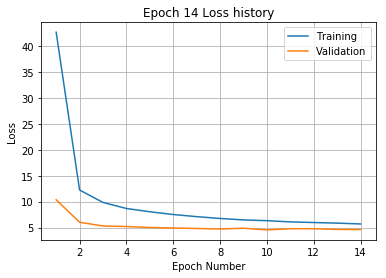

Training
Iteration 0: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.38 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.43 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.51 and relative error of 0.26
Epoch 15, Overall loss = 5.49, relative error = 0.27, and proces

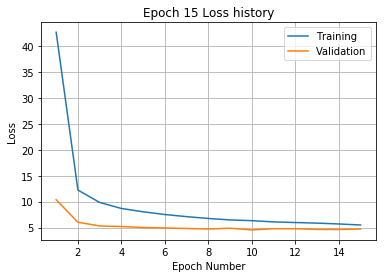

Validation error has stopped improving! Training on repetition 1 stopped!
Training
Iteration 0: with minibatch training loss = 191 and relative error of 1.5
Iteration 20: with minibatch training loss = 95.6 and relative error of 1.1
Iteration 40: with minibatch training loss = 69.2 and relative error of 0.9
Iteration 60: with minibatch training loss = 44.6 and relative error of 0.75
Iteration 80: with minibatch training loss = 33.9 and relative error of 0.68
Iteration 100: with minibatch training loss = 25.7 and relative error of 0.6
Iteration 120: with minibatch training loss = 20.2 and relative error of 0.5
Iteration 140: with minibatch training loss = 20.2 and relative error of 0.51
Iteration 160: with minibatch training loss = 17.4 and relative error of 0.49
Iteration 180: with minibatch training loss = 16.6 and relative error of 0.45
Iteration 200: with minibatch training loss = 13.4 and relative error of 0.41
Iteration 220: with minibatch training loss = 13 and relative error of 

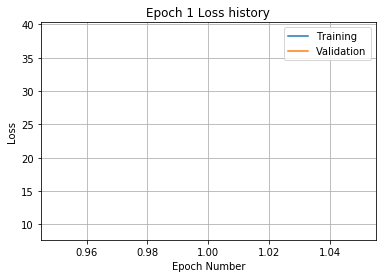

Training
Iteration 0: with minibatch training loss = 12.6 and relative error of 0.41
Iteration 20: with minibatch training loss = 14 and relative error of 0.44
Iteration 40: with minibatch training loss = 13.7 and relative error of 0.44
Iteration 60: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 80: with minibatch training loss = 14.6 and relative error of 0.44
Iteration 100: with minibatch training loss = 13.4 and relative error of 0.43
Iteration 120: with minibatch training loss = 12.1 and relative error of 0.42
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 160: with minibatch training loss = 9.95 and relative error of 0.36
Iteration 180: with minibatch training loss = 9.22 and relative error of 0.35
Iteration 200: with minibatch training loss = 10 and relative error of 0.37
Iteration 220: with minibatch training loss = 10.9 and relative error of 0.36
Epoch 2, Overall loss = 11.8, relative error = 0.394, and process

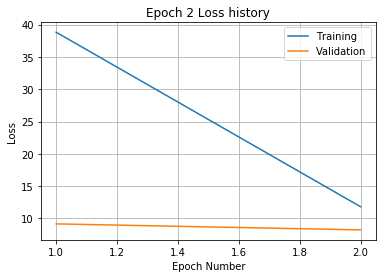

Training
Iteration 0: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 20: with minibatch training loss = 9.34 and relative error of 0.35
Iteration 40: with minibatch training loss = 9.52 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.94 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.48 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.87 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.85 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.65 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 180: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 200: with minibatch training loss = 9.8 and relative error of 0.35
Iteration 220: with minibatch training loss = 8.98 and relative error of 0.36
Epoch 3, Overall loss = 9.76, relative error = 0.358, and proc

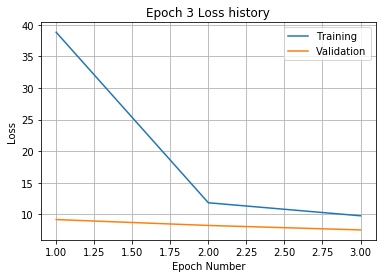

Training
Iteration 0: with minibatch training loss = 8.57 and relative error of 0.34
Iteration 20: with minibatch training loss = 9.19 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.2 and relative error of 0.34
Iteration 60: with minibatch training loss = 7.97 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.58 and relative error of 0.32
Iteration 100: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 120: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 180: with minibatch training loss = 11.5 and relative error of 0.4
Iteration 200: with minibatch training loss = 8.11 and relative error of 0.33
Iteration 220: with minibatch training loss = 10.2 and relative error of 0.37
Epoch 4, Overall loss = 8.59, relative error = 0.336, and proces

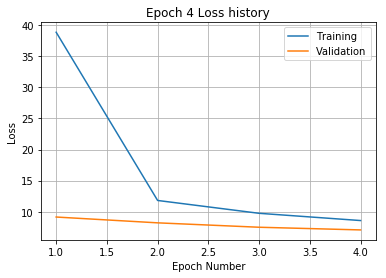

Training
Iteration 0: with minibatch training loss = 7.29 and relative error of 0.3
Iteration 20: with minibatch training loss = 11.4 and relative error of 0.37
Iteration 40: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.79 and relative error of 0.35
Iteration 80: with minibatch training loss = 7.28 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.86 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.13 and relative error of 0.32
Iteration 140: with minibatch training loss = 9.29 and relative error of 0.36
Iteration 160: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.25 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.23 and relative error of 0.26
Epoch 5, Overall loss = 7.89, relative error = 0.322, and proces

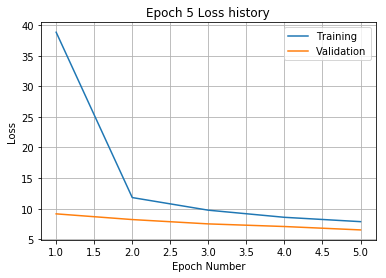

Training
Iteration 0: with minibatch training loss = 7.91 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.94 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.14 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.51 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.39 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.39 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.41 and relative error of 0.33
Epoch 6, Overall loss = 7.34, relative error = 0.31, and process 

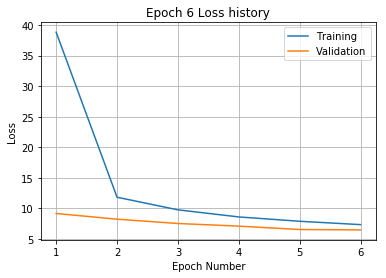

Training
Iteration 0: with minibatch training loss = 7.57 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.45 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 180: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.84 and relative error of 0.32
Epoch 7, Overall loss = 7, relative error = 0.303, and process 

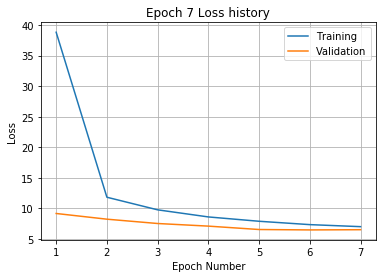

Training
Iteration 0: with minibatch training loss = 5.78 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 40: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 60: with minibatch training loss = 6.49 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.52 and relative error of 0.34
Iteration 140: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.47 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.57 and relative error of 0.3
Epoch 8, Overall loss = 6.69, relative error = 0.296, and process t

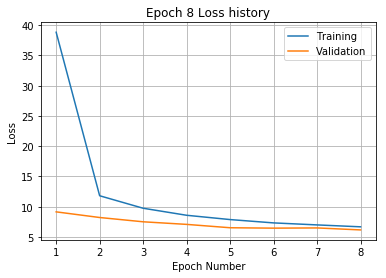

Training
Iteration 0: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.06 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.77 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.51 and relative error of 0.28
Iteration 200: with minibatch training loss = 8.35 and relative error of 0.33
Iteration 220: with minibatch training loss = 4.57 and relative error of 0.24
Epoch 9, Overall loss = 6.41, relative error = 0.29, and proce

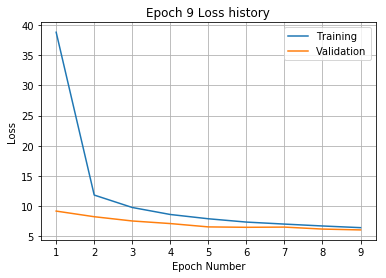

Training
Iteration 0: with minibatch training loss = 7.61 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.38 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.8 and relative error of 0.34
Iteration 220: with minibatch training loss = 5.51 and relative error of 0.26
Epoch 10, Overall loss = 6.2, relative error = 0.285, and process 

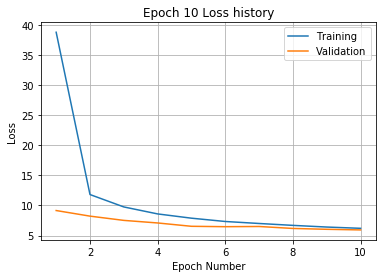

Training
Iteration 0: with minibatch training loss = 5.19 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.45 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.73 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.52 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.25 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.58 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.06 and relative error of 0.25
Iteration 220: with minibatch training loss = 7.2 and relative error of 0.3
Epoch 11, Overall loss = 6.03, relative error = 0.281, and proce

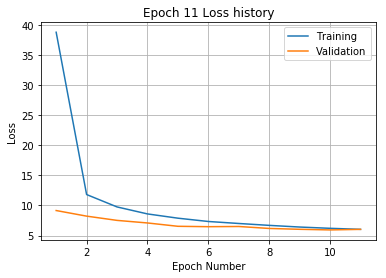

Training
Iteration 0: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.67 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.41 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.75 and relative error of 0.23
Iteration 180: with minibatch training loss = 7.55 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.79 and relative error of 0.29
Epoch 12, Overall loss = 5.86, relative error = 0.277, and pro

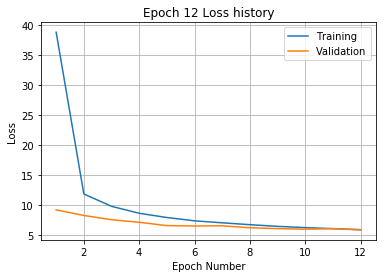

Training
Iteration 0: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 40: with minibatch training loss = 7.53 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 100: with minibatch training loss = 6 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.09 and relative error of 0.23
Epoch 13, Overall loss = 5.78, relative error = 0.275, and process

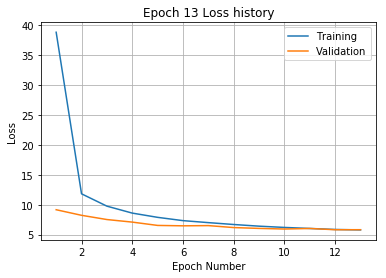

Training
Iteration 0: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.15 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.64 and relative error of 0.24
Epoch 14, Overall loss = 5.56, relative error = 0.27, and process

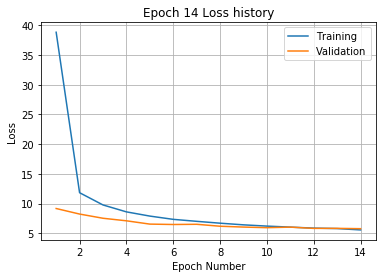

Training
Iteration 0: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.68 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 100: with minibatch training loss = 9.33 and relative error of 0.36
Iteration 120: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.42 and relative error of 0.31
Epoch 15, Overall loss = 5.48, relative error = 0.268, and proc

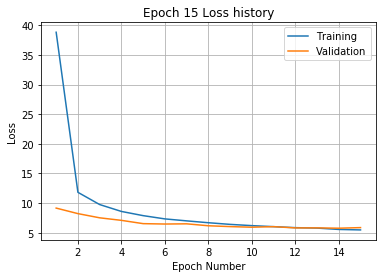

Training
Iteration 0: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.66 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.51 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 120: with minibatch training loss = 3.31 and relative error of 0.21
Iteration 140: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.5 and relative error of 0.28
Epoch 16, Overall loss = 5.34, relative error = 0.264, and pro

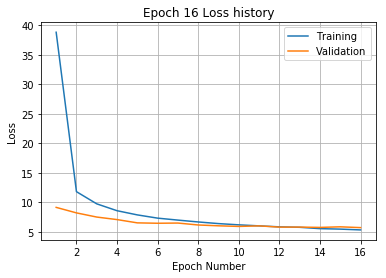

Training
Iteration 0: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.71 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.5 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 180: with minibatch training loss = 3.87 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.78 and relative error of 0.28
Epoch 17, Overall loss = 5.24, relative error = 0.262, and proc

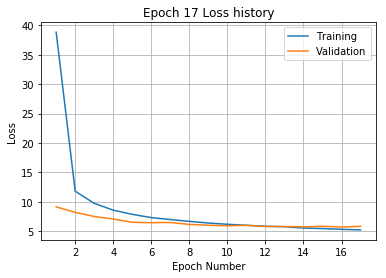

Training
Iteration 0: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.93 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.96 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 180: with minibatch training loss = 3.6 and relative error of 0.21
Iteration 200: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.88 and relative error of 0.25
Epoch 18, Overall loss = 5.17, relative error = 0.26, and proces

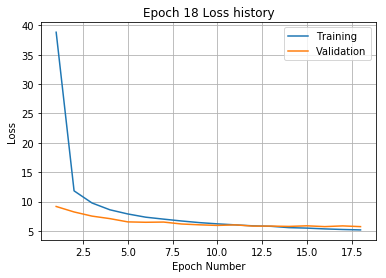

Training
Iteration 0: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 20: with minibatch training loss = 3.84 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.85 and relative error of 0.22
Iteration 100: with minibatch training loss = 4.1 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.3 and relative error of 0.24
Epoch 19, Overall loss = 5.06, relative error = 0.257, and proces

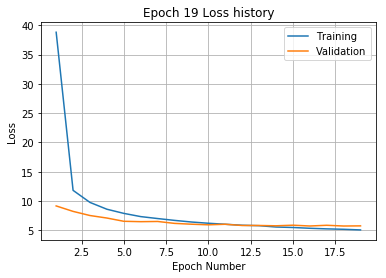

Training
Iteration 0: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 40: with minibatch training loss = 3.32 and relative error of 0.21
Iteration 60: with minibatch training loss = 5.87 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.47 and relative error of 0.25
Iteration 160: with minibatch training loss = 3.92 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 200: with minibatch training loss = 3.22 and relative error of 0.21
Iteration 220: with minibatch training loss = 4.25 and relative error of 0.23
Epoch 20, Overall loss = 4.95, relative error = 0.255, and pr

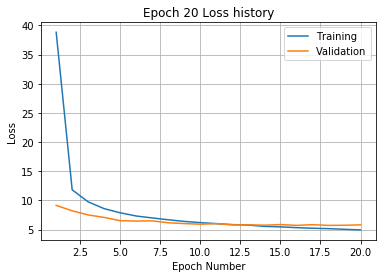

Training
Iteration 0: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 60: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.13 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.19 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.52 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 180: with minibatch training loss = 3.54 and relative error of 0.22
Iteration 200: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.74 and relative error of 0.27
Epoch 21, Overall loss = 4.89, relative error = 0.253, and pro

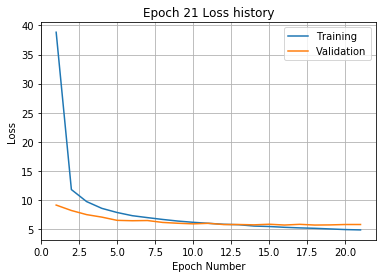

Training
Iteration 0: with minibatch training loss = 4.52 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.23 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.42 and relative error of 0.26
Epoch 22, Overall loss = 4.78, relative error = 0.25, and proce

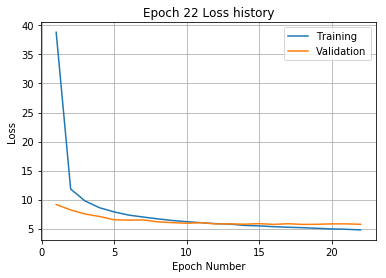

Training
Iteration 0: with minibatch training loss = 2.9 and relative error of 0.19
Iteration 20: with minibatch training loss = 3.18 and relative error of 0.2
Iteration 40: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.08 and relative error of 0.24
Iteration 100: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 120: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.75 and relative error of 0.26
Iteration 160: with minibatch training loss = 3.82 and relative error of 0.22
Iteration 180: with minibatch training loss = 3.99 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.1 and relative error of 0.23
Epoch 23, Overall loss = 4.7, relative error = 0.248, and process

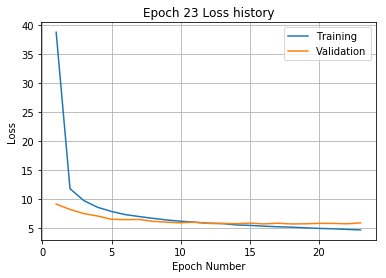

Validation error has stopped improving! Training on repetition 2 stopped!
Training
Iteration 0: with minibatch training loss = 255 and relative error of 1.8
Iteration 20: with minibatch training loss = 135 and relative error of 1.4
Iteration 40: with minibatch training loss = 83 and relative error of 1.1
Iteration 60: with minibatch training loss = 61.9 and relative error of 0.91
Iteration 80: with minibatch training loss = 48.6 and relative error of 0.79
Iteration 100: with minibatch training loss = 36 and relative error of 0.67
Iteration 120: with minibatch training loss = 22.2 and relative error of 0.58
Iteration 140: with minibatch training loss = 19.6 and relative error of 0.49
Iteration 160: with minibatch training loss = 17.6 and relative error of 0.49
Iteration 180: with minibatch training loss = 17.7 and relative error of 0.47
Iteration 200: with minibatch training loss = 13.5 and relative error of 0.42
Iteration 220: with minibatch training loss = 16.6 and relative error of 0

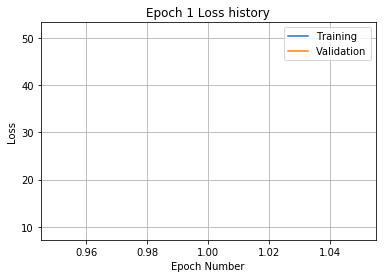

Training
Iteration 0: with minibatch training loss = 14.2 and relative error of 0.43
Iteration 20: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 40: with minibatch training loss = 14 and relative error of 0.43
Iteration 60: with minibatch training loss = 13.8 and relative error of 0.43
Iteration 80: with minibatch training loss = 15.1 and relative error of 0.45
Iteration 100: with minibatch training loss = 14.7 and relative error of 0.43
Iteration 120: with minibatch training loss = 13.1 and relative error of 0.4
Iteration 140: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 180: with minibatch training loss = 9.58 and relative error of 0.37
Iteration 200: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 220: with minibatch training loss = 10.9 and relative error of 0.38
Epoch 2, Overall loss = 12.6, relative error = 0.406, and proces

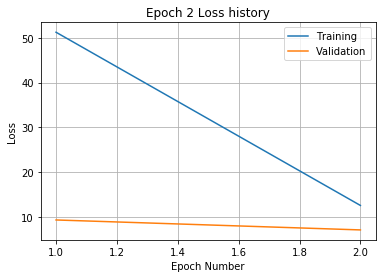

Training
Iteration 0: with minibatch training loss = 8.65 and relative error of 0.33
Iteration 20: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 40: with minibatch training loss = 12.7 and relative error of 0.42
Iteration 60: with minibatch training loss = 9.18 and relative error of 0.35
Iteration 80: with minibatch training loss = 9.69 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 120: with minibatch training loss = 9 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.76 and relative error of 0.34
Iteration 160: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 180: with minibatch training loss = 8.62 and relative error of 0.34
Iteration 200: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 220: with minibatch training loss = 9.65 and relative error of 0.35
Epoch 3, Overall loss = 10.1, relative error = 0.365, and proces

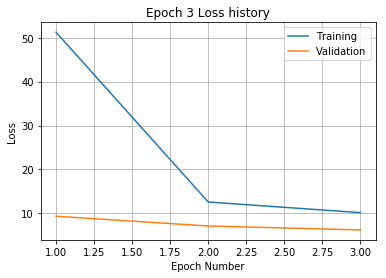

Training
Iteration 0: with minibatch training loss = 9.46 and relative error of 0.38
Iteration 20: with minibatch training loss = 13.3 and relative error of 0.43
Iteration 40: with minibatch training loss = 9.63 and relative error of 0.37
Iteration 60: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.31 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.63 and relative error of 0.34
Iteration 140: with minibatch training loss = 6.48 and relative error of 0.3
Iteration 160: with minibatch training loss = 9.45 and relative error of 0.35
Iteration 180: with minibatch training loss = 7.6 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.99 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.74 and relative error of 0.34
Epoch 4, Overall loss = 8.82, relative error = 0.34, and proces

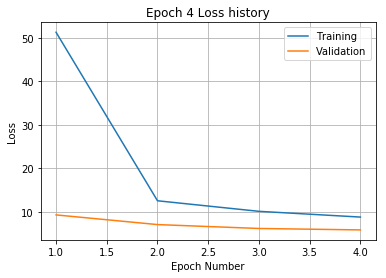

Training
Iteration 0: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.2 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.97 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.28 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.16 and relative error of 0.34
Iteration 100: with minibatch training loss = 9.79 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.98 and relative error of 0.36
Iteration 140: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.28 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.51 and relative error of 0.32
Epoch 5, Overall loss = 8.01, relative error = 0.324, and process

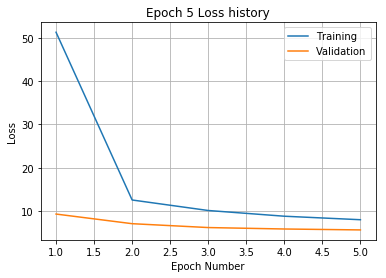

Training
Iteration 0: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.06 and relative error of 0.3
Iteration 40: with minibatch training loss = 9.29 and relative error of 0.35
Iteration 60: with minibatch training loss = 9.47 and relative error of 0.34
Iteration 80: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 100: with minibatch training loss = 8.48 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.81 and relative error of 0.31
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 180: with minibatch training loss = 7.79 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.59 and relative error of 0.28
Epoch 6, Overall loss = 7.52, relative error = 0.314, and proces

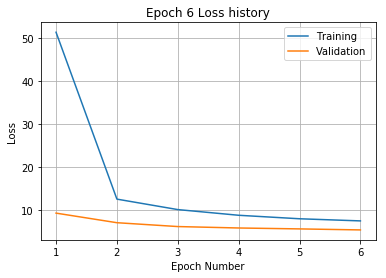

Training
Iteration 0: with minibatch training loss = 8.97 and relative error of 0.36
Iteration 20: with minibatch training loss = 8.41 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.56 and relative error of 0.35
Iteration 60: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.68 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.73 and relative error of 0.29
Epoch 7, Overall loss = 7.04, relative error = 0.304, and proc

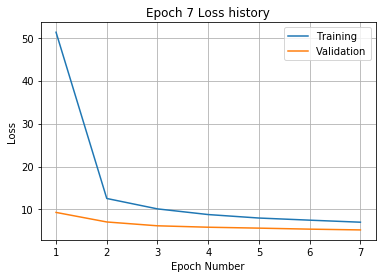

Training
Iteration 0: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.69 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 60: with minibatch training loss = 8.15 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.59 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.62 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.77 and relative error of 0.3
Epoch 8, Overall loss = 6.8, relative error = 0.299, and process

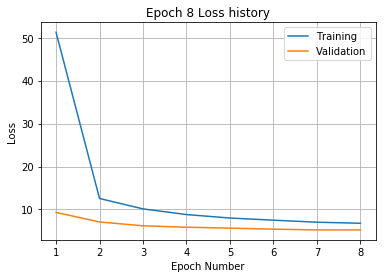

Training
Iteration 0: with minibatch training loss = 6.78 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.69 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 100: with minibatch training loss = 7.78 and relative error of 0.33
Iteration 120: with minibatch training loss = 5.58 and relative error of 0.26
Iteration 140: with minibatch training loss = 8.38 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.5 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.2 and relative error of 0.27
Epoch 9, Overall loss = 6.48, relative error = 0.292, and proces

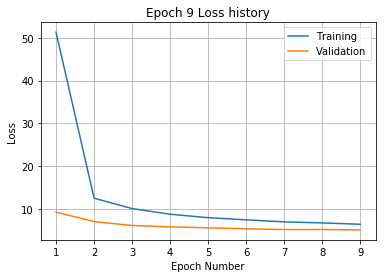

Training
Iteration 0: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.07 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.92 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.94 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.99 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.01 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.29 and relative error of 0.25
Iteration 220: with minibatch training loss = 7.68 and relative error of 0.31
Epoch 10, Overall loss = 6.26, relative error = 0.286, and pro

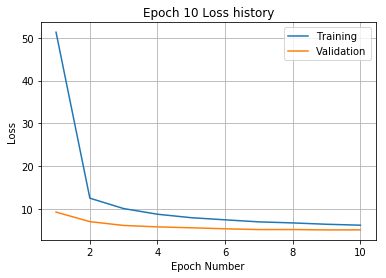

Training
Iteration 0: with minibatch training loss = 7.66 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.8 and relative error of 0.35
Iteration 80: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.35 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.1 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.37 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.02 and relative error of 0.26
Epoch 11, Overall loss = 6.1, relative error = 0.283, and process

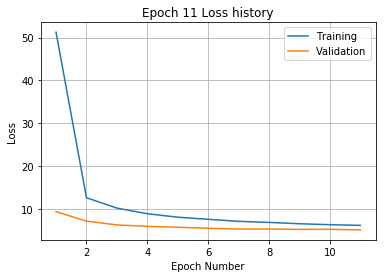

Training
Iteration 0: with minibatch training loss = 6.51 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.52 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.84 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.95 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.11 and relative error of 0.28
Epoch 12, Overall loss = 5.96, relative error = 0.279, and pro

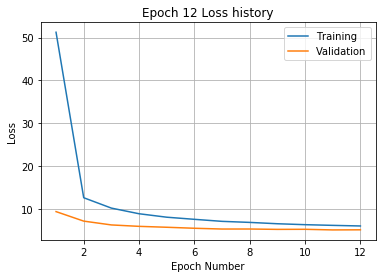

Training
Iteration 0: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.16 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.05 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 100: with minibatch training loss = 3.92 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.72 and relative error of 0.27
Epoch 13, Overall loss = 5.77, relative error = 0.275, and pr

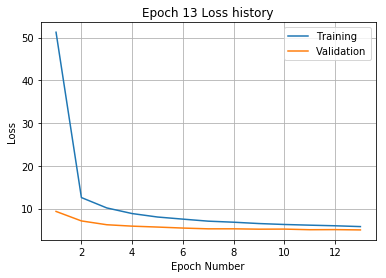

Training
Iteration 0: with minibatch training loss = 3.91 and relative error of 0.22
Iteration 20: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.86 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.48 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.84 and relative error of 0.26
Epoch 14, Overall loss = 5.69, relative error = 0.273, and pro

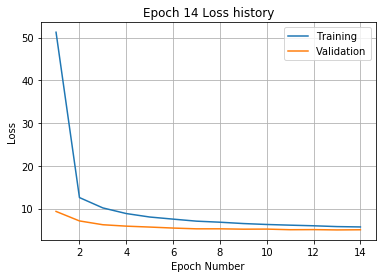

Training
Iteration 0: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.63 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.95 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.39 and relative error of 0.29
Epoch 15, Overall loss = 5.49, relative error = 0.268, and pro

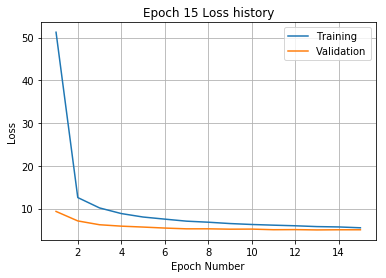

Training
Iteration 0: with minibatch training loss = 5.23 and relative error of 0.25
Iteration 20: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 40: with minibatch training loss = 8.46 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 120: with minibatch training loss = 3.23 and relative error of 0.21
Iteration 140: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.97 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.01 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.27 and relative error of 0.26
Epoch 16, Overall loss = 5.42, relative error = 0.266, and proc

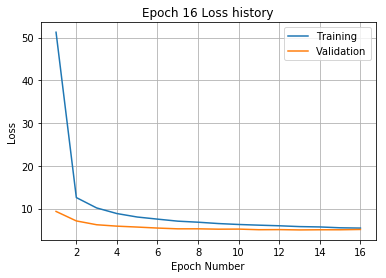

Training
Iteration 0: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.72 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.77 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.69 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.57 and relative error of 0.3
Epoch 17, Overall loss = 5.32, relative error = 0.264, and proc

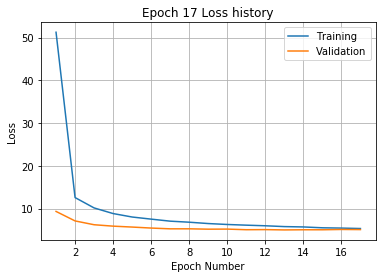

Training
Iteration 0: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 20: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.37 and relative error of 0.28
Iteration 100: with minibatch training loss = 3.82 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.11 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.08 and relative error of 0.23
Epoch 18, Overall loss = 5.2, relative error = 0.261, and proc

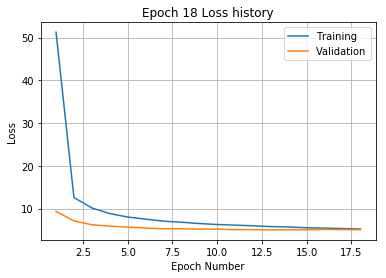

Validation error has stopped improving! Training on repetition 3 stopped!
Training
Iteration 0: with minibatch training loss = 176 and relative error of 1.5
Iteration 20: with minibatch training loss = 104 and relative error of 1.2
Iteration 40: with minibatch training loss = 62.1 and relative error of 0.93
Iteration 60: with minibatch training loss = 54.7 and relative error of 0.83
Iteration 80: with minibatch training loss = 34.1 and relative error of 0.69
Iteration 100: with minibatch training loss = 28.7 and relative error of 0.64
Iteration 120: with minibatch training loss = 23 and relative error of 0.55
Iteration 140: with minibatch training loss = 20.7 and relative error of 0.56
Iteration 160: with minibatch training loss = 16 and relative error of 0.45
Iteration 180: with minibatch training loss = 14.8 and relative error of 0.46
Iteration 200: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 220: with minibatch training loss = 14.5 and relative error of 

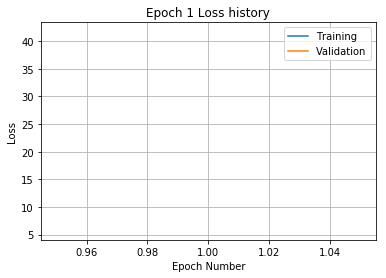

Training
Iteration 0: with minibatch training loss = 11.8 and relative error of 0.4
Iteration 20: with minibatch training loss = 14.6 and relative error of 0.45
Iteration 40: with minibatch training loss = 15.4 and relative error of 0.44
Iteration 60: with minibatch training loss = 14.1 and relative error of 0.42
Iteration 80: with minibatch training loss = 11.7 and relative error of 0.39
Iteration 100: with minibatch training loss = 12.2 and relative error of 0.41
Iteration 120: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 140: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 160: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 180: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 200: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 220: with minibatch training loss = 11.3 and relative error of 0.39
Epoch 2, Overall loss = 12, relative error = 0.396, and process

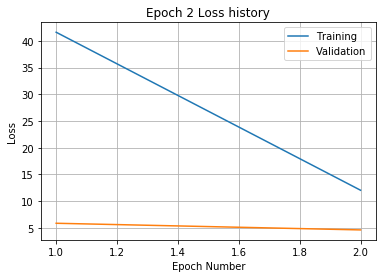

Training
Iteration 0: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 20: with minibatch training loss = 8.1 and relative error of 0.32
Iteration 40: with minibatch training loss = 9.15 and relative error of 0.36
Iteration 60: with minibatch training loss = 9.94 and relative error of 0.37
Iteration 80: with minibatch training loss = 9.13 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.36 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.51 and relative error of 0.31
Iteration 140: with minibatch training loss = 9.16 and relative error of 0.34
Iteration 160: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 180: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 200: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 220: with minibatch training loss = 9.51 and relative error of 0.36
Epoch 3, Overall loss = 9.79, relative error = 0.357, and proc

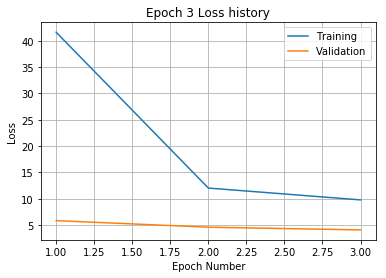

Training
Iteration 0: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 20: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.92 and relative error of 0.33
Iteration 60: with minibatch training loss = 9.49 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.81 and relative error of 0.34
Iteration 100: with minibatch training loss = 10.8 and relative error of 0.35
Iteration 120: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 140: with minibatch training loss = 8.37 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.27 and relative error of 0.3
Iteration 180: with minibatch training loss = 9.18 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.74 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.39 and relative error of 0.34
Epoch 4, Overall loss = 8.63, relative error = 0.335, and proce

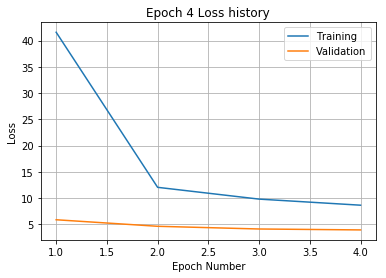

Training
Iteration 0: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.14 and relative error of 0.34
Iteration 40: with minibatch training loss = 12 and relative error of 0.39
Iteration 60: with minibatch training loss = 9.23 and relative error of 0.36
Iteration 80: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 100: with minibatch training loss = 9.06 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.78 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.79 and relative error of 0.32
Epoch 5, Overall loss = 7.98, relative error = 0.322, and process

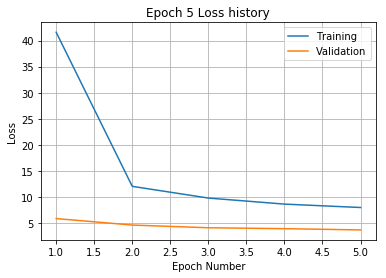

Training
Iteration 0: with minibatch training loss = 10.9 and relative error of 0.36
Iteration 20: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.56 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.62 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.74 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.18 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.61 and relative error of 0.29
Epoch 6, Overall loss = 7.47, relative error = 0.312, and process

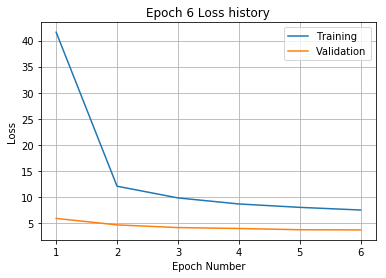

Training
Iteration 0: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.95 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.87 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.99 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.74 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 140: with minibatch training loss = 9.65 and relative error of 0.36
Iteration 160: with minibatch training loss = 5.06 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.63 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.86 and relative error of 0.27
Epoch 7, Overall loss = 7.09, relative error = 0.304, and proces

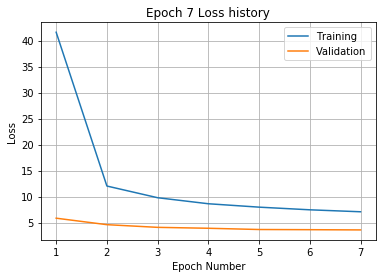

Training
Iteration 0: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 20: with minibatch training loss = 9.2 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 80: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.07 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.19 and relative error of 0.29
Epoch 8, Overall loss = 6.74, relative error = 0.296, and process

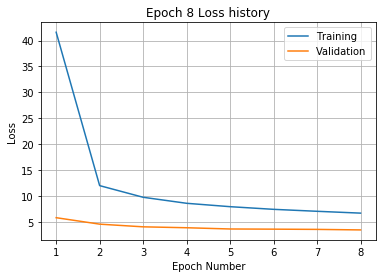

Training
Iteration 0: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 20: with minibatch training loss = 8.68 and relative error of 0.35
Iteration 40: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.34 and relative error of 0.3
Iteration 80: with minibatch training loss = 9.37 and relative error of 0.35
Iteration 100: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.55 and relative error of 0.24
Epoch 9, Overall loss = 6.5, relative error = 0.291, and proces

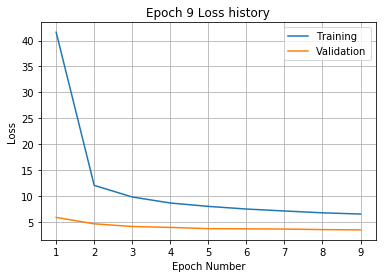

Training
Iteration 0: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.54 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.37 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.75 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.02 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.5 and relative error of 0.28
Epoch 10, Overall loss = 6.33, relative error = 0.287, and process

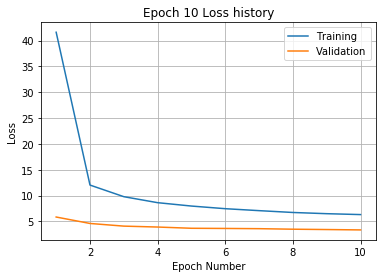

Training
Iteration 0: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.15 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.71 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.01 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 220: with minibatch training loss = 6.96 and relative error of 0.3
Epoch 11, Overall loss = 6.16, relative error = 0.283, and proc

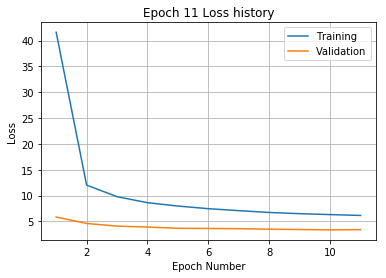

Training
Iteration 0: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 20: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.85 and relative error of 0.31
Iteration 140: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 160: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.36 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.92 and relative error of 0.31
Iteration 220: with minibatch training loss = 4.53 and relative error of 0.24
Epoch 12, Overall loss = 5.91, relative error = 0.277, and proc

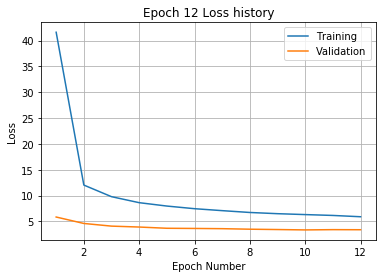

Training
Iteration 0: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 160: with minibatch training loss = 8.54 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.36 and relative error of 0.25
Epoch 13, Overall loss = 5.77, relative error = 0.274, and pro

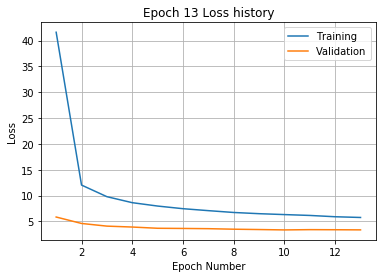

Training
Iteration 0: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.86 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 120: with minibatch training loss = 7.67 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.57 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 180: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 200: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 220: with minibatch training loss = 3.25 and relative error of 0.21
Epoch 14, Overall loss = 5.66, relative error = 0.271, and proc

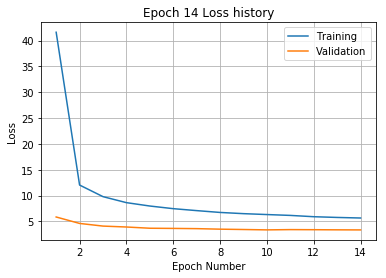

Training
Iteration 0: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.41 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.06 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.73 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.88 and relative error of 0.27
Epoch 15, Overall loss = 5.51, relative error = 0.268, and pro

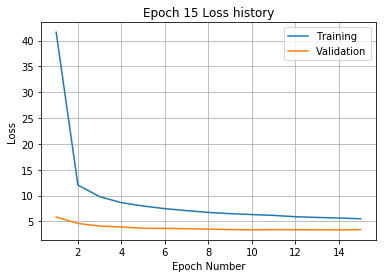

Training
Iteration 0: with minibatch training loss = 5.49 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.37 and relative error of 0.34
Iteration 40: with minibatch training loss = 4.81 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.64 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.1 and relative error of 0.2
Iteration 120: with minibatch training loss = 4.13 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.6 and relative error of 0.24
Epoch 16, Overall loss = 5.45, relative error = 0.266, and proce

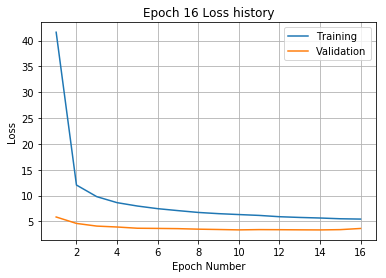

Training
Iteration 0: with minibatch training loss = 4.72 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 60: with minibatch training loss = 6 and relative error of 0.28
Iteration 80: with minibatch training loss = 3.91 and relative error of 0.22
Iteration 100: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.21 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.4 and relative error of 0.28
Epoch 17, Overall loss = 5.29, relative error = 0.262, and process t

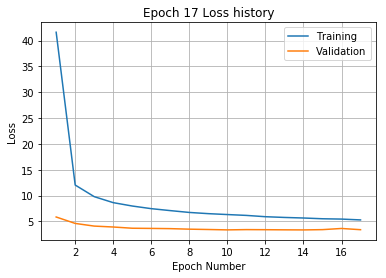

Training
Iteration 0: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 20: with minibatch training loss = 4.17 and relative error of 0.24
Iteration 40: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.63 and relative error of 0.26
Iteration 80: with minibatch training loss = 8.41 and relative error of 0.34
Iteration 100: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.63 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 200: with minibatch training loss = 3.62 and relative error of 0.22
Iteration 220: with minibatch training loss = 4.35 and relative error of 0.24
Epoch 18, Overall loss = 5.21, relative error = 0.26, and proc

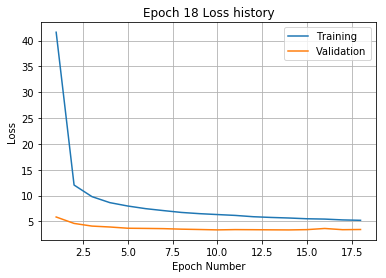

Training
Iteration 0: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.26 and relative error of 0.25
Iteration 40: with minibatch training loss = 3.96 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.22 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.33 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.97 and relative error of 0.28
Epoch 19, Overall loss = 5.11, relative error = 0.258, and proc

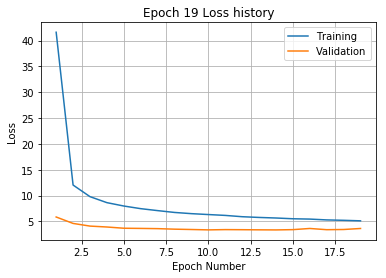

Validation error has stopped improving! Training on repetition 4 stopped!
Training
Iteration 0: with minibatch training loss = 157 and relative error of 1.4
Iteration 20: with minibatch training loss = 78.4 and relative error of 1.1
Iteration 40: with minibatch training loss = 64.6 and relative error of 0.88
Iteration 60: with minibatch training loss = 49.9 and relative error of 0.8
Iteration 80: with minibatch training loss = 30.2 and relative error of 0.65
Iteration 100: with minibatch training loss = 22.3 and relative error of 0.54
Iteration 120: with minibatch training loss = 26.7 and relative error of 0.58
Iteration 140: with minibatch training loss = 19.9 and relative error of 0.51
Iteration 160: with minibatch training loss = 18.8 and relative error of 0.5
Iteration 180: with minibatch training loss = 18.8 and relative error of 0.5
Iteration 200: with minibatch training loss = 13.5 and relative error of 0.41
Iteration 220: with minibatch training loss = 13.2 and relative error o

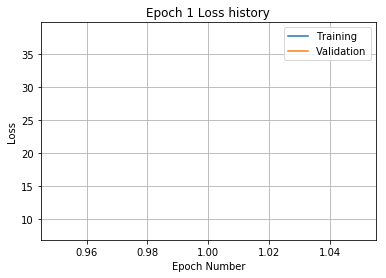

Training
Iteration 0: with minibatch training loss = 12.8 and relative error of 0.4
Iteration 20: with minibatch training loss = 13.5 and relative error of 0.42
Iteration 40: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 60: with minibatch training loss = 15.4 and relative error of 0.43
Iteration 80: with minibatch training loss = 14.1 and relative error of 0.44
Iteration 100: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 120: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 140: with minibatch training loss = 12.4 and relative error of 0.41
Iteration 160: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 180: with minibatch training loss = 12 and relative error of 0.39
Iteration 200: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 220: with minibatch training loss = 11.3 and relative error of 0.4
Epoch 2, Overall loss = 11.7, relative error = 0.391, and process t

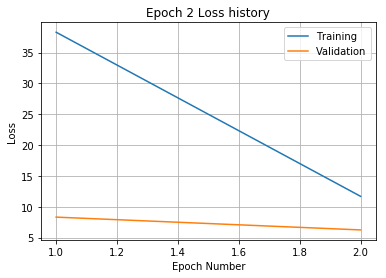

Training
Iteration 0: with minibatch training loss = 9.8 and relative error of 0.35
Iteration 20: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 40: with minibatch training loss = 10.9 and relative error of 0.36
Iteration 60: with minibatch training loss = 9.96 and relative error of 0.35
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 100: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 120: with minibatch training loss = 9.36 and relative error of 0.34
Iteration 140: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 160: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 180: with minibatch training loss = 9.61 and relative error of 0.36
Iteration 200: with minibatch training loss = 8.32 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.54 and relative error of 0.35
Epoch 3, Overall loss = 9.58, relative error = 0.354, and proc

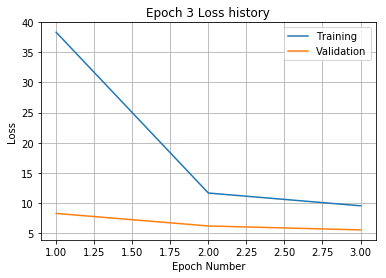

Training
Iteration 0: with minibatch training loss = 8.22 and relative error of 0.32
Iteration 20: with minibatch training loss = 11 and relative error of 0.38
Iteration 40: with minibatch training loss = 8.05 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.22 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.11 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 120: with minibatch training loss = 9.47 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.71 and relative error of 0.36
Iteration 160: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.16 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.79 and relative error of 0.35
Epoch 4, Overall loss = 8.52, relative error = 0.333, and proces

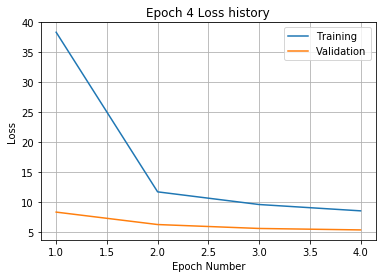

Training
Iteration 0: with minibatch training loss = 8.75 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.98 and relative error of 0.32
Iteration 60: with minibatch training loss = 9.64 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 100: with minibatch training loss = 9.39 and relative error of 0.35
Iteration 120: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 140: with minibatch training loss = 8.28 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.19 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.13 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.05 and relative error of 0.25
Epoch 5, Overall loss = 7.71, relative error = 0.317, and proc

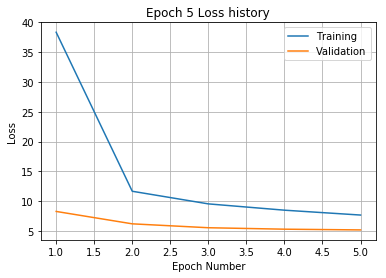

Training
Iteration 0: with minibatch training loss = 8.67 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.99 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.85 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.82 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.67 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.33 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.27 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.77 and relative error of 0.29
Epoch 6, Overall loss = 7.25, relative error = 0.307, and proc

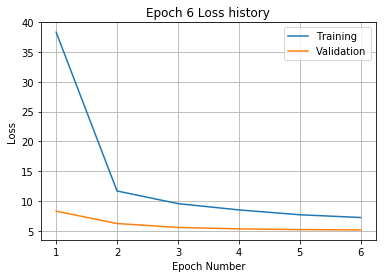

Training
Iteration 0: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 20: with minibatch training loss = 9.49 and relative error of 0.35
Iteration 40: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 60: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.77 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.12 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.26 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.42 and relative error of 0.32
Epoch 7, Overall loss = 6.85, relative error = 0.299, and proc

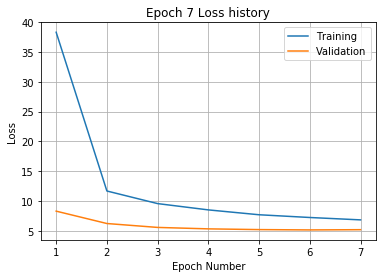

Training
Iteration 0: with minibatch training loss = 5.68 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.12 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.43 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.56 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 160: with minibatch training loss = 8.59 and relative error of 0.33
Iteration 180: with minibatch training loss = 5.18 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.24 and relative error of 0.26
Epoch 8, Overall loss = 6.56, relative error = 0.292, and pro

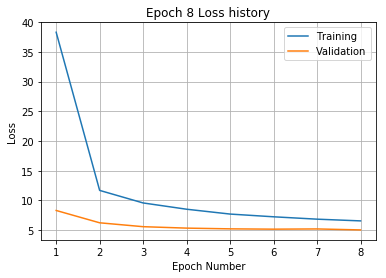

Training
Iteration 0: with minibatch training loss = 7.69 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.89 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.48 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.37 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.79 and relative error of 0.33
Iteration 180: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 200: with minibatch training loss = 8.18 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.57 and relative error of 0.27
Epoch 9, Overall loss = 6.3, relative error = 0.287, and proce

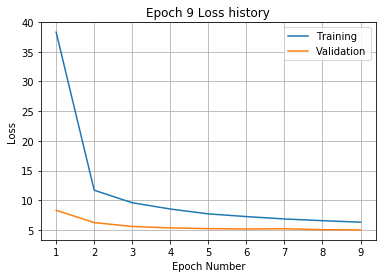

Training
Iteration 0: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.38 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.28 and relative error of 0.26
Epoch 10, Overall loss = 6.05, relative error = 0.281, and proce

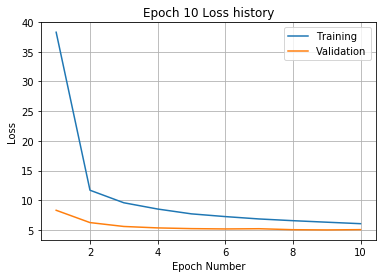

Training
Iteration 0: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 40: with minibatch training loss = 9.43 and relative error of 0.34
Iteration 60: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.06 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.33 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.74 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.64 and relative error of 0.26
Epoch 11, Overall loss = 5.87, relative error = 0.276, and proces

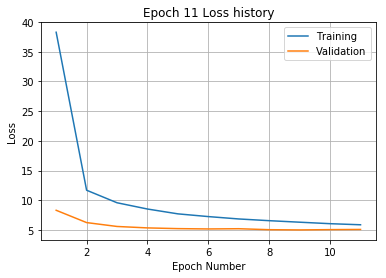

Training
Iteration 0: with minibatch training loss = 6.5 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.12 and relative error of 0.25
Iteration 40: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.37 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.4 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.07 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.75 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.49 and relative error of 0.28
Epoch 12, Overall loss = 5.71, relative error = 0.272, and proc

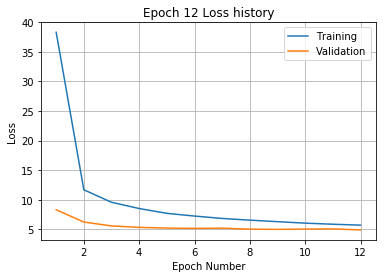

Training
Iteration 0: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 80: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.51 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.75 and relative error of 0.22
Epoch 13, Overall loss = 5.55, relative error = 0.269, and pr

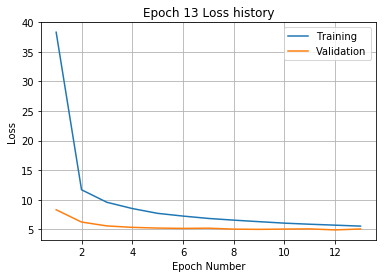

Training
Iteration 0: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.52 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.56 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 200: with minibatch training loss = 8.47 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.44 and relative error of 0.24
Epoch 14, Overall loss = 5.45, relative error = 0.266, and pr

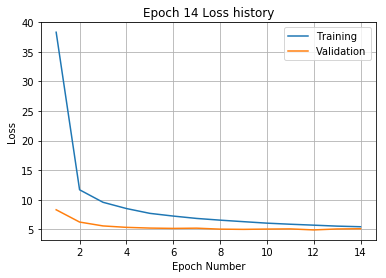

Training
Iteration 0: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 20: with minibatch training loss = 3.62 and relative error of 0.22
Iteration 40: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.97 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 140: with minibatch training loss = 8.09 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.73 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.76 and relative error of 0.22
Epoch 15, Overall loss = 5.33, relative error = 0.263, and pro

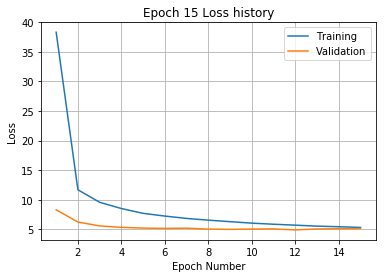

Training
Iteration 0: with minibatch training loss = 5.15 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.19 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.65 and relative error of 0.21
Iteration 100: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.91 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.58 and relative error of 0.27
Epoch 16, Overall loss = 5.22, relative error = 0.261, and proc

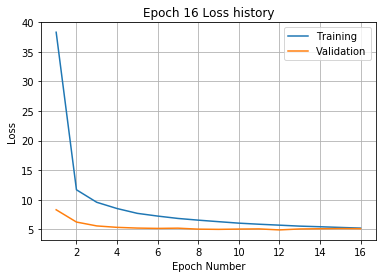

Training
Iteration 0: with minibatch training loss = 3.71 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.84 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.49 and relative error of 0.23
Iteration 100: with minibatch training loss = 3.5 and relative error of 0.21
Iteration 120: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.11 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.09 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.26 and relative error of 0.28
Epoch 17, Overall loss = 5.06, relative error = 0.256, and proc

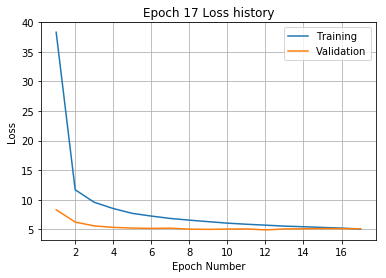

Validation error has stopped improving! Training on repetition 5 stopped!
Training
Iteration 0: with minibatch training loss = 184 and relative error of 1.5
Iteration 20: with minibatch training loss = 93.7 and relative error of 1.1
Iteration 40: with minibatch training loss = 64 and relative error of 0.92
Iteration 60: with minibatch training loss = 42.8 and relative error of 0.74
Iteration 80: with minibatch training loss = 36 and relative error of 0.67
Iteration 100: with minibatch training loss = 25.1 and relative error of 0.56
Iteration 120: with minibatch training loss = 22.2 and relative error of 0.52
Iteration 140: with minibatch training loss = 21.1 and relative error of 0.52
Iteration 160: with minibatch training loss = 15.9 and relative error of 0.45
Iteration 180: with minibatch training loss = 15.2 and relative error of 0.44
Iteration 200: with minibatch training loss = 15.2 and relative error of 0.43
Iteration 220: with minibatch training loss = 12.8 and relative error of

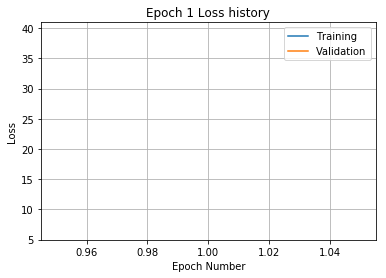

Training
Iteration 0: with minibatch training loss = 14.9 and relative error of 0.44
Iteration 20: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 40: with minibatch training loss = 13.7 and relative error of 0.4
Iteration 60: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 80: with minibatch training loss = 14.8 and relative error of 0.43
Iteration 100: with minibatch training loss = 13.8 and relative error of 0.42
Iteration 120: with minibatch training loss = 14.6 and relative error of 0.41
Iteration 140: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 160: with minibatch training loss = 14.6 and relative error of 0.43
Iteration 180: with minibatch training loss = 11.9 and relative error of 0.41
Iteration 200: with minibatch training loss = 11.8 and relative error of 0.38
Iteration 220: with minibatch training loss = 11 and relative error of 0.37
Epoch 2, Overall loss = 12.1, relative error = 0.399, and proces

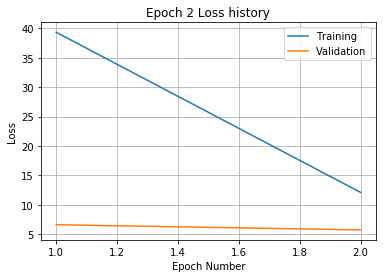

Training
Iteration 0: with minibatch training loss = 9.53 and relative error of 0.37
Iteration 20: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 40: with minibatch training loss = 9.6 and relative error of 0.36
Iteration 60: with minibatch training loss = 12.5 and relative error of 0.39
Iteration 80: with minibatch training loss = 8.3 and relative error of 0.33
Iteration 100: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 120: with minibatch training loss = 11 and relative error of 0.38
Iteration 140: with minibatch training loss = 11 and relative error of 0.37
Iteration 160: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 180: with minibatch training loss = 8.99 and relative error of 0.35
Iteration 200: with minibatch training loss = 9.19 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.56 and relative error of 0.32
Epoch 3, Overall loss = 9.89, relative error = 0.36, and process ti

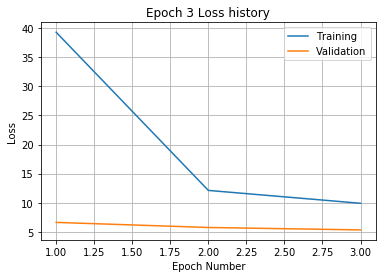

Training
Iteration 0: with minibatch training loss = 9.39 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.9 and relative error of 0.37
Iteration 40: with minibatch training loss = 8.79 and relative error of 0.33
Iteration 60: with minibatch training loss = 7.39 and relative error of 0.3
Iteration 80: with minibatch training loss = 9.15 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.79 and relative error of 0.35
Iteration 120: with minibatch training loss = 9.65 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.86 and relative error of 0.37
Iteration 160: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.09 and relative error of 0.32
Iteration 200: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 220: with minibatch training loss = 6.47 and relative error of 0.3
Epoch 4, Overall loss = 8.74, relative error = 0.339, and proces

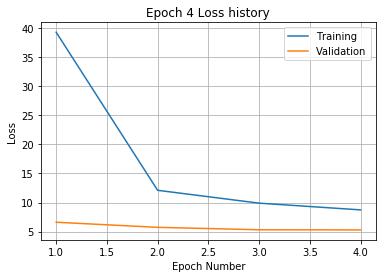

Training
Iteration 0: with minibatch training loss = 9.3 and relative error of 0.36
Iteration 20: with minibatch training loss = 7.94 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.25 and relative error of 0.34
Iteration 100: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.62 and relative error of 0.35
Iteration 160: with minibatch training loss = 7.59 and relative error of 0.34
Iteration 180: with minibatch training loss = 10 and relative error of 0.36
Iteration 200: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.68 and relative error of 0.32
Epoch 5, Overall loss = 7.97, relative error = 0.323, and process 

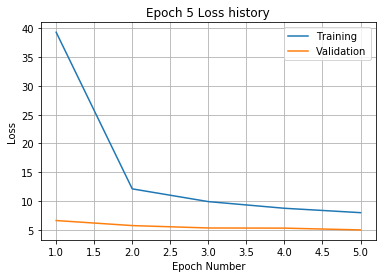

Training
Iteration 0: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.55 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 80: with minibatch training loss = 9.86 and relative error of 0.36
Iteration 100: with minibatch training loss = 9.53 and relative error of 0.37
Iteration 120: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 160: with minibatch training loss = 8.08 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.94 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.58 and relative error of 0.34
Epoch 6, Overall loss = 7.5, relative error = 0.313, and process

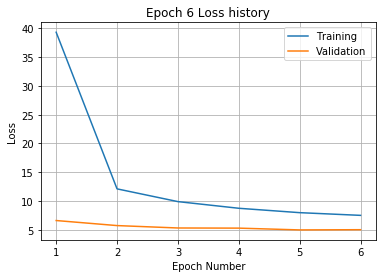

Training
Iteration 0: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 20: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 40: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.43 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.9 and relative error of 0.32
Epoch 7, Overall loss = 7.04, relative error = 0.304, and proces

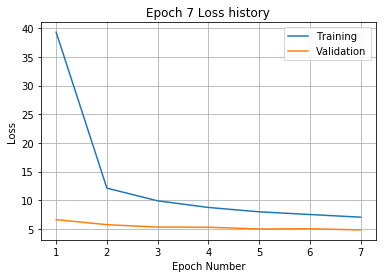

Training
Iteration 0: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.07 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.62 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.34 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.06 and relative error of 0.35
Iteration 140: with minibatch training loss = 10 and relative error of 0.37
Iteration 160: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.92 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.94 and relative error of 0.27
Epoch 8, Overall loss = 6.76, relative error = 0.297, and process 

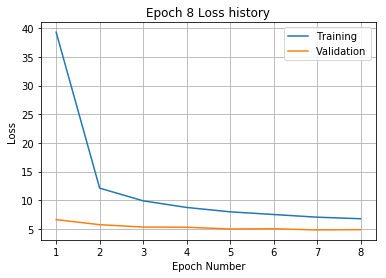

Training
Iteration 0: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.96 and relative error of 0.33
Iteration 220: with minibatch training loss = 5.84 and relative error of 0.28
Epoch 9, Overall loss = 6.41, relative error = 0.29, and proces

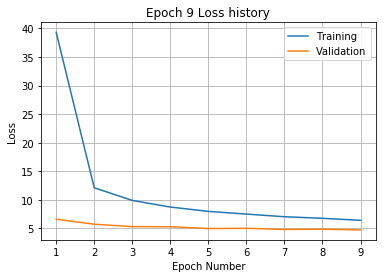

Training
Iteration 0: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.19 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.23 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.4 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.8 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.27 and relative error of 0.36
Iteration 180: with minibatch training loss = 5.25 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.19 and relative error of 0.28
Epoch 10, Overall loss = 6.2, relative error = 0.285, and proce

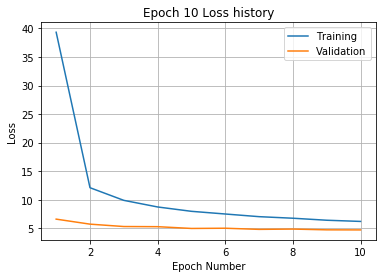

Training
Iteration 0: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.55 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.3 and relative error of 0.23
Iteration 100: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.39 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.77 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 180: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 200: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.29 and relative error of 0.26
Epoch 11, Overall loss = 6.06, relative error = 0.282, and proc

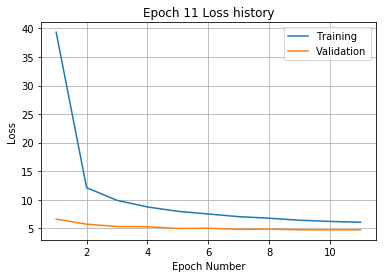

Training
Iteration 0: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 20: with minibatch training loss = 9.51 and relative error of 0.34
Iteration 40: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 100: with minibatch training loss = 3.84 and relative error of 0.24
Iteration 120: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.76 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 200: with minibatch training loss = 7.36 and relative error of 0.3
Iteration 220: with minibatch training loss = 3.94 and relative error of 0.23
Epoch 12, Overall loss = 5.9, relative error = 0.278, and proce

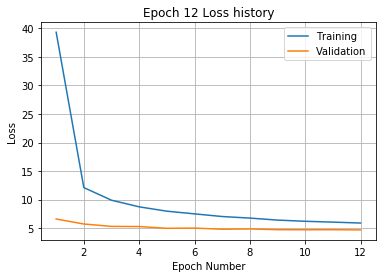

Training
Iteration 0: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.38 and relative error of 0.28
Iteration 40: with minibatch training loss = 6 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.12 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.8 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.39 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.02 and relative error of 0.23
Epoch 13, Overall loss = 5.77, relative error = 0.275, and process 

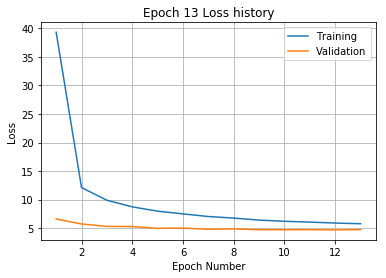

Training
Iteration 0: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.22 and relative error of 0.3
Iteration 40: with minibatch training loss = 5 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.74 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.84 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.9 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 180: with minibatch training loss = 3.78 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.88 and relative error of 0.28
Epoch 14, Overall loss = 5.6, relative error = 0.271, and process t

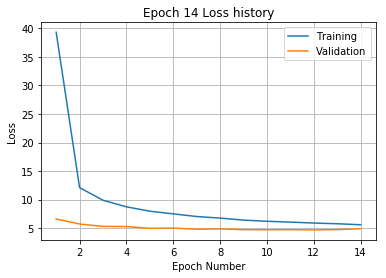

Training
Iteration 0: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 60: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.62 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.51 and relative error of 0.23
Iteration 140: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.1 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.09 and relative error of 0.29
Epoch 15, Overall loss = 5.51, relative error = 0.268, and proc

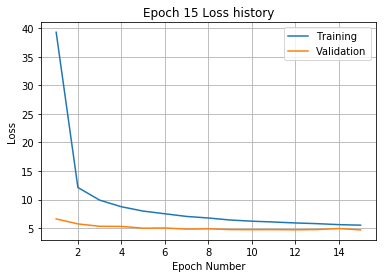

Training
Iteration 0: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.11 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.49 and relative error of 0.28
Iteration 60: with minibatch training loss = 3.31 and relative error of 0.21
Iteration 80: with minibatch training loss = 6.05 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.32 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.17 and relative error of 0.27
Epoch 16, Overall loss = 5.39, relative error = 0.265, and pro

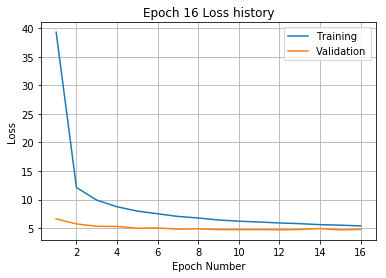

Training
Iteration 0: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.41 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.17 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.55 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.48 and relative error of 0.24
Epoch 17, Overall loss = 5.27, relative error = 0.263, and pro

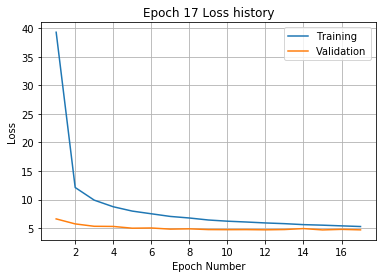

Training
Iteration 0: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 40: with minibatch training loss = 3.77 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.59 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.6 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.2 and relative error of 0.23
Iteration 140: with minibatch training loss = 3.8 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.56 and relative error of 0.27
Epoch 18, Overall loss = 5.14, relative error = 0.259, and proce

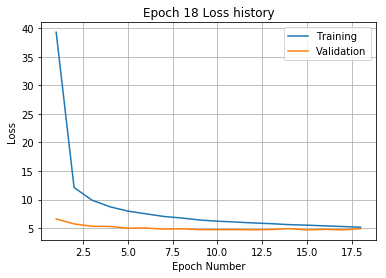

Training
Iteration 0: with minibatch training loss = 4.38 and relative error of 0.23
Iteration 20: with minibatch training loss = 3.7 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 80: with minibatch training loss = 3.56 and relative error of 0.21
Iteration 100: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.61 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.65 and relative error of 0.26
Epoch 19, Overall loss = 5.07, relative error = 0.257, and proce

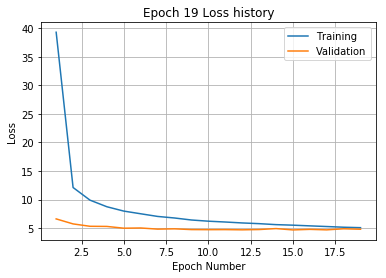

Training
Iteration 0: with minibatch training loss = 3.95 and relative error of 0.22
Iteration 20: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.69 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.52 and relative error of 0.21
Iteration 180: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 200: with minibatch training loss = 2.93 and relative error of 0.19
Iteration 220: with minibatch training loss = 5 and relative error of 0.26
Epoch 20, Overall loss = 4.98, relative error = 0.255, and proce

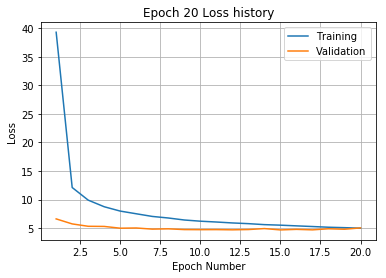

Validation error has stopped improving! Training on repetition 6 stopped!
Training
Iteration 0: with minibatch training loss = 167 and relative error of 1.5
Iteration 20: with minibatch training loss = 123 and relative error of 1.3
Iteration 40: with minibatch training loss = 82.6 and relative error of 1
Iteration 60: with minibatch training loss = 64.7 and relative error of 0.93
Iteration 80: with minibatch training loss = 47.8 and relative error of 0.78
Iteration 100: with minibatch training loss = 36.2 and relative error of 0.67
Iteration 120: with minibatch training loss = 26.6 and relative error of 0.57
Iteration 140: with minibatch training loss = 18.4 and relative error of 0.49
Iteration 160: with minibatch training loss = 18.3 and relative error of 0.49
Iteration 180: with minibatch training loss = 19.5 and relative error of 0.51
Iteration 200: with minibatch training loss = 16 and relative error of 0.44
Iteration 220: with minibatch training loss = 15.3 and relative error of 0

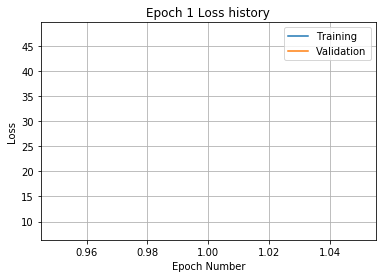

Training
Iteration 0: with minibatch training loss = 16.7 and relative error of 0.46
Iteration 20: with minibatch training loss = 13.2 and relative error of 0.41
Iteration 40: with minibatch training loss = 14.1 and relative error of 0.41
Iteration 60: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 80: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 100: with minibatch training loss = 14.1 and relative error of 0.43
Iteration 120: with minibatch training loss = 14.4 and relative error of 0.44
Iteration 140: with minibatch training loss = 11.4 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 180: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 200: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 220: with minibatch training loss = 10.1 and relative error of 0.36
Epoch 2, Overall loss = 12.5, relative error = 0.404, and proce

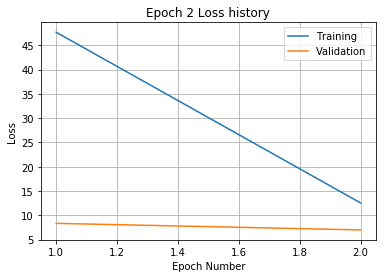

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 20: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 40: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 60: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 100: with minibatch training loss = 9.51 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.78 and relative error of 0.33
Iteration 140: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 160: with minibatch training loss = 7.94 and relative error of 0.32
Iteration 180: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 200: with minibatch training loss = 7.23 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.13 and relative error of 0.36
Epoch 3, Overall loss = 10, relative error = 0.361, and proce

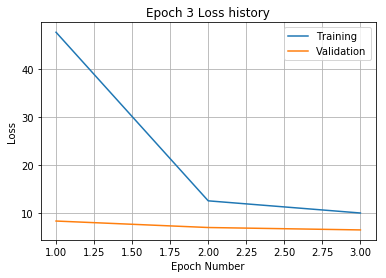

Training
Iteration 0: with minibatch training loss = 8.14 and relative error of 0.32
Iteration 20: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 40: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 60: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 80: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 100: with minibatch training loss = 7.77 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.87 and relative error of 0.32
Iteration 140: with minibatch training loss = 11 and relative error of 0.38
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 180: with minibatch training loss = 8.88 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.73 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.71 and relative error of 0.33
Epoch 4, Overall loss = 8.88, relative error = 0.34, and process 

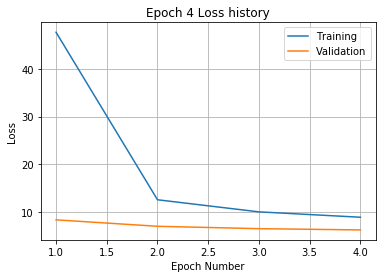

Training
Iteration 0: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.38 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.26 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.12 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.26 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.69 and relative error of 0.33
Iteration 160: with minibatch training loss = 8.91 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.54 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.08 and relative error of 0.33
Iteration 220: with minibatch training loss = 9.27 and relative error of 0.34
Epoch 5, Overall loss = 8.05, relative error = 0.324, and proces

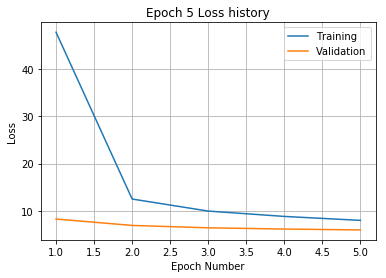

Training
Iteration 0: with minibatch training loss = 7.99 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 40: with minibatch training loss = 13 and relative error of 0.41
Iteration 60: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.66 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.31 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.37 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 200: with minibatch training loss = 9.07 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.08 and relative error of 0.32
Epoch 6, Overall loss = 7.43, relative error = 0.311, and proce

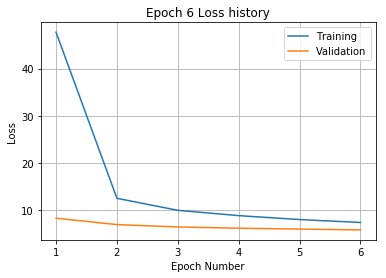

Training
Iteration 0: with minibatch training loss = 6.23 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.48 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.26 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.38 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.75 and relative error of 0.3
Epoch 7, Overall loss = 7.06, relative error = 0.303, and process

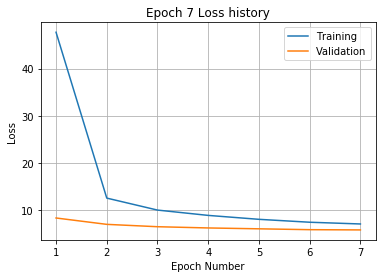

Training
Iteration 0: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 20: with minibatch training loss = 7.84 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.27 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.38 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.06 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.01 and relative error of 0.31
Epoch 8, Overall loss = 6.8, relative error = 0.298, and proc

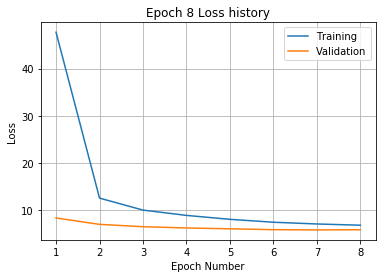

Training
Iteration 0: with minibatch training loss = 6.83 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.62 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.3 and relative error of 0.23
Iteration 120: with minibatch training loss = 7.06 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.24 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.43 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.83 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.66 and relative error of 0.27
Epoch 9, Overall loss = 6.42, relative error = 0.289, and proce

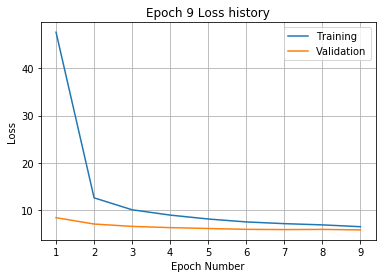

Training
Iteration 0: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.73 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.8 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.98 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 100: with minibatch training loss = 8.43 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.56 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.37 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.82 and relative error of 0.3
Epoch 10, Overall loss = 6.23, relative error = 0.285, and proce

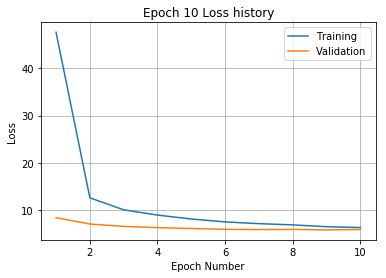

Training
Iteration 0: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.57 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.24 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.7 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.15 and relative error of 0.26
Epoch 11, Overall loss = 5.97, relative error = 0.278, and proces

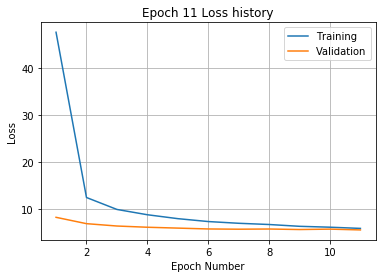

Training
Iteration 0: with minibatch training loss = 6.38 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.48 and relative error of 0.27
Epoch 12, Overall loss = 5.8, relative error = 0.275, and proc

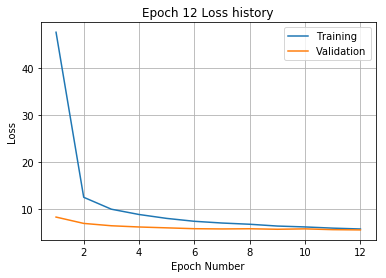

Training
Iteration 0: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.19 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 100: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.39 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.34 and relative error of 0.34
Iteration 200: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.57 and relative error of 0.33
Epoch 13, Overall loss = 5.66, relative error = 0.271, and pr

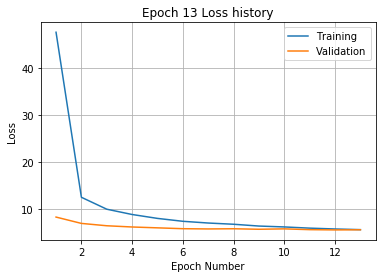

Training
Iteration 0: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.82 and relative error of 0.27
Iteration 160: with minibatch training loss = 3.76 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.7 and relative error of 0.28
Epoch 14, Overall loss = 5.54, relative error = 0.268, and proce

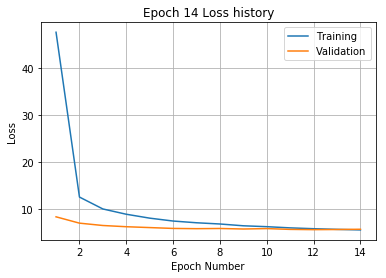

Training
Iteration 0: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.6 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.02 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 120: with minibatch training loss = 3.46 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 160: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 180: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.55 and relative error of 0.23
Iteration 220: with minibatch training loss = 6.65 and relative error of 0.29
Epoch 15, Overall loss = 5.43, relative error = 0.265, and proce

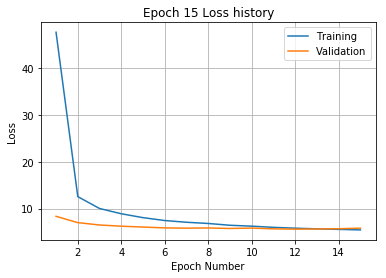

Training
Iteration 0: with minibatch training loss = 5.5 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.56 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.94 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.19 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.63 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.47 and relative error of 0.24
Epoch 16, Overall loss = 5.27, relative error = 0.262, and pro

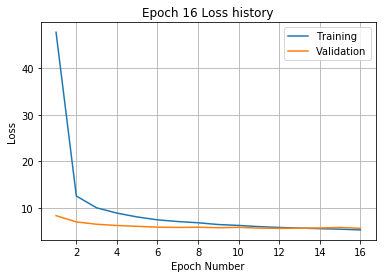

Training
Iteration 0: with minibatch training loss = 6.6 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.42 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 80: with minibatch training loss = 2.91 and relative error of 0.2
Iteration 100: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 120: with minibatch training loss = 3.74 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.64 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.35 and relative error of 0.26
Epoch 17, Overall loss = 5.14, relative error = 0.258, and proce

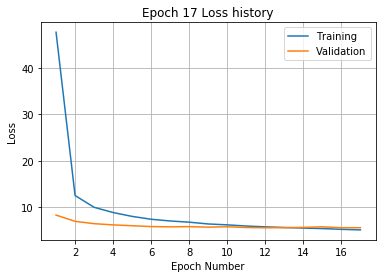

Validation error has stopped improving! Training on repetition 7 stopped!
Training
Iteration 0: with minibatch training loss = 249 and relative error of 1.7
Iteration 20: with minibatch training loss = 128 and relative error of 1.3
Iteration 40: with minibatch training loss = 79.2 and relative error of 1.1
Iteration 60: with minibatch training loss = 65.1 and relative error of 0.95
Iteration 80: with minibatch training loss = 45.8 and relative error of 0.76
Iteration 100: with minibatch training loss = 33.8 and relative error of 0.68
Iteration 120: with minibatch training loss = 28.5 and relative error of 0.62
Iteration 140: with minibatch training loss = 27.7 and relative error of 0.6
Iteration 160: with minibatch training loss = 18.6 and relative error of 0.49
Iteration 180: with minibatch training loss = 14.7 and relative error of 0.44
Iteration 200: with minibatch training loss = 15.1 and relative error of 0.43
Iteration 220: with minibatch training loss = 14.7 and relative error o

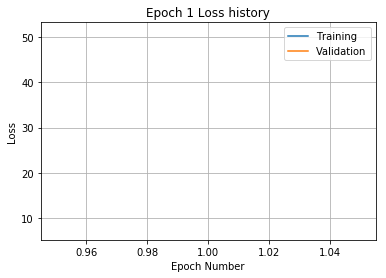

Training
Iteration 0: with minibatch training loss = 14.6 and relative error of 0.43
Iteration 20: with minibatch training loss = 16.3 and relative error of 0.45
Iteration 40: with minibatch training loss = 15.6 and relative error of 0.44
Iteration 60: with minibatch training loss = 12.7 and relative error of 0.42
Iteration 80: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 100: with minibatch training loss = 13.8 and relative error of 0.42
Iteration 120: with minibatch training loss = 9.8 and relative error of 0.36
Iteration 140: with minibatch training loss = 10 and relative error of 0.36
Iteration 160: with minibatch training loss = 13.5 and relative error of 0.44
Iteration 180: with minibatch training loss = 12.3 and relative error of 0.39
Iteration 200: with minibatch training loss = 13.3 and relative error of 0.43
Iteration 220: with minibatch training loss = 11.7 and relative error of 0.38
Epoch 2, Overall loss = 12.7, relative error = 0.408, and proces

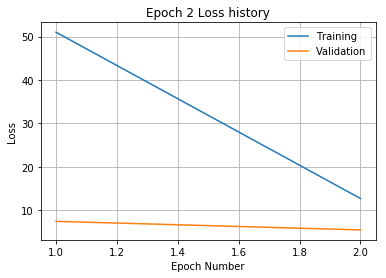

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 20: with minibatch training loss = 14 and relative error of 0.43
Iteration 40: with minibatch training loss = 9.31 and relative error of 0.36
Iteration 60: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 80: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 100: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 120: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 140: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 160: with minibatch training loss = 9.62 and relative error of 0.35
Iteration 180: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 200: with minibatch training loss = 7.04 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.21 and relative error of 0.34
Epoch 3, Overall loss = 10.4, relative error = 0.369, and process

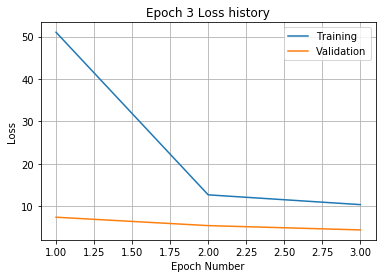

Training
Iteration 0: with minibatch training loss = 8.29 and relative error of 0.32
Iteration 20: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 40: with minibatch training loss = 9.8 and relative error of 0.36
Iteration 60: with minibatch training loss = 9.41 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.2 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.33 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.45 and relative error of 0.33
Iteration 160: with minibatch training loss = 11.1 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.44 and relative error of 0.36
Iteration 200: with minibatch training loss = 9.54 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.74 and relative error of 0.32
Epoch 4, Overall loss = 9.15, relative error = 0.346, and proce

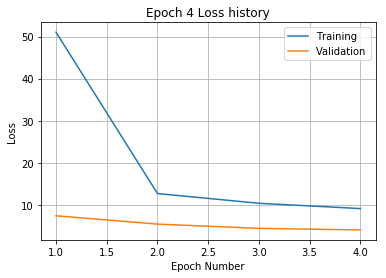

Training
Iteration 0: with minibatch training loss = 6.94 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.6 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.68 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 120: with minibatch training loss = 12 and relative error of 0.41
Iteration 140: with minibatch training loss = 8.64 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.18 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.12 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.6 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.66 and relative error of 0.32
Epoch 5, Overall loss = 8.38, relative error = 0.331, and process 

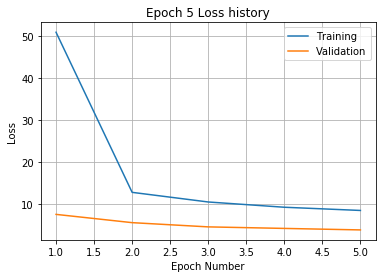

Training
Iteration 0: with minibatch training loss = 9.12 and relative error of 0.35
Iteration 20: with minibatch training loss = 6.09 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.69 and relative error of 0.32
Iteration 80: with minibatch training loss = 9.11 and relative error of 0.36
Iteration 100: with minibatch training loss = 9.08 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.23 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.32 and relative error of 0.31
Epoch 6, Overall loss = 7.86, relative error = 0.321, and process

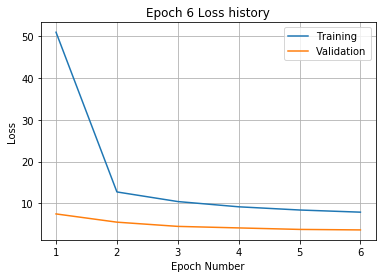

Training
Iteration 0: with minibatch training loss = 7.59 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.52 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 60: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 80: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.58 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.88 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.19 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.25 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.89 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.51 and relative error of 0.34
Epoch 7, Overall loss = 7.36, relative error = 0.31, and proc

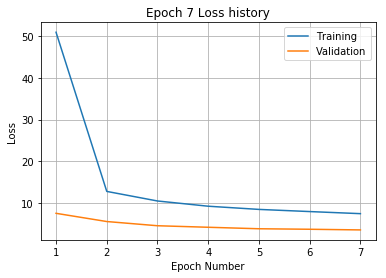

Training
Iteration 0: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.6 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.34 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.02 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.76 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.81 and relative error of 0.35
Iteration 200: with minibatch training loss = 8.45 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.08 and relative error of 0.33
Epoch 8, Overall loss = 7.05, relative error = 0.304, and proces

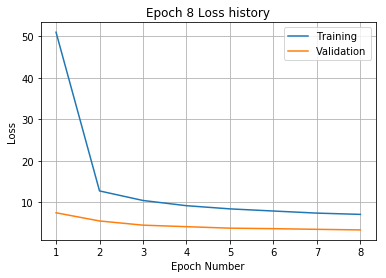

Training
Iteration 0: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.36 and relative error of 0.3
Iteration 40: with minibatch training loss = 8.18 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 80: with minibatch training loss = 9.39 and relative error of 0.36
Iteration 100: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 120: with minibatch training loss = 9.36 and relative error of 0.35
Iteration 140: with minibatch training loss = 6.25 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.59 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.24 and relative error of 0.22
Iteration 220: with minibatch training loss = 8.4 and relative error of 0.34
Epoch 9, Overall loss = 6.83, relative error = 0.299, and proces

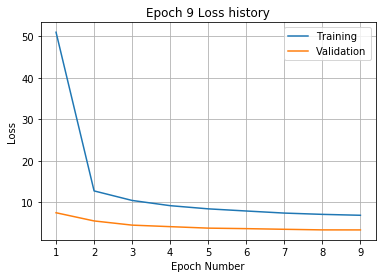

Training
Iteration 0: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 140: with minibatch training loss = 3.65 and relative error of 0.21
Iteration 160: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.91 and relative error of 0.28
Epoch 10, Overall loss = 6.51, relative error = 0.292, and pro

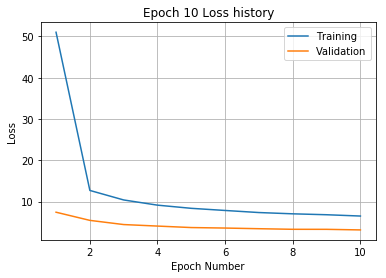

Training
Iteration 0: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.66 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.24 and relative error of 0.31
Epoch 11, Overall loss = 6.41, relative error = 0.289, and proc

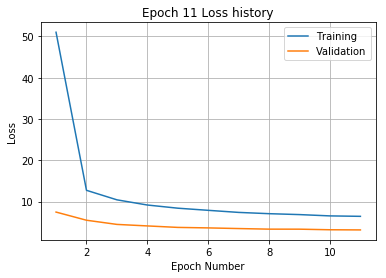

Training
Iteration 0: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 40: with minibatch training loss = 7.96 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 120: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 140: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.57 and relative error of 0.24
Epoch 12, Overall loss = 6.19, relative error = 0.284, and proc

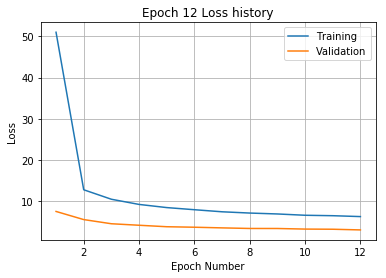

Training
Iteration 0: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.31 and relative error of 0.23
Iteration 100: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.09 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.38 and relative error of 0.28
Iteration 220: with minibatch training loss = 8.3 and relative error of 0.33
Epoch 13, Overall loss = 6, relative error = 0.28, and process 

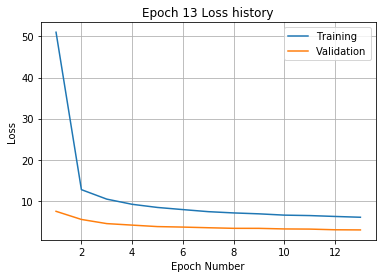

Training
Iteration 0: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.12 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.06 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 140: with minibatch training loss = 3.88 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.22 and relative error of 0.26
Epoch 14, Overall loss = 5.87, relative error = 0.277, and pr

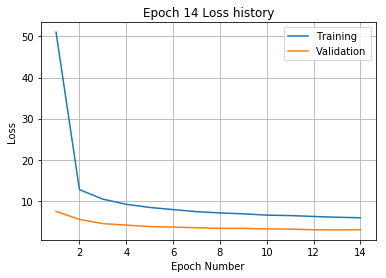

Training
Iteration 0: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.76 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.71 and relative error of 0.32
Iteration 80: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 120: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.57 and relative error of 0.28
Iteration 180: with minibatch training loss = 6 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 220: with minibatch training loss = 3.83 and relative error of 0.22
Epoch 15, Overall loss = 5.79, relative error = 0.275, and proce

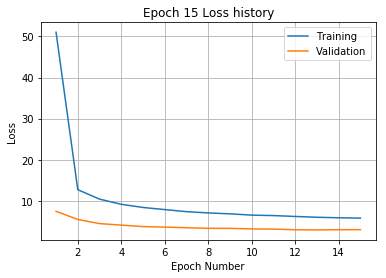

Training
Iteration 0: with minibatch training loss = 6.32 and relative error of 0.3
Iteration 20: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.47 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.92 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.99 and relative error of 0.29
Epoch 16, Overall loss = 5.61, relative error = 0.271, and proc

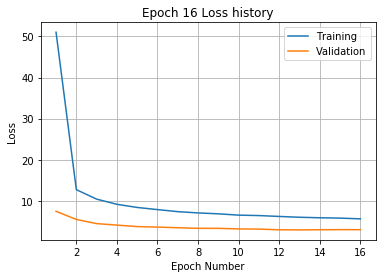

Training
Iteration 0: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.51 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.29 and relative error of 0.33
Iteration 160: with minibatch training loss = 3.71 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.25 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.57 and relative error of 0.26
Epoch 17, Overall loss = 5.57, relative error = 0.27, and proce

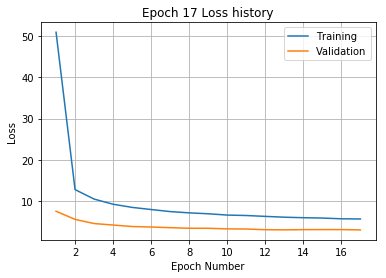

Training
Iteration 0: with minibatch training loss = 3.69 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.92 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.21 and relative error of 0.23
Iteration 120: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.46 and relative error of 0.21
Iteration 180: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.8 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.25 and relative error of 0.26
Epoch 18, Overall loss = 5.43, relative error = 0.266, and proc

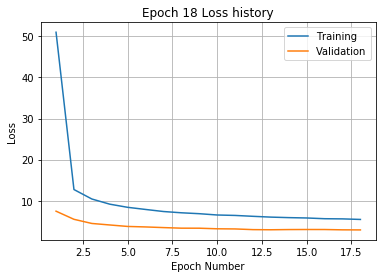

Training
Iteration 0: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.33 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.15 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 180: with minibatch training loss = 3.81 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.24 and relative error of 0.27
Epoch 19, Overall loss = 5.36, relative error = 0.265, and proces

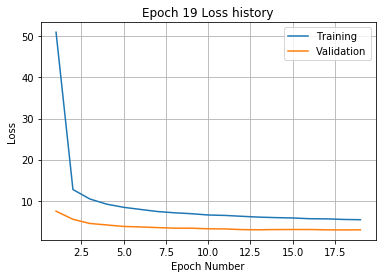

Training
Iteration 0: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 40: with minibatch training loss = 3.53 and relative error of 0.21
Iteration 60: with minibatch training loss = 4.65 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.74 and relative error of 0.22
Iteration 120: with minibatch training loss = 4.7 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.13 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.73 and relative error of 0.26
Iteration 200: with minibatch training loss = 3.59 and relative error of 0.21
Iteration 220: with minibatch training loss = 5.67 and relative error of 0.27
Epoch 20, Overall loss = 5.25, relative error = 0.262, and pro

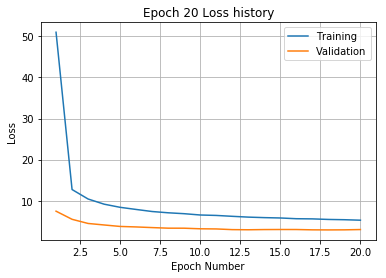

Training
Iteration 0: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.14 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.22 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 100: with minibatch training loss = 3.54 and relative error of 0.21
Iteration 120: with minibatch training loss = 5.41 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 160: with minibatch training loss = 7.38 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.48 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.51 and relative error of 0.24
Epoch 21, Overall loss = 5.2, relative error = 0.261, and pro

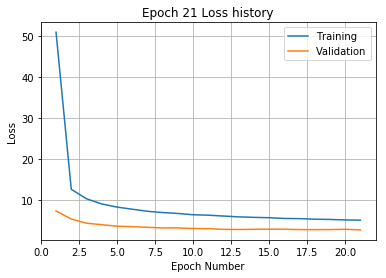

Training
Iteration 0: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 40: with minibatch training loss = 3.8 and relative error of 0.22
Iteration 60: with minibatch training loss = 6.02 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.51 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 180: with minibatch training loss = 3.73 and relative error of 0.22
Iteration 200: with minibatch training loss = 5.88 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.86 and relative error of 0.26
Epoch 22, Overall loss = 5.05, relative error = 0.257, and pro

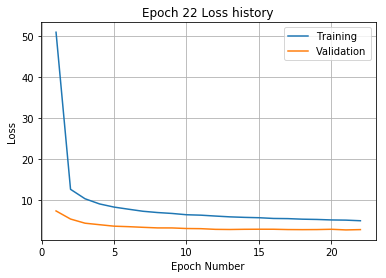

Training
Iteration 0: with minibatch training loss = 4.02 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.59 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.71 and relative error of 0.22
Iteration 80: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.21 and relative error of 0.24
Epoch 23, Overall loss = 5.02, relative error = 0.256, and pro

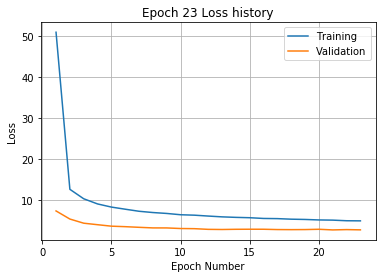

Training
Iteration 0: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.41 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 160: with minibatch training loss = 8.16 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.73 and relative error of 0.27
Epoch 24, Overall loss = 4.94, relative error = 0.254, and pro

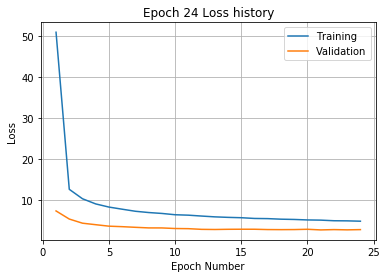

Training
Iteration 0: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 20: with minibatch training loss = 8.08 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.37 and relative error of 0.23
Iteration 60: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 80: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 100: with minibatch training loss = 3.35 and relative error of 0.22
Iteration 120: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.79 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.74 and relative error of 0.28
Epoch 25, Overall loss = 4.82, relative error = 0.251, and proc

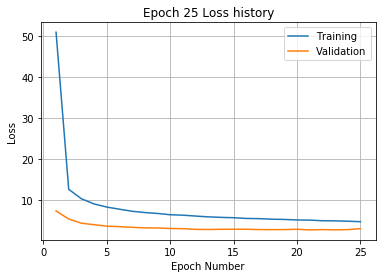

Training
Iteration 0: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 40: with minibatch training loss = 3.15 and relative error of 0.2
Iteration 60: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 100: with minibatch training loss = 3.83 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 140: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 160: with minibatch training loss = 3.26 and relative error of 0.2
Iteration 180: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 200: with minibatch training loss = 3.81 and relative error of 0.23
Iteration 220: with minibatch training loss = 3.56 and relative error of 0.21
Epoch 26, Overall loss = 4.77, relative error = 0.25, and process

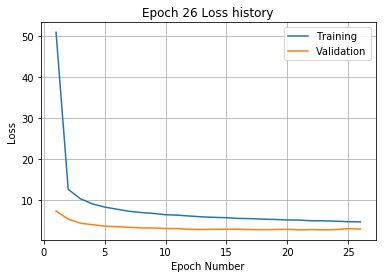

Validation error has stopped improving! Training on repetition 8 stopped!
Training
Iteration 0: with minibatch training loss = 238 and relative error of 1.8
Iteration 20: with minibatch training loss = 104 and relative error of 1.2
Iteration 40: with minibatch training loss = 68.6 and relative error of 0.95
Iteration 60: with minibatch training loss = 52.6 and relative error of 0.85
Iteration 80: with minibatch training loss = 34.8 and relative error of 0.69
Iteration 100: with minibatch training loss = 28.6 and relative error of 0.62
Iteration 120: with minibatch training loss = 19.1 and relative error of 0.51
Iteration 140: with minibatch training loss = 16.1 and relative error of 0.47
Iteration 160: with minibatch training loss = 14.4 and relative error of 0.45
Iteration 180: with minibatch training loss = 15.3 and relative error of 0.44
Iteration 200: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 220: with minibatch training loss = 13 and relative error o

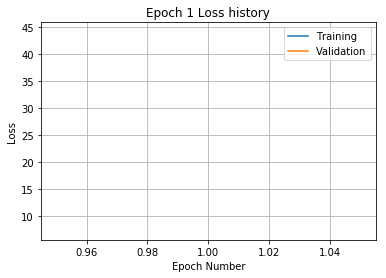

Training
Iteration 0: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 20: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 40: with minibatch training loss = 12.7 and relative error of 0.4
Iteration 60: with minibatch training loss = 12 and relative error of 0.39
Iteration 80: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 100: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 120: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 140: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 160: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 180: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 200: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 220: with minibatch training loss = 13.1 and relative error of 0.43
Epoch 2, Overall loss = 11.6, relative error = 0.39, and process t

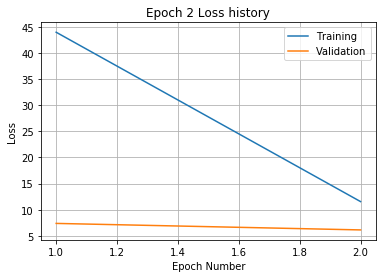

Training
Iteration 0: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 20: with minibatch training loss = 8.58 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.66 and relative error of 0.33
Iteration 60: with minibatch training loss = 9.57 and relative error of 0.36
Iteration 80: with minibatch training loss = 9.34 and relative error of 0.34
Iteration 100: with minibatch training loss = 9.11 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 140: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 160: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.61 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.39 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.1 and relative error of 0.33
Epoch 3, Overall loss = 9.52, relative error = 0.354, and proc

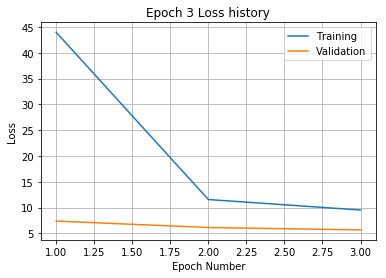

Training
Iteration 0: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 20: with minibatch training loss = 9.01 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.57 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.74 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.39 and relative error of 0.3
Iteration 100: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 120: with minibatch training loss = 7.09 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.28 and relative error of 0.32
Iteration 160: with minibatch training loss = 9.49 and relative error of 0.34
Iteration 180: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 200: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 220: with minibatch training loss = 8.52 and relative error of 0.35
Epoch 4, Overall loss = 8.49, relative error = 0.334, and proc

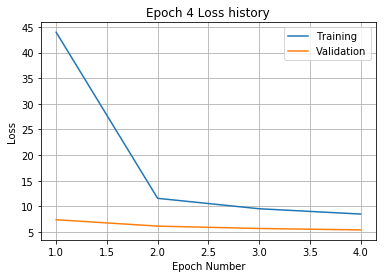

Training
Iteration 0: with minibatch training loss = 8.09 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 40: with minibatch training loss = 10.2 and relative error of 0.35
Iteration 60: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.77 and relative error of 0.35
Iteration 100: with minibatch training loss = 5.22 and relative error of 0.28
Iteration 120: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 140: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 160: with minibatch training loss = 8.24 and relative error of 0.34
Iteration 180: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.51 and relative error of 0.31
Epoch 5, Overall loss = 7.74, relative error = 0.319, and proc

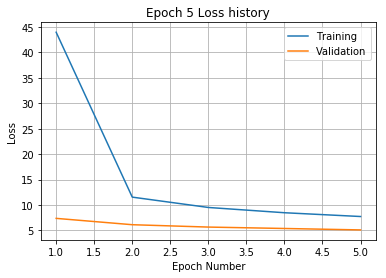

Training
Iteration 0: with minibatch training loss = 9.98 and relative error of 0.36
Iteration 20: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.28
Iteration 80: with minibatch training loss = 8.14 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.25 and relative error of 0.28
Epoch 6, Overall loss = 7.16, relative error = 0.306, and process 

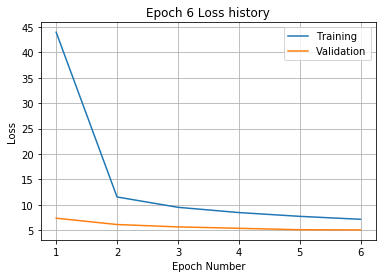

Training
Iteration 0: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.53 and relative error of 0.25
Iteration 180: with minibatch training loss = 8.96 and relative error of 0.33
Iteration 200: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.6 and relative error of 0.28
Epoch 7, Overall loss = 6.8, relative error = 0.299, and proces

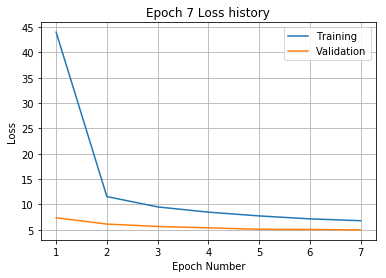

Training
Iteration 0: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.87 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.98 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.93 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.37 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.36 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.2 and relative error of 0.29
Epoch 8, Overall loss = 6.5, relative error = 0.292, and proces

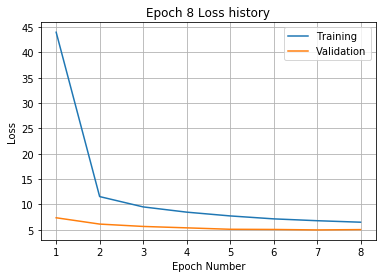

Training
Iteration 0: with minibatch training loss = 9.43 and relative error of 0.36
Iteration 20: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.45 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.07 and relative error of 0.34
Iteration 80: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.25 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.32 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.76 and relative error of 0.3
Epoch 9, Overall loss = 6.24, relative error = 0.286, and proce

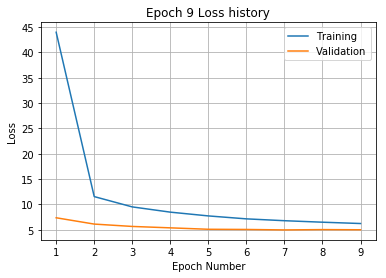

Training
Iteration 0: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.07 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 140: with minibatch training loss = 5 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 180: with minibatch training loss = 9.41 and relative error of 0.34
Iteration 200: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.63 and relative error of 0.26
Epoch 10, Overall loss = 6.13, relative error = 0.283, and proces

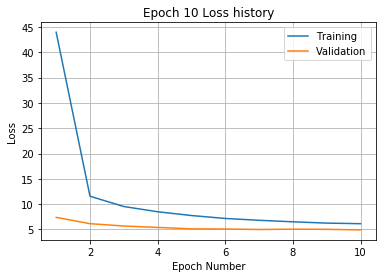

Training
Iteration 0: with minibatch training loss = 7.26 and relative error of 0.32
Iteration 20: with minibatch training loss = 3.78 and relative error of 0.22
Iteration 40: with minibatch training loss = 6.92 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.04 and relative error of 0.22
Iteration 140: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.75 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 200: with minibatch training loss = 7.44 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.25 and relative error of 0.24
Epoch 11, Overall loss = 5.91, relative error = 0.278, and proc

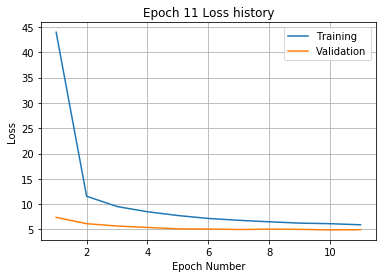

Training
Iteration 0: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.09 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.39 and relative error of 0.28
Epoch 12, Overall loss = 5.78, relative error = 0.275, and pr

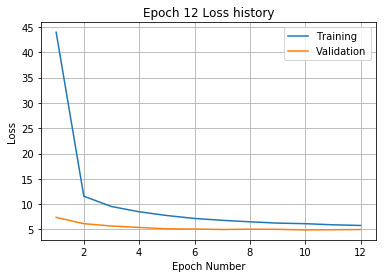

Training
Iteration 0: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.74 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.01 and relative error of 0.23
Iteration 160: with minibatch training loss = 3.64 and relative error of 0.22
Iteration 180: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.77 and relative error of 0.3
Epoch 13, Overall loss = 5.59, relative error = 0.27, and proce

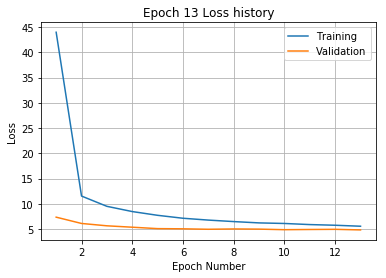

Training
Iteration 0: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.07 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.95 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.07 and relative error of 0.23
Epoch 14, Overall loss = 5.5, relative error = 0.268, and proce

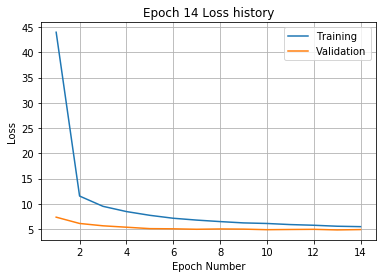

Training
Iteration 0: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.23 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.45 and relative error of 0.28
Iteration 140: with minibatch training loss = 3.92 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 180: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.1 and relative error of 0.24
Epoch 15, Overall loss = 5.34, relative error = 0.264, and proc

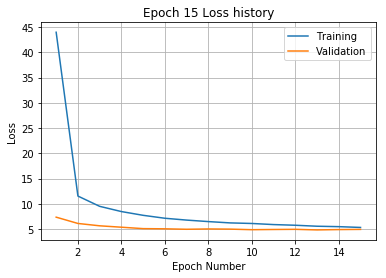

Training
Iteration 0: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 20: with minibatch training loss = 8.76 and relative error of 0.34
Iteration 40: with minibatch training loss = 4.3 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.54 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.16 and relative error of 0.32
Epoch 16, Overall loss = 5.29, relative error = 0.263, and proc

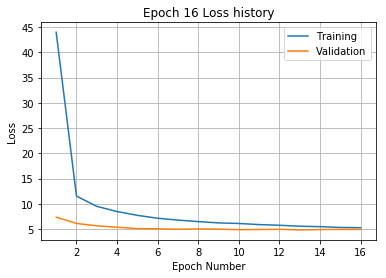

Training
Iteration 0: with minibatch training loss = 6 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 120: with minibatch training loss = 3.98 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.18 and relative error of 0.25
Iteration 220: with minibatch training loss = 7.36 and relative error of 0.3
Epoch 17, Overall loss = 5.17, relative error = 0.26, and process 

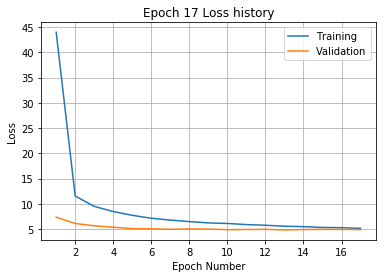

Training
Iteration 0: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.16 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 120: with minibatch training loss = 3.75 and relative error of 0.22
Iteration 140: with minibatch training loss = 3.3 and relative error of 0.21
Iteration 160: with minibatch training loss = 4.46 and relative error of 0.25
Iteration 180: with minibatch training loss = 3.45 and relative error of 0.21
Iteration 200: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.1 and relative error of 0.25
Epoch 18, Overall loss = 5.07, relative error = 0.257, and proces

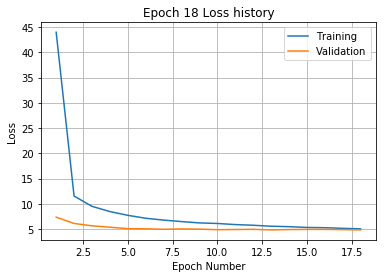

Validation error has stopped improving! Training on repetition 9 stopped!
Training
Iteration 0: with minibatch training loss = 141 and relative error of 1.4
Iteration 20: with minibatch training loss = 93.8 and relative error of 1.1
Iteration 40: with minibatch training loss = 64.1 and relative error of 0.95
Iteration 60: with minibatch training loss = 47.5 and relative error of 0.79
Iteration 80: with minibatch training loss = 38.7 and relative error of 0.7
Iteration 100: with minibatch training loss = 22 and relative error of 0.55
Iteration 120: with minibatch training loss = 20.7 and relative error of 0.51
Iteration 140: with minibatch training loss = 22.2 and relative error of 0.54
Iteration 160: with minibatch training loss = 15.8 and relative error of 0.46
Iteration 180: with minibatch training loss = 18.4 and relative error of 0.49
Iteration 200: with minibatch training loss = 14.7 and relative error of 0.46
Iteration 220: with minibatch training loss = 14.9 and relative error o

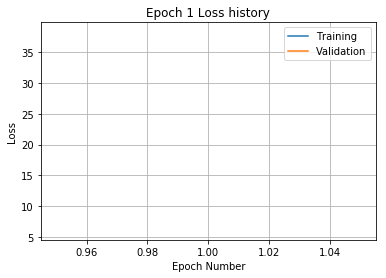

Training
Iteration 0: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 20: with minibatch training loss = 14.2 and relative error of 0.45
Iteration 40: with minibatch training loss = 14.5 and relative error of 0.45
Iteration 60: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 80: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 100: with minibatch training loss = 15.1 and relative error of 0.45
Iteration 120: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 140: with minibatch training loss = 9.89 and relative error of 0.36
Iteration 160: with minibatch training loss = 15.3 and relative error of 0.44
Iteration 180: with minibatch training loss = 9.61 and relative error of 0.35
Iteration 200: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 220: with minibatch training loss = 9.51 and relative error of 0.36
Epoch 2, Overall loss = 11.4, relative error = 0.385, and proc

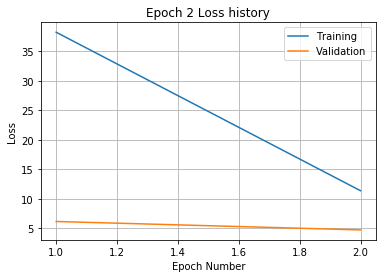

Training
Iteration 0: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 20: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 40: with minibatch training loss = 9.43 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.82 and relative error of 0.35
Iteration 80: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 100: with minibatch training loss = 8.81 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.91 and relative error of 0.34
Iteration 140: with minibatch training loss = 9.54 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.39 and relative error of 0.34
Iteration 180: with minibatch training loss = 8.56 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.88 and relative error of 0.36
Iteration 220: with minibatch training loss = 6.4 and relative error of 0.28
Epoch 3, Overall loss = 9.4, relative error = 0.35, and process

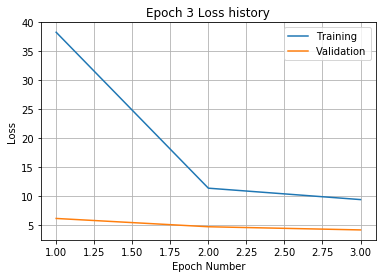

Training
Iteration 0: with minibatch training loss = 8.17 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.77 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.06 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.82 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.93 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 140: with minibatch training loss = 11.2 and relative error of 0.4
Iteration 160: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 180: with minibatch training loss = 9.83 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.21 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.61 and relative error of 0.34
Epoch 4, Overall loss = 8.35, relative error = 0.33, and proces

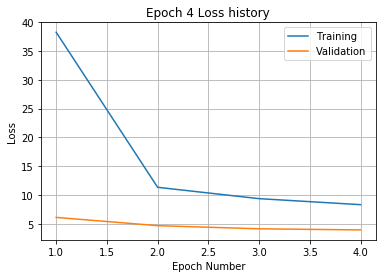

Training
Iteration 0: with minibatch training loss = 9.23 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 40: with minibatch training loss = 8.4 and relative error of 0.35
Iteration 60: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.42 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.35 and relative error of 0.33
Iteration 120: with minibatch training loss = 9.1 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.52 and relative error of 0.34
Iteration 160: with minibatch training loss = 7.71 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.4 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.88 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.04 and relative error of 0.27
Epoch 5, Overall loss = 7.57, relative error = 0.314, and process

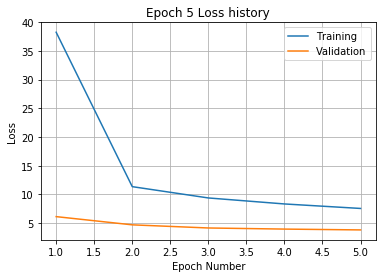

Training
Iteration 0: with minibatch training loss = 7.22 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 80: with minibatch training loss = 8.99 and relative error of 0.35
Iteration 100: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 160: with minibatch training loss = 8.5 and relative error of 0.34
Iteration 180: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 200: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 220: with minibatch training loss = 6.21 and relative error of 0.28
Epoch 6, Overall loss = 7.17, relative error = 0.306, and proc

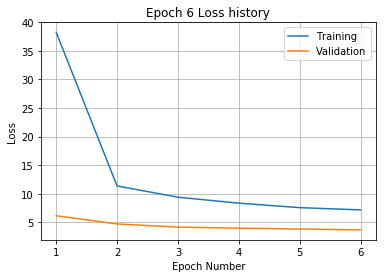

Training
Iteration 0: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 20: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.57 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.04 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.28 and relative error of 0.35
Iteration 200: with minibatch training loss = 6.73 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.02 and relative error of 0.3
Epoch 7, Overall loss = 6.85, relative error = 0.299, and proce

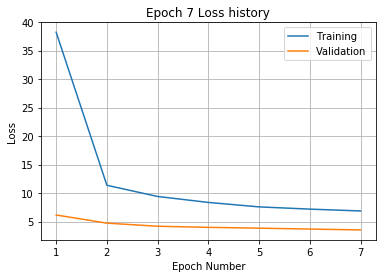

Training
Iteration 0: with minibatch training loss = 6.92 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.57 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 160: with minibatch training loss = 8.15 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.57 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.93 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.47 and relative error of 0.3
Epoch 8, Overall loss = 6.49, relative error = 0.291, and proce

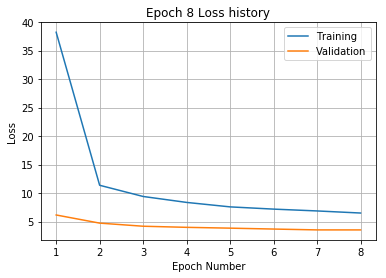

Training
Iteration 0: with minibatch training loss = 8.02 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.7 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.62 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.06 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.31 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.63 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.31 and relative error of 0.33
Iteration 220: with minibatch training loss = 5.87 and relative error of 0.28
Epoch 9, Overall loss = 6.34, relative error = 0.287, and proc

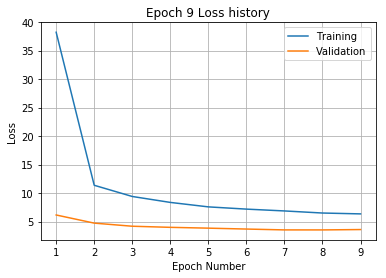

Training
Iteration 0: with minibatch training loss = 4.28 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 40: with minibatch training loss = 3.92 and relative error of 0.22
Iteration 60: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.75 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.92 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.32 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.48 and relative error of 0.29
Epoch 10, Overall loss = 6.19, relative error = 0.284, and proces

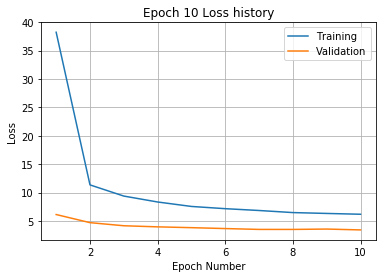

Training
Iteration 0: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.48 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.79 and relative error of 0.23
Iteration 120: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.94 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 220: with minibatch training loss = 8.8 and relative error of 0.34
Epoch 11, Overall loss = 6.04, relative error = 0.28, and process 

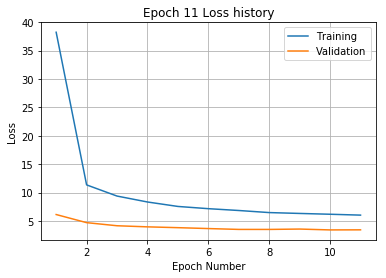

Training
Iteration 0: with minibatch training loss = 3.96 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.65 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 180: with minibatch training loss = 8.62 and relative error of 0.35
Iteration 200: with minibatch training loss = 5.69 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.78 and relative error of 0.29
Epoch 12, Overall loss = 5.86, relative error = 0.276, and pro

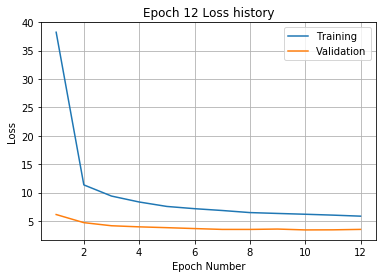

Training
Iteration 0: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.02 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.85 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.78 and relative error of 0.29
Epoch 13, Overall loss = 5.75, relative error = 0.273, and pro

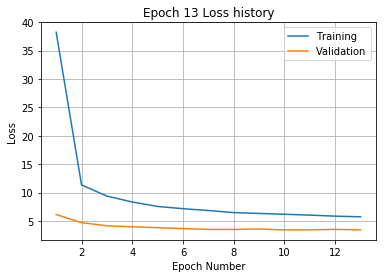

Training
Iteration 0: with minibatch training loss = 4.79 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.64 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.55 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.72 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.87 and relative error of 0.36
Iteration 140: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.8 and relative error of 0.28
Epoch 14, Overall loss = 5.6, relative error = 0.27, and proces

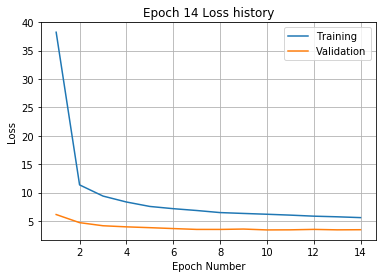

Training
Iteration 0: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 20: with minibatch training loss = 3.99 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.6 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 180: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.99 and relative error of 0.23
Epoch 15, Overall loss = 5.48, relative error = 0.267, and pro

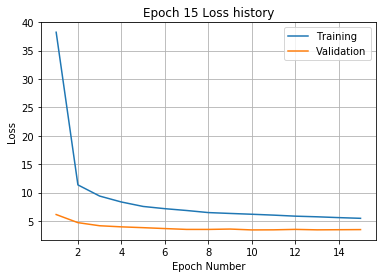

Validation error has stopped improving! Training on repetition 10 stopped!
log interval:  40 seconds
loading data
stacking image log's channels
Training
Iteration 0: with minibatch training loss = 277 and relative error of 1.8
Iteration 20: with minibatch training loss = 130 and relative error of 1.4
Iteration 40: with minibatch training loss = 79.3 and relative error of 1
Iteration 60: with minibatch training loss = 65.7 and relative error of 0.92
Iteration 80: with minibatch training loss = 53.7 and relative error of 0.81
Iteration 100: with minibatch training loss = 41.4 and relative error of 0.74
Iteration 120: with minibatch training loss = 34.5 and relative error of 0.66
Iteration 140: with minibatch training loss = 28.9 and relative error of 0.61
Iteration 160: with minibatch training loss = 20.1 and relative error of 0.52
Iteration 180: with minibatch training loss = 16.2 and relative error of 0.47
Iteration 200: with minibatch training loss = 16.2 and relative error of 0.47
It

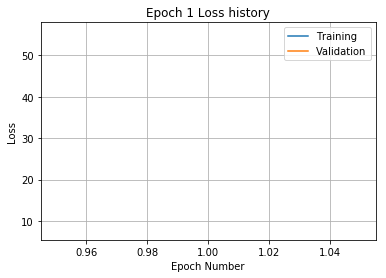

Training
Iteration 0: with minibatch training loss = 14.8 and relative error of 0.45
Iteration 20: with minibatch training loss = 14.8 and relative error of 0.43
Iteration 40: with minibatch training loss = 14.9 and relative error of 0.45
Iteration 60: with minibatch training loss = 15.5 and relative error of 0.45
Iteration 80: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 100: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 120: with minibatch training loss = 11.8 and relative error of 0.4
Iteration 140: with minibatch training loss = 13.5 and relative error of 0.44
Iteration 160: with minibatch training loss = 12.6 and relative error of 0.41
Iteration 180: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 200: with minibatch training loss = 9.78 and relative error of 0.35
Iteration 220: with minibatch training loss = 13.7 and relative error of 0.45
Epoch 2, Overall loss = 13.3, relative error = 0.419, and proc

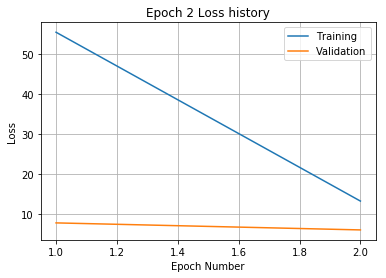

Training
Iteration 0: with minibatch training loss = 13.7 and relative error of 0.42
Iteration 20: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 40: with minibatch training loss = 9.62 and relative error of 0.36
Iteration 60: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 80: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 100: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 120: with minibatch training loss = 12 and relative error of 0.39
Iteration 140: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 160: with minibatch training loss = 9.04 and relative error of 0.36
Iteration 180: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 200: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 220: with minibatch training loss = 16.1 and relative error of 0.45
Epoch 3, Overall loss = 10.6, relative error = 0.375, and process

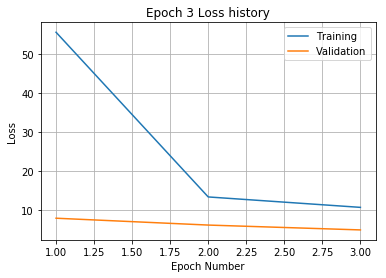

Training
Iteration 0: with minibatch training loss = 8.97 and relative error of 0.36
Iteration 20: with minibatch training loss = 9.98 and relative error of 0.35
Iteration 40: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 60: with minibatch training loss = 7.65 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.55 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.4 and relative error of 0.32
Iteration 120: with minibatch training loss = 9.19 and relative error of 0.35
Iteration 140: with minibatch training loss = 9.6 and relative error of 0.35
Iteration 160: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 180: with minibatch training loss = 8.98 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.94 and relative error of 0.34
Iteration 220: with minibatch training loss = 15.1 and relative error of 0.44
Epoch 4, Overall loss = 9.37, relative error = 0.351, and proce

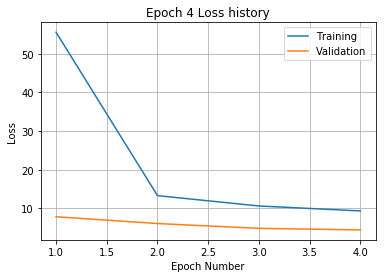

Training
Iteration 0: with minibatch training loss = 9.27 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.71 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 60: with minibatch training loss = 11.9 and relative error of 0.39
Iteration 80: with minibatch training loss = 8.89 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 140: with minibatch training loss = 9.06 and relative error of 0.35
Iteration 160: with minibatch training loss = 9.36 and relative error of 0.35
Iteration 180: with minibatch training loss = 7.75 and relative error of 0.33
Iteration 200: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 220: with minibatch training loss = 7.84 and relative error of 0.31
Epoch 5, Overall loss = 8.54, relative error = 0.335, and pro

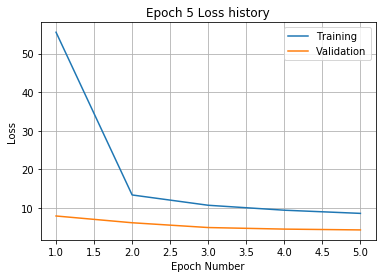

Training
Iteration 0: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 20: with minibatch training loss = 9.83 and relative error of 0.36
Iteration 40: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.4 and relative error of 0.35
Iteration 80: with minibatch training loss = 6.36 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.85 and relative error of 0.32
Iteration 140: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 160: with minibatch training loss = 11.9 and relative error of 0.39
Iteration 180: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.64 and relative error of 0.31
Epoch 6, Overall loss = 7.88, relative error = 0.322, and process

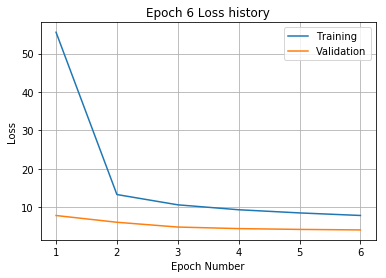

Training
Iteration 0: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 60: with minibatch training loss = 8.76 and relative error of 0.36
Iteration 80: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.19 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.03 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.12 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.13 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.13 and relative error of 0.3
Epoch 7, Overall loss = 7.45, relative error = 0.313, and proces

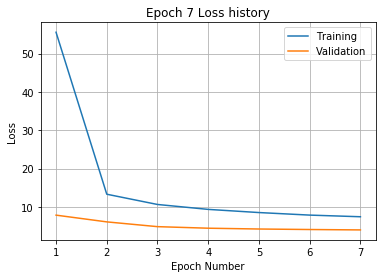

Training
Iteration 0: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.09 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.07 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.59 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.36 and relative error of 0.3
Epoch 8, Overall loss = 7.03, relative error = 0.304, and proces

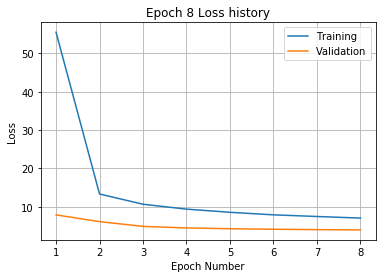

Training
Iteration 0: with minibatch training loss = 8.11 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.21 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.25 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.63 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.5 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.92 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.99 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.84 and relative error of 0.26
Epoch 9, Overall loss = 6.68, relative error = 0.296, and proce

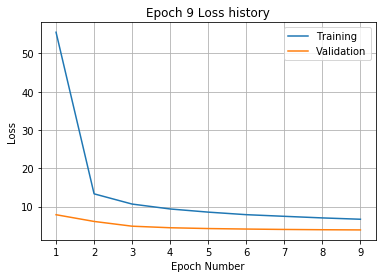

Training
Iteration 0: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 20: with minibatch training loss = 9.12 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.61 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.22 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.5 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.12 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.35 and relative error of 0.31
Epoch 10, Overall loss = 6.49, relative error = 0.292, and proces

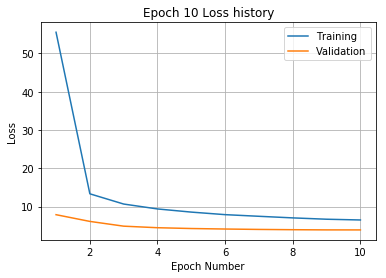

Training
Iteration 0: with minibatch training loss = 5.03 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.49 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.52 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.59 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.3 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.63 and relative error of 0.32
Epoch 11, Overall loss = 6.31, relative error = 0.288, and proces

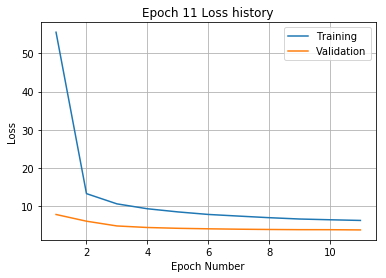

Training
Iteration 0: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.98 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.47 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.7 and relative error of 0.29
Epoch 12, Overall loss = 6.09, relative error = 0.283, and proce

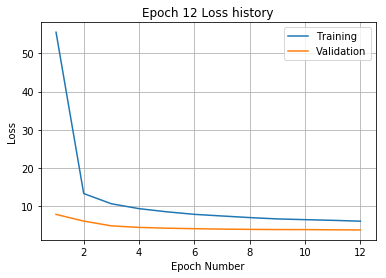

Training
Iteration 0: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.34 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.52 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.46 and relative error of 0.34
Iteration 140: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.7 and relative error of 0.24
Epoch 13, Overall loss = 5.94, relative error = 0.279, and proce

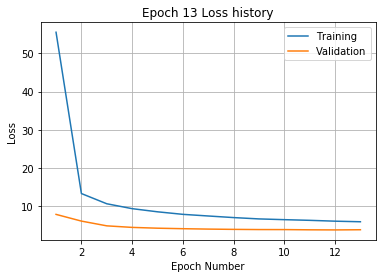

Training
Iteration 0: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 40: with minibatch training loss = 6 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.4 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.07 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.78 and relative error of 0.31
Iteration 220: with minibatch training loss = 4.96 and relative error of 0.26
Epoch 14, Overall loss = 5.74, relative error = 0.274, and process 

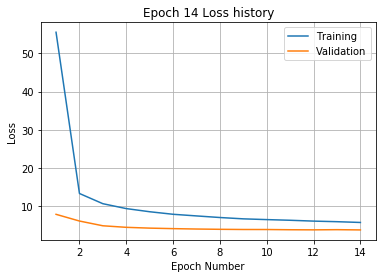

Training
Iteration 0: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.57 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 140: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.76 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.59 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.2 and relative error of 0.32
Epoch 15, Overall loss = 5.67, relative error = 0.273, and proce

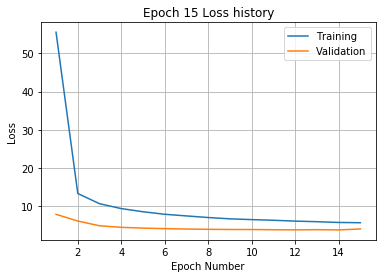

Training
Iteration 0: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.64 and relative error of 0.22
Iteration 100: with minibatch training loss = 3.94 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.91 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.2 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.65 and relative error of 0.3
Epoch 16, Overall loss = 5.55, relative error = 0.27, and proces

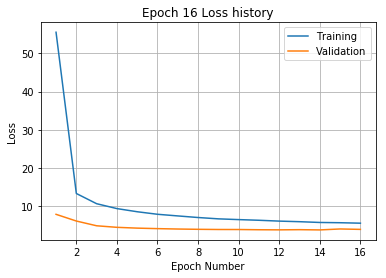

Training
Iteration 0: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.29 and relative error of 0.27
Iteration 60: with minibatch training loss = 3.81 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.08 and relative error of 0.24
Iteration 100: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.97 and relative error of 0.24
Epoch 17, Overall loss = 5.43, relative error = 0.267, and pro

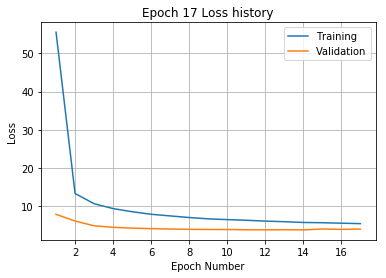

Training
Iteration 0: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 20: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 60: with minibatch training loss = 3.36 and relative error of 0.21
Iteration 80: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.12 and relative error of 0.28
Epoch 18, Overall loss = 5.34, relative error = 0.265, and pr

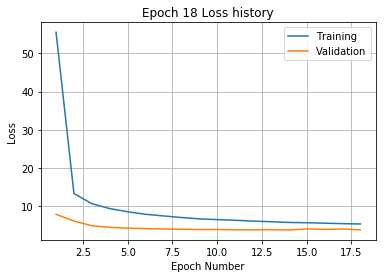

Training
Iteration 0: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 80: with minibatch training loss = 7.46 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.87 and relative error of 0.25
Iteration 120: with minibatch training loss = 3.99 and relative error of 0.23
Iteration 140: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.15 and relative error of 0.23
Iteration 200: with minibatch training loss = 3.72 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.91 and relative error of 0.28
Epoch 19, Overall loss = 5.21, relative error = 0.261, and proces

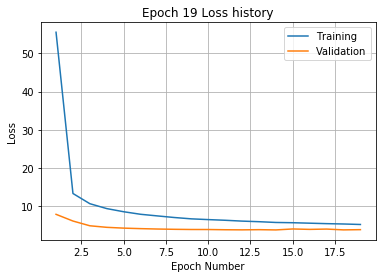

Validation error has stopped improving! Training on repetition 1 stopped!
Training
Iteration 0: with minibatch training loss = 272 and relative error of 1.8
Iteration 20: with minibatch training loss = 149 and relative error of 1.4
Iteration 40: with minibatch training loss = 88 and relative error of 1.1
Iteration 60: with minibatch training loss = 78.5 and relative error of 0.97
Iteration 80: with minibatch training loss = 58 and relative error of 0.86
Iteration 100: with minibatch training loss = 43 and relative error of 0.77
Iteration 120: with minibatch training loss = 30.7 and relative error of 0.62
Iteration 140: with minibatch training loss = 25.4 and relative error of 0.59
Iteration 160: with minibatch training loss = 20.7 and relative error of 0.53
Iteration 180: with minibatch training loss = 21.6 and relative error of 0.53
Iteration 200: with minibatch training loss = 17.8 and relative error of 0.49
Iteration 220: with minibatch training loss = 15.2 and relative error of 0.4

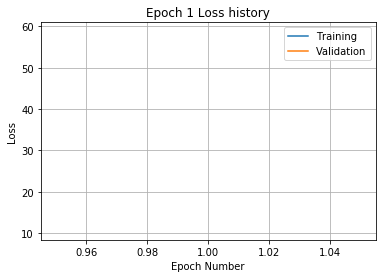

Training
Iteration 0: with minibatch training loss = 15.4 and relative error of 0.46
Iteration 20: with minibatch training loss = 15.6 and relative error of 0.48
Iteration 40: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 60: with minibatch training loss = 14.5 and relative error of 0.44
Iteration 80: with minibatch training loss = 13.8 and relative error of 0.43
Iteration 100: with minibatch training loss = 12 and relative error of 0.41
Iteration 120: with minibatch training loss = 12.2 and relative error of 0.41
Iteration 140: with minibatch training loss = 13 and relative error of 0.43
Iteration 160: with minibatch training loss = 9.49 and relative error of 0.35
Iteration 180: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 200: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 220: with minibatch training loss = 12.6 and relative error of 0.39
Epoch 2, Overall loss = 13.1, relative error = 0.414, and process 

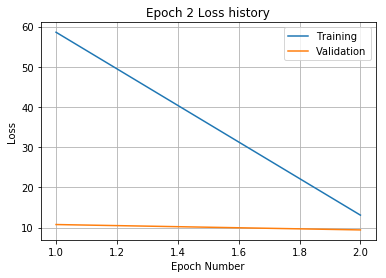

Training
Iteration 0: with minibatch training loss = 13 and relative error of 0.41
Iteration 20: with minibatch training loss = 12.1 and relative error of 0.39
Iteration 40: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 60: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.4
Iteration 100: with minibatch training loss = 9.48 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.62 and relative error of 0.37
Iteration 140: with minibatch training loss = 11.1 and relative error of 0.37
Iteration 160: with minibatch training loss = 9.67 and relative error of 0.36
Iteration 180: with minibatch training loss = 8.96 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.71 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.38 and relative error of 0.33
Epoch 3, Overall loss = 10.6, relative error = 0.371, and proces

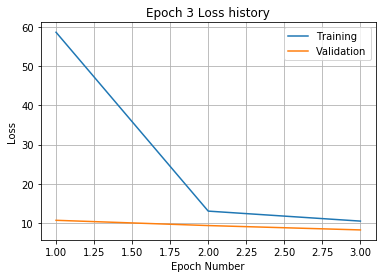

Training
Iteration 0: with minibatch training loss = 8.99 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.46 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 60: with minibatch training loss = 9.07 and relative error of 0.33
Iteration 80: with minibatch training loss = 9.01 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.92 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.76 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 160: with minibatch training loss = 8.74 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.9 and relative error of 0.36
Iteration 200: with minibatch training loss = 9.71 and relative error of 0.37
Iteration 220: with minibatch training loss = 9.38 and relative error of 0.35
Epoch 4, Overall loss = 9.22, relative error = 0.347, and proc

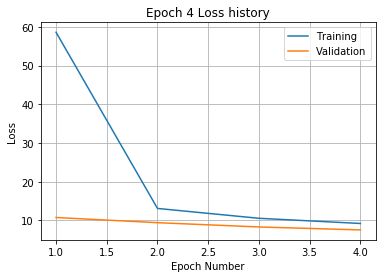

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 20: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.71 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.91 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.18 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.88 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.21 and relative error of 0.31
Iteration 160: with minibatch training loss = 9.03 and relative error of 0.34
Iteration 180: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.68 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.76 and relative error of 0.32
Epoch 5, Overall loss = 8.4, relative error = 0.331, and proc

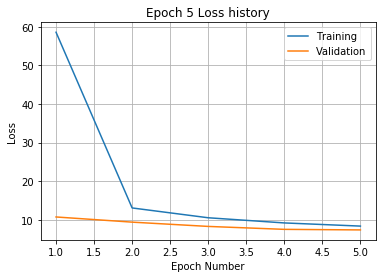

Training
Iteration 0: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.57 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.83 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.97 and relative error of 0.35
Iteration 120: with minibatch training loss = 9.28 and relative error of 0.35
Iteration 140: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.77 and relative error of 0.36
Iteration 180: with minibatch training loss = 7.77 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.59 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.6 and relative error of 0.29
Epoch 6, Overall loss = 7.8, relative error = 0.319, and proce

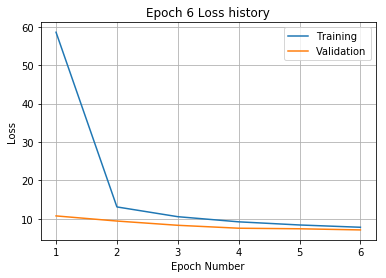

Training
Iteration 0: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.42 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.21 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.93 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 200: with minibatch training loss = 8 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.82 and relative error of 0.33
Epoch 7, Overall loss = 7.32, relative error = 0.309, and process

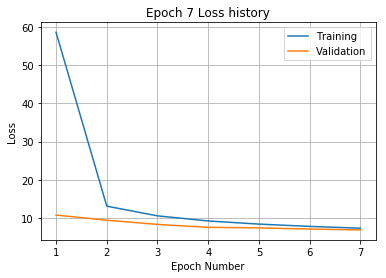

Training
Iteration 0: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.26 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.67 and relative error of 0.31
Iteration 160: with minibatch training loss = 9.49 and relative error of 0.37
Iteration 180: with minibatch training loss = 5.87 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.37 and relative error of 0.3
Epoch 8, Overall loss = 6.99, relative error = 0.302, and process

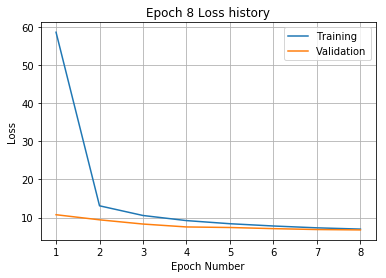

Training
Iteration 0: with minibatch training loss = 6.76 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.86 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 140: with minibatch training loss = 5 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.58 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.89 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.72 and relative error of 0.3
Epoch 9, Overall loss = 6.66, relative error = 0.295, and process ti

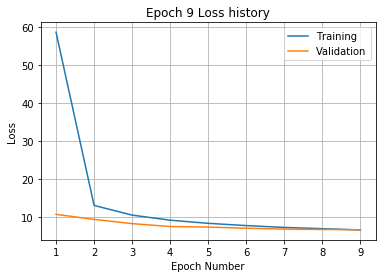

Training
Iteration 0: with minibatch training loss = 7.45 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.25 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.97 and relative error of 0.29
Iteration 120: with minibatch training loss = 9.26 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.44 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.4 and relative error of 0.29
Epoch 10, Overall loss = 6.36, relative error = 0.288, and proc

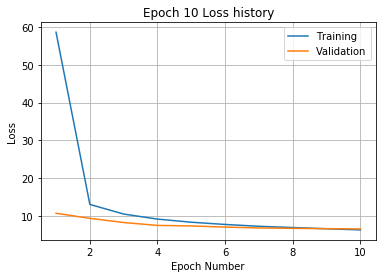

Training
Iteration 0: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.19 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 80: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 160: with minibatch training loss = 3.67 and relative error of 0.22
Iteration 180: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.75 and relative error of 0.26
Iteration 220: with minibatch training loss = 8.24 and relative error of 0.32
Epoch 11, Overall loss = 6.17, relative error = 0.283, and proces

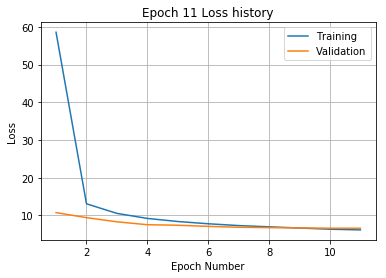

Training
Iteration 0: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 40: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.24 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 140: with minibatch training loss = 3.76 and relative error of 0.22
Iteration 160: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.3 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.1 and relative error of 0.28
Epoch 12, Overall loss = 5.95, relative error = 0.279, and process 

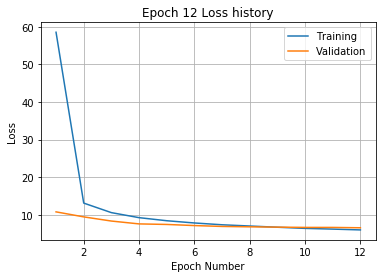

Training
Iteration 0: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.02 and relative error of 0.22
Iteration 60: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.31 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.79 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.15 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.54 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.57 and relative error of 0.27
Epoch 13, Overall loss = 5.9, relative error = 0.277, and pro

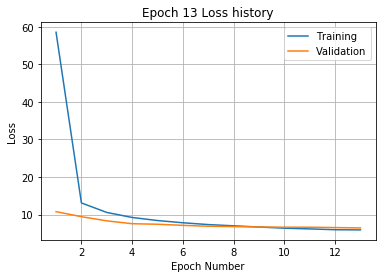

Training
Iteration 0: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.42 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.7 and relative error of 0.33
Iteration 120: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.06 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.39 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.17 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.52 and relative error of 0.23
Epoch 14, Overall loss = 5.73, relative error = 0.273, and proces

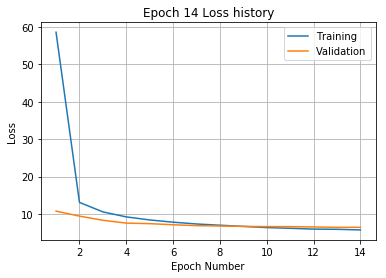

Training
Iteration 0: with minibatch training loss = 5.19 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.42 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.81 and relative error of 0.25
Epoch 15, Overall loss = 5.54, relative error = 0.269, and proc

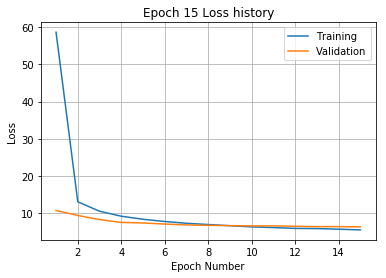

Training
Iteration 0: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.2 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.11 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 120: with minibatch training loss = 8.91 and relative error of 0.34
Iteration 140: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.33 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.13 and relative error of 0.22
Epoch 16, Overall loss = 5.45, relative error = 0.267, and pro

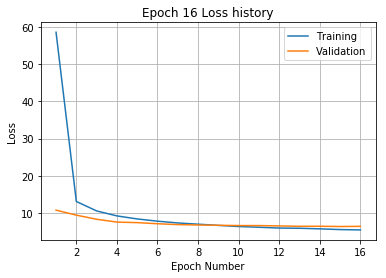

Training
Iteration 0: with minibatch training loss = 5 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.78 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.14 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.92 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.4 and relative error of 0.29
Epoch 17, Overall loss = 5.35, relative error = 0.264, and process 

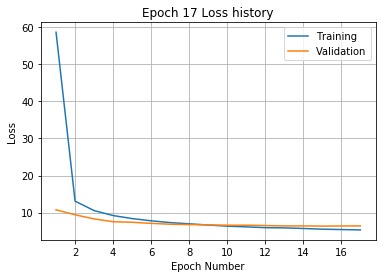

Training
Iteration 0: with minibatch training loss = 4.13 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.11 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 140: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.72 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.95 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.98 and relative error of 0.26
Epoch 18, Overall loss = 5.24, relative error = 0.261, and proce

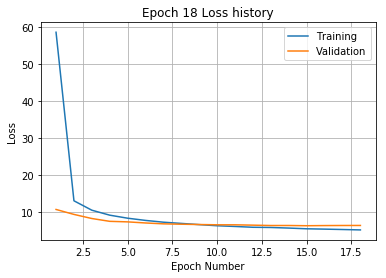

Training
Iteration 0: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.89 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.47 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 200: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.21 and relative error of 0.26
Epoch 19, Overall loss = 5.12, relative error = 0.258, and pr

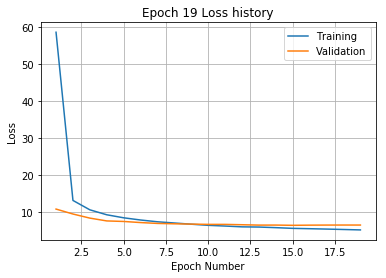

Training
Iteration 0: with minibatch training loss = 3.85 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.98 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.03 and relative error of 0.19
Iteration 100: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.37 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.7 and relative error of 0.25
Epoch 20, Overall loss = 4.98, relative error = 0.254, and pro

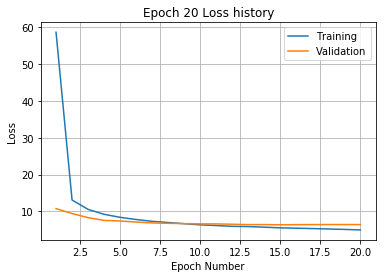

Validation error has stopped improving! Training on repetition 2 stopped!
Training
Iteration 0: with minibatch training loss = 306 and relative error of 2.1
Iteration 20: with minibatch training loss = 164 and relative error of 1.5
Iteration 40: with minibatch training loss = 96.3 and relative error of 1.1
Iteration 60: with minibatch training loss = 64.5 and relative error of 0.91
Iteration 80: with minibatch training loss = 54.7 and relative error of 0.85
Iteration 100: with minibatch training loss = 40.2 and relative error of 0.73
Iteration 120: with minibatch training loss = 33.7 and relative error of 0.67
Iteration 140: with minibatch training loss = 23.7 and relative error of 0.56
Iteration 160: with minibatch training loss = 22.7 and relative error of 0.56
Iteration 180: with minibatch training loss = 18.5 and relative error of 0.49
Iteration 200: with minibatch training loss = 18.8 and relative error of 0.5
Iteration 220: with minibatch training loss = 16 and relative error of 

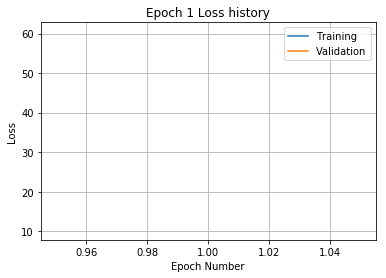

Training
Iteration 0: with minibatch training loss = 16 and relative error of 0.47
Iteration 20: with minibatch training loss = 16.4 and relative error of 0.47
Iteration 40: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 60: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 80: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 100: with minibatch training loss = 13.7 and relative error of 0.44
Iteration 120: with minibatch training loss = 15.4 and relative error of 0.46
Iteration 140: with minibatch training loss = 12.5 and relative error of 0.39
Iteration 160: with minibatch training loss = 13.4 and relative error of 0.41
Iteration 180: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 200: with minibatch training loss = 15.9 and relative error of 0.45
Iteration 220: with minibatch training loss = 12 and relative error of 0.4
Epoch 2, Overall loss = 13.7, relative error = 0.423, and process t

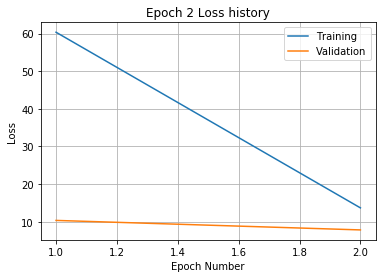

Training
Iteration 0: with minibatch training loss = 13.3 and relative error of 0.41
Iteration 20: with minibatch training loss = 13 and relative error of 0.41
Iteration 40: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 80: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 100: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 120: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 140: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 180: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 200: with minibatch training loss = 9.99 and relative error of 0.37
Iteration 220: with minibatch training loss = 8.81 and relative error of 0.34
Epoch 3, Overall loss = 10.8, relative error = 0.377, and proces

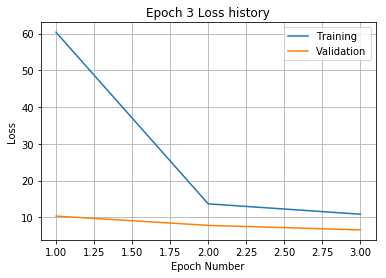

Training
Iteration 0: with minibatch training loss = 9.5 and relative error of 0.36
Iteration 20: with minibatch training loss = 8.11 and relative error of 0.32
Iteration 40: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 60: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 100: with minibatch training loss = 7.88 and relative error of 0.32
Iteration 120: with minibatch training loss = 9.9 and relative error of 0.35
Iteration 140: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.61 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 220: with minibatch training loss = 8.56 and relative error of 0.32
Epoch 4, Overall loss = 9.47, relative error = 0.352, and proces

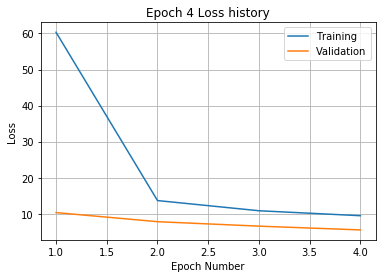

Training
Iteration 0: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 20: with minibatch training loss = 8.88 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.16 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.48 and relative error of 0.33
Iteration 80: with minibatch training loss = 9.64 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.81 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.54 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.09 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.01 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.7 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.35 and relative error of 0.3
Epoch 5, Overall loss = 8.57, relative error = 0.335, and proce

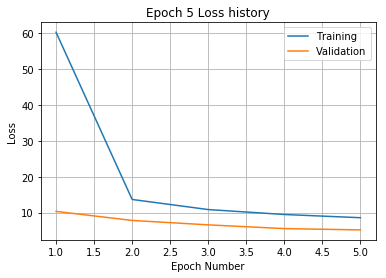

Training
Iteration 0: with minibatch training loss = 8.32 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 60: with minibatch training loss = 9.91 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.35 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.65 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.19 and relative error of 0.35
Iteration 180: with minibatch training loss = 8.12 and relative error of 0.35
Iteration 200: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 220: with minibatch training loss = 8.56 and relative error of 0.34
Epoch 6, Overall loss = 7.93, relative error = 0.322, and proces

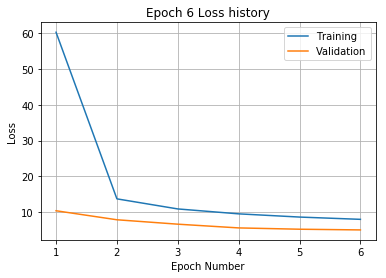

Training
Iteration 0: with minibatch training loss = 8.22 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 40: with minibatch training loss = 8.84 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.3 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.73 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.82 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.3 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.89 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.07 and relative error of 0.32
Epoch 7, Overall loss = 7.5, relative error = 0.313, and process 

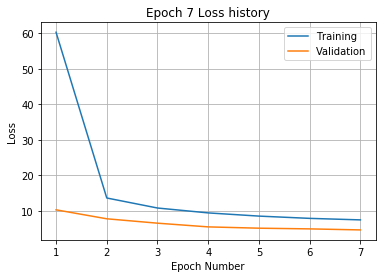

Training
Iteration 0: with minibatch training loss = 6.45 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.59 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 180: with minibatch training loss = 8.14 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.88 and relative error of 0.31
Epoch 8, Overall loss = 7.09, relative error = 0.305, and process 

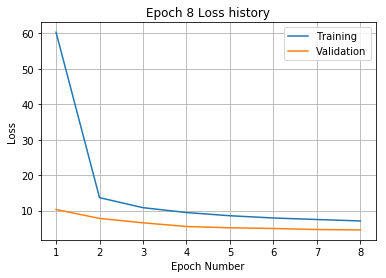

Training
Iteration 0: with minibatch training loss = 7.61 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.51 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.67 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.98 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.07 and relative error of 0.32
Epoch 9, Overall loss = 6.88, relative error = 0.3, and process

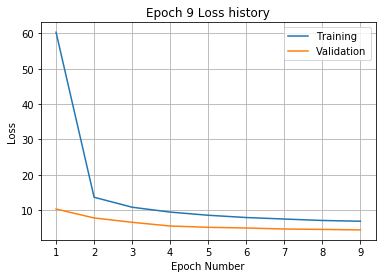

Training
Iteration 0: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.41 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.76 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.64 and relative error of 0.3
Epoch 10, Overall loss = 6.63, relative error = 0.294, and proces

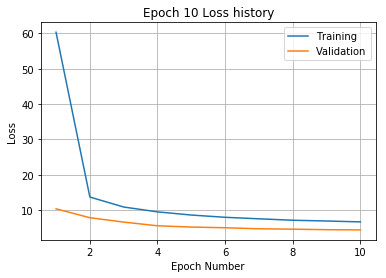

Training
Iteration 0: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.24 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.67 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.63 and relative error of 0.37
Iteration 180: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.73 and relative error of 0.29
Epoch 11, Overall loss = 6.39, relative error = 0.289, and proc

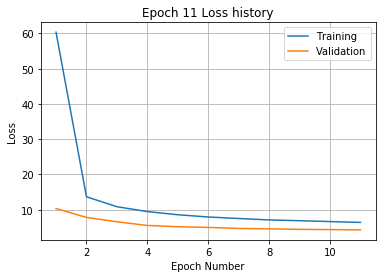

Training
Iteration 0: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.91 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 180: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.05 and relative error of 0.31
Epoch 12, Overall loss = 6.24, relative error = 0.285, and proc

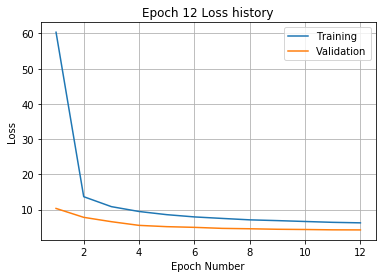

Training
Iteration 0: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.73 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.96 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.03 and relative error of 0.24
Iteration 220: with minibatch training loss = 7.87 and relative error of 0.3
Epoch 13, Overall loss = 5.98, relative error = 0.279, and proces

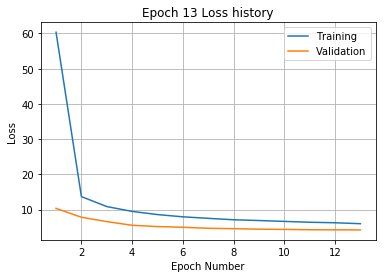

Training
Iteration 0: with minibatch training loss = 6.85 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.98 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.07 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.61 and relative error of 0.24
Epoch 14, Overall loss = 5.84, relative error = 0.276, and proce

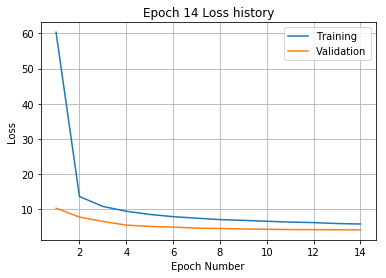

Training
Iteration 0: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.4 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 80: with minibatch training loss = 7.28 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 160: with minibatch training loss = 3.58 and relative error of 0.22
Iteration 180: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 200: with minibatch training loss = 8.42 and relative error of 0.34
Iteration 220: with minibatch training loss = 4.92 and relative error of 0.26
Epoch 15, Overall loss = 5.76, relative error = 0.274, and proc

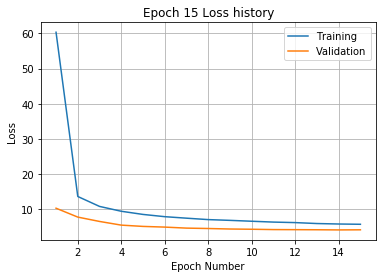

Training
Iteration 0: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.52 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.33 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 160: with minibatch training loss = 6 and relative error of 0.29
Iteration 180: with minibatch training loss = 3.71 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.5 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.39 and relative error of 0.26
Epoch 16, Overall loss = 5.61, relative error = 0.271, and proces

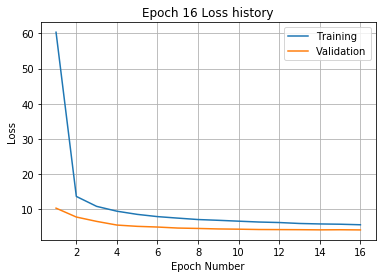

Training
Iteration 0: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.01 and relative error of 0.22
Iteration 120: with minibatch training loss = 7.82 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.15 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.5 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.38 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.51 and relative error of 0.31
Epoch 17, Overall loss = 5.49, relative error = 0.268, and pro

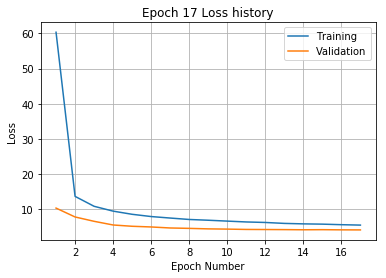

Training
Iteration 0: with minibatch training loss = 3.91 and relative error of 0.22
Iteration 20: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.24 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.3 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.43 and relative error of 0.3
Epoch 18, Overall loss = 5.45, relative error = 0.267, and proces

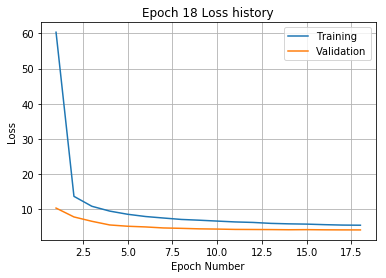

Training
Iteration 0: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.55 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.31 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.4 and relative error of 0.21
Iteration 180: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 200: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.31 and relative error of 0.28
Epoch 19, Overall loss = 5.3, relative error = 0.263, and proce

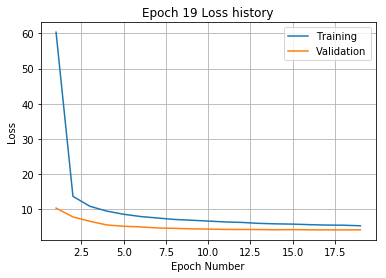

Training
Iteration 0: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 40: with minibatch training loss = 3.91 and relative error of 0.23
Iteration 60: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 160: with minibatch training loss = 3.78 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.69 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.1 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.83 and relative error of 0.26
Epoch 20, Overall loss = 5.22, relative error = 0.261, and proce

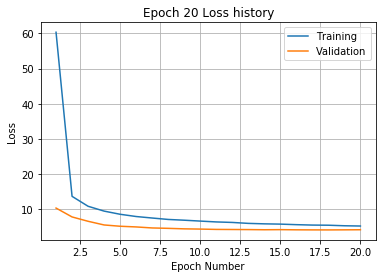

Training
Iteration 0: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 100: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.8 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.06 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.77 and relative error of 0.29
Epoch 21, Overall loss = 5.14, relative error = 0.259, and pro

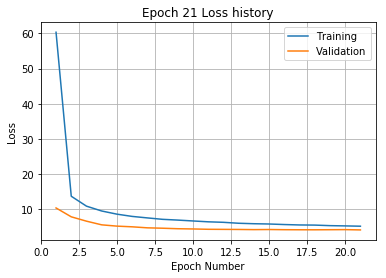

Training
Iteration 0: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.06 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.75 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.23 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.5 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.4 and relative error of 0.24
Epoch 22, Overall loss = 5.01, relative error = 0.256, and proc

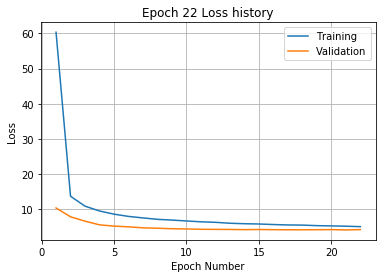

Training
Iteration 0: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.11 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.99 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.7 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.63 and relative error of 0.25
Epoch 23, Overall loss = 4.92, relative error = 0.253, and proce

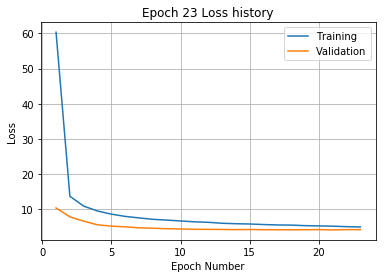

Training
Iteration 0: with minibatch training loss = 3.64 and relative error of 0.21
Iteration 20: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.3 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.24 and relative error of 0.21
Iteration 120: with minibatch training loss = 3.44 and relative error of 0.21
Iteration 140: with minibatch training loss = 4.57 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 200: with minibatch training loss = 3.34 and relative error of 0.21
Iteration 220: with minibatch training loss = 4.55 and relative error of 0.25
Epoch 24, Overall loss = 4.87, relative error = 0.252, and proc

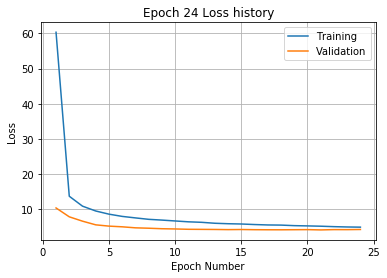

Training
Iteration 0: with minibatch training loss = 3.45 and relative error of 0.21
Iteration 20: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.4 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 120: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.02 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.96 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.16 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.92 and relative error of 0.27
Epoch 25, Overall loss = 4.83, relative error = 0.251, and proc

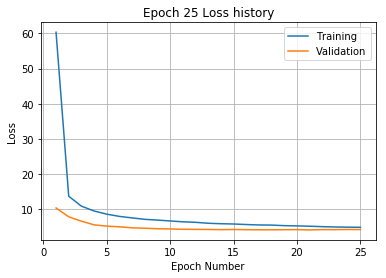

Training
Iteration 0: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 40: with minibatch training loss = 3.09 and relative error of 0.21
Iteration 60: with minibatch training loss = 5 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.82 and relative error of 0.22
Iteration 100: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 140: with minibatch training loss = 3.07 and relative error of 0.2
Iteration 160: with minibatch training loss = 3.34 and relative error of 0.21
Iteration 180: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.87 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.8 and relative error of 0.25
Epoch 26, Overall loss = 4.71, relative error = 0.248, and process 

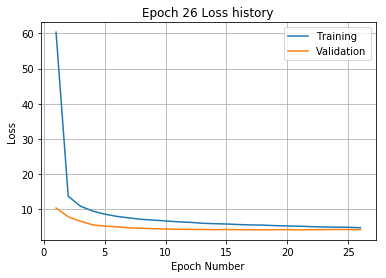

Validation error has stopped improving! Training on repetition 3 stopped!
Training
Iteration 0: with minibatch training loss = 170 and relative error of 1.5
Iteration 20: with minibatch training loss = 96.5 and relative error of 1.1
Iteration 40: with minibatch training loss = 67.4 and relative error of 0.93
Iteration 60: with minibatch training loss = 51.1 and relative error of 0.85
Iteration 80: with minibatch training loss = 35.5 and relative error of 0.7
Iteration 100: with minibatch training loss = 31.7 and relative error of 0.64
Iteration 120: with minibatch training loss = 23.9 and relative error of 0.57
Iteration 140: with minibatch training loss = 18.8 and relative error of 0.51
Iteration 160: with minibatch training loss = 14.8 and relative error of 0.44
Iteration 180: with minibatch training loss = 18.6 and relative error of 0.5
Iteration 200: with minibatch training loss = 12.9 and relative error of 0.42
Iteration 220: with minibatch training loss = 16.9 and relative error 

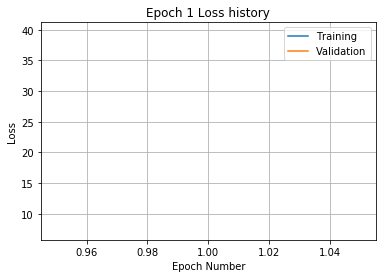

Training
Iteration 0: with minibatch training loss = 14.2 and relative error of 0.43
Iteration 20: with minibatch training loss = 11.8 and relative error of 0.41
Iteration 40: with minibatch training loss = 15.7 and relative error of 0.44
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 80: with minibatch training loss = 13.4 and relative error of 0.41
Iteration 100: with minibatch training loss = 11 and relative error of 0.39
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 140: with minibatch training loss = 13.1 and relative error of 0.43
Iteration 160: with minibatch training loss = 11.8 and relative error of 0.4
Iteration 180: with minibatch training loss = 13.4 and relative error of 0.4
Iteration 200: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 220: with minibatch training loss = 10.4 and relative error of 0.37
Epoch 2, Overall loss = 12.3, relative error = 0.404, and process

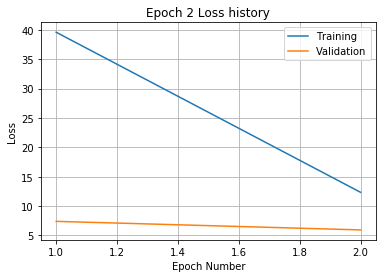

Training
Iteration 0: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 20: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 40: with minibatch training loss = 10.3 and relative error of 0.35
Iteration 60: with minibatch training loss = 9.86 and relative error of 0.37
Iteration 80: with minibatch training loss = 9.58 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.27 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.62 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.73 and relative error of 0.35
Iteration 160: with minibatch training loss = 7.91 and relative error of 0.34
Iteration 180: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 200: with minibatch training loss = 10 and relative error of 0.37
Iteration 220: with minibatch training loss = 14.2 and relative error of 0.43
Epoch 3, Overall loss = 9.86, relative error = 0.362, and proce

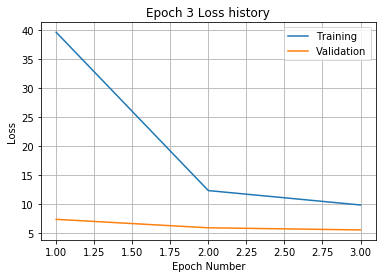

Training
Iteration 0: with minibatch training loss = 8.84 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.69 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.39 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.25 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 120: with minibatch training loss = 9.5 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.9 and relative error of 0.39
Iteration 160: with minibatch training loss = 8.16 and relative error of 0.34
Iteration 180: with minibatch training loss = 9.33 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.83 and relative error of 0.33
Epoch 4, Overall loss = 8.7, relative error = 0.339, and proce

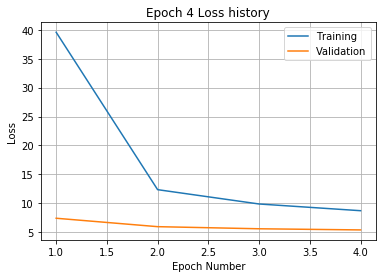

Training
Iteration 0: with minibatch training loss = 8.01 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.59 and relative error of 0.35
Iteration 60: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 80: with minibatch training loss = 8.07 and relative error of 0.34
Iteration 100: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.13 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 160: with minibatch training loss = 9.66 and relative error of 0.36
Iteration 180: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.87 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.28 and relative error of 0.32
Epoch 5, Overall loss = 7.81, relative error = 0.321, and proc

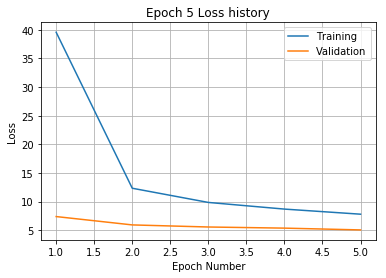

Training
Iteration 0: with minibatch training loss = 8 and relative error of 0.33
Iteration 20: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 60: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 80: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.35 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.89 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.12 and relative error of 0.29
Epoch 6, Overall loss = 7.37, relative error = 0.312, and process 

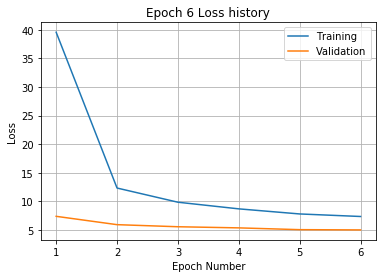

Training
Iteration 0: with minibatch training loss = 5.34 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.73 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.17 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.02 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.15 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.79 and relative error of 0.32
Epoch 7, Overall loss = 6.94, relative error = 0.303, and proc

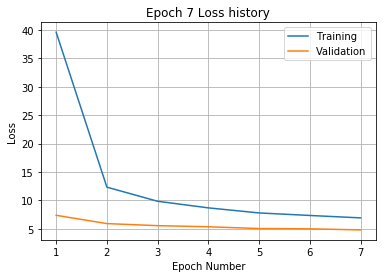

Training
Iteration 0: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.59 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.92 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.7 and relative error of 0.3
Epoch 8, Overall loss = 6.69, relative error = 0.297, and process

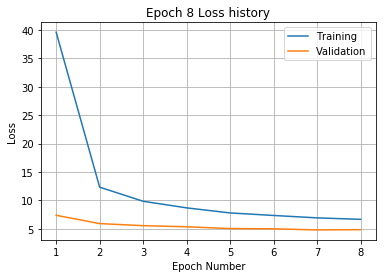

Training
Iteration 0: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.56 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.1 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 100: with minibatch training loss = 3.85 and relative error of 0.22
Iteration 120: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.25 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.32 and relative error of 0.28
Epoch 9, Overall loss = 6.36, relative error = 0.29, and process 

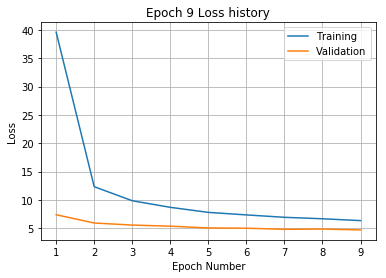

Training
Iteration 0: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.05 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 60: with minibatch training loss = 8.87 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.29 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.36 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.54 and relative error of 0.27
Epoch 10, Overall loss = 6.23, relative error = 0.287, and pro

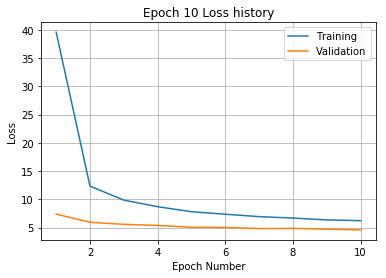

Training
Iteration 0: with minibatch training loss = 4.25 and relative error of 0.25
Iteration 20: with minibatch training loss = 7.39 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.92 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.07 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.37 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.26 and relative error of 0.23
Iteration 220: with minibatch training loss = 8.68 and relative error of 0.34
Epoch 11, Overall loss = 6.01, relative error = 0.282, and pr

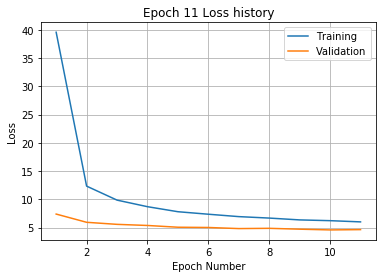

Training
Iteration 0: with minibatch training loss = 8.76 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.62 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.79 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.64 and relative error of 0.34
Iteration 160: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.88 and relative error of 0.28
Epoch 12, Overall loss = 5.87, relative error = 0.278, and pro

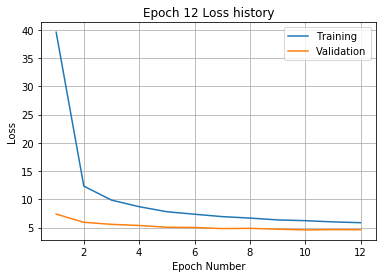

Training
Iteration 0: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.49 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.81 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.91 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.49 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.03 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.07 and relative error of 0.26
Epoch 13, Overall loss = 5.69, relative error = 0.274, and pro

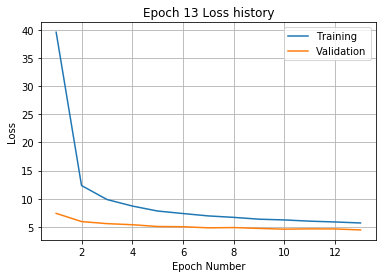

Training
Iteration 0: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 40: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.09 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.72 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.53 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.07 and relative error of 0.25
Epoch 14, Overall loss = 5.54, relative error = 0.27, and pro

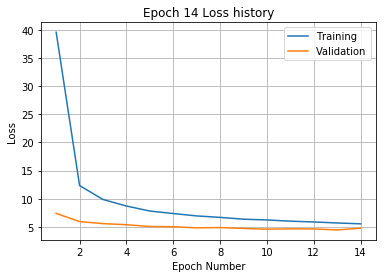

Training
Iteration 0: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.79 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.2 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 100: with minibatch training loss = 3.78 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.68 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.7 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.95 and relative error of 0.25
Epoch 15, Overall loss = 5.46, relative error = 0.268, and proce

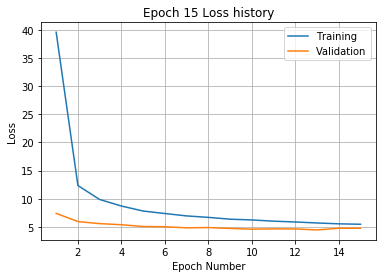

Training
Iteration 0: with minibatch training loss = 3.77 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.65 and relative error of 0.24
Iteration 60: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.04 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.3 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.08 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.46 and relative error of 0.25
Epoch 16, Overall loss = 5.34, relative error = 0.265, and proc

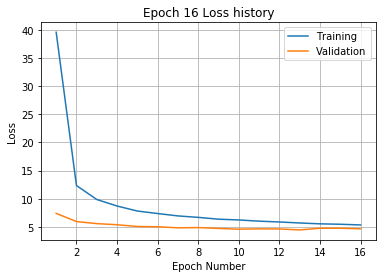

Training
Iteration 0: with minibatch training loss = 6.71 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.04 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.92 and relative error of 0.29
Iteration 180: with minibatch training loss = 3.8 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.61 and relative error of 0.24
Epoch 17, Overall loss = 5.22, relative error = 0.263, and proc

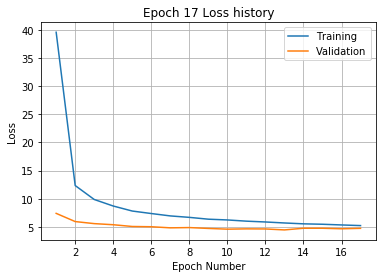

Training
Iteration 0: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 20: with minibatch training loss = 3.88 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.61 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.08 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.91 and relative error of 0.22
Iteration 180: with minibatch training loss = 3.44 and relative error of 0.22
Iteration 200: with minibatch training loss = 6.03 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.79 and relative error of 0.3
Epoch 18, Overall loss = 5.14, relative error = 0.26, and proce

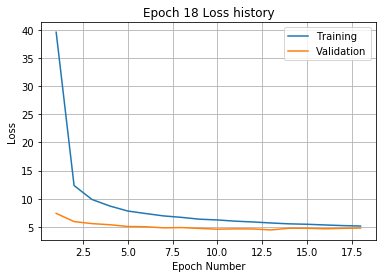

Validation error has stopped improving! Training on repetition 4 stopped!
Training
Iteration 0: with minibatch training loss = 208 and relative error of 1.6
Iteration 20: with minibatch training loss = 127 and relative error of 1.3
Iteration 40: with minibatch training loss = 87.2 and relative error of 1
Iteration 60: with minibatch training loss = 65.8 and relative error of 0.93
Iteration 80: with minibatch training loss = 44.9 and relative error of 0.76
Iteration 100: with minibatch training loss = 40.9 and relative error of 0.69
Iteration 120: with minibatch training loss = 24.8 and relative error of 0.58
Iteration 140: with minibatch training loss = 21.9 and relative error of 0.54
Iteration 160: with minibatch training loss = 21.8 and relative error of 0.53
Iteration 180: with minibatch training loss = 20.5 and relative error of 0.54
Iteration 200: with minibatch training loss = 18.5 and relative error of 0.51
Iteration 220: with minibatch training loss = 16.3 and relative error of

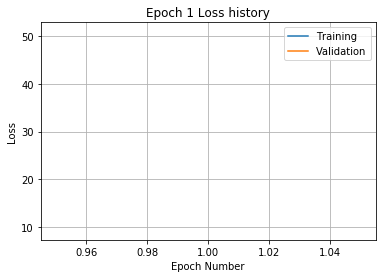

Training
Iteration 0: with minibatch training loss = 16.9 and relative error of 0.5
Iteration 20: with minibatch training loss = 13 and relative error of 0.4
Iteration 40: with minibatch training loss = 13 and relative error of 0.42
Iteration 60: with minibatch training loss = 15.1 and relative error of 0.46
Iteration 80: with minibatch training loss = 12.7 and relative error of 0.4
Iteration 100: with minibatch training loss = 14.3 and relative error of 0.44
Iteration 120: with minibatch training loss = 13.8 and relative error of 0.42
Iteration 140: with minibatch training loss = 12.4 and relative error of 0.42
Iteration 160: with minibatch training loss = 11 and relative error of 0.38
Iteration 180: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 200: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 220: with minibatch training loss = 11.4 and relative error of 0.38
Epoch 2, Overall loss = 13.4, relative error = 0.419, and process time

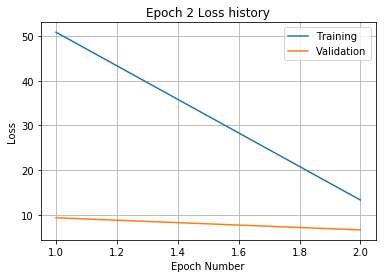

Training
Iteration 0: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 20: with minibatch training loss = 8.62 and relative error of 0.34
Iteration 40: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 60: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 80: with minibatch training loss = 12.5 and relative error of 0.42
Iteration 100: with minibatch training loss = 9.77 and relative error of 0.37
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.8 and relative error of 0.39
Iteration 160: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 180: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 200: with minibatch training loss = 8.85 and relative error of 0.36
Iteration 220: with minibatch training loss = 10.8 and relative error of 0.37
Epoch 3, Overall loss = 10.8, relative error = 0.377, and pro

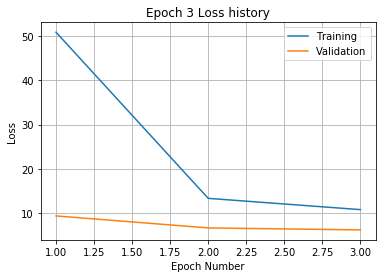

Training
Iteration 0: with minibatch training loss = 9.48 and relative error of 0.35
Iteration 20: with minibatch training loss = 10 and relative error of 0.35
Iteration 40: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 60: with minibatch training loss = 7.95 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.89 and relative error of 0.36
Iteration 100: with minibatch training loss = 9.53 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.58 and relative error of 0.34
Iteration 140: with minibatch training loss = 9.38 and relative error of 0.35
Iteration 160: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 180: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 200: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 220: with minibatch training loss = 10.4 and relative error of 0.37
Epoch 4, Overall loss = 9.36, relative error = 0.351, and proces

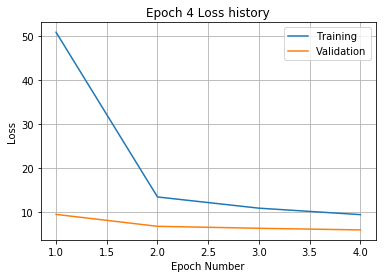

Training
Iteration 0: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 20: with minibatch training loss = 9.42 and relative error of 0.35
Iteration 40: with minibatch training loss = 8.24 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.82 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.68 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 120: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 140: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 160: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 180: with minibatch training loss = 9.26 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.37 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.09 and relative error of 0.32
Epoch 5, Overall loss = 8.51, relative error = 0.334, and proc

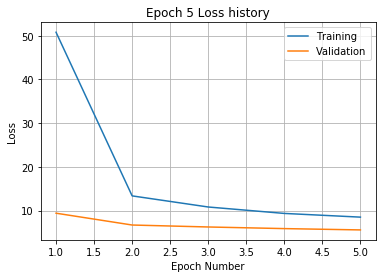

Training
Iteration 0: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 20: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 40: with minibatch training loss = 6 and relative error of 0.27
Iteration 60: with minibatch training loss = 8.21 and relative error of 0.32
Iteration 80: with minibatch training loss = 9.08 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.41 and relative error of 0.34
Iteration 120: with minibatch training loss = 5.74 and relative error of 0.26
Iteration 140: with minibatch training loss = 8.18 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.45 and relative error of 0.31
Epoch 6, Overall loss = 7.78, relative error = 0.319, and process

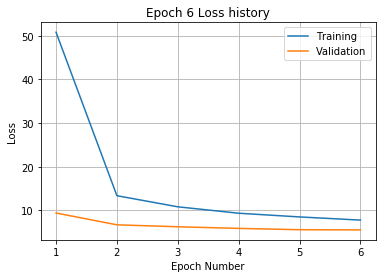

Training
Iteration 0: with minibatch training loss = 7.53 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.41 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.67 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.91 and relative error of 0.31
Epoch 7, Overall loss = 7.37, relative error = 0.311, and proc

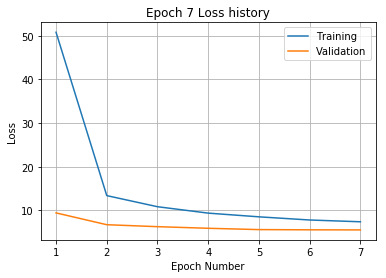

Training
Iteration 0: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.21 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.62 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.25 and relative error of 0.3
Iteration 180: with minibatch training loss = 9.63 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.8 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.25 and relative error of 0.27
Epoch 8, Overall loss = 7.04, relative error = 0.304, and proce

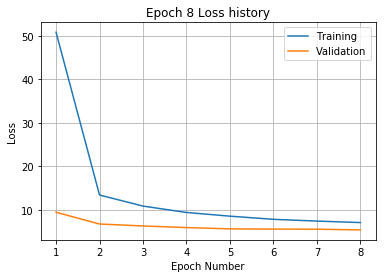

Training
Iteration 0: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.77 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.41 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.55 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.4 and relative error of 0.29
Epoch 9, Overall loss = 6.7, relative error = 0.296, and process 

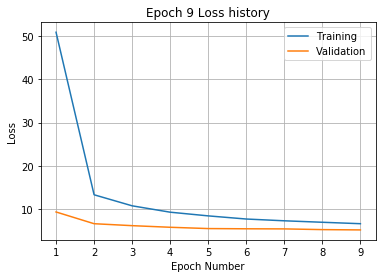

Training
Iteration 0: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.92 and relative error of 0.31
Iteration 40: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 60: with minibatch training loss = 7.28 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.66 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.47 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.14 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.17 and relative error of 0.29
Epoch 10, Overall loss = 6.55, relative error = 0.293, and proce

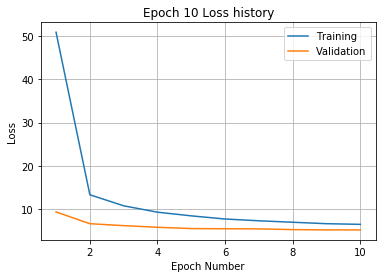

Training
Iteration 0: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 80: with minibatch training loss = 8.89 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.03 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.68 and relative error of 0.29
Epoch 11, Overall loss = 6.26, relative error = 0.286, and proc

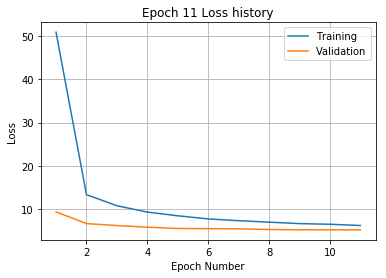

Training
Iteration 0: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 20: with minibatch training loss = 8.51 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.87 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.6 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.68 and relative error of 0.27
Epoch 12, Overall loss = 6.11, relative error = 0.283, and proce

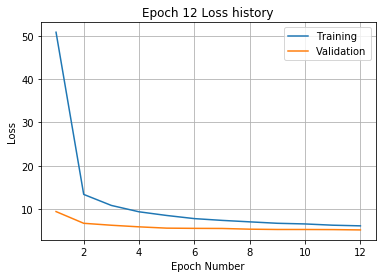

Training
Iteration 0: with minibatch training loss = 6.25 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.78 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 120: with minibatch training loss = 8.54 and relative error of 0.34
Iteration 140: with minibatch training loss = 3.49 and relative error of 0.21
Iteration 160: with minibatch training loss = 7.54 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.37 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.57 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.78 and relative error of 0.31
Epoch 13, Overall loss = 5.89, relative error = 0.278, and proc

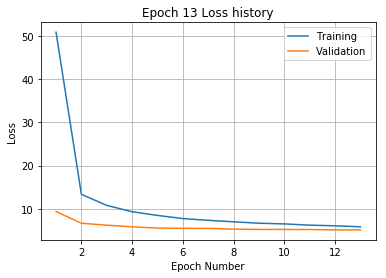

Training
Iteration 0: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 20: with minibatch training loss = 8.05 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 140: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.45 and relative error of 0.26
Epoch 14, Overall loss = 5.74, relative error = 0.274, and pro

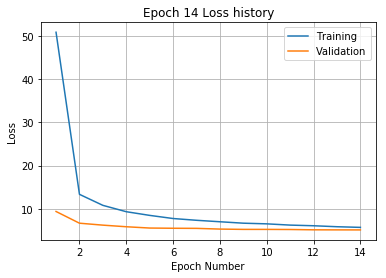

Training
Iteration 0: with minibatch training loss = 5.66 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.46 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.66 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.98 and relative error of 0.3
Epoch 15, Overall loss = 5.65, relative error = 0.272, and proc

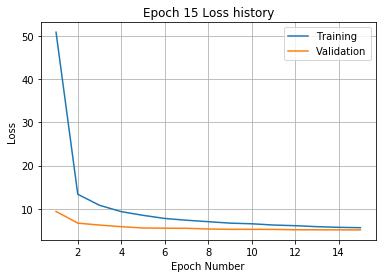

Training
Iteration 0: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.16 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.38 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 220: with minibatch training loss = 4.11 and relative error of 0.23
Epoch 16, Overall loss = 5.5, relative error = 0.268, and proces

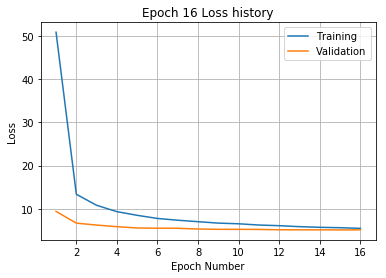

Training
Iteration 0: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.78 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.75 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.18 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.49 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.02 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.57 and relative error of 0.27
Epoch 17, Overall loss = 5.37, relative error = 0.265, and pro

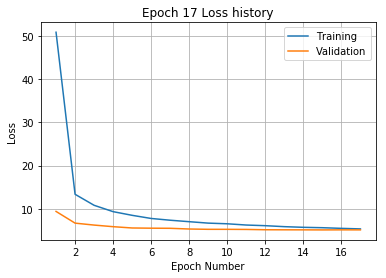

Training
Iteration 0: with minibatch training loss = 7.25 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.48 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.82 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.83 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.33 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 180: with minibatch training loss = 3.73 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.24 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.63 and relative error of 0.25
Epoch 18, Overall loss = 5.25, relative error = 0.262, and proc

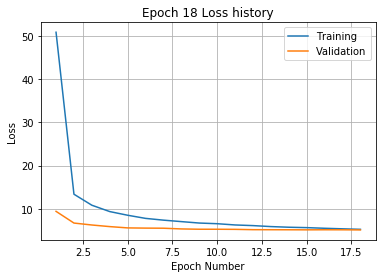

Training
Iteration 0: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.63 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.6 and relative error of 0.33
Iteration 120: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 160: with minibatch training loss = 3.61 and relative error of 0.22
Iteration 180: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.42 and relative error of 0.25
Epoch 19, Overall loss = 5.14, relative error = 0.259, and proc

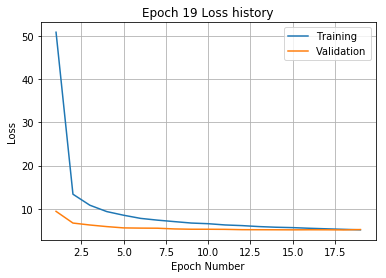

Training
Iteration 0: with minibatch training loss = 5.21 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.71 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.31 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.88 and relative error of 0.22
Iteration 120: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.1 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.04 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.86 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.75 and relative error of 0.25
Epoch 20, Overall loss = 5.07, relative error = 0.257, and pro

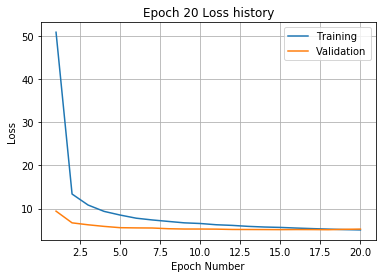

Training
Iteration 0: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.08 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.27 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.47 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.21 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.28 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.27 and relative error of 0.26
Epoch 21, Overall loss = 4.95, relative error = 0.255, and proc

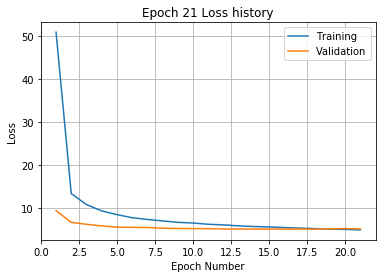

Training
Iteration 0: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.95 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.75 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 120: with minibatch training loss = 3.42 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.23 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 220: with minibatch training loss = 3.7 and relative error of 0.22
Epoch 22, Overall loss = 4.9, relative error = 0.253, and proces

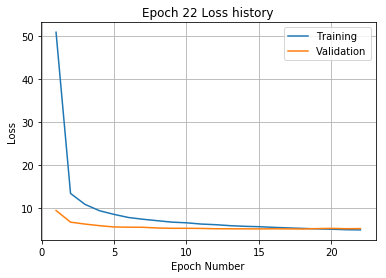

Training
Iteration 0: with minibatch training loss = 4.71 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.33 and relative error of 0.21
Iteration 40: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 60: with minibatch training loss = 3.31 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.58 and relative error of 0.21
Iteration 160: with minibatch training loss = 5.98 and relative error of 0.29
Iteration 180: with minibatch training loss = 3.83 and relative error of 0.22
Iteration 200: with minibatch training loss = 3.8 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.59 and relative error of 0.26
Epoch 23, Overall loss = 4.82, relative error = 0.251, and pro

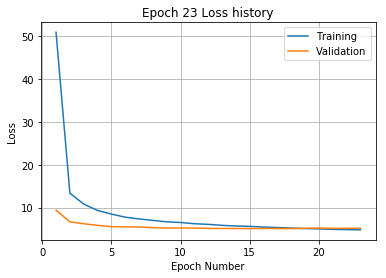

Validation error has stopped improving! Training on repetition 5 stopped!
Training
Iteration 0: with minibatch training loss = 211 and relative error of 1.6
Iteration 20: with minibatch training loss = 106 and relative error of 1.2
Iteration 40: with minibatch training loss = 69.3 and relative error of 0.97
Iteration 60: with minibatch training loss = 53.6 and relative error of 0.84
Iteration 80: with minibatch training loss = 39.3 and relative error of 0.71
Iteration 100: with minibatch training loss = 29.1 and relative error of 0.63
Iteration 120: with minibatch training loss = 21.2 and relative error of 0.53
Iteration 140: with minibatch training loss = 23.2 and relative error of 0.54
Iteration 160: with minibatch training loss = 16.8 and relative error of 0.47
Iteration 180: with minibatch training loss = 17.4 and relative error of 0.47
Iteration 200: with minibatch training loss = 16.5 and relative error of 0.45
Iteration 220: with minibatch training loss = 14.2 and relative error

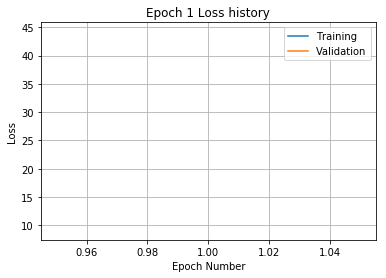

Training
Iteration 0: with minibatch training loss = 13.8 and relative error of 0.42
Iteration 20: with minibatch training loss = 14.2 and relative error of 0.44
Iteration 40: with minibatch training loss = 12 and relative error of 0.39
Iteration 60: with minibatch training loss = 13.5 and relative error of 0.43
Iteration 80: with minibatch training loss = 14.3 and relative error of 0.47
Iteration 100: with minibatch training loss = 11.5 and relative error of 0.4
Iteration 120: with minibatch training loss = 9.12 and relative error of 0.34
Iteration 140: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 160: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 180: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 200: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 220: with minibatch training loss = 13.4 and relative error of 0.42
Epoch 2, Overall loss = 12.6, relative error = 0.408, and process 

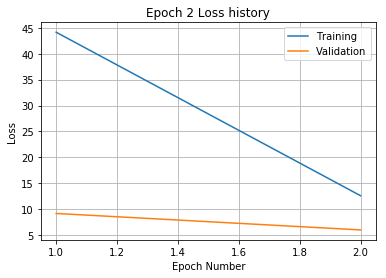

Training
Iteration 0: with minibatch training loss = 9.97 and relative error of 0.36
Iteration 20: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 40: with minibatch training loss = 11 and relative error of 0.39
Iteration 60: with minibatch training loss = 9.02 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.78 and relative error of 0.36
Iteration 100: with minibatch training loss = 11.8 and relative error of 0.4
Iteration 120: with minibatch training loss = 9.68 and relative error of 0.35
Iteration 140: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 160: with minibatch training loss = 11 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 200: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 220: with minibatch training loss = 11.3 and relative error of 0.39
Epoch 3, Overall loss = 10.1, relative error = 0.365, and process t

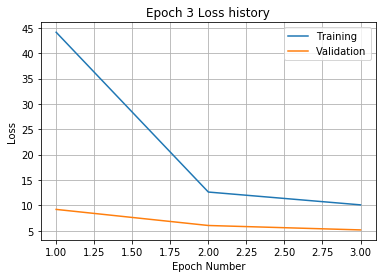

Training
Iteration 0: with minibatch training loss = 8.9 and relative error of 0.33
Iteration 20: with minibatch training loss = 9.75 and relative error of 0.35
Iteration 40: with minibatch training loss = 12.7 and relative error of 0.42
Iteration 60: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 80: with minibatch training loss = 7.6 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.4 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.37 and relative error of 0.3
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 160: with minibatch training loss = 8.46 and relative error of 0.34
Iteration 180: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 200: with minibatch training loss = 9.46 and relative error of 0.37
Iteration 220: with minibatch training loss = 7.89 and relative error of 0.32
Epoch 4, Overall loss = 9, relative error = 0.344, and process ti

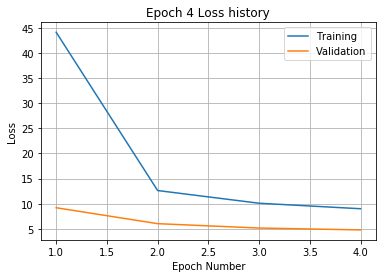

Training
Iteration 0: with minibatch training loss = 8.4 and relative error of 0.34
Iteration 20: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 40: with minibatch training loss = 7.96 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 80: with minibatch training loss = 9.31 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.59 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 160: with minibatch training loss = 10 and relative error of 0.36
Iteration 180: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.21 and relative error of 0.32
Iteration 220: with minibatch training loss = 7 and relative error of 0.3
Epoch 5, Overall loss = 8.13, relative error = 0.327, and process ti

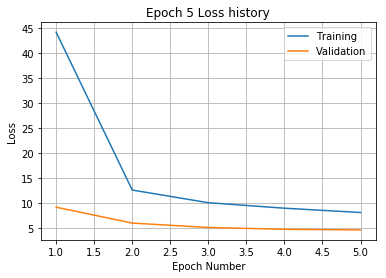

Training
Iteration 0: with minibatch training loss = 7.99 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.69 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.66 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.19 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 100: with minibatch training loss = 9.25 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.85 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.63 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.19 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.91 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.75 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.44 and relative error of 0.32
Epoch 6, Overall loss = 7.6, relative error = 0.316, and proc

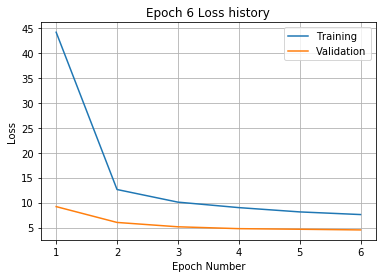

Training
Iteration 0: with minibatch training loss = 7.29 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.93 and relative error of 0.32
Iteration 100: with minibatch training loss = 9.41 and relative error of 0.37
Iteration 120: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 180: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 200: with minibatch training loss = 9.09 and relative error of 0.35
Iteration 220: with minibatch training loss = 5.04 and relative error of 0.26
Epoch 7, Overall loss = 7.19, relative error = 0.308, and proces

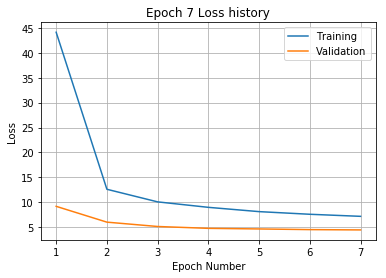

Training
Iteration 0: with minibatch training loss = 8.71 and relative error of 0.35
Iteration 20: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.75 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 100: with minibatch training loss = 10.2 and relative error of 0.39
Iteration 120: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.76 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.43 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.66 and relative error of 0.32
Epoch 8, Overall loss = 6.83, relative error = 0.3, and process

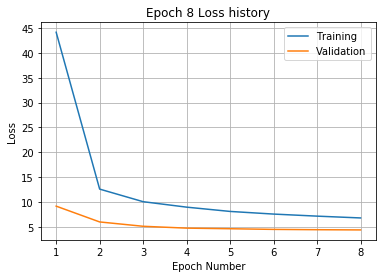

Training
Iteration 0: with minibatch training loss = 8.41 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.63 and relative error of 0.33
Iteration 160: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.18 and relative error of 0.29
Epoch 9, Overall loss = 6.58, relative error = 0.294, and process

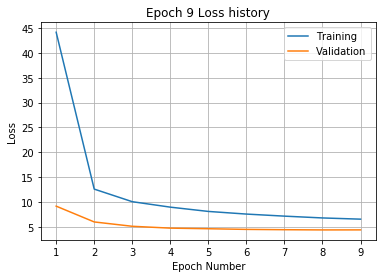

Training
Iteration 0: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.36 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.78 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 120: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.33 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.27 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.08 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.07 and relative error of 0.27
Epoch 10, Overall loss = 6.29, relative error = 0.288, and proces

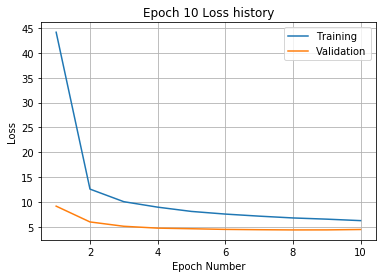

Training
Iteration 0: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.51 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.09 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 220: with minibatch training loss = 7.5 and relative error of 0.3
Epoch 11, Overall loss = 6.15, relative error = 0.285, and proces

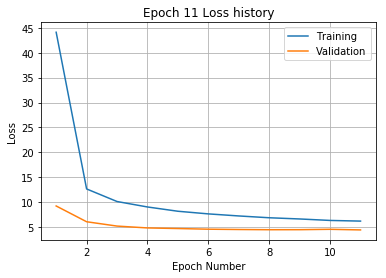

Training
Iteration 0: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.46 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.09 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.73 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 160: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.42 and relative error of 0.3
Epoch 12, Overall loss = 5.95, relative error = 0.279, and proces

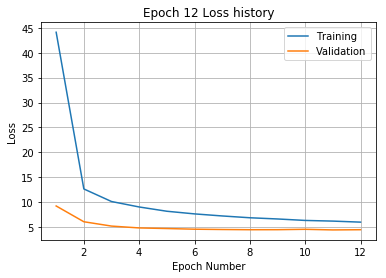

Training
Iteration 0: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 160: with minibatch training loss = 8.32 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.54 and relative error of 0.32
Epoch 13, Overall loss = 5.8, relative error = 0.276, and proce

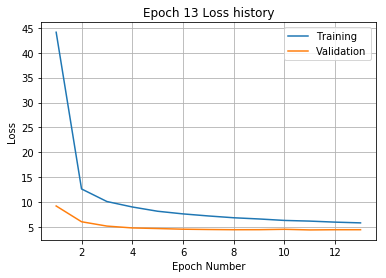

Training
Iteration 0: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.21 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 160: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.21 and relative error of 0.28
Epoch 14, Overall loss = 5.65, relative error = 0.273, and proc

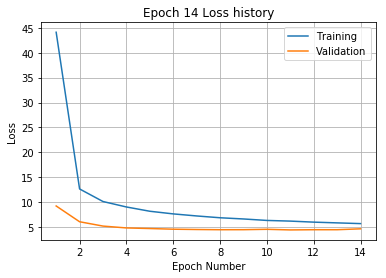

Training
Iteration 0: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.19 and relative error of 0.23
Iteration 140: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 180: with minibatch training loss = 5 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.99 and relative error of 0.26
Epoch 15, Overall loss = 5.55, relative error = 0.27, and proces

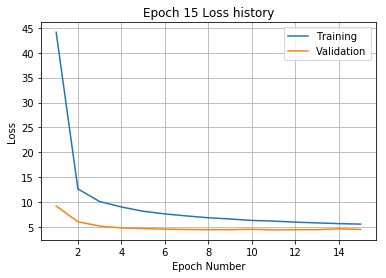

Training
Iteration 0: with minibatch training loss = 4.58 and relative error of 0.26
Iteration 20: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.13 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.88 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.57 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.33 and relative error of 0.25
Epoch 16, Overall loss = 5.37, relative error = 0.266, and proce

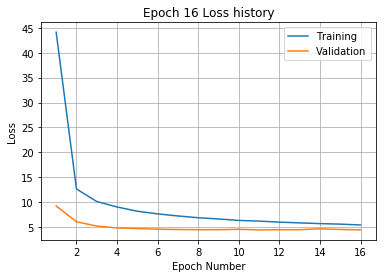

Validation error has stopped improving! Training on repetition 6 stopped!
Training
Iteration 0: with minibatch training loss = 222 and relative error of 1.7
Iteration 20: with minibatch training loss = 139 and relative error of 1.3
Iteration 40: with minibatch training loss = 79.3 and relative error of 1
Iteration 60: with minibatch training loss = 70.9 and relative error of 0.94
Iteration 80: with minibatch training loss = 44.2 and relative error of 0.77
Iteration 100: with minibatch training loss = 35.1 and relative error of 0.69
Iteration 120: with minibatch training loss = 26.7 and relative error of 0.59
Iteration 140: with minibatch training loss = 21.4 and relative error of 0.52
Iteration 160: with minibatch training loss = 20.6 and relative error of 0.51
Iteration 180: with minibatch training loss = 16.5 and relative error of 0.46
Iteration 200: with minibatch training loss = 17.6 and relative error of 0.46
Iteration 220: with minibatch training loss = 17.7 and relative error of

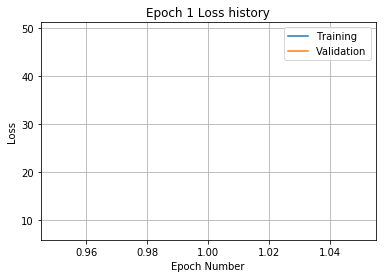

Training
Iteration 0: with minibatch training loss = 12.8 and relative error of 0.4
Iteration 20: with minibatch training loss = 13.2 and relative error of 0.4
Iteration 40: with minibatch training loss = 19.1 and relative error of 0.5
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 80: with minibatch training loss = 12.4 and relative error of 0.39
Iteration 100: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 120: with minibatch training loss = 15 and relative error of 0.45
Iteration 140: with minibatch training loss = 13.8 and relative error of 0.42
Iteration 160: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 180: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 200: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 220: with minibatch training loss = 13.4 and relative error of 0.41
Epoch 2, Overall loss = 12.4, relative error = 0.402, and process 

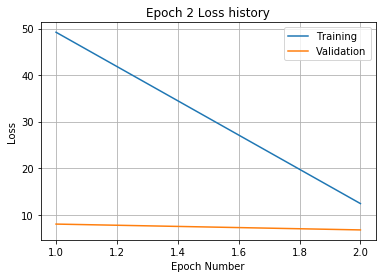

Training
Iteration 0: with minibatch training loss = 8.63 and relative error of 0.33
Iteration 20: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 40: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 60: with minibatch training loss = 9.28 and relative error of 0.35
Iteration 80: with minibatch training loss = 10.7 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.48 and relative error of 0.33
Iteration 120: with minibatch training loss = 9.74 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.93 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.65 and relative error of 0.35
Iteration 180: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 200: with minibatch training loss = 8.11 and relative error of 0.34
Iteration 220: with minibatch training loss = 11.5 and relative error of 0.39
Epoch 3, Overall loss = 10, relative error = 0.362, and proces

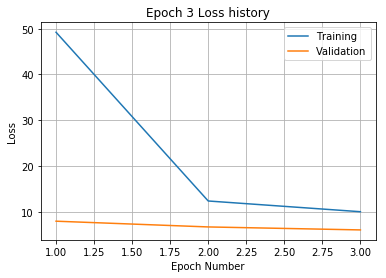

Training
Iteration 0: with minibatch training loss = 8.76 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.95 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.67 and relative error of 0.34
Iteration 60: with minibatch training loss = 9.52 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.66 and relative error of 0.34
Iteration 100: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 120: with minibatch training loss = 11.1 and relative error of 0.4
Iteration 140: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.89 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 200: with minibatch training loss = 9.7 and relative error of 0.37
Iteration 220: with minibatch training loss = 7.92 and relative error of 0.32
Epoch 4, Overall loss = 8.85, relative error = 0.34, and process

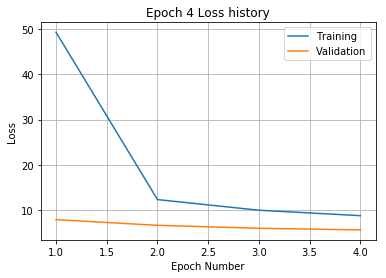

Training
Iteration 0: with minibatch training loss = 8.75 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 40: with minibatch training loss = 8.27 and relative error of 0.32
Iteration 60: with minibatch training loss = 9.47 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.52 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.89 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.16 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.23 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.3 and relative error of 0.34
Iteration 180: with minibatch training loss = 6.98 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.71 and relative error of 0.31
Epoch 5, Overall loss = 8.1, relative error = 0.325, and proce

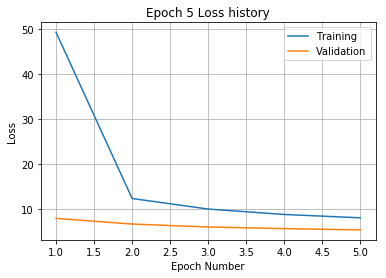

Training
Iteration 0: with minibatch training loss = 8.59 and relative error of 0.35
Iteration 20: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.95 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.69 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 100: with minibatch training loss = 9.01 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.98 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.29 and relative error of 0.3
Iteration 160: with minibatch training loss = 9.23 and relative error of 0.37
Iteration 180: with minibatch training loss = 7.75 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.64 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.17 and relative error of 0.31
Epoch 6, Overall loss = 7.55, relative error = 0.313, and proc

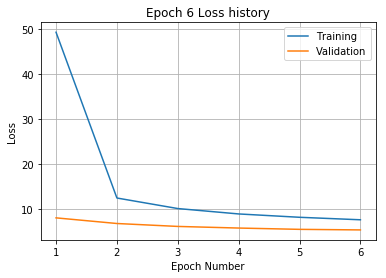

Training
Iteration 0: with minibatch training loss = 9.26 and relative error of 0.34
Iteration 20: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 40: with minibatch training loss = 9.62 and relative error of 0.35
Iteration 60: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.55 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.45 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 180: with minibatch training loss = 4.74 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.87 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.99 and relative error of 0.29
Epoch 7, Overall loss = 7.19, relative error = 0.306, and proce

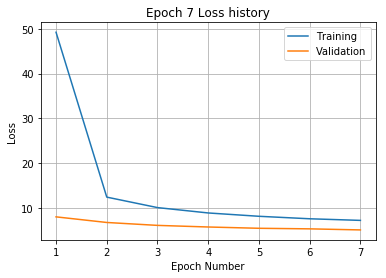

Training
Iteration 0: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.02 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.91 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.13 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.7 and relative error of 0.34
Iteration 180: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.66 and relative error of 0.26
Epoch 8, Overall loss = 6.81, relative error = 0.297, and proce

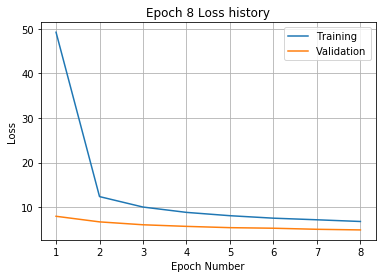

Training
Iteration 0: with minibatch training loss = 6.87 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.92 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.53 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.89 and relative error of 0.25
Epoch 9, Overall loss = 6.51, relative error = 0.291, and process

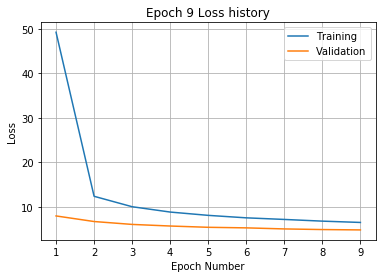

Training
Iteration 0: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.87 and relative error of 0.3
Epoch 10, Overall loss = 6.31, relative error = 0.286, and proce

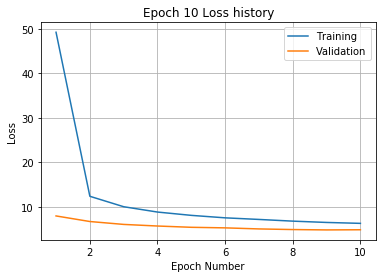

Training
Iteration 0: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.22 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.01 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.57 and relative error of 0.27
Epoch 11, Overall loss = 6.09, relative error = 0.281, and proce

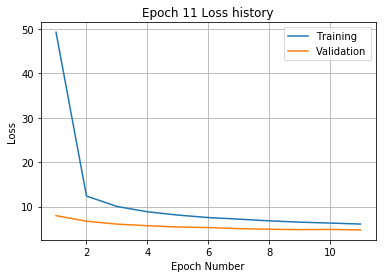

Training
Iteration 0: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.8 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.59 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.9 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 220: with minibatch training loss = 3.63 and relative error of 0.21
Epoch 12, Overall loss = 5.92, relative error = 0.277, and proces

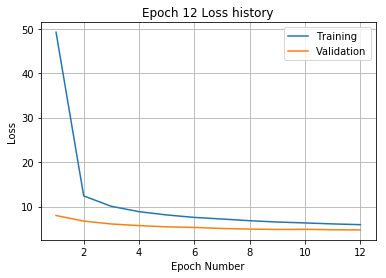

Training
Iteration 0: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.68 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.89 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.02 and relative error of 0.28
Epoch 13, Overall loss = 5.77, relative error = 0.274, and proc

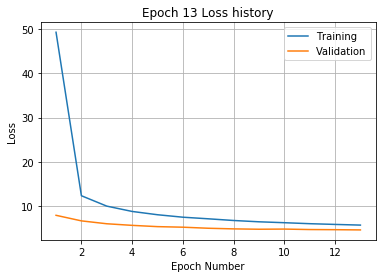

Training
Iteration 0: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.43 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.6 and relative error of 0.22
Iteration 100: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.23 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.02 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.12 and relative error of 0.32
Epoch 14, Overall loss = 5.65, relative error = 0.271, and pro

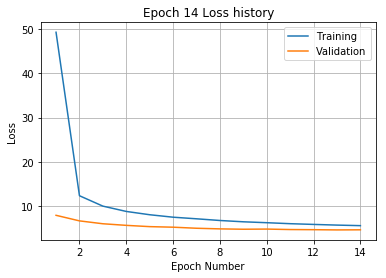

Training
Iteration 0: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.21 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.1 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.26 and relative error of 0.28
Epoch 15, Overall loss = 5.53, relative error = 0.268, and proces

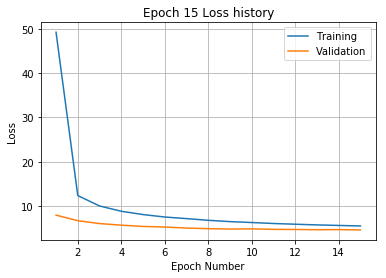

Training
Iteration 0: with minibatch training loss = 7.07 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.02 and relative error of 0.27
Iteration 160: with minibatch training loss = 3.58 and relative error of 0.22
Iteration 180: with minibatch training loss = 6.75 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.46 and relative error of 0.28
Epoch 16, Overall loss = 5.36, relative error = 0.264, and pro

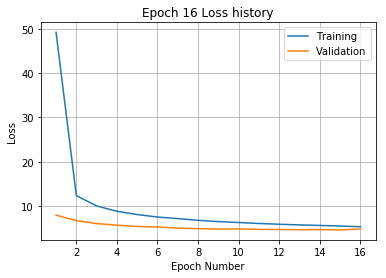

Training
Iteration 0: with minibatch training loss = 4.63 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.19 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.69 and relative error of 0.21
Iteration 80: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 100: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 180: with minibatch training loss = 5 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.96 and relative error of 0.29
Epoch 17, Overall loss = 5.27, relative error = 0.262, and proces

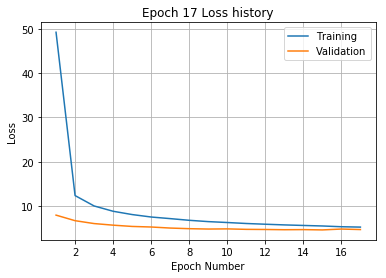

Training
Iteration 0: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 40: with minibatch training loss = 3.83 and relative error of 0.23
Iteration 60: with minibatch training loss = 3.54 and relative error of 0.21
Iteration 80: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 120: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.26 and relative error of 0.25
Epoch 18, Overall loss = 5.16, relative error = 0.259, and proce

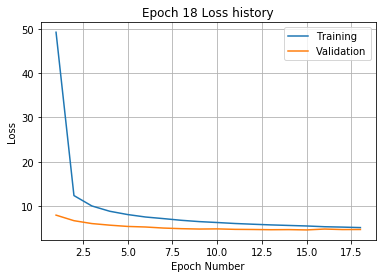

Training
Iteration 0: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.71 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 120: with minibatch training loss = 3.75 and relative error of 0.22
Iteration 140: with minibatch training loss = 3.49 and relative error of 0.21
Iteration 160: with minibatch training loss = 3.91 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.79 and relative error of 0.29
Epoch 19, Overall loss = 5.01, relative error = 0.255, and proc

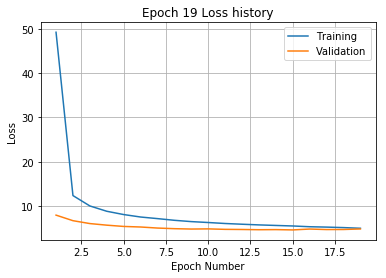

Training
Iteration 0: with minibatch training loss = 5.18 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.79 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.52 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.05 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.4 and relative error of 0.21
Iteration 140: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.19 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.76 and relative error of 0.27
Epoch 20, Overall loss = 4.97, relative error = 0.254, and pro

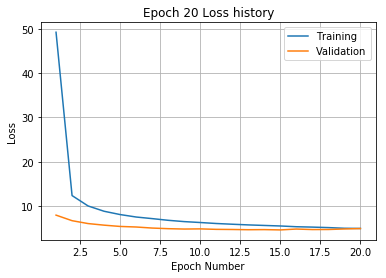

Validation error has stopped improving! Training on repetition 7 stopped!
Training
Iteration 0: with minibatch training loss = 167 and relative error of 1.5
Iteration 20: with minibatch training loss = 96.2 and relative error of 1.1
Iteration 40: with minibatch training loss = 63.1 and relative error of 0.9
Iteration 60: with minibatch training loss = 46.3 and relative error of 0.81
Iteration 80: with minibatch training loss = 31.8 and relative error of 0.65
Iteration 100: with minibatch training loss = 27.7 and relative error of 0.62
Iteration 120: with minibatch training loss = 22.2 and relative error of 0.54
Iteration 140: with minibatch training loss = 19 and relative error of 0.48
Iteration 160: with minibatch training loss = 15.9 and relative error of 0.44
Iteration 180: with minibatch training loss = 14 and relative error of 0.44
Iteration 200: with minibatch training loss = 14.6 and relative error of 0.42
Iteration 220: with minibatch training loss = 15 and relative error of 0.

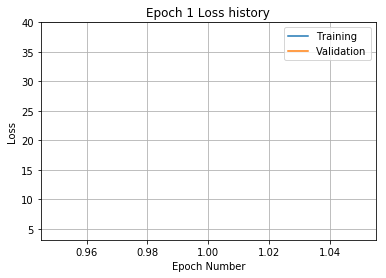

Training
Iteration 0: with minibatch training loss = 16.7 and relative error of 0.48
Iteration 20: with minibatch training loss = 15.4 and relative error of 0.46
Iteration 40: with minibatch training loss = 12 and relative error of 0.39
Iteration 60: with minibatch training loss = 15.8 and relative error of 0.44
Iteration 80: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 100: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 120: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 140: with minibatch training loss = 14 and relative error of 0.42
Iteration 160: with minibatch training loss = 11 and relative error of 0.39
Iteration 180: with minibatch training loss = 9.85 and relative error of 0.36
Iteration 200: with minibatch training loss = 8 and relative error of 0.34
Iteration 220: with minibatch training loss = 9.08 and relative error of 0.36
Epoch 2, Overall loss = 11.8, relative error = 0.394, and process time

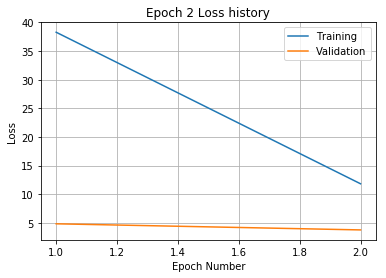

Training
Iteration 0: with minibatch training loss = 8.74 and relative error of 0.34
Iteration 20: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 40: with minibatch training loss = 8.78 and relative error of 0.33
Iteration 60: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 80: with minibatch training loss = 9.44 and relative error of 0.35
Iteration 100: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 120: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 140: with minibatch training loss = 8.76 and relative error of 0.34
Iteration 160: with minibatch training loss = 12.6 and relative error of 0.42
Iteration 180: with minibatch training loss = 9.88 and relative error of 0.37
Iteration 200: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 220: with minibatch training loss = 7.48 and relative error of 0.31
Epoch 3, Overall loss = 9.67, relative error = 0.356, and pro

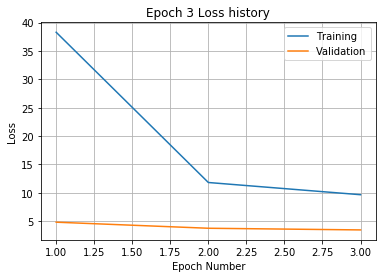

Training
Iteration 0: with minibatch training loss = 7.77 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.65 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.82 and relative error of 0.35
Iteration 60: with minibatch training loss = 9.66 and relative error of 0.37
Iteration 80: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 100: with minibatch training loss = 9.32 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.91 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.44 and relative error of 0.34
Iteration 160: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.01 and relative error of 0.29
Iteration 200: with minibatch training loss = 9.79 and relative error of 0.36
Iteration 220: with minibatch training loss = 7.05 and relative error of 0.3
Epoch 4, Overall loss = 8.48, relative error = 0.334, and proce

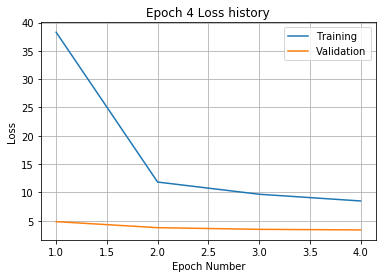

Training
Iteration 0: with minibatch training loss = 9.04 and relative error of 0.35
Iteration 20: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 40: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.72 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.74 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.39 and relative error of 0.3
Epoch 5, Overall loss = 7.83, relative error = 0.321, and proce

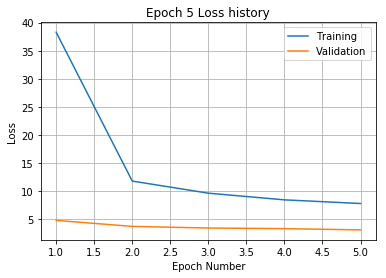

Training
Iteration 0: with minibatch training loss = 7.71 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.97 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.36 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.49 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.89 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.85 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 200: with minibatch training loss = 11 and relative error of 0.39
Iteration 220: with minibatch training loss = 7.3 and relative error of 0.3
Epoch 6, Overall loss = 7.31, relative error = 0.31, and process ti

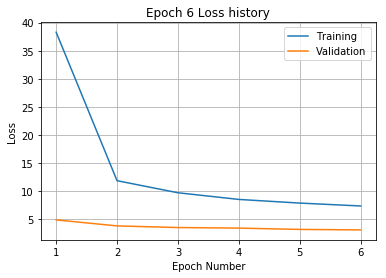

Training
Iteration 0: with minibatch training loss = 7.87 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.03 and relative error of 0.25
Iteration 120: with minibatch training loss = 8.38 and relative error of 0.34
Iteration 140: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.53 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.43 and relative error of 0.3
Epoch 7, Overall loss = 6.93, relative error = 0.301, and proces

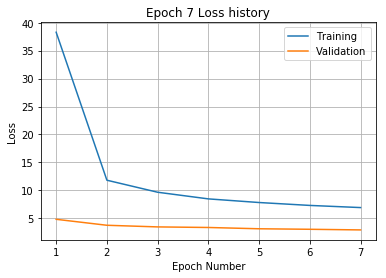

Training
Iteration 0: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.12 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.49 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 120: with minibatch training loss = 8.58 and relative error of 0.36
Iteration 140: with minibatch training loss = 8.53 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.1 and relative error of 0.31
Epoch 8, Overall loss = 6.64, relative error = 0.295, and process

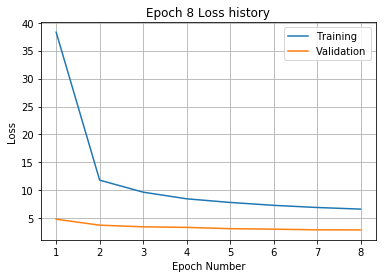

Training
Iteration 0: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.31 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.8 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 180: with minibatch training loss = 7.44 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.45 and relative error of 0.29
Epoch 9, Overall loss = 6.39, relative error = 0.289, and process

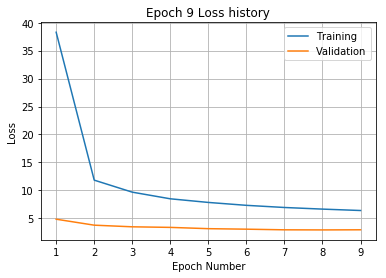

Training
Iteration 0: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.01 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.49 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.53 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.24 and relative error of 0.28
Epoch 10, Overall loss = 6.22, relative error = 0.286, and proce

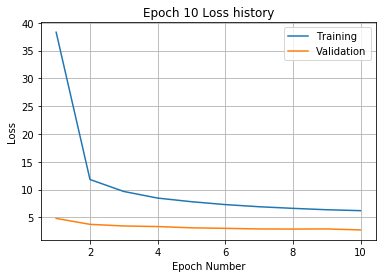

Training
Iteration 0: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.38 and relative error of 0.28
Epoch 11, Overall loss = 6.01, relative error = 0.281, and proc

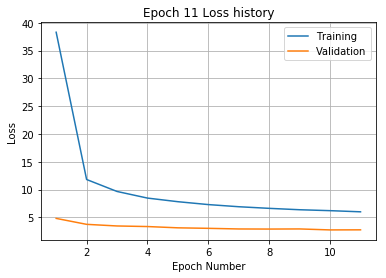

Training
Iteration 0: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 40: with minibatch training loss = 8.71 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 200: with minibatch training loss = 8.34 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.88 and relative error of 0.3
Epoch 12, Overall loss = 5.84, relative error = 0.277, and process 

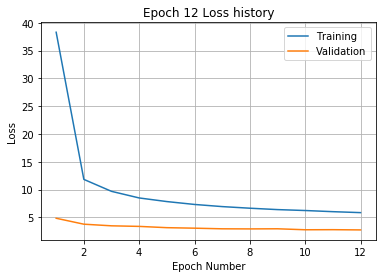

Training
Iteration 0: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.12 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.78 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.51 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.07 and relative error of 0.23
Epoch 13, Overall loss = 5.77, relative error = 0.275, and proce

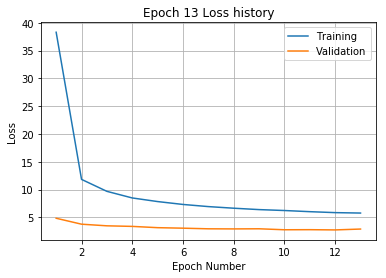

Training
Iteration 0: with minibatch training loss = 6.99 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.66 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.9 and relative error of 0.24
Iteration 80: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.83 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.87 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.41 and relative error of 0.26
Epoch 14, Overall loss = 5.59, relative error = 0.271, and proc

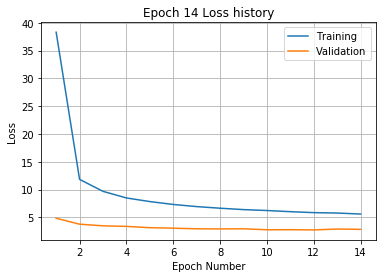

Training
Iteration 0: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.51 and relative error of 0.33
Iteration 120: with minibatch training loss = 5.96 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.12 and relative error of 0.24
Iteration 180: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 200: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.1 and relative error of 0.27
Epoch 15, Overall loss = 5.45, relative error = 0.267, and proc

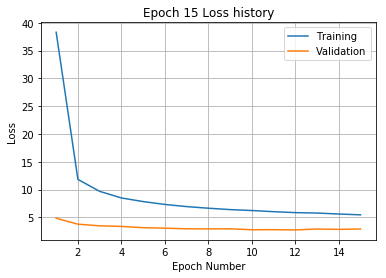

Training
Iteration 0: with minibatch training loss = 5.14 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.09 and relative error of 0.3
Epoch 16, Overall loss = 5.4, relative error = 0.266, and proces

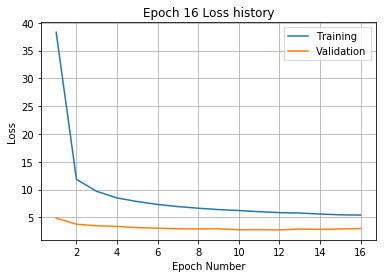

Training
Iteration 0: with minibatch training loss = 4.32 and relative error of 0.23
Iteration 20: with minibatch training loss = 3.61 and relative error of 0.22
Iteration 40: with minibatch training loss = 6.77 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.88 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.79 and relative error of 0.28
Epoch 17, Overall loss = 5.24, relative error = 0.262, and pro

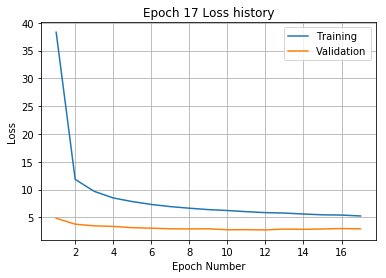

Validation error has stopped improving! Training on repetition 8 stopped!
Training
Iteration 0: with minibatch training loss = 221 and relative error of 1.7
Iteration 20: with minibatch training loss = 135 and relative error of 1.3
Iteration 40: with minibatch training loss = 93.2 and relative error of 1.1
Iteration 60: with minibatch training loss = 74.9 and relative error of 0.98
Iteration 80: with minibatch training loss = 51.1 and relative error of 0.83
Iteration 100: with minibatch training loss = 40.8 and relative error of 0.71
Iteration 120: with minibatch training loss = 27.1 and relative error of 0.61
Iteration 140: with minibatch training loss = 21.7 and relative error of 0.54
Iteration 160: with minibatch training loss = 20.3 and relative error of 0.52
Iteration 180: with minibatch training loss = 21.8 and relative error of 0.54
Iteration 200: with minibatch training loss = 17.4 and relative error of 0.48
Iteration 220: with minibatch training loss = 14 and relative error of

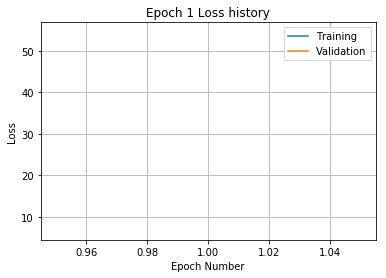

Training
Iteration 0: with minibatch training loss = 14.7 and relative error of 0.44
Iteration 20: with minibatch training loss = 13.8 and relative error of 0.43
Iteration 40: with minibatch training loss = 14.4 and relative error of 0.44
Iteration 60: with minibatch training loss = 13.9 and relative error of 0.42
Iteration 80: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 100: with minibatch training loss = 13.8 and relative error of 0.43
Iteration 120: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 140: with minibatch training loss = 12.6 and relative error of 0.41
Iteration 160: with minibatch training loss = 13.3 and relative error of 0.41
Iteration 180: with minibatch training loss = 12.5 and relative error of 0.42
Iteration 200: with minibatch training loss = 14.4 and relative error of 0.43
Iteration 220: with minibatch training loss = 12.6 and relative error of 0.42
Epoch 2, Overall loss = 12.9, relative error = 0.411, and pro

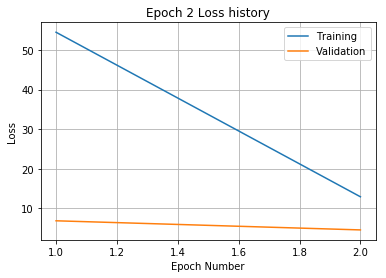

Training
Iteration 0: with minibatch training loss = 9.26 and relative error of 0.36
Iteration 20: with minibatch training loss = 14.5 and relative error of 0.43
Iteration 40: with minibatch training loss = 9.47 and relative error of 0.36
Iteration 60: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 80: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 100: with minibatch training loss = 9.57 and relative error of 0.37
Iteration 120: with minibatch training loss = 9.15 and relative error of 0.35
Iteration 140: with minibatch training loss = 9.5 and relative error of 0.35
Iteration 160: with minibatch training loss = 10 and relative error of 0.35
Iteration 180: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 200: with minibatch training loss = 8.16 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.95 and relative error of 0.36
Epoch 3, Overall loss = 10.4, relative error = 0.37, and process 

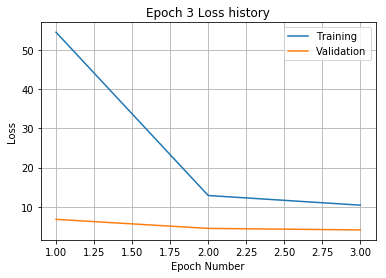

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 20: with minibatch training loss = 9.97 and relative error of 0.36
Iteration 40: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 60: with minibatch training loss = 9.76 and relative error of 0.35
Iteration 80: with minibatch training loss = 9.97 and relative error of 0.37
Iteration 100: with minibatch training loss = 9.35 and relative error of 0.36
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 160: with minibatch training loss = 8.22 and relative error of 0.34
Iteration 180: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 200: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 220: with minibatch training loss = 6.63 and relative error of 0.3
Epoch 4, Overall loss = 9.13, relative error = 0.346, and proces

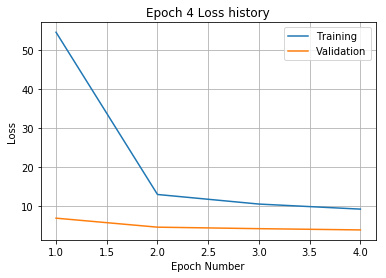

Training
Iteration 0: with minibatch training loss = 8.76 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 40: with minibatch training loss = 9.75 and relative error of 0.37
Iteration 60: with minibatch training loss = 9.97 and relative error of 0.37
Iteration 80: with minibatch training loss = 9.48 and relative error of 0.36
Iteration 100: with minibatch training loss = 7.68 and relative error of 0.33
Iteration 120: with minibatch training loss = 10.6 and relative error of 0.39
Iteration 140: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.11 and relative error of 0.34
Iteration 180: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 200: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 220: with minibatch training loss = 7.9 and relative error of 0.33
Epoch 5, Overall loss = 8.45, relative error = 0.333, and proces

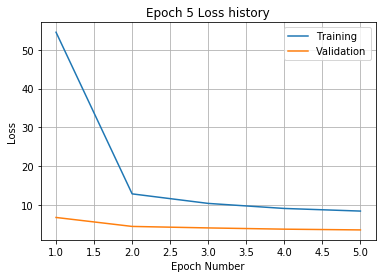

Training
Iteration 0: with minibatch training loss = 7 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.39 and relative error of 0.35
Iteration 60: with minibatch training loss = 5.22 and relative error of 0.25
Iteration 80: with minibatch training loss = 9.09 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.59 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 160: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 180: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 200: with minibatch training loss = 10.2 and relative error of 0.38
Iteration 220: with minibatch training loss = 5.56 and relative error of 0.26
Epoch 6, Overall loss = 7.85, relative error = 0.321, and process 

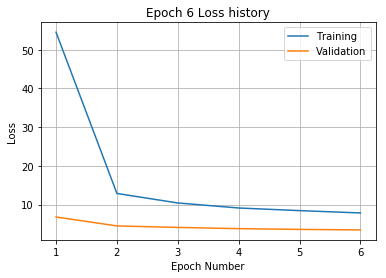

Training
Iteration 0: with minibatch training loss = 9.17 and relative error of 0.35
Iteration 20: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 40: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 60: with minibatch training loss = 7.73 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.6 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.33 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.1 and relative error of 0.33
Epoch 7, Overall loss = 7.45, relative error = 0.312, and proces

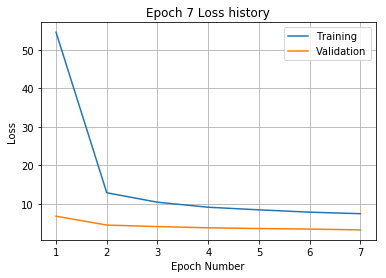

Training
Iteration 0: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.61 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.78 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.56 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.3 and relative error of 0.27
Epoch 8, Overall loss = 7.17, relative error = 0.306, and proces

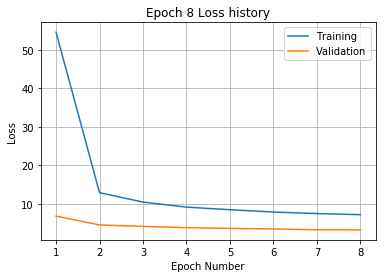

Training
Iteration 0: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.87 and relative error of 0.31
Iteration 60: with minibatch training loss = 9.49 and relative error of 0.36
Iteration 80: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.78 and relative error of 0.35
Iteration 120: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 140: with minibatch training loss = 8 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.38 and relative error of 0.32
Iteration 180: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.99 and relative error of 0.26
Epoch 9, Overall loss = 6.82, relative error = 0.299, and process t

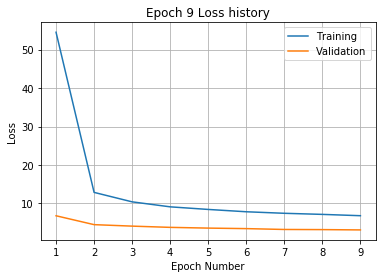

Training
Iteration 0: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 20: with minibatch training loss = 9.92 and relative error of 0.36
Iteration 40: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.51 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.03 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.59 and relative error of 0.27
Epoch 10, Overall loss = 6.57, relative error = 0.293, and pro

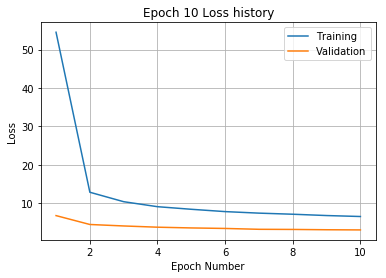

Training
Iteration 0: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.59 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.82 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.04 and relative error of 0.28
Epoch 11, Overall loss = 6.4, relative error = 0.29, and process

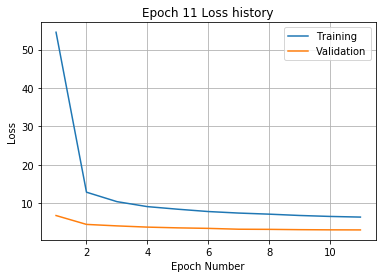

Training
Iteration 0: with minibatch training loss = 5.89 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.11 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 140: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.27 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.03 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.81 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.23 and relative error of 0.27
Epoch 12, Overall loss = 6.18, relative error = 0.285, and proces

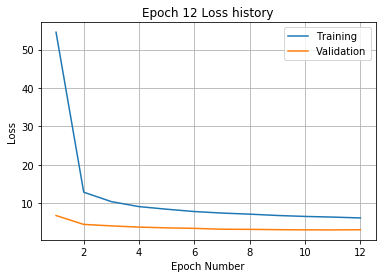

Training
Iteration 0: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.73 and relative error of 0.33
Iteration 60: with minibatch training loss = 4.75 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.56 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.75 and relative error of 0.27
Epoch 13, Overall loss = 6.05, relative error = 0.282, and proces

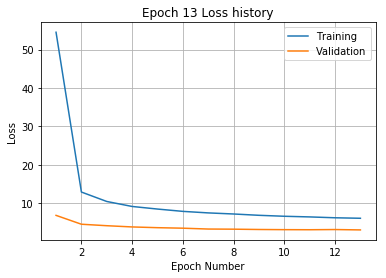

Training
Iteration 0: with minibatch training loss = 8.44 and relative error of 0.33
Iteration 20: with minibatch training loss = 3.8 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.07 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.66 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.98 and relative error of 0.27
Epoch 14, Overall loss = 5.84, relative error = 0.277, and proc

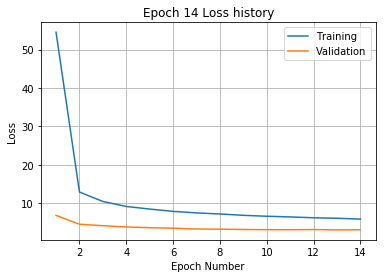

Training
Iteration 0: with minibatch training loss = 4.53 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.71 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 80: with minibatch training loss = 9.29 and relative error of 0.34
Iteration 100: with minibatch training loss = 6.02 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.74 and relative error of 0.3
Epoch 15, Overall loss = 5.79, relative error = 0.275, and process

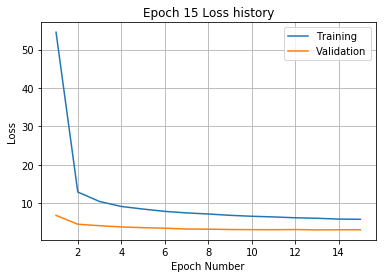

Training
Iteration 0: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 40: with minibatch training loss = 3.82 and relative error of 0.22
Iteration 60: with minibatch training loss = 6.82 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.04 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.13 and relative error of 0.27
Epoch 16, Overall loss = 5.55, relative error = 0.27, and proces

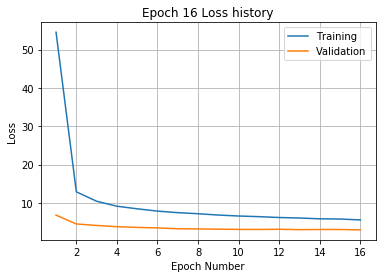

Training
Iteration 0: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 100: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 120: with minibatch training loss = 3.36 and relative error of 0.21
Iteration 140: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.45 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.29 and relative error of 0.3
Iteration 200: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.28 and relative error of 0.23
Epoch 17, Overall loss = 5.51, relative error = 0.268, and pro

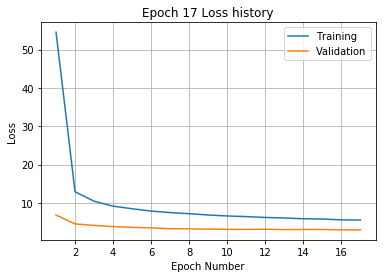

Training
Iteration 0: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 40: with minibatch training loss = 8.51 and relative error of 0.32
Iteration 60: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.72 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.87 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.55 and relative error of 0.24
Epoch 18, Overall loss = 5.38, relative error = 0.265, and pro

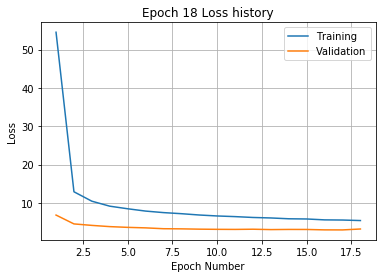

Training
Iteration 0: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.53 and relative error of 0.22
Iteration 40: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.22 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.52 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.97 and relative error of 0.22
Iteration 180: with minibatch training loss = 4.8 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.29 and relative error of 0.23
Epoch 19, Overall loss = 5.3, relative error = 0.263, and proc

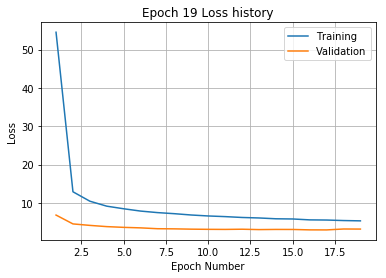

Training
Iteration 0: with minibatch training loss = 4.31 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.74 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.48 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.75 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.1 and relative error of 0.28
Epoch 20, Overall loss = 5.15, relative error = 0.26, and proce

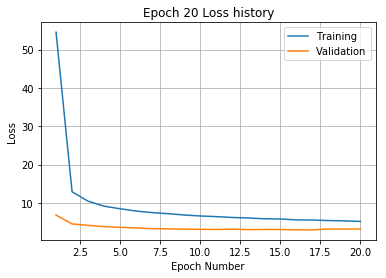

Training
Iteration 0: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 20: with minibatch training loss = 3.69 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.57 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.07 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.51 and relative error of 0.27
Epoch 21, Overall loss = 5.08, relative error = 0.258, and pro

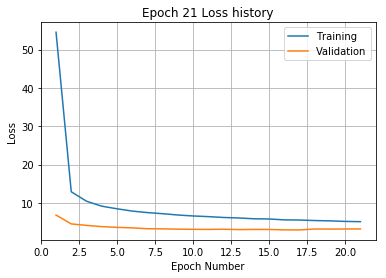

Training
Iteration 0: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.92 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.15 and relative error of 0.24
Iteration 120: with minibatch training loss = 8.17 and relative error of 0.34
Iteration 140: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.09 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.68 and relative error of 0.25
Epoch 22, Overall loss = 4.98, relative error = 0.255, and pr

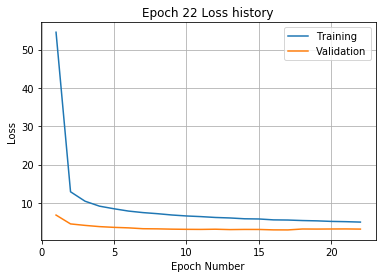

Validation error has stopped improving! Training on repetition 9 stopped!
Training
Iteration 0: with minibatch training loss = 242 and relative error of 1.7
Iteration 20: with minibatch training loss = 130 and relative error of 1.3
Iteration 40: with minibatch training loss = 81.6 and relative error of 1
Iteration 60: with minibatch training loss = 61.6 and relative error of 0.92
Iteration 80: with minibatch training loss = 45.2 and relative error of 0.76
Iteration 100: with minibatch training loss = 32.9 and relative error of 0.67
Iteration 120: with minibatch training loss = 31.1 and relative error of 0.62
Iteration 140: with minibatch training loss = 23.8 and relative error of 0.55
Iteration 160: with minibatch training loss = 19.8 and relative error of 0.52
Iteration 180: with minibatch training loss = 16 and relative error of 0.47
Iteration 200: with minibatch training loss = 15.8 and relative error of 0.45
Iteration 220: with minibatch training loss = 17.7 and relative error of 0

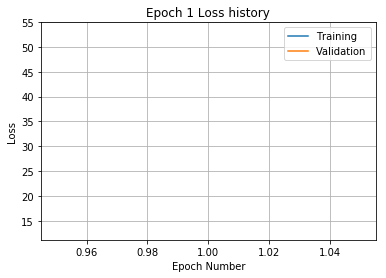

Training
Iteration 0: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 20: with minibatch training loss = 13.8 and relative error of 0.43
Iteration 40: with minibatch training loss = 15 and relative error of 0.44
Iteration 60: with minibatch training loss = 14.5 and relative error of 0.45
Iteration 80: with minibatch training loss = 13.9 and relative error of 0.44
Iteration 100: with minibatch training loss = 13 and relative error of 0.41
Iteration 120: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 140: with minibatch training loss = 14.3 and relative error of 0.42
Iteration 160: with minibatch training loss = 12 and relative error of 0.41
Iteration 180: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 200: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 220: with minibatch training loss = 12.4 and relative error of 0.39
Epoch 2, Overall loss = 13.3, relative error = 0.417, and process tim

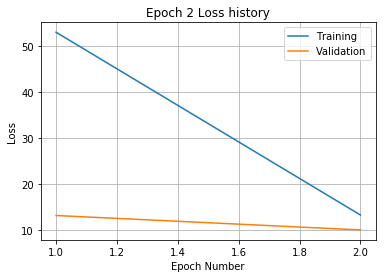

Training
Iteration 0: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 20: with minibatch training loss = 9.79 and relative error of 0.37
Iteration 40: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 60: with minibatch training loss = 9.35 and relative error of 0.34
Iteration 80: with minibatch training loss = 13 and relative error of 0.43
Iteration 100: with minibatch training loss = 12 and relative error of 0.39
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 140: with minibatch training loss = 9.02 and relative error of 0.34
Iteration 160: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.4 and relative error of 0.35
Iteration 200: with minibatch training loss = 9.66 and relative error of 0.35
Iteration 220: with minibatch training loss = 10.3 and relative error of 0.36
Epoch 3, Overall loss = 10.6, relative error = 0.372, and process 

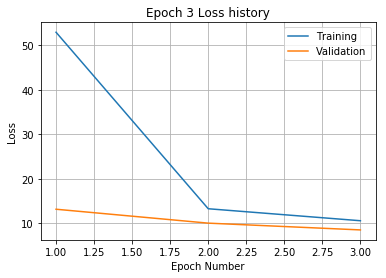

Training
Iteration 0: with minibatch training loss = 10.2 and relative error of 0.38
Iteration 20: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 40: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 60: with minibatch training loss = 11.8 and relative error of 0.4
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 100: with minibatch training loss = 9.44 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.12 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 160: with minibatch training loss = 8.77 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.93 and relative error of 0.31
Iteration 200: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 220: with minibatch training loss = 7.9 and relative error of 0.33
Epoch 4, Overall loss = 9.22, relative error = 0.347, and proce

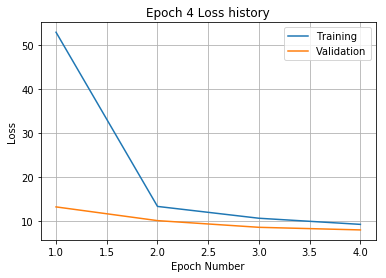

Training
Iteration 0: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 20: with minibatch training loss = 12 and relative error of 0.39
Iteration 40: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 60: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 100: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 120: with minibatch training loss = 8.92 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.45 and relative error of 0.34
Iteration 160: with minibatch training loss = 7.74 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.27 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.44 and relative error of 0.33
Iteration 220: with minibatch training loss = 5.75 and relative error of 0.28
Epoch 5, Overall loss = 8.43, relative error = 0.331, and proces

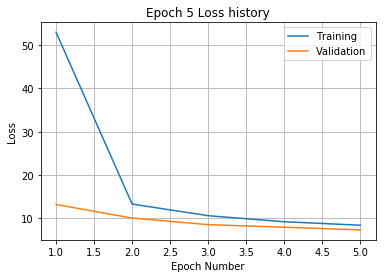

Training
Iteration 0: with minibatch training loss = 8.92 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.37 and relative error of 0.27
Iteration 40: with minibatch training loss = 9.17 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 80: with minibatch training loss = 8.34 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.1 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.37 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.64 and relative error of 0.32
Epoch 6, Overall loss = 7.71, relative error = 0.317, and process t

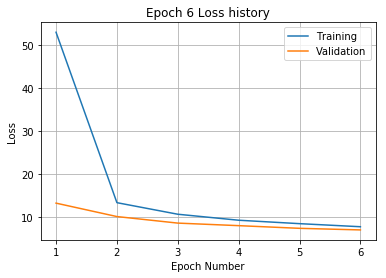

Training
Iteration 0: with minibatch training loss = 8.1 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.54 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 80: with minibatch training loss = 9.6 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.68 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.26 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 220: with minibatch training loss = 9.33 and relative error of 0.35
Epoch 7, Overall loss = 7.36, relative error = 0.31, and process t

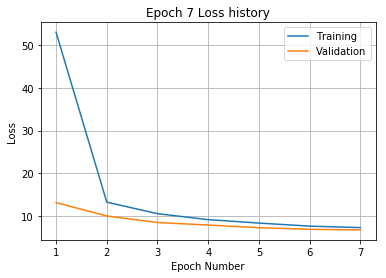

Training
Iteration 0: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.7 and relative error of 0.26
Iteration 40: with minibatch training loss = 8.27 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.35 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.94 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.68 and relative error of 0.33
Iteration 200: with minibatch training loss = 12.3 and relative error of 0.39
Iteration 220: with minibatch training loss = 5.61 and relative error of 0.27
Epoch 8, Overall loss = 6.93, relative error = 0.3, and process 

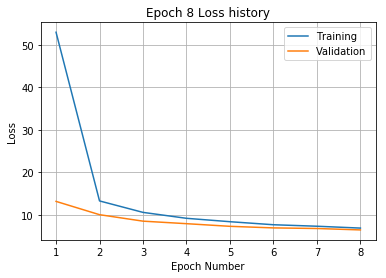

Training
Iteration 0: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.33 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.14 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.29 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.62 and relative error of 0.32
Iteration 200: with minibatch training loss = 4.7 and relative error of 0.26
Iteration 220: with minibatch training loss = 8.14 and relative error of 0.32
Epoch 9, Overall loss = 6.67, relative error = 0.294, and process 

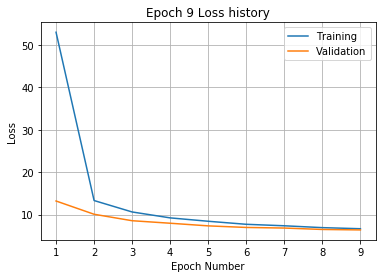

Training
Iteration 0: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.71 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.69 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.94 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.6 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.41 and relative error of 0.29
Epoch 10, Overall loss = 6.39, relative error = 0.288, and proce

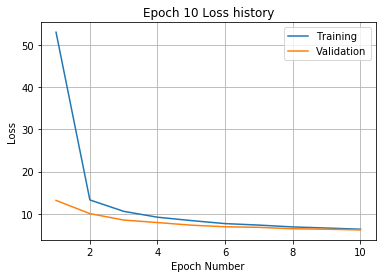

Training
Iteration 0: with minibatch training loss = 6.3 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.45 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 80: with minibatch training loss = 7.74 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.2 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.04 and relative error of 0.3
Epoch 11, Overall loss = 6.23, relative error = 0.285, and process

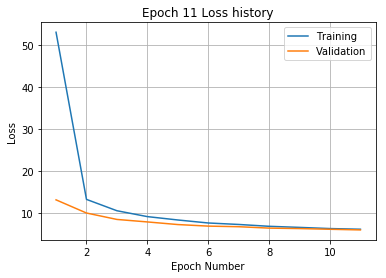

Training
Iteration 0: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.13 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.36 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.62 and relative error of 0.29
Epoch 12, Overall loss = 5.97, relative error = 0.278, and proces

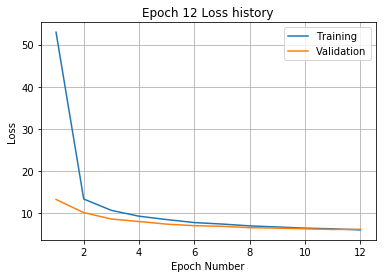

Training
Iteration 0: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.89 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.71 and relative error of 0.24
Iteration 80: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.22 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.22 and relative error of 0.26
Epoch 13, Overall loss = 5.82, relative error = 0.275, and proc

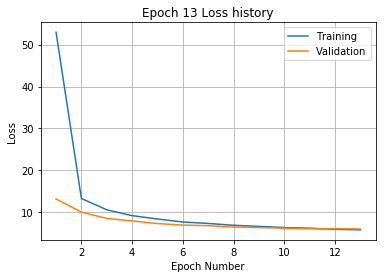

Training
Iteration 0: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.67 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.6 and relative error of 0.28
Iteration 60: with minibatch training loss = 3.98 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.59 and relative error of 0.24
Epoch 14, Overall loss = 5.66, relative error = 0.271, and pro

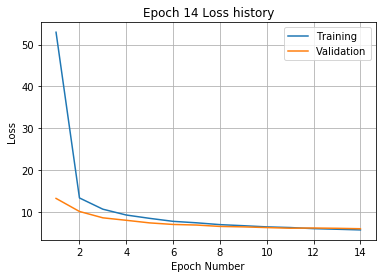

Training
Iteration 0: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.74 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 120: with minibatch training loss = 9.54 and relative error of 0.36
Iteration 140: with minibatch training loss = 3.94 and relative error of 0.22
Iteration 160: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.44 and relative error of 0.31
Epoch 15, Overall loss = 5.56, relative error = 0.269, and pr

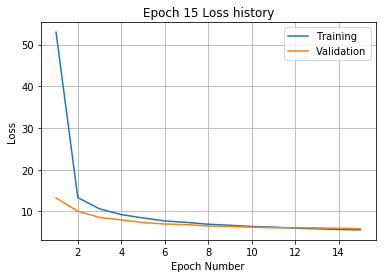

Training
Iteration 0: with minibatch training loss = 5.04 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.8 and relative error of 0.26
Iteration 40: with minibatch training loss = 5 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.08 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 120: with minibatch training loss = 7.21 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.64 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 200: with minibatch training loss = 3.93 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.39 and relative error of 0.27
Epoch 16, Overall loss = 5.47, relative error = 0.267, and process

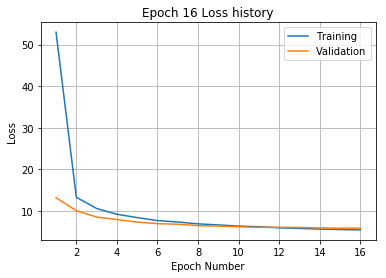

Training
Iteration 0: with minibatch training loss = 6.53 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 120: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 200: with minibatch training loss = 3.52 and relative error of 0.22
Iteration 220: with minibatch training loss = 4.58 and relative error of 0.24
Epoch 17, Overall loss = 5.36, relative error = 0.264, and proc

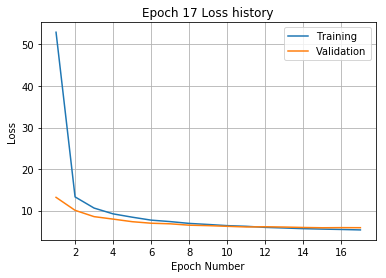

Training
Iteration 0: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 20: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.04 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.58 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.44 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.29 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.1 and relative error of 0.24
Iteration 200: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.3 and relative error of 0.27
Epoch 18, Overall loss = 5.26, relative error = 0.261, and proces

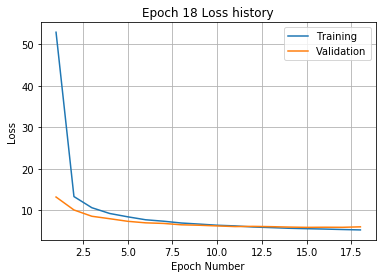

Training
Iteration 0: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.2 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.22 and relative error of 0.2
Iteration 100: with minibatch training loss = 4.17 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 140: with minibatch training loss = 3.51 and relative error of 0.22
Iteration 160: with minibatch training loss = 6.06 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.87 and relative error of 0.26
Epoch 19, Overall loss = 5.1, relative error = 0.257, and process

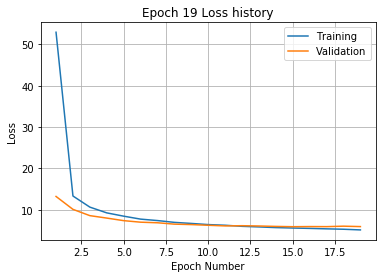

Training
Iteration 0: with minibatch training loss = 4.73 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.64 and relative error of 0.24
Iteration 40: with minibatch training loss = 3.92 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 100: with minibatch training loss = 3.23 and relative error of 0.2
Iteration 120: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 160: with minibatch training loss = 3.35 and relative error of 0.2
Iteration 180: with minibatch training loss = 4.31 and relative error of 0.23
Iteration 200: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.28 and relative error of 0.27
Epoch 20, Overall loss = 5.01, relative error = 0.255, and proc

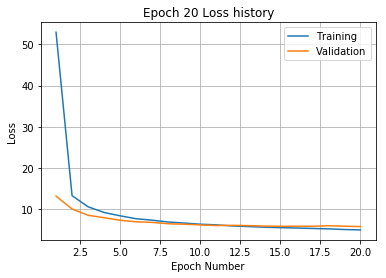

Training
Iteration 0: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 20: with minibatch training loss = 3.75 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.39 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.18 and relative error of 0.27
Epoch 21, Overall loss = 4.97, relative error = 0.254, and proc

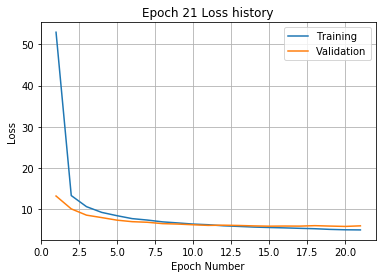

Training
Iteration 0: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 20: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 40: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 60: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.8 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 140: with minibatch training loss = 3.76 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.72 and relative error of 0.22
Epoch 22, Overall loss = 4.9, relative error = 0.252, and proce

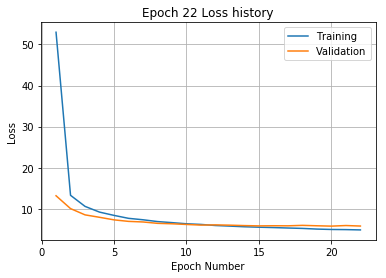

Training
Iteration 0: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.8 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 80: with minibatch training loss = 3.01 and relative error of 0.19
Iteration 100: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.01 and relative error of 0.23
Iteration 160: with minibatch training loss = 3.66 and relative error of 0.22
Iteration 180: with minibatch training loss = 5.13 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.02 and relative error of 0.26
Epoch 23, Overall loss = 4.71, relative error = 0.247, and pro

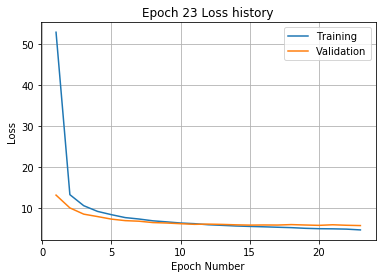

Training
Iteration 0: with minibatch training loss = 3.55 and relative error of 0.21
Iteration 20: with minibatch training loss = 5.16 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.56 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 100: with minibatch training loss = 6.04 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.07 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.5 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.19 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.57 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.97 and relative error of 0.27
Epoch 24, Overall loss = 4.68, relative error = 0.247, and proce

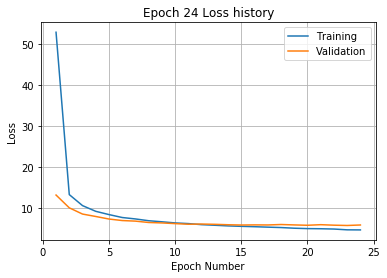

Training
Iteration 0: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.3 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 80: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.78 and relative error of 0.24
Iteration 120: with minibatch training loss = 3.19 and relative error of 0.2
Iteration 140: with minibatch training loss = 4.14 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 180: with minibatch training loss = 2.61 and relative error of 0.18
Iteration 200: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 220: with minibatch training loss = 3.28 and relative error of 0.21
Epoch 25, Overall loss = 4.61, relative error = 0.245, and proc

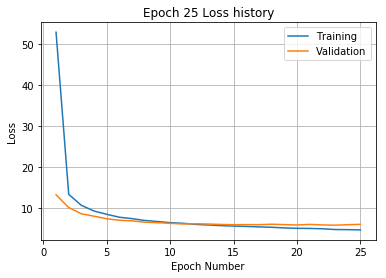

Training
Iteration 0: with minibatch training loss = 4.53 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 60: with minibatch training loss = 3.76 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 120: with minibatch training loss = 3.94 and relative error of 0.23
Iteration 140: with minibatch training loss = 3.14 and relative error of 0.2
Iteration 160: with minibatch training loss = 4.95 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.89 and relative error of 0.23
Epoch 26, Overall loss = 4.46, relative error = 0.241, and proc

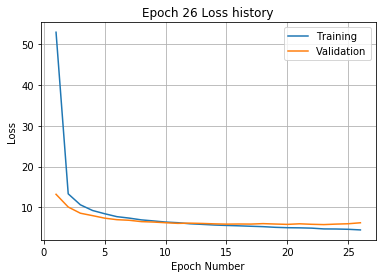

Training
Iteration 0: with minibatch training loss = 3.98 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 40: with minibatch training loss = 3.22 and relative error of 0.22
Iteration 60: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.87 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 140: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 180: with minibatch training loss = 2.54 and relative error of 0.18
Iteration 200: with minibatch training loss = 3.46 and relative error of 0.21
Iteration 220: with minibatch training loss = 4.86 and relative error of 0.25
Epoch 27, Overall loss = 4.43, relative error = 0.24, and pro

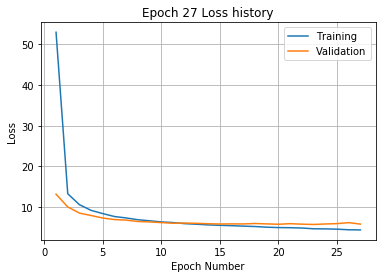

Training
Iteration 0: with minibatch training loss = 3.4 and relative error of 0.21
Iteration 20: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 60: with minibatch training loss = 7.46 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.38 and relative error of 0.23
Iteration 120: with minibatch training loss = 3.91 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.31 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.51 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.87 and relative error of 0.26
Epoch 28, Overall loss = 4.35, relative error = 0.237, and pro

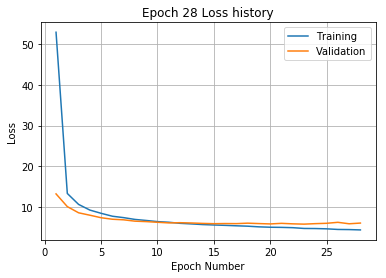

Validation error has stopped improving! Training on repetition 10 stopped!
log interval:  60 seconds
loading data
stacking image log's channels
Training
Iteration 0: with minibatch training loss = 306 and relative error of 2.1
Iteration 20: with minibatch training loss = 140 and relative error of 1.4
Iteration 40: with minibatch training loss = 90.6 and relative error of 1.1
Iteration 60: with minibatch training loss = 58.8 and relative error of 0.91
Iteration 80: with minibatch training loss = 51.4 and relative error of 0.83
Iteration 100: with minibatch training loss = 41.1 and relative error of 0.76
Iteration 120: with minibatch training loss = 30 and relative error of 0.64
Iteration 140: with minibatch training loss = 23.6 and relative error of 0.57
Iteration 160: with minibatch training loss = 21.1 and relative error of 0.53
Iteration 180: with minibatch training loss = 19.9 and relative error of 0.51
Iteration 200: with minibatch training loss = 17.2 and relative error of 0.47
It

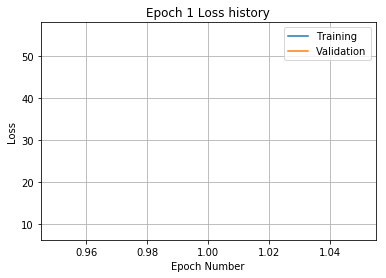

Training
Iteration 0: with minibatch training loss = 13.6 and relative error of 0.44
Iteration 20: with minibatch training loss = 14.8 and relative error of 0.44
Iteration 40: with minibatch training loss = 13.7 and relative error of 0.42
Iteration 60: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 80: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 100: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 120: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 140: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 160: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 180: with minibatch training loss = 11.7 and relative error of 0.39
Iteration 200: with minibatch training loss = 10.8 and relative error of 0.39
Iteration 220: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 240: with minibatch training loss = 11.3 and relati

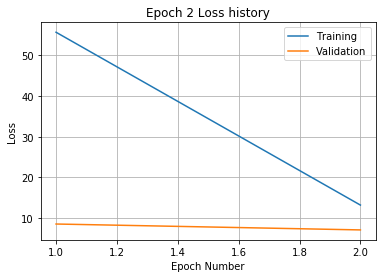

Training
Iteration 0: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 20: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 40: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 80: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 100: with minibatch training loss = 10.2 and relative error of 0.39
Iteration 120: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 140: with minibatch training loss = 11 and relative error of 0.38
Iteration 160: with minibatch training loss = 12.1 and relative error of 0.39
Iteration 180: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 200: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 220: with minibatch training loss = 9.27 and relative error of 0.36
Iteration 240: with minibatch training loss = 10.3 and relative 

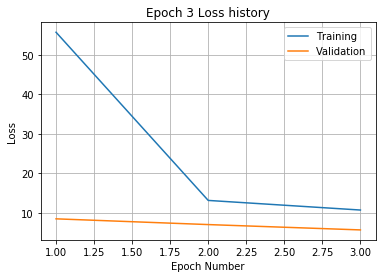

Training
Iteration 0: with minibatch training loss = 13.4 and relative error of 0.39
Iteration 20: with minibatch training loss = 9.6 and relative error of 0.36
Iteration 40: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.96 and relative error of 0.36
Iteration 80: with minibatch training loss = 7.37 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.96 and relative error of 0.34
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 140: with minibatch training loss = 13.7 and relative error of 0.41
Iteration 160: with minibatch training loss = 8.75 and relative error of 0.36
Iteration 180: with minibatch training loss = 8.79 and relative error of 0.35
Iteration 200: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 220: with minibatch training loss = 8.33 and relative error of 0.34
Iteration 240: with minibatch training loss = 8.49 and relative 

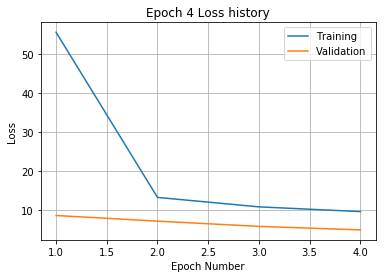

Training
Iteration 0: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.07 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.06 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.93 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.4 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.76 and relative error of 0.33
Iteration 160: with minibatch training loss = 8.09 and relative error of 0.32
Iteration 180: with minibatch training loss = 8 and relative error of 0.33
Iteration 200: with minibatch training loss = 9.39 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.56 and relative error of 0.31
Iteration 240: with minibatch training loss = 8.99 and relative erro

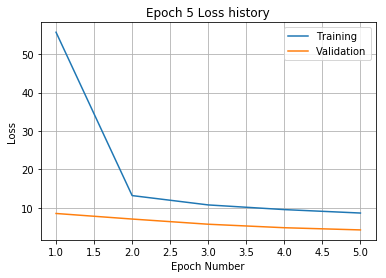

Training
Iteration 0: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 60: with minibatch training loss = 9.91 and relative error of 0.36
Iteration 80: with minibatch training loss = 9.76 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.43 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 140: with minibatch training loss = 9.62 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.19 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.92 and relative error of 0.35
Iteration 200: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 240: with minibatch training loss = 8.66 and relative 

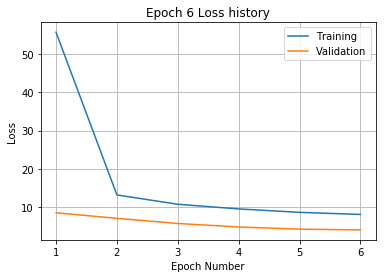

Training
Iteration 0: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 20: with minibatch training loss = 9.02 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.23 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.71 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.22 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 120: with minibatch training loss = 10 and relative error of 0.37
Iteration 140: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 240: with minibatch training loss = 7.1 and relative er

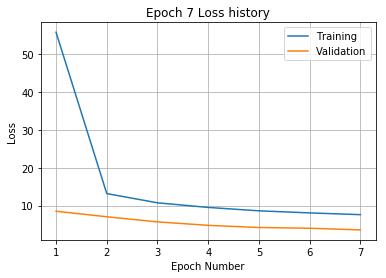

Training
Iteration 0: with minibatch training loss = 7.43 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 60: with minibatch training loss = 6 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 120: with minibatch training loss = 8.24 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.59 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.49 and relative e

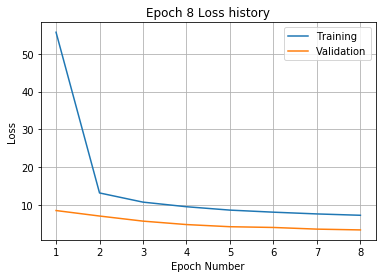

Training
Iteration 0: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 80: with minibatch training loss = 6 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.22 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.92 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.01 and relative erro

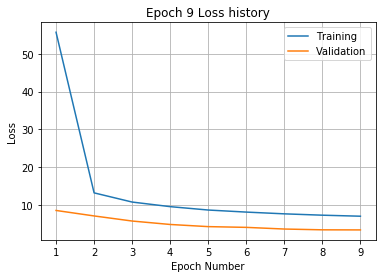

Training
Iteration 0: with minibatch training loss = 8.63 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 80: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 160: with minibatch training loss = 8.33 and relative error of 0.34
Iteration 180: with minibatch training loss = 8.32 and relative error of 0.33
Iteration 200: with minibatch training loss = 9.26 and relative error of 0.34
Iteration 220: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.69 and relative

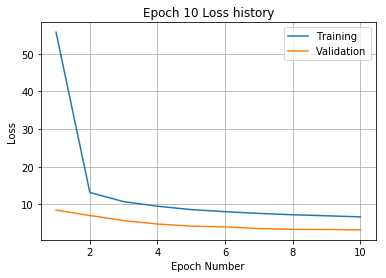

Training
Iteration 0: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.03 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.27 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.24 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.9 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.55 and relative er

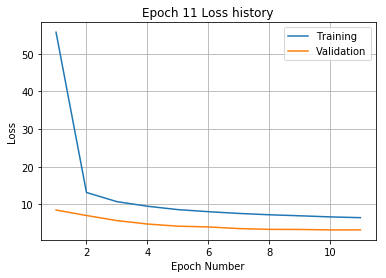

Training
Iteration 0: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.94 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.63 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.88 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.89 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.46 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 220: with minibatch training loss = 8.8 and relative error of 0.34
Iteration 240: with minibatch training loss = 6.29 and relative 

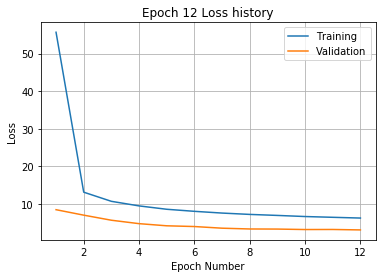

Training
Iteration 0: with minibatch training loss = 8.06 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.11 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.37 and relative error of 0.3
Iteration 220: with minibatch training loss = 5 and relative error of 0.24
Iteration 240: with minibatch training loss = 6.27 and relative err

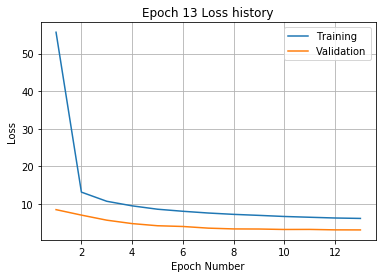

Training
Iteration 0: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.84 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.11 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.56 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.24 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.36 and relative erro

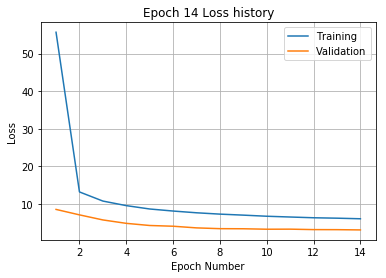

Training
Iteration 0: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.19 and relative error of 0.23
Iteration 100: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 120: with minibatch training loss = 3.62 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.66 and relative error of 0.26
Iteration 160: with minibatch training loss = 8.69 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.16 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 240: with minibatch training loss = 5.19 and relative

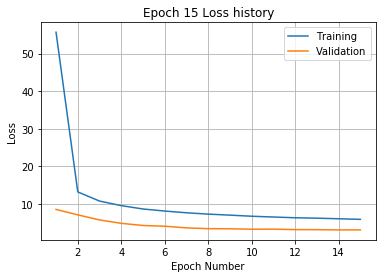

Training
Iteration 0: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.24 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.18 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.14 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.52 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.46 and relative 

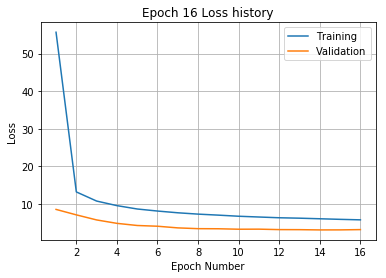

Training
Iteration 0: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.79 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.88 and relative

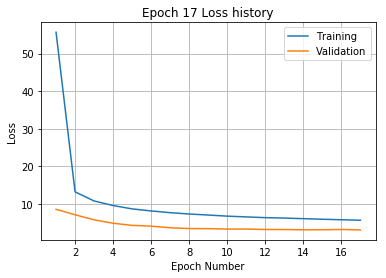

Training
Iteration 0: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.95 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.07 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.15 and relative error of 0.2
Iteration 240: with minibatch training loss = 3.9 and relative er

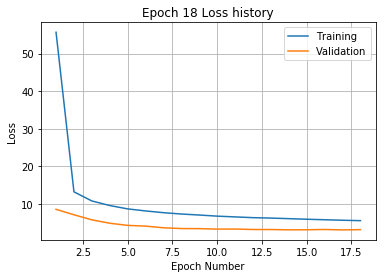

Training
Iteration 0: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.16 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.53 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.36 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.14 and relativ

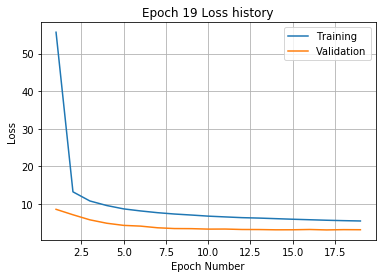

Training
Iteration 0: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.44 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.36 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.91 and relative error of 0.29
Iteration 140: with minibatch training loss = 3.29 and relative error of 0.21
Iteration 160: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.45 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.3 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.21 and relative

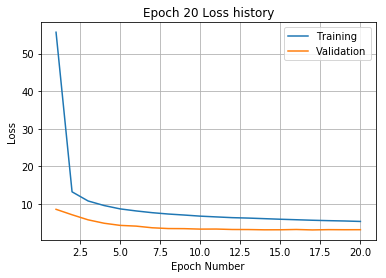

Training
Iteration 0: with minibatch training loss = 3.48 and relative error of 0.21
Iteration 20: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.37 and relative error of 0.23
Iteration 100: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.8 and relative error of 0.22
Iteration 180: with minibatch training loss = 6.62 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 240: with minibatch training loss = 3.82 and relative

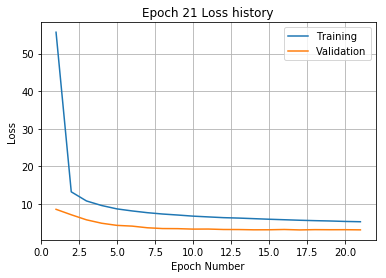

Training
Iteration 0: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.25 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.69 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.38 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 180: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 200: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 220: with minibatch training loss = 3.75 and relative error of 0.21
Iteration 240: with minibatch training loss = 5.43 and relative

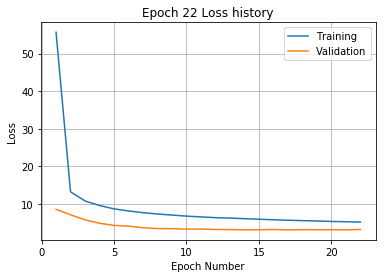

Validation error has stopped improving! Training on repetition 1 stopped!
Training
Iteration 0: with minibatch training loss = 208 and relative error of 1.6
Iteration 20: with minibatch training loss = 117 and relative error of 1.2
Iteration 40: with minibatch training loss = 73 and relative error of 0.99
Iteration 60: with minibatch training loss = 56.7 and relative error of 0.82
Iteration 80: with minibatch training loss = 37.2 and relative error of 0.69
Iteration 100: with minibatch training loss = 26 and relative error of 0.59
Iteration 120: with minibatch training loss = 23.2 and relative error of 0.55
Iteration 140: with minibatch training loss = 18 and relative error of 0.5
Iteration 160: with minibatch training loss = 14.2 and relative error of 0.43
Iteration 180: with minibatch training loss = 18.7 and relative error of 0.52
Iteration 200: with minibatch training loss = 14.5 and relative error of 0.42
Iteration 220: with minibatch training loss = 15 and relative error of 0.43


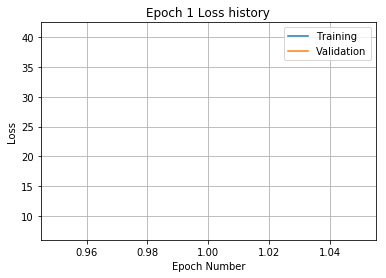

Training
Iteration 0: with minibatch training loss = 14.5 and relative error of 0.45
Iteration 20: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 40: with minibatch training loss = 12.4 and relative error of 0.41
Iteration 60: with minibatch training loss = 11 and relative error of 0.37
Iteration 80: with minibatch training loss = 11 and relative error of 0.38
Iteration 100: with minibatch training loss = 12.8 and relative error of 0.4
Iteration 120: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 140: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 160: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 180: with minibatch training loss = 12 and relative error of 0.39
Iteration 200: with minibatch training loss = 11.5 and relative error of 0.41
Iteration 220: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 240: with minibatch training loss = 9.65 and relative error

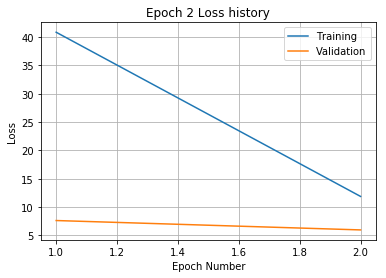

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 20: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 40: with minibatch training loss = 8.67 and relative error of 0.34
Iteration 60: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 80: with minibatch training loss = 9.11 and relative error of 0.33
Iteration 100: with minibatch training loss = 9.52 and relative error of 0.35
Iteration 120: with minibatch training loss = 8.08 and relative error of 0.32
Iteration 140: with minibatch training loss = 10.8 and relative error of 0.36
Iteration 160: with minibatch training loss = 9.89 and relative error of 0.36
Iteration 180: with minibatch training loss = 11.6 and relative error of 0.41
Iteration 200: with minibatch training loss = 10.6 and relative error of 0.35
Iteration 220: with minibatch training loss = 9.09 and relative error of 0.35
Iteration 240: with minibatch training loss = 7.49 and relativ

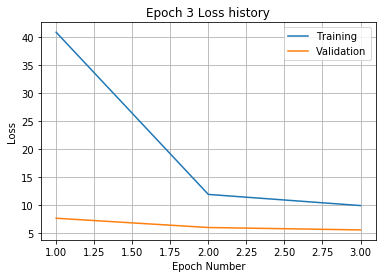

Training
Iteration 0: with minibatch training loss = 9.54 and relative error of 0.36
Iteration 20: with minibatch training loss = 8.53 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.66 and relative error of 0.36
Iteration 60: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 80: with minibatch training loss = 13 and relative error of 0.4
Iteration 100: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 120: with minibatch training loss = 7.86 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.07 and relative error of 0.35
Iteration 160: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 180: with minibatch training loss = 9.39 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.47 and relative error of 0.34
Iteration 220: with minibatch training loss = 11.8 and relative error of 0.38
Iteration 240: with minibatch training loss = 9.99 and relative e

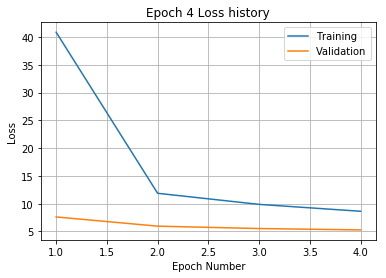

Training
Iteration 0: with minibatch training loss = 7.56 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 40: with minibatch training loss = 8.1 and relative error of 0.32
Iteration 60: with minibatch training loss = 9.46 and relative error of 0.36
Iteration 80: with minibatch training loss = 9.11 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 160: with minibatch training loss = 8.94 and relative error of 0.33
Iteration 180: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 200: with minibatch training loss = 8.61 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 240: with minibatch training loss = 8.38 and relative 

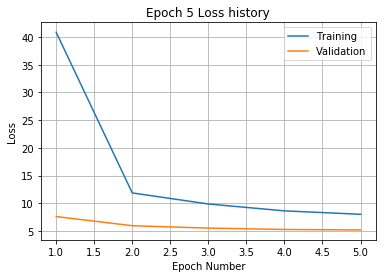

Training
Iteration 0: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.95 and relative error of 0.34
Iteration 80: with minibatch training loss = 5.13 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 160: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.18 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 240: with minibatch training loss = 7.44 and relative 

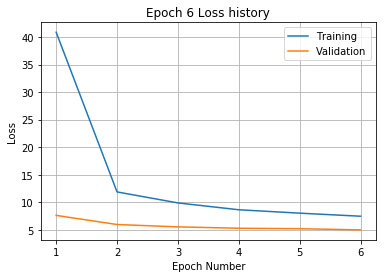

Training
Iteration 0: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.87 and relative error of 0.29
Iteration 60: with minibatch training loss = 9.74 and relative error of 0.36
Iteration 80: with minibatch training loss = 7.72 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.11 and relative error of 0.27
Iteration 120: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.06 and relative 

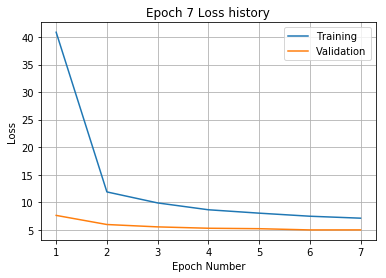

Training
Iteration 0: with minibatch training loss = 8.24 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 60: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 80: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 220: with minibatch training loss = 8.01 and relative error of 0.31
Iteration 240: with minibatch training loss = 7.95 and relative

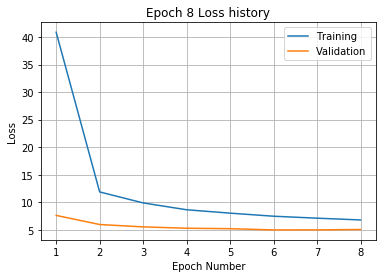

Training
Iteration 0: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.47 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.28 and relative error of 0.25
Iteration 80: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.93 and relative e

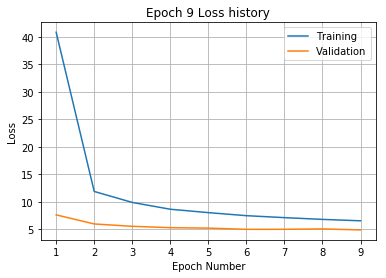

Training
Iteration 0: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.78 and relative error of 0.26
Iteration 80: with minibatch training loss = 9.01 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.75 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.1 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.49 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.8 and relative error of 0.32
Iteration 240: with minibatch training loss = 7.14 and relative e

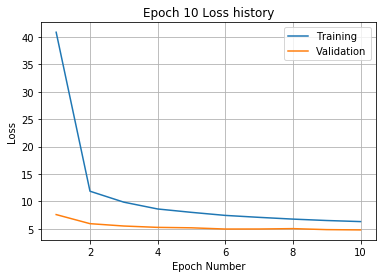

Training
Iteration 0: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 160: with minibatch training loss = 8.18 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.85 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.65 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.93 and relative error of 0.33
Iteration 240: with minibatch training loss = 6.02 and relative

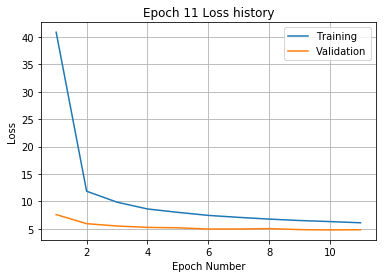

Training
Iteration 0: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.06 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.38 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.77 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.19 and relative

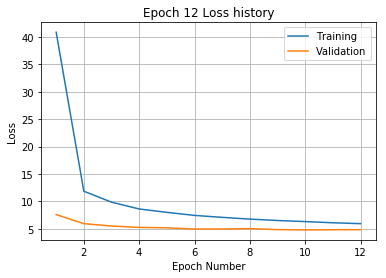

Training
Iteration 0: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.05 and relative error of 0.22
Iteration 40: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 60: with minibatch training loss = 4 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.72 and relative error of 0.23
Iteration 120: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.53 and relative error of 0.34
Iteration 160: with minibatch training loss = 4.67 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.84 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.12 and relative err

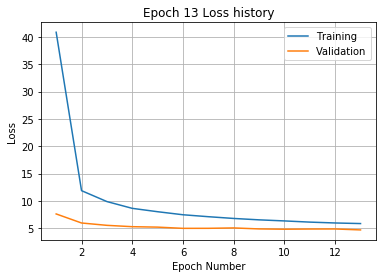

Training
Iteration 0: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.38 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.6 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.05 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.76 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.1 and relative e

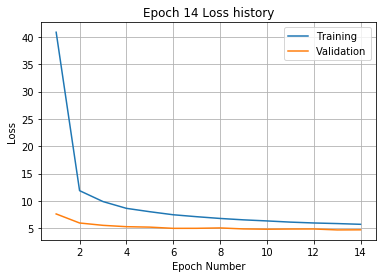

Training
Iteration 0: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.18 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.12 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 160: with minibatch training loss = 7.86 and relative error of 0.33
Iteration 180: with minibatch training loss = 5.07 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.16 and relati

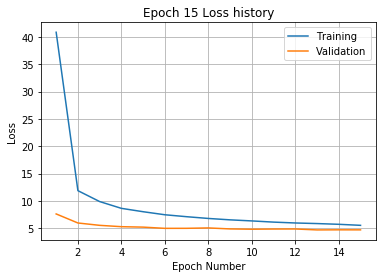

Training
Iteration 0: with minibatch training loss = 5.69 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.35 and relative error of 0.26
Iteration 60: with minibatch training loss = 3.35 and relative error of 0.21
Iteration 80: with minibatch training loss = 4.38 and relative error of 0.23
Iteration 100: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.85 and relative error of 0.22
Iteration 240: with minibatch training loss = 6.18 and relative 

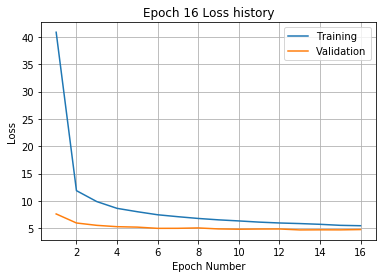

Training
Iteration 0: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 60: with minibatch training loss = 3.71 and relative error of 0.21
Iteration 80: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.19 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.12 and relative error of 0.25
Iteration 220: with minibatch training loss = 5 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.41 and relative e

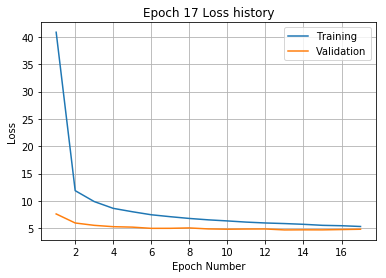

Training
Iteration 0: with minibatch training loss = 4.17 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.67 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.87 and relative

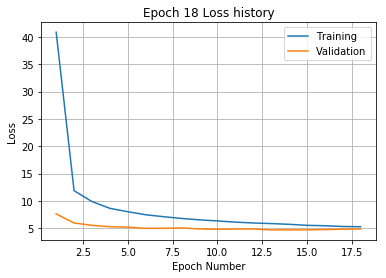

Validation error has stopped improving! Training on repetition 2 stopped!
Training
Iteration 0: with minibatch training loss = 262 and relative error of 1.9
Iteration 20: with minibatch training loss = 145 and relative error of 1.4
Iteration 40: with minibatch training loss = 87.1 and relative error of 1.1
Iteration 60: with minibatch training loss = 65 and relative error of 0.91
Iteration 80: with minibatch training loss = 49.4 and relative error of 0.81
Iteration 100: with minibatch training loss = 38.6 and relative error of 0.69
Iteration 120: with minibatch training loss = 31.2 and relative error of 0.62
Iteration 140: with minibatch training loss = 24.4 and relative error of 0.56
Iteration 160: with minibatch training loss = 16.9 and relative error of 0.48
Iteration 180: with minibatch training loss = 13.9 and relative error of 0.42
Iteration 200: with minibatch training loss = 16.5 and relative error of 0.48
Iteration 220: with minibatch training loss = 16.1 and relative error of

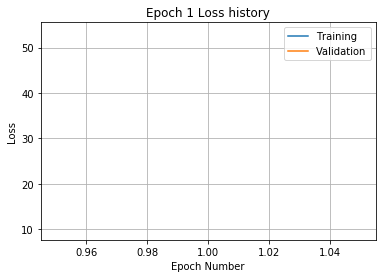

Training
Iteration 0: with minibatch training loss = 14.1 and relative error of 0.44
Iteration 20: with minibatch training loss = 15.2 and relative error of 0.43
Iteration 40: with minibatch training loss = 17.1 and relative error of 0.47
Iteration 60: with minibatch training loss = 14.5 and relative error of 0.42
Iteration 80: with minibatch training loss = 14.6 and relative error of 0.43
Iteration 100: with minibatch training loss = 13.5 and relative error of 0.43
Iteration 120: with minibatch training loss = 12.4 and relative error of 0.41
Iteration 140: with minibatch training loss = 13.2 and relative error of 0.41
Iteration 160: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 180: with minibatch training loss = 9.86 and relative error of 0.37
Iteration 200: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 220: with minibatch training loss = 13.2 and relative error of 0.42
Iteration 240: with minibatch training loss = 8.9 and relative

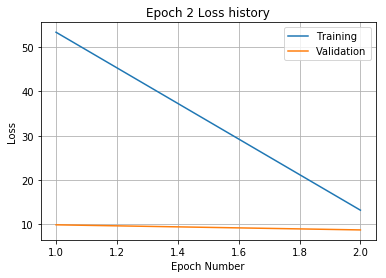

Training
Iteration 0: with minibatch training loss = 8.46 and relative error of 0.34
Iteration 20: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 40: with minibatch training loss = 9.69 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.55 and relative error of 0.34
Iteration 80: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 100: with minibatch training loss = 9.57 and relative error of 0.35
Iteration 120: with minibatch training loss = 9.63 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.28 and relative error of 0.33
Iteration 160: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 180: with minibatch training loss = 8.07 and relative error of 0.32
Iteration 200: with minibatch training loss = 12.1 and relative error of 0.39
Iteration 220: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 240: with minibatch training loss = 11.4 and relati

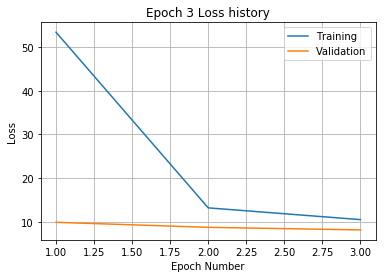

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 20: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 60: with minibatch training loss = 14.9 and relative error of 0.42
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 100: with minibatch training loss = 8.9 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 140: with minibatch training loss = 9.74 and relative error of 0.36
Iteration 160: with minibatch training loss = 7.75 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.8 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 220: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 240: with minibatch training loss = 10.2 and relative 

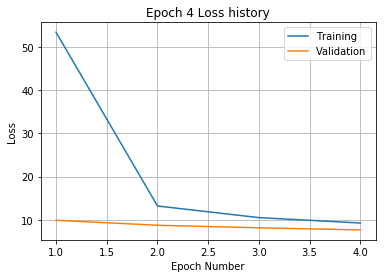

Training
Iteration 0: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 20: with minibatch training loss = 9.9 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 60: with minibatch training loss = 11.5 and relative error of 0.41
Iteration 80: with minibatch training loss = 9.36 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.21 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.37 and relative error of 0.34
Iteration 140: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 160: with minibatch training loss = 9.57 and relative error of 0.34
Iteration 180: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 200: with minibatch training loss = 9.06 and relative error of 0.34
Iteration 220: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.64 and relative

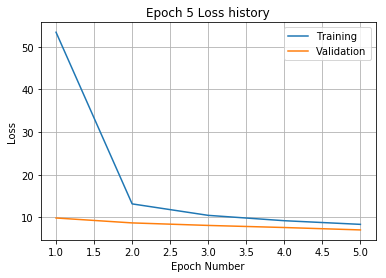

Training
Iteration 0: with minibatch training loss = 11.2 and relative error of 0.4
Iteration 20: with minibatch training loss = 8.03 and relative error of 0.32
Iteration 40: with minibatch training loss = 9.69 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.15 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.59 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.73 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.05 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.84 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.69 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.48 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.53 and relative error of 0.32
Iteration 240: with minibatch training loss = 7.29 and relativ

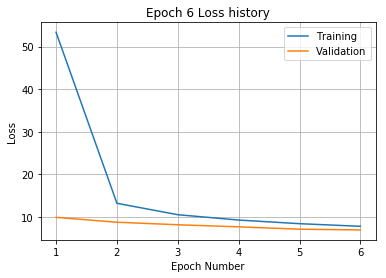

Training
Iteration 0: with minibatch training loss = 7.52 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.88 and relative error of 0.33
Iteration 40: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 60: with minibatch training loss = 8 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.94 and relative error of 0.31
Iteration 120: with minibatch training loss = 9.27 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.64 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.75 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 220: with minibatch training loss = 8.38 and relative error of 0.34
Iteration 240: with minibatch training loss = 7.59 and relative err

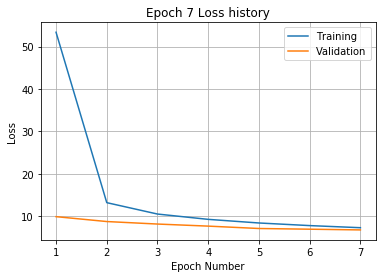

Training
Iteration 0: with minibatch training loss = 8.87 and relative error of 0.35
Iteration 20: with minibatch training loss = 8.37 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.85 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.76 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.75 and relative error of 0.34
Iteration 160: with minibatch training loss = 5.81 and relative error of 0.26
Iteration 180: with minibatch training loss = 9.21 and relative error of 0.36
Iteration 200: with minibatch training loss = 6.87 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.84 and relativ

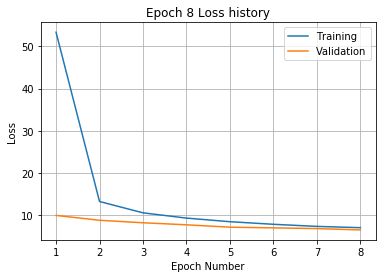

Training
Iteration 0: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.43 and relative error of 0.34
Iteration 100: with minibatch training loss = 5.25 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.39 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.69 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.17 and relative e

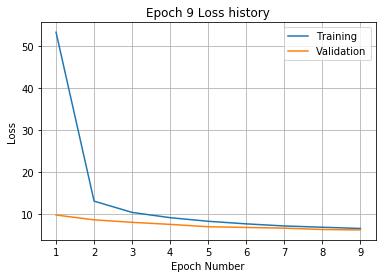

Training
Iteration 0: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.99 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.17 and relative error of 0.29
Iteration 180: with minibatch training loss = 9.43 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.28 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 240: with minibatch training loss = 6.87 and relative

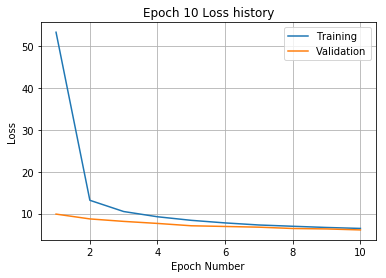

Training
Iteration 0: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.35 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.51 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 180: with minibatch training loss = 7.81 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.29 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.98 and relativ

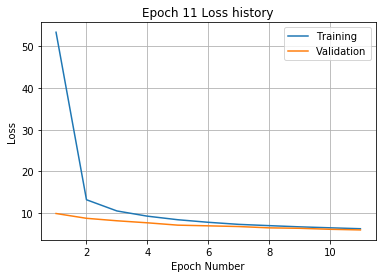

Training
Iteration 0: with minibatch training loss = 7.65 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.86 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.48 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.07 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 240: with minibatch training loss = 4.45 and relative

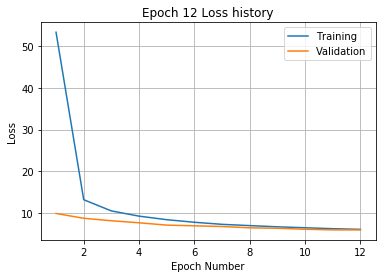

Training
Iteration 0: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 40: with minibatch training loss = 8.77 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.92 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.67 and relativ

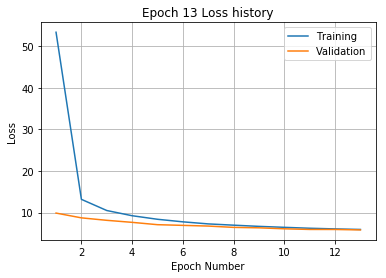

Training
Iteration 0: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 40: with minibatch training loss = 5 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.32 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 240: with minibatch training loss = 5.16 and relative e

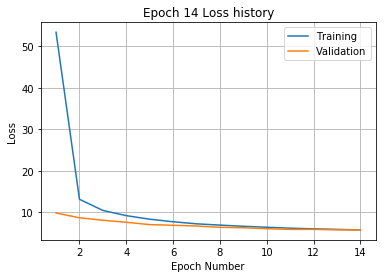

Training
Iteration 0: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.74 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.69 and relative error of 0.32
Iteration 120: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 240: with minibatch training loss = 6.13 and relative

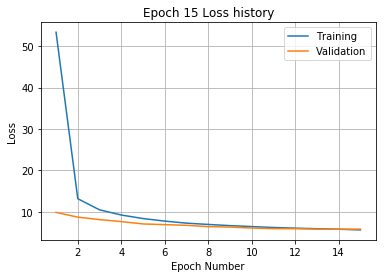

Training
Iteration 0: with minibatch training loss = 4.02 and relative error of 0.22
Iteration 20: with minibatch training loss = 7.94 and relative error of 0.31
Iteration 40: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 100: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.51 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 220: with minibatch training loss = 3.46 and relative error of 0.2
Iteration 240: with minibatch training loss = 7.25 and relative

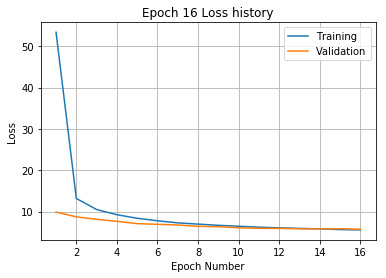

Training
Iteration 0: with minibatch training loss = 3.92 and relative error of 0.22
Iteration 20: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 80: with minibatch training loss = 6.05 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.81 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.36 and relati

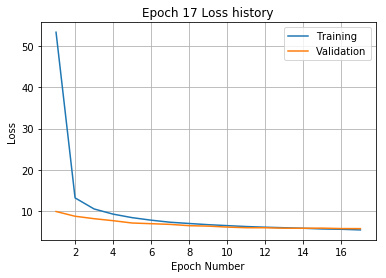

Training
Iteration 0: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.91 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.38 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 160: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 240: with minibatch training loss = 4.34 and relative

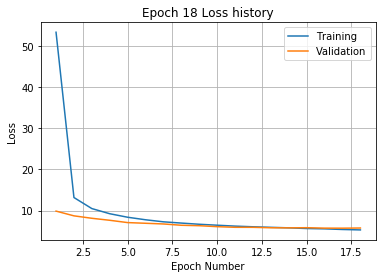

Training
Iteration 0: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.01 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.47 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.25 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.66 and relativ

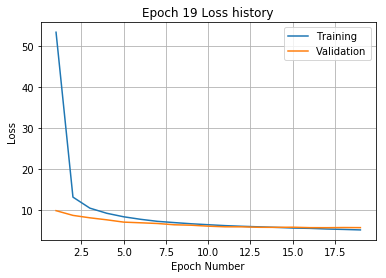

Training
Iteration 0: with minibatch training loss = 3.65 and relative error of 0.22
Iteration 20: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.17 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.19 and relative

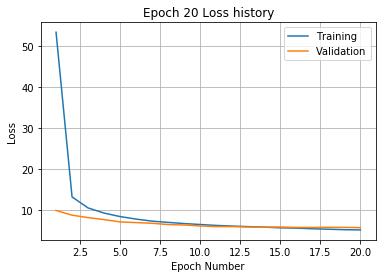

Training
Iteration 0: with minibatch training loss = 5.07 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 40: with minibatch training loss = 3.67 and relative error of 0.22
Iteration 60: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.67 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.3 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 180: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 200: with minibatch training loss = 5.12 and relative error of 0.25
Iteration 220: with minibatch training loss = 3.67 and relative error of 0.22
Iteration 240: with minibatch training loss = 5.29 and relative

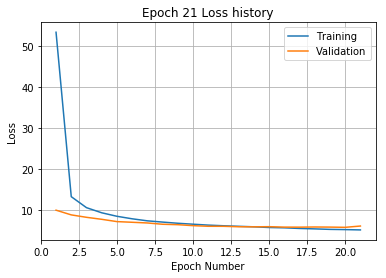

Training
Iteration 0: with minibatch training loss = 4.3 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.43 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.01 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 180: with minibatch training loss = 3.2 and relative error of 0.2
Iteration 200: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.16 and relative error of 0.23
Iteration 240: with minibatch training loss = 4.1 and relative err

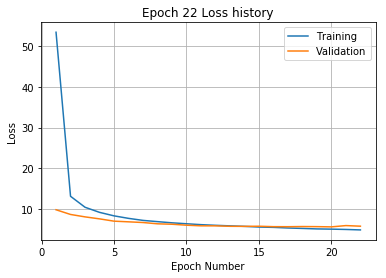

Training
Iteration 0: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.68 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.31 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.82 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.46 and relative error of 0.22
Iteration 240: with minibatch training loss = 6.3 and relative 

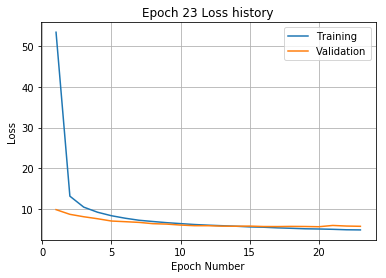

Training
Iteration 0: with minibatch training loss = 6.71 and relative error of 0.31
Iteration 20: with minibatch training loss = 3.12 and relative error of 0.22
Iteration 40: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 100: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.44 and relative error of 0.21
Iteration 160: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 180: with minibatch training loss = 3.95 and relative error of 0.22
Iteration 200: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.64 and relative error of 0.21
Iteration 240: with minibatch training loss = 8.16 and relati

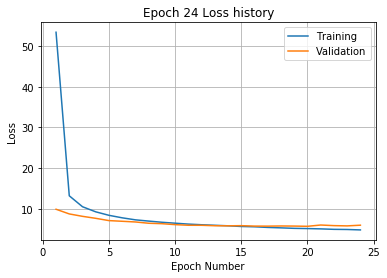

Training
Iteration 0: with minibatch training loss = 2.82 and relative error of 0.19
Iteration 20: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 60: with minibatch training loss = 3.23 and relative error of 0.21
Iteration 80: with minibatch training loss = 4.51 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.29 and relative error of 0.22
Iteration 120: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 140: with minibatch training loss = 3.63 and relative error of 0.21
Iteration 160: with minibatch training loss = 2.95 and relative error of 0.2
Iteration 180: with minibatch training loss = 3.98 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 240: with minibatch training loss = 6.62 and relative

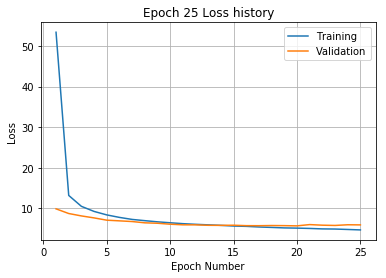

Validation error has stopped improving! Training on repetition 3 stopped!
Training
Iteration 0: with minibatch training loss = 199 and relative error of 1.6
Iteration 20: with minibatch training loss = 101 and relative error of 1.2
Iteration 40: with minibatch training loss = 72.5 and relative error of 0.96
Iteration 60: with minibatch training loss = 52.3 and relative error of 0.84
Iteration 80: with minibatch training loss = 35 and relative error of 0.65
Iteration 100: with minibatch training loss = 23.5 and relative error of 0.58
Iteration 120: with minibatch training loss = 21.8 and relative error of 0.52
Iteration 140: with minibatch training loss = 17.9 and relative error of 0.52
Iteration 160: with minibatch training loss = 18.3 and relative error of 0.49
Iteration 180: with minibatch training loss = 16 and relative error of 0.45
Iteration 200: with minibatch training loss = 18.3 and relative error of 0.48
Iteration 220: with minibatch training loss = 13.3 and relative error of 

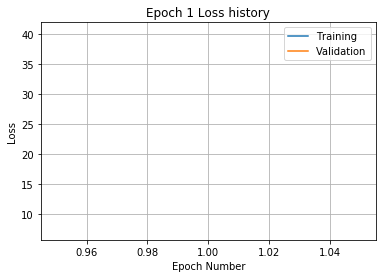

Training
Iteration 0: with minibatch training loss = 14.9 and relative error of 0.42
Iteration 20: with minibatch training loss = 13.6 and relative error of 0.43
Iteration 40: with minibatch training loss = 11.3 and relative error of 0.4
Iteration 60: with minibatch training loss = 13.1 and relative error of 0.42
Iteration 80: with minibatch training loss = 9.53 and relative error of 0.36
Iteration 100: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 120: with minibatch training loss = 12.9 and relative error of 0.39
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 160: with minibatch training loss = 8.39 and relative error of 0.33
Iteration 180: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 200: with minibatch training loss = 8.39 and relative error of 0.34
Iteration 220: with minibatch training loss = 9.47 and relative error of 0.36
Iteration 240: with minibatch training loss = 8.28 and relativ

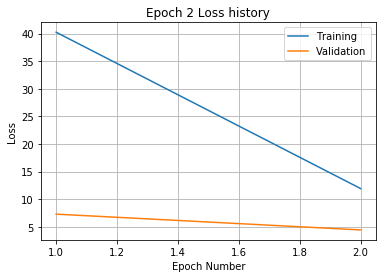

Training
Iteration 0: with minibatch training loss = 9.21 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.45 and relative error of 0.34
Iteration 40: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 60: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 80: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 100: with minibatch training loss = 9.65 and relative error of 0.35
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.38
Iteration 140: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 160: with minibatch training loss = 12 and relative error of 0.39
Iteration 180: with minibatch training loss = 13 and relative error of 0.41
Iteration 200: with minibatch training loss = 8.09 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.92 and relative error of 0.34
Iteration 240: with minibatch training loss = 10.4 and relative e

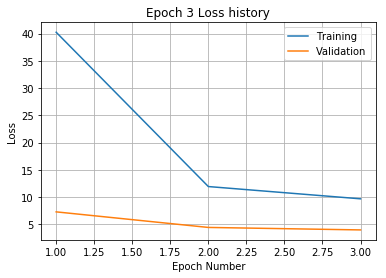

Training
Iteration 0: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.91 and relative error of 0.36
Iteration 40: with minibatch training loss = 9.56 and relative error of 0.36
Iteration 60: with minibatch training loss = 7.99 and relative error of 0.33
Iteration 80: with minibatch training loss = 9.28 and relative error of 0.36
Iteration 100: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.21 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.25 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.05 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.95 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 240: with minibatch training loss = 8.89 and relativ

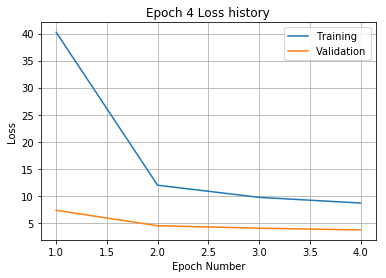

Training
Iteration 0: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 40: with minibatch training loss = 11 and relative error of 0.36
Iteration 60: with minibatch training loss = 6.83 and relative error of 0.31
Iteration 80: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 100: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.71 and relative error of 0.34
Iteration 160: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.17 and relative error of 0.3
Iteration 200: with minibatch training loss = 8.32 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 240: with minibatch training loss = 7.62 and relative err

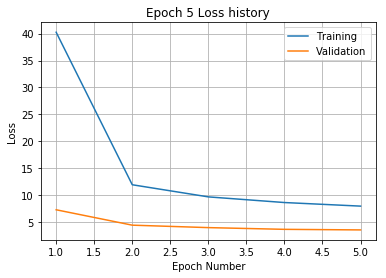

Training
Iteration 0: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.43 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.57 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.58 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 140: with minibatch training loss = 9.15 and relative error of 0.36
Iteration 160: with minibatch training loss = 8.76 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.48 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 240: with minibatch training loss = 5.7 and relative

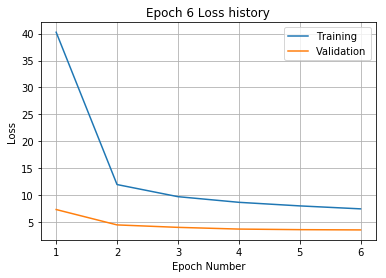

Training
Iteration 0: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.25 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.34 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.63 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.04 and relative error of 0.29
Iteration 240: with minibatch training loss = 7.11 and relative

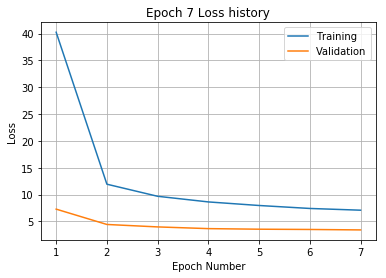

Training
Iteration 0: with minibatch training loss = 9.27 and relative error of 0.36
Iteration 20: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.5 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.96 and relative error of 0.22
Iteration 140: with minibatch training loss = 6.82 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.35 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.08 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.62 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 240: with minibatch training loss = 6.43 and relative e

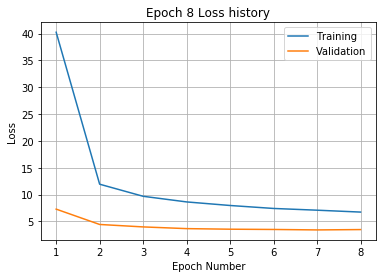

Training
Iteration 0: with minibatch training loss = 9.29 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.94 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.66 and relative error of 0.28
Iteration 60: with minibatch training loss = 9.57 and relative error of 0.35
Iteration 80: with minibatch training loss = 4.36 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.46 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.98 and relative

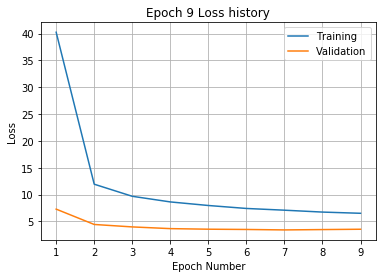

Training
Iteration 0: with minibatch training loss = 6.31 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 60: with minibatch training loss = 8.87 and relative error of 0.34
Iteration 80: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.92 and relative error of 0.3
Iteration 160: with minibatch training loss = 8.15 and relative error of 0.34
Iteration 180: with minibatch training loss = 3.93 and relative error of 0.24
Iteration 200: with minibatch training loss = 8.29 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.84 and relative error of 0.33
Iteration 240: with minibatch training loss = 4.83 and relative

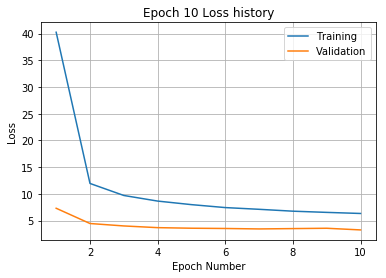

Training
Iteration 0: with minibatch training loss = 6.38 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.09 and relative error of 0.33
Iteration 60: with minibatch training loss = 7.04 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.71 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 160: with minibatch training loss = 8.78 and relative error of 0.34
Iteration 180: with minibatch training loss = 8.87 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 240: with minibatch training loss = 8.47 and relative e

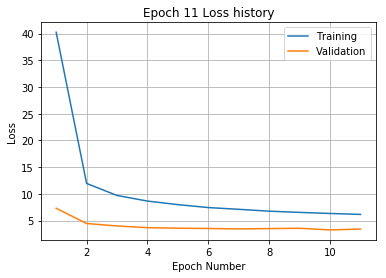

Training
Iteration 0: with minibatch training loss = 7.62 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.69 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.18 and relative

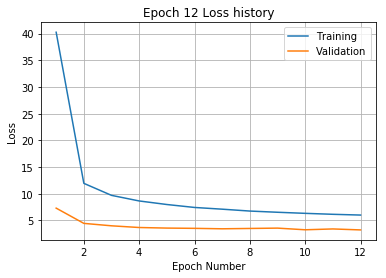

Training
Iteration 0: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.41 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.07 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.2 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.34 and relative e

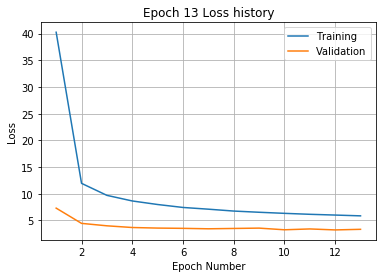

Training
Iteration 0: with minibatch training loss = 6.78 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.41 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.77 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 240: with minibatch training loss = 4.62 and relativ

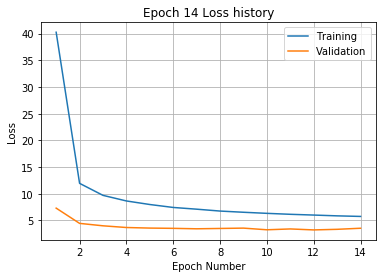

Training
Iteration 0: with minibatch training loss = 4.76 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.93 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.13 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.15 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 200: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 240: with minibatch training loss = 7.47 and relati

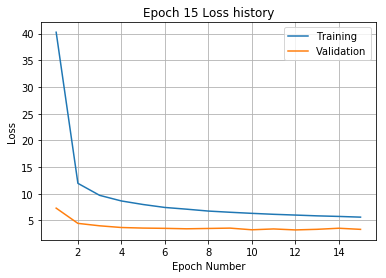

Training
Iteration 0: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.85 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 60: with minibatch training loss = 3.48 and relative error of 0.21
Iteration 80: with minibatch training loss = 7.36 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.88 and relativ

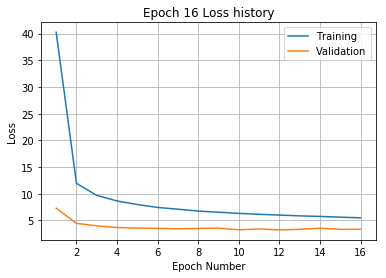

Training
Iteration 0: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 240: with minibatch training loss = 6.08 and relative e

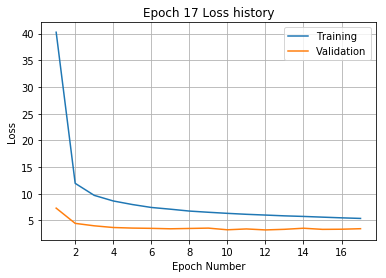

Validation error has stopped improving! Training on repetition 4 stopped!
Training
Iteration 0: with minibatch training loss = 204 and relative error of 1.6
Iteration 20: with minibatch training loss = 128 and relative error of 1.3
Iteration 40: with minibatch training loss = 72.9 and relative error of 0.99
Iteration 60: with minibatch training loss = 57.9 and relative error of 0.85
Iteration 80: with minibatch training loss = 38.5 and relative error of 0.71
Iteration 100: with minibatch training loss = 30.5 and relative error of 0.63
Iteration 120: with minibatch training loss = 20.5 and relative error of 0.53
Iteration 140: with minibatch training loss = 18.5 and relative error of 0.5
Iteration 160: with minibatch training loss = 16.4 and relative error of 0.47
Iteration 180: with minibatch training loss = 15.4 and relative error of 0.44
Iteration 200: with minibatch training loss = 15.2 and relative error of 0.45
Iteration 220: with minibatch training loss = 12.7 and relative error 

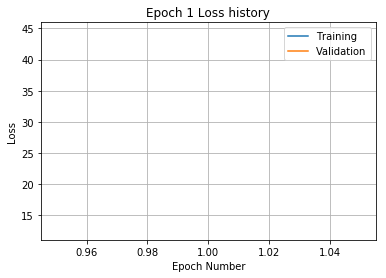

Training
Iteration 0: with minibatch training loss = 13.6 and relative error of 0.43
Iteration 20: with minibatch training loss = 14.7 and relative error of 0.45
Iteration 40: with minibatch training loss = 12.9 and relative error of 0.4
Iteration 60: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 80: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 100: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 120: with minibatch training loss = 10.9 and relative error of 0.36
Iteration 140: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 160: with minibatch training loss = 13.1 and relative error of 0.43
Iteration 180: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 200: with minibatch training loss = 9.37 and relative error of 0.35
Iteration 220: with minibatch training loss = 11.8 and relative error of 0.38
Iteration 240: with minibatch training loss = 12.3 and relativ

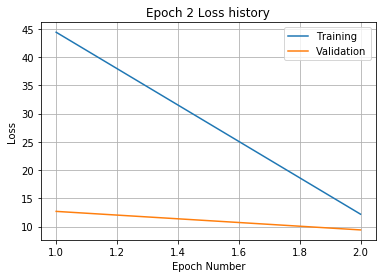

Training
Iteration 0: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 20: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 40: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 60: with minibatch training loss = 7.95 and relative error of 0.32
Iteration 80: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.58 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.42 and relative error of 0.34
Iteration 140: with minibatch training loss = 9.44 and relative error of 0.34
Iteration 160: with minibatch training loss = 9.52 and relative error of 0.35
Iteration 180: with minibatch training loss = 12.6 and relative error of 0.41
Iteration 200: with minibatch training loss = 8.17 and relative error of 0.33
Iteration 220: with minibatch training loss = 9.51 and relative error of 0.34
Iteration 240: with minibatch training loss = 11 and relative

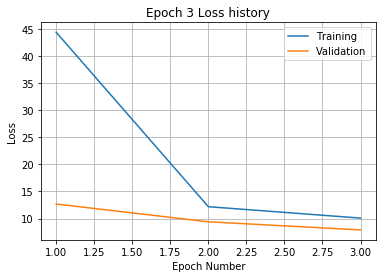

Training
Iteration 0: with minibatch training loss = 8.88 and relative error of 0.34
Iteration 20: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 40: with minibatch training loss = 12.3 and relative error of 0.39
Iteration 60: with minibatch training loss = 8.6 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.64 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.43 and relative error of 0.32
Iteration 120: with minibatch training loss = 11.7 and relative error of 0.37
Iteration 140: with minibatch training loss = 8.42 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.3 and relative error of 0.35
Iteration 180: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 200: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 220: with minibatch training loss = 9.82 and relative error of 0.36
Iteration 240: with minibatch training loss = 9.55 and relative

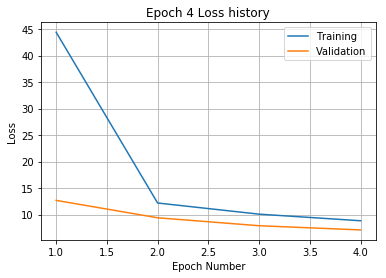

Training
Iteration 0: with minibatch training loss = 9.06 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.81 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.62 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 140: with minibatch training loss = 9.27 and relative error of 0.36
Iteration 160: with minibatch training loss = 7.37 and relative error of 0.32
Iteration 180: with minibatch training loss = 9.57 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.53 and relative error of 0.35
Iteration 220: with minibatch training loss = 9.67 and relative error of 0.35
Iteration 240: with minibatch training loss = 9.43 and relative

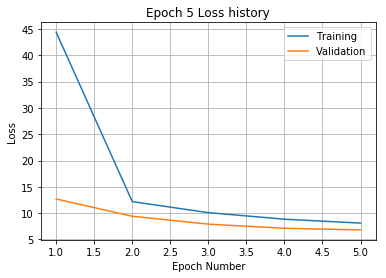

Training
Iteration 0: with minibatch training loss = 7.27 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.2 and relative error of 0.32
Iteration 60: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 80: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.83 and relative error of 0.31
Iteration 140: with minibatch training loss = 9.05 and relative error of 0.35
Iteration 160: with minibatch training loss = 7.58 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.91 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.83 and relative error of 0.35
Iteration 220: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.02 and relative

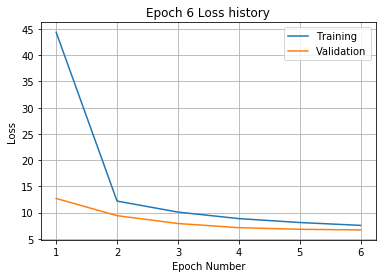

Training
Iteration 0: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.73 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.52 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.72 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 140: with minibatch training loss = 8.68 and relative error of 0.35
Iteration 160: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.66 and relative error of 0.34
Iteration 220: with minibatch training loss = 4.38 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.81 and relative

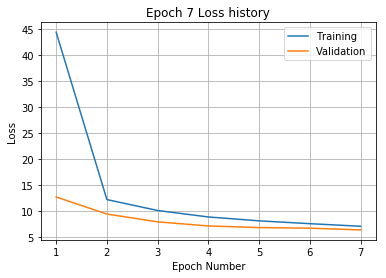

Training
Iteration 0: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 20: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.9 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.52 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.92 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 240: with minibatch training loss = 5.52 and relative er

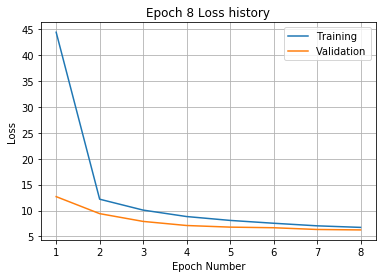

Training
Iteration 0: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.21 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.23 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.78 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.11 and relative error of 0.3
Iteration 240: with minibatch training loss = 8.98 and relativ

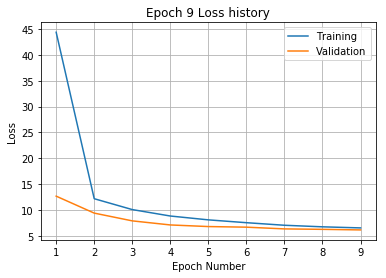

Training
Iteration 0: with minibatch training loss = 5.9 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 40: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 60: with minibatch training loss = 6.4 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.3 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.97 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.52 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.92 and relative error of 0.31
Iteration 240: with minibatch training loss = 4.88 and relative er

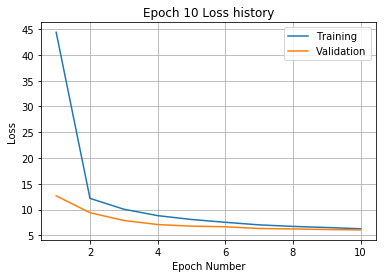

Training
Iteration 0: with minibatch training loss = 6.55 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 40: with minibatch training loss = 8.33 and relative error of 0.34
Iteration 60: with minibatch training loss = 7.4 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.31 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.03 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.62 and relative 

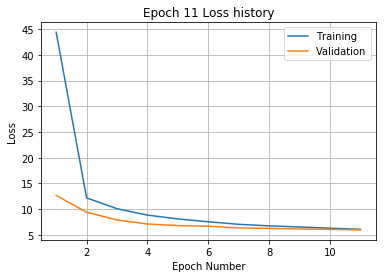

Training
Iteration 0: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.99 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.76 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 100: with minibatch training loss = 8.16 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.74 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.8 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.47 and relative

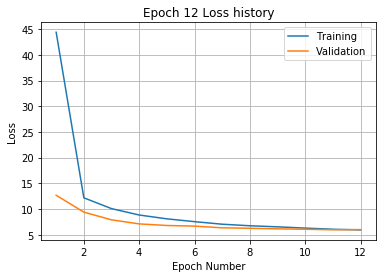

Training
Iteration 0: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 40: with minibatch training loss = 9.13 and relative error of 0.35
Iteration 60: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 100: with minibatch training loss = 3.45 and relative error of 0.21
Iteration 120: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 160: with minibatch training loss = 8.95 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 240: with minibatch training loss = 4.76 and relative 

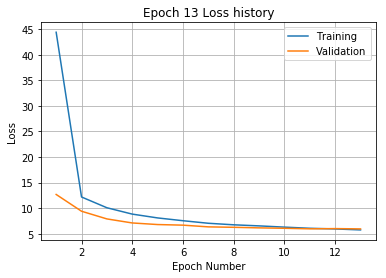

Training
Iteration 0: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.31 and relative error of 0.23
Iteration 60: with minibatch training loss = 6.38 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.2 and relative error of 0.3
Iteration 120: with minibatch training loss = 3.82 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.45 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 240: with minibatch training loss = 4.44 and relative e

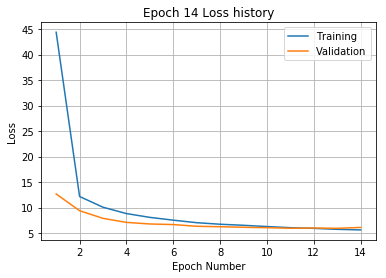

Training
Iteration 0: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.12 and relative error of 0.32
Iteration 60: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.89 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 200: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.09 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.05 and relati

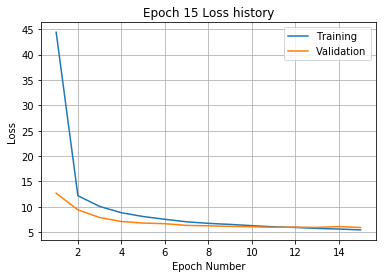

Training
Iteration 0: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.05 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 100: with minibatch training loss = 8.3 and relative error of 0.32
Iteration 120: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.93 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.31 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.28 and relativ

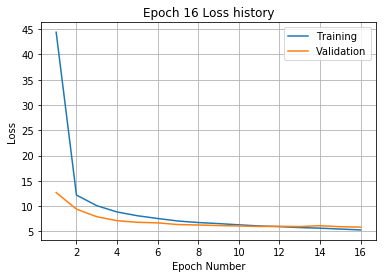

Training
Iteration 0: with minibatch training loss = 3.99 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.83 and relative error of 0.22
Iteration 100: with minibatch training loss = 3.87 and relative error of 0.23
Iteration 120: with minibatch training loss = 3.81 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.31 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.56 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.29 and relati

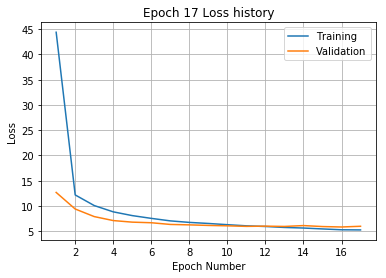

Training
Iteration 0: with minibatch training loss = 6.88 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.66 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.16 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.8 and relativ

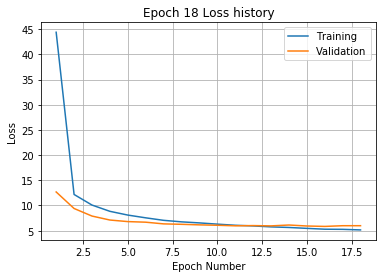

Training
Iteration 0: with minibatch training loss = 3.12 and relative error of 0.2
Iteration 20: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 40: with minibatch training loss = 3.39 and relative error of 0.21
Iteration 60: with minibatch training loss = 3.66 and relative error of 0.22
Iteration 80: with minibatch training loss = 5.29 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 120: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.13 and relative error of 0.25
Iteration 180: with minibatch training loss = 7.16 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.06 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.22 and relative 

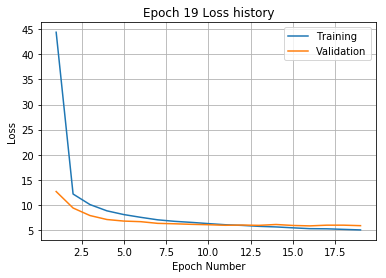

Training
Iteration 0: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 100: with minibatch training loss = 6.47 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.22 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 200: with minibatch training loss = 6.49 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 240: with minibatch training loss = 3.95 and relati

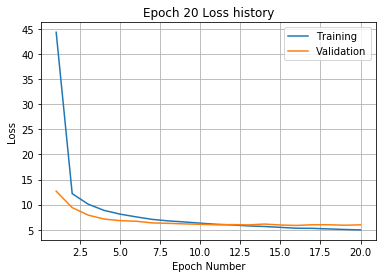

Training
Iteration 0: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.69 and relative error of 0.24
Iteration 40: with minibatch training loss = 3.79 and relative error of 0.22
Iteration 60: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.59 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 180: with minibatch training loss = 6 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.89 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.77 and relative e

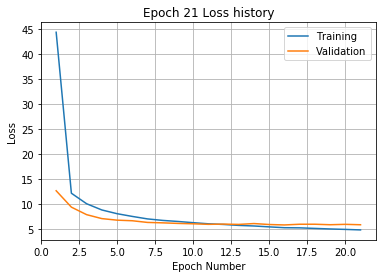

Validation error has stopped improving! Training on repetition 5 stopped!
Training
Iteration 0: with minibatch training loss = 218 and relative error of 1.6
Iteration 20: with minibatch training loss = 117 and relative error of 1.3
Iteration 40: with minibatch training loss = 77.2 and relative error of 1
Iteration 60: with minibatch training loss = 56.7 and relative error of 0.89
Iteration 80: with minibatch training loss = 44.1 and relative error of 0.74
Iteration 100: with minibatch training loss = 33.3 and relative error of 0.67
Iteration 120: with minibatch training loss = 23.5 and relative error of 0.58
Iteration 140: with minibatch training loss = 26 and relative error of 0.59
Iteration 160: with minibatch training loss = 21.6 and relative error of 0.5
Iteration 180: with minibatch training loss = 20.2 and relative error of 0.52
Iteration 200: with minibatch training loss = 15.6 and relative error of 0.46
Iteration 220: with minibatch training loss = 14.5 and relative error of 0.

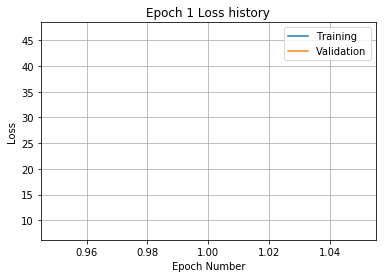

Training
Iteration 0: with minibatch training loss = 14 and relative error of 0.43
Iteration 20: with minibatch training loss = 14 and relative error of 0.43
Iteration 40: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 60: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 80: with minibatch training loss = 12.4 and relative error of 0.42
Iteration 100: with minibatch training loss = 12.6 and relative error of 0.42
Iteration 120: with minibatch training loss = 12.2 and relative error of 0.42
Iteration 140: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 160: with minibatch training loss = 15.7 and relative error of 0.44
Iteration 180: with minibatch training loss = 9.43 and relative error of 0.35
Iteration 200: with minibatch training loss = 9.9 and relative error of 0.36
Iteration 220: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 240: with minibatch training loss = 10 and relative error

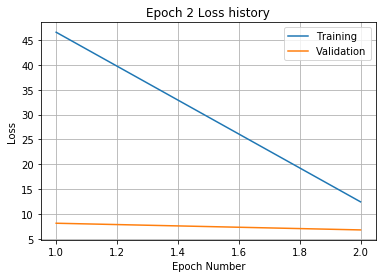

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 20: with minibatch training loss = 10 and relative error of 0.38
Iteration 40: with minibatch training loss = 9.47 and relative error of 0.34
Iteration 60: with minibatch training loss = 13.2 and relative error of 0.42
Iteration 80: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 100: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 120: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 140: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.93 and relative error of 0.36
Iteration 200: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 220: with minibatch training loss = 9.95 and relative error of 0.35
Iteration 240: with minibatch training loss = 7.75 and relative 

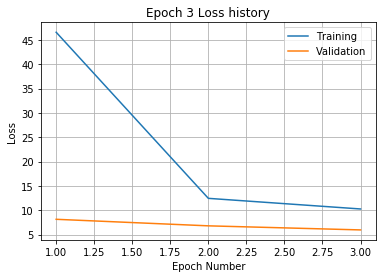

Training
Iteration 0: with minibatch training loss = 8.27 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.6 and relative error of 0.34
Iteration 40: with minibatch training loss = 12.4 and relative error of 0.39
Iteration 60: with minibatch training loss = 8.93 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.48 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.15 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.04 and relative error of 0.31
Iteration 160: with minibatch training loss = 9.53 and relative error of 0.36
Iteration 180: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 200: with minibatch training loss = 9.43 and relative error of 0.35
Iteration 220: with minibatch training loss = 9.89 and relative error of 0.38
Iteration 240: with minibatch training loss = 11.3 and relative 

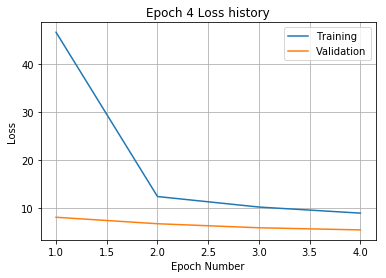

Training
Iteration 0: with minibatch training loss = 8.2 and relative error of 0.32
Iteration 20: with minibatch training loss = 9.73 and relative error of 0.36
Iteration 40: with minibatch training loss = 9.25 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.98 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.79 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.48 and relative error of 0.32
Iteration 160: with minibatch training loss = 9.17 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.22 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.65 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.36 and relative error of 0.32
Iteration 240: with minibatch training loss = 7.66 and relative

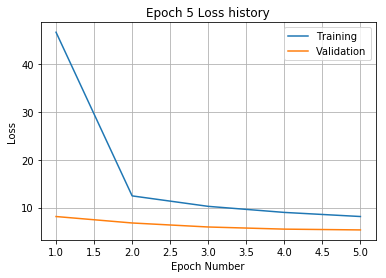

Training
Iteration 0: with minibatch training loss = 7.3 and relative error of 0.33
Iteration 20: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 40: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 60: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.09 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.55 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.49 and relative error of 0.3
Iteration 240: with minibatch training loss = 8.04 and relative e

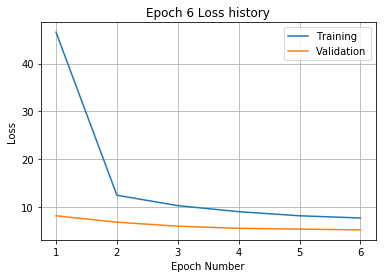

Training
Iteration 0: with minibatch training loss = 9.01 and relative error of 0.35
Iteration 20: with minibatch training loss = 8.37 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.36 and relative error of 0.28
Iteration 100: with minibatch training loss = 9.2 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.56 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.64 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.41 and relative error of 0.34
Iteration 220: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 240: with minibatch training loss = 7.27 and relative

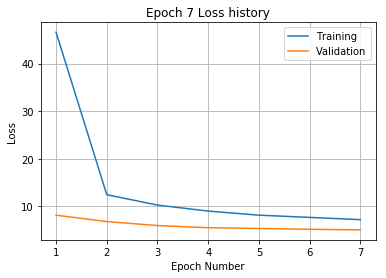

Training
Iteration 0: with minibatch training loss = 6.02 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.5 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.81 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 140: with minibatch training loss = 9.53 and relative error of 0.34
Iteration 160: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.53 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.39 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 240: with minibatch training loss = 6.46 and relative e

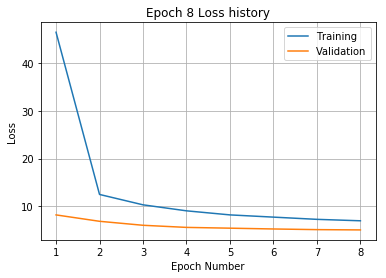

Training
Iteration 0: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.73 and relative error of 0.34
Iteration 120: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.69 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.28 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 240: with minibatch training loss = 8.89 and relative err

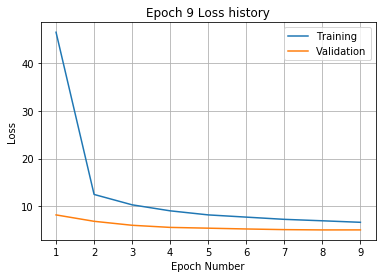

Training
Iteration 0: with minibatch training loss = 9.09 and relative error of 0.36
Iteration 20: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 40: with minibatch training loss = 7.07 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.63 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.49 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.53 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 240: with minibatch training loss = 7.37 and relative e

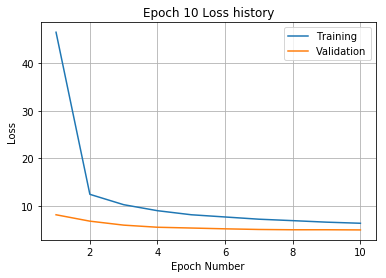

Training
Iteration 0: with minibatch training loss = 7.46 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 160: with minibatch training loss = 3.79 and relative error of 0.22
Iteration 180: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.47 and relative 

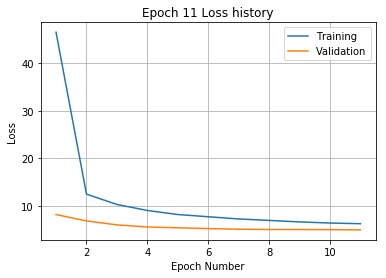

Training
Iteration 0: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 20: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.98 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.78 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 240: with minibatch training loss = 6.61 and relative

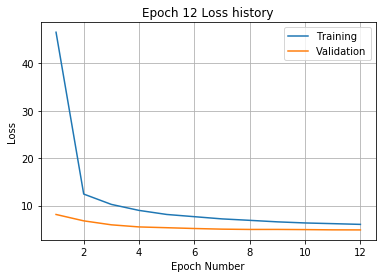

Training
Iteration 0: with minibatch training loss = 4.45 and relative error of 0.25
Iteration 20: with minibatch training loss = 7.92 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.61 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.42 and relative error of 0.25
Iteration 100: with minibatch training loss = 7.21 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 240: with minibatch training loss = 6.65 and relativ

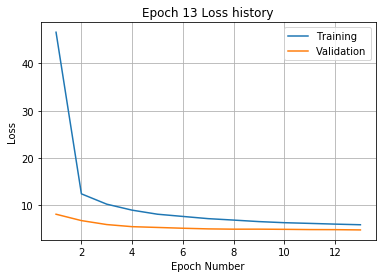

Training
Iteration 0: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.64 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.19 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.09 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 240: with minibatch training loss = 4.9 and relative e

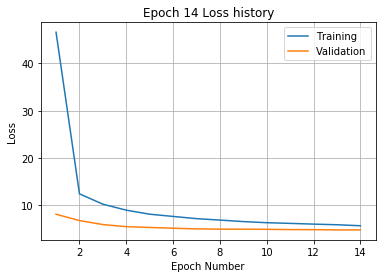

Training
Iteration 0: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.78 and relative error of 0.21
Iteration 80: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 100: with minibatch training loss = 5 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.29 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 200: with minibatch training loss = 3.76 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.68 and relative 

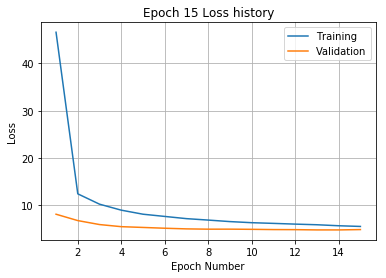

Training
Iteration 0: with minibatch training loss = 4.91 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.06 and relative error of 0.27
Iteration 40: with minibatch training loss = 8.19 and relative error of 0.33
Iteration 60: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.6 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.98 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.26 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 220: with minibatch training loss = 7.02 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.27 and relative

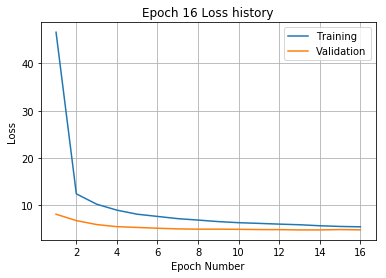

Training
Iteration 0: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.6 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.68 and relative error of 0.21
Iteration 160: with minibatch training loss = 3.99 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 240: with minibatch training loss = 3.9 and relative

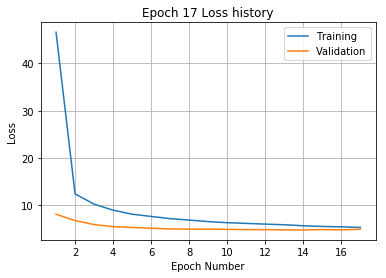

Training
Iteration 0: with minibatch training loss = 8.18 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 160: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 180: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.36 and relative error of 0.23
Iteration 240: with minibatch training loss = 5.53 and relativ

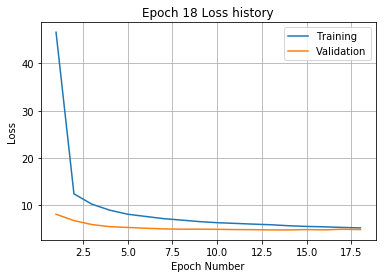

Training
Iteration 0: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.06 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.84 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.78 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.03 and relativ

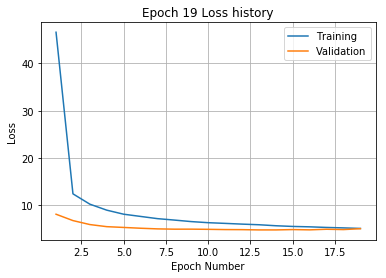

Validation error has stopped improving! Training on repetition 6 stopped!
Training
Iteration 0: with minibatch training loss = 183 and relative error of 1.5
Iteration 20: with minibatch training loss = 117 and relative error of 1.2
Iteration 40: with minibatch training loss = 69.5 and relative error of 0.99
Iteration 60: with minibatch training loss = 52.4 and relative error of 0.84
Iteration 80: with minibatch training loss = 42.2 and relative error of 0.73
Iteration 100: with minibatch training loss = 31.2 and relative error of 0.64
Iteration 120: with minibatch training loss = 26.7 and relative error of 0.58
Iteration 140: with minibatch training loss = 22.1 and relative error of 0.51
Iteration 160: with minibatch training loss = 19.3 and relative error of 0.51
Iteration 180: with minibatch training loss = 17.3 and relative error of 0.49
Iteration 200: with minibatch training loss = 18.8 and relative error of 0.49
Iteration 220: with minibatch training loss = 15.8 and relative error

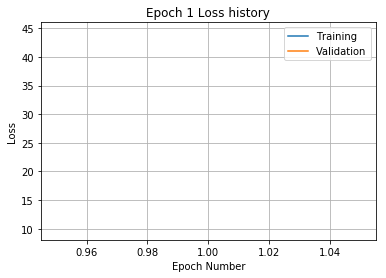

Training
Iteration 0: with minibatch training loss = 17.2 and relative error of 0.47
Iteration 20: with minibatch training loss = 14.8 and relative error of 0.44
Iteration 40: with minibatch training loss = 14.5 and relative error of 0.44
Iteration 60: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 80: with minibatch training loss = 14.7 and relative error of 0.45
Iteration 100: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 120: with minibatch training loss = 12.4 and relative error of 0.41
Iteration 140: with minibatch training loss = 15.9 and relative error of 0.46
Iteration 160: with minibatch training loss = 13.2 and relative error of 0.43
Iteration 180: with minibatch training loss = 12 and relative error of 0.39
Iteration 200: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 220: with minibatch training loss = 12.1 and relative error of 0.39
Iteration 240: with minibatch training loss = 9.55 and relative 

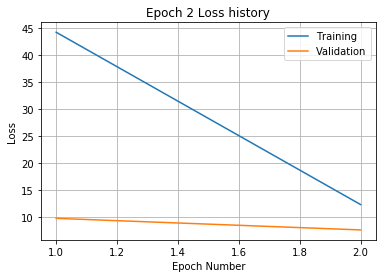

Training
Iteration 0: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 20: with minibatch training loss = 11 and relative error of 0.37
Iteration 40: with minibatch training loss = 8.54 and relative error of 0.34
Iteration 60: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.56 and relative error of 0.33
Iteration 100: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 120: with minibatch training loss = 7.45 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.31 and relative error of 0.33
Iteration 160: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 180: with minibatch training loss = 6.85 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.3 and relative error of 0.33
Iteration 240: with minibatch training loss = 8.57 and relative 

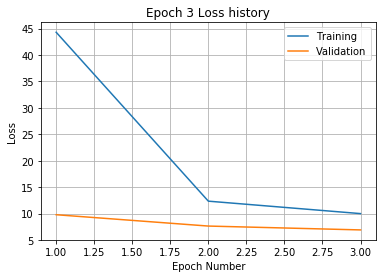

Training
Iteration 0: with minibatch training loss = 8.02 and relative error of 0.34
Iteration 20: with minibatch training loss = 9.19 and relative error of 0.35
Iteration 40: with minibatch training loss = 8.69 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 80: with minibatch training loss = 11 and relative error of 0.39
Iteration 100: with minibatch training loss = 8.46 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.54 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.09 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.26 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.41 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.73 and relative error of 0.33
Iteration 240: with minibatch training loss = 10.6 and relative e

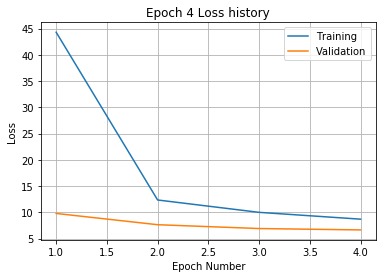

Training
Iteration 0: with minibatch training loss = 8.24 and relative error of 0.32
Iteration 20: with minibatch training loss = 9.03 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.37 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.08 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.53 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.78 and relative error of 0.31
Iteration 240: with minibatch training loss = 7.87 and relativ

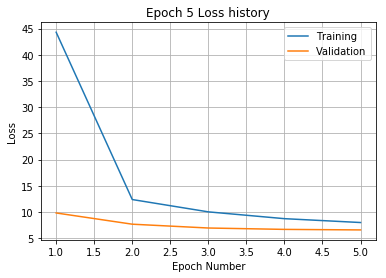

Training
Iteration 0: with minibatch training loss = 7.61 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.29 and relative error of 0.29
Iteration 60: with minibatch training loss = 9.13 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.94 and relative error of 0.36
Iteration 100: with minibatch training loss = 7.69 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.56 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.2 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.92 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.31 and relative error of 0.32
Iteration 240: with minibatch training loss = 6.82 and relative e

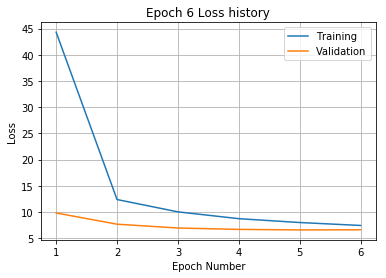

Training
Iteration 0: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.66 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.91 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.07 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.89 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.89 and relative error of 0.33
Iteration 240: with minibatch training loss = 6.47 and relati

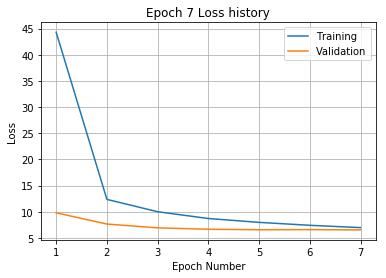

Training
Iteration 0: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.75 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 60: with minibatch training loss = 8.51 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.35 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.38 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.3 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 240: with minibatch training loss = 6.89 and relative err

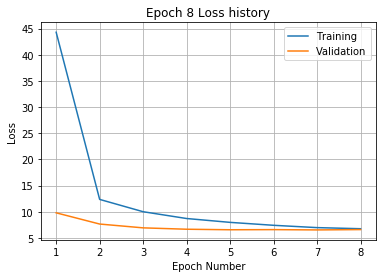

Training
Iteration 0: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.87 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.13 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.95 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 200: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 220: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 240: with minibatch training loss = 6.69 and relative 

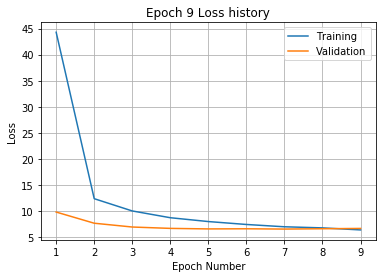

Training
Iteration 0: with minibatch training loss = 4.12 and relative error of 0.24
Iteration 20: with minibatch training loss = 8.95 and relative error of 0.36
Iteration 40: with minibatch training loss = 6.01 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.74 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.87 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.38 and relative

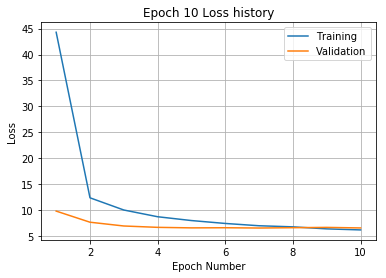

Training
Iteration 0: with minibatch training loss = 8.27 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.46 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 120: with minibatch training loss = 3.83 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 220: with minibatch training loss = 8.04 and relative error of 0.33
Iteration 240: with minibatch training loss = 5.94 and relativ

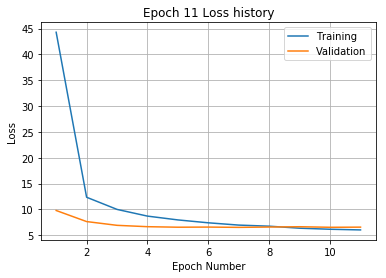

Training
Iteration 0: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.08 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.64 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.12 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.42 and relative error of 0.23
Iteration 120: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.72 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.63 and relative 

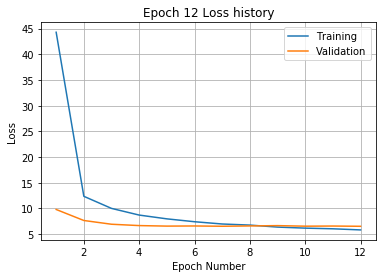

Training
Iteration 0: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.74 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.32 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.98 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.68 and relative error of 0.31
Iteration 240: with minibatch training loss = 7.98 and relative

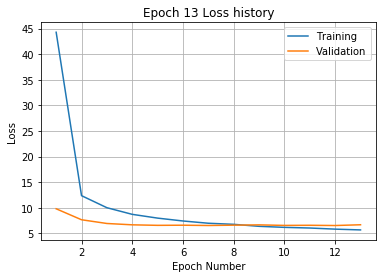

Training
Iteration 0: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 60: with minibatch training loss = 3.97 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.63 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.28 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.15 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 240: with minibatch training loss = 5.32 and relati

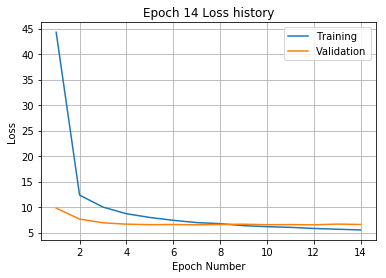

Training
Iteration 0: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.54 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.07 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.35 and relativ

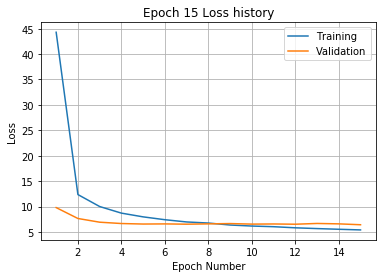

Training
Iteration 0: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 120: with minibatch training loss = 7.37 and relative error of 0.32
Iteration 140: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.59 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.73 and relativ

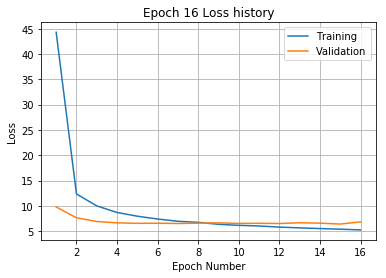

Training
Iteration 0: with minibatch training loss = 6.78 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.71 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.1 and relative error of 0.24
Iteration 120: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.53 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.96 and relative error of 0.33
Iteration 200: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.78 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.07 and relative

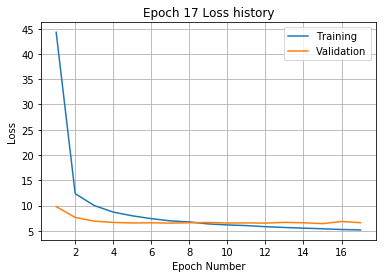

Training
Iteration 0: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.4 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.99 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 200: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 220: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 240: with minibatch training loss = 7.34 and relative

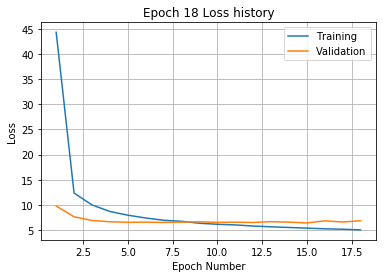

Training
Iteration 0: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.06 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 100: with minibatch training loss = 3.58 and relative error of 0.2
Iteration 120: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 140: with minibatch training loss = 3.88 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.52 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.69 and relative error of 0.24
Iteration 240: with minibatch training loss = 5.39 and relative

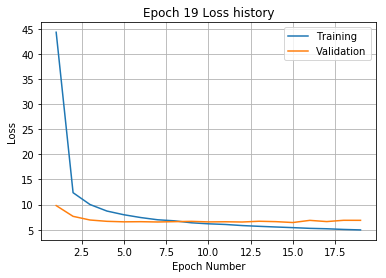

Training
Iteration 0: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 20: with minibatch training loss = 3.84 and relative error of 0.23
Iteration 40: with minibatch training loss = 3.85 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.17 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.86 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.74 and relative error of 0.26
Iteration 180: with minibatch training loss = 3.64 and relative error of 0.21
Iteration 200: with minibatch training loss = 4.24 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 240: with minibatch training loss = 5.03 and relativ

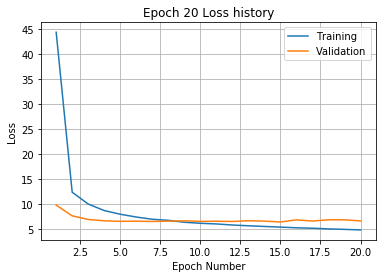

Validation error has stopped improving! Training on repetition 7 stopped!
Training
Iteration 0: with minibatch training loss = 174 and relative error of 1.5
Iteration 20: with minibatch training loss = 98.5 and relative error of 1.1
Iteration 40: with minibatch training loss = 65.5 and relative error of 0.91
Iteration 60: with minibatch training loss = 47.3 and relative error of 0.78
Iteration 80: with minibatch training loss = 32.3 and relative error of 0.67
Iteration 100: with minibatch training loss = 28.3 and relative error of 0.6
Iteration 120: with minibatch training loss = 17.6 and relative error of 0.46
Iteration 140: with minibatch training loss = 18.8 and relative error of 0.5
Iteration 160: with minibatch training loss = 15.1 and relative error of 0.44
Iteration 180: with minibatch training loss = 14.7 and relative error of 0.45
Iteration 200: with minibatch training loss = 13 and relative error of 0.41
Iteration 220: with minibatch training loss = 15.5 and relative error of

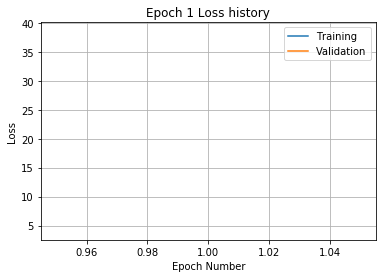

Training
Iteration 0: with minibatch training loss = 14.5 and relative error of 0.43
Iteration 20: with minibatch training loss = 8.74 and relative error of 0.35
Iteration 40: with minibatch training loss = 12 and relative error of 0.39
Iteration 60: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 80: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 100: with minibatch training loss = 11.9 and relative error of 0.41
Iteration 120: with minibatch training loss = 14.3 and relative error of 0.43
Iteration 140: with minibatch training loss = 12.1 and relative error of 0.41
Iteration 160: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 180: with minibatch training loss = 9.15 and relative error of 0.36
Iteration 200: with minibatch training loss = 12.5 and relative error of 0.39
Iteration 220: with minibatch training loss = 12.9 and relative error of 0.4
Iteration 240: with minibatch training loss = 11.7 and relative 

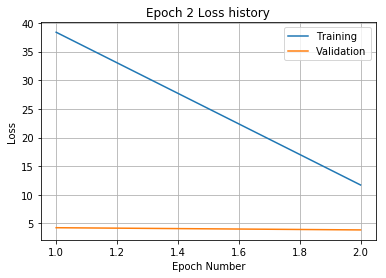

Training
Iteration 0: with minibatch training loss = 8.65 and relative error of 0.33
Iteration 20: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 40: with minibatch training loss = 9.98 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.6 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 100: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 120: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 140: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 160: with minibatch training loss = 9.63 and relative error of 0.35
Iteration 180: with minibatch training loss = 8.44 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.5 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 240: with minibatch training loss = 7.5 and relative 

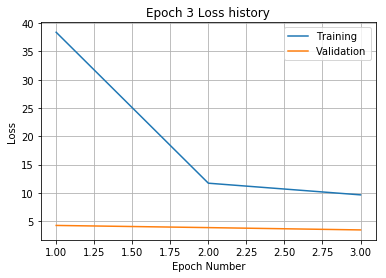

Training
Iteration 0: with minibatch training loss = 8.41 and relative error of 0.33
Iteration 20: with minibatch training loss = 9.03 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.88 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.87 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.8 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.44 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.35 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.85 and relative error of 0.31
Iteration 160: with minibatch training loss = 9.35 and relative error of 0.35
Iteration 180: with minibatch training loss = 8.08 and relative error of 0.33
Iteration 200: with minibatch training loss = 9.09 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.49 and relative error of 0.34
Iteration 240: with minibatch training loss = 8.63 and relativ

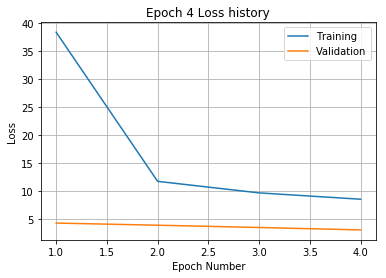

Training
Iteration 0: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.58 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.14 and relative error of 0.35
Iteration 60: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 240: with minibatch training loss = 8.89 and relative e

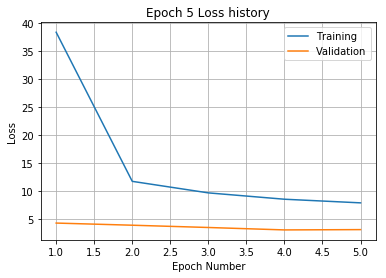

Training
Iteration 0: with minibatch training loss = 9.52 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.91 and relative error of 0.29
Iteration 100: with minibatch training loss = 7 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 140: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 220: with minibatch training loss = 9.82 and relative error of 0.36
Iteration 240: with minibatch training loss = 5.93 and relative err

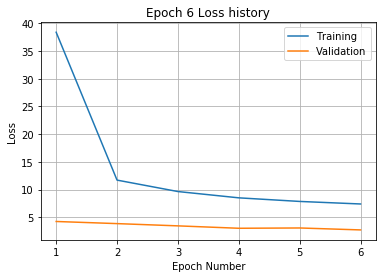

Training
Iteration 0: with minibatch training loss = 10.2 and relative error of 0.38
Iteration 20: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.94 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 180: with minibatch training loss = 13.1 and relative error of 0.42
Iteration 200: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.94 and relative er

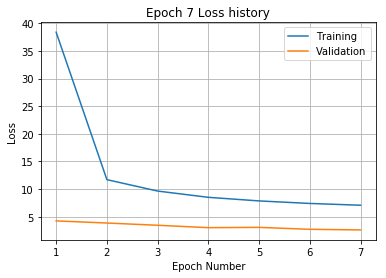

Training
Iteration 0: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 20: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 40: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.93 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.36 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.04 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 240: with minibatch training loss = 8.82 and relative

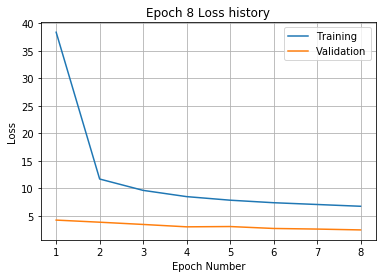

Training
Iteration 0: with minibatch training loss = 7.4 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 80: with minibatch training loss = 8.53 and relative error of 0.34
Iteration 100: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.51 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.52 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.28 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.9 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 240: with minibatch training loss = 5.96 and relative e

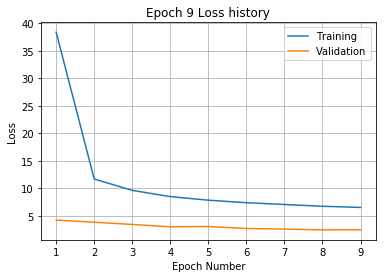

Training
Iteration 0: with minibatch training loss = 5.35 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.84 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.88 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.67 and relative error of 0.24
Iteration 220: with minibatch training loss = 7.85 and relative error of 0.31
Iteration 240: with minibatch training loss = 7.32 and relative e

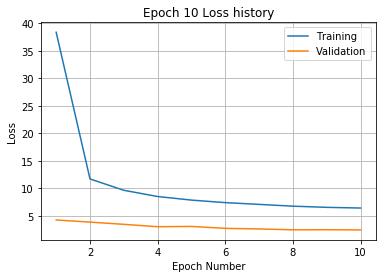

Training
Iteration 0: with minibatch training loss = 4.41 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.1 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.33 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.8 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 240: with minibatch training loss = 5.93 and relative er

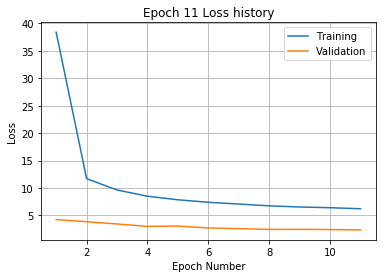

Training
Iteration 0: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.32 and relative error of 0.23
Iteration 80: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.61 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.12 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.9 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.49 and relative er

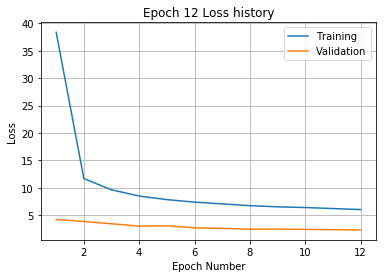

Training
Iteration 0: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 160: with minibatch training loss = 7.37 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.19 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.06 and relative er

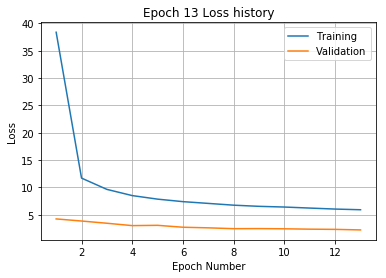

Training
Iteration 0: with minibatch training loss = 4.72 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.57 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 160: with minibatch training loss = 8.89 and relative error of 0.33
Iteration 180: with minibatch training loss = 4.65 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.13 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 240: with minibatch training loss = 6.33 and relativ

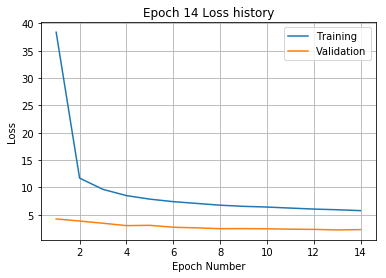

Training
Iteration 0: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.76 and relative error of 0.28
Iteration 60: with minibatch training loss = 3.9 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.72 and relative error of 0.31
Iteration 200: with minibatch training loss = 3.85 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.64 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.75 and relative

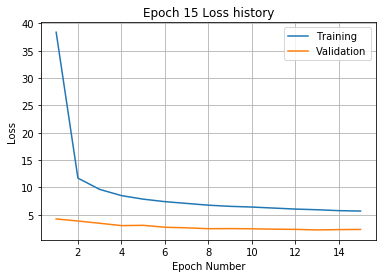

Training
Iteration 0: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.86 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.06 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.85 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.42 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.3 and relative error of 0.3
Iteration 240: with minibatch training loss = 4.87 and relative err

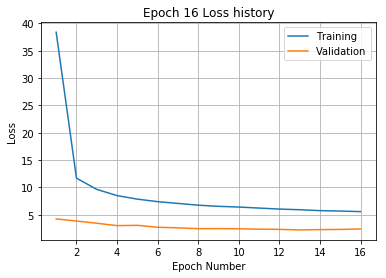

Training
Iteration 0: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.6 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.36 and relative e

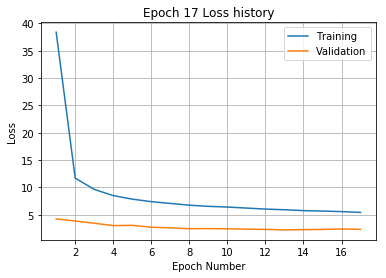

Training
Iteration 0: with minibatch training loss = 5.87 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.3 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.81 and relative error of 0.24
Iteration 80: with minibatch training loss = 6.38 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.71 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.67 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.31 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.03 and relative error of 0.25
Iteration 240: with minibatch training loss = 6.76 and relative 

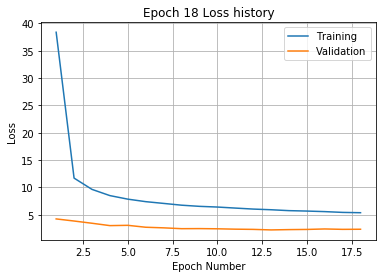

Validation error has stopped improving! Training on repetition 8 stopped!
Training
Iteration 0: with minibatch training loss = 227 and relative error of 1.7
Iteration 20: with minibatch training loss = 120 and relative error of 1.3
Iteration 40: with minibatch training loss = 74.2 and relative error of 1
Iteration 60: with minibatch training loss = 50.7 and relative error of 0.8
Iteration 80: with minibatch training loss = 39.8 and relative error of 0.72
Iteration 100: with minibatch training loss = 27.5 and relative error of 0.61
Iteration 120: with minibatch training loss = 24.9 and relative error of 0.54
Iteration 140: with minibatch training loss = 24.2 and relative error of 0.53
Iteration 160: with minibatch training loss = 16.3 and relative error of 0.45
Iteration 180: with minibatch training loss = 13.9 and relative error of 0.44
Iteration 200: with minibatch training loss = 15.2 and relative error of 0.44
Iteration 220: with minibatch training loss = 18 and relative error of 0.

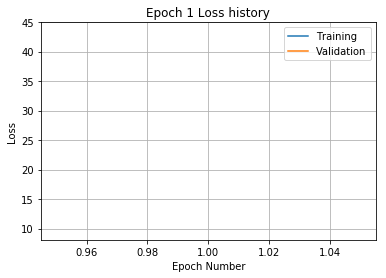

Training
Iteration 0: with minibatch training loss = 14 and relative error of 0.42
Iteration 20: with minibatch training loss = 12.7 and relative error of 0.42
Iteration 40: with minibatch training loss = 13.9 and relative error of 0.42
Iteration 60: with minibatch training loss = 15.5 and relative error of 0.45
Iteration 80: with minibatch training loss = 11.6 and relative error of 0.41
Iteration 100: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 120: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 140: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 160: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 180: with minibatch training loss = 12.3 and relative error of 0.39
Iteration 200: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 220: with minibatch training loss = 9.29 and relative error of 0.35
Iteration 240: with minibatch training loss = 9.95 and relative

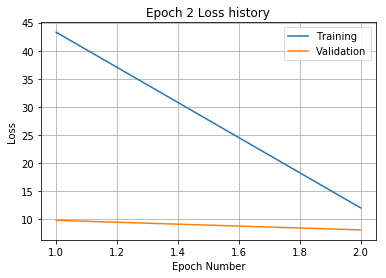

Training
Iteration 0: with minibatch training loss = 8.99 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.07 and relative error of 0.35
Iteration 40: with minibatch training loss = 8.04 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.8 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.67 and relative error of 0.33
Iteration 100: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 120: with minibatch training loss = 8.71 and relative error of 0.34
Iteration 140: with minibatch training loss = 9.49 and relative error of 0.35
Iteration 160: with minibatch training loss = 10 and relative error of 0.36
Iteration 180: with minibatch training loss = 8.81 and relative error of 0.33
Iteration 200: with minibatch training loss = 10 and relative error of 0.36
Iteration 220: with minibatch training loss = 8.03 and relative error of 0.33
Iteration 240: with minibatch training loss = 8.56 and relative er

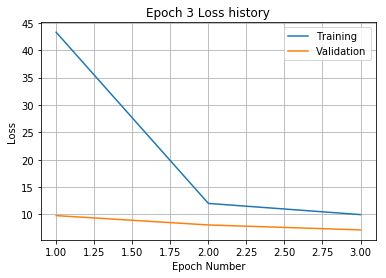

Training
Iteration 0: with minibatch training loss = 7.81 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.77 and relative error of 0.31
Iteration 40: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 60: with minibatch training loss = 8.04 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.76 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.81 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.48 and relative error of 0.34
Iteration 160: with minibatch training loss = 9.5 and relative error of 0.34
Iteration 180: with minibatch training loss = 10.2 and relative error of 0.35
Iteration 200: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 220: with minibatch training loss = 9.8 and relative error of 0.36
Iteration 240: with minibatch training loss = 8.4 and relative 

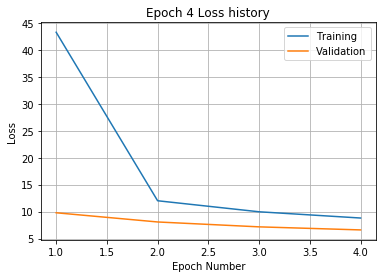

Training
Iteration 0: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 20: with minibatch training loss = 8.52 and relative error of 0.32
Iteration 40: with minibatch training loss = 9.14 and relative error of 0.34
Iteration 60: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.48 and relative error of 0.32
Iteration 120: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 140: with minibatch training loss = 8.01 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.35 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.5 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.25 and relative error of 0.33
Iteration 240: with minibatch training loss = 7.11 and relative

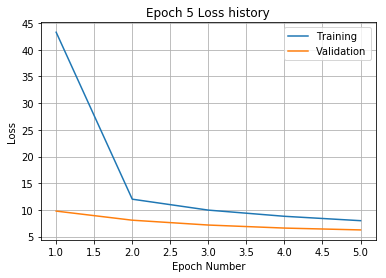

Training
Iteration 0: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.61 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.74 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.14 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.78 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.49 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.56 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.18 and relative error of 0.35
Iteration 200: with minibatch training loss = 8.85 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.64 and relative error of 0.31
Iteration 240: with minibatch training loss = 9.08 and relative 

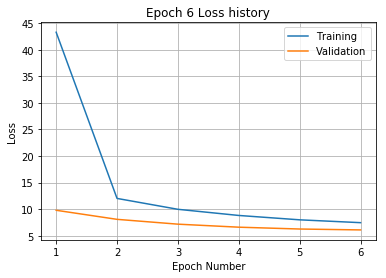

Training
Iteration 0: with minibatch training loss = 7.7 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 60: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.15 and relative error of 0.32
Iteration 100: with minibatch training loss = 9.8 and relative error of 0.35
Iteration 120: with minibatch training loss = 8.73 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.33 and relative error of 0.3
Iteration 160: with minibatch training loss = 8.56 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 220: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 240: with minibatch training loss = 7.2 and relative er

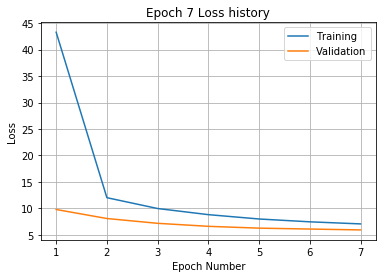

Training
Iteration 0: with minibatch training loss = 7.06 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.89 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.66 and relative error of 0.33
Iteration 100: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.92 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.6 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.89 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.28 and relative e

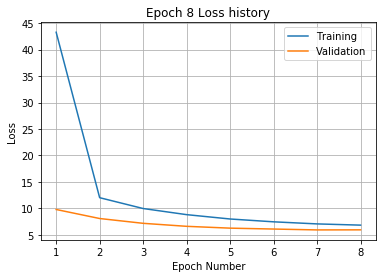

Training
Iteration 0: with minibatch training loss = 9.18 and relative error of 0.35
Iteration 20: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.6 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.48 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.71 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.85 and relative error of 0.34
Iteration 220: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.5 and relative 

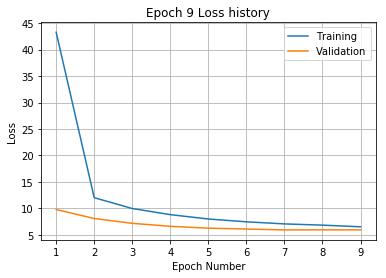

Training
Iteration 0: with minibatch training loss = 5.59 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.85 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 180: with minibatch training loss = 9.22 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.24 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 240: with minibatch training loss = 8.02 and relati

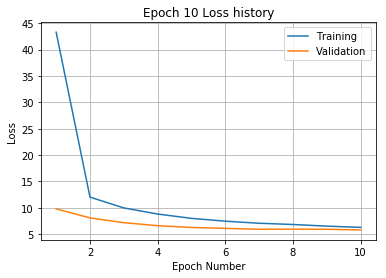

Training
Iteration 0: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.43 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.37 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.85 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.66 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 240: with minibatch training loss = 6.45 and relative e

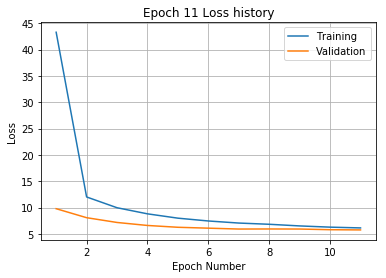

Training
Iteration 0: with minibatch training loss = 8.77 and relative error of 0.33
Iteration 20: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 120: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 140: with minibatch training loss = 8.7 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.91 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.39 and relative

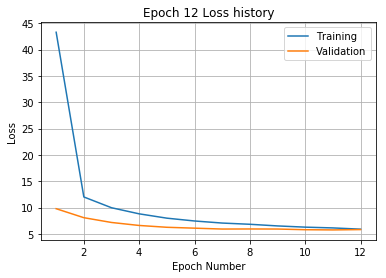

Training
Iteration 0: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 20: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 40: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.69 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.49 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 240: with minibatch training loss = 3.88 and relativ

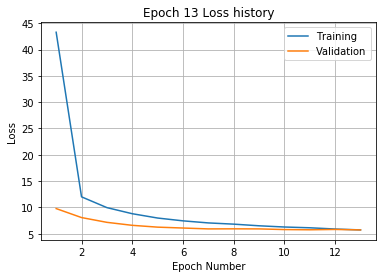

Training
Iteration 0: with minibatch training loss = 9.82 and relative error of 0.35
Iteration 20: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.6 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.92 and relative

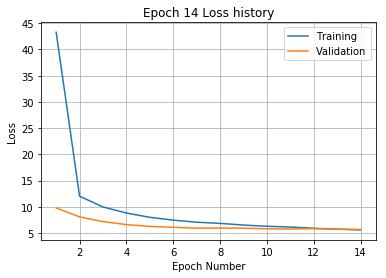

Training
Iteration 0: with minibatch training loss = 4.64 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.04 and relative error of 0.19
Iteration 40: with minibatch training loss = 3.67 and relative error of 0.23
Iteration 60: with minibatch training loss = 3.62 and relative error of 0.22
Iteration 80: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 100: with minibatch training loss = 3.49 and relative error of 0.21
Iteration 120: with minibatch training loss = 8.49 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.38 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.38 and relati

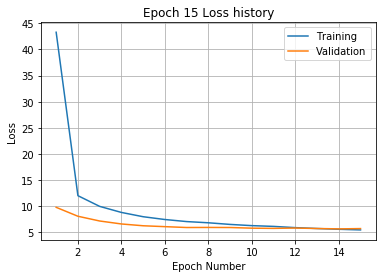

Training
Iteration 0: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 60: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.15 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.95 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.06 and relative error of 0.29
Iteration 240: with minibatch training loss = 4.82 and relativ

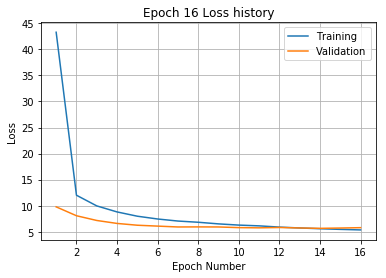

Training
Iteration 0: with minibatch training loss = 4.11 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.74 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.91 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.89 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.56 and relativ

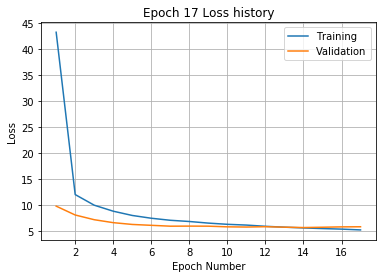

Training
Iteration 0: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 80: with minibatch training loss = 3.73 and relative error of 0.23
Iteration 100: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.62 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.94 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 240: with minibatch training loss = 6.75 and relative

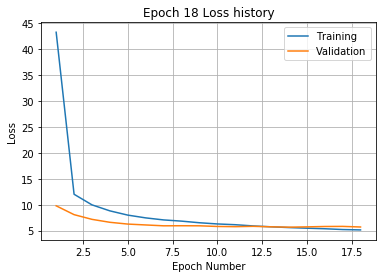

Training
Iteration 0: with minibatch training loss = 4.21 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 60: with minibatch training loss = 3.35 and relative error of 0.22
Iteration 80: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.57 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.34 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.15 and relati

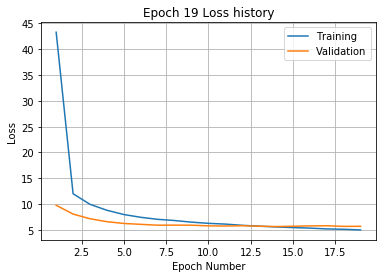

Validation error has stopped improving! Training on repetition 9 stopped!
Training
Iteration 0: with minibatch training loss = 158 and relative error of 1.4
Iteration 20: with minibatch training loss = 78.6 and relative error of 1
Iteration 40: with minibatch training loss = 51.4 and relative error of 0.82
Iteration 60: with minibatch training loss = 36.7 and relative error of 0.69
Iteration 80: with minibatch training loss = 32.5 and relative error of 0.66
Iteration 100: with minibatch training loss = 25.6 and relative error of 0.58
Iteration 120: with minibatch training loss = 18.5 and relative error of 0.5
Iteration 140: with minibatch training loss = 19.3 and relative error of 0.49
Iteration 160: with minibatch training loss = 14.2 and relative error of 0.43
Iteration 180: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 200: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 220: with minibatch training loss = 13.6 and relative error o

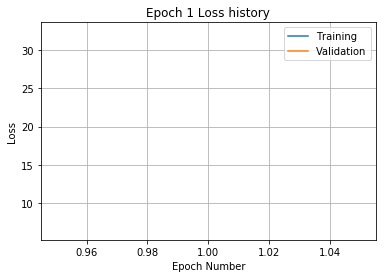

Training
Iteration 0: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 20: with minibatch training loss = 13 and relative error of 0.43
Iteration 40: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 60: with minibatch training loss = 15.4 and relative error of 0.44
Iteration 80: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 100: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 120: with minibatch training loss = 11 and relative error of 0.37
Iteration 140: with minibatch training loss = 13.3 and relative error of 0.43
Iteration 160: with minibatch training loss = 9.78 and relative error of 0.35
Iteration 180: with minibatch training loss = 8.72 and relative error of 0.35
Iteration 200: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 220: with minibatch training loss = 8.62 and relative error of 0.34
Iteration 240: with minibatch training loss = 11.2 and relative err

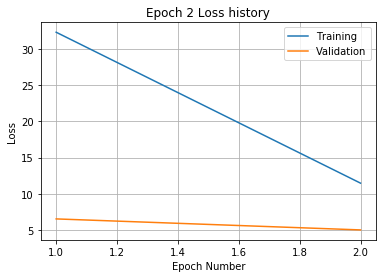

Training
Iteration 0: with minibatch training loss = 11.1 and relative error of 0.37
Iteration 20: with minibatch training loss = 8.21 and relative error of 0.31
Iteration 40: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 60: with minibatch training loss = 9.64 and relative error of 0.37
Iteration 80: with minibatch training loss = 8.65 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.19 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.66 and relative error of 0.36
Iteration 140: with minibatch training loss = 8.28 and relative error of 0.33
Iteration 160: with minibatch training loss = 9.12 and relative error of 0.36
Iteration 180: with minibatch training loss = 11.8 and relative error of 0.38
Iteration 200: with minibatch training loss = 10 and relative error of 0.37
Iteration 220: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 240: with minibatch training loss = 9.58 and relative

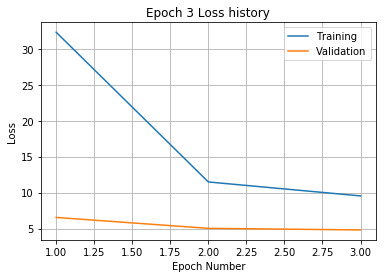

Training
Iteration 0: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.68 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.09 and relative error of 0.34
Iteration 180: with minibatch training loss = 9.71 and relative error of 0.37
Iteration 200: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.43 and relative e

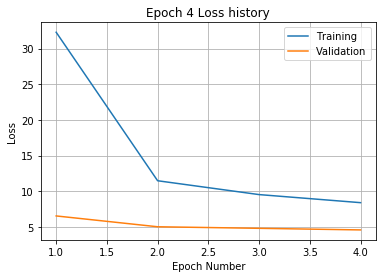

Training
Iteration 0: with minibatch training loss = 8.16 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.69 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 60: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 80: with minibatch training loss = 7.62 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.74 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.25 and relative error of 0.32
Iteration 180: with minibatch training loss = 9.49 and relative error of 0.36
Iteration 200: with minibatch training loss = 7.34 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.24 and relative error of 0.3
Iteration 240: with minibatch training loss = 6.11 and relative

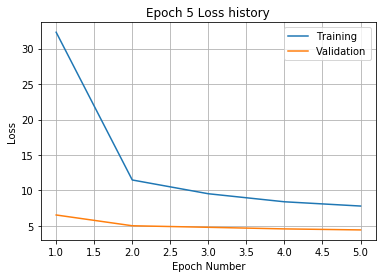

Training
Iteration 0: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.94 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.3 and relative error of 0.3
Iteration 100: with minibatch training loss = 9.07 and relative error of 0.35
Iteration 120: with minibatch training loss = 5.53 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.96 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.47 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.73 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 240: with minibatch training loss = 6.58 and relative e

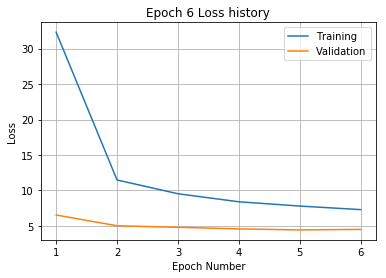

Training
Iteration 0: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 20: with minibatch training loss = 10.2 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.09 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.4 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.76 and relative error of 0.31
Iteration 240: with minibatch training loss = 5.45 and relative err

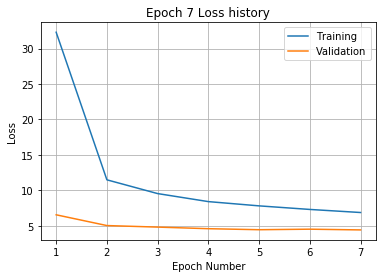

Training
Iteration 0: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 60: with minibatch training loss = 8.57 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.82 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.65 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.27 and relative error of 0.27
Iteration 140: with minibatch training loss = 8.45 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.89 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 200: with minibatch training loss = 4 and relative error of 0.23
Iteration 220: with minibatch training loss = 8.52 and relative error of 0.33
Iteration 240: with minibatch training loss = 5.65 and relative er

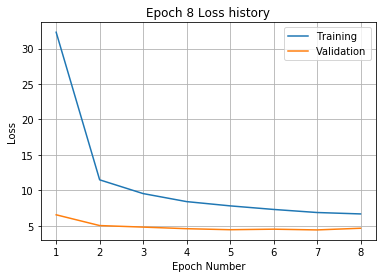

Training
Iteration 0: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 20: with minibatch training loss = 8.47 and relative error of 0.33
Iteration 40: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.24 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.16 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.89 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.98 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.96 and relati

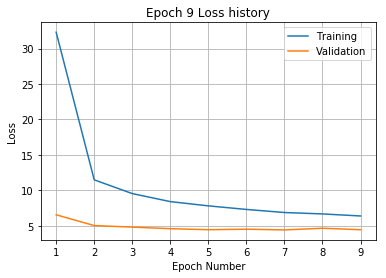

Training
Iteration 0: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 40: with minibatch training loss = 9.14 and relative error of 0.35
Iteration 60: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.6 and relative error of 0.26
Iteration 240: with minibatch training loss = 6.2 and relative erro

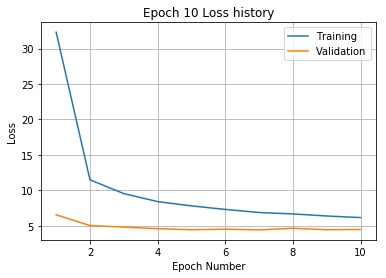

Training
Iteration 0: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.6 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.06 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.78 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.2 and relative err

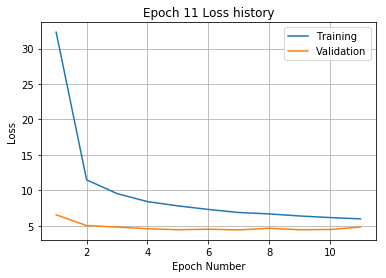

Training
Iteration 0: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 20: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.29 and relative

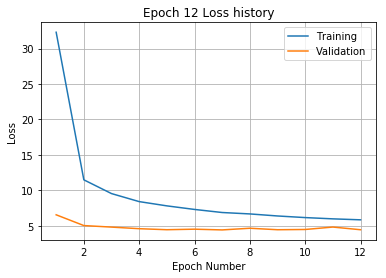

Validation error has stopped improving! Training on repetition 10 stopped!
log interval:  80 seconds
loading data
stacking image log's channels
Training
Iteration 0: with minibatch training loss = 246 and relative error of 1.8
Iteration 20: with minibatch training loss = 112 and relative error of 1.2
Iteration 40: with minibatch training loss = 75.2 and relative error of 1
Iteration 60: with minibatch training loss = 56.4 and relative error of 0.88
Iteration 80: with minibatch training loss = 45.4 and relative error of 0.76
Iteration 100: with minibatch training loss = 34 and relative error of 0.68
Iteration 120: with minibatch training loss = 27.3 and relative error of 0.61
Iteration 140: with minibatch training loss = 22.9 and relative error of 0.54
Iteration 160: with minibatch training loss = 19 and relative error of 0.51
Iteration 180: with minibatch training loss = 19.9 and relative error of 0.5
Iteration 200: with minibatch training loss = 18 and relative error of 0.49
Iteration

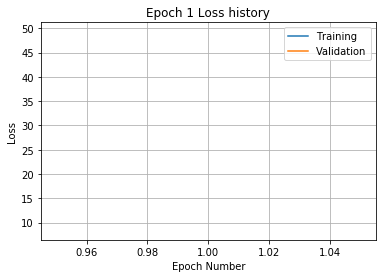

Training
Iteration 0: with minibatch training loss = 16.2 and relative error of 0.48
Iteration 20: with minibatch training loss = 16.5 and relative error of 0.47
Iteration 40: with minibatch training loss = 17.9 and relative error of 0.48
Iteration 60: with minibatch training loss = 14.9 and relative error of 0.43
Iteration 80: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 100: with minibatch training loss = 18.3 and relative error of 0.5
Iteration 120: with minibatch training loss = 13.4 and relative error of 0.43
Iteration 140: with minibatch training loss = 14.3 and relative error of 0.44
Iteration 160: with minibatch training loss = 11 and relative error of 0.38
Iteration 180: with minibatch training loss = 12.7 and relative error of 0.4
Iteration 200: with minibatch training loss = 13.9 and relative error of 0.43
Iteration 220: with minibatch training loss = 15.9 and relative error of 0.48
Epoch 2, Overall loss = 13.3, relative error = 0.418, and process

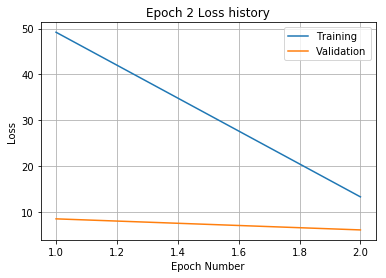

Training
Iteration 0: with minibatch training loss = 7.88 and relative error of 0.32
Iteration 20: with minibatch training loss = 11.4 and relative error of 0.37
Iteration 40: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 60: with minibatch training loss = 12.4 and relative error of 0.39
Iteration 80: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 100: with minibatch training loss = 9.54 and relative error of 0.35
Iteration 120: with minibatch training loss = 12.4 and relative error of 0.41
Iteration 140: with minibatch training loss = 9.72 and relative error of 0.36
Iteration 160: with minibatch training loss = 13.2 and relative error of 0.43
Iteration 180: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.31 and relative error of 0.33
Epoch 3, Overall loss = 10.7, relative error = 0.376, and pro

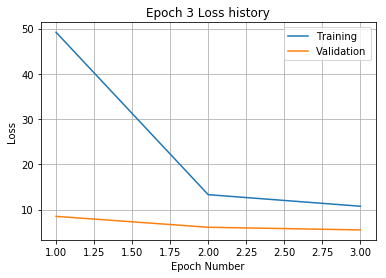

Training
Iteration 0: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 20: with minibatch training loss = 10.9 and relative error of 0.36
Iteration 40: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 60: with minibatch training loss = 7.21 and relative error of 0.32
Iteration 80: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 100: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 120: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 140: with minibatch training loss = 7.59 and relative error of 0.31
Iteration 160: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 180: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.49 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.18 and relative error of 0.33
Epoch 4, Overall loss = 9.52, relative error = 0.354, and proc

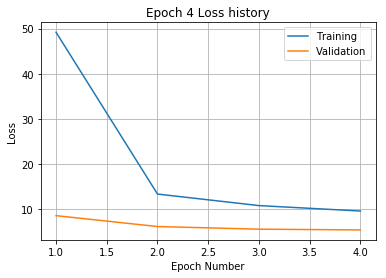

Training
Iteration 0: with minibatch training loss = 9.06 and relative error of 0.35
Iteration 20: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 60: with minibatch training loss = 9.53 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.42 and relative error of 0.33
Iteration 100: with minibatch training loss = 9.71 and relative error of 0.35
Iteration 120: with minibatch training loss = 7.52 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.72 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.07 and relative error of 0.31
Iteration 180: with minibatch training loss = 9.53 and relative error of 0.37
Iteration 200: with minibatch training loss = 9.62 and relative error of 0.35
Iteration 220: with minibatch training loss = 9.7 and relative error of 0.36
Epoch 5, Overall loss = 8.64, relative error = 0.337, and proce

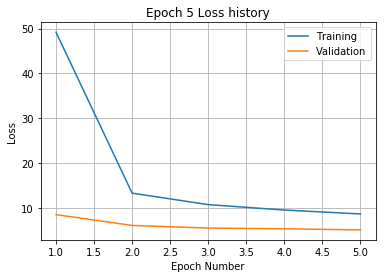

Training
Iteration 0: with minibatch training loss = 8.14 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.29 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.61 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.01 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 100: with minibatch training loss = 10 and relative error of 0.35
Iteration 120: with minibatch training loss = 7.68 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.68 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 200: with minibatch training loss = 8.54 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.98 and relative error of 0.32
Epoch 6, Overall loss = 8.06, relative error = 0.326, and process 

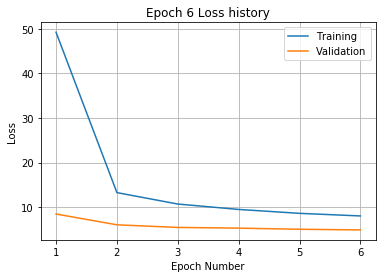

Training
Iteration 0: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.63 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.92 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 100: with minibatch training loss = 9.02 and relative error of 0.36
Iteration 120: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.41 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 220: with minibatch training loss = 9.58 and relative error of 0.35
Epoch 7, Overall loss = 7.52, relative error = 0.314, and proc

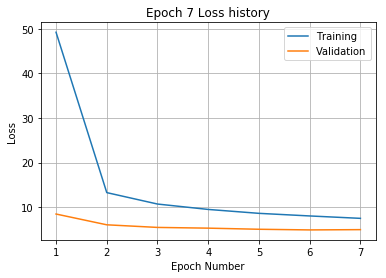

Training
Iteration 0: with minibatch training loss = 8.12 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.21 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.38 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.33 and relative error of 0.27
Iteration 140: with minibatch training loss = 8.35 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.47 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.45 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.43 and relative error of 0.3
Epoch 8, Overall loss = 7.13, relative error = 0.306, and process

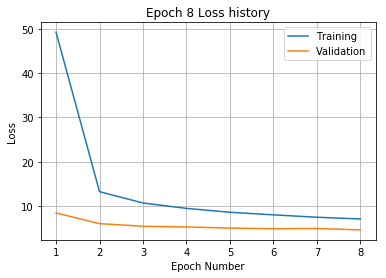

Training
Iteration 0: with minibatch training loss = 6.73 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.66 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.19 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.53 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.28 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.1 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.7 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.06 and relative error of 0.32
Epoch 9, Overall loss = 6.89, relative error = 0.301, and proces

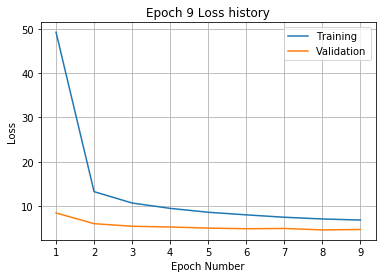

Training
Iteration 0: with minibatch training loss = 8.03 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.24 and relative error of 0.25
Iteration 100: with minibatch training loss = 9.68 and relative error of 0.35
Iteration 120: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 160: with minibatch training loss = 8.39 and relative error of 0.33
Iteration 180: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.4 and relative error of 0.29
Epoch 10, Overall loss = 6.7, relative error = 0.297, and proce

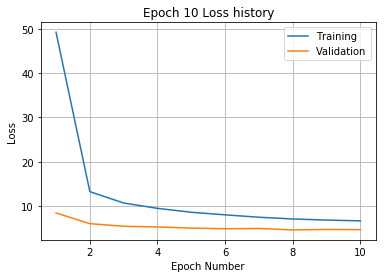

Training
Iteration 0: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.54 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.35 and relative error of 0.31
Epoch 11, Overall loss = 6.35, relative error = 0.289, and process

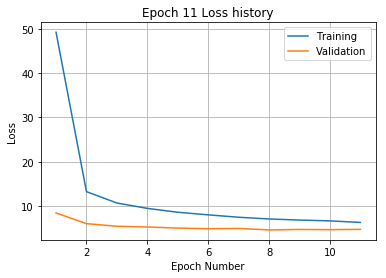

Training
Iteration 0: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.22 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.53 and relative error of 0.25
Iteration 100: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.77 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.52 and relative error of 0.3
Epoch 12, Overall loss = 6.19, relative error = 0.285, and proce

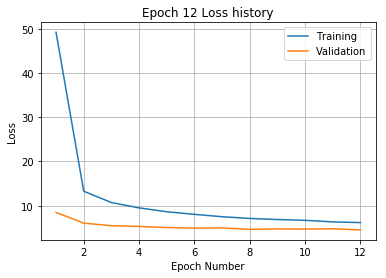

Training
Iteration 0: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 80: with minibatch training loss = 6 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.55 and relative error of 0.31
Epoch 13, Overall loss = 6.09, relative error = 0.283, and process 

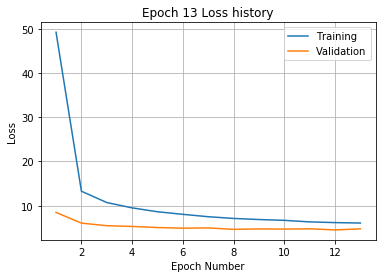

Training
Iteration 0: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.16 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.84 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.35 and relative error of 0.28
Epoch 14, Overall loss = 5.89, relative error = 0.278, and proces

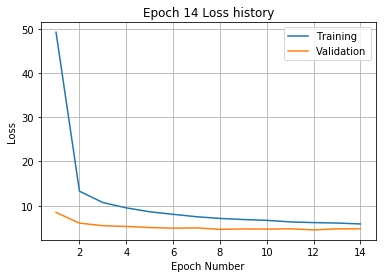

Training
Iteration 0: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.56 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.18 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.79 and relative error of 0.22
Iteration 100: with minibatch training loss = 3.93 and relative error of 0.23
Iteration 120: with minibatch training loss = 7.71 and relative error of 0.34
Iteration 140: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 220: with minibatch training loss = 4.65 and relative error of 0.25
Epoch 15, Overall loss = 5.77, relative error = 0.275, and pr

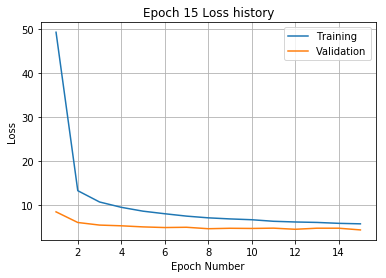

Training
Iteration 0: with minibatch training loss = 4.44 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 60: with minibatch training loss = 8.38 and relative error of 0.34
Iteration 80: with minibatch training loss = 4.72 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.66 and relative error of 0.28
Epoch 16, Overall loss = 5.67, relative error = 0.273, and pr

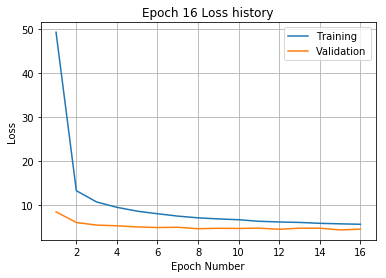

Training
Iteration 0: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.12 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 120: with minibatch training loss = 8.24 and relative error of 0.32
Iteration 140: with minibatch training loss = 3.54 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.14 and relative error of 0.24
Epoch 17, Overall loss = 5.49, relative error = 0.268, and pr

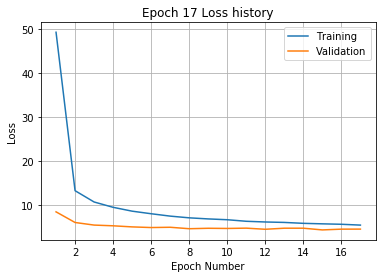

Training
Iteration 0: with minibatch training loss = 4.11 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.12 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.19 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.33 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.52 and relative error of 0.27
Epoch 18, Overall loss = 5.35, relative error = 0.265, and proc

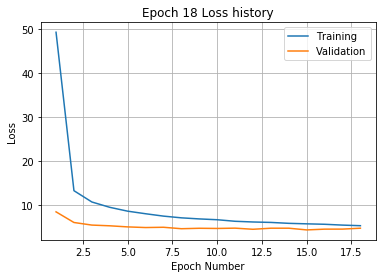

Training
Iteration 0: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 80: with minibatch training loss = 8.21 and relative error of 0.32
Iteration 100: with minibatch training loss = 4.24 and relative error of 0.23
Iteration 120: with minibatch training loss = 6.91 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.81 and relative error of 0.27
Epoch 19, Overall loss = 5.3, relative error = 0.264, and proces

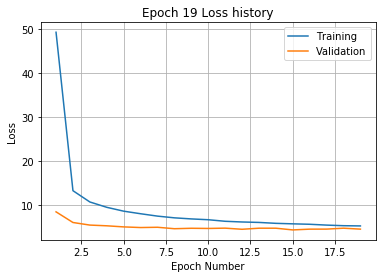

Training
Iteration 0: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.06 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.01 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.44 and relative error of 0.3
Epoch 20, Overall loss = 5.17, relative error = 0.261, and proc

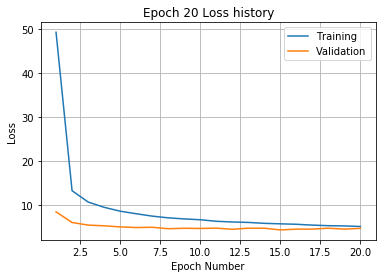

Validation error has stopped improving! Training on repetition 1 stopped!
Training
Iteration 0: with minibatch training loss = 269 and relative error of 1.8
Iteration 20: with minibatch training loss = 150 and relative error of 1.4
Iteration 40: with minibatch training loss = 90.3 and relative error of 1.1
Iteration 60: with minibatch training loss = 73 and relative error of 0.95
Iteration 80: with minibatch training loss = 48.2 and relative error of 0.76
Iteration 100: with minibatch training loss = 40.1 and relative error of 0.71
Iteration 120: with minibatch training loss = 29.2 and relative error of 0.62
Iteration 140: with minibatch training loss = 23.8 and relative error of 0.57
Iteration 160: with minibatch training loss = 26 and relative error of 0.6
Iteration 180: with minibatch training loss = 18.8 and relative error of 0.5
Iteration 200: with minibatch training loss = 16.8 and relative error of 0.5
Iteration 220: with minibatch training loss = 15.7 and relative error of 0.47

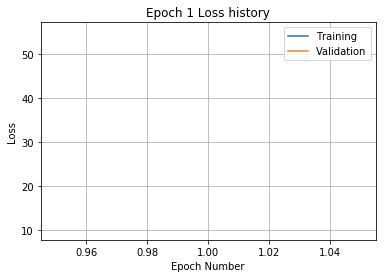

Training
Iteration 0: with minibatch training loss = 17.3 and relative error of 0.48
Iteration 20: with minibatch training loss = 15.5 and relative error of 0.46
Iteration 40: with minibatch training loss = 14.6 and relative error of 0.42
Iteration 60: with minibatch training loss = 13.9 and relative error of 0.43
Iteration 80: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 100: with minibatch training loss = 14.1 and relative error of 0.43
Iteration 120: with minibatch training loss = 12.7 and relative error of 0.43
Iteration 140: with minibatch training loss = 12.7 and relative error of 0.4
Iteration 160: with minibatch training loss = 13 and relative error of 0.42
Iteration 180: with minibatch training loss = 12.8 and relative error of 0.43
Iteration 200: with minibatch training loss = 12.8 and relative error of 0.4
Iteration 220: with minibatch training loss = 15.4 and relative error of 0.47
Epoch 2, Overall loss = 13.6, relative error = 0.423, and process

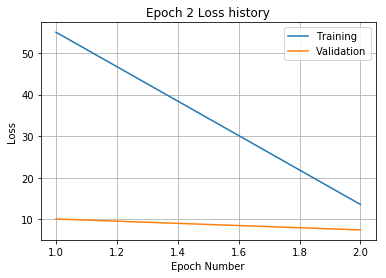

Training
Iteration 0: with minibatch training loss = 11.2 and relative error of 0.4
Iteration 20: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 40: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 60: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 80: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 100: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 120: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 140: with minibatch training loss = 13 and relative error of 0.42
Iteration 160: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 180: with minibatch training loss = 9.04 and relative error of 0.35
Iteration 200: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 220: with minibatch training loss = 12.9 and relative error of 0.42
Epoch 3, Overall loss = 11.1, relative error = 0.383, and process 

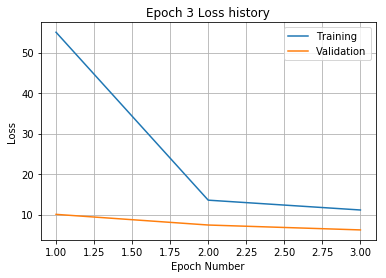

Training
Iteration 0: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 20: with minibatch training loss = 10.5 and relative error of 0.39
Iteration 40: with minibatch training loss = 9.39 and relative error of 0.36
Iteration 60: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 80: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 100: with minibatch training loss = 10.6 and relative error of 0.39
Iteration 120: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 140: with minibatch training loss = 7.41 and relative error of 0.32
Iteration 160: with minibatch training loss = 9.07 and relative error of 0.34
Iteration 180: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.81 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.62 and relative error of 0.34
Epoch 4, Overall loss = 9.62, relative error = 0.356, and proc

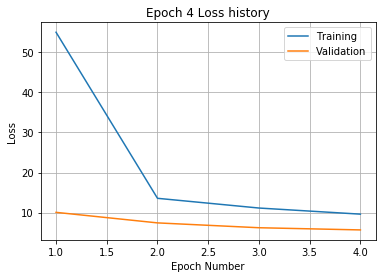

Training
Iteration 0: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.23 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.42 and relative error of 0.34
Iteration 60: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.6 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.23 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 180: with minibatch training loss = 8.97 and relative error of 0.35
Iteration 200: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.46 and relative error of 0.31
Epoch 5, Overall loss = 8.73, relative error = 0.339, and proce

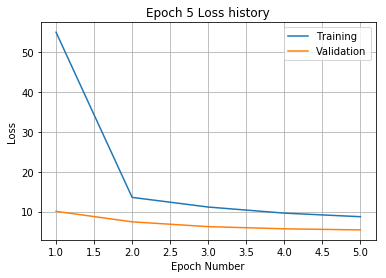

Training
Iteration 0: with minibatch training loss = 8.76 and relative error of 0.35
Iteration 20: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 60: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.32 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.09 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 140: with minibatch training loss = 9.83 and relative error of 0.35
Iteration 160: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.33 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.53 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.04 and relative error of 0.29
Epoch 6, Overall loss = 8.08, relative error = 0.326, and pro

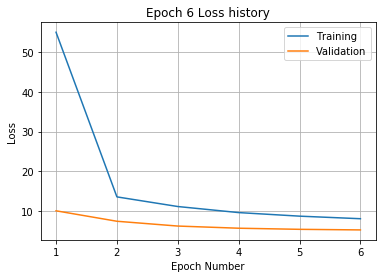

Training
Iteration 0: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 20: with minibatch training loss = 7.13 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.96 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.92 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.7 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.28 and relative error of 0.35
Iteration 140: with minibatch training loss = 9.74 and relative error of 0.37
Iteration 160: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.87 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.32 and relative error of 0.33
Epoch 7, Overall loss = 7.66, relative error = 0.317, and proce

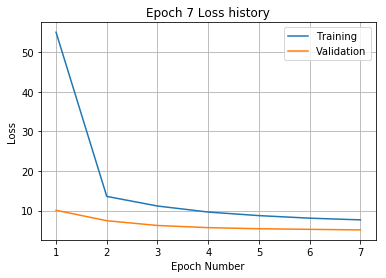

Training
Iteration 0: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.05 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.65 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 220: with minibatch training loss = 9.51 and relative error of 0.36
Epoch 8, Overall loss = 7.27, relative error = 0.309, and proce

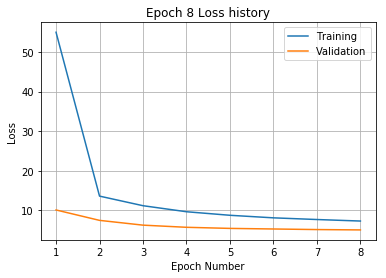

Training
Iteration 0: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.36 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.75 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.74 and relative error of 0.33
Iteration 220: with minibatch training loss = 5.35 and relative error of 0.27
Epoch 9, Overall loss = 7.05, relative error = 0.304, and process

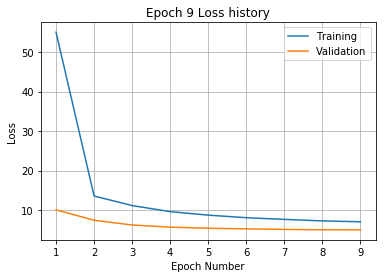

Training
Iteration 0: with minibatch training loss = 3.63 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.99 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 80: with minibatch training loss = 9.11 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 160: with minibatch training loss = 8.55 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.57 and relative error of 0.34
Epoch 10, Overall loss = 6.72, relative error = 0.297, and pro

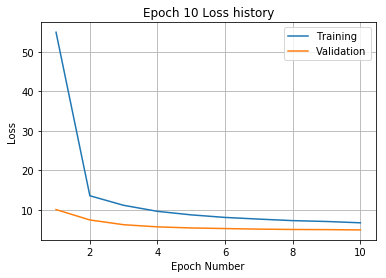

Training
Iteration 0: with minibatch training loss = 8.65 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.89 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.53 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.46 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.87 and relative error of 0.32
Epoch 11, Overall loss = 6.48, relative error = 0.292, and pro

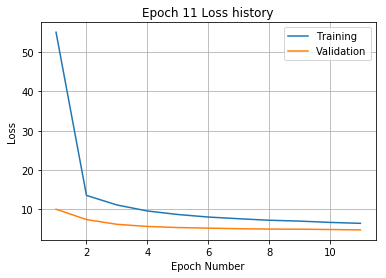

Training
Iteration 0: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.21 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.25 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.6 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.3 and relative error of 0.3
Epoch 12, Overall loss = 6.34, relative error = 0.288, and process 

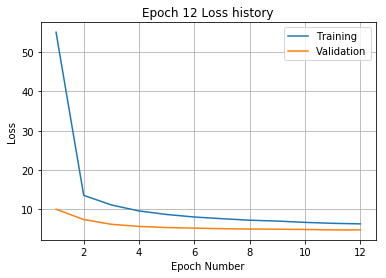

Training
Iteration 0: with minibatch training loss = 7.36 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.23 and relative error of 0.28
Iteration 220: with minibatch training loss = 3.45 and relative error of 0.21
Epoch 13, Overall loss = 6.11, relative error = 0.283, and proce

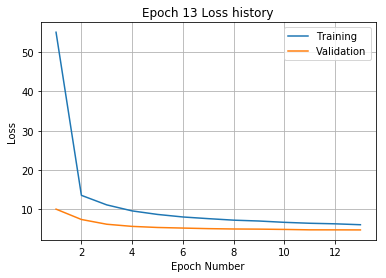

Training
Iteration 0: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.91 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 220: with minibatch training loss = 7.86 and relative error of 0.31
Epoch 14, Overall loss = 5.97, relative error = 0.28, and process

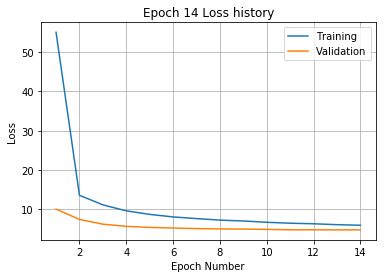

Training
Iteration 0: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 40: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.99 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.56 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.56 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.44 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.35 and relative error of 0.28
Epoch 15, Overall loss = 5.78, relative error = 0.275, and proc

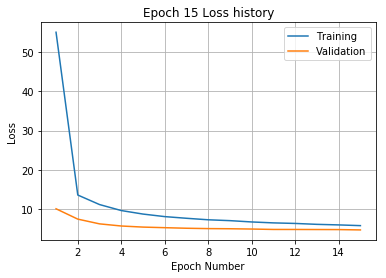

Training
Iteration 0: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.13 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 200: with minibatch training loss = 3.76 and relative error of 0.22
Iteration 220: with minibatch training loss = 4.16 and relative error of 0.23
Epoch 16, Overall loss = 5.61, relative error = 0.271, and proc

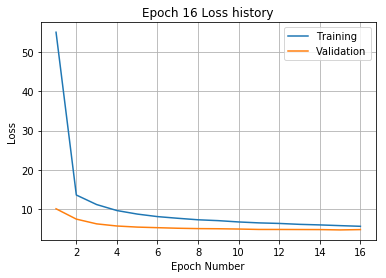

Training
Iteration 0: with minibatch training loss = 5.03 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.1 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.48 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.17 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.5 and relative error of 0.32
Epoch 17, Overall loss = 5.52, relative error = 0.269, and proces

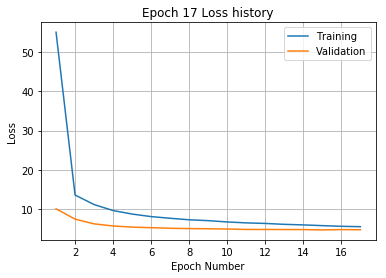

Training
Iteration 0: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.11 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.51 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.96 and relative error of 0.28
Epoch 18, Overall loss = 5.45, relative error = 0.267, and pro

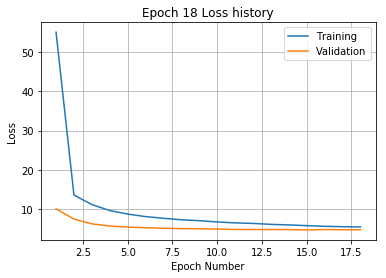

Training
Iteration 0: with minibatch training loss = 4.06 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 160: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 180: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 220: with minibatch training loss = 4.49 and relative error of 0.25
Epoch 19, Overall loss = 5.34, relative error = 0.264, and pro

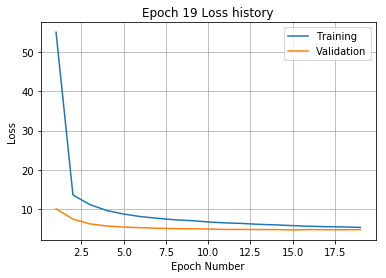

Training
Iteration 0: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.2 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.33 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 180: with minibatch training loss = 3.76 and relative error of 0.22
Iteration 200: with minibatch training loss = 3.78 and relative error of 0.21
Iteration 220: with minibatch training loss = 5.35 and relative error of 0.26
Epoch 20, Overall loss = 5.21, relative error = 0.261, and proc

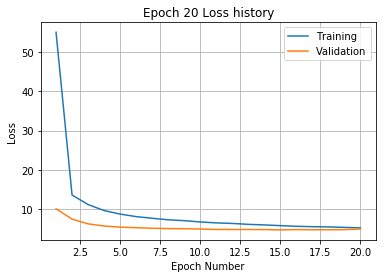

Validation error has stopped improving! Training on repetition 2 stopped!
Training
Iteration 0: with minibatch training loss = 241 and relative error of 1.8
Iteration 20: with minibatch training loss = 124 and relative error of 1.3
Iteration 40: with minibatch training loss = 71.1 and relative error of 0.99
Iteration 60: with minibatch training loss = 54.5 and relative error of 0.84
Iteration 80: with minibatch training loss = 39.8 and relative error of 0.76
Iteration 100: with minibatch training loss = 28.1 and relative error of 0.62
Iteration 120: with minibatch training loss = 27.8 and relative error of 0.61
Iteration 140: with minibatch training loss = 20.1 and relative error of 0.52
Iteration 160: with minibatch training loss = 16.2 and relative error of 0.45
Iteration 180: with minibatch training loss = 16.6 and relative error of 0.47
Iteration 200: with minibatch training loss = 16.4 and relative error of 0.46
Iteration 220: with minibatch training loss = 22.7 and relative error

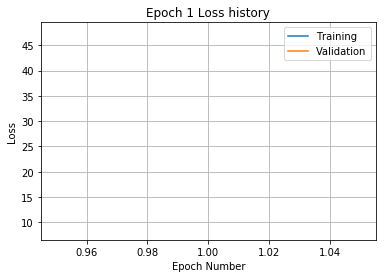

Training
Iteration 0: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 20: with minibatch training loss = 13.9 and relative error of 0.44
Iteration 40: with minibatch training loss = 13.2 and relative error of 0.43
Iteration 60: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 80: with minibatch training loss = 14.6 and relative error of 0.43
Iteration 100: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 120: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 140: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 160: with minibatch training loss = 11.9 and relative error of 0.41
Iteration 180: with minibatch training loss = 8.7 and relative error of 0.35
Iteration 200: with minibatch training loss = 9.62 and relative error of 0.36
Iteration 220: with minibatch training loss = 10.4 and relative error of 0.36
Epoch 2, Overall loss = 12.6, relative error = 0.406, and proces

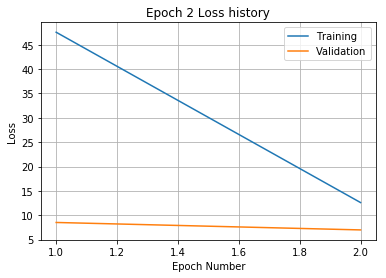

Training
Iteration 0: with minibatch training loss = 13.7 and relative error of 0.41
Iteration 20: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 40: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 60: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.8 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.42 and relative error of 0.33
Iteration 120: with minibatch training loss = 9.02 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.31 and relative error of 0.32
Iteration 160: with minibatch training loss = 9.15 and relative error of 0.33
Iteration 180: with minibatch training loss = 14.2 and relative error of 0.43
Iteration 200: with minibatch training loss = 9.42 and relative error of 0.34
Iteration 220: with minibatch training loss = 9.07 and relative error of 0.34
Epoch 3, Overall loss = 10.4, relative error = 0.368, and proc

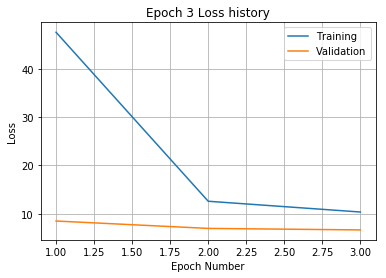

Training
Iteration 0: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 20: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 40: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 60: with minibatch training loss = 9.04 and relative error of 0.34
Iteration 80: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 100: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.27 and relative error of 0.32
Iteration 140: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 180: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 200: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 220: with minibatch training loss = 7.06 and relative error of 0.31
Epoch 4, Overall loss = 9.13, relative error = 0.345, and proce

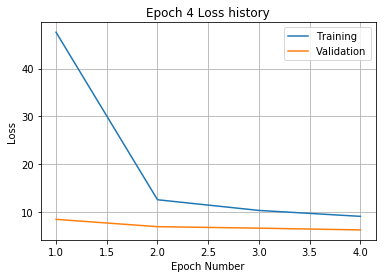

Training
Iteration 0: with minibatch training loss = 7.7 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.7 and relative error of 0.3
Iteration 80: with minibatch training loss = 9.18 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.25 and relative error of 0.34
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 140: with minibatch training loss = 9.6 and relative error of 0.36
Iteration 160: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.66 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.68 and relative error of 0.3
Epoch 5, Overall loss = 8.36, relative error = 0.331, and process tim

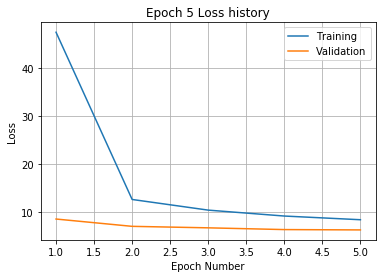

Training
Iteration 0: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.76 and relative error of 0.33
Iteration 60: with minibatch training loss = 7.95 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 100: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 120: with minibatch training loss = 7.46 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.52 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.7 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.5 and relative error of 0.33
Iteration 200: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.09 and relative error of 0.31
Epoch 6, Overall loss = 7.73, relative error = 0.318, and process 

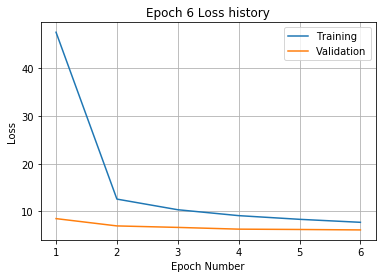

Training
Iteration 0: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.88 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.13 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.58 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.53 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.24 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.53 and relative error of 0.29
Epoch 7, Overall loss = 7.37, relative error = 0.31, and proc

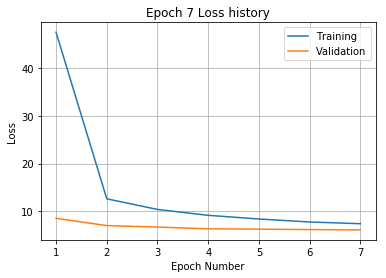

Training
Iteration 0: with minibatch training loss = 7.62 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.92 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 140: with minibatch training loss = 9.41 and relative error of 0.36
Iteration 160: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.54 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.95 and relative error of 0.33
Epoch 8, Overall loss = 6.99, relative error = 0.302, and process

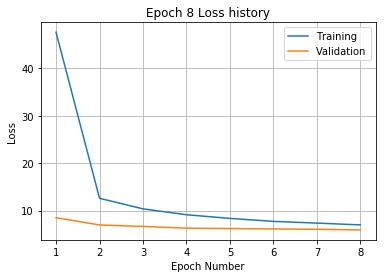

Training
Iteration 0: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.82 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.72 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 100: with minibatch training loss = 10 and relative error of 0.38
Iteration 120: with minibatch training loss = 6.09 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.44 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.16 and relative error of 0.33
Epoch 9, Overall loss = 6.74, relative error = 0.296, and proces

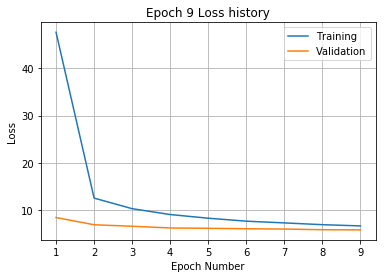

Training
Iteration 0: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.92 and relative error of 0.29
Iteration 80: with minibatch training loss = 8.97 and relative error of 0.34
Iteration 100: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 120: with minibatch training loss = 7 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.38 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.88 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.31 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.51 and relative error of 0.24
Epoch 10, Overall loss = 6.49, relative error = 0.291, and process

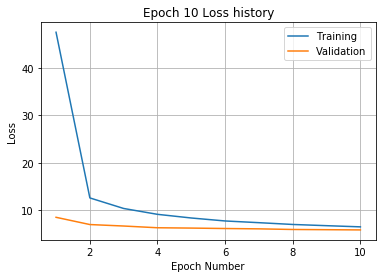

Training
Iteration 0: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.37 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.88 and relative error of 0.32
Iteration 120: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.03 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.26 and relative error of 0.24
Epoch 11, Overall loss = 6.21, relative error = 0.285, and pro

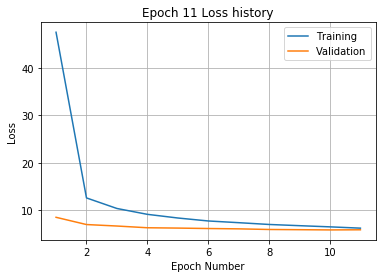

Training
Iteration 0: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 40: with minibatch training loss = 8.35 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.18 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.6 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.88 and relative error of 0.25
Epoch 12, Overall loss = 5.97, relative error = 0.279, and proc

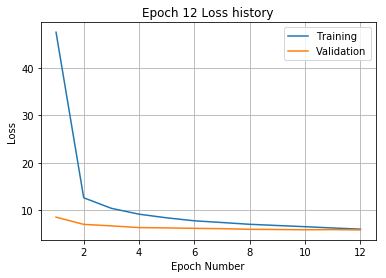

Training
Iteration 0: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.91 and relative error of 0.24
Iteration 40: with minibatch training loss = 3.87 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.68 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.19 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.61 and relative error of 0.28
Epoch 13, Overall loss = 5.87, relative error = 0.277, and proc

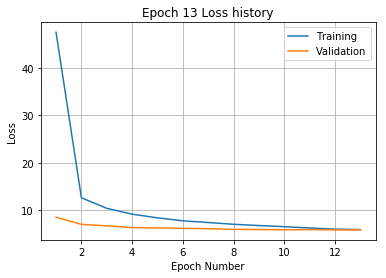

Training
Iteration 0: with minibatch training loss = 6.84 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 40: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 60: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.91 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 160: with minibatch training loss = 5 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.95 and relative error of 0.25
Epoch 14, Overall loss = 5.75, relative error = 0.274, and process 

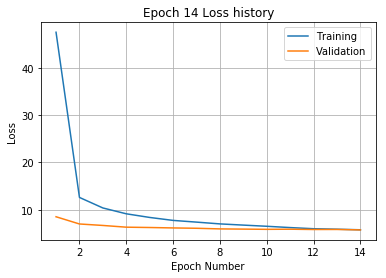

Training
Iteration 0: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.8 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 80: with minibatch training loss = 6.08 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.25 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.3 and relative error of 0.24
Epoch 15, Overall loss = 5.59, relative error = 0.27, and proces

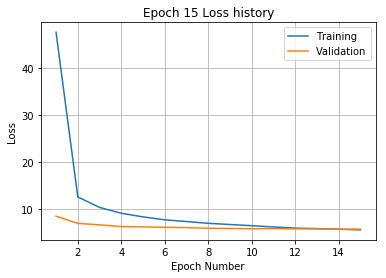

Training
Iteration 0: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.61 and relative error of 0.35
Iteration 140: with minibatch training loss = 4.01 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.42 and relative error of 0.27
Epoch 16, Overall loss = 5.46, relative error = 0.267, and pro

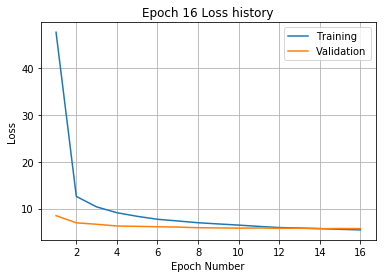

Training
Iteration 0: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 20: with minibatch training loss = 3.45 and relative error of 0.21
Iteration 40: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.05 and relative error of 0.22
Iteration 100: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 180: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 200: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.76 and relative error of 0.24
Epoch 17, Overall loss = 5.29, relative error = 0.263, and proce

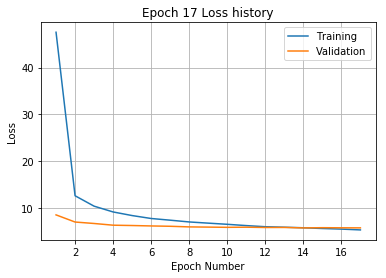

Training
Iteration 0: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.82 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.09 and relative error of 0.25
Epoch 18, Overall loss = 5.27, relative error = 0.262, and proce

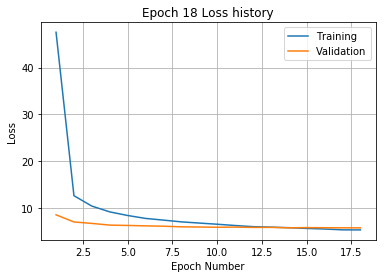

Training
Iteration 0: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 20: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 120: with minibatch training loss = 6.96 and relative error of 0.29
Iteration 140: with minibatch training loss = 9.38 and relative error of 0.35
Iteration 160: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.13 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 220: with minibatch training loss = 4 and relative error of 0.24
Epoch 19, Overall loss = 5.11, relative error = 0.258, and proces

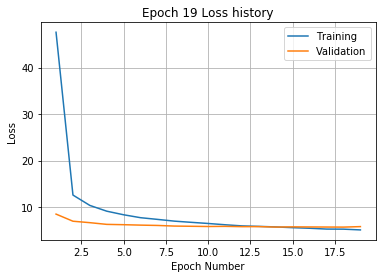

Training
Iteration 0: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.35 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.28 and relative error of 0.23
Iteration 60: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 140: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 160: with minibatch training loss = 3.34 and relative error of 0.22
Iteration 180: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.61 and relative error of 0.23
Epoch 20, Overall loss = 5.06, relative error = 0.257, and pr

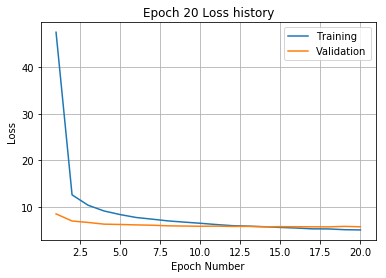

Training
Iteration 0: with minibatch training loss = 5.69 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 40: with minibatch training loss = 3.54 and relative error of 0.23
Iteration 60: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.36 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.11 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.5 and relative error of 0.24
Epoch 21, Overall loss = 4.94, relative error = 0.254, and pro

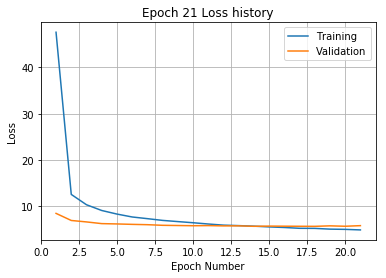

Training
Iteration 0: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 60: with minibatch training loss = 7.57 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 140: with minibatch training loss = 6 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 180: with minibatch training loss = 3.96 and relative error of 0.23
Iteration 200: with minibatch training loss = 3.39 and relative error of 0.21
Iteration 220: with minibatch training loss = 5.53 and relative error of 0.26
Epoch 22, Overall loss = 4.82, relative error = 0.251, and proce

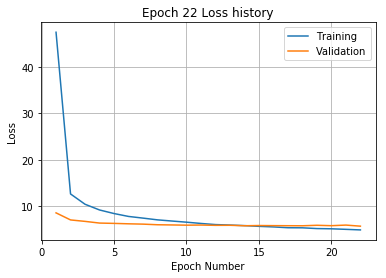

Training
Iteration 0: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.69 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.05 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.5 and relative error of 0.25
Epoch 23, Overall loss = 4.75, relative error = 0.249, and proc

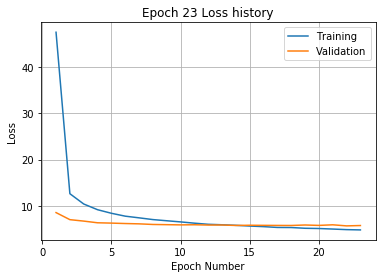

Training
Iteration 0: with minibatch training loss = 4.05 and relative error of 0.22
Iteration 20: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 40: with minibatch training loss = 3.5 and relative error of 0.21
Iteration 60: with minibatch training loss = 4.12 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 100: with minibatch training loss = 6 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 140: with minibatch training loss = 3.28 and relative error of 0.21
Iteration 160: with minibatch training loss = 3.53 and relative error of 0.22
Iteration 180: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 200: with minibatch training loss = 3.09 and relative error of 0.2
Iteration 220: with minibatch training loss = 5.13 and relative error of 0.26
Epoch 24, Overall loss = 4.64, relative error = 0.246, and process

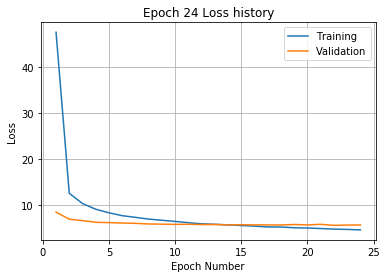

Training
Iteration 0: with minibatch training loss = 4.28 and relative error of 0.23
Iteration 20: with minibatch training loss = 4 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.2 and relative error of 0.27
Iteration 60: with minibatch training loss = 2.87 and relative error of 0.2
Iteration 80: with minibatch training loss = 3.8 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.19 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.4 and relative error of 0.21
Iteration 180: with minibatch training loss = 4.45 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.71 and relative error of 0.22
Epoch 25, Overall loss = 4.55, relative error = 0.243, and process t

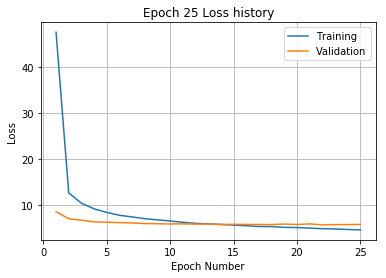

Training
Iteration 0: with minibatch training loss = 3.6 and relative error of 0.22
Iteration 20: with minibatch training loss = 3.68 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.28 and relative error of 0.23
Iteration 100: with minibatch training loss = 3.92 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.39 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 180: with minibatch training loss = 3.55 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 220: with minibatch training loss = 3 and relative error of 0.2
Epoch 26, Overall loss = 4.43, relative error = 0.24, and process 

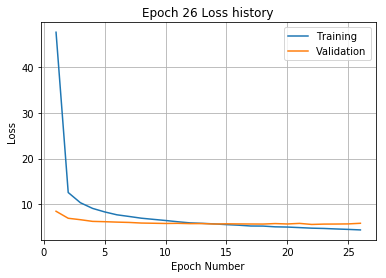

Training
Iteration 0: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.73 and relative error of 0.22
Iteration 40: with minibatch training loss = 5 and relative error of 0.25
Iteration 60: with minibatch training loss = 3.56 and relative error of 0.21
Iteration 80: with minibatch training loss = 4.28 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.06 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.55 and relative error of 0.26
Iteration 140: with minibatch training loss = 3.58 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.69 and relative error of 0.25
Epoch 27, Overall loss = 4.39, relative error = 0.239, and proce

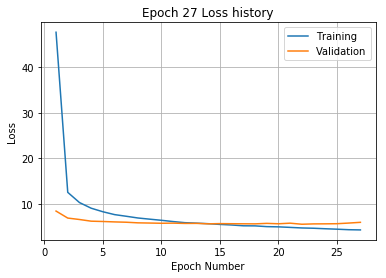

Validation error has stopped improving! Training on repetition 3 stopped!
Training
Iteration 0: with minibatch training loss = 219 and relative error of 1.7
Iteration 20: with minibatch training loss = 109 and relative error of 1.2
Iteration 40: with minibatch training loss = 77.7 and relative error of 0.98
Iteration 60: with minibatch training loss = 60.9 and relative error of 0.87
Iteration 80: with minibatch training loss = 35.9 and relative error of 0.7
Iteration 100: with minibatch training loss = 31.1 and relative error of 0.61
Iteration 120: with minibatch training loss = 23.7 and relative error of 0.56
Iteration 140: with minibatch training loss = 16 and relative error of 0.47
Iteration 160: with minibatch training loss = 16.8 and relative error of 0.47
Iteration 180: with minibatch training loss = 15 and relative error of 0.45
Iteration 200: with minibatch training loss = 16.4 and relative error of 0.46
Iteration 220: with minibatch training loss = 12.6 and relative error of 0

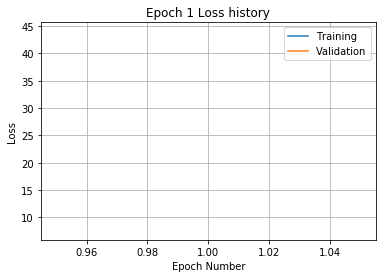

Training
Iteration 0: with minibatch training loss = 13.8 and relative error of 0.42
Iteration 20: with minibatch training loss = 13.5 and relative error of 0.42
Iteration 40: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 60: with minibatch training loss = 14 and relative error of 0.43
Iteration 80: with minibatch training loss = 12.9 and relative error of 0.41
Iteration 100: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 120: with minibatch training loss = 8.81 and relative error of 0.33
Iteration 140: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 160: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 180: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 200: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 220: with minibatch training loss = 11.3 and relative error of 0.4
Epoch 2, Overall loss = 12.1, relative error = 0.399, and proces

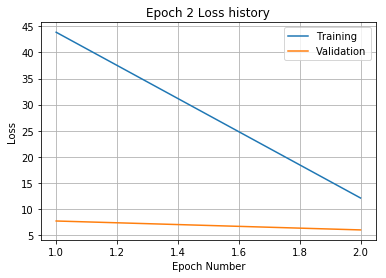

Training
Iteration 0: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 20: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 40: with minibatch training loss = 10.6 and relative error of 0.39
Iteration 60: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 80: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 100: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 120: with minibatch training loss = 10.9 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.29 and relative error of 0.35
Iteration 160: with minibatch training loss = 9.98 and relative error of 0.36
Iteration 180: with minibatch training loss = 8.97 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.95 and relative error of 0.34
Iteration 220: with minibatch training loss = 11.6 and relative error of 0.4
Epoch 3, Overall loss = 10, relative error = 0.363, and proces

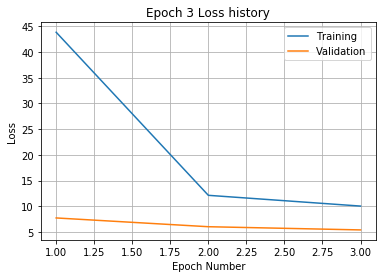

Training
Iteration 0: with minibatch training loss = 8.56 and relative error of 0.32
Iteration 20: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 40: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.96 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.35 and relative error of 0.35
Iteration 100: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 120: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.13 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.52 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.59 and relative error of 0.36
Iteration 200: with minibatch training loss = 7.9 and relative error of 0.33
Iteration 220: with minibatch training loss = 10.8 and relative error of 0.38
Epoch 4, Overall loss = 8.9, relative error = 0.342, and process

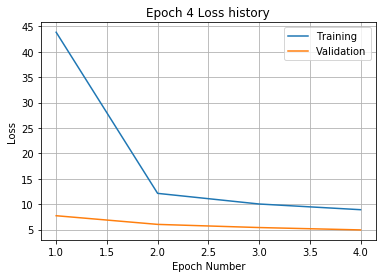

Training
Iteration 0: with minibatch training loss = 8.15 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.42 and relative error of 0.32
Iteration 60: with minibatch training loss = 9.56 and relative error of 0.36
Iteration 80: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.61 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.52 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.44 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.65 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.74 and relative error of 0.27
Epoch 5, Overall loss = 8.17, relative error = 0.328, and proces

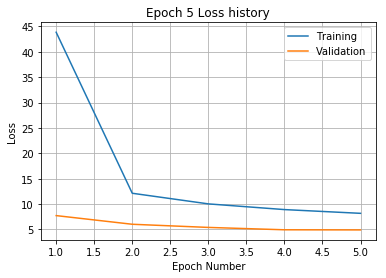

Training
Iteration 0: with minibatch training loss = 7.66 and relative error of 0.32
Iteration 20: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 40: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 60: with minibatch training loss = 9.19 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.32 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.03 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.72 and relative error of 0.34
Iteration 140: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.18 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.03 and relative error of 0.3
Epoch 6, Overall loss = 7.55, relative error = 0.315, and proc

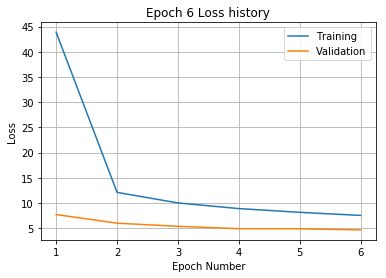

Training
Iteration 0: with minibatch training loss = 8.61 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.34 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 80: with minibatch training loss = 8.26 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 160: with minibatch training loss = 9.73 and relative error of 0.35
Iteration 180: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.97 and relative error of 0.3
Epoch 7, Overall loss = 7.16, relative error = 0.307, and proc

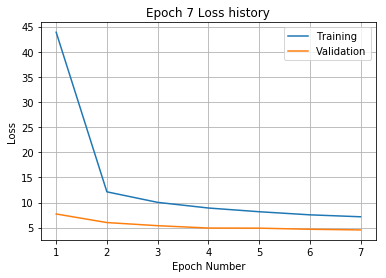

Training
Iteration 0: with minibatch training loss = 6.78 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.91 and relative error of 0.32
Iteration 60: with minibatch training loss = 9.27 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.78 and relative error of 0.34
Iteration 100: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 220: with minibatch training loss = 9.43 and relative error of 0.34
Epoch 8, Overall loss = 6.92, relative error = 0.301, and pro

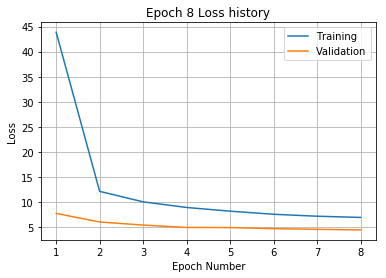

Training
Iteration 0: with minibatch training loss = 5.86 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.11 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 80: with minibatch training loss = 8.4 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.29 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.59 and relative error of 0.33
Iteration 140: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 180: with minibatch training loss = 9.6 and relative error of 0.35
Iteration 200: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.25 and relative error of 0.29
Epoch 9, Overall loss = 6.6, relative error = 0.294, and process

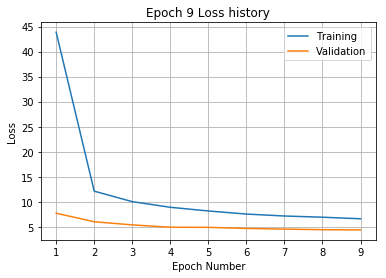

Training
Iteration 0: with minibatch training loss = 6.91 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.87 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.14 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.05 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.56 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 220: with minibatch training loss = 8.73 and relative error of 0.37
Epoch 10, Overall loss = 6.39, relative error = 0.289, and pro

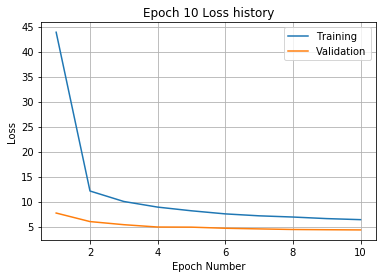

Training
Iteration 0: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.7 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.6 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.79 and relative error of 0.25
Epoch 11, Overall loss = 6.16, relative error = 0.284, and proce

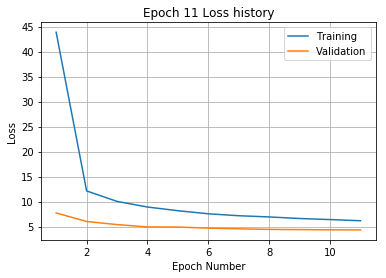

Training
Iteration 0: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.76 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.3 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.73 and relative error of 0.29
Epoch 12, Overall loss = 6.03, relative error = 0.281, and proces

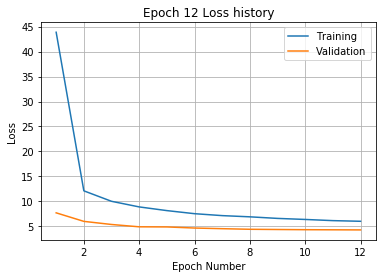

Training
Iteration 0: with minibatch training loss = 5.9 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.2 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 200: with minibatch training loss = 3.94 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.97 and relative error of 0.25
Epoch 13, Overall loss = 5.86, relative error = 0.277, and proce

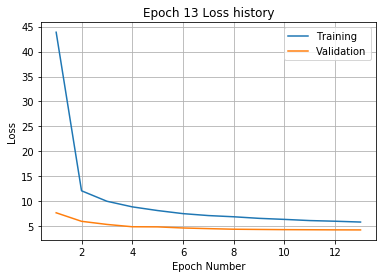

Training
Iteration 0: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.38 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.64 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.02 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.46 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.33 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.93 and relative error of 0.23
Epoch 14, Overall loss = 5.72, relative error = 0.274, and pr

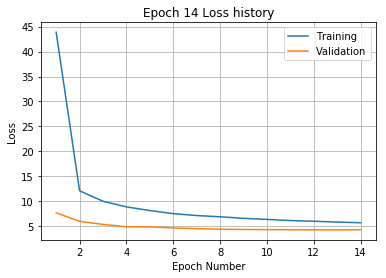

Training
Iteration 0: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.69 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 140: with minibatch training loss = 8.13 and relative error of 0.33
Iteration 160: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.24 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.75 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.87 and relative error of 0.28
Epoch 15, Overall loss = 5.57, relative error = 0.27, and pro

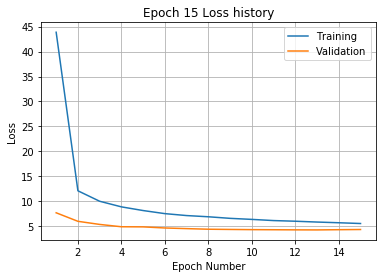

Training
Iteration 0: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.71 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.15 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.8 and relative error of 0.3
Epoch 16, Overall loss = 5.52, relative error = 0.269, and proc

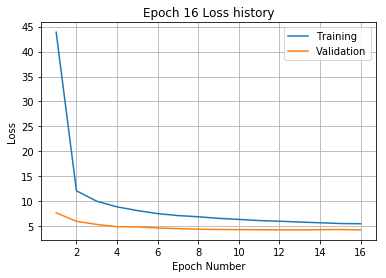

Training
Iteration 0: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.9 and relative error of 0.31
Iteration 40: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 140: with minibatch training loss = 8.46 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.46 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.26 and relative error of 0.21
Epoch 17, Overall loss = 5.34, relative error = 0.265, and proc

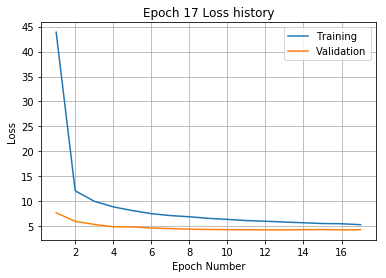

Training
Iteration 0: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 80: with minibatch training loss = 3.5 and relative error of 0.22
Iteration 100: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.34 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.5 and relative error of 0.27
Epoch 18, Overall loss = 5.26, relative error = 0.262, and proce

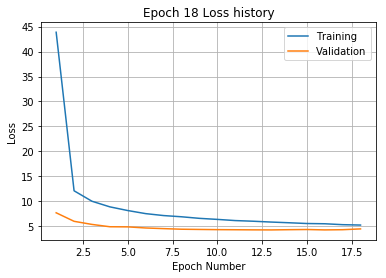

Validation error has stopped improving! Training on repetition 4 stopped!
Training
Iteration 0: with minibatch training loss = 233 and relative error of 1.7
Iteration 20: with minibatch training loss = 108 and relative error of 1.2
Iteration 40: with minibatch training loss = 71.4 and relative error of 0.94
Iteration 60: with minibatch training loss = 57 and relative error of 0.85
Iteration 80: with minibatch training loss = 40.2 and relative error of 0.73
Iteration 100: with minibatch training loss = 30.1 and relative error of 0.6
Iteration 120: with minibatch training loss = 25.3 and relative error of 0.58
Iteration 140: with minibatch training loss = 22.3 and relative error of 0.53
Iteration 160: with minibatch training loss = 19 and relative error of 0.5
Iteration 180: with minibatch training loss = 16 and relative error of 0.46
Iteration 200: with minibatch training loss = 15.1 and relative error of 0.43
Iteration 220: with minibatch training loss = 14.9 and relative error of 0.45

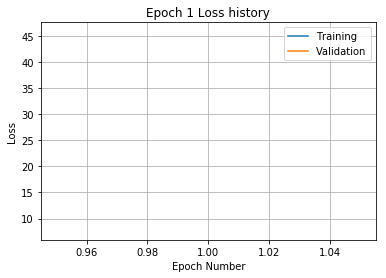

Training
Iteration 0: with minibatch training loss = 17.8 and relative error of 0.49
Iteration 20: with minibatch training loss = 14.9 and relative error of 0.45
Iteration 40: with minibatch training loss = 15.1 and relative error of 0.45
Iteration 60: with minibatch training loss = 15.4 and relative error of 0.45
Iteration 80: with minibatch training loss = 14.7 and relative error of 0.46
Iteration 100: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 120: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 140: with minibatch training loss = 10 and relative error of 0.36
Iteration 160: with minibatch training loss = 13.6 and relative error of 0.41
Iteration 180: with minibatch training loss = 16 and relative error of 0.46
Iteration 200: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 220: with minibatch training loss = 9.66 and relative error of 0.37
Epoch 2, Overall loss = 13, relative error = 0.412, and process t

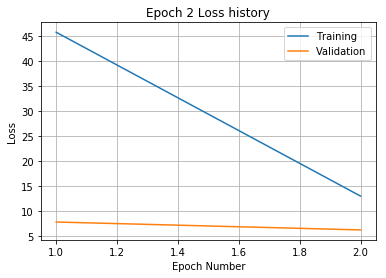

Training
Iteration 0: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 20: with minibatch training loss = 13.9 and relative error of 0.44
Iteration 40: with minibatch training loss = 12.7 and relative error of 0.42
Iteration 60: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 100: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.01 and relative error of 0.34
Iteration 140: with minibatch training loss = 13.1 and relative error of 0.41
Iteration 160: with minibatch training loss = 11.2 and relative error of 0.41
Iteration 180: with minibatch training loss = 8.79 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.91 and relative error of 0.36
Epoch 3, Overall loss = 10.5, relative error = 0.371, and proc

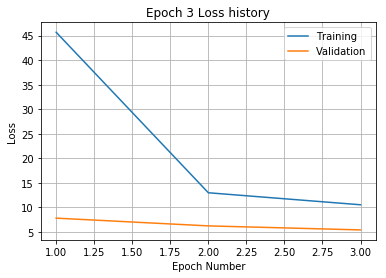

Training
Iteration 0: with minibatch training loss = 9.9 and relative error of 0.36
Iteration 20: with minibatch training loss = 9.19 and relative error of 0.34
Iteration 40: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 60: with minibatch training loss = 9.03 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.78 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.63 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.41 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.88 and relative error of 0.34
Iteration 160: with minibatch training loss = 9.43 and relative error of 0.35
Iteration 180: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.99 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.45 and relative error of 0.3
Epoch 4, Overall loss = 9.11, relative error = 0.345, and proce

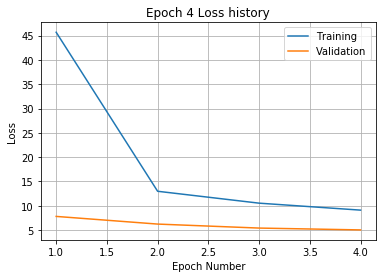

Training
Iteration 0: with minibatch training loss = 8.69 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.8 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.24 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.58 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.97 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.44 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.48 and relative error of 0.32
Epoch 5, Overall loss = 8.31, relative error = 0.33, and proces

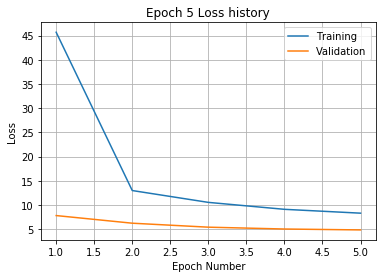

Training
Iteration 0: with minibatch training loss = 10.8 and relative error of 0.36
Iteration 20: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.49 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.07 and relative error of 0.27
Iteration 80: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 100: with minibatch training loss = 8.28 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.08 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.81 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 180: with minibatch training loss = 9.24 and relative error of 0.35
Iteration 200: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.23 and relative error of 0.28
Epoch 6, Overall loss = 7.7, relative error = 0.317, and proc

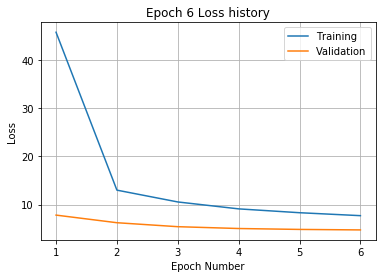

Training
Iteration 0: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.55 and relative error of 0.32
Iteration 80: with minibatch training loss = 10 and relative error of 0.37
Iteration 100: with minibatch training loss = 8.5 and relative error of 0.34
Iteration 120: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.78 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.65 and relative error of 0.32
Epoch 7, Overall loss = 7.27, relative error = 0.308, and process time

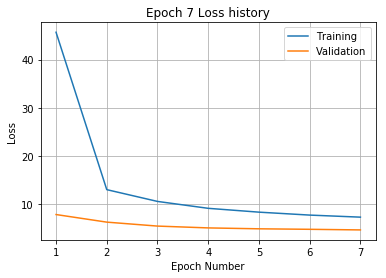

Training
Iteration 0: with minibatch training loss = 7.59 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.5 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.59 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.31 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.19 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 220: with minibatch training loss = 8.28 and relative error of 0.33
Epoch 8, Overall loss = 6.9, relative error = 0.3, and process time

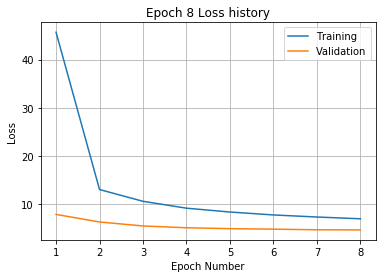

Training
Iteration 0: with minibatch training loss = 8.96 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.15 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 80: with minibatch training loss = 6.49 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.83 and relative error of 0.27
Iteration 120: with minibatch training loss = 8.29 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.99 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.42 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.13 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.16 and relative error of 0.32
Epoch 9, Overall loss = 6.63, relative error = 0.294, and process

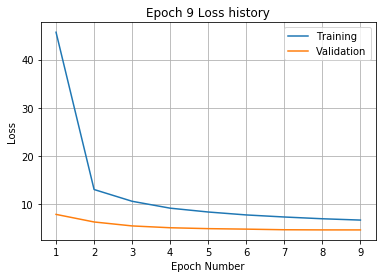

Training
Iteration 0: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.78 and relative error of 0.28
Iteration 40: with minibatch training loss = 9.13 and relative error of 0.34
Iteration 60: with minibatch training loss = 3.08 and relative error of 0.2
Iteration 80: with minibatch training loss = 7.59 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.85 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.31 and relative error of 0.3
Epoch 10, Overall loss = 6.37, relative error = 0.288, and process

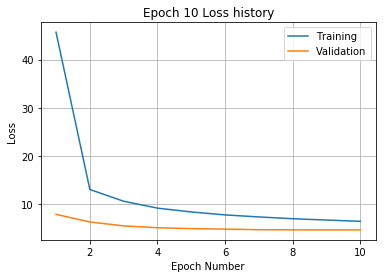

Training
Iteration 0: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 60: with minibatch training loss = 8.2 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 160: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 180: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.37 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.47 and relative error of 0.3
Epoch 11, Overall loss = 6.22, relative error = 0.285, and process 

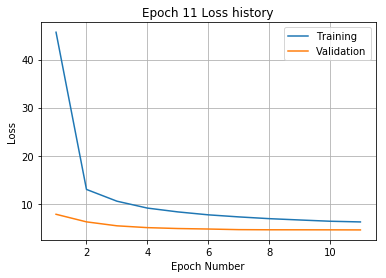

Training
Iteration 0: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.15 and relative error of 0.23
Iteration 80: with minibatch training loss = 8.36 and relative error of 0.33
Iteration 100: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.51 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.04 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 180: with minibatch training loss = 3.77 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.21 and relative error of 0.28
Epoch 12, Overall loss = 6.03, relative error = 0.28, and pro

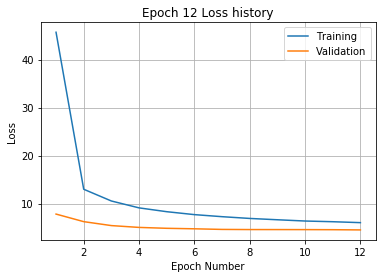

Training
Iteration 0: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 40: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 60: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.52 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.8 and relative error of 0.28
Epoch 13, Overall loss = 5.87, relative error = 0.277, and pro

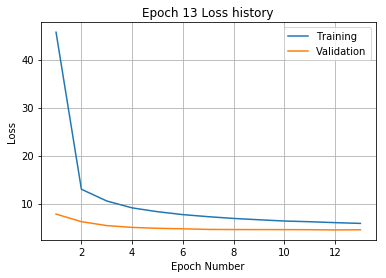

Training
Iteration 0: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 120: with minibatch training loss = 9.76 and relative error of 0.36
Iteration 140: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.13 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.08 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.82 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.37 and relative error of 0.27
Epoch 14, Overall loss = 5.7, relative error = 0.273, and pro

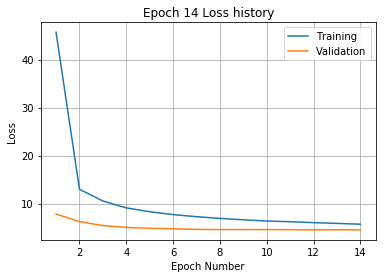

Training
Iteration 0: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 20: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 40: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 80: with minibatch training loss = 8.57 and relative error of 0.34
Iteration 100: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.89 and relative error of 0.31
Epoch 15, Overall loss = 5.58, relative error = 0.269, and pr

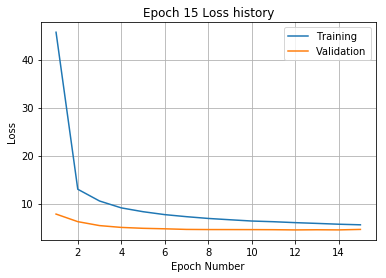

Training
Iteration 0: with minibatch training loss = 3.23 and relative error of 0.21
Iteration 20: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.53 and relative error of 0.21
Iteration 100: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.54 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 180: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.43 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.08 and relative error of 0.28
Epoch 16, Overall loss = 5.44, relative error = 0.266, and proce

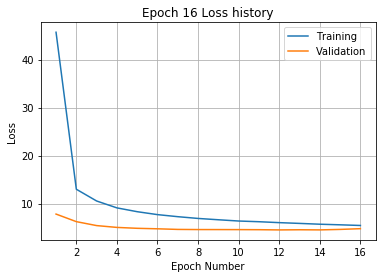

Training
Iteration 0: with minibatch training loss = 5.22 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.71 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 100: with minibatch training loss = 3.77 and relative error of 0.21
Iteration 120: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.18 and relative error of 0.28
Epoch 17, Overall loss = 5.32, relative error = 0.263, and proce

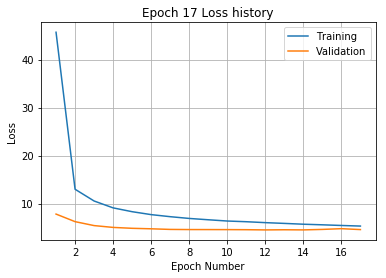

Validation error has stopped improving! Training on repetition 5 stopped!
Training
Iteration 0: with minibatch training loss = 181 and relative error of 1.6
Iteration 20: with minibatch training loss = 103 and relative error of 1.2
Iteration 40: with minibatch training loss = 69.6 and relative error of 1
Iteration 60: with minibatch training loss = 54.6 and relative error of 0.84
Iteration 80: with minibatch training loss = 35.8 and relative error of 0.69
Iteration 100: with minibatch training loss = 24.6 and relative error of 0.57
Iteration 120: with minibatch training loss = 20.6 and relative error of 0.53
Iteration 140: with minibatch training loss = 17.8 and relative error of 0.48
Iteration 160: with minibatch training loss = 18.1 and relative error of 0.51
Iteration 180: with minibatch training loss = 15.6 and relative error of 0.47
Iteration 200: with minibatch training loss = 14.6 and relative error of 0.44
Iteration 220: with minibatch training loss = 12.9 and relative error of

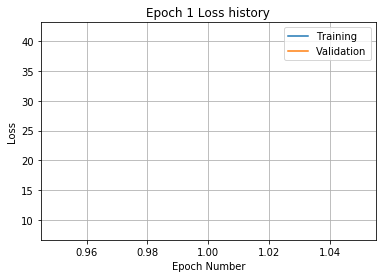

Training
Iteration 0: with minibatch training loss = 15.4 and relative error of 0.45
Iteration 20: with minibatch training loss = 11.2 and relative error of 0.4
Iteration 40: with minibatch training loss = 12.8 and relative error of 0.42
Iteration 60: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 80: with minibatch training loss = 14.1 and relative error of 0.43
Iteration 100: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 120: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 140: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 160: with minibatch training loss = 15.1 and relative error of 0.43
Iteration 180: with minibatch training loss = 9.63 and relative error of 0.36
Iteration 200: with minibatch training loss = 13.7 and relative error of 0.44
Iteration 220: with minibatch training loss = 8.95 and relative error of 0.34
Epoch 2, Overall loss = 11.9, relative error = 0.395, and proc

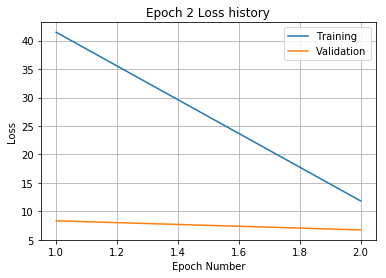

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 20: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.95 and relative error of 0.33
Iteration 60: with minibatch training loss = 9.45 and relative error of 0.36
Iteration 80: with minibatch training loss = 9.46 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.9 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.63 and relative error of 0.35
Iteration 160: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 180: with minibatch training loss = 8.72 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.75 and relative error of 0.35
Iteration 220: with minibatch training loss = 9.01 and relative error of 0.35
Epoch 3, Overall loss = 9.8, relative error = 0.359, and proce

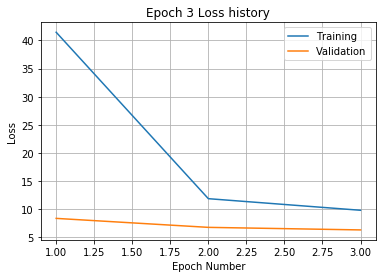

Training
Iteration 0: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.64 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 60: with minibatch training loss = 10.2 and relative error of 0.35
Iteration 80: with minibatch training loss = 9.98 and relative error of 0.38
Iteration 100: with minibatch training loss = 9.77 and relative error of 0.36
Iteration 120: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 140: with minibatch training loss = 9.8 and relative error of 0.37
Iteration 160: with minibatch training loss = 8.79 and relative error of 0.35
Iteration 180: with minibatch training loss = 8.64 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.06 and relative error of 0.35
Epoch 4, Overall loss = 8.6, relative error = 0.337, and proces

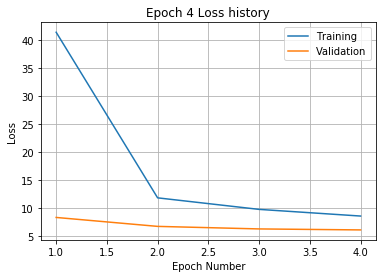

Training
Iteration 0: with minibatch training loss = 7.25 and relative error of 0.32
Iteration 20: with minibatch training loss = 9.56 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.31 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 100: with minibatch training loss = 7 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.32 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.41 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.91 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.83 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.88 and relative error of 0.32
Epoch 5, Overall loss = 7.83, relative error = 0.321, and process

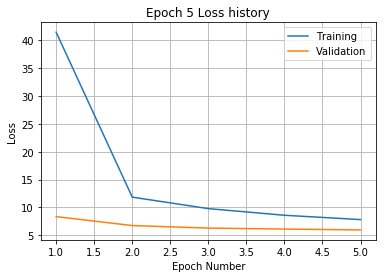

Training
Iteration 0: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.38 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.33 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.66 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.93 and relative error of 0.33
Iteration 200: with minibatch training loss = 9.02 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.22 and relative error of 0.32
Epoch 6, Overall loss = 7.28, relative error = 0.309, and process 

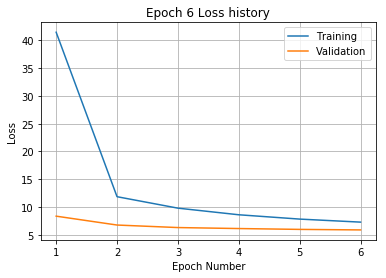

Training
Iteration 0: with minibatch training loss = 6.71 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.74 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.89 and relative error of 0.29
Iteration 80: with minibatch training loss = 8.74 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.26 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.5 and relative error of 0.33
Iteration 220: with minibatch training loss = 5.22 and relative error of 0.27
Epoch 7, Overall loss = 6.88, relative error = 0.301, and proces

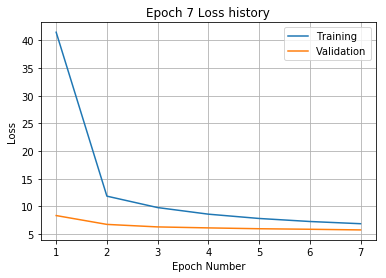

Training
Iteration 0: with minibatch training loss = 7.36 and relative error of 0.33
Iteration 20: with minibatch training loss = 5.51 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.34 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.2 and relative error of 0.27
Iteration 120: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 140: with minibatch training loss = 6.42 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.35 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.19 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.65 and relative error of 0.27
Epoch 8, Overall loss = 6.6, relative error = 0.295, and process

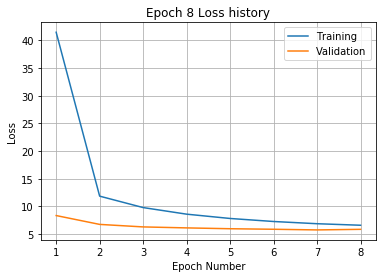

Training
Iteration 0: with minibatch training loss = 7.26 and relative error of 0.33
Iteration 20: with minibatch training loss = 4.77 and relative error of 0.24
Iteration 40: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.86 and relative error of 0.3
Epoch 9, Overall loss = 6.3, relative error = 0.288, and process

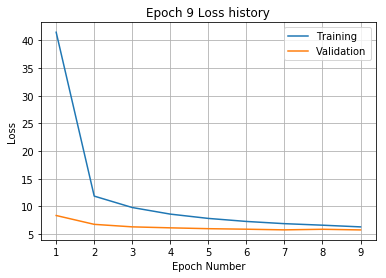

Training
Iteration 0: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.82 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.18 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 200: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.51 and relative error of 0.31
Epoch 10, Overall loss = 6.1, relative error = 0.283, and proce

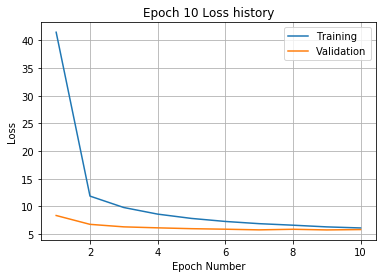

Training
Iteration 0: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.74 and relative error of 0.22
Iteration 40: with minibatch training loss = 6.93 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 80: with minibatch training loss = 8.17 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.67 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.56 and relative error of 0.26
Epoch 11, Overall loss = 5.87, relative error = 0.278, and proc

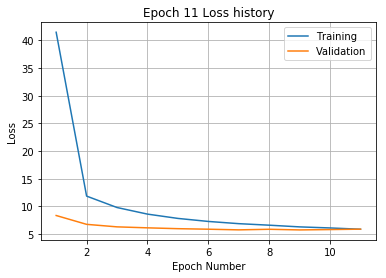

Training
Iteration 0: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 20: with minibatch training loss = 3.78 and relative error of 0.23
Iteration 40: with minibatch training loss = 8.96 and relative error of 0.34
Iteration 60: with minibatch training loss = 4 and relative error of 0.23
Iteration 80: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.72 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 220: with minibatch training loss = 8 and relative error of 0.32
Epoch 12, Overall loss = 5.79, relative error = 0.276, and process 

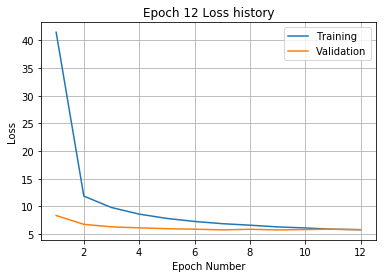

Training
Iteration 0: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 60: with minibatch training loss = 6.04 and relative error of 0.29
Iteration 80: with minibatch training loss = 5 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.14 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.36 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.2 and relative error of 0.27
Epoch 13, Overall loss = 5.59, relative error = 0.271, and proces

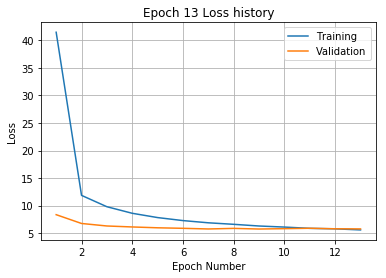

Training
Iteration 0: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.18 and relative error of 0.27
Iteration 40: with minibatch training loss = 3.63 and relative error of 0.21
Iteration 60: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.93 and relative error of 0.22
Iteration 120: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.6 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.89 and relative error of 0.28
Epoch 14, Overall loss = 5.45, relative error = 0.268, and pro

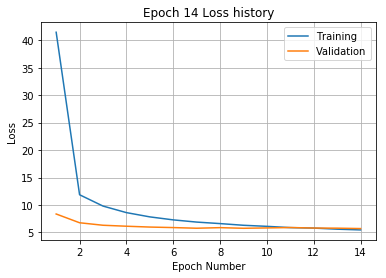

Training
Iteration 0: with minibatch training loss = 5.18 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.95 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 120: with minibatch training loss = 3.6 and relative error of 0.21
Iteration 140: with minibatch training loss = 3.81 and relative error of 0.21
Iteration 160: with minibatch training loss = 7.41 and relative error of 0.32
Iteration 180: with minibatch training loss = 3.98 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.51 and relative error of 0.27
Epoch 15, Overall loss = 5.29, relative error = 0.263, and pro

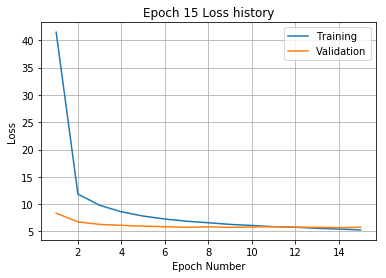

Training
Iteration 0: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.67 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.21 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.49 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.43 and relative error of 0.28
Iteration 180: with minibatch training loss = 3.53 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.73 and relative error of 0.27
Epoch 16, Overall loss = 5.21, relative error = 0.261, and proc

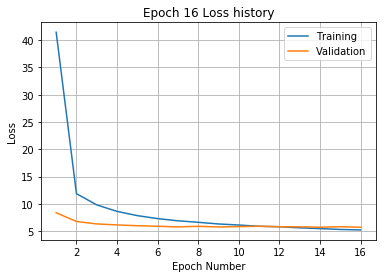

Training
Iteration 0: with minibatch training loss = 3.64 and relative error of 0.22
Iteration 20: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.1 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.7 and relative error of 0.32
Iteration 160: with minibatch training loss = 4.03 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.88 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.22 and relative error of 0.28
Epoch 17, Overall loss = 5.1, relative error = 0.259, and proces

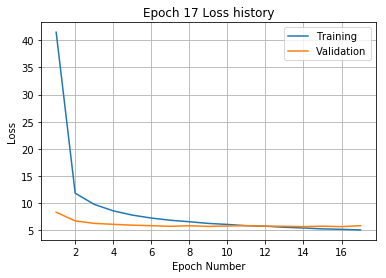

Training
Iteration 0: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 80: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.98 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.6 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.88 and relative error of 0.22
Epoch 18, Overall loss = 4.98, relative error = 0.255, and proce

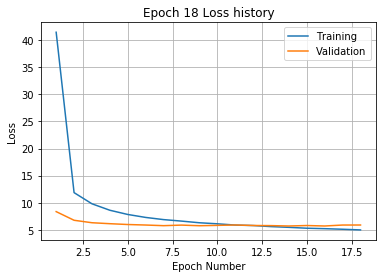

Training
Iteration 0: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.15 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.02 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.31 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 220: with minibatch training loss = 3.86 and relative error of 0.23
Epoch 19, Overall loss = 4.92, relative error = 0.254, and pr

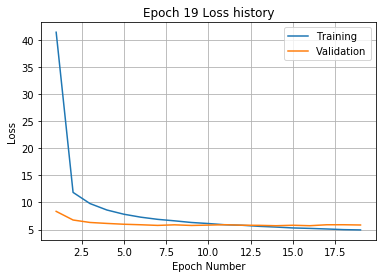

Validation error has stopped improving! Training on repetition 6 stopped!
Training
Iteration 0: with minibatch training loss = 304 and relative error of 2
Iteration 20: with minibatch training loss = 159 and relative error of 1.4
Iteration 40: with minibatch training loss = 100 and relative error of 1.1
Iteration 60: with minibatch training loss = 78.4 and relative error of 1
Iteration 80: with minibatch training loss = 58.9 and relative error of 0.86
Iteration 100: with minibatch training loss = 43.9 and relative error of 0.77
Iteration 120: with minibatch training loss = 30.7 and relative error of 0.64
Iteration 140: with minibatch training loss = 27.4 and relative error of 0.61
Iteration 160: with minibatch training loss = 21.8 and relative error of 0.55
Iteration 180: with minibatch training loss = 18.3 and relative error of 0.49
Iteration 200: with minibatch training loss = 19.1 and relative error of 0.48
Iteration 220: with minibatch training loss = 17.6 and relative error of 0.4

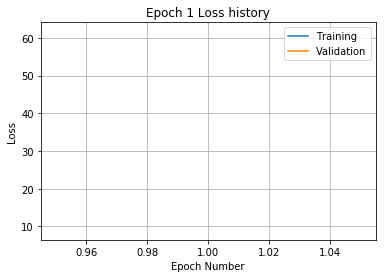

Training
Iteration 0: with minibatch training loss = 17.8 and relative error of 0.47
Iteration 20: with minibatch training loss = 14.3 and relative error of 0.42
Iteration 40: with minibatch training loss = 13.5 and relative error of 0.43
Iteration 60: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 80: with minibatch training loss = 12.3 and relative error of 0.39
Iteration 100: with minibatch training loss = 15.6 and relative error of 0.46
Iteration 120: with minibatch training loss = 9.91 and relative error of 0.38
Iteration 140: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 160: with minibatch training loss = 9.84 and relative error of 0.36
Iteration 180: with minibatch training loss = 14.3 and relative error of 0.44
Iteration 200: with minibatch training loss = 11.8 and relative error of 0.4
Iteration 220: with minibatch training loss = 12.8 and relative error of 0.39
Epoch 2, Overall loss = 13.7, relative error = 0.424, and proce

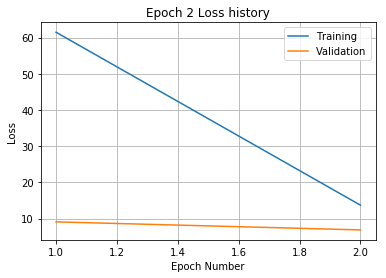

Training
Iteration 0: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 20: with minibatch training loss = 13.9 and relative error of 0.43
Iteration 40: with minibatch training loss = 10.2 and relative error of 0.35
Iteration 60: with minibatch training loss = 12.5 and relative error of 0.39
Iteration 80: with minibatch training loss = 13.4 and relative error of 0.41
Iteration 100: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 120: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 140: with minibatch training loss = 8.24 and relative error of 0.32
Iteration 160: with minibatch training loss = 9.04 and relative error of 0.34
Iteration 180: with minibatch training loss = 10 and relative error of 0.38
Iteration 200: with minibatch training loss = 13.5 and relative error of 0.42
Iteration 220: with minibatch training loss = 11.3 and relative error of 0.37
Epoch 3, Overall loss = 11, relative error = 0.379, and process

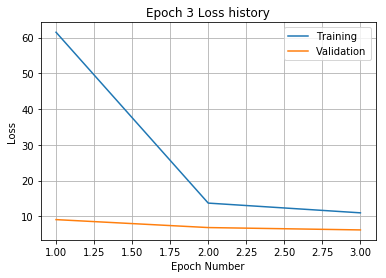

Training
Iteration 0: with minibatch training loss = 9.86 and relative error of 0.38
Iteration 20: with minibatch training loss = 9.14 and relative error of 0.35
Iteration 40: with minibatch training loss = 9.1 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.48 and relative error of 0.34
Iteration 100: with minibatch training loss = 8.55 and relative error of 0.34
Iteration 120: with minibatch training loss = 13.5 and relative error of 0.41
Iteration 140: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 160: with minibatch training loss = 8.75 and relative error of 0.33
Iteration 180: with minibatch training loss = 9.13 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.11 and relative error of 0.36
Epoch 4, Overall loss = 9.77, relative error = 0.358, and proce

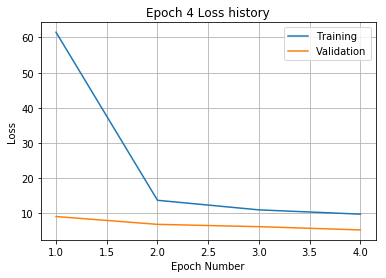

Training
Iteration 0: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.11 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.54 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.55 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 120: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 160: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 200: with minibatch training loss = 9 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.43 and relative error of 0.32
Epoch 5, Overall loss = 8.79, relative error = 0.339, and process ti

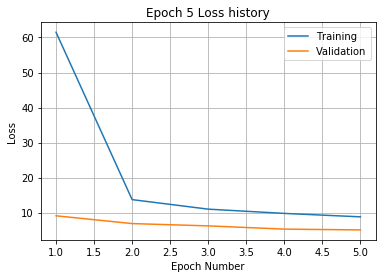

Training
Iteration 0: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 20: with minibatch training loss = 9.62 and relative error of 0.36
Iteration 40: with minibatch training loss = 7.84 and relative error of 0.31
Iteration 60: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 80: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.41 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.06 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.67 and relative error of 0.33
Iteration 160: with minibatch training loss = 8.69 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.47 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.88 and relative error of 0.33
Iteration 220: with minibatch training loss = 11.9 and relative error of 0.38
Epoch 6, Overall loss = 8.26, relative error = 0.329, and proc

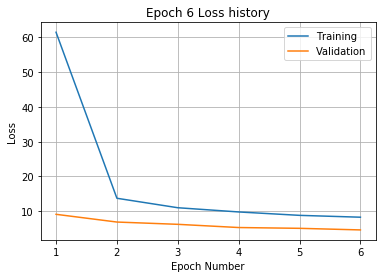

Training
Iteration 0: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.31 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.15 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.43 and relative error of 0.32
Iteration 160: with minibatch training loss = 9.78 and relative error of 0.35
Iteration 180: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 200: with minibatch training loss = 8.44 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.96 and relative error of 0.35
Epoch 7, Overall loss = 7.74, relative error = 0.318, and proces

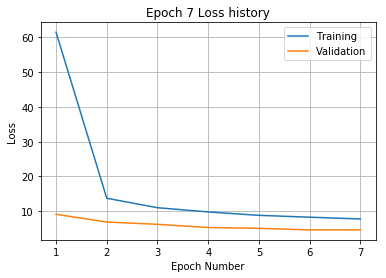

Training
Iteration 0: with minibatch training loss = 8.09 and relative error of 0.32
Iteration 20: with minibatch training loss = 9.08 and relative error of 0.33
Iteration 40: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 60: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 80: with minibatch training loss = 9.45 and relative error of 0.36
Iteration 100: with minibatch training loss = 7.02 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.63 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.86 and relative error of 0.28
Epoch 8, Overall loss = 7.31, relative error = 0.309, and process

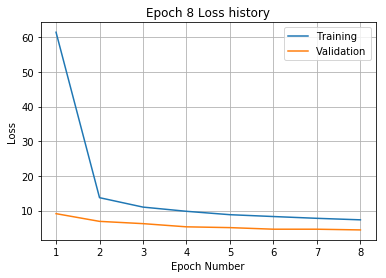

Training
Iteration 0: with minibatch training loss = 6.23 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 80: with minibatch training loss = 8.21 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.86 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.94 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.28 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.01 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.57 and relative error of 0.29
Epoch 9, Overall loss = 7.01, relative error = 0.303, and process

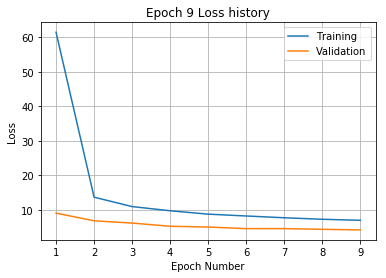

Training
Iteration 0: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.43 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.73 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.97 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.57 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.87 and relative error of 0.26
Epoch 10, Overall loss = 6.76, relative error = 0.297, and pro

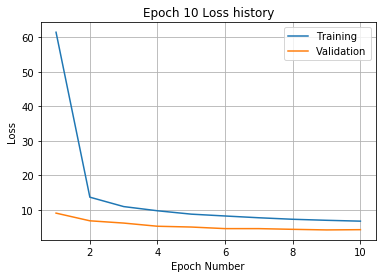

Training
Iteration 0: with minibatch training loss = 7.57 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.58 and relative error of 0.34
Iteration 40: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.66 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 140: with minibatch training loss = 8.03 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.06 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.14 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.9 and relative error of 0.28
Epoch 11, Overall loss = 6.53, relative error = 0.293, and proce

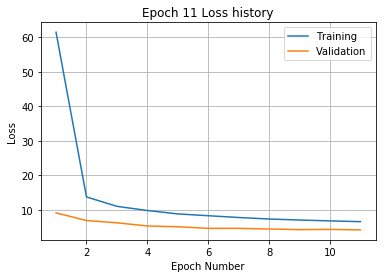

Training
Iteration 0: with minibatch training loss = 6.43 and relative error of 0.3
Iteration 20: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.2 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.56 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.37 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.86 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.77 and relative error of 0.31
Iteration 220: with minibatch training loss = 4.81 and relative error of 0.26
Epoch 12, Overall loss = 6.36, relative error = 0.288, and proces

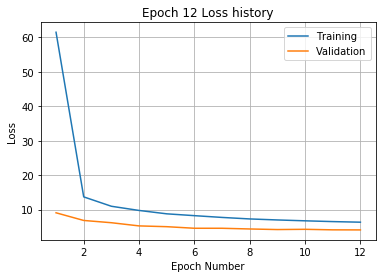

Training
Iteration 0: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.24 and relative error of 0.29
Epoch 13, Overall loss = 6.16, relative error = 0.284, and pro

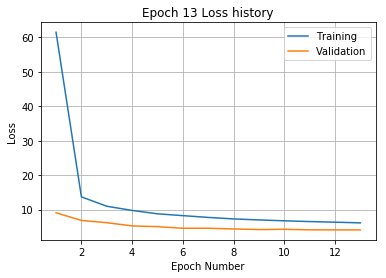

Training
Iteration 0: with minibatch training loss = 6.91 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.13 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.99 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.99 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.85 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.14 and relative error of 0.32
Iteration 140: with minibatch training loss = 9.12 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.07 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.11 and relative error of 0.3
Epoch 14, Overall loss = 5.99, relative error = 0.28, and proces

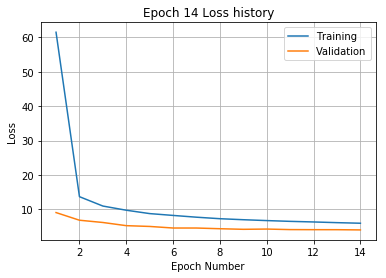

Training
Iteration 0: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 40: with minibatch training loss = 8.03 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.6 and relative error of 0.28
Iteration 80: with minibatch training loss = 5 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.59 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 220: with minibatch training loss = 8.26 and relative error of 0.32
Epoch 15, Overall loss = 5.83, relative error = 0.276, and proces

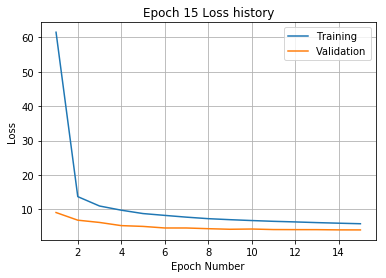

Training
Iteration 0: with minibatch training loss = 6.69 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.64 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.64 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.24 and relative error of 0.28
Epoch 16, Overall loss = 5.75, relative error = 0.274, and proc

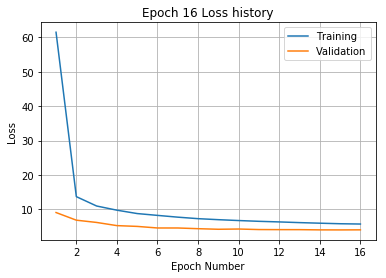

Training
Iteration 0: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.29 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.31 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.74 and relative error of 0.25
Epoch 17, Overall loss = 5.63, relative error = 0.271, and proc

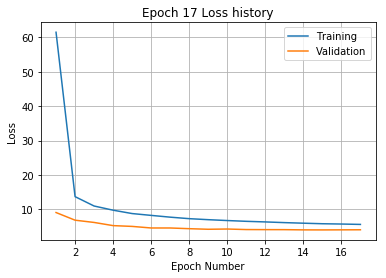

Training
Iteration 0: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 80: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 100: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 120: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.43 and relative error of 0.21
Iteration 180: with minibatch training loss = 7.6 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.8 and relative error of 0.28
Epoch 18, Overall loss = 5.49, relative error = 0.267, and process

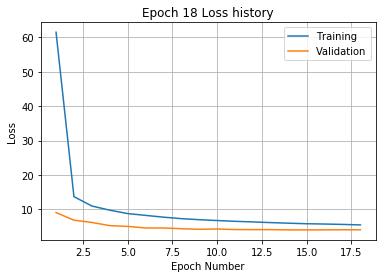

Training
Iteration 0: with minibatch training loss = 5.94 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.09 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.31 and relative error of 0.23
Iteration 160: with minibatch training loss = 3.67 and relative error of 0.22
Iteration 180: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.82 and relative error of 0.25
Epoch 19, Overall loss = 5.39, relative error = 0.265, and pr

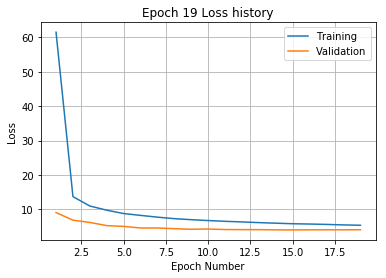

Training
Iteration 0: with minibatch training loss = 5.22 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.26 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.41 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 160: with minibatch training loss = 3.7 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.37 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.91 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.97 and relative error of 0.23
Epoch 20, Overall loss = 5.33, relative error = 0.264, and pro

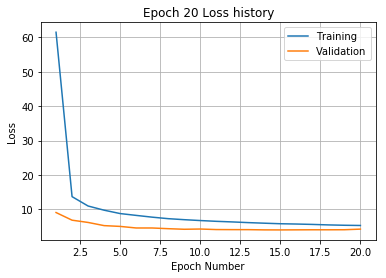

Validation error has stopped improving! Training on repetition 7 stopped!
Training
Iteration 0: with minibatch training loss = 121 and relative error of 1.3
Iteration 20: with minibatch training loss = 94.2 and relative error of 1.1
Iteration 40: with minibatch training loss = 60.5 and relative error of 0.91
Iteration 60: with minibatch training loss = 43 and relative error of 0.76
Iteration 80: with minibatch training loss = 33.9 and relative error of 0.65
Iteration 100: with minibatch training loss = 26.6 and relative error of 0.59
Iteration 120: with minibatch training loss = 22 and relative error of 0.54
Iteration 140: with minibatch training loss = 20.1 and relative error of 0.5
Iteration 160: with minibatch training loss = 13.5 and relative error of 0.43
Iteration 180: with minibatch training loss = 15.9 and relative error of 0.45
Iteration 200: with minibatch training loss = 13.9 and relative error of 0.45
Iteration 220: with minibatch training loss = 16.4 and relative error of 

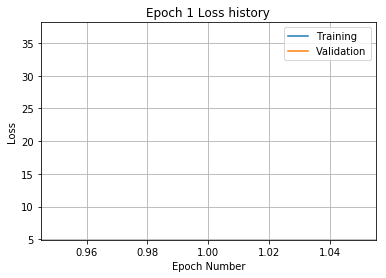

Training
Iteration 0: with minibatch training loss = 17.9 and relative error of 0.49
Iteration 20: with minibatch training loss = 14 and relative error of 0.43
Iteration 40: with minibatch training loss = 16 and relative error of 0.46
Iteration 60: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 80: with minibatch training loss = 13.7 and relative error of 0.42
Iteration 100: with minibatch training loss = 14 and relative error of 0.43
Iteration 120: with minibatch training loss = 12.7 and relative error of 0.4
Iteration 140: with minibatch training loss = 13.3 and relative error of 0.41
Iteration 160: with minibatch training loss = 13.1 and relative error of 0.43
Iteration 180: with minibatch training loss = 13.3 and relative error of 0.42
Iteration 200: with minibatch training loss = 12.7 and relative error of 0.42
Iteration 220: with minibatch training loss = 12.1 and relative error of 0.4
Epoch 2, Overall loss = 12.7, relative error = 0.409, and process time

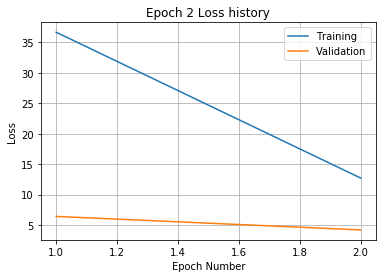

Training
Iteration 0: with minibatch training loss = 13.4 and relative error of 0.41
Iteration 20: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 40: with minibatch training loss = 11.1 and relative error of 0.37
Iteration 60: with minibatch training loss = 9.9 and relative error of 0.37
Iteration 80: with minibatch training loss = 11 and relative error of 0.37
Iteration 100: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 120: with minibatch training loss = 9.63 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 160: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 180: with minibatch training loss = 9.65 and relative error of 0.37
Iteration 200: with minibatch training loss = 9.3 and relative error of 0.36
Iteration 220: with minibatch training loss = 13.2 and relative error of 0.42
Epoch 3, Overall loss = 10.4, relative error = 0.369, and process 

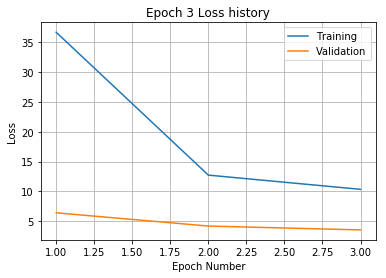

Training
Iteration 0: with minibatch training loss = 9.28 and relative error of 0.35
Iteration 20: with minibatch training loss = 11 and relative error of 0.4
Iteration 40: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 60: with minibatch training loss = 8.54 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.6 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.57 and relative error of 0.35
Iteration 140: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 160: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 180: with minibatch training loss = 11 and relative error of 0.38
Iteration 200: with minibatch training loss = 9.33 and relative error of 0.36
Iteration 220: with minibatch training loss = 10.3 and relative error of 0.36
Epoch 4, Overall loss = 9.15, relative error = 0.347, and process t

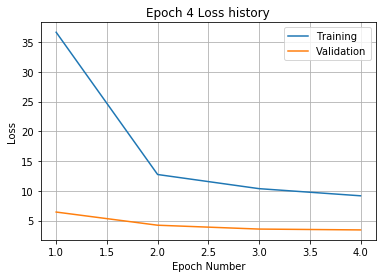

Training
Iteration 0: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 20: with minibatch training loss = 9.68 and relative error of 0.35
Iteration 40: with minibatch training loss = 12 and relative error of 0.39
Iteration 60: with minibatch training loss = 7.93 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 120: with minibatch training loss = 9.28 and relative error of 0.34
Iteration 140: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 160: with minibatch training loss = 9.17 and relative error of 0.36
Iteration 180: with minibatch training loss = 7.41 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.97 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.38 and relative error of 0.31
Epoch 5, Overall loss = 8.26, relative error = 0.33, and process

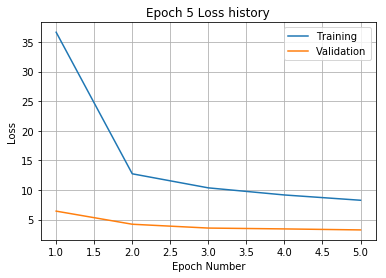

Training
Iteration 0: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 40: with minibatch training loss = 9.06 and relative error of 0.34
Iteration 60: with minibatch training loss = 9.83 and relative error of 0.36
Iteration 80: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 140: with minibatch training loss = 9.66 and relative error of 0.35
Iteration 160: with minibatch training loss = 7.85 and relative error of 0.35
Iteration 180: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.16 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.23 and relative error of 0.32
Epoch 6, Overall loss = 7.74, relative error = 0.319, and proc

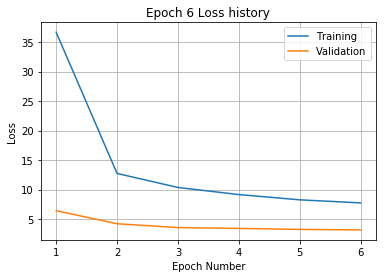

Training
Iteration 0: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.38 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.63 and relative error of 0.33
Iteration 80: with minibatch training loss = 9.58 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.71 and relative error of 0.35
Iteration 120: with minibatch training loss = 7.13 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.36 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.99 and relative error of 0.26
Epoch 7, Overall loss = 7.37, relative error = 0.311, and proce

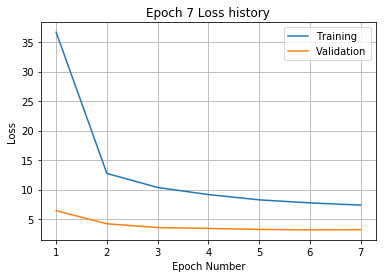

Training
Iteration 0: with minibatch training loss = 8.38 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.12 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.94 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.91 and relative error of 0.35
Iteration 120: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.39 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.87 and relative error of 0.29
Epoch 8, Overall loss = 7.07, relative error = 0.305, and pro

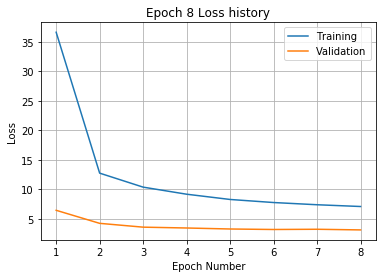

Training
Iteration 0: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.57 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.06 and relative error of 0.26
Epoch 9, Overall loss = 6.85, relative error = 0.3, and proces

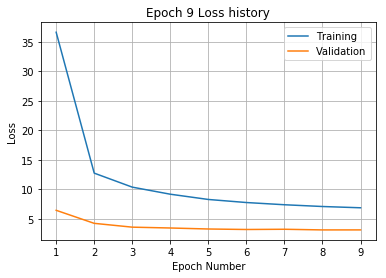

Training
Iteration 0: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 80: with minibatch training loss = 8.24 and relative error of 0.34
Iteration 100: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 220: with minibatch training loss = 8 and relative error of 0.33
Epoch 10, Overall loss = 6.6, relative error = 0.294, and process 

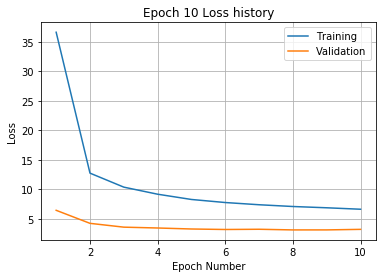

Training
Iteration 0: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.92 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.89 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.55 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.22 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.09 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.43 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.96 and relative error of 0.27
Epoch 11, Overall loss = 6.4, relative error = 0.29, and proce

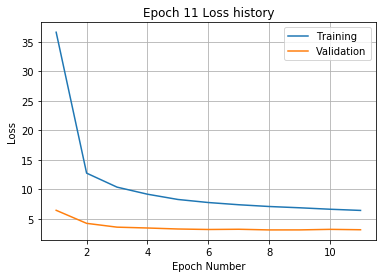

Training
Iteration 0: with minibatch training loss = 4.31 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.39 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.59 and relative error of 0.32
Iteration 80: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.65 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 140: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 160: with minibatch training loss = 7.92 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.48 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.1 and relative error of 0.24
Epoch 12, Overall loss = 6.19, relative error = 0.285, and proce

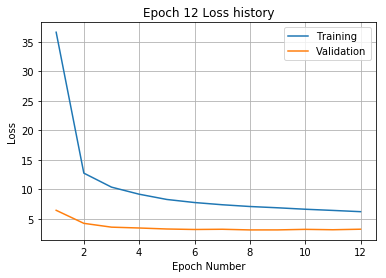

Training
Iteration 0: with minibatch training loss = 5.52 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.84 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.89 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.07 and relative error of 0.29
Epoch 13, Overall loss = 6.01, relative error = 0.281, and pr

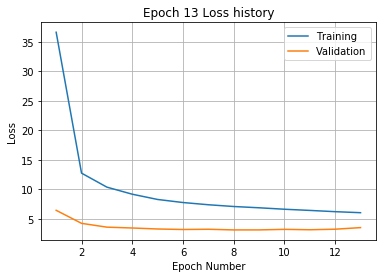

Validation error has stopped improving! Training on repetition 8 stopped!
Training
Iteration 0: with minibatch training loss = 258 and relative error of 1.8
Iteration 20: with minibatch training loss = 135 and relative error of 1.3
Iteration 40: with minibatch training loss = 76.3 and relative error of 1
Iteration 60: with minibatch training loss = 48.9 and relative error of 0.81
Iteration 80: with minibatch training loss = 37.1 and relative error of 0.72
Iteration 100: with minibatch training loss = 28 and relative error of 0.64
Iteration 120: with minibatch training loss = 23.2 and relative error of 0.54
Iteration 140: with minibatch training loss = 21.7 and relative error of 0.55
Iteration 160: with minibatch training loss = 18.3 and relative error of 0.48
Iteration 180: with minibatch training loss = 18.2 and relative error of 0.49
Iteration 200: with minibatch training loss = 14.9 and relative error of 0.46
Iteration 220: with minibatch training loss = 14.5 and relative error of 0

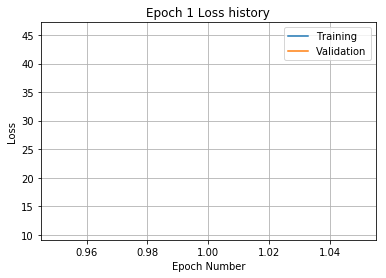

Training
Iteration 0: with minibatch training loss = 12.9 and relative error of 0.4
Iteration 20: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 40: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 60: with minibatch training loss = 12.8 and relative error of 0.43
Iteration 80: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 100: with minibatch training loss = 13.2 and relative error of 0.42
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.9 and relative error of 0.35
Iteration 160: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 180: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 200: with minibatch training loss = 9.23 and relative error of 0.35
Iteration 220: with minibatch training loss = 12.5 and relative error of 0.4
Epoch 2, Overall loss = 11.7, relative error = 0.393, and proces

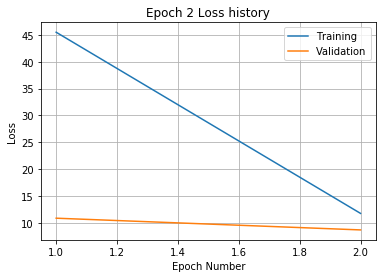

Training
Iteration 0: with minibatch training loss = 8.57 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.06 and relative error of 0.35
Iteration 40: with minibatch training loss = 8.63 and relative error of 0.34
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 80: with minibatch training loss = 12.3 and relative error of 0.41
Iteration 100: with minibatch training loss = 8.88 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.99 and relative error of 0.34
Iteration 140: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 160: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.04 and relative error of 0.33
Iteration 200: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 220: with minibatch training loss = 9.26 and relative error of 0.35
Epoch 3, Overall loss = 9.5, relative error = 0.353, and proce

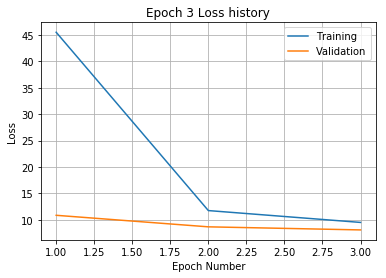

Training
Iteration 0: with minibatch training loss = 7.95 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.09 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.93 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.82 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.51 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.7 and relative error of 0.31
Iteration 160: with minibatch training loss = 8.08 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.41 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.1 and relative error of 0.34
Iteration 220: with minibatch training loss = 6.38 and relative error of 0.29
Epoch 4, Overall loss = 8.48, relative error = 0.334, and proces

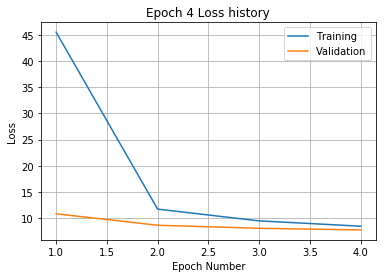

Training
Iteration 0: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.57 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.91 and relative error of 0.33
Iteration 120: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 140: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 160: with minibatch training loss = 9.32 and relative error of 0.34
Iteration 180: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.66 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.91 and relative error of 0.3
Epoch 5, Overall loss = 7.69, relative error = 0.317, and proce

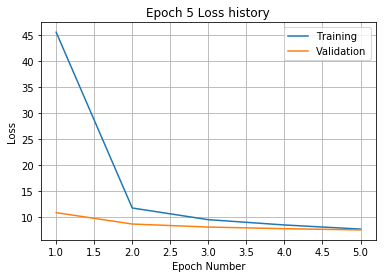

Training
Iteration 0: with minibatch training loss = 9.39 and relative error of 0.36
Iteration 20: with minibatch training loss = 7.39 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.33 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.71 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.4 and relative error of 0.32
Iteration 140: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.57 and relative error of 0.3
Iteration 180: with minibatch training loss = 10.1 and relative error of 0.35
Iteration 200: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.94 and relative error of 0.3
Epoch 6, Overall loss = 7.19, relative error = 0.307, and process

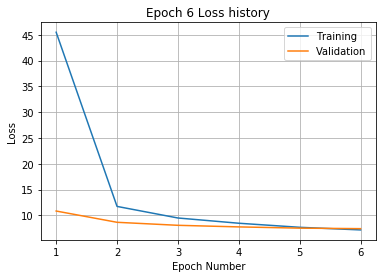

Training
Iteration 0: with minibatch training loss = 7.35 and relative error of 0.32
Iteration 20: with minibatch training loss = 9.65 and relative error of 0.36
Iteration 40: with minibatch training loss = 7.37 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 80: with minibatch training loss = 10.9 and relative error of 0.36
Iteration 100: with minibatch training loss = 6.99 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.93 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.88 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 220: with minibatch training loss = 9.28 and relative error of 0.34
Epoch 7, Overall loss = 6.82, relative error = 0.299, and pro

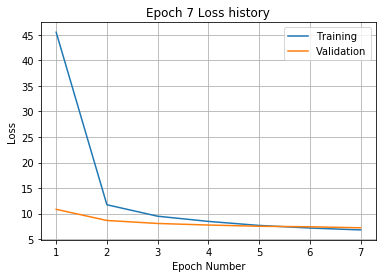

Training
Iteration 0: with minibatch training loss = 7.51 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.42 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.26 and relative error of 0.33
Iteration 100: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 120: with minibatch training loss = 7.34 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.01 and relative error of 0.23
Iteration 220: with minibatch training loss = 7.01 and relative error of 0.3
Epoch 8, Overall loss = 6.46, relative error = 0.291, and proces

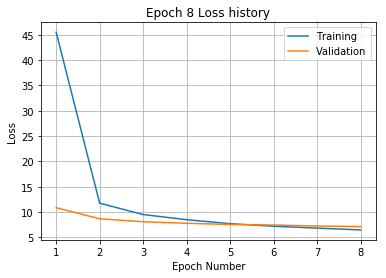

Training
Iteration 0: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 20: with minibatch training loss = 7.43 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.98 and relative error of 0.27
Iteration 80: with minibatch training loss = 8.71 and relative error of 0.36
Iteration 100: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.38 and relative error of 0.32
Epoch 9, Overall loss = 6.28, relative error = 0.287, and proc

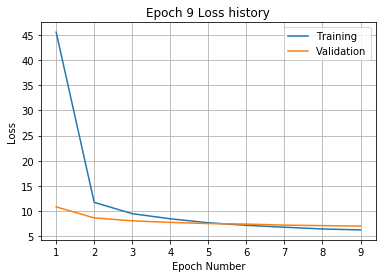

Training
Iteration 0: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.38 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.85 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.88 and relative error of 0.29
Epoch 10, Overall loss = 6.04, relative error = 0.281, and proce

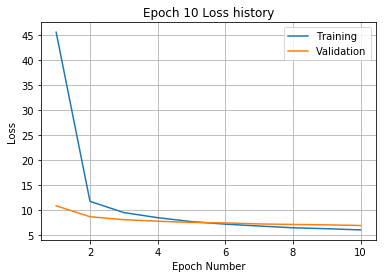

Training
Iteration 0: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.95 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 60: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 80: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 100: with minibatch training loss = 3.99 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.46 and relative error of 0.28
Epoch 11, Overall loss = 5.85, relative error = 0.277, and pr

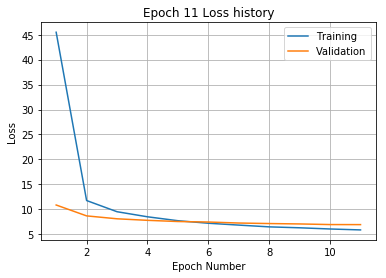

Training
Iteration 0: with minibatch training loss = 7.35 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.24 and relative error of 0.27
Iteration 40: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 60: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 80: with minibatch training loss = 9.68 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.97 and relative error of 0.27
Iteration 200: with minibatch training loss = 4 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.5 and relative error of 0.26
Epoch 12, Overall loss = 5.71, relative error = 0.273, and process 

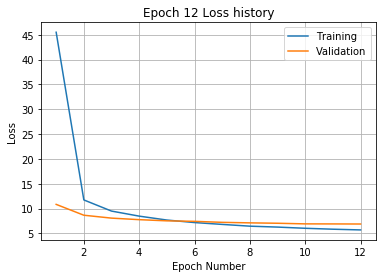

Training
Iteration 0: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.28 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.79 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.41 and relative error of 0.25
Epoch 13, Overall loss = 5.5, relative error = 0.268, and proce

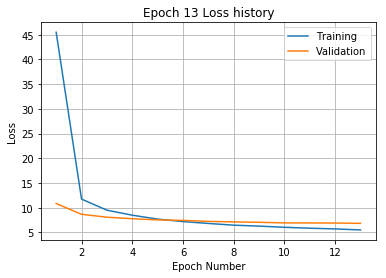

Training
Iteration 0: with minibatch training loss = 3.78 and relative error of 0.22
Iteration 20: with minibatch training loss = 7.28 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.75 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.99 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.09 and relative error of 0.25
Iteration 220: with minibatch training loss = 5 and relative error of 0.25
Epoch 14, Overall loss = 5.42, relative error = 0.266, and proce

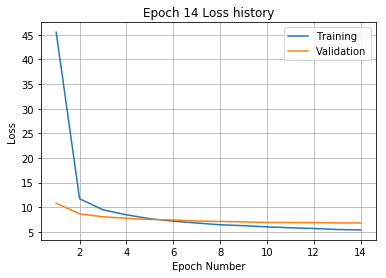

Training
Iteration 0: with minibatch training loss = 6.78 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 40: with minibatch training loss = 8.18 and relative error of 0.34
Iteration 60: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.55 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.5 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 180: with minibatch training loss = 3.47 and relative error of 0.21
Iteration 200: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.24 and relative error of 0.26
Epoch 15, Overall loss = 5.25, relative error = 0.262, and proce

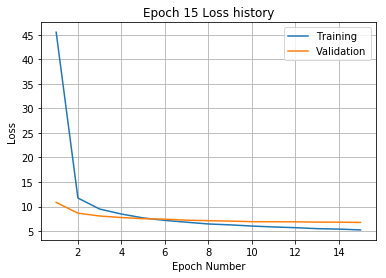

Training
Iteration 0: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.41 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.17 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.5 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.62 and relative error of 0.25
Epoch 16, Overall loss = 5.18, relative error = 0.26, and proc

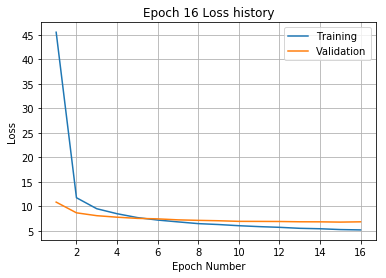

Training
Iteration 0: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.21 and relative error of 0.27
Iteration 60: with minibatch training loss = 5 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.1 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.84 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.53 and relative error of 0.26
Epoch 17, Overall loss = 5.04, relative error = 0.257, and process 

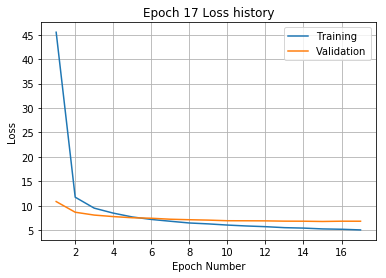

Training
Iteration 0: with minibatch training loss = 3.88 and relative error of 0.23
Iteration 20: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 60: with minibatch training loss = 3.82 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 120: with minibatch training loss = 3.9 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.13 and relative error of 0.27
Iteration 160: with minibatch training loss = 3.14 and relative error of 0.2
Iteration 180: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 200: with minibatch training loss = 3.79 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.34 and relative error of 0.27
Epoch 18, Overall loss = 4.97, relative error = 0.255, and proc

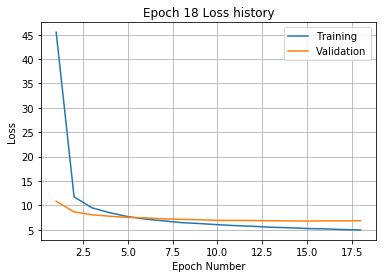

Training
Iteration 0: with minibatch training loss = 3.48 and relative error of 0.21
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 60: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 80: with minibatch training loss = 3.19 and relative error of 0.21
Iteration 100: with minibatch training loss = 5.45 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.42 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.41 and relative error of 0.28
Iteration 180: with minibatch training loss = 3.72 and relative error of 0.23
Iteration 200: with minibatch training loss = 5 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.34 and relative error of 0.24
Epoch 19, Overall loss = 4.87, relative error = 0.252, and proce

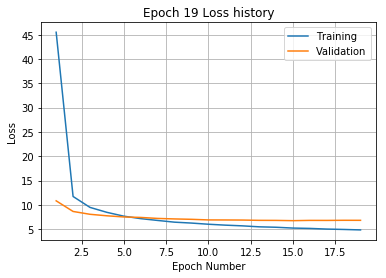

Training
Iteration 0: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.16 and relative error of 0.21
Iteration 100: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 160: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 180: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.87 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.26 and relative error of 0.26
Epoch 20, Overall loss = 4.8, relative error = 0.251, and pro

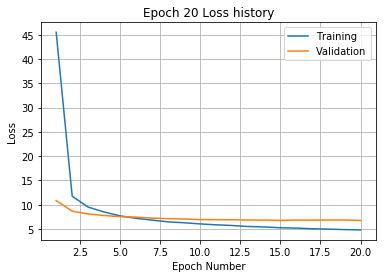

Training
Iteration 0: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.07 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.17 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.81 and relative error of 0.22
Iteration 120: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.59 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.97 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 200: with minibatch training loss = 3.34 and relative error of 0.22
Iteration 220: with minibatch training loss = 2.98 and relative error of 0.21
Epoch 21, Overall loss = 4.72, relative error = 0.248, and proc

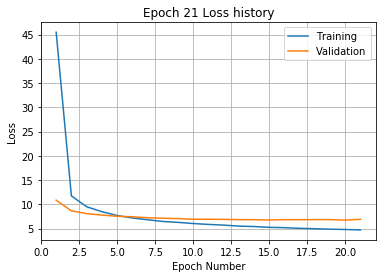

Training
Iteration 0: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.84 and relative error of 0.22
Iteration 40: with minibatch training loss = 3.35 and relative error of 0.2
Iteration 60: with minibatch training loss = 3.64 and relative error of 0.21
Iteration 80: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 120: with minibatch training loss = 3.75 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.3 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.18 and relative error of 0.26
Epoch 22, Overall loss = 4.64, relative error = 0.246, and proc

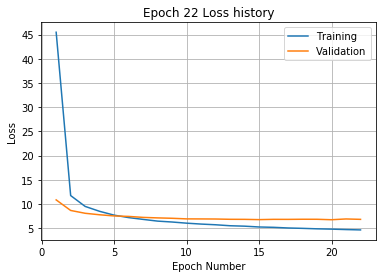

Training
Iteration 0: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 160: with minibatch training loss = 3.62 and relative error of 0.22
Iteration 180: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.06 and relative error of 0.23
Iteration 220: with minibatch training loss = 3.67 and relative error of 0.22
Epoch 23, Overall loss = 4.54, relative error = 0.243, and pr

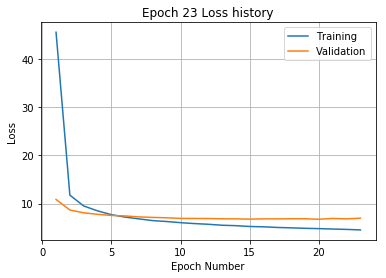

Training
Iteration 0: with minibatch training loss = 3.83 and relative error of 0.22
Iteration 20: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.36 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.11 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.28 and relative error of 0.23
Epoch 24, Overall loss = 4.46, relative error = 0.241, and pr

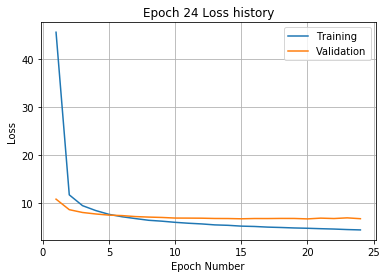

Training
Iteration 0: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.18 and relative error of 0.2
Iteration 40: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.27 and relative error of 0.21
Iteration 120: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.92 and relative error of 0.29
Iteration 160: with minibatch training loss = 3.67 and relative error of 0.22
Iteration 180: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 220: with minibatch training loss = 3.87 and relative error of 0.23
Epoch 25, Overall loss = 4.39, relative error = 0.239, and pro

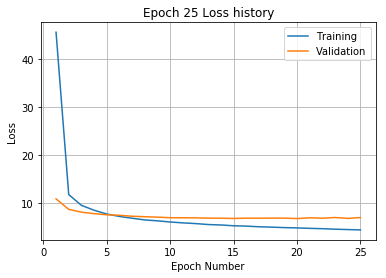

Validation error has stopped improving! Training on repetition 9 stopped!
Training
Iteration 0: with minibatch training loss = 243 and relative error of 1.7
Iteration 20: with minibatch training loss = 123 and relative error of 1.3
Iteration 40: with minibatch training loss = 85.7 and relative error of 1.1
Iteration 60: with minibatch training loss = 58.1 and relative error of 0.87
Iteration 80: with minibatch training loss = 45.8 and relative error of 0.75
Iteration 100: with minibatch training loss = 32.1 and relative error of 0.66
Iteration 120: with minibatch training loss = 31.1 and relative error of 0.63
Iteration 140: with minibatch training loss = 24 and relative error of 0.56
Iteration 160: with minibatch training loss = 17.2 and relative error of 0.47
Iteration 180: with minibatch training loss = 18.1 and relative error of 0.48
Iteration 200: with minibatch training loss = 17.8 and relative error of 0.48
Iteration 220: with minibatch training loss = 17.7 and relative error of

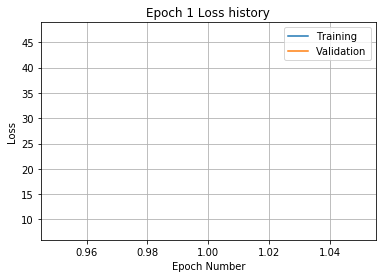

Training
Iteration 0: with minibatch training loss = 14.8 and relative error of 0.45
Iteration 20: with minibatch training loss = 12.7 and relative error of 0.42
Iteration 40: with minibatch training loss = 15.7 and relative error of 0.45
Iteration 60: with minibatch training loss = 15.7 and relative error of 0.47
Iteration 80: with minibatch training loss = 14 and relative error of 0.42
Iteration 100: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 120: with minibatch training loss = 14.4 and relative error of 0.42
Iteration 140: with minibatch training loss = 16.4 and relative error of 0.44
Iteration 160: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 180: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 200: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 220: with minibatch training loss = 13.4 and relative error of 0.43
Epoch 2, Overall loss = 13.4, relative error = 0.419, and proce

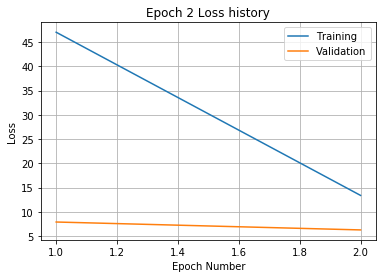

Training
Iteration 0: with minibatch training loss = 12.1 and relative error of 0.39
Iteration 20: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 40: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 60: with minibatch training loss = 9.41 and relative error of 0.35
Iteration 80: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 100: with minibatch training loss = 13 and relative error of 0.41
Iteration 120: with minibatch training loss = 11.3 and relative error of 0.37
Iteration 140: with minibatch training loss = 8.6 and relative error of 0.34
Iteration 160: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 180: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 200: with minibatch training loss = 11.7 and relative error of 0.39
Iteration 220: with minibatch training loss = 11 and relative error of 0.4
Epoch 3, Overall loss = 10.9, relative error = 0.378, and process tim

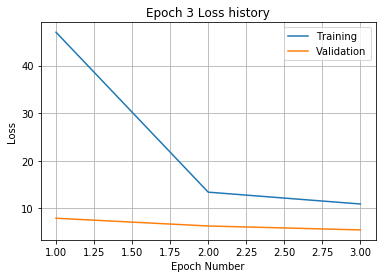

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 20: with minibatch training loss = 9.22 and relative error of 0.36
Iteration 40: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 60: with minibatch training loss = 8.69 and relative error of 0.35
Iteration 80: with minibatch training loss = 10.5 and relative error of 0.39
Iteration 100: with minibatch training loss = 8.54 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 140: with minibatch training loss = 10.1 and relative error of 0.35
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 180: with minibatch training loss = 8.01 and relative error of 0.32
Iteration 200: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 220: with minibatch training loss = 11.8 and relative error of 0.37
Epoch 4, Overall loss = 9.6, relative error = 0.355, and proc

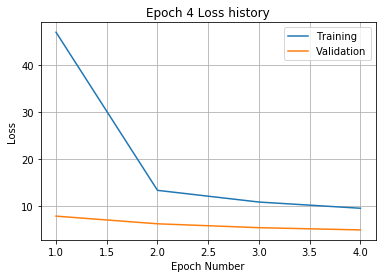

Training
Iteration 0: with minibatch training loss = 8.09 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.48 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.14 and relative error of 0.32
Iteration 100: with minibatch training loss = 9.6 and relative error of 0.36
Iteration 120: with minibatch training loss = 9.06 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.71 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.16 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 200: with minibatch training loss = 9.55 and relative error of 0.36
Iteration 220: with minibatch training loss = 8.92 and relative error of 0.34
Epoch 5, Overall loss = 8.76, relative error = 0.339, and proce

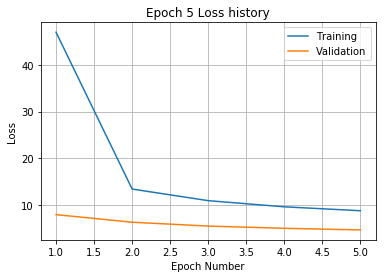

Training
Iteration 0: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.62 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.94 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.96 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.98 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.19 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.98 and relative error of 0.3
Epoch 6, Overall loss = 8.21, relative error = 0.328, and process t

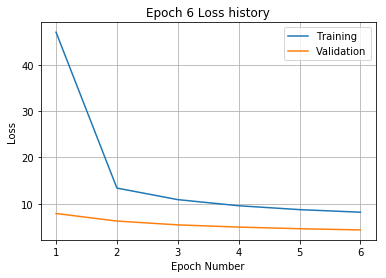

Training
Iteration 0: with minibatch training loss = 7.22 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.33 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.06 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.84 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.13 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.2 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.98 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.98 and relative error of 0.33
Iteration 200: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.62 and relative error of 0.33
Epoch 7, Overall loss = 7.69, relative error = 0.318, and proc

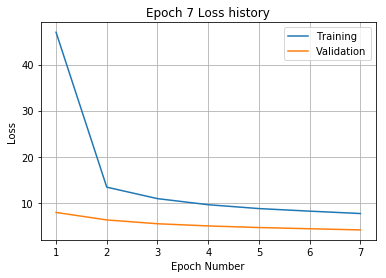

Training
Iteration 0: with minibatch training loss = 8.95 and relative error of 0.35
Iteration 20: with minibatch training loss = 8.92 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.21 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.73 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.35 and relative error of 0.34
Iteration 140: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.5 and relative error of 0.31
Iteration 180: with minibatch training loss = 9.41 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.38 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.96 and relative error of 0.3
Epoch 8, Overall loss = 7.3, relative error = 0.309, and proces

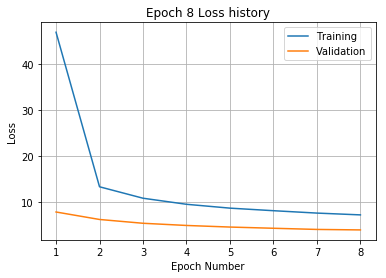

Training
Iteration 0: with minibatch training loss = 6.87 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 40: with minibatch training loss = 8.25 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.98 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.99 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 200: with minibatch training loss = 9.33 and relative error of 0.34
Iteration 220: with minibatch training loss = 6.92 and relative error of 0.3
Epoch 9, Overall loss = 7.05, relative error = 0.304, and process 

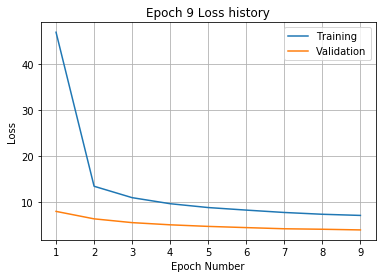

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 20: with minibatch training loss = 5.88 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.63 and relative error of 0.33
Iteration 100: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 120: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.84 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.96 and relative error of 0.3
Epoch 10, Overall loss = 6.73, relative error = 0.297, and proce

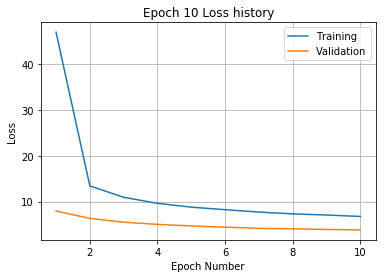

Training
Iteration 0: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 80: with minibatch training loss = 8.03 and relative error of 0.33
Iteration 100: with minibatch training loss = 9.31 and relative error of 0.35
Iteration 120: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.26 and relative error of 0.33
Epoch 11, Overall loss = 6.56, relative error = 0.293, and pro

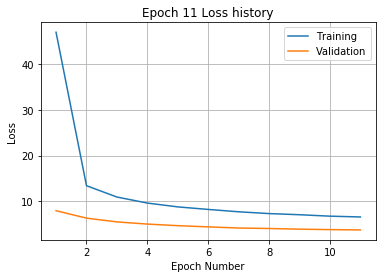

Training
Iteration 0: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.25 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.94 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.99 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.28 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.99 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.49 and relative error of 0.27
Epoch 12, Overall loss = 6.38, relative error = 0.289, and pro

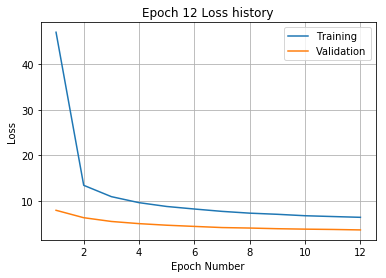

Training
Iteration 0: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.32 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.72 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.13 and relative error of 0.28
Epoch 13, Overall loss = 6.26, relative error = 0.286, and proc

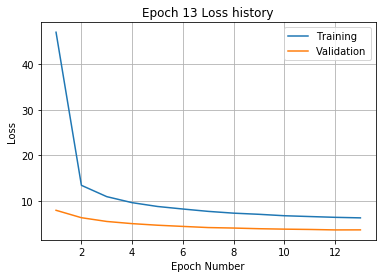

Training
Iteration 0: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.04 and relative error of 0.27
Iteration 40: with minibatch training loss = 7 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.93 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.86 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.14 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.91 and relative error of 0.23
Epoch 14, Overall loss = 6.06, relative error = 0.281, and proce

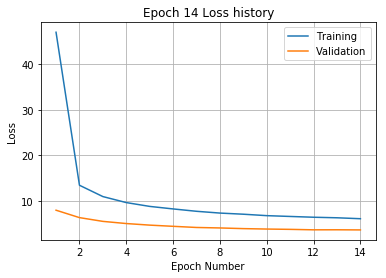

Training
Iteration 0: with minibatch training loss = 6.08 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 100: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 180: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.96 and relative error of 0.34
Epoch 15, Overall loss = 5.91, relative error = 0.278, and proc

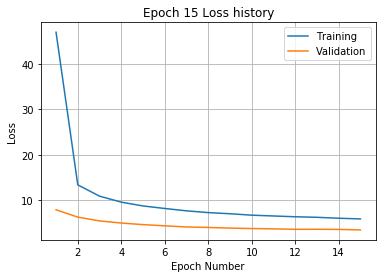

Training
Iteration 0: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 40: with minibatch training loss = 8.37 and relative error of 0.35
Iteration 60: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 200: with minibatch training loss = 5 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.22 and relative error of 0.26
Epoch 16, Overall loss = 5.73, relative error = 0.274, and proces

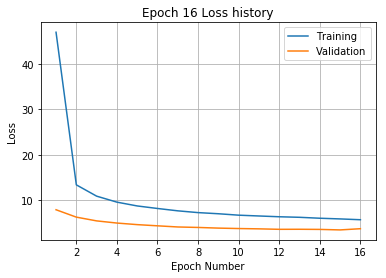

Training
Iteration 0: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.95 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 120: with minibatch training loss = 3.67 and relative error of 0.22
Iteration 140: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.08 and relative error of 0.23
Iteration 220: with minibatch training loss = 5.36 and relative error of 0.26
Epoch 17, Overall loss = 5.64, relative error = 0.271, and proce

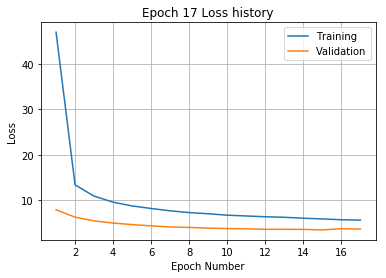

Training
Iteration 0: with minibatch training loss = 7.57 and relative error of 0.32
Iteration 20: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.78 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 120: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.72 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.52 and relative error of 0.28
Epoch 18, Overall loss = 5.52, relative error = 0.269, and pro

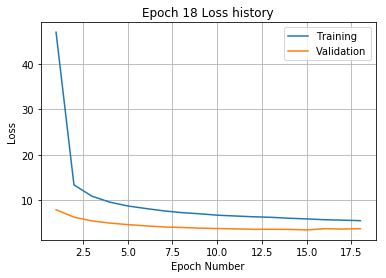

Training
Iteration 0: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 40: with minibatch training loss = 3.97 and relative error of 0.24
Iteration 60: with minibatch training loss = 7.21 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.32 and relative error of 0.32
Iteration 200: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 220: with minibatch training loss = 7.75 and relative error of 0.32
Epoch 19, Overall loss = 5.38, relative error = 0.265, and pr

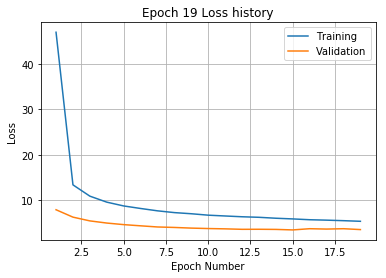

Training
Iteration 0: with minibatch training loss = 7.16 and relative error of 0.32
Iteration 20: with minibatch training loss = 4.32 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.89 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.68 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.27 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.25 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.81 and relative error of 0.29
Epoch 20, Overall loss = 5.31, relative error = 0.263, and proc

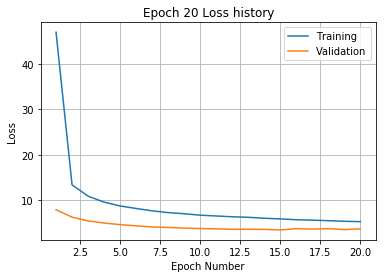

Validation error has stopped improving! Training on repetition 10 stopped!
log interval:  100 seconds
loading data
stacking image log's channels
Training
Iteration 0: with minibatch training loss = 199 and relative error of 1.6
Iteration 20: with minibatch training loss = 123 and relative error of 1.2
Iteration 40: with minibatch training loss = 73.5 and relative error of 0.99
Iteration 60: with minibatch training loss = 53.4 and relative error of 0.85
Iteration 80: with minibatch training loss = 34.2 and relative error of 0.66
Iteration 100: with minibatch training loss = 22.9 and relative error of 0.56
Iteration 120: with minibatch training loss = 21.1 and relative error of 0.52
Iteration 140: with minibatch training loss = 19.4 and relative error of 0.52
Iteration 160: with minibatch training loss = 19.4 and relative error of 0.51
Iteration 180: with minibatch training loss = 18 and relative error of 0.46
Iteration 200: with minibatch training loss = 13.7 and relative error of 0.43


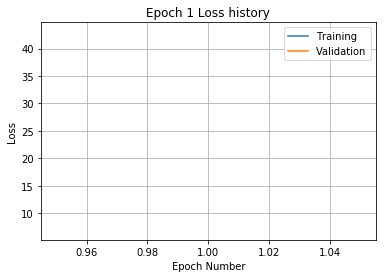

Training
Iteration 0: with minibatch training loss = 13.9 and relative error of 0.42
Iteration 20: with minibatch training loss = 15.7 and relative error of 0.46
Iteration 40: with minibatch training loss = 12 and relative error of 0.4
Iteration 60: with minibatch training loss = 16.3 and relative error of 0.46
Iteration 80: with minibatch training loss = 13.8 and relative error of 0.44
Iteration 100: with minibatch training loss = 11.9 and relative error of 0.39
Iteration 120: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 140: with minibatch training loss = 12 and relative error of 0.4
Iteration 160: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 180: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 200: with minibatch training loss = 9.17 and relative error of 0.35
Iteration 220: with minibatch training loss = 10.2 and relative error of 0.37
Epoch 2, Overall loss = 12.4, relative error = 0.404, and process ti

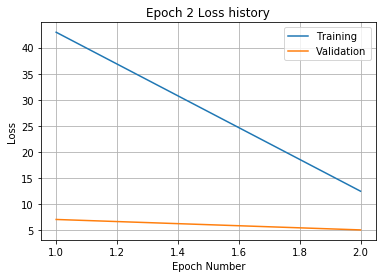

Training
Iteration 0: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 20: with minibatch training loss = 13 and relative error of 0.4
Iteration 40: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 60: with minibatch training loss = 9.16 and relative error of 0.34
Iteration 80: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 100: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 120: with minibatch training loss = 14.3 and relative error of 0.43
Iteration 140: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 180: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 200: with minibatch training loss = 9.47 and relative error of 0.35
Iteration 220: with minibatch training loss = 9.22 and relative error of 0.34
Epoch 3, Overall loss = 10.4, relative error = 0.37, and process

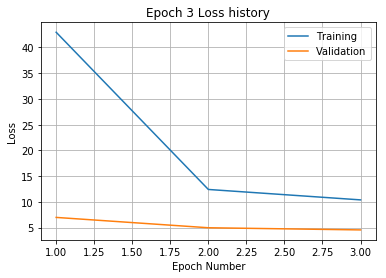

Training
Iteration 0: with minibatch training loss = 12.6 and relative error of 0.41
Iteration 20: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.84 and relative error of 0.37
Iteration 60: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.75 and relative error of 0.34
Iteration 100: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 120: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.14 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.46 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.81 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.87 and relative error of 0.35
Epoch 4, Overall loss = 9.13, relative error = 0.347, and proc

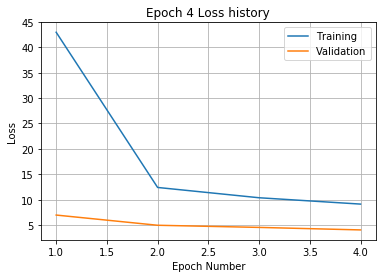

Training
Iteration 0: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 20: with minibatch training loss = 7.65 and relative error of 0.31
Iteration 40: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 60: with minibatch training loss = 7.05 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.75 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.53 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.63 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.59 and relative error of 0.34
Epoch 5, Overall loss = 8.47, relative error = 0.334, and proces

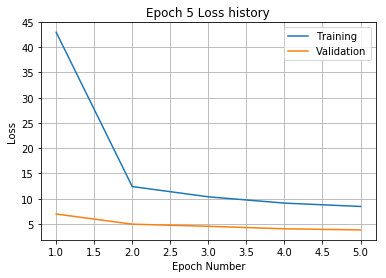

Training
Iteration 0: with minibatch training loss = 7.59 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.43 and relative error of 0.31
Iteration 80: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 100: with minibatch training loss = 5.79 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.45 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.92 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.04 and relative error of 0.29
Epoch 6, Overall loss = 7.81, relative error = 0.321, and pro

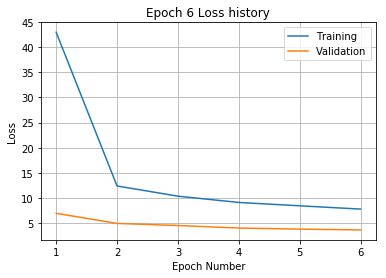

Training
Iteration 0: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 40: with minibatch training loss = 9.94 and relative error of 0.37
Iteration 60: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.39 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.63 and relative error of 0.36
Iteration 140: with minibatch training loss = 6.16 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.47 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.9 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.3 and relative error of 0.3
Epoch 7, Overall loss = 7.49, relative error = 0.314, and process 

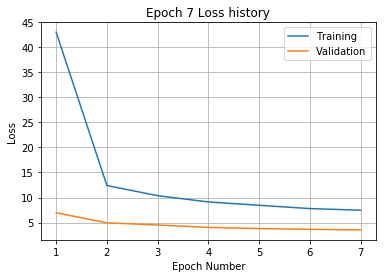

Training
Iteration 0: with minibatch training loss = 6.47 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.91 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.31 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 180: with minibatch training loss = 8.3 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.53 and relative error of 0.28
Epoch 8, Overall loss = 7.17, relative error = 0.307, and process

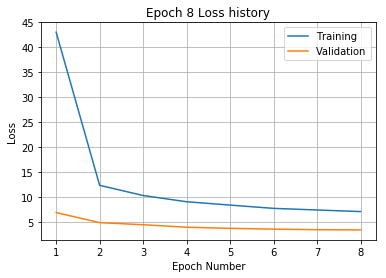

Training
Iteration 0: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.03 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.92 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.13 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 220: with minibatch training loss = 8.76 and relative error of 0.33
Epoch 9, Overall loss = 6.91, relative error = 0.301, and proce

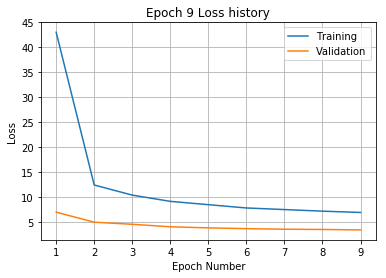

Training
Iteration 0: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.99 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.08 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.13 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.75 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.13 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.63 and relative error of 0.34
Epoch 10, Overall loss = 6.58, relative error = 0.294, and pro

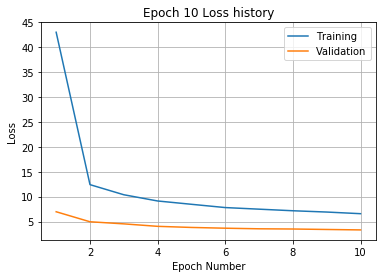

Training
Iteration 0: with minibatch training loss = 6.48 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.17 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.09 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.49 and relative error of 0.3
Epoch 11, Overall loss = 6.41, relative error = 0.29, and process ti

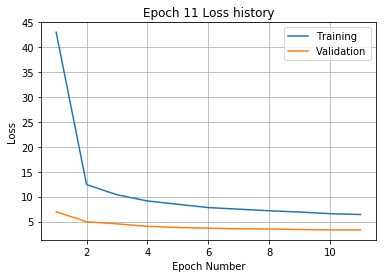

Training
Iteration 0: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.06 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 120: with minibatch training loss = 8.17 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.9 and relative error of 0.28
Epoch 12, Overall loss = 6.23, relative error = 0.286, and pro

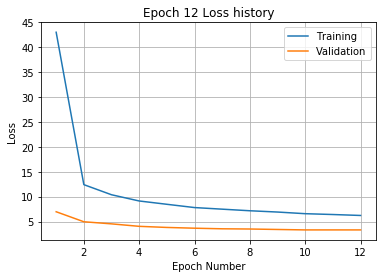

Training
Iteration 0: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.38 and relative error of 0.28
Iteration 60: with minibatch training loss = 8.38 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.83 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.32 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 200: with minibatch training loss = 8.57 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.01 and relative error of 0.29
Epoch 13, Overall loss = 6.08, relative error = 0.283, and process

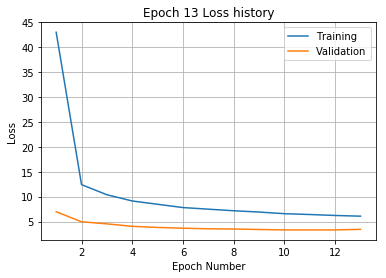

Training
Iteration 0: with minibatch training loss = 5.7 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.84 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 160: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.59 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.01 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.19 and relative error of 0.29
Epoch 14, Overall loss = 5.94, relative error = 0.279, and proce

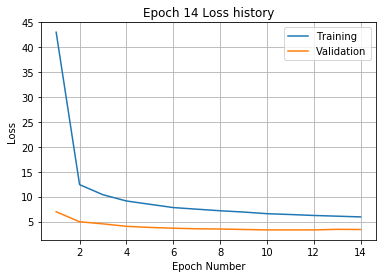

Training
Iteration 0: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.32 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.64 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.27 and relative error of 0.31
Epoch 15, Overall loss = 5.75, relative error = 0.275, and proces

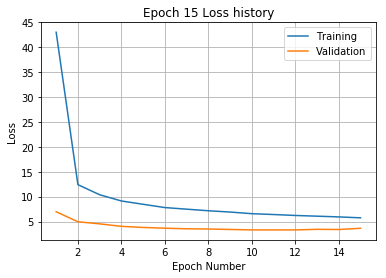

Training
Iteration 0: with minibatch training loss = 5.26 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.55 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.95 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.91 and relative error of 0.3
Iteration 160: with minibatch training loss = 8.27 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.02 and relative error of 0.24
Epoch 16, Overall loss = 5.74, relative error = 0.275, and pro

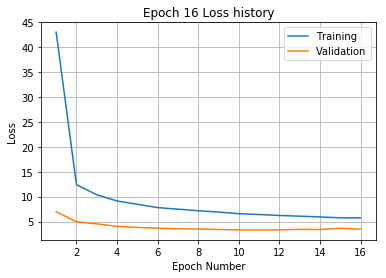

Training
Iteration 0: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.12 and relative error of 0.25
Iteration 120: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.26 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.36 and relative error of 0.26
Epoch 17, Overall loss = 5.56, relative error = 0.27, and proce

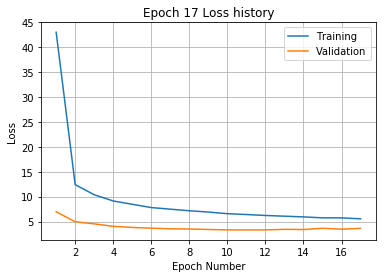

Validation error has stopped improving! Training on repetition 1 stopped!
Training
Iteration 0: with minibatch training loss = 190 and relative error of 1.6
Iteration 20: with minibatch training loss = 101 and relative error of 1.1
Iteration 40: with minibatch training loss = 69.3 and relative error of 0.95
Iteration 60: with minibatch training loss = 50.2 and relative error of 0.8
Iteration 80: with minibatch training loss = 40.2 and relative error of 0.7
Iteration 100: with minibatch training loss = 31 and relative error of 0.62
Iteration 120: with minibatch training loss = 21.6 and relative error of 0.56
Iteration 140: with minibatch training loss = 16.7 and relative error of 0.47
Iteration 160: with minibatch training loss = 17.8 and relative error of 0.48
Iteration 180: with minibatch training loss = 17.9 and relative error of 0.49
Iteration 200: with minibatch training loss = 16.6 and relative error of 0.47
Iteration 220: with minibatch training loss = 14.9 and relative error of 

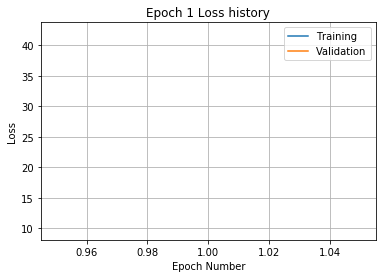

Training
Iteration 0: with minibatch training loss = 14.4 and relative error of 0.42
Iteration 20: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 40: with minibatch training loss = 13.5 and relative error of 0.41
Iteration 60: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 80: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 100: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 120: with minibatch training loss = 9.95 and relative error of 0.34
Iteration 140: with minibatch training loss = 9.76 and relative error of 0.36
Iteration 160: with minibatch training loss = 8.69 and relative error of 0.35
Iteration 180: with minibatch training loss = 12.6 and relative error of 0.41
Iteration 200: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 220: with minibatch training loss = 11.5 and relative error of 0.39
Epoch 2, Overall loss = 12.1, relative error = 0.4, and proce

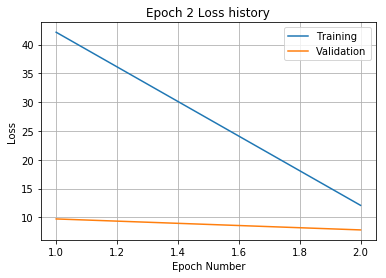

Training
Iteration 0: with minibatch training loss = 9.51 and relative error of 0.35
Iteration 20: with minibatch training loss = 8.31 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.8 and relative error of 0.34
Iteration 60: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.45 and relative error of 0.35
Iteration 100: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.93 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.02 and relative error of 0.33
Iteration 160: with minibatch training loss = 8.57 and relative error of 0.33
Iteration 180: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 200: with minibatch training loss = 12.1 and relative error of 0.39
Iteration 220: with minibatch training loss = 10.2 and relative error of 0.36
Epoch 3, Overall loss = 9.8, relative error = 0.359, and proce

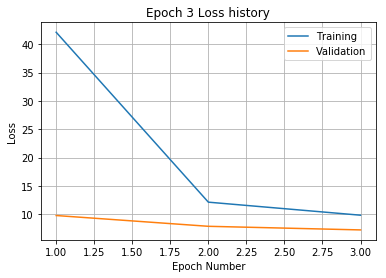

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 20: with minibatch training loss = 9.49 and relative error of 0.34
Iteration 40: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 60: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.5 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.91 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.02 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 160: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 180: with minibatch training loss = 9.74 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.67 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.14 and relative error of 0.31
Epoch 4, Overall loss = 8.7, relative error = 0.339, and proces

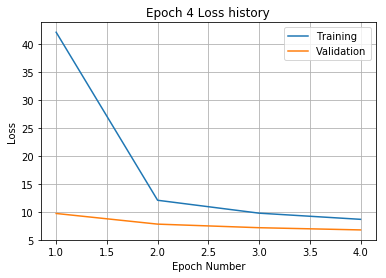

Training
Iteration 0: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 20: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.22 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.11 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 140: with minibatch training loss = 9.27 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.44 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.99 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.71 and relative error of 0.29
Iteration 220: with minibatch training loss = 11.2 and relative error of 0.39
Epoch 5, Overall loss = 8.02, relative error = 0.325, and pro

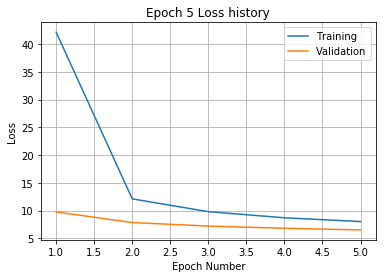

Training
Iteration 0: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.26 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.14 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.38 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.84 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.61 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.76 and relative error of 0.3
Epoch 6, Overall loss = 7.43, relative error = 0.313, and proce

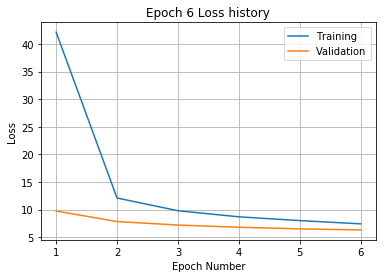

Training
Iteration 0: with minibatch training loss = 8.16 and relative error of 0.33
Iteration 20: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 80: with minibatch training loss = 8.04 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.69 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.51 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.66 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.5 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.64 and relative error of 0.33
Epoch 7, Overall loss = 7.04, relative error = 0.304, and process t

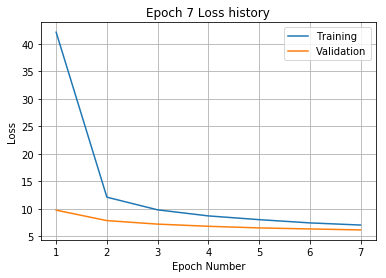

Training
Iteration 0: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.14 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.78 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.29 and relative error of 0.31
Epoch 8, Overall loss = 6.74, relative error = 0.298, and process

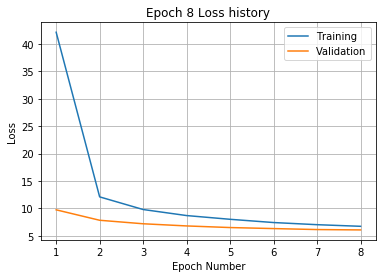

Training
Iteration 0: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.11 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.17 and relative error of 0.25
Epoch 9, Overall loss = 6.53, relative error = 0.293, and proc

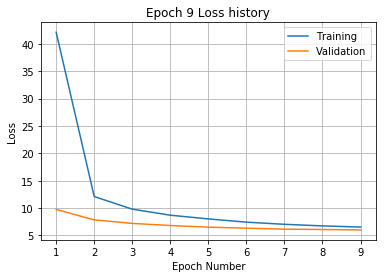

Training
Iteration 0: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.8 and relative error of 0.22
Iteration 40: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.2 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.97 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.24 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.35 and relative error of 0.27
Epoch 10, Overall loss = 6.26, relative error = 0.287, and proces

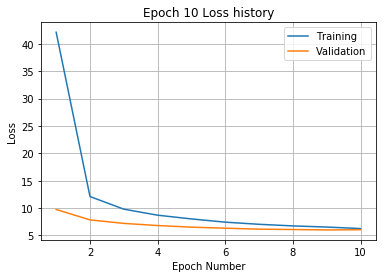

Training
Iteration 0: with minibatch training loss = 7.1 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 100: with minibatch training loss = 8.26 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.66 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.2 and relative error of 0.23
Iteration 180: with minibatch training loss = 7.41 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.1 and relative error of 0.26
Epoch 11, Overall loss = 6.08, relative error = 0.283, and proces

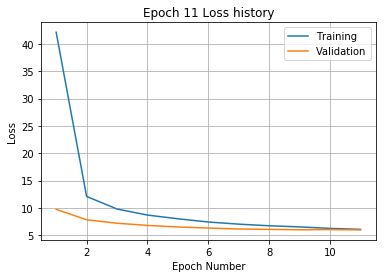

Training
Iteration 0: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.87 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.22 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.23 and relative error of 0.24
Epoch 12, Overall loss = 5.91, relative error = 0.279, and proc

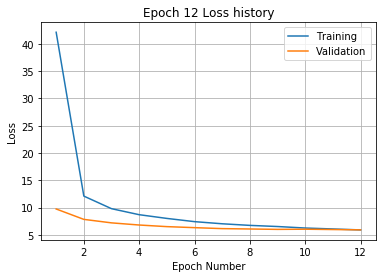

Training
Iteration 0: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 40: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 60: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.17 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.06 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.26 and relative error of 0.28
Iteration 200: with minibatch training loss = 6 and relative error of 0.29
Iteration 220: with minibatch training loss = 7.52 and relative error of 0.31
Epoch 13, Overall loss = 5.77, relative error = 0.275, and process

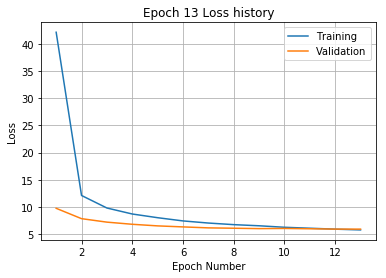

Training
Iteration 0: with minibatch training loss = 9.04 and relative error of 0.36
Iteration 20: with minibatch training loss = 7.88 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.31 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 200: with minibatch training loss = 5 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.35 and relative error of 0.24
Epoch 14, Overall loss = 5.6, relative error = 0.271, and process

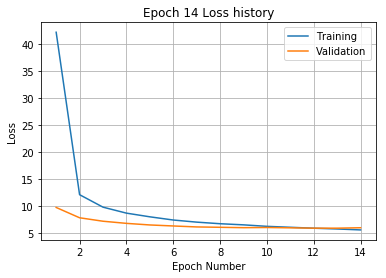

Training
Iteration 0: with minibatch training loss = 6.45 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.82 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.42 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.85 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.74 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.64 and relative error of 0.24
Epoch 15, Overall loss = 5.53, relative error = 0.27, and proc

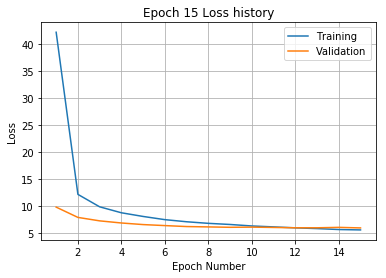

Training
Iteration 0: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.23 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.78 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.85 and relative error of 0.29
Epoch 16, Overall loss = 5.39, relative error = 0.266, and proc

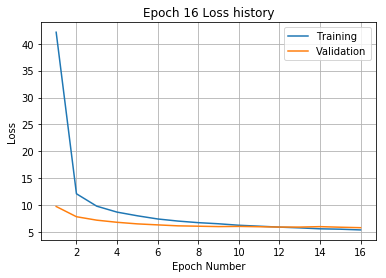

Training
Iteration 0: with minibatch training loss = 6.46 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 40: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 60: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 80: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 180: with minibatch training loss = 3.93 and relative error of 0.23
Iteration 200: with minibatch training loss = 3.56 and relative error of 0.21
Iteration 220: with minibatch training loss = 4.97 and relative error of 0.26
Epoch 17, Overall loss = 5.29, relative error = 0.264, and pro

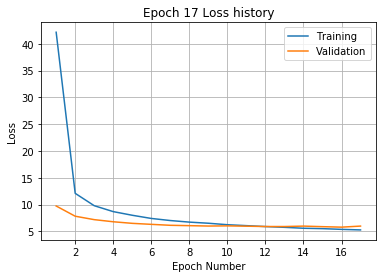

Training
Iteration 0: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.06 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 140: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.46 and relative error of 0.27
Epoch 18, Overall loss = 5.13, relative error = 0.26, and proces

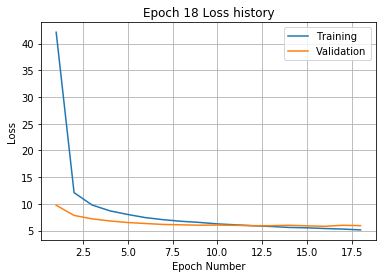

Training
Iteration 0: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 20: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.73 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.46 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.3 and relative error of 0.22
Iteration 180: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.98 and relative error of 0.23
Epoch 19, Overall loss = 5.04, relative error = 0.257, and proc

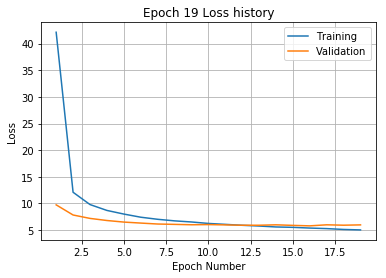

Training
Iteration 0: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.19 and relative error of 0.24
Iteration 40: with minibatch training loss = 3.31 and relative error of 0.21
Iteration 60: with minibatch training loss = 5.61 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.51 and relative error of 0.24
Iteration 100: with minibatch training loss = 7.87 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.21 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.11 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.31 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.63 and relative error of 0.25
Epoch 20, Overall loss = 4.93, relative error = 0.254, and pr

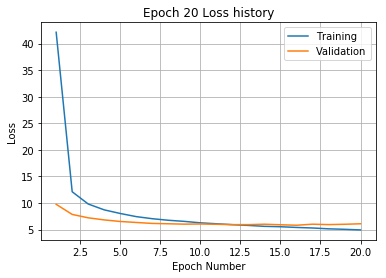

Training
Iteration 0: with minibatch training loss = 5.48 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 60: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 80: with minibatch training loss = 3.56 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 140: with minibatch training loss = 3.02 and relative error of 0.2
Iteration 160: with minibatch training loss = 8.09 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.33 and relative error of 0.21
Epoch 21, Overall loss = 4.88, relative error = 0.253, and pro

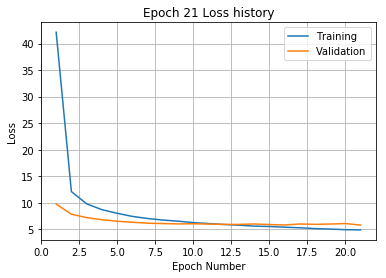

Training
Iteration 0: with minibatch training loss = 4.79 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 40: with minibatch training loss = 5 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 120: with minibatch training loss = 3.52 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.14 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.95 and relative error of 0.23
Epoch 22, Overall loss = 4.8, relative error = 0.251, and proces

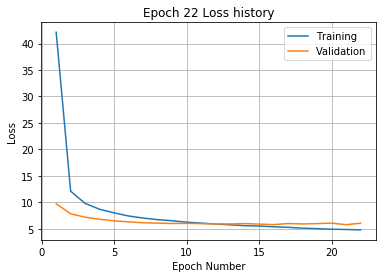

Training
Iteration 0: with minibatch training loss = 4.4 and relative error of 0.25
Iteration 20: with minibatch training loss = 3.72 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.02 and relative error of 0.29
Iteration 80: with minibatch training loss = 3.8 and relative error of 0.22
Iteration 100: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 140: with minibatch training loss = 3.87 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 180: with minibatch training loss = 3.88 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.89 and relative error of 0.23
Epoch 23, Overall loss = 4.7, relative error = 0.248, and proces

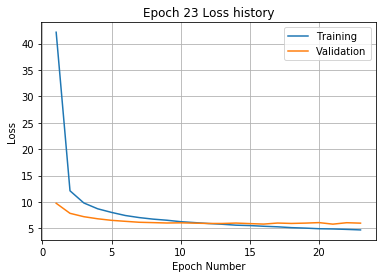

Training
Iteration 0: with minibatch training loss = 4.37 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.12 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.22 and relative error of 0.23
Iteration 180: with minibatch training loss = 3.57 and relative error of 0.22
Iteration 200: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.13 and relative error of 0.25
Epoch 24, Overall loss = 4.62, relative error = 0.246, and proc

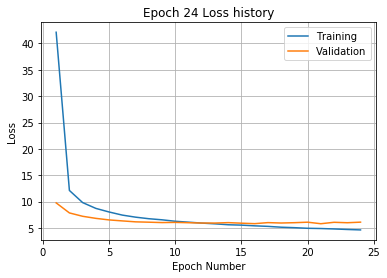

Training
Iteration 0: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 20: with minibatch training loss = 3.35 and relative error of 0.21
Iteration 40: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 60: with minibatch training loss = 3.96 and relative error of 0.23
Iteration 80: with minibatch training loss = 3.49 and relative error of 0.22
Iteration 100: with minibatch training loss = 4.08 and relative error of 0.22
Iteration 120: with minibatch training loss = 3.32 and relative error of 0.21
Iteration 140: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.17 and relative error of 0.25
Epoch 25, Overall loss = 4.54, relative error = 0.244, and pr

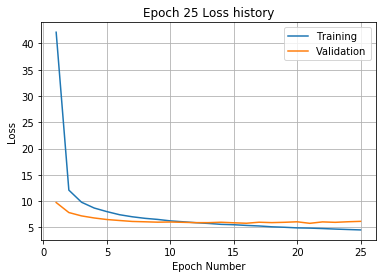

Training
Iteration 0: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.26 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 60: with minibatch training loss = 3.33 and relative error of 0.21
Iteration 80: with minibatch training loss = 3.52 and relative error of 0.21
Iteration 100: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 140: with minibatch training loss = 3.92 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 180: with minibatch training loss = 3.92 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.11 and relative error of 0.21
Epoch 26, Overall loss = 4.45, relative error = 0.242, and pro

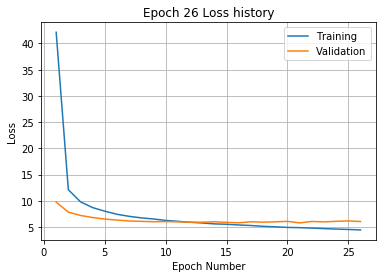

Validation error has stopped improving! Training on repetition 2 stopped!
Training
Iteration 0: with minibatch training loss = 232 and relative error of 1.8
Iteration 20: with minibatch training loss = 125 and relative error of 1.3
Iteration 40: with minibatch training loss = 88.5 and relative error of 1.1
Iteration 60: with minibatch training loss = 64.6 and relative error of 0.92
Iteration 80: with minibatch training loss = 48.2 and relative error of 0.8
Iteration 100: with minibatch training loss = 30.3 and relative error of 0.64
Iteration 120: with minibatch training loss = 24.5 and relative error of 0.57
Iteration 140: with minibatch training loss = 20.3 and relative error of 0.53
Iteration 160: with minibatch training loss = 16.3 and relative error of 0.48
Iteration 180: with minibatch training loss = 15.9 and relative error of 0.46
Iteration 200: with minibatch training loss = 19.6 and relative error of 0.49
Iteration 220: with minibatch training loss = 14.6 and relative error o

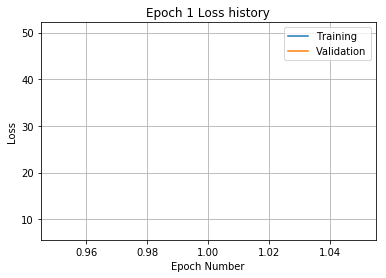

Training
Iteration 0: with minibatch training loss = 14.5 and relative error of 0.45
Iteration 20: with minibatch training loss = 12.5 and relative error of 0.42
Iteration 40: with minibatch training loss = 17.2 and relative error of 0.48
Iteration 60: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 80: with minibatch training loss = 16.9 and relative error of 0.47
Iteration 100: with minibatch training loss = 14.9 and relative error of 0.44
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 140: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 160: with minibatch training loss = 11 and relative error of 0.38
Iteration 180: with minibatch training loss = 11 and relative error of 0.38
Iteration 200: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 220: with minibatch training loss = 12.6 and relative error of 0.4
Epoch 2, Overall loss = 12.8, relative error = 0.411, and process t

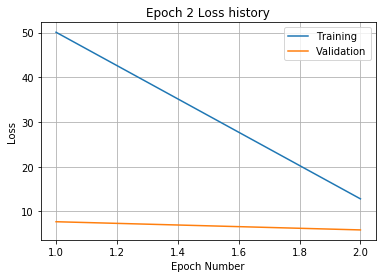

Training
Iteration 0: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 20: with minibatch training loss = 9.87 and relative error of 0.36
Iteration 40: with minibatch training loss = 9.81 and relative error of 0.37
Iteration 60: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 80: with minibatch training loss = 9.37 and relative error of 0.33
Iteration 100: with minibatch training loss = 12.6 and relative error of 0.41
Iteration 120: with minibatch training loss = 9.39 and relative error of 0.35
Iteration 140: with minibatch training loss = 9.53 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.38 and relative error of 0.33
Iteration 180: with minibatch training loss = 9.91 and relative error of 0.37
Iteration 200: with minibatch training loss = 7.95 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.93 and relative error of 0.35
Epoch 3, Overall loss = 10.5, relative error = 0.372, and proc

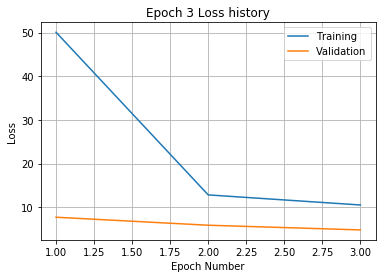

Training
Iteration 0: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 20: with minibatch training loss = 8.83 and relative error of 0.35
Iteration 40: with minibatch training loss = 9.29 and relative error of 0.37
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 80: with minibatch training loss = 9.22 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.83 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.84 and relative error of 0.31
Iteration 140: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 160: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 180: with minibatch training loss = 12 and relative error of 0.38
Iteration 200: with minibatch training loss = 8.64 and relative error of 0.35
Iteration 220: with minibatch training loss = 8.17 and relative error of 0.34
Epoch 4, Overall loss = 9.3, relative error = 0.35, and process

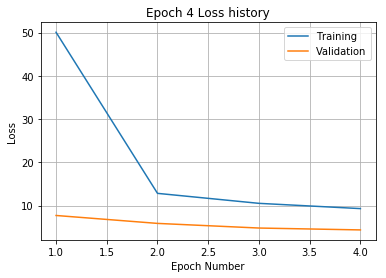

Training
Iteration 0: with minibatch training loss = 9.45 and relative error of 0.36
Iteration 20: with minibatch training loss = 7.69 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.89 and relative error of 0.36
Iteration 80: with minibatch training loss = 7.24 and relative error of 0.32
Iteration 100: with minibatch training loss = 9.02 and relative error of 0.35
Iteration 120: with minibatch training loss = 7.06 and relative error of 0.3
Iteration 140: with minibatch training loss = 9.29 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.96 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.24 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.83 and relative error of 0.31
Epoch 5, Overall loss = 8.57, relative error = 0.336, and proce

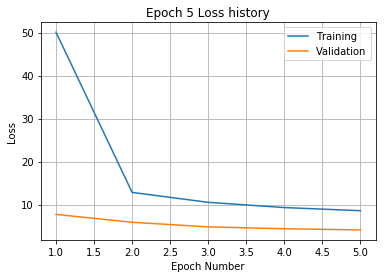

Training
Iteration 0: with minibatch training loss = 7.32 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.91 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 120: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 140: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.56 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 200: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.28 and relative error of 0.27
Epoch 6, Overall loss = 7.99, relative error = 0.324, and process 

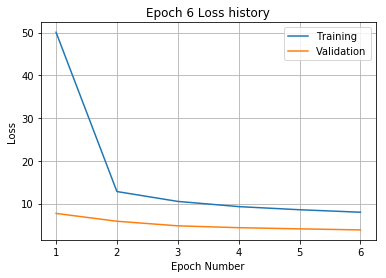

Training
Iteration 0: with minibatch training loss = 7.67 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.48 and relative error of 0.3
Iteration 40: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 60: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.78 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.78 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 220: with minibatch training loss = 9.13 and relative error of 0.34
Epoch 7, Overall loss = 7.52, relative error = 0.315, and proce

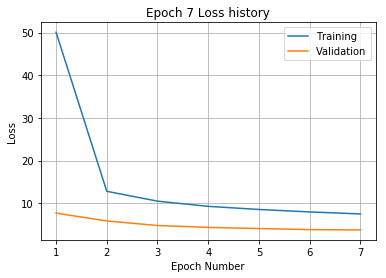

Training
Iteration 0: with minibatch training loss = 8.66 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.38 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.04 and relative error of 0.31
Iteration 60: with minibatch training loss = 9.57 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.39 and relative error of 0.33
Iteration 100: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.13 and relative error of 0.3
Epoch 8, Overall loss = 7.24, relative error = 0.308, and proce

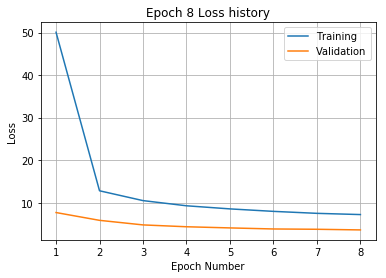

Training
Iteration 0: with minibatch training loss = 5.89 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.54 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.7 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.32 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.85 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.24 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 220: with minibatch training loss = 8.24 and relative error of 0.32
Epoch 9, Overall loss = 6.97, relative error = 0.302, and proces

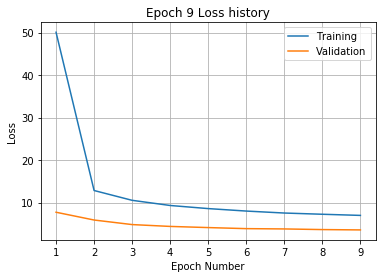

Training
Iteration 0: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.8 and relative error of 0.32
Iteration 40: with minibatch training loss = 9.89 and relative error of 0.36
Iteration 60: with minibatch training loss = 6.8 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.51 and relative error of 0.33
Iteration 100: with minibatch training loss = 9.02 and relative error of 0.35
Iteration 120: with minibatch training loss = 9.94 and relative error of 0.36
Iteration 140: with minibatch training loss = 5.2 and relative error of 0.25
Iteration 160: with minibatch training loss = 9.49 and relative error of 0.35
Iteration 180: with minibatch training loss = 5.23 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.11 and relative error of 0.31
Epoch 10, Overall loss = 6.7, relative error = 0.297, and proces

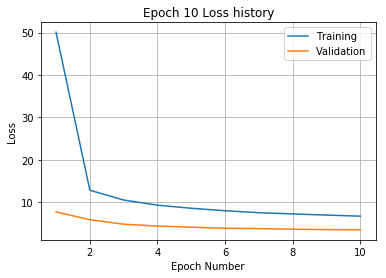

Training
Iteration 0: with minibatch training loss = 4.75 and relative error of 0.24
Iteration 20: with minibatch training loss = 8.97 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 60: with minibatch training loss = 8.6 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.35 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.78 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.21 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.79 and relative error of 0.31
Iteration 180: with minibatch training loss = 9.45 and relative error of 0.34
Iteration 200: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.44 and relative error of 0.31
Epoch 11, Overall loss = 6.52, relative error = 0.293, and proce

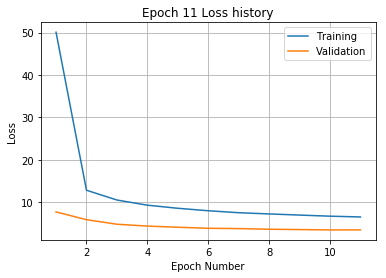

Training
Iteration 0: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.69 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 100: with minibatch training loss = 8 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.04 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.4 and relative error of 0.29
Epoch 12, Overall loss = 6.28, relative error = 0.287, and process time

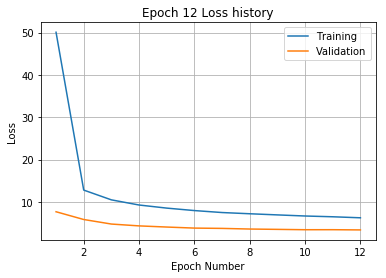

Training
Iteration 0: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.68 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.24 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.74 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 180: with minibatch training loss = 8.12 and relative error of 0.32
Iteration 200: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.94 and relative error of 0.26
Epoch 13, Overall loss = 6.12, relative error = 0.284, and proc

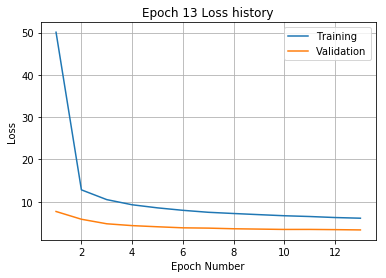

Training
Iteration 0: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.8 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 80: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.96 and relative error of 0.27
Iteration 120: with minibatch training loss = 5 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.7 and relative error of 0.26
Iteration 200: with minibatch training loss = 6 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.55 and relative error of 0.26
Epoch 14, Overall loss = 5.96, relative error = 0.28, and process tim

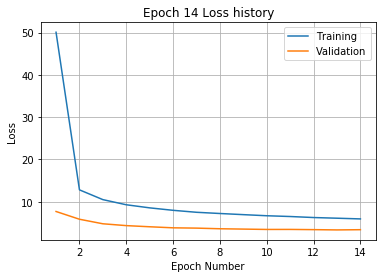

Training
Iteration 0: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.65 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.69 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 180: with minibatch training loss = 6 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.43 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.86 and relative error of 0.25
Epoch 15, Overall loss = 5.9, relative error = 0.278, and process 

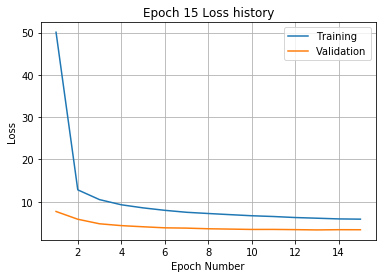

Training
Iteration 0: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.03 and relative error of 0.33
Iteration 100: with minibatch training loss = 3.83 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.7 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.3 and relative error of 0.3
Iteration 160: with minibatch training loss = 3.23 and relative error of 0.21
Iteration 180: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.04 and relative error of 0.27
Epoch 16, Overall loss = 5.73, relative error = 0.274, and process

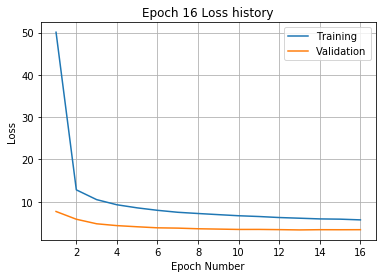

Training
Iteration 0: with minibatch training loss = 7.14 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.88 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.73 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.93 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 120: with minibatch training loss = 8.14 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.36 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.24 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.71 and relative error of 0.33
Epoch 17, Overall loss = 5.62, relative error = 0.272, and pr

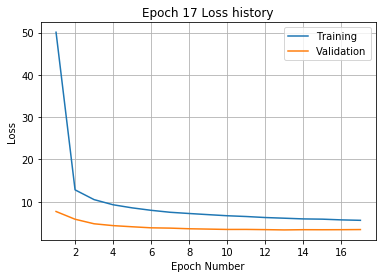

Training
Iteration 0: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.16 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.41 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.76 and relative error of 0.26
Iteration 80: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.48 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.17 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.06 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.74 and relative error of 0.25
Epoch 18, Overall loss = 5.54, relative error = 0.27, and proc

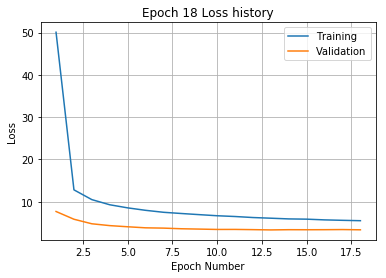

Validation error has stopped improving! Training on repetition 3 stopped!
Training
Iteration 0: with minibatch training loss = 207 and relative error of 1.6
Iteration 20: with minibatch training loss = 102 and relative error of 1.2
Iteration 40: with minibatch training loss = 77.1 and relative error of 0.98
Iteration 60: with minibatch training loss = 52 and relative error of 0.82
Iteration 80: with minibatch training loss = 38.7 and relative error of 0.71
Iteration 100: with minibatch training loss = 26.8 and relative error of 0.61
Iteration 120: with minibatch training loss = 21.7 and relative error of 0.54
Iteration 140: with minibatch training loss = 21.7 and relative error of 0.54
Iteration 160: with minibatch training loss = 20 and relative error of 0.53
Iteration 180: with minibatch training loss = 19.4 and relative error of 0.51
Iteration 200: with minibatch training loss = 16.3 and relative error of 0.46
Iteration 220: with minibatch training loss = 15.3 and relative error of 

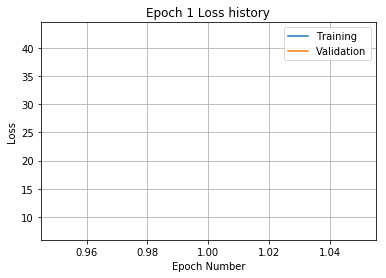

Training
Iteration 0: with minibatch training loss = 14.6 and relative error of 0.45
Iteration 20: with minibatch training loss = 15 and relative error of 0.45
Iteration 40: with minibatch training loss = 14.9 and relative error of 0.44
Iteration 60: with minibatch training loss = 21.5 and relative error of 0.55
Iteration 80: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 100: with minibatch training loss = 13 and relative error of 0.44
Iteration 120: with minibatch training loss = 12.8 and relative error of 0.42
Iteration 140: with minibatch training loss = 12.4 and relative error of 0.41
Iteration 160: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 180: with minibatch training loss = 9.34 and relative error of 0.34
Iteration 200: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 220: with minibatch training loss = 15.2 and relative error of 0.44
Epoch 2, Overall loss = 12.6, relative error = 0.407, and process

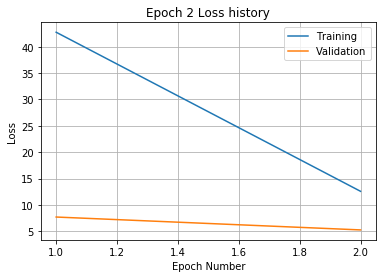

Training
Iteration 0: with minibatch training loss = 8.92 and relative error of 0.35
Iteration 20: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 40: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 60: with minibatch training loss = 8.62 and relative error of 0.34
Iteration 80: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.99 and relative error of 0.34
Iteration 120: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 140: with minibatch training loss = 9.43 and relative error of 0.34
Iteration 160: with minibatch training loss = 9.69 and relative error of 0.36
Iteration 180: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 200: with minibatch training loss = 9.03 and relative error of 0.34
Iteration 220: with minibatch training loss = 9.35 and relative error of 0.36
Epoch 3, Overall loss = 10.2, relative error = 0.367, and proce

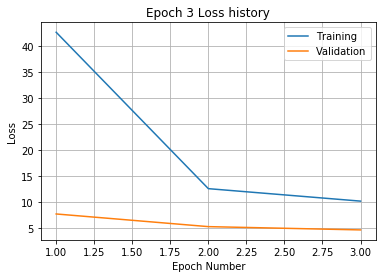

Training
Iteration 0: with minibatch training loss = 7.65 and relative error of 0.33
Iteration 20: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 40: with minibatch training loss = 9.97 and relative error of 0.37
Iteration 60: with minibatch training loss = 9.12 and relative error of 0.35
Iteration 80: with minibatch training loss = 10 and relative error of 0.37
Iteration 100: with minibatch training loss = 9.58 and relative error of 0.36
Iteration 120: with minibatch training loss = 7.61 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.55 and relative error of 0.34
Iteration 160: with minibatch training loss = 14.2 and relative error of 0.43
Iteration 180: with minibatch training loss = 7.9 and relative error of 0.32
Iteration 200: with minibatch training loss = 9.9 and relative error of 0.35
Iteration 220: with minibatch training loss = 10 and relative error of 0.37
Epoch 4, Overall loss = 9.12, relative error = 0.347, and process t

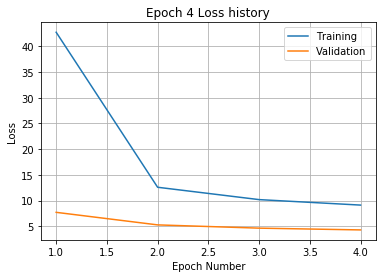

Training
Iteration 0: with minibatch training loss = 7.17 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.19 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.66 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.19 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.92 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.21 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.25 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.8 and relative error of 0.35
Iteration 160: with minibatch training loss = 9.59 and relative error of 0.36
Iteration 180: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 200: with minibatch training loss = 9.66 and relative error of 0.35
Iteration 220: with minibatch training loss = 6.47 and relative error of 0.28
Epoch 5, Overall loss = 8.41, relative error = 0.332, and proce

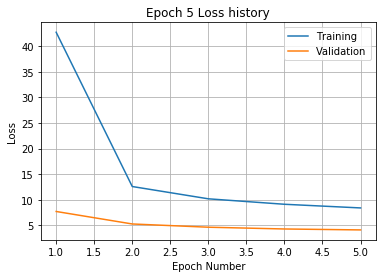

Training
Iteration 0: with minibatch training loss = 9.04 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 100: with minibatch training loss = 9.07 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.41 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.86 and relative error of 0.31
Epoch 6, Overall loss = 7.86, relative error = 0.322, and process

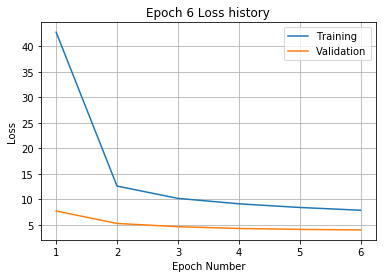

Training
Iteration 0: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 20: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 40: with minibatch training loss = 8.42 and relative error of 0.32
Iteration 60: with minibatch training loss = 9.09 and relative error of 0.35
Iteration 80: with minibatch training loss = 7.14 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.84 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.32 and relative error of 0.35
Iteration 140: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.2 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.74 and relative error of 0.25
Epoch 7, Overall loss = 7.51, relative error = 0.314, and process

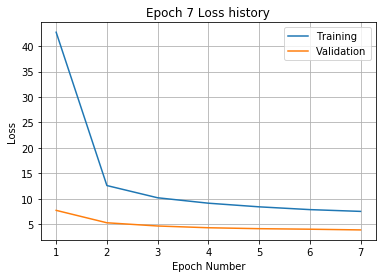

Training
Iteration 0: with minibatch training loss = 8.38 and relative error of 0.35
Iteration 20: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 100: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 120: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.67 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.25 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.85 and relative error of 0.33
Epoch 8, Overall loss = 7.2, relative error = 0.308, and proces

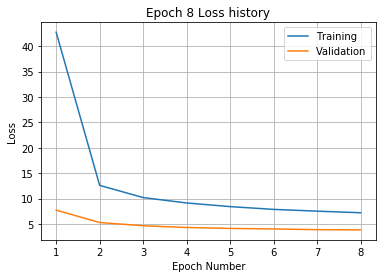

Training
Iteration 0: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.93 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.44 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.92 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.43 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.75 and relative error of 0.27
Epoch 9, Overall loss = 6.88, relative error = 0.301, and proces

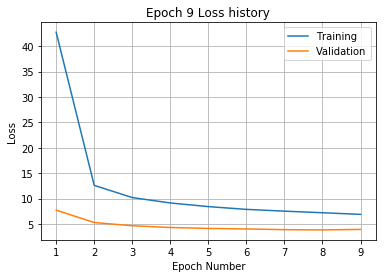

Training
Iteration 0: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.84 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.07 and relative error of 0.25
Iteration 100: with minibatch training loss = 8.4 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.76 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.28 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.84 and relative error of 0.29
Epoch 10, Overall loss = 6.67, relative error = 0.296, and process 

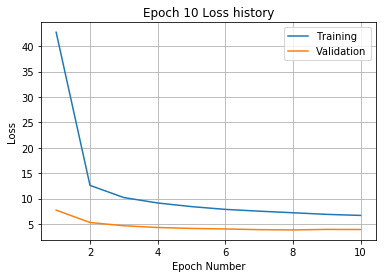

Training
Iteration 0: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 60: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 80: with minibatch training loss = 8.91 and relative error of 0.35
Iteration 100: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.24 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.18 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.79 and relative error of 0.3
Epoch 11, Overall loss = 6.48, relative error = 0.292, and proce

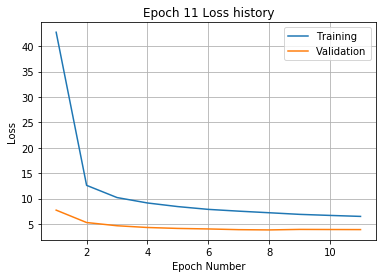

Training
Iteration 0: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.73 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.78 and relative error of 0.34
Iteration 120: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.63 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.06 and relative error of 0.27
Epoch 12, Overall loss = 6.29, relative error = 0.288, and pro

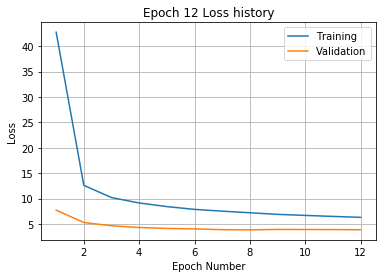

Training
Iteration 0: with minibatch training loss = 7.67 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.07 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.79 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.15 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.2 and relative error of 0.28
Epoch 13, Overall loss = 6.09, relative error = 0.283, and pro

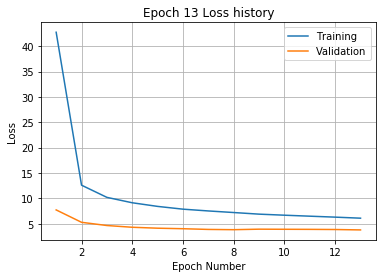

Training
Iteration 0: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.1 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.87 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.34 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.98 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 220: with minibatch training loss = 9.59 and relative error of 0.36
Epoch 14, Overall loss = 5.95, relative error = 0.28, and proces

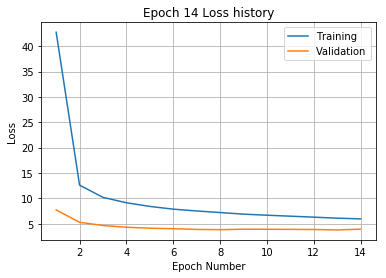

Training
Iteration 0: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.66 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 60: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 80: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.56 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.23 and relative error of 0.32
Iteration 180: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.47 and relative error of 0.24
Epoch 15, Overall loss = 5.87, relative error = 0.278, and proces

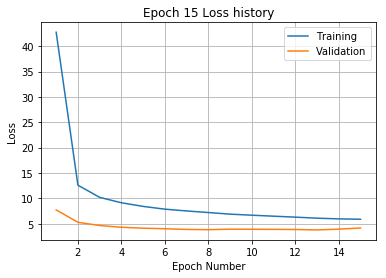

Training
Iteration 0: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.45 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.61 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.51 and relative error of 0.27
Epoch 16, Overall loss = 5.7, relative error = 0.274, and proces

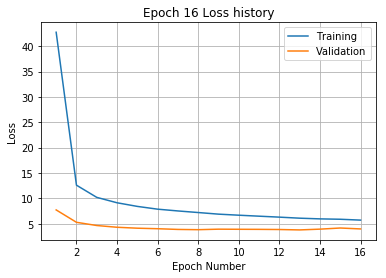

Training
Iteration 0: with minibatch training loss = 6.76 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.09 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.82 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.55 and relative error of 0.25
Epoch 17, Overall loss = 5.57, relative error = 0.271, and pro

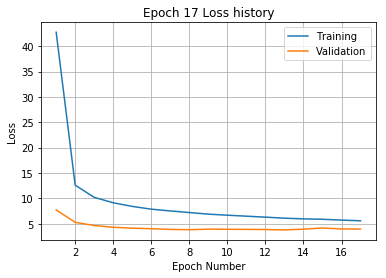

Training
Iteration 0: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.31 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.75 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.98 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 140: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.74 and relative error of 0.28
Epoch 18, Overall loss = 5.52, relative error = 0.269, and pr

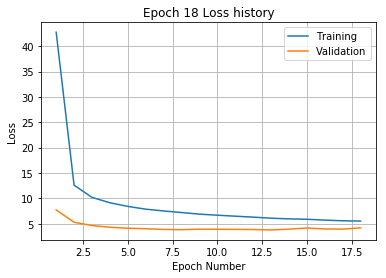

Validation error has stopped improving! Training on repetition 4 stopped!
Training
Iteration 0: with minibatch training loss = 263 and relative error of 1.9
Iteration 20: with minibatch training loss = 134 and relative error of 1.4
Iteration 40: with minibatch training loss = 91.9 and relative error of 1.1
Iteration 60: with minibatch training loss = 58 and relative error of 0.88
Iteration 80: with minibatch training loss = 51.4 and relative error of 0.82
Iteration 100: with minibatch training loss = 36.5 and relative error of 0.69
Iteration 120: with minibatch training loss = 32.3 and relative error of 0.65
Iteration 140: with minibatch training loss = 21.4 and relative error of 0.54
Iteration 160: with minibatch training loss = 20.8 and relative error of 0.52
Iteration 180: with minibatch training loss = 14.5 and relative error of 0.44
Iteration 200: with minibatch training loss = 14.6 and relative error of 0.45
Iteration 220: with minibatch training loss = 15.8 and relative error of

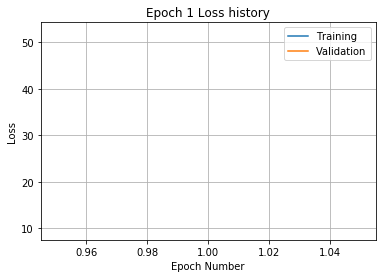

Training
Iteration 0: with minibatch training loss = 13.8 and relative error of 0.43
Iteration 20: with minibatch training loss = 13.4 and relative error of 0.44
Iteration 40: with minibatch training loss = 12.8 and relative error of 0.42
Iteration 60: with minibatch training loss = 18.1 and relative error of 0.48
Iteration 80: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 100: with minibatch training loss = 15.5 and relative error of 0.43
Iteration 120: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 140: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 160: with minibatch training loss = 13.5 and relative error of 0.43
Iteration 180: with minibatch training loss = 12.6 and relative error of 0.4
Iteration 200: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 220: with minibatch training loss = 13.5 and relative error of 0.41
Epoch 2, Overall loss = 12.7, relative error = 0.41, and proce

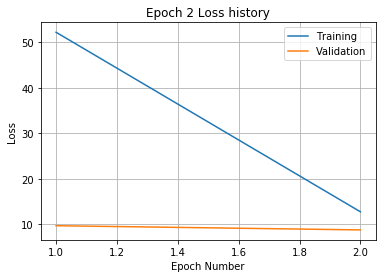

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 20: with minibatch training loss = 11.8 and relative error of 0.38
Iteration 40: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 60: with minibatch training loss = 8.54 and relative error of 0.35
Iteration 80: with minibatch training loss = 9.88 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.94 and relative error of 0.34
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.97 and relative error of 0.34
Iteration 160: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 180: with minibatch training loss = 7.77 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 220: with minibatch training loss = 11.2 and relative error of 0.38
Epoch 3, Overall loss = 10.5, relative error = 0.371, and pro

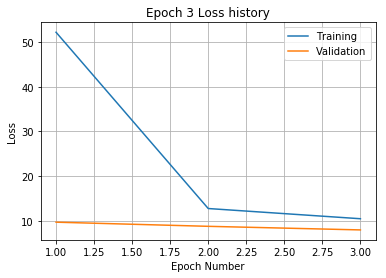

Training
Iteration 0: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 20: with minibatch training loss = 8.66 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.03 and relative error of 0.33
Iteration 60: with minibatch training loss = 9.85 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.7 and relative error of 0.33
Iteration 100: with minibatch training loss = 12.8 and relative error of 0.42
Iteration 120: with minibatch training loss = 7.67 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.56 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.88 and relative error of 0.32
Iteration 180: with minibatch training loss = 11.3 and relative error of 0.4
Iteration 200: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 220: with minibatch training loss = 11.4 and relative error of 0.39
Epoch 4, Overall loss = 9.2, relative error = 0.348, and proces

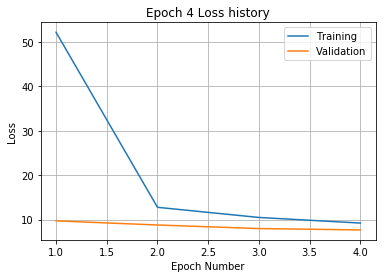

Training
Iteration 0: with minibatch training loss = 9.05 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.43 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.38 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.84 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.71 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.61 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.65 and relative error of 0.31
Iteration 180: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 200: with minibatch training loss = 9.51 and relative error of 0.35
Iteration 220: with minibatch training loss = 8.52 and relative error of 0.34
Epoch 5, Overall loss = 8.25, relative error = 0.33, and proce

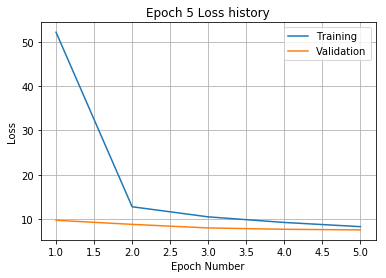

Training
Iteration 0: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 20: with minibatch training loss = 7.84 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.8 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.29 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.74 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.77 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.86 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.56 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.33 and relative error of 0.26
Epoch 6, Overall loss = 7.76, relative error = 0.319, and proces

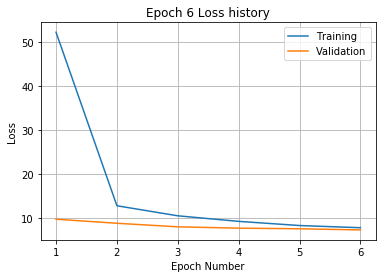

Training
Iteration 0: with minibatch training loss = 9.89 and relative error of 0.36
Iteration 20: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.13 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.88 and relative error of 0.36
Iteration 80: with minibatch training loss = 6.5 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.45 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.66 and relative error of 0.34
Iteration 160: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.73 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.65 and relative error of 0.34
Iteration 220: with minibatch training loss = 8.14 and relative error of 0.33
Epoch 7, Overall loss = 7.33, relative error = 0.311, and proces

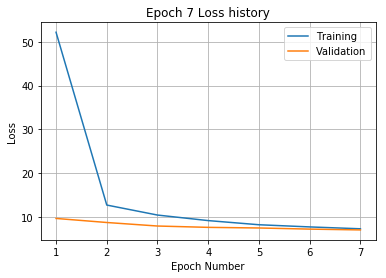

Training
Iteration 0: with minibatch training loss = 6.91 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.4 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 60: with minibatch training loss = 8.54 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.04 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 220: with minibatch training loss = 10.1 and relative error of 0.36
Epoch 8, Overall loss = 7.04, relative error = 0.304, and proce

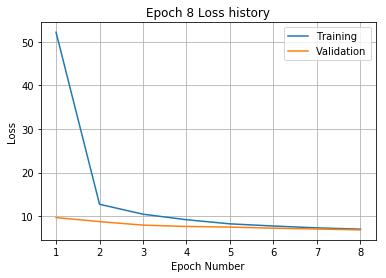

Training
Iteration 0: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.79 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.8 and relative error of 0.33
Iteration 180: with minibatch training loss = 5.45 and relative error of 0.28
Iteration 200: with minibatch training loss = 7.62 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.96 and relative error of 0.28
Epoch 9, Overall loss = 6.66, relative error = 0.296, and proces

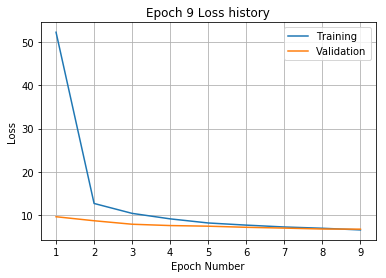

Training
Iteration 0: with minibatch training loss = 7.21 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 180: with minibatch training loss = 8.06 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.32 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.19 and relative error of 0.29
Epoch 10, Overall loss = 6.46, relative error = 0.291, and proc

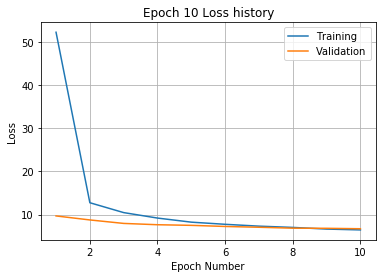

Training
Iteration 0: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 40: with minibatch training loss = 8.28 and relative error of 0.34
Iteration 60: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.1 and relative error of 0.23
Iteration 220: with minibatch training loss = 8.24 and relative error of 0.33
Epoch 11, Overall loss = 6.27, relative error = 0.287, and proce

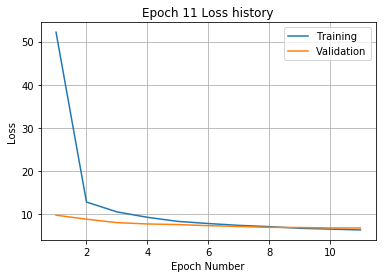

Training
Iteration 0: with minibatch training loss = 7.73 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.21 and relative error of 0.34
Iteration 100: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.51 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.26 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.28 and relative error of 0.23
Epoch 12, Overall loss = 6.05, relative error = 0.282, and proce

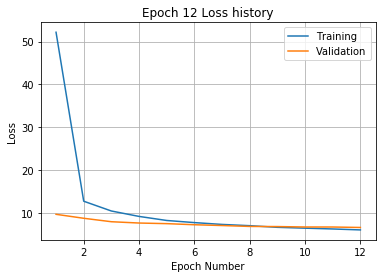

Training
Iteration 0: with minibatch training loss = 4.87 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.84 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.68 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.78 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.51 and relative error of 0.29
Epoch 13, Overall loss = 5.92, relative error = 0.279, and pr

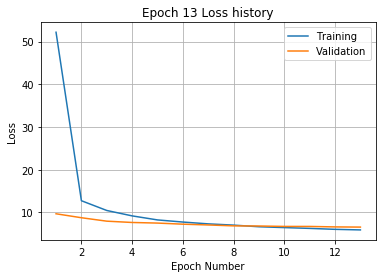

Training
Iteration 0: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.95 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.02 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 140: with minibatch training loss = 3.93 and relative error of 0.23
Iteration 160: with minibatch training loss = 6.51 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.63 and relative error of 0.29
Epoch 14, Overall loss = 5.72, relative error = 0.274, and pro

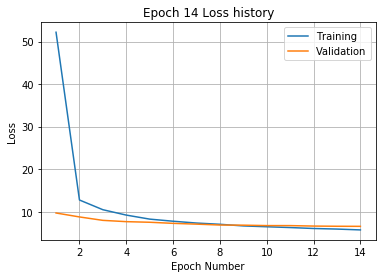

Training
Iteration 0: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.27 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.18 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.61 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.4 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.83 and relative error of 0.22
Epoch 15, Overall loss = 5.59, relative error = 0.271, and proc

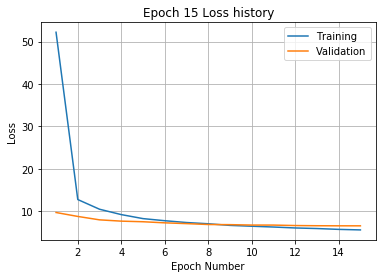

Training
Iteration 0: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.66 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.86 and relative error of 0.29
Iteration 160: with minibatch training loss = 3.46 and relative error of 0.22
Iteration 180: with minibatch training loss = 7.95 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.96 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.28 and relative error of 0.26
Epoch 16, Overall loss = 5.51, relative error = 0.269, and pr

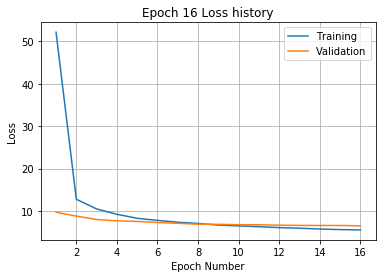

Training
Iteration 0: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 40: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.82 and relative error of 0.26
Iteration 80: with minibatch training loss = 3.53 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.58 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.81 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 160: with minibatch training loss = 5.03 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.95 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.22 and relative error of 0.28
Epoch 17, Overall loss = 5.29, relative error = 0.264, and pro

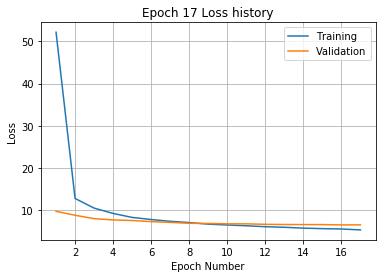

Training
Iteration 0: with minibatch training loss = 3.94 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.88 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.48 and relative error of 0.23
Iteration 100: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.24 and relative error of 0.26
Epoch 18, Overall loss = 5.22, relative error = 0.262, and pr

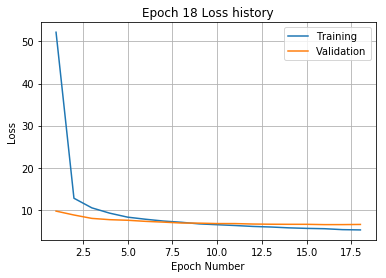

Training
Iteration 0: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.17 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.95 and relative error of 0.22
Iteration 120: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.56 and relative error of 0.24
Epoch 19, Overall loss = 5.08, relative error = 0.258, and pr

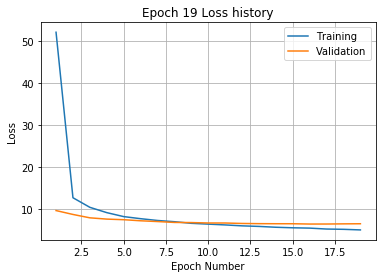

Training
Iteration 0: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.97 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.79 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.97 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 140: with minibatch training loss = 3.88 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.17 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.54 and relative error of 0.27
Epoch 20, Overall loss = 5.01, relative error = 0.257, and pr

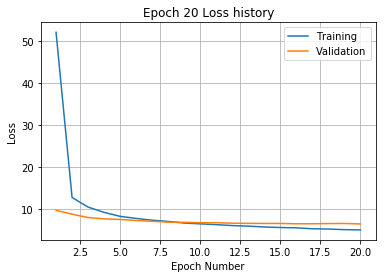

Training
Iteration 0: with minibatch training loss = 5.87 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 60: with minibatch training loss = 3.76 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.82 and relative error of 0.23
Iteration 140: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.59 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.38 and relative error of 0.29
Epoch 21, Overall loss = 4.91, relative error = 0.254, and pro

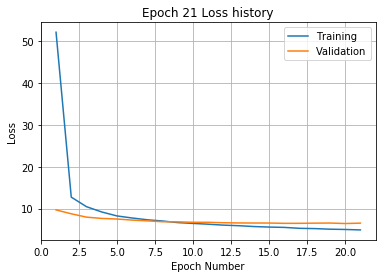

Training
Iteration 0: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 20: with minibatch training loss = 3.18 and relative error of 0.2
Iteration 40: with minibatch training loss = 3.88 and relative error of 0.23
Iteration 60: with minibatch training loss = 5.16 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 100: with minibatch training loss = 3.21 and relative error of 0.21
Iteration 120: with minibatch training loss = 4.71 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.5 and relative error of 0.25
Iteration 160: with minibatch training loss = 3.88 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.7 and relative error of 0.25
Epoch 22, Overall loss = 4.84, relative error = 0.252, and proce

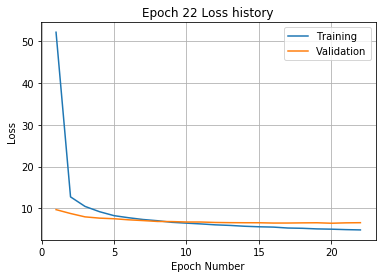

Training
Iteration 0: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.93 and relative error of 0.29
Iteration 40: with minibatch training loss = 3.67 and relative error of 0.22
Iteration 60: with minibatch training loss = 4.17 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.33 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.13 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.09 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.37 and relative error of 0.24
Epoch 23, Overall loss = 4.73, relative error = 0.249, and pr

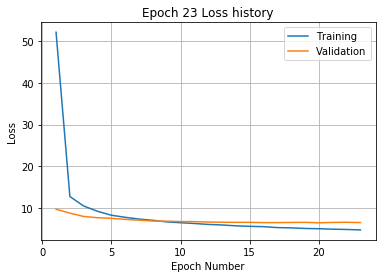

Training
Iteration 0: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 20: with minibatch training loss = 3.66 and relative error of 0.21
Iteration 40: with minibatch training loss = 4.49 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.19 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.11 and relative error of 0.23
Iteration 140: with minibatch training loss = 3.11 and relative error of 0.2
Iteration 160: with minibatch training loss = 3.28 and relative error of 0.21
Iteration 180: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 200: with minibatch training loss = 4 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.74 and relative error of 0.25
Epoch 24, Overall loss = 4.68, relative error = 0.248, and process

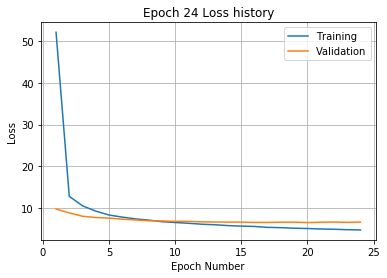

Training
Iteration 0: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.79 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.33 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 180: with minibatch training loss = 3.4 and relative error of 0.22
Iteration 200: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.95 and relative error of 0.25
Epoch 25, Overall loss = 4.54, relative error = 0.244, and pro

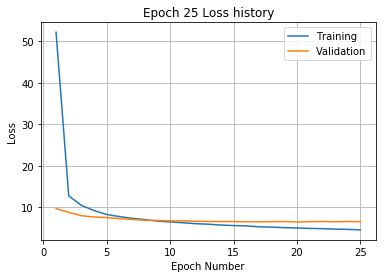

Validation error has stopped improving! Training on repetition 5 stopped!
Training
Iteration 0: with minibatch training loss = 186 and relative error of 1.6
Iteration 20: with minibatch training loss = 110 and relative error of 1.2
Iteration 40: with minibatch training loss = 76.2 and relative error of 1.1
Iteration 60: with minibatch training loss = 52.6 and relative error of 0.87
Iteration 80: with minibatch training loss = 37.6 and relative error of 0.69
Iteration 100: with minibatch training loss = 26.3 and relative error of 0.61
Iteration 120: with minibatch training loss = 29 and relative error of 0.61
Iteration 140: with minibatch training loss = 22.5 and relative error of 0.56
Iteration 160: with minibatch training loss = 18.9 and relative error of 0.52
Iteration 180: with minibatch training loss = 19.6 and relative error of 0.5
Iteration 200: with minibatch training loss = 14.9 and relative error of 0.44
Iteration 220: with minibatch training loss = 14.4 and relative error of 

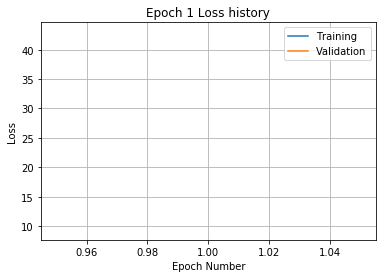

Training
Iteration 0: with minibatch training loss = 17.6 and relative error of 0.48
Iteration 20: with minibatch training loss = 16.5 and relative error of 0.46
Iteration 40: with minibatch training loss = 13.4 and relative error of 0.44
Iteration 60: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 80: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 100: with minibatch training loss = 14.7 and relative error of 0.45
Iteration 120: with minibatch training loss = 16.4 and relative error of 0.45
Iteration 140: with minibatch training loss = 11.6 and relative error of 0.4
Iteration 160: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 180: with minibatch training loss = 12.3 and relative error of 0.39
Iteration 200: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 220: with minibatch training loss = 11.6 and relative error of 0.4
Epoch 2, Overall loss = 13.3, relative error = 0.42, and process 

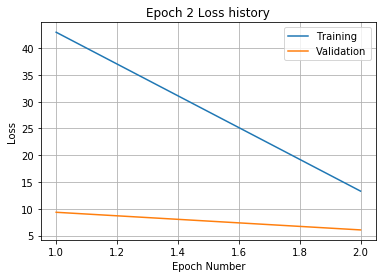

Training
Iteration 0: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 20: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 40: with minibatch training loss = 12.8 and relative error of 0.42
Iteration 60: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 80: with minibatch training loss = 8.68 and relative error of 0.33
Iteration 100: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 120: with minibatch training loss = 9.65 and relative error of 0.35
Iteration 140: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 160: with minibatch training loss = 9.41 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.63 and relative error of 0.35
Iteration 200: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 220: with minibatch training loss = 12.7 and relative error of 0.39
Epoch 3, Overall loss = 10.9, relative error = 0.38, and proce

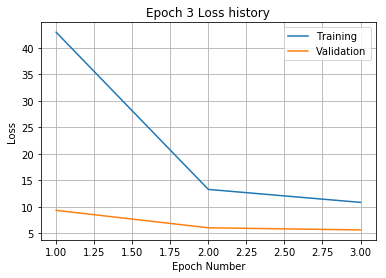

Training
Iteration 0: with minibatch training loss = 9.58 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 40: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 60: with minibatch training loss = 9.06 and relative error of 0.34
Iteration 80: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.67 and relative error of 0.33
Iteration 120: with minibatch training loss = 9.42 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.86 and relative error of 0.35
Iteration 160: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 200: with minibatch training loss = 8.73 and relative error of 0.35
Iteration 220: with minibatch training loss = 8.63 and relative error of 0.34
Epoch 4, Overall loss = 9.44, relative error = 0.354, and pro

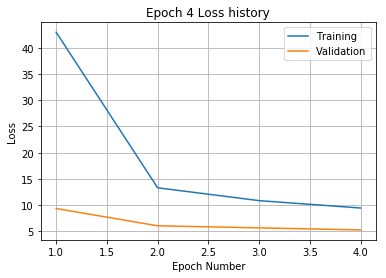

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 20: with minibatch training loss = 9.39 and relative error of 0.36
Iteration 40: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.82 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.96 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.27 and relative error of 0.3
Iteration 120: with minibatch training loss = 7 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.58 and relative error of 0.34
Iteration 200: with minibatch training loss = 8.92 and relative error of 0.35
Iteration 220: with minibatch training loss = 12.3 and relative error of 0.39
Epoch 5, Overall loss = 8.65, relative error = 0.339, and process 

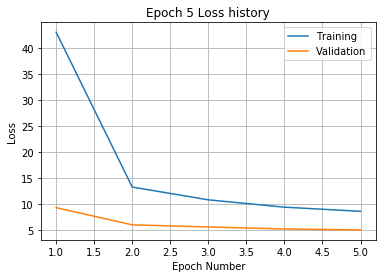

Training
Iteration 0: with minibatch training loss = 7.88 and relative error of 0.32
Iteration 20: with minibatch training loss = 8.93 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.27 and relative error of 0.33
Iteration 60: with minibatch training loss = 9.69 and relative error of 0.37
Iteration 80: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.91 and relative error of 0.33
Iteration 120: with minibatch training loss = 9.66 and relative error of 0.36
Iteration 140: with minibatch training loss = 8.37 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 180: with minibatch training loss = 9.97 and relative error of 0.38
Iteration 200: with minibatch training loss = 7.62 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.97 and relative error of 0.31
Epoch 6, Overall loss = 8.04, relative error = 0.327, and proc

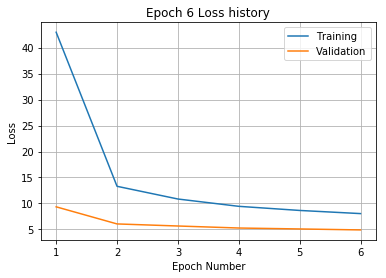

Training
Iteration 0: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.66 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.32 and relative error of 0.32
Iteration 60: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 80: with minibatch training loss = 8.14 and relative error of 0.33
Iteration 100: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 120: with minibatch training loss = 6.76 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.1 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.8 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.63 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.67 and relative error of 0.3
Epoch 7, Overall loss = 7.52, relative error = 0.316, and process

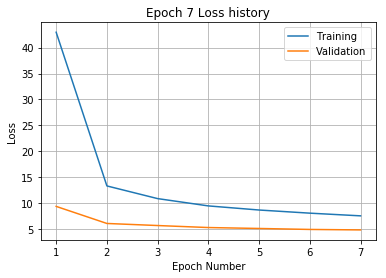

Training
Iteration 0: with minibatch training loss = 7.91 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.85 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.21 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.21 and relative error of 0.3
Iteration 80: with minibatch training loss = 9.74 and relative error of 0.35
Iteration 100: with minibatch training loss = 5.33 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.37 and relative error of 0.36
Iteration 180: with minibatch training loss = 6.8 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.92 and relative error of 0.3
Epoch 8, Overall loss = 7.34, relative error = 0.312, and proces

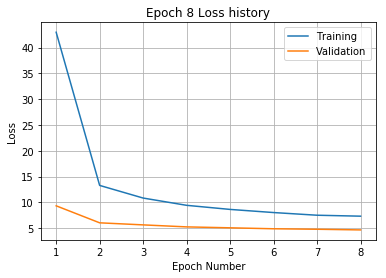

Training
Iteration 0: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.83 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 60: with minibatch training loss = 9.22 and relative error of 0.35
Iteration 80: with minibatch training loss = 7.07 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.79 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.07 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.66 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.52 and relative error of 0.28
Epoch 9, Overall loss = 6.97, relative error = 0.304, and proce

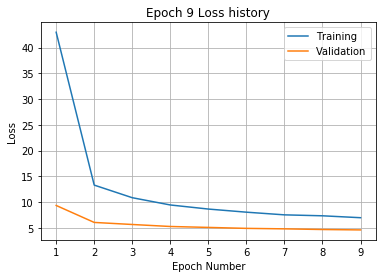

Training
Iteration 0: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.48 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.65 and relative error of 0.31
Iteration 140: with minibatch training loss = 8.24 and relative error of 0.34
Iteration 160: with minibatch training loss = 7.91 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.55 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.92 and relative error of 0.32
Epoch 10, Overall loss = 6.69, relative error = 0.298, and pro

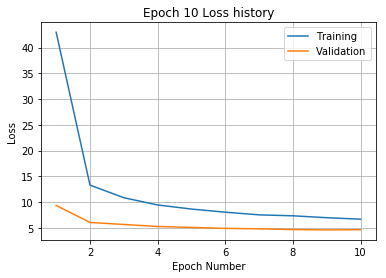

Training
Iteration 0: with minibatch training loss = 6.82 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 40: with minibatch training loss = 9.09 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 80: with minibatch training loss = 8.13 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.79 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.41 and relative error of 0.3
Iteration 140: with minibatch training loss = 3.94 and relative error of 0.23
Iteration 160: with minibatch training loss = 7.98 and relative error of 0.32
Iteration 180: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.48 and relative error of 0.31
Epoch 11, Overall loss = 6.55, relative error = 0.294, and proce

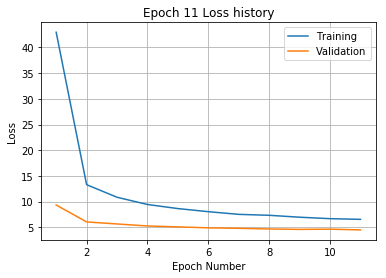

Training
Iteration 0: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 80: with minibatch training loss = 8.34 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.58 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.21 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.42 and relative error of 0.34
Iteration 200: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.69 and relative error of 0.31
Epoch 12, Overall loss = 6.37, relative error = 0.29, and proc

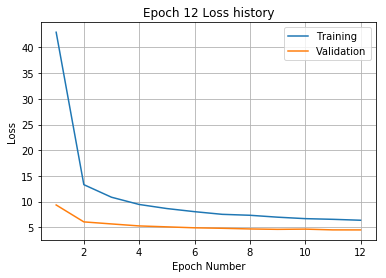

Training
Iteration 0: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.05 and relative error of 0.29
Iteration 100: with minibatch training loss = 7 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 140: with minibatch training loss = 11 and relative error of 0.38
Iteration 160: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.86 and relative error of 0.3
Epoch 13, Overall loss = 6.19, relative error = 0.286, and process t

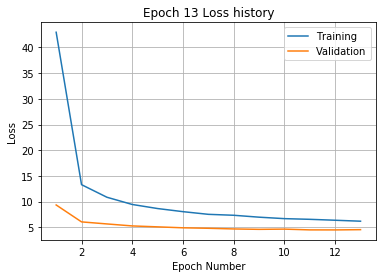

Training
Iteration 0: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.33 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.96 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.27 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.71 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.59 and relative error of 0.33
Iteration 220: with minibatch training loss = 5.74 and relative error of 0.27
Epoch 14, Overall loss = 6.06, relative error = 0.283, and proce

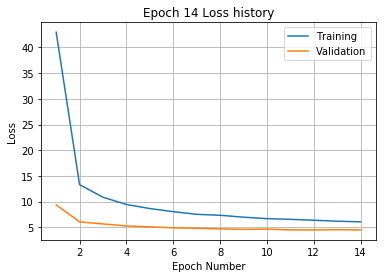

Training
Iteration 0: with minibatch training loss = 5.16 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.22 and relative error of 0.23
Iteration 40: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 100: with minibatch training loss = 7.36 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 140: with minibatch training loss = 3.74 and relative error of 0.22
Iteration 160: with minibatch training loss = 6.45 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.21 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.94 and relative error of 0.25
Epoch 15, Overall loss = 5.91, relative error = 0.279, and proc

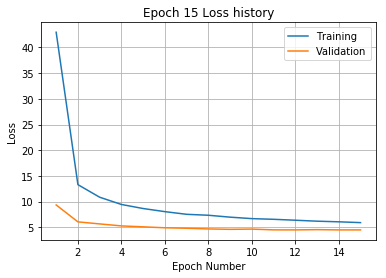

Training
Iteration 0: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.08 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.65 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 120: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.35 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.61 and relative error of 0.33
Iteration 220: with minibatch training loss = 5.7 and relative error of 0.27
Epoch 16, Overall loss = 5.74, relative error = 0.275, and proc

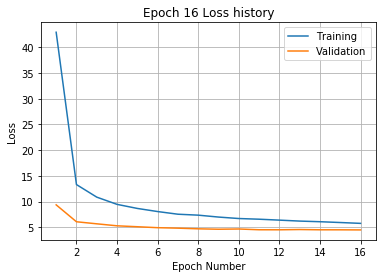

Training
Iteration 0: with minibatch training loss = 7.44 and relative error of 0.32
Iteration 20: with minibatch training loss = 3.81 and relative error of 0.22
Iteration 40: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 60: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.75 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.07 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.83 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 200: with minibatch training loss = 7.34 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.22 and relative error of 0.24
Epoch 17, Overall loss = 5.64, relative error = 0.273, and proc

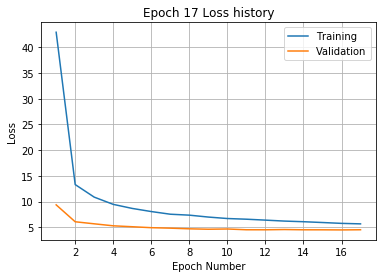

Training
Iteration 0: with minibatch training loss = 9.7 and relative error of 0.38
Iteration 20: with minibatch training loss = 5.9 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.81 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.18 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 100: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.73 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.16 and relative error of 0.24
Epoch 18, Overall loss = 5.55, relative error = 0.271, and proc

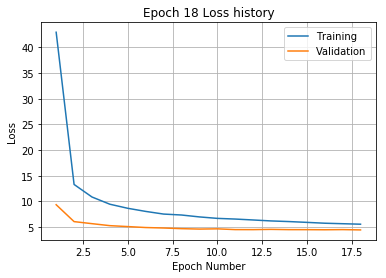

Training
Iteration 0: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 40: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 60: with minibatch training loss = 4.27 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.25 and relative error of 0.25
Iteration 100: with minibatch training loss = 7.74 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.78 and relative error of 0.24
Iteration 220: with minibatch training loss = 7.92 and relative error of 0.31
Epoch 19, Overall loss = 5.45, relative error = 0.268, and pro

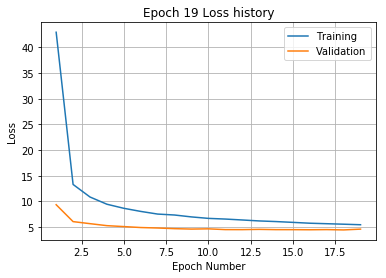

Training
Iteration 0: with minibatch training loss = 6.31 and relative error of 0.3
Iteration 20: with minibatch training loss = 4.46 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.21 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.02 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.32 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.11 and relative error of 0.23
Epoch 20, Overall loss = 5.32, relative error = 0.266, and proc

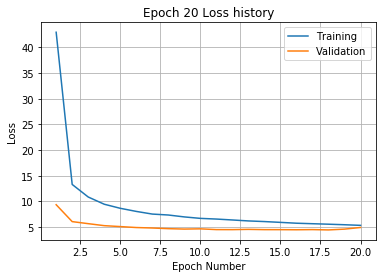

Training
Iteration 0: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 60: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 80: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.44 and relative error of 0.27
Epoch 21, Overall loss = 5.28, relative error = 0.264, and proce

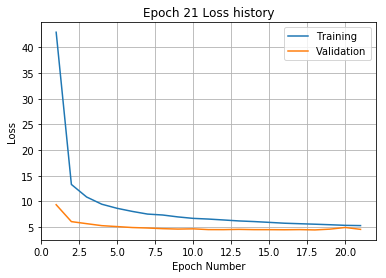

Training
Iteration 0: with minibatch training loss = 8.19 and relative error of 0.34
Iteration 20: with minibatch training loss = 3.5 and relative error of 0.21
Iteration 40: with minibatch training loss = 5.22 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.19 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.72 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.35 and relative error of 0.27
Epoch 22, Overall loss = 5.19, relative error = 0.262, and pro

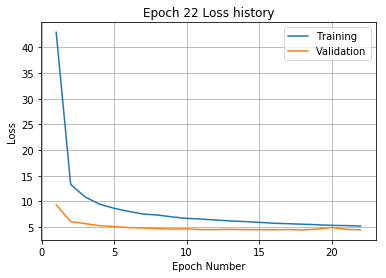

Training
Iteration 0: with minibatch training loss = 4.72 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.07 and relative error of 0.21
Iteration 40: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.21 and relative error of 0.23
Iteration 160: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.3 and relative error of 0.28
Epoch 23, Overall loss = 5.09, relative error = 0.259, and pro

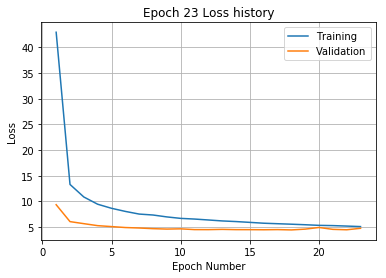

Validation error has stopped improving! Training on repetition 6 stopped!
Training
Iteration 0: with minibatch training loss = 183 and relative error of 1.5
Iteration 20: with minibatch training loss = 106 and relative error of 1.2
Iteration 40: with minibatch training loss = 64.7 and relative error of 0.92
Iteration 60: with minibatch training loss = 48.2 and relative error of 0.79
Iteration 80: with minibatch training loss = 36 and relative error of 0.7
Iteration 100: with minibatch training loss = 24.2 and relative error of 0.58
Iteration 120: with minibatch training loss = 20.2 and relative error of 0.52
Iteration 140: with minibatch training loss = 20.1 and relative error of 0.51
Iteration 160: with minibatch training loss = 16 and relative error of 0.47
Iteration 180: with minibatch training loss = 14.6 and relative error of 0.44
Iteration 200: with minibatch training loss = 15.7 and relative error of 0.45
Iteration 220: with minibatch training loss = 12.3 and relative error of 0

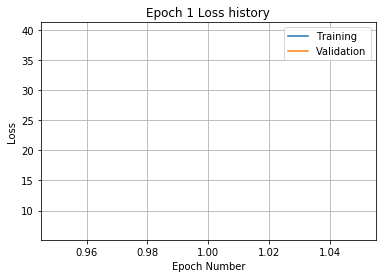

Training
Iteration 0: with minibatch training loss = 12 and relative error of 0.39
Iteration 20: with minibatch training loss = 15.6 and relative error of 0.44
Iteration 40: with minibatch training loss = 12.3 and relative error of 0.39
Iteration 60: with minibatch training loss = 9.11 and relative error of 0.36
Iteration 80: with minibatch training loss = 14 and relative error of 0.43
Iteration 100: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 120: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 140: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 160: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 180: with minibatch training loss = 9.72 and relative error of 0.37
Iteration 200: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 220: with minibatch training loss = 11.2 and relative error of 0.38
Epoch 2, Overall loss = 11.7, relative error = 0.393, and process t

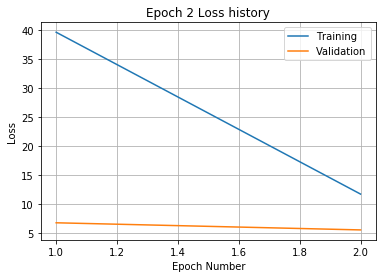

Training
Iteration 0: with minibatch training loss = 8.13 and relative error of 0.34
Iteration 20: with minibatch training loss = 9.99 and relative error of 0.36
Iteration 40: with minibatch training loss = 9.73 and relative error of 0.35
Iteration 60: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 80: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 100: with minibatch training loss = 12.6 and relative error of 0.4
Iteration 120: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 140: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 160: with minibatch training loss = 8.84 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.88 and relative error of 0.36
Iteration 200: with minibatch training loss = 9.17 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.67 and relative error of 0.31
Epoch 3, Overall loss = 9.82, relative error = 0.36, and proce

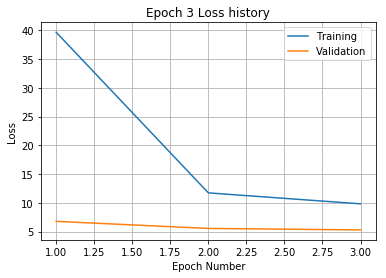

Training
Iteration 0: with minibatch training loss = 8.88 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.01 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.96 and relative error of 0.35
Iteration 60: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 80: with minibatch training loss = 7.64 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.76 and relative error of 0.34
Iteration 120: with minibatch training loss = 9.12 and relative error of 0.33
Iteration 140: with minibatch training loss = 8.19 and relative error of 0.35
Iteration 160: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 180: with minibatch training loss = 9.69 and relative error of 0.36
Iteration 200: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 220: with minibatch training loss = 11.2 and relative error of 0.39
Epoch 4, Overall loss = 8.7, relative error = 0.339, and proc

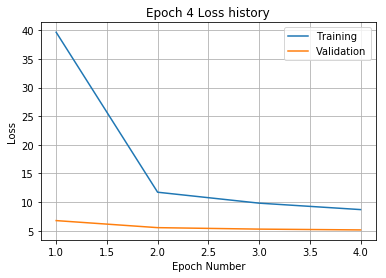

Training
Iteration 0: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 40: with minibatch training loss = 9.53 and relative error of 0.37
Iteration 60: with minibatch training loss = 11.8 and relative error of 0.4
Iteration 80: with minibatch training loss = 8.73 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.87 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.43 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.5 and relative error of 0.31
Epoch 5, Overall loss = 8.02, relative error = 0.325, and process

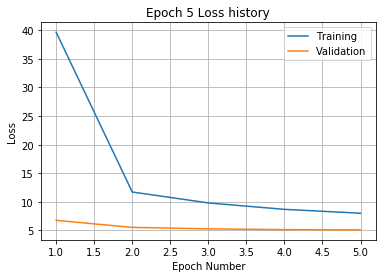

Training
Iteration 0: with minibatch training loss = 7.05 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 40: with minibatch training loss = 9.82 and relative error of 0.35
Iteration 60: with minibatch training loss = 7.41 and relative error of 0.31
Iteration 80: with minibatch training loss = 9 and relative error of 0.35
Iteration 100: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 120: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.27 and relative error of 0.35
Iteration 160: with minibatch training loss = 11.2 and relative error of 0.4
Iteration 180: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.44 and relative error of 0.32
Epoch 6, Overall loss = 7.52, relative error = 0.314, and process t

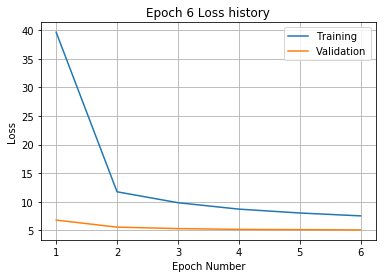

Training
Iteration 0: with minibatch training loss = 8.05 and relative error of 0.33
Iteration 20: with minibatch training loss = 5.96 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.4
Iteration 100: with minibatch training loss = 6.8 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.69 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.54 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.76 and relative error of 0.3
Epoch 7, Overall loss = 7.18, relative error = 0.308, and process t

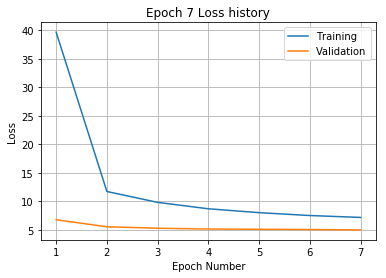

Training
Iteration 0: with minibatch training loss = 5.9 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 40: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 60: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 100: with minibatch training loss = 9.62 and relative error of 0.37
Iteration 120: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 140: with minibatch training loss = 8.31 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.32 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.74 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.75 and relative error of 0.32
Epoch 8, Overall loss = 6.83, relative error = 0.3, and process t

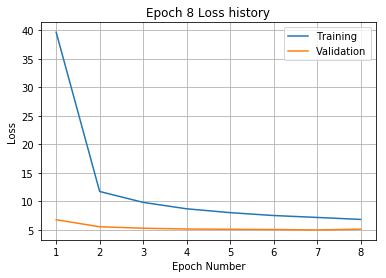

Training
Iteration 0: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.66 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 80: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.53 and relative error of 0.32
Epoch 9, Overall loss = 6.6, relative error = 0.295, and proces

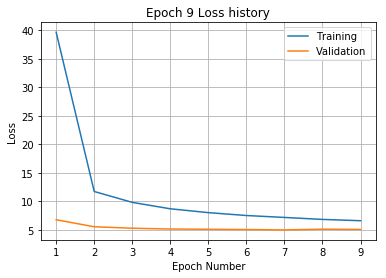

Training
Iteration 0: with minibatch training loss = 4.2 and relative error of 0.23
Iteration 20: with minibatch training loss = 7.44 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.2 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.92 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 100: with minibatch training loss = 8.07 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.63 and relative error of 0.25
Epoch 10, Overall loss = 6.3, relative error = 0.288, and process

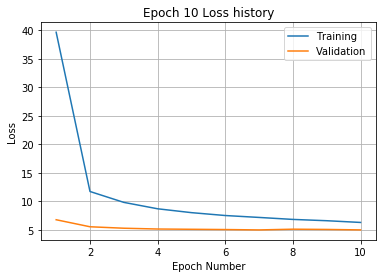

Training
Iteration 0: with minibatch training loss = 7.79 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.35 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.11 and relative error of 0.34
Iteration 100: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 120: with minibatch training loss = 8.82 and relative error of 0.34
Iteration 140: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.49 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.91 and relative error of 0.25
Epoch 11, Overall loss = 6.11, relative error = 0.283, and pro

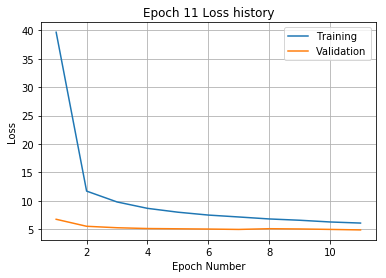

Training
Iteration 0: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.37 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.81 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.65 and relative error of 0.26
Epoch 12, Overall loss = 5.96, relative error = 0.28, and proc

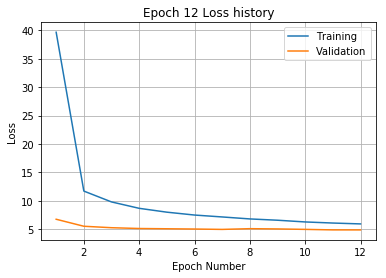

Training
Iteration 0: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.45 and relative error of 0.25
Iteration 80: with minibatch training loss = 7.57 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.13 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.17 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 200: with minibatch training loss = 3.78 and relative error of 0.22
Iteration 220: with minibatch training loss = 4.96 and relative error of 0.26
Epoch 13, Overall loss = 5.86, relative error = 0.278, and proce

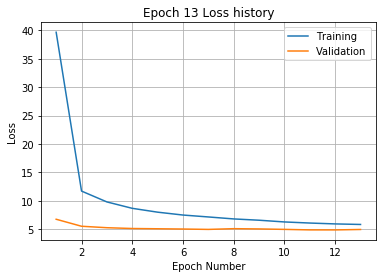

Training
Iteration 0: with minibatch training loss = 4.09 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.92 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.63 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.79 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 160: with minibatch training loss = 8.6 and relative error of 0.35
Iteration 180: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.74 and relative error of 0.25
Epoch 14, Overall loss = 5.71, relative error = 0.274, and proce

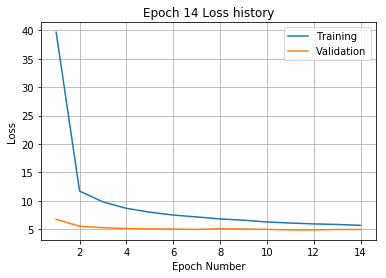

Training
Iteration 0: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 40: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 60: with minibatch training loss = 7.09 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.21 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.15 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 160: with minibatch training loss = 8.05 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.87 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.14 and relative error of 0.26
Epoch 15, Overall loss = 5.51, relative error = 0.269, and proc

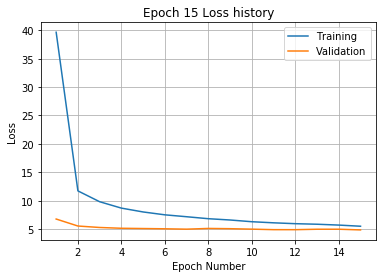

Training
Iteration 0: with minibatch training loss = 4.86 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 80: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 140: with minibatch training loss = 3.48 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.41 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.12 and relative error of 0.28
Epoch 16, Overall loss = 5.41, relative error = 0.267, and pr

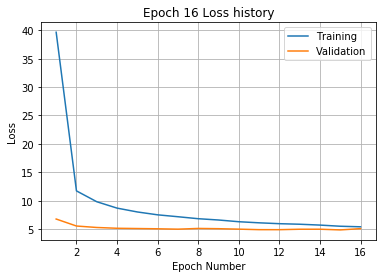

Training
Iteration 0: with minibatch training loss = 6.89 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.33 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.77 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.27 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.86 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.84 and relative error of 0.26
Epoch 17, Overall loss = 5.32, relative error = 0.265, and pr

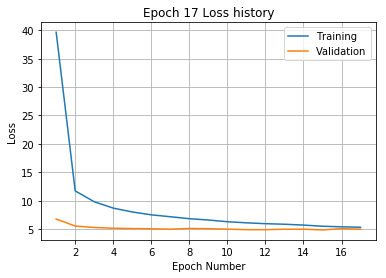

Training
Iteration 0: with minibatch training loss = 4.51 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.8 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.68 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.01 and relative error of 0.34
Iteration 140: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 200: with minibatch training loss = 3.3 and relative error of 0.21
Iteration 220: with minibatch training loss = 6.73 and relative error of 0.28
Epoch 18, Overall loss = 5.21, relative error = 0.262, and proc

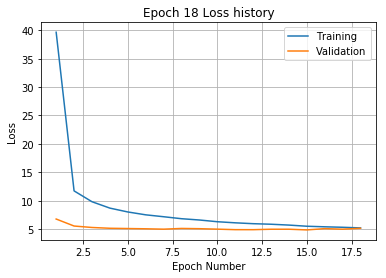

Training
Iteration 0: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 20: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 40: with minibatch training loss = 3.01 and relative error of 0.19
Iteration 60: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.19 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.29 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.15 and relative error of 0.26
Epoch 19, Overall loss = 5.05, relative error = 0.258, and pro

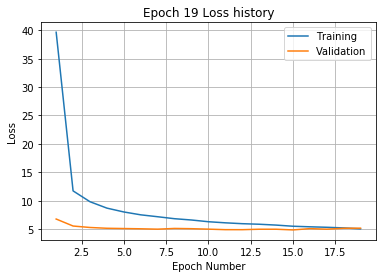

Training
Iteration 0: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.67 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 80: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 100: with minibatch training loss = 8.18 and relative error of 0.32
Iteration 120: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 140: with minibatch training loss = 3.52 and relative error of 0.21
Iteration 160: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.11 and relative error of 0.27
Epoch 20, Overall loss = 5.06, relative error = 0.258, and pr

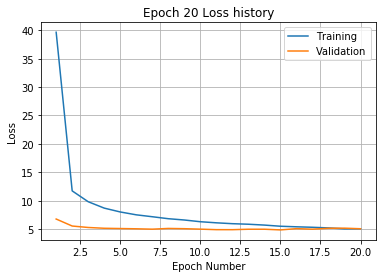

Validation error has stopped improving! Training on repetition 7 stopped!
Training
Iteration 0: with minibatch training loss = 160 and relative error of 1.5
Iteration 20: with minibatch training loss = 87.7 and relative error of 1.1
Iteration 40: with minibatch training loss = 59.6 and relative error of 0.9
Iteration 60: with minibatch training loss = 40.8 and relative error of 0.76
Iteration 80: with minibatch training loss = 30 and relative error of 0.65
Iteration 100: with minibatch training loss = 24.5 and relative error of 0.57
Iteration 120: with minibatch training loss = 19.6 and relative error of 0.53
Iteration 140: with minibatch training loss = 16.5 and relative error of 0.48
Iteration 160: with minibatch training loss = 16.1 and relative error of 0.46
Iteration 180: with minibatch training loss = 13.9 and relative error of 0.44
Iteration 200: with minibatch training loss = 16.8 and relative error of 0.49
Iteration 220: with minibatch training loss = 15.4 and relative error o

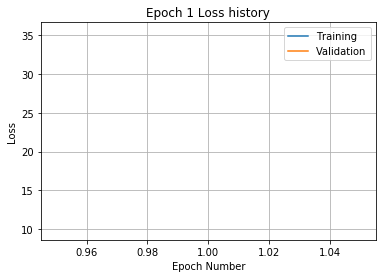

Training
Iteration 0: with minibatch training loss = 14.3 and relative error of 0.43
Iteration 20: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 40: with minibatch training loss = 12.4 and relative error of 0.43
Iteration 60: with minibatch training loss = 13.9 and relative error of 0.41
Iteration 80: with minibatch training loss = 9.34 and relative error of 0.37
Iteration 100: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 120: with minibatch training loss = 8.45 and relative error of 0.35
Iteration 140: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 160: with minibatch training loss = 8.29 and relative error of 0.32
Iteration 180: with minibatch training loss = 9.71 and relative error of 0.35
Iteration 200: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 220: with minibatch training loss = 13.2 and relative error of 0.42
Epoch 2, Overall loss = 11.4, relative error = 0.39, and proc

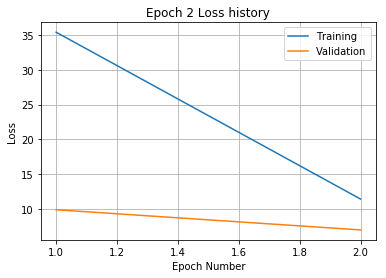

Training
Iteration 0: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 20: with minibatch training loss = 8.02 and relative error of 0.32
Iteration 40: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 60: with minibatch training loss = 11.4 and relative error of 0.37
Iteration 80: with minibatch training loss = 9.63 and relative error of 0.36
Iteration 100: with minibatch training loss = 9.7 and relative error of 0.37
Iteration 120: with minibatch training loss = 9.69 and relative error of 0.35
Iteration 140: with minibatch training loss = 7.87 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.47 and relative error of 0.33
Iteration 200: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 220: with minibatch training loss = 8.74 and relative error of 0.34
Epoch 3, Overall loss = 9.52, relative error = 0.356, and proc

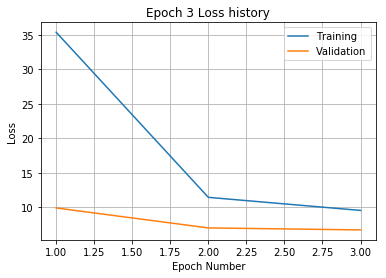

Training
Iteration 0: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 20: with minibatch training loss = 9.36 and relative error of 0.36
Iteration 40: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.66 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.59 and relative error of 0.31
Iteration 100: with minibatch training loss = 8.9 and relative error of 0.36
Iteration 120: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.64 and relative error of 0.33
Iteration 160: with minibatch training loss = 8.51 and relative error of 0.34
Iteration 180: with minibatch training loss = 9.09 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.96 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.11 and relative error of 0.29
Epoch 4, Overall loss = 8.43, relative error = 0.335, and proce

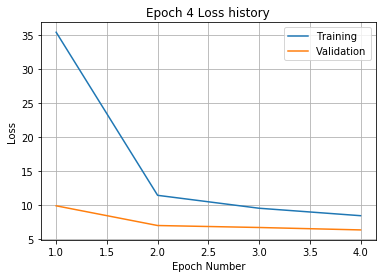

Training
Iteration 0: with minibatch training loss = 8.99 and relative error of 0.34
Iteration 20: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 40: with minibatch training loss = 8.72 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.81 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.62 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.87 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.25 and relative error of 0.34
Iteration 160: with minibatch training loss = 7.82 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.06 and relative error of 0.28
Iteration 200: with minibatch training loss = 9.47 and relative error of 0.36
Iteration 220: with minibatch training loss = 6.84 and relative error of 0.29
Epoch 5, Overall loss = 7.77, relative error = 0.322, and pro

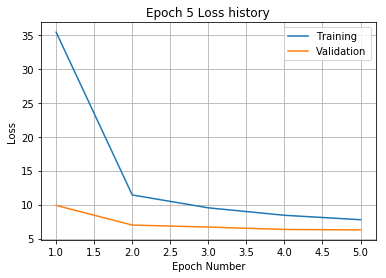

Training
Iteration 0: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 20: with minibatch training loss = 9.41 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 80: with minibatch training loss = 8.74 and relative error of 0.34
Iteration 100: with minibatch training loss = 7.38 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.38 and relative error of 0.28
Iteration 140: with minibatch training loss = 9.45 and relative error of 0.35
Iteration 160: with minibatch training loss = 6.75 and relative error of 0.31
Iteration 180: with minibatch training loss = 9.11 and relative error of 0.35
Iteration 200: with minibatch training loss = 9.96 and relative error of 0.35
Iteration 220: with minibatch training loss = 6.41 and relative error of 0.3
Epoch 6, Overall loss = 7.35, relative error = 0.312, and proce

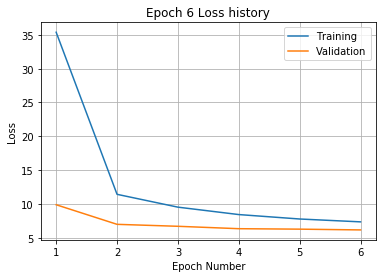

Training
Iteration 0: with minibatch training loss = 9.07 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.56 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.82 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.87 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.8 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 200: with minibatch training loss = 7 and relative error of 0.31
Iteration 220: with minibatch training loss = 9.91 and relative error of 0.36
Epoch 7, Overall loss = 7.01, relative error = 0.305, and process 

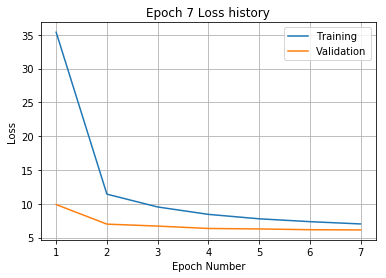

Training
Iteration 0: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.87 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 80: with minibatch training loss = 9.06 and relative error of 0.34
Iteration 100: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.88 and relative error of 0.29
Epoch 8, Overall loss = 6.73, relative error = 0.299, and proces

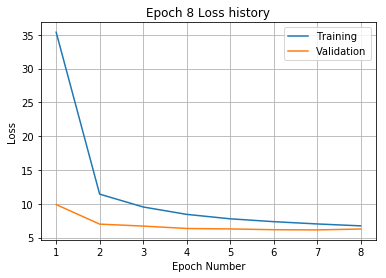

Training
Iteration 0: with minibatch training loss = 7.32 and relative error of 0.33
Iteration 20: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.97 and relative error of 0.35
Iteration 60: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.3 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.02 and relative error of 0.32
Iteration 220: with minibatch training loss = 4.86 and relative error of 0.26
Epoch 9, Overall loss = 6.51, relative error = 0.294, and process

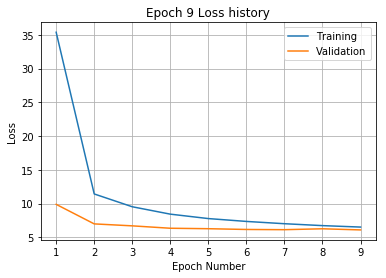

Training
Iteration 0: with minibatch training loss = 5.18 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.22 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.85 and relative error of 0.22
Iteration 180: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.56 and relative error of 0.27
Epoch 10, Overall loss = 6.27, relative error = 0.289, and pro

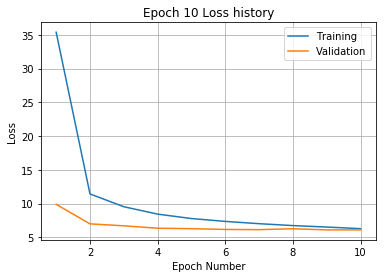

Training
Iteration 0: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.3 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.19 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.28 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.63 and relative error of 0.29
Epoch 11, Overall loss = 6.07, relative error = 0.284, and proc

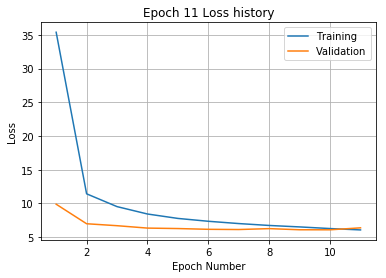

Training
Iteration 0: with minibatch training loss = 6.2 and relative error of 0.3
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.54 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.63 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.2 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.69 and relative error of 0.29
Iteration 220: with minibatch training loss = 8 and relative error of 0.32
Epoch 12, Overall loss = 5.88, relative error = 0.28, and process time

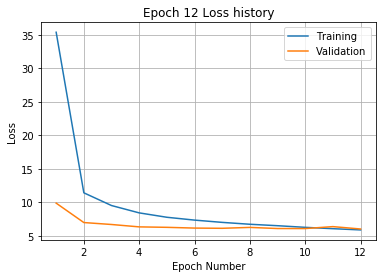

Training
Iteration 0: with minibatch training loss = 5.12 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 40: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 80: with minibatch training loss = 7.12 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.45 and relative error of 0.3
Iteration 120: with minibatch training loss = 3.2 and relative error of 0.21
Iteration 140: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.33 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.53 and relative error of 0.27
Epoch 13, Overall loss = 5.78, relative error = 0.277, and proces

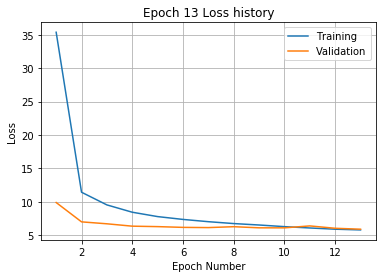

Training
Iteration 0: with minibatch training loss = 5.42 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.25 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.15 and relative error of 0.22
Iteration 100: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.41 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.29 and relative error of 0.3
Epoch 14, Overall loss = 5.67, relative error = 0.274, and proc

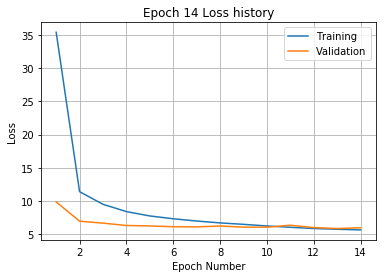

Training
Iteration 0: with minibatch training loss = 4.37 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.95 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.65 and relative error of 0.26
Iteration 160: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.26 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.38 and relative error of 0.26
Epoch 15, Overall loss = 5.5, relative error = 0.27, and proce

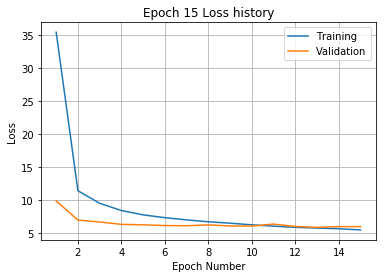

Training
Iteration 0: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.15 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 60: with minibatch training loss = 3.92 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.45 and relative error of 0.28
Iteration 100: with minibatch training loss = 3.67 and relative error of 0.21
Iteration 120: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 200: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.56 and relative error of 0.24
Epoch 16, Overall loss = 5.38, relative error = 0.267, and pro

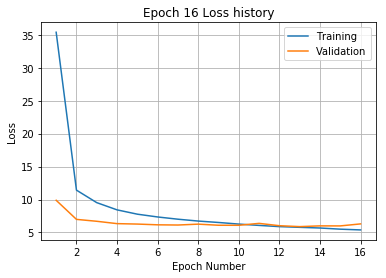

Training
Iteration 0: with minibatch training loss = 4.21 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.6 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.4 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.56 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.71 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.05 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 180: with minibatch training loss = 3.78 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.01 and relative error of 0.22
Iteration 220: with minibatch training loss = 3.55 and relative error of 0.22
Epoch 17, Overall loss = 5.29, relative error = 0.265, and proce

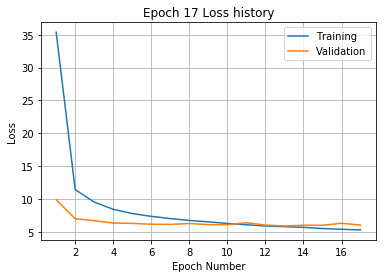

Training
Iteration 0: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.03 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.77 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.17 and relative error of 0.28
Epoch 18, Overall loss = 5.23, relative error = 0.264, and proc

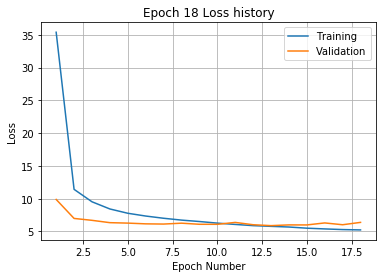

Validation error has stopped improving! Training on repetition 8 stopped!
Training
Iteration 0: with minibatch training loss = 221 and relative error of 1.7
Iteration 20: with minibatch training loss = 111 and relative error of 1.2
Iteration 40: with minibatch training loss = 86 and relative error of 1
Iteration 60: with minibatch training loss = 60.4 and relative error of 0.88
Iteration 80: with minibatch training loss = 44.3 and relative error of 0.77
Iteration 100: with minibatch training loss = 31.9 and relative error of 0.65
Iteration 120: with minibatch training loss = 26 and relative error of 0.6
Iteration 140: with minibatch training loss = 27.2 and relative error of 0.61
Iteration 160: with minibatch training loss = 20.2 and relative error of 0.53
Iteration 180: with minibatch training loss = 19 and relative error of 0.49
Iteration 200: with minibatch training loss = 17.2 and relative error of 0.5
Iteration 220: with minibatch training loss = 14.5 and relative error of 0.43
Ep

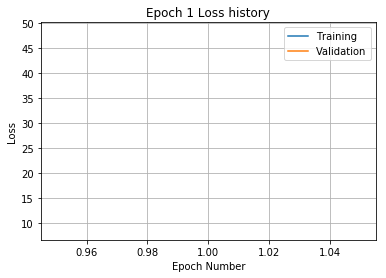

Training
Iteration 0: with minibatch training loss = 15.2 and relative error of 0.43
Iteration 20: with minibatch training loss = 14.2 and relative error of 0.43
Iteration 40: with minibatch training loss = 14 and relative error of 0.44
Iteration 60: with minibatch training loss = 14 and relative error of 0.43
Iteration 80: with minibatch training loss = 16.3 and relative error of 0.46
Iteration 100: with minibatch training loss = 12.7 and relative error of 0.42
Iteration 120: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 140: with minibatch training loss = 15.8 and relative error of 0.44
Iteration 160: with minibatch training loss = 15.4 and relative error of 0.46
Iteration 180: with minibatch training loss = 9.64 and relative error of 0.36
Iteration 200: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 220: with minibatch training loss = 11.2 and relative error of 0.41
Epoch 2, Overall loss = 12.9, relative error = 0.413, and process

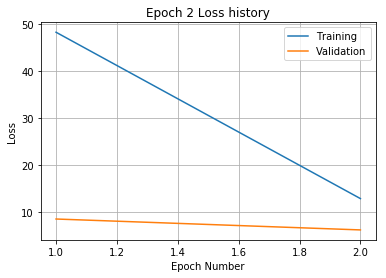

Training
Iteration 0: with minibatch training loss = 9.22 and relative error of 0.34
Iteration 20: with minibatch training loss = 10.5 and relative error of 0.39
Iteration 40: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 60: with minibatch training loss = 13 and relative error of 0.42
Iteration 80: with minibatch training loss = 12 and relative error of 0.41
Iteration 100: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 120: with minibatch training loss = 14.7 and relative error of 0.42
Iteration 140: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 160: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 180: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 200: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 220: with minibatch training loss = 10.5 and relative error of 0.37
Epoch 3, Overall loss = 10.5, relative error = 0.373, and process

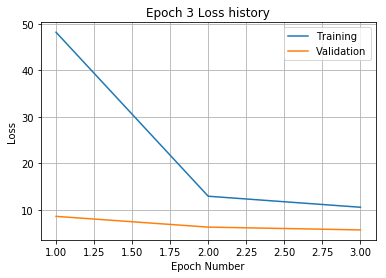

Training
Iteration 0: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 20: with minibatch training loss = 8.89 and relative error of 0.34
Iteration 40: with minibatch training loss = 12 and relative error of 0.4
Iteration 60: with minibatch training loss = 9.73 and relative error of 0.35
Iteration 80: with minibatch training loss = 9.58 and relative error of 0.35
Iteration 100: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 120: with minibatch training loss = 9.29 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.05 and relative error of 0.36
Iteration 160: with minibatch training loss = 8.49 and relative error of 0.33
Iteration 180: with minibatch training loss = 8.49 and relative error of 0.34
Iteration 200: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 220: with minibatch training loss = 8.67 and relative error of 0.34
Epoch 4, Overall loss = 9.29, relative error = 0.35, and process

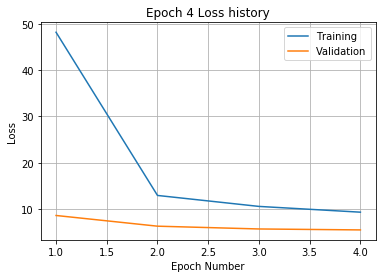

Training
Iteration 0: with minibatch training loss = 7.85 and relative error of 0.32
Iteration 20: with minibatch training loss = 7.6 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 80: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 100: with minibatch training loss = 8.69 and relative error of 0.35
Iteration 120: with minibatch training loss = 9.11 and relative error of 0.34
Iteration 140: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 200: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 220: with minibatch training loss = 6.64 and relative error of 0.29
Epoch 5, Overall loss = 8.43, relative error = 0.333, and proce

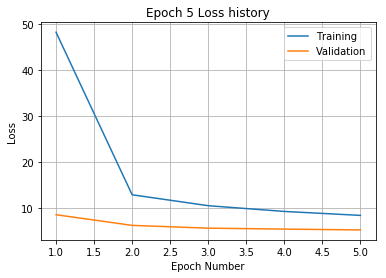

Training
Iteration 0: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.82 and relative error of 0.34
Iteration 40: with minibatch training loss = 7.45 and relative error of 0.31
Iteration 60: with minibatch training loss = 9.15 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.87 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.53 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.72 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.24 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.81 and relative error of 0.32
Epoch 6, Overall loss = 7.92, relative error = 0.323, and proce

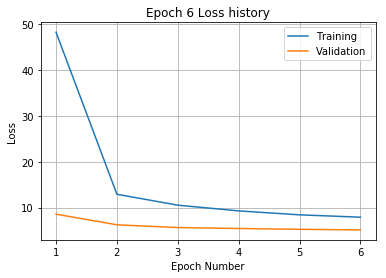

Training
Iteration 0: with minibatch training loss = 8.68 and relative error of 0.35
Iteration 20: with minibatch training loss = 9.47 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.48 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.07 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 140: with minibatch training loss = 9.2 and relative error of 0.35
Iteration 160: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.21 and relative error of 0.3
Epoch 7, Overall loss = 7.43, relative error = 0.313, and process

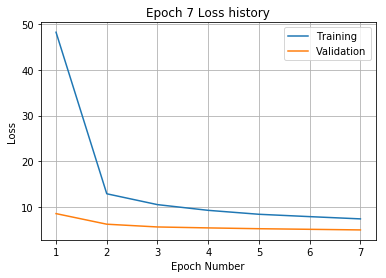

Training
Iteration 0: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 20: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.69 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.37 and relative error of 0.34
Iteration 80: with minibatch training loss = 6.25 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.81 and relative error of 0.28
Iteration 160: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 180: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.74 and relative error of 0.27
Epoch 8, Overall loss = 7.08, relative error = 0.305, and process

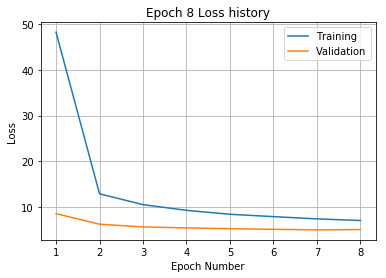

Training
Iteration 0: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.47 and relative error of 0.28
Iteration 60: with minibatch training loss = 7 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.53 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.46 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.79 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.15 and relative error of 0.33
Iteration 220: with minibatch training loss = 4.46 and relative error of 0.24
Epoch 9, Overall loss = 6.87, relative error = 0.301, and process t

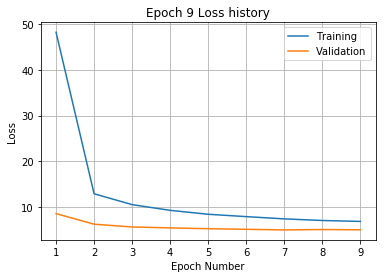

Training
Iteration 0: with minibatch training loss = 8.8 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.98 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 100: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.04 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.08 and relative error of 0.32
Iteration 160: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.76 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.42 and relative error of 0.29
Epoch 10, Overall loss = 6.61, relative error = 0.295, and proc

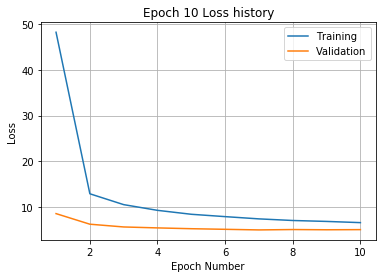

Training
Iteration 0: with minibatch training loss = 6.22 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.32 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.75 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.13 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 140: with minibatch training loss = 9.55 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.27 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.08 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.08 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.19 and relative error of 0.26
Epoch 11, Overall loss = 6.34, relative error = 0.289, and proce

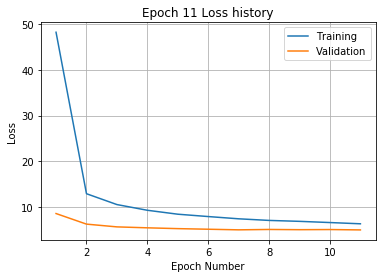

Training
Iteration 0: with minibatch training loss = 8.7 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.36 and relative error of 0.3
Iteration 40: with minibatch training loss = 9.21 and relative error of 0.35
Iteration 60: with minibatch training loss = 4.6 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 100: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.6 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.45 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.1 and relative error of 0.26
Epoch 12, Overall loss = 6.19, relative error = 0.285, and process t

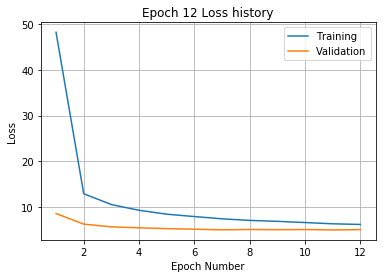

Training
Iteration 0: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.86 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.57 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 160: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.26 and relative error of 0.26
Epoch 13, Overall loss = 6.01, relative error = 0.281, and pro

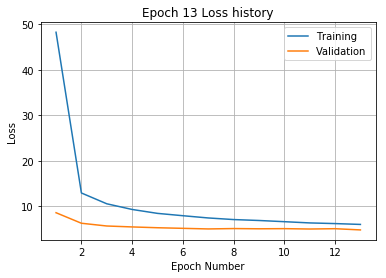

Training
Iteration 0: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.88 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 120: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.15 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.54 and relative error of 0.26
Epoch 14, Overall loss = 5.88, relative error = 0.278, and proc

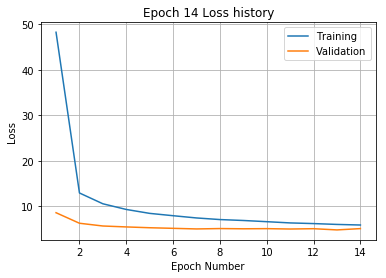

Training
Iteration 0: with minibatch training loss = 4.48 and relative error of 0.25
Iteration 20: with minibatch training loss = 3.92 and relative error of 0.22
Iteration 40: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.58 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.82 and relative error of 0.32
Iteration 140: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.84 and relative error of 0.26
Epoch 15, Overall loss = 5.71, relative error = 0.274, and proc

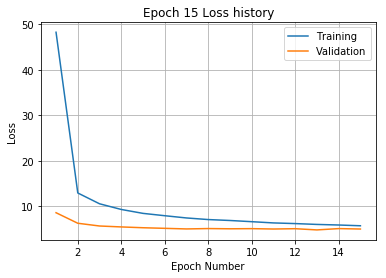

Training
Iteration 0: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 20: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.07 and relative error of 0.33
Iteration 100: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.31 and relative error of 0.28
Epoch 16, Overall loss = 5.6, relative error = 0.271, and proc

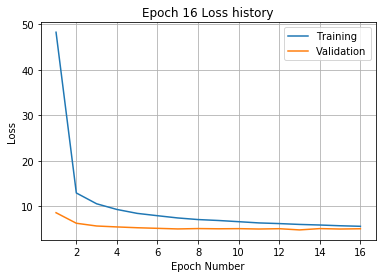

Training
Iteration 0: with minibatch training loss = 4.69 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.16 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 120: with minibatch training loss = 3.75 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.85 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.58 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 220: with minibatch training loss = 7.29 and relative error of 0.31
Epoch 17, Overall loss = 5.5, relative error = 0.269, and proces

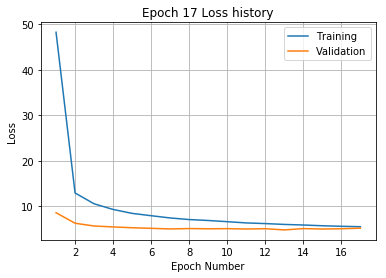

Training
Iteration 0: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.73 and relative error of 0.24
Iteration 40: with minibatch training loss = 7.3 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.33 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.69 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 160: with minibatch training loss = 3.9 and relative error of 0.24
Iteration 180: with minibatch training loss = 7.88 and relative error of 0.34
Iteration 200: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 220: with minibatch training loss = 3.65 and relative error of 0.22
Epoch 18, Overall loss = 5.37, relative error = 0.266, and proce

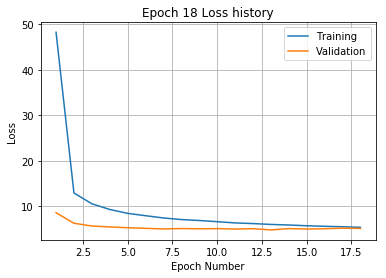

Validation error has stopped improving! Training on repetition 9 stopped!
Training
Iteration 0: with minibatch training loss = 193 and relative error of 1.6
Iteration 20: with minibatch training loss = 119 and relative error of 1.2
Iteration 40: with minibatch training loss = 73.4 and relative error of 1
Iteration 60: with minibatch training loss = 57.9 and relative error of 0.84
Iteration 80: with minibatch training loss = 42.5 and relative error of 0.72
Iteration 100: with minibatch training loss = 31.9 and relative error of 0.63
Iteration 120: with minibatch training loss = 21.7 and relative error of 0.55
Iteration 140: with minibatch training loss = 18.6 and relative error of 0.51
Iteration 160: with minibatch training loss = 18.5 and relative error of 0.49
Iteration 180: with minibatch training loss = 16 and relative error of 0.47
Iteration 200: with minibatch training loss = 17.4 and relative error of 0.49
Iteration 220: with minibatch training loss = 15.9 and relative error of 0

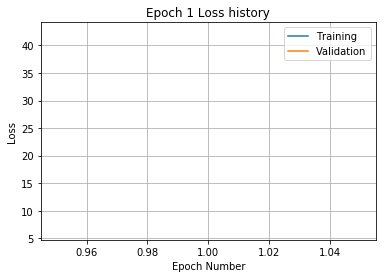

Training
Iteration 0: with minibatch training loss = 13.2 and relative error of 0.41
Iteration 20: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 40: with minibatch training loss = 14.9 and relative error of 0.46
Iteration 60: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 80: with minibatch training loss = 13.9 and relative error of 0.42
Iteration 100: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 120: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 140: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 160: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 180: with minibatch training loss = 9.31 and relative error of 0.35
Iteration 200: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 220: with minibatch training loss = 11.8 and relative error of 0.38
Epoch 2, Overall loss = 11.9, relative error = 0.396, and pro

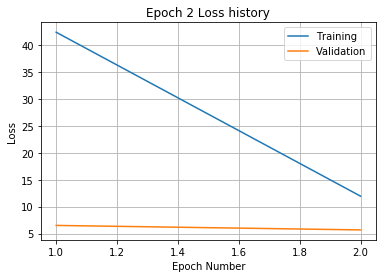

Training
Iteration 0: with minibatch training loss = 9.98 and relative error of 0.37
Iteration 20: with minibatch training loss = 8.25 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.14 and relative error of 0.34
Iteration 60: with minibatch training loss = 9.53 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.04 and relative error of 0.32
Iteration 100: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 120: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.38
Iteration 160: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 180: with minibatch training loss = 8.98 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 220: with minibatch training loss = 13.9 and relative error of 0.44
Epoch 3, Overall loss = 9.7, relative error = 0.357, and proce

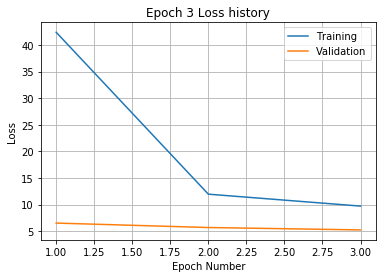

Training
Iteration 0: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 20: with minibatch training loss = 9.27 and relative error of 0.35
Iteration 40: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.84 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.45 and relative error of 0.34
Iteration 100: with minibatch training loss = 9.64 and relative error of 0.35
Iteration 120: with minibatch training loss = 8.3 and relative error of 0.32
Iteration 140: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 160: with minibatch training loss = 8.49 and relative error of 0.33
Iteration 180: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 200: with minibatch training loss = 8.68 and relative error of 0.33
Iteration 220: with minibatch training loss = 9.07 and relative error of 0.35
Epoch 4, Overall loss = 8.69, relative error = 0.338, and proc

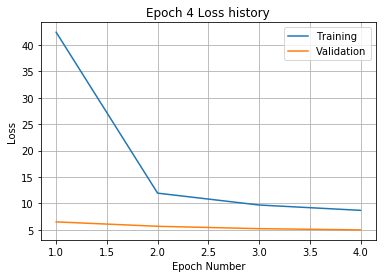

Training
Iteration 0: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.07 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.63 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.13 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.11 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.14 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.81 and relative error of 0.37
Iteration 180: with minibatch training loss = 9.03 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.12 and relative error of 0.36
Iteration 220: with minibatch training loss = 8.74 and relative error of 0.34
Epoch 5, Overall loss = 7.93, relative error = 0.322, and proc

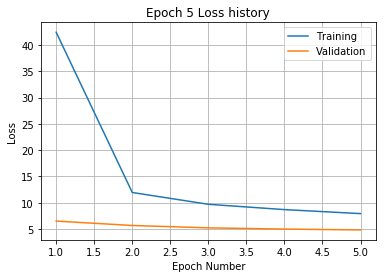

Training
Iteration 0: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.85 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.26 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.77 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 100: with minibatch training loss = 10 and relative error of 0.38
Iteration 120: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.37 and relative error of 0.3
Iteration 180: with minibatch training loss = 9.07 and relative error of 0.35
Iteration 200: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.82 and relative error of 0.27
Epoch 6, Overall loss = 7.42, relative error = 0.312, and process

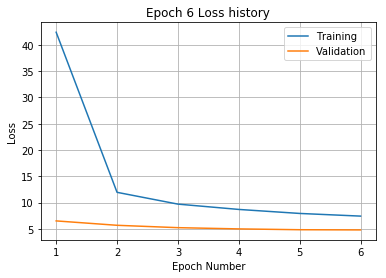

Training
Iteration 0: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.98 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.63 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.27 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.85 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.05 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.99 and relative error of 0.3
Epoch 7, Overall loss = 7.14, relative error = 0.306, and proce

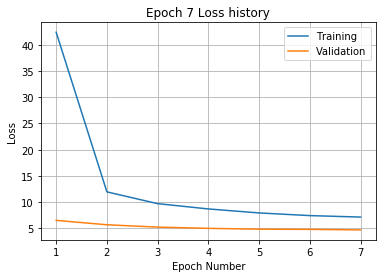

Training
Iteration 0: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.44 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.57 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.89 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.87 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.99 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.75 and relative error of 0.3
Epoch 8, Overall loss = 6.8, relative error = 0.299, and proces

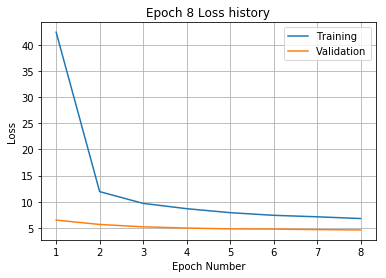

Training
Iteration 0: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.12 and relative error of 0.32
Iteration 40: with minibatch training loss = 3.31 and relative error of 0.2
Iteration 60: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 120: with minibatch training loss = 8.93 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.86 and relative error of 0.35
Iteration 160: with minibatch training loss = 7.72 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.03 and relative error of 0.25
Epoch 9, Overall loss = 6.5, relative error = 0.292, and proce

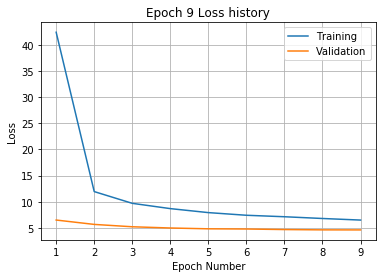

Training
Iteration 0: with minibatch training loss = 7.03 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 40: with minibatch training loss = 7.91 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.53 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.06 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.71 and relative error of 0.34
Iteration 120: with minibatch training loss = 7.15 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.27 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.24 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.33 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.38 and relative error of 0.23
Epoch 10, Overall loss = 6.34, relative error = 0.288, and pro

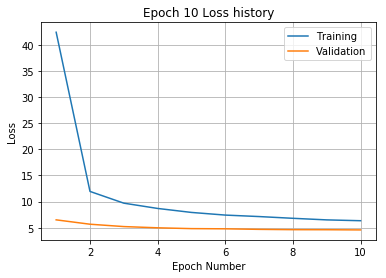

Training
Iteration 0: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.92 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.36 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.07 and relative error of 0.28
Epoch 11, Overall loss = 6.13, relative error = 0.283, and pro

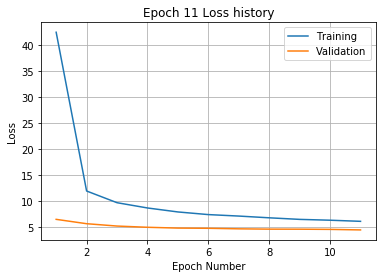

Training
Iteration 0: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.78 and relative error of 0.26
Iteration 40: with minibatch training loss = 5 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.55 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.14 and relative error of 0.29
Epoch 12, Overall loss = 6.05, relative error = 0.281, and process 

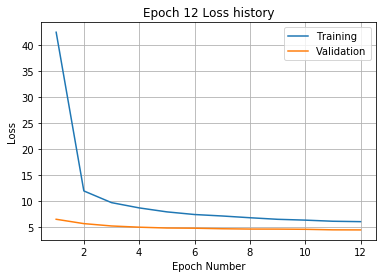

Training
Iteration 0: with minibatch training loss = 4.42 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.56 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.95 and relative error of 0.33
Iteration 60: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.29 and relative error of 0.23
Epoch 13, Overall loss = 5.84, relative error = 0.276, and pro

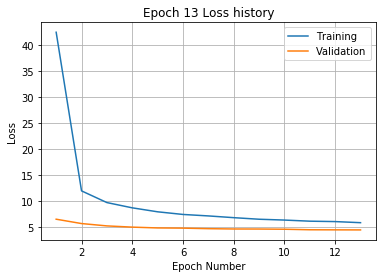

Training
Iteration 0: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 20: with minibatch training loss = 3.72 and relative error of 0.22
Iteration 40: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.11 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 100: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 120: with minibatch training loss = 9.35 and relative error of 0.34
Iteration 140: with minibatch training loss = 5.16 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.5 and relative error of 0.33
Iteration 200: with minibatch training loss = 3.64 and relative error of 0.21
Iteration 220: with minibatch training loss = 5.51 and relative error of 0.27
Epoch 14, Overall loss = 5.69, relative error = 0.272, and pro

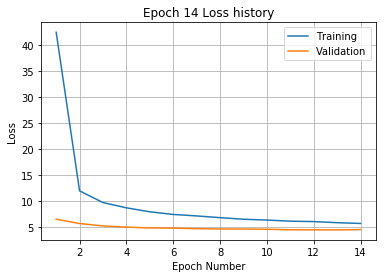

Training
Iteration 0: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.56 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.33 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 100: with minibatch training loss = 7.69 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.37 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.1 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.34 and relative error of 0.24
Epoch 15, Overall loss = 5.62, relative error = 0.271, and proce

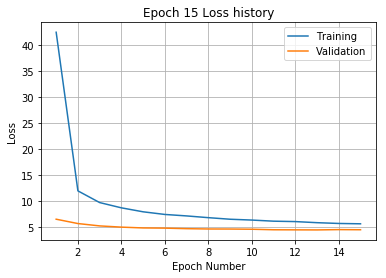

Training
Iteration 0: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.14 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.32 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 120: with minibatch training loss = 7.33 and relative error of 0.32
Iteration 140: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.6 and relative error of 0.24
Epoch 16, Overall loss = 5.43, relative error = 0.267, and proc

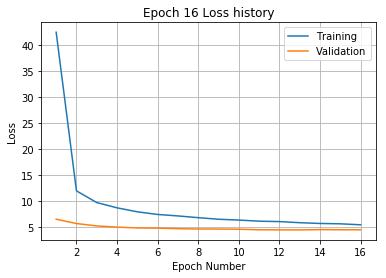

Training
Iteration 0: with minibatch training loss = 6.21 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 60: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.66 and relative error of 0.26
Iteration 100: with minibatch training loss = 8.33 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.18 and relative error of 0.26
Epoch 17, Overall loss = 5.38, relative error = 0.265, and proce

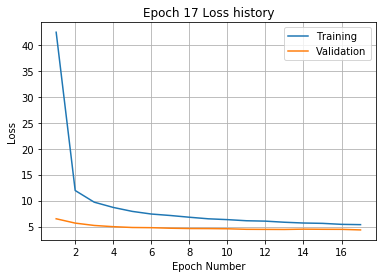

Training
Iteration 0: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 60: with minibatch training loss = 3.42 and relative error of 0.21
Iteration 80: with minibatch training loss = 5 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.68 and relative error of 0.28
Iteration 140: with minibatch training loss = 3.58 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.85 and relative error of 0.28
Epoch 18, Overall loss = 5.23, relative error = 0.262, and process

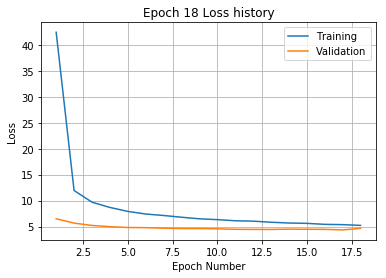

Training
Iteration 0: with minibatch training loss = 4.7 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.05 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.22 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.69 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 160: with minibatch training loss = 5 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.88 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.67 and relative error of 0.26
Iteration 220: with minibatch training loss = 8.11 and relative error of 0.34
Epoch 19, Overall loss = 5.13, relative error = 0.259, and process

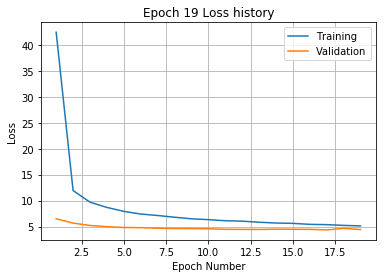

Training
Iteration 0: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 20: with minibatch training loss = 5.09 and relative error of 0.25
Iteration 40: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 60: with minibatch training loss = 3.19 and relative error of 0.21
Iteration 80: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 100: with minibatch training loss = 3.85 and relative error of 0.22
Iteration 120: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 180: with minibatch training loss = 3.89 and relative error of 0.22
Iteration 200: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.18 and relative error of 0.29
Epoch 20, Overall loss = 5.04, relative error = 0.257, and pr

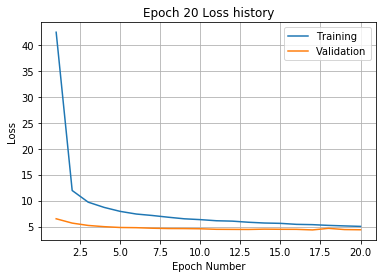

Training
Iteration 0: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 20: with minibatch training loss = 3.75 and relative error of 0.22
Iteration 40: with minibatch training loss = 3.75 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.28 and relative error of 0.24
Iteration 80: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 160: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.5 and relative error of 0.22
Epoch 21, Overall loss = 4.9, relative error = 0.253, and proc

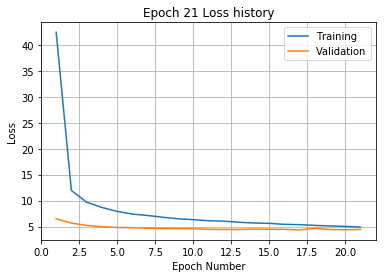

Training
Iteration 0: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.65 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 100: with minibatch training loss = 3.65 and relative error of 0.22
Iteration 120: with minibatch training loss = 4.67 and relative error of 0.24
Iteration 140: with minibatch training loss = 3.1 and relative error of 0.2
Iteration 160: with minibatch training loss = 4.63 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 220: with minibatch training loss = 5 and relative error of 0.26
Epoch 22, Overall loss = 4.89, relative error = 0.253, and process 

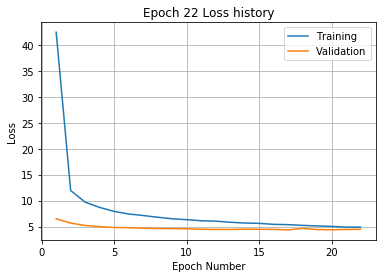

Validation error has stopped improving! Training on repetition 10 stopped!
log interval:  120 seconds
loading data
stacking image log's channels
Training
Iteration 0: with minibatch training loss = 193 and relative error of 1.6
Iteration 20: with minibatch training loss = 120 and relative error of 1.3
Iteration 40: with minibatch training loss = 72.9 and relative error of 0.98
Iteration 60: with minibatch training loss = 50.6 and relative error of 0.83
Iteration 80: with minibatch training loss = 39 and relative error of 0.72
Iteration 100: with minibatch training loss = 29.3 and relative error of 0.62
Iteration 120: with minibatch training loss = 19.4 and relative error of 0.51
Iteration 140: with minibatch training loss = 18.9 and relative error of 0.49
Iteration 160: with minibatch training loss = 17.9 and relative error of 0.51
Iteration 180: with minibatch training loss = 16.6 and relative error of 0.46
Iteration 200: with minibatch training loss = 15.6 and relative error of 0.45


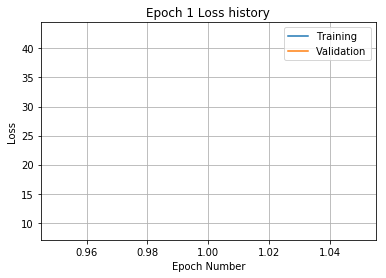

Training
Iteration 0: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 20: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 40: with minibatch training loss = 12 and relative error of 0.39
Iteration 60: with minibatch training loss = 13.1 and relative error of 0.41
Iteration 80: with minibatch training loss = 12.5 and relative error of 0.4
Iteration 100: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 120: with minibatch training loss = 9.45 and relative error of 0.35
Iteration 140: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 160: with minibatch training loss = 11.4 and relative error of 0.4
Iteration 180: with minibatch training loss = 11 and relative error of 0.38
Iteration 200: with minibatch training loss = 13.9 and relative error of 0.42
Iteration 220: with minibatch training loss = 9.59 and relative error of 0.36
Iteration 240: with minibatch training loss = 10.4 and relative erro

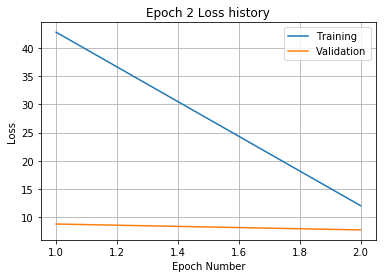

Training
Iteration 0: with minibatch training loss = 9.86 and relative error of 0.36
Iteration 20: with minibatch training loss = 9.42 and relative error of 0.35
Iteration 40: with minibatch training loss = 11.3 and relative error of 0.4
Iteration 60: with minibatch training loss = 13.1 and relative error of 0.43
Iteration 80: with minibatch training loss = 9.62 and relative error of 0.35
Iteration 100: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 120: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 140: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 160: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 180: with minibatch training loss = 11 and relative error of 0.39
Iteration 200: with minibatch training loss = 9.67 and relative error of 0.36
Iteration 220: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 240: with minibatch training loss = 7.96 and relative 

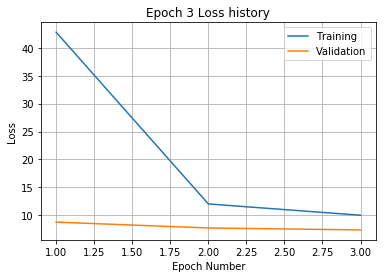

Training
Iteration 0: with minibatch training loss = 11.6 and relative error of 0.38
Iteration 20: with minibatch training loss = 8.8 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.52 and relative error of 0.33
Iteration 60: with minibatch training loss = 7.7 and relative error of 0.31
Iteration 80: with minibatch training loss = 10.1 and relative error of 0.38
Iteration 100: with minibatch training loss = 8.65 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.4 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.4 and relative error of 0.33
Iteration 160: with minibatch training loss = 9.38 and relative error of 0.36
Iteration 180: with minibatch training loss = 8.07 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.66 and relative error of 0.31
Iteration 220: with minibatch training loss = 9.12 and relative error of 0.34
Iteration 240: with minibatch training loss = 10.4 and relative e

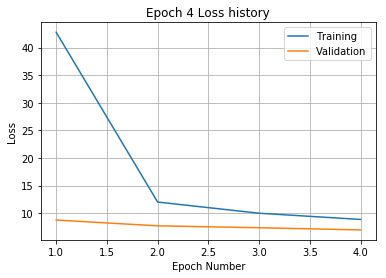

Training
Iteration 0: with minibatch training loss = 8.52 and relative error of 0.33
Iteration 20: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 40: with minibatch training loss = 6.7 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 80: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 100: with minibatch training loss = 6.65 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.01 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.81 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.25 and relative error of 0.3
Iteration 200: with minibatch training loss = 9.81 and relative error of 0.37
Iteration 220: with minibatch training loss = 7.21 and relative error of 0.32
Iteration 240: with minibatch training loss = 9.3 and relative 

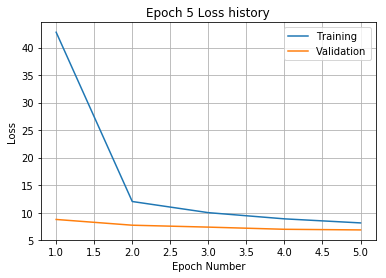

Training
Iteration 0: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.45 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.79 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.39 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.69 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.41 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.42 and relative error of 0.33
Iteration 240: with minibatch training loss = 8.83 and relative

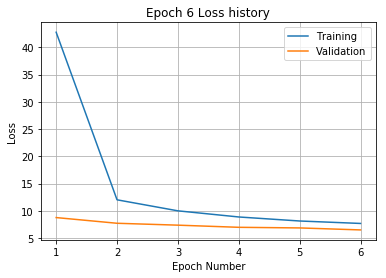

Training
Iteration 0: with minibatch training loss = 9.79 and relative error of 0.36
Iteration 20: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 40: with minibatch training loss = 9.04 and relative error of 0.34
Iteration 60: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 120: with minibatch training loss = 7.08 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.36 and relative error of 0.32
Iteration 160: with minibatch training loss = 9.42 and relative error of 0.36
Iteration 180: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.3 and relative error of 0.31
Iteration 220: with minibatch training loss = 9.8 and relative error of 0.35
Iteration 240: with minibatch training loss = 6.65 and relative e

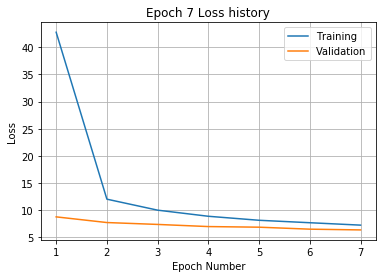

Training
Iteration 0: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.87 and relative error of 0.35
Iteration 100: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.41 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 200: with minibatch training loss = 7.83 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.63 and relative error of 0.31
Iteration 240: with minibatch training loss = 7.98 and relative

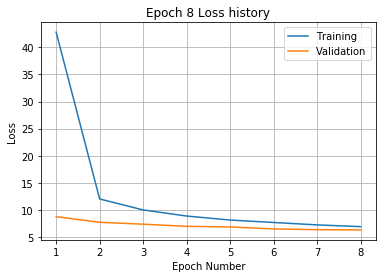

Training
Iteration 0: with minibatch training loss = 8.68 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.18 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.82 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.4 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.96 and relative error of 0.35
Iteration 120: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 140: with minibatch training loss = 7.41 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.09 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.74 and relative error of 0.34
Iteration 200: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.46 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.83 and relativ

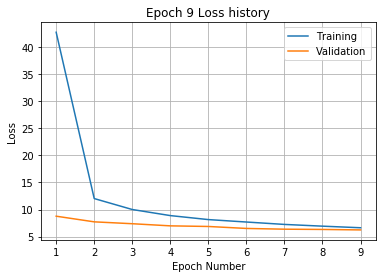

Training
Iteration 0: with minibatch training loss = 5.81 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.19 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.7 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.09 and relative error of 0.33
Iteration 80: with minibatch training loss = 5.37 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.94 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.37 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.41 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.6 and relative error of 0.31
Iteration 240: with minibatch training loss = 4.74 and relative 

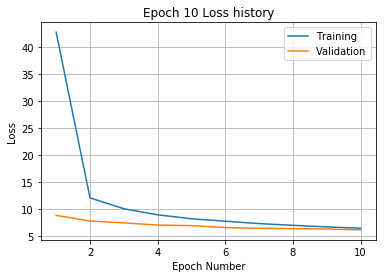

Training
Iteration 0: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.08 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 80: with minibatch training loss = 8.01 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.93 and relative error of 0.32
Iteration 120: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.02 and relati

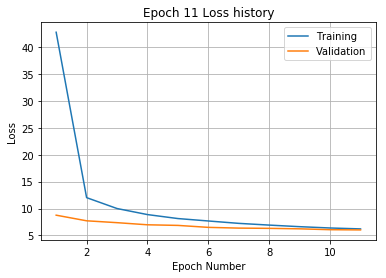

Training
Iteration 0: with minibatch training loss = 4.99 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.79 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.48 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.66 and relative 

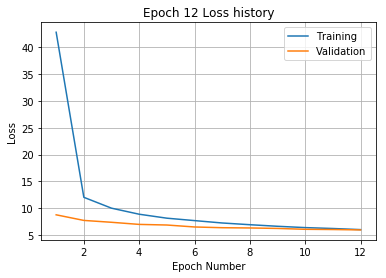

Training
Iteration 0: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.7 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.16 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.96 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.14 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.55 and relative e

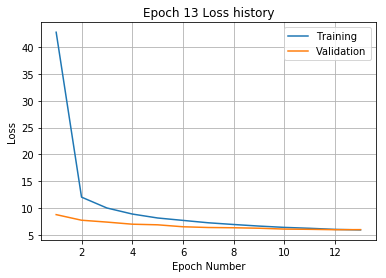

Training
Iteration 0: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.55 and relative error of 0.28
Iteration 40: with minibatch training loss = 8.64 and relative error of 0.35
Iteration 60: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.11 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.36 and relative error of 0.25
Iteration 240: with minibatch training loss = 4.82 and relati

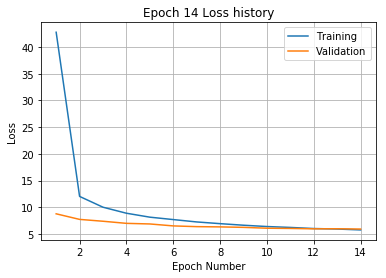

Training
Iteration 0: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 20: with minibatch training loss = 7.6 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 160: with minibatch training loss = 3.98 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.6 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.83 and relative 

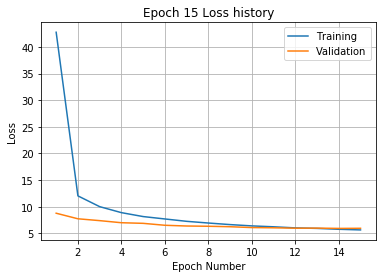

Training
Iteration 0: with minibatch training loss = 3.76 and relative error of 0.23
Iteration 20: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.71 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.13 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 100: with minibatch training loss = 3.91 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.34 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.52 and relative error of 0.25
Iteration 240: with minibatch training loss = 3.84 and relati

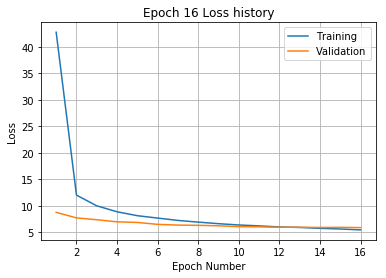

Training
Iteration 0: with minibatch training loss = 8.28 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.91 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.76 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.64 and relative error of 0.22
Iteration 180: with minibatch training loss = 4.03 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.24 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 240: with minibatch training loss = 5.55 and relativ

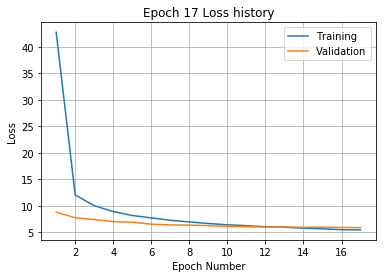

Training
Iteration 0: with minibatch training loss = 7.07 and relative error of 0.3
Iteration 20: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.12 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 120: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.87 and relative error of 0.29
Iteration 180: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.57 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.77 and relative

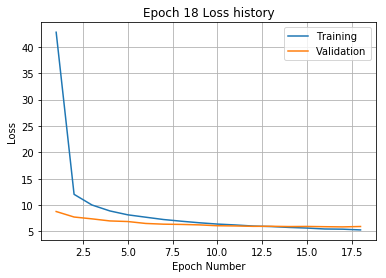

Training
Iteration 0: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.24 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.06 and relative error of 0.23
Iteration 60: with minibatch training loss = 3.69 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 100: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 120: with minibatch training loss = 3.06 and relative error of 0.2
Iteration 140: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 200: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.39 and relative e

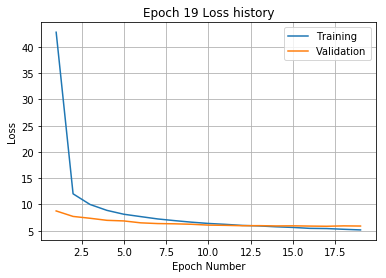

Training
Iteration 0: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.13 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.67 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.01 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.58 and relative error of 0.24
Iteration 120: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 200: with minibatch training loss = 3.96 and relative error of 0.22
Iteration 220: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 240: with minibatch training loss = 6.34 and relativ

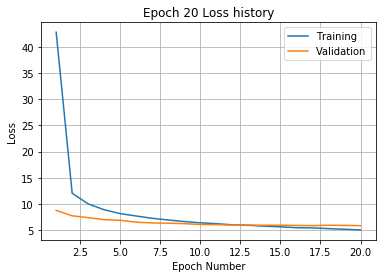

Training
Iteration 0: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.05 and relative error of 0.22
Iteration 140: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.54 and relative error of 0.24
Iteration 180: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 200: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 240: with minibatch training loss = 3.94 and relative 

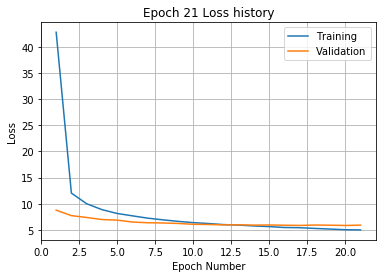

Training
Iteration 0: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 40: with minibatch training loss = 7.89 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.41 and relative error of 0.24
Iteration 160: with minibatch training loss = 3.92 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.22 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.42 and relativ

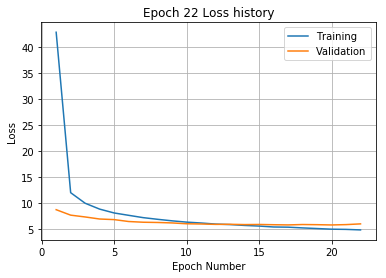

Training
Iteration 0: with minibatch training loss = 5.24 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.71 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.92 and relative error of 0.27
Iteration 60: with minibatch training loss = 3.67 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.85 and relative error of 0.22
Iteration 140: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.23 and relative error of 0.23
Iteration 180: with minibatch training loss = 3.58 and relative error of 0.21
Iteration 200: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 240: with minibatch training loss = 3.87 and relati

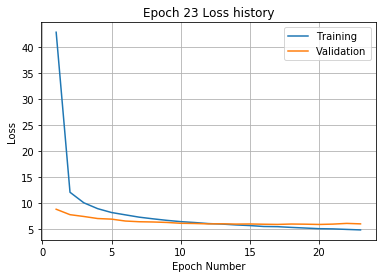

Training
Iteration 0: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 20: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 60: with minibatch training loss = 4.11 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.37 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.41 and relative error of 0.25
Iteration 140: with minibatch training loss = 3.03 and relative error of 0.2
Iteration 160: with minibatch training loss = 5.78 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.5 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 240: with minibatch training loss = 4.58 and relative

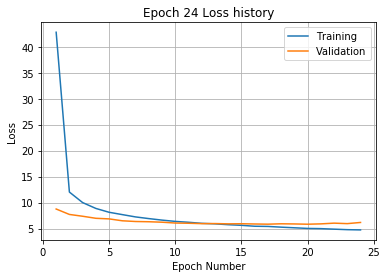

Training
Iteration 0: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 80: with minibatch training loss = 3.73 and relative error of 0.22
Iteration 100: with minibatch training loss = 4.15 and relative error of 0.23
Iteration 120: with minibatch training loss = 3.32 and relative error of 0.21
Iteration 140: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.36 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.06 and relative error of 0.27
Iteration 240: with minibatch training loss = 3.33 and relative 

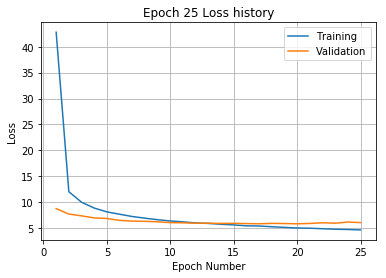

Validation error has stopped improving! Training on repetition 1 stopped!
Training
Iteration 0: with minibatch training loss = 188 and relative error of 1.6
Iteration 20: with minibatch training loss = 84.7 and relative error of 1
Iteration 40: with minibatch training loss = 55.6 and relative error of 0.84
Iteration 60: with minibatch training loss = 40.1 and relative error of 0.74
Iteration 80: with minibatch training loss = 25.2 and relative error of 0.6
Iteration 100: with minibatch training loss = 23.3 and relative error of 0.58
Iteration 120: with minibatch training loss = 19.7 and relative error of 0.5
Iteration 140: with minibatch training loss = 17.7 and relative error of 0.48
Iteration 160: with minibatch training loss = 16.4 and relative error of 0.47
Iteration 180: with minibatch training loss = 16.5 and relative error of 0.47
Iteration 200: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 220: with minibatch training loss = 15 and relative error of 0

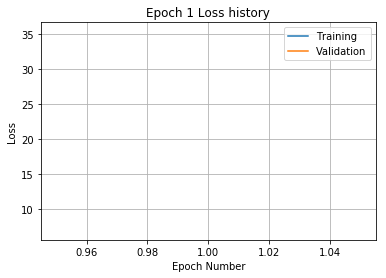

Training
Iteration 0: with minibatch training loss = 12.2 and relative error of 0.41
Iteration 20: with minibatch training loss = 14.4 and relative error of 0.44
Iteration 40: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 60: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 100: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 120: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 140: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 180: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 200: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 220: with minibatch training loss = 10.4 and relative error of 0.39
Iteration 240: with minibatch training loss = 10.6 and relati

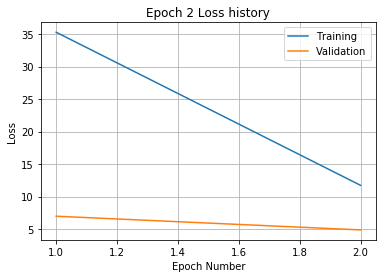

Training
Iteration 0: with minibatch training loss = 8.02 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.89 and relative error of 0.35
Iteration 40: with minibatch training loss = 13.2 and relative error of 0.43
Iteration 60: with minibatch training loss = 9.01 and relative error of 0.35
Iteration 80: with minibatch training loss = 11.2 and relative error of 0.4
Iteration 100: with minibatch training loss = 9.78 and relative error of 0.35
Iteration 120: with minibatch training loss = 8.76 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.55 and relative error of 0.33
Iteration 160: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 180: with minibatch training loss = 10.3 and relative error of 0.37
Iteration 200: with minibatch training loss = 8.71 and relative error of 0.35
Iteration 220: with minibatch training loss = 9.8 and relative error of 0.37
Iteration 240: with minibatch training loss = 7.59 and relative

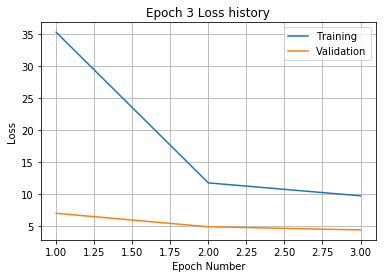

Training
Iteration 0: with minibatch training loss = 12.6 and relative error of 0.39
Iteration 20: with minibatch training loss = 9.42 and relative error of 0.34
Iteration 40: with minibatch training loss = 9.57 and relative error of 0.35
Iteration 60: with minibatch training loss = 8.79 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.96 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.94 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.66 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.74 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.25 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.88 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.71 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 240: with minibatch training loss = 7.69 and relativ

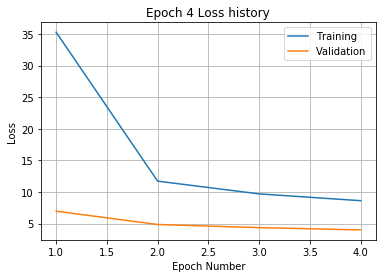

Training
Iteration 0: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 20: with minibatch training loss = 9.69 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.52 and relative error of 0.35
Iteration 60: with minibatch training loss = 7.35 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.26 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.37 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.67 and relative error of 0.32
Iteration 180: with minibatch training loss = 9.44 and relative error of 0.36
Iteration 200: with minibatch training loss = 9.26 and relative error of 0.35
Iteration 220: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 240: with minibatch training loss = 10.8 and relative

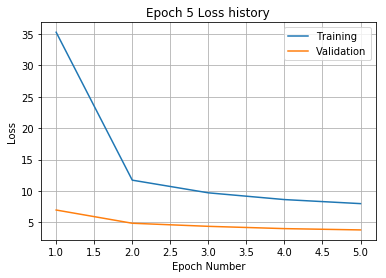

Training
Iteration 0: with minibatch training loss = 8.92 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.33 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.85 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.51 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.23 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 140: with minibatch training loss = 7 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.52 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.41 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 240: with minibatch training loss = 7.96 and relative error 

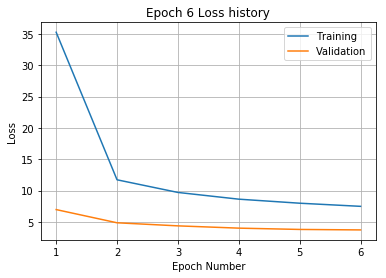

Training
Iteration 0: with minibatch training loss = 8.56 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.41 and relative error of 0.3
Iteration 40: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.1 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.82 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 200: with minibatch training loss = 8.13 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 240: with minibatch training loss = 7.09 and relative e

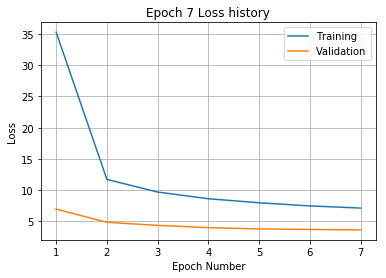

Training
Iteration 0: with minibatch training loss = 8.24 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.75 and relative error of 0.33
Iteration 40: with minibatch training loss = 7.68 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.88 and relative error of 0.35
Iteration 80: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.21 and relative error of 0.32
Iteration 120: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.36 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.85 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.7 and relative 

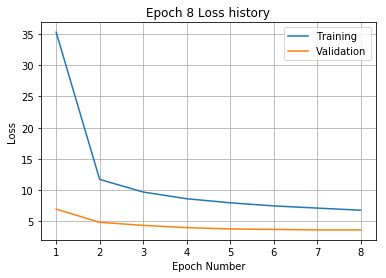

Training
Iteration 0: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.73 and relative error of 0.31
Iteration 60: with minibatch training loss = 9.41 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.46 and relative error of 0.35
Iteration 100: with minibatch training loss = 7.17 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 140: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.65 and relative error of 0.29
Iteration 180: with minibatch training loss = 8.15 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.78 and relative error of 0.31
Iteration 220: with minibatch training loss = 9.79 and relative error of 0.35
Iteration 240: with minibatch training loss = 7.25 and relativ

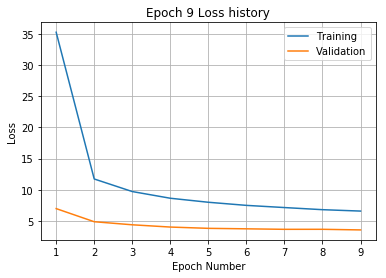

Training
Iteration 0: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.71 and relative error of 0.32
Iteration 140: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 180: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 200: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.89 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.66 and relative e

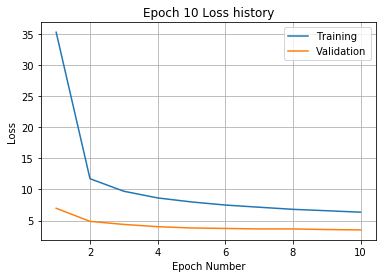

Training
Iteration 0: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 40: with minibatch training loss = 8.02 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.85 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.52 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 140: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.4 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.02 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.45 and relativ

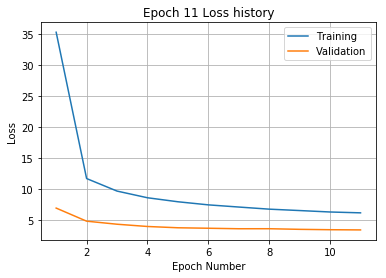

Training
Iteration 0: with minibatch training loss = 6 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.75 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.59 and relative error of 0.28
Iteration 100: with minibatch training loss = 4.17 and relative error of 0.23
Iteration 120: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.31 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 220: with minibatch training loss = 4 and relative error of 0.24
Iteration 240: with minibatch training loss = 7.17 and relative erro

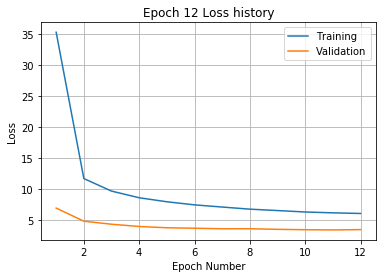

Training
Iteration 0: with minibatch training loss = 3.64 and relative error of 0.22
Iteration 20: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.23 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.16 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.29 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.03 and relative 

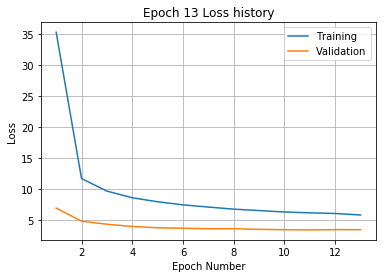

Training
Iteration 0: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.2 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.98 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.34 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.27 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.95 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 240: with minibatch training loss = 4.77 and relativ

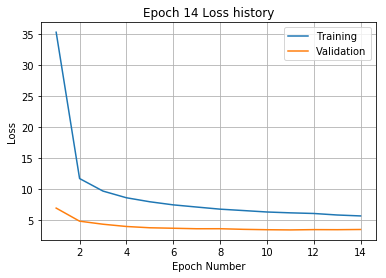

Training
Iteration 0: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 20: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.05 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.91 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.72 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.23 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.44 and relative error of 0.3
Iteration 240: with minibatch training loss = 5.94 and relative 

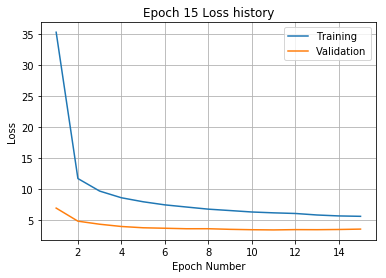

Training
Iteration 0: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.57 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.83 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 160: with minibatch training loss = 6 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.47 and relative error of 0.28
Iteration 200: with minibatch training loss = 3.58 and relative error of 0.22
Iteration 220: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.25 and relative e

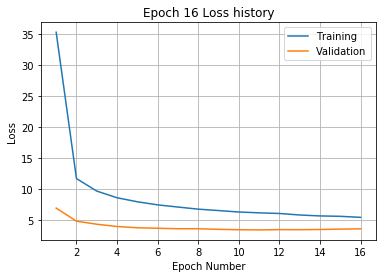

Validation error has stopped improving! Training on repetition 2 stopped!
Training
Iteration 0: with minibatch training loss = 227 and relative error of 1.6
Iteration 20: with minibatch training loss = 125 and relative error of 1.3
Iteration 40: with minibatch training loss = 80.1 and relative error of 1
Iteration 60: with minibatch training loss = 55 and relative error of 0.86
Iteration 80: with minibatch training loss = 40.3 and relative error of 0.74
Iteration 100: with minibatch training loss = 28 and relative error of 0.62
Iteration 120: with minibatch training loss = 21.7 and relative error of 0.53
Iteration 140: with minibatch training loss = 19 and relative error of 0.5
Iteration 160: with minibatch training loss = 15.6 and relative error of 0.46
Iteration 180: with minibatch training loss = 16.6 and relative error of 0.46
Iteration 200: with minibatch training loss = 16.3 and relative error of 0.46
Iteration 220: with minibatch training loss = 15 and relative error of 0.42
Ite

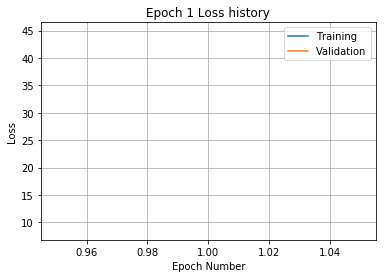

Training
Iteration 0: with minibatch training loss = 14.5 and relative error of 0.43
Iteration 20: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 40: with minibatch training loss = 13 and relative error of 0.41
Iteration 60: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 80: with minibatch training loss = 12.7 and relative error of 0.41
Iteration 100: with minibatch training loss = 14.4 and relative error of 0.44
Iteration 120: with minibatch training loss = 12.1 and relative error of 0.41
Iteration 140: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 160: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 180: with minibatch training loss = 9.09 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.76 and relative error of 0.38
Iteration 220: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 240: with minibatch training loss = 11.2 and relative 

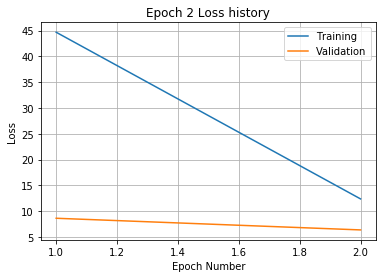

Training
Iteration 0: with minibatch training loss = 11.2 and relative error of 0.37
Iteration 20: with minibatch training loss = 12.5 and relative error of 0.41
Iteration 40: with minibatch training loss = 11.3 and relative error of 0.4
Iteration 60: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 80: with minibatch training loss = 13.9 and relative error of 0.43
Iteration 100: with minibatch training loss = 10.6 and relative error of 0.36
Iteration 120: with minibatch training loss = 11 and relative error of 0.38
Iteration 140: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 160: with minibatch training loss = 9.76 and relative error of 0.35
Iteration 180: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 200: with minibatch training loss = 8.5 and relative error of 0.33
Iteration 220: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 240: with minibatch training loss = 8.67 and relative e

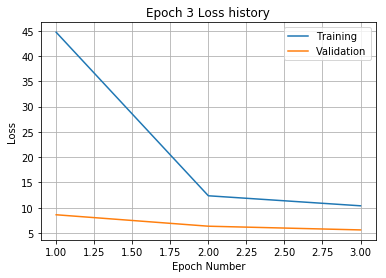

Training
Iteration 0: with minibatch training loss = 9.86 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 40: with minibatch training loss = 9.76 and relative error of 0.35
Iteration 60: with minibatch training loss = 11.1 and relative error of 0.39
Iteration 80: with minibatch training loss = 8.73 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.58 and relative error of 0.33
Iteration 120: with minibatch training loss = 9.32 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 180: with minibatch training loss = 8.2 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.97 and relative error of 0.33
Iteration 220: with minibatch training loss = 9.32 and relative error of 0.34
Iteration 240: with minibatch training loss = 7.56 and relativ

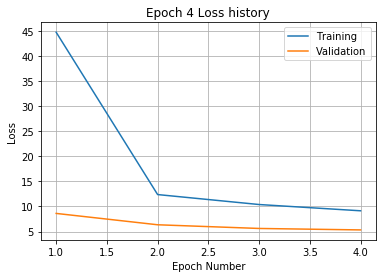

Training
Iteration 0: with minibatch training loss = 12 and relative error of 0.39
Iteration 20: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 40: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 60: with minibatch training loss = 7.34 and relative error of 0.31
Iteration 80: with minibatch training loss = 8.37 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.24 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.82 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.97 and relative error of 0.34
Iteration 160: with minibatch training loss = 7.95 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.72 and relative error of 0.33
Iteration 200: with minibatch training loss = 9.27 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 240: with minibatch training loss = 8.32 and relative

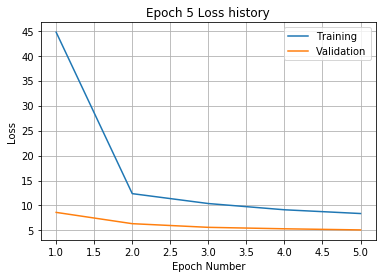

Training
Iteration 0: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.85 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.64 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.66 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.87 and relative error of 0.33
Iteration 100: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 120: with minibatch training loss = 9.38 and relative error of 0.35
Iteration 140: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.63 and relative error of 0.31
Iteration 220: with minibatch training loss = 8.35 and relative error of 0.34
Iteration 240: with minibatch training loss = 8.51 and relative e

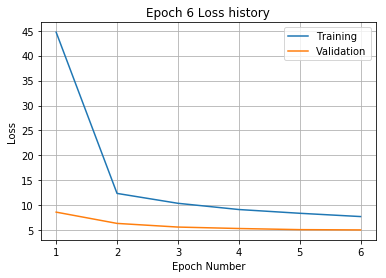

Training
Iteration 0: with minibatch training loss = 8.15 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.89 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 140: with minibatch training loss = 9.24 and relative error of 0.34
Iteration 160: with minibatch training loss = 8.1 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.07 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.68 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.83 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.63 and relative er

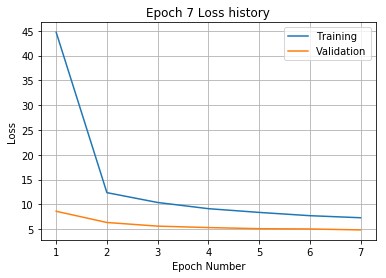

Training
Iteration 0: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 20: with minibatch training loss = 8.29 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.63 and relative error of 0.35
Iteration 60: with minibatch training loss = 7.25 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.27 and relative error of 0.33
Iteration 100: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 120: with minibatch training loss = 8.32 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.06 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.59 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.89 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.7 and relative error of 0.33
Iteration 240: with minibatch training loss = 7.69 and relative

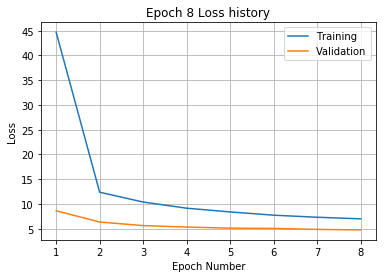

Training
Iteration 0: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.96 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.13 and relative error of 0.27
Iteration 60: with minibatch training loss = 8.15 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.51 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.12 and relative error of 0.27
Iteration 140: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 160: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.83 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.69 and relative error of 0.33
Iteration 240: with minibatch training loss = 5.82 and relativ

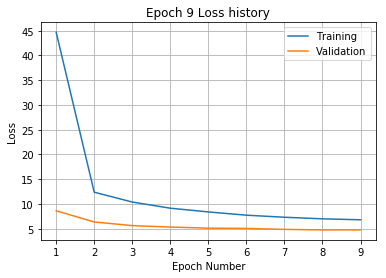

Training
Iteration 0: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 40: with minibatch training loss = 8.14 and relative error of 0.33
Iteration 60: with minibatch training loss = 7.37 and relative error of 0.32
Iteration 80: with minibatch training loss = 8.55 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.01 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 160: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 180: with minibatch training loss = 9.45 and relative error of 0.35
Iteration 200: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 240: with minibatch training loss = 7.42 and relative

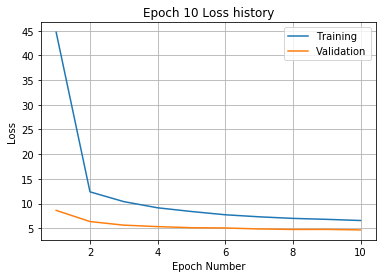

Training
Iteration 0: with minibatch training loss = 5.87 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.73 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 100: with minibatch training loss = 8.34 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.02 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.46 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.65 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 240: with minibatch training loss = 7.47 and relative

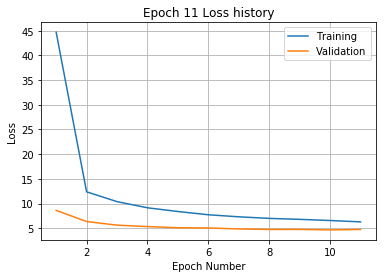

Training
Iteration 0: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.6 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.35 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.99 and relative error of 0.31
Iteration 120: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 140: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.02 and relative

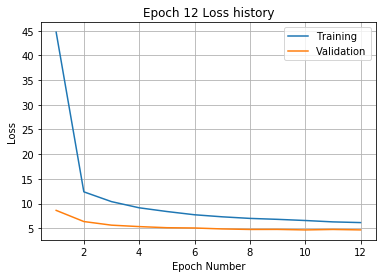

Training
Iteration 0: with minibatch training loss = 5.12 and relative error of 0.27
Iteration 20: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 40: with minibatch training loss = 4.47 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.7 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 120: with minibatch training loss = 3.94 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.01 and relative error of 0.31
Iteration 180: with minibatch training loss = 4.92 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.69 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.43 and relative

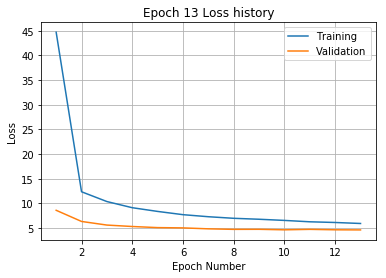

Training
Iteration 0: with minibatch training loss = 5.24 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.52 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 100: with minibatch training loss = 10 and relative error of 0.37
Iteration 120: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.44 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.43 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.01 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.37 and relative 

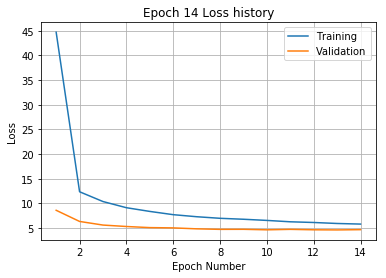

Training
Iteration 0: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 60: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.82 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 240: with minibatch training loss = 8.09 and relativ

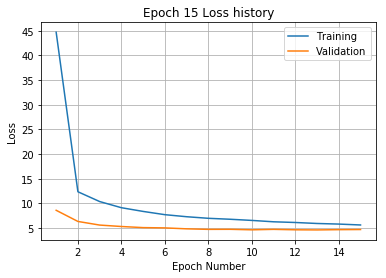

Training
Iteration 0: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.52 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.39 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.94 and relative error of 0.23
Iteration 240: with minibatch training loss = 4.96 and relative 

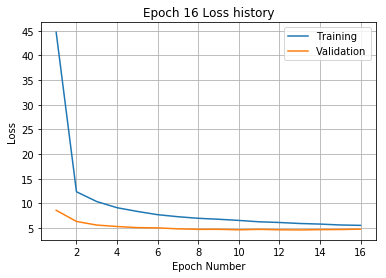

Training
Iteration 0: with minibatch training loss = 4.79 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 80: with minibatch training loss = 3.82 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 140: with minibatch training loss = 3.86 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 180: with minibatch training loss = 7.1 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 240: with minibatch training loss = 7.85 and relative

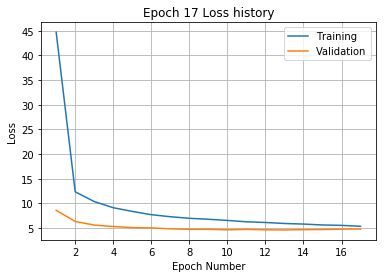

Training
Iteration 0: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.85 and relative error of 0.32
Iteration 60: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.83 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.56 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.28 and relative error of 0.23
Iteration 180: with minibatch training loss = 4.27 and relative error of 0.24
Iteration 200: with minibatch training loss = 4.94 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.55 and relati

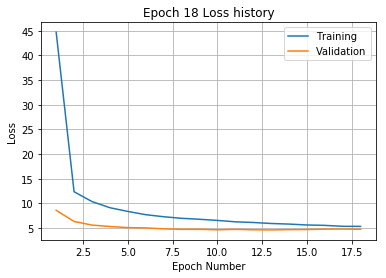

Validation error has stopped improving! Training on repetition 3 stopped!
Training
Iteration 0: with minibatch training loss = 243 and relative error of 1.8
Iteration 20: with minibatch training loss = 120 and relative error of 1.3
Iteration 40: with minibatch training loss = 72.4 and relative error of 1.1
Iteration 60: with minibatch training loss = 58 and relative error of 0.86
Iteration 80: with minibatch training loss = 43.5 and relative error of 0.73
Iteration 100: with minibatch training loss = 33.6 and relative error of 0.66
Iteration 120: with minibatch training loss = 24.6 and relative error of 0.58
Iteration 140: with minibatch training loss = 21.2 and relative error of 0.53
Iteration 160: with minibatch training loss = 22.8 and relative error of 0.55
Iteration 180: with minibatch training loss = 21.6 and relative error of 0.55
Iteration 200: with minibatch training loss = 15.9 and relative error of 0.46
Iteration 220: with minibatch training loss = 17.2 and relative error of

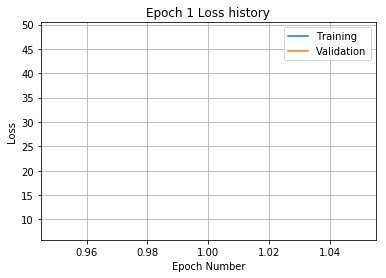

Training
Iteration 0: with minibatch training loss = 13.5 and relative error of 0.41
Iteration 20: with minibatch training loss = 17.4 and relative error of 0.48
Iteration 40: with minibatch training loss = 16 and relative error of 0.46
Iteration 60: with minibatch training loss = 13.8 and relative error of 0.44
Iteration 80: with minibatch training loss = 12.9 and relative error of 0.41
Iteration 100: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 120: with minibatch training loss = 15.9 and relative error of 0.46
Iteration 140: with minibatch training loss = 11.7 and relative error of 0.38
Iteration 160: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 180: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 200: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 220: with minibatch training loss = 11.5 and relative error of 0.4
Iteration 240: with minibatch training loss = 12.2 and relative 

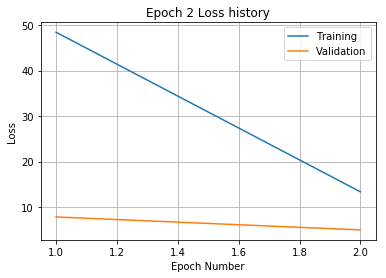

Training
Iteration 0: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 20: with minibatch training loss = 11 and relative error of 0.37
Iteration 40: with minibatch training loss = 8.96 and relative error of 0.35
Iteration 60: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 80: with minibatch training loss = 15 and relative error of 0.43
Iteration 100: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 120: with minibatch training loss = 9.9 and relative error of 0.37
Iteration 140: with minibatch training loss = 12.2 and relative error of 0.39
Iteration 160: with minibatch training loss = 9.71 and relative error of 0.36
Iteration 180: with minibatch training loss = 13 and relative error of 0.42
Iteration 200: with minibatch training loss = 10.2 and relative error of 0.38
Iteration 220: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 240: with minibatch training loss = 9.27 and relative error 

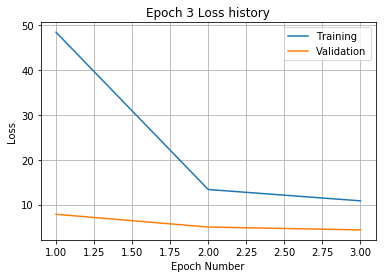

Training
Iteration 0: with minibatch training loss = 8.45 and relative error of 0.34
Iteration 20: with minibatch training loss = 9.54 and relative error of 0.35
Iteration 40: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 60: with minibatch training loss = 7.71 and relative error of 0.32
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 100: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 120: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.73 and relative error of 0.35
Iteration 160: with minibatch training loss = 9.15 and relative error of 0.36
Iteration 180: with minibatch training loss = 8.94 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.98 and relative error of 0.35
Iteration 240: with minibatch training loss = 12.4 and relati

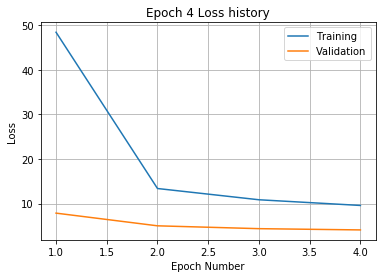

Training
Iteration 0: with minibatch training loss = 10 and relative error of 0.37
Iteration 20: with minibatch training loss = 8.32 and relative error of 0.34
Iteration 40: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 60: with minibatch training loss = 7.37 and relative error of 0.32
Iteration 80: with minibatch training loss = 9.68 and relative error of 0.35
Iteration 100: with minibatch training loss = 8.41 and relative error of 0.33
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 140: with minibatch training loss = 8.75 and relative error of 0.34
Iteration 160: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.67 and relative error of 0.34
Iteration 200: with minibatch training loss = 9.5 and relative error of 0.36
Iteration 220: with minibatch training loss = 9.68 and relative error of 0.36
Iteration 240: with minibatch training loss = 8.15 and relative 

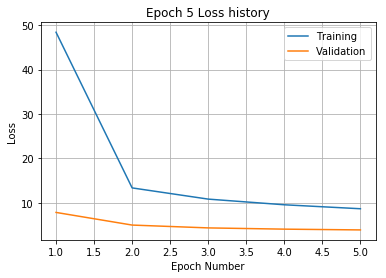

Training
Iteration 0: with minibatch training loss = 6.89 and relative error of 0.31
Iteration 20: with minibatch training loss = 9.77 and relative error of 0.36
Iteration 40: with minibatch training loss = 8.73 and relative error of 0.35
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 80: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 100: with minibatch training loss = 8.47 and relative error of 0.33
Iteration 120: with minibatch training loss = 9.53 and relative error of 0.35
Iteration 140: with minibatch training loss = 8.93 and relative error of 0.35
Iteration 160: with minibatch training loss = 7.92 and relative error of 0.33
Iteration 180: with minibatch training loss = 7.99 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.04 and relative error of 0.32
Iteration 220: with minibatch training loss = 8.04 and relative error of 0.32
Iteration 240: with minibatch training loss = 8.59 and relati

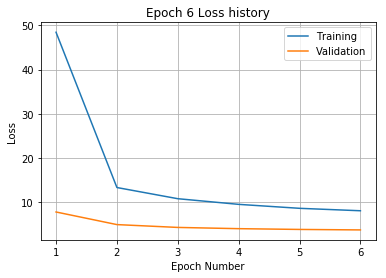

Training
Iteration 0: with minibatch training loss = 8.69 and relative error of 0.33
Iteration 20: with minibatch training loss = 8.45 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.13 and relative error of 0.35
Iteration 60: with minibatch training loss = 9.2 and relative error of 0.36
Iteration 80: with minibatch training loss = 8.1 and relative error of 0.32
Iteration 100: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.9 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.86 and relative error of 0.32
Iteration 160: with minibatch training loss = 8.09 and relative error of 0.34
Iteration 180: with minibatch training loss = 6.16 and relative error of 0.3
Iteration 200: with minibatch training loss = 7.2 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 240: with minibatch training loss = 8.75 and relative er

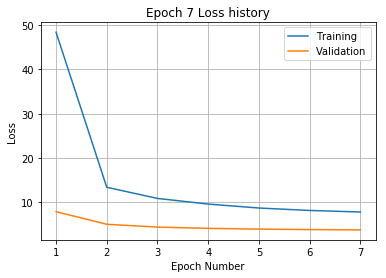

Training
Iteration 0: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.94 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.67 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.66 and relative error of 0.28
Iteration 80: with minibatch training loss = 10.3 and relative error of 0.38
Iteration 100: with minibatch training loss = 6.57 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.18 and relative error of 0.33
Iteration 140: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 180: with minibatch training loss = 8.14 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.5 and relative error of 0.28
Iteration 220: with minibatch training loss = 7.18 and relative error of 0.31
Iteration 240: with minibatch training loss = 6.01 and relative e

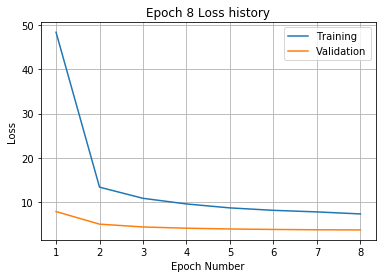

Training
Iteration 0: with minibatch training loss = 8.6 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.74 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 60: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 120: with minibatch training loss = 5 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.17 and relative error of 0.27
Iteration 160: with minibatch training loss = 8.44 and relative error of 0.35
Iteration 180: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.75 and relative error of 0.32
Iteration 220: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 240: with minibatch training loss = 7.82 and relative err

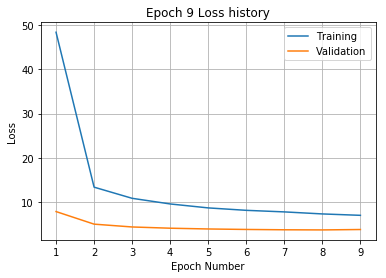

Training
Iteration 0: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.31 and relative error of 0.26
Iteration 40: with minibatch training loss = 9.09 and relative error of 0.34
Iteration 60: with minibatch training loss = 9.4 and relative error of 0.35
Iteration 80: with minibatch training loss = 6.98 and relative error of 0.29
Iteration 100: with minibatch training loss = 7.66 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.59 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.33 and relative error of 0.33
Iteration 160: with minibatch training loss = 7.21 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.65 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.42 and relative error of 0.27
Iteration 240: with minibatch training loss = 7.49 and relative

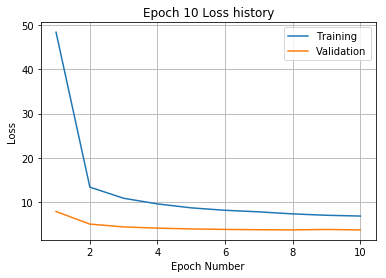

Training
Iteration 0: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 20: with minibatch training loss = 8.07 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.23 and relative error of 0.31
Iteration 200: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 220: with minibatch training loss = 8.59 and relative error of 0.32
Iteration 240: with minibatch training loss = 6.9 and relative e

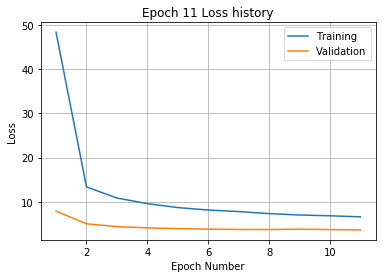

Training
Iteration 0: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 20: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 60: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.87 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.25 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.34 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 240: with minibatch training loss = 8.1 and relative e

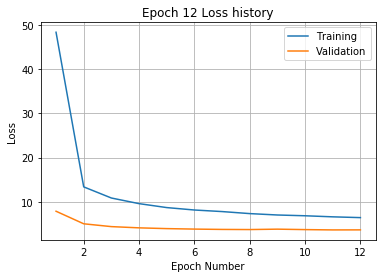

Training
Iteration 0: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.65 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.64 and relative error of 0.35
Iteration 80: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.42 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.68 and relative error of 0.33
Iteration 160: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.35 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.71 and relative error of 0.31
Iteration 240: with minibatch training loss = 5.99 and relative

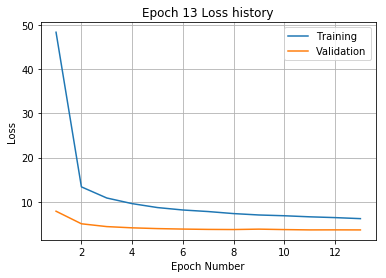

Training
Iteration 0: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 20: with minibatch training loss = 5.23 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.54 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.31 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.85 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.24 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.65 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.69 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.17 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 240: with minibatch training loss = 6.79 and relativ

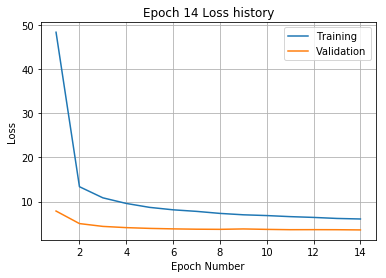

Training
Iteration 0: with minibatch training loss = 7.95 and relative error of 0.33
Iteration 20: with minibatch training loss = 4.42 and relative error of 0.23
Iteration 40: with minibatch training loss = 7.81 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.79 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.86 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.95 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.15 and relative error of 0.23
Iteration 220: with minibatch training loss = 7.87 and relative error of 0.33
Iteration 240: with minibatch training loss = 6.54 and relativ

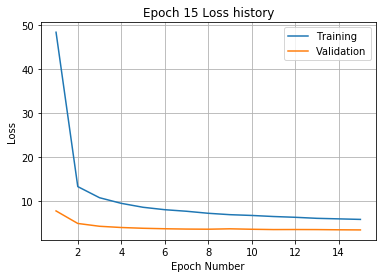

Training
Iteration 0: with minibatch training loss = 7.89 and relative error of 0.32
Iteration 20: with minibatch training loss = 4.76 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.22 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.69 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.24 and relative error of 0.31
Iteration 120: with minibatch training loss = 5.73 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.13 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 200: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.06 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.7 and relative er

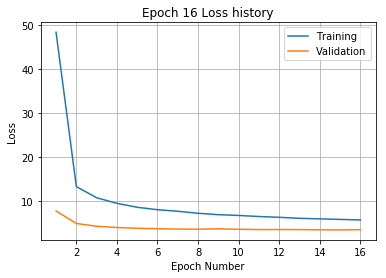

Training
Iteration 0: with minibatch training loss = 6.02 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.62 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.34 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.74 and relative error of 0.29
Iteration 160: with minibatch training loss = 8.7 and relative error of 0.33
Iteration 180: with minibatch training loss = 4.76 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.61 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 240: with minibatch training loss = 3.97 and relativ

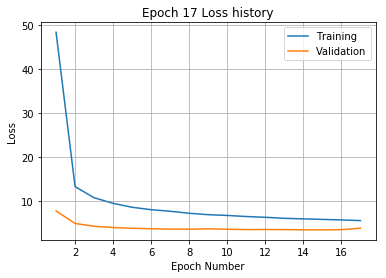

Training
Iteration 0: with minibatch training loss = 7.67 and relative error of 0.33
Iteration 20: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.52 and relative error of 0.26
Iteration 80: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 100: with minibatch training loss = 3.86 and relative error of 0.22
Iteration 120: with minibatch training loss = 4.51 and relative error of 0.25
Iteration 140: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.09 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.23 and relative

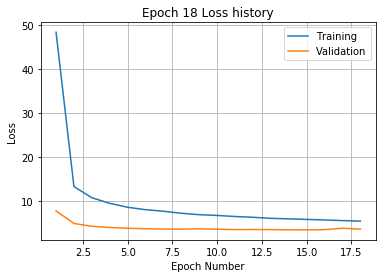

Training
Iteration 0: with minibatch training loss = 5.03 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.22 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.63 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.41 and relative error of 0.24
Iteration 180: with minibatch training loss = 7.48 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.6 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.24 and relative error of 0.22
Iteration 240: with minibatch training loss = 6.59 and relative

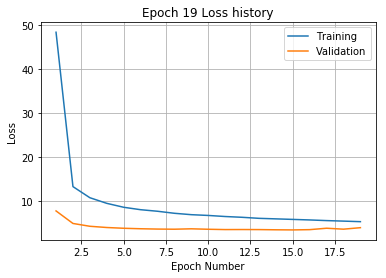

Training
Iteration 0: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.38 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.7 and relative error of 0.21
Iteration 100: with minibatch training loss = 4.28 and relative error of 0.23
Iteration 120: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 140: with minibatch training loss = 3.82 and relative error of 0.22
Iteration 160: with minibatch training loss = 3.34 and relative error of 0.21
Iteration 180: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 240: with minibatch training loss = 6.54 and relativ

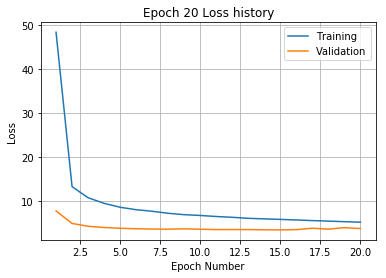

Validation error has stopped improving! Training on repetition 4 stopped!
Training
Iteration 0: with minibatch training loss = 213 and relative error of 1.6
Iteration 20: with minibatch training loss = 124 and relative error of 1.3
Iteration 40: with minibatch training loss = 70.5 and relative error of 1
Iteration 60: with minibatch training loss = 63.6 and relative error of 0.92
Iteration 80: with minibatch training loss = 43 and relative error of 0.74
Iteration 100: with minibatch training loss = 33.3 and relative error of 0.67
Iteration 120: with minibatch training loss = 25.9 and relative error of 0.59
Iteration 140: with minibatch training loss = 19.3 and relative error of 0.49
Iteration 160: with minibatch training loss = 16.3 and relative error of 0.46
Iteration 180: with minibatch training loss = 17.4 and relative error of 0.48
Iteration 200: with minibatch training loss = 16.8 and relative error of 0.46
Iteration 220: with minibatch training loss = 18.3 and relative error of 0

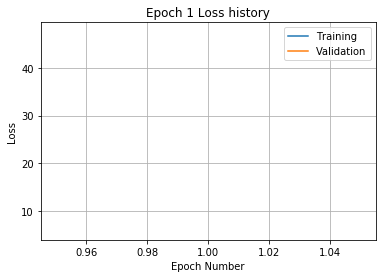

Training
Iteration 0: with minibatch training loss = 14.8 and relative error of 0.45
Iteration 20: with minibatch training loss = 15.4 and relative error of 0.44
Iteration 40: with minibatch training loss = 14.6 and relative error of 0.44
Iteration 60: with minibatch training loss = 14.8 and relative error of 0.44
Iteration 80: with minibatch training loss = 18.7 and relative error of 0.5
Iteration 100: with minibatch training loss = 13.3 and relative error of 0.44
Iteration 120: with minibatch training loss = 13.2 and relative error of 0.42
Iteration 140: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 160: with minibatch training loss = 15.3 and relative error of 0.45
Iteration 180: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 200: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 220: with minibatch training loss = 13.4 and relative error of 0.43
Iteration 240: with minibatch training loss = 11.7 and relativ

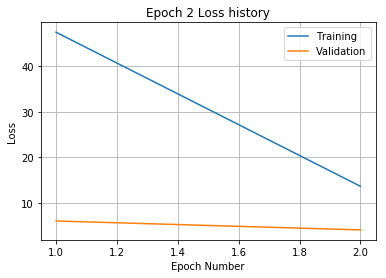

Training
Iteration 0: with minibatch training loss = 9.31 and relative error of 0.34
Iteration 20: with minibatch training loss = 13 and relative error of 0.41
Iteration 40: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 60: with minibatch training loss = 9.72 and relative error of 0.38
Iteration 80: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 100: with minibatch training loss = 9.82 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.24 and relative error of 0.33
Iteration 140: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 160: with minibatch training loss = 10.6 and relative error of 0.39
Iteration 180: with minibatch training loss = 11.8 and relative error of 0.38
Iteration 200: with minibatch training loss = 14.1 and relative error of 0.43
Iteration 220: with minibatch training loss = 12 and relative error of 0.4
Iteration 240: with minibatch training loss = 13.4 and relative erro

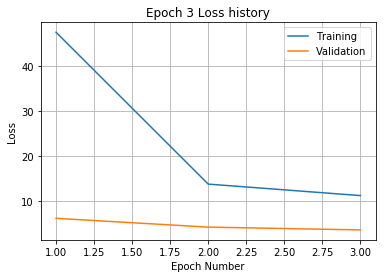

Training
Iteration 0: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 20: with minibatch training loss = 8.85 and relative error of 0.35
Iteration 40: with minibatch training loss = 8.94 and relative error of 0.35
Iteration 60: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 80: with minibatch training loss = 8.89 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 120: with minibatch training loss = 12.8 and relative error of 0.41
Iteration 140: with minibatch training loss = 12 and relative error of 0.39
Iteration 160: with minibatch training loss = 10.5 and relative error of 0.39
Iteration 180: with minibatch training loss = 11.1 and relative error of 0.38
Iteration 200: with minibatch training loss = 9.39 and relative error of 0.35
Iteration 220: with minibatch training loss = 8.35 and relative error of 0.33
Iteration 240: with minibatch training loss = 9.09 and relative

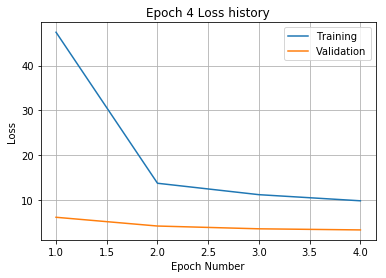

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 20: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.46 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.37 and relative error of 0.31
Iteration 100: with minibatch training loss = 9.73 and relative error of 0.35
Iteration 120: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 140: with minibatch training loss = 9.18 and relative error of 0.36
Iteration 160: with minibatch training loss = 8.32 and relative error of 0.34
Iteration 180: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 200: with minibatch training loss = 6.91 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 240: with minibatch training loss = 8.13 and relative

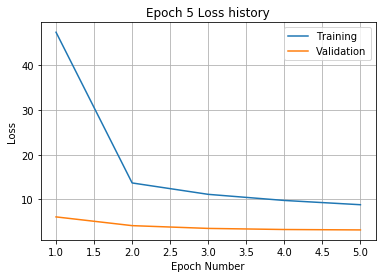

Training
Iteration 0: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 20: with minibatch training loss = 9.49 and relative error of 0.36
Iteration 40: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 60: with minibatch training loss = 7.63 and relative error of 0.32
Iteration 80: with minibatch training loss = 7.99 and relative error of 0.32
Iteration 100: with minibatch training loss = 8.49 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.4 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.21 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.91 and relative error of 0.31
Iteration 180: with minibatch training loss = 9.08 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.86 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.22 and relative error of 0.29
Iteration 240: with minibatch training loss = 7.65 and relativ

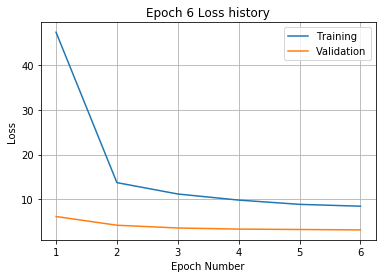

Training
Iteration 0: with minibatch training loss = 7.46 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.58 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.77 and relative error of 0.32
Iteration 120: with minibatch training loss = 9.03 and relative error of 0.34
Iteration 140: with minibatch training loss = 8.31 and relative error of 0.32
Iteration 160: with minibatch training loss = 9.73 and relative error of 0.36
Iteration 180: with minibatch training loss = 7.27 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.63 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.99 and relative error of 0.34
Iteration 240: with minibatch training loss = 7.7 and relative

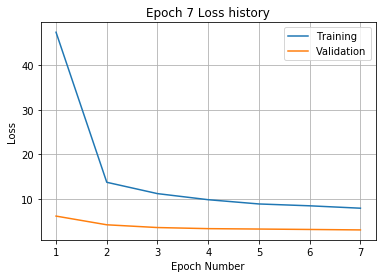

Training
Iteration 0: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.73 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.78 and relative error of 0.29
Iteration 60: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 80: with minibatch training loss = 11.5 and relative error of 0.38
Iteration 100: with minibatch training loss = 9.23 and relative error of 0.36
Iteration 120: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.58 and relative error of 0.26
Iteration 160: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.18 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.5 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.15 and relative error of 0.28
Iteration 240: with minibatch training loss = 8.62 and relative e

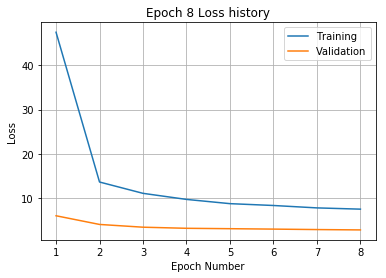

Training
Iteration 0: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.77 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.71 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.69 and relative error of 0.34
Iteration 160: with minibatch training loss = 7.22 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.64 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.98 and relative error of 0.31
Iteration 240: with minibatch training loss = 6.75 and relative e

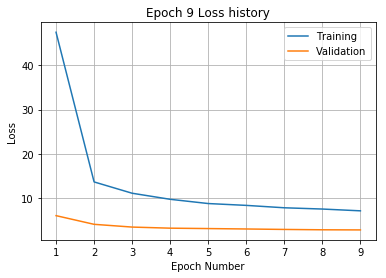

Training
Iteration 0: with minibatch training loss = 9.15 and relative error of 0.35
Iteration 20: with minibatch training loss = 7.31 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.42 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.56 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 120: with minibatch training loss = 8.13 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 160: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.47 and relative error of 0.31
Iteration 200: with minibatch training loss = 8.64 and relative error of 0.34
Iteration 220: with minibatch training loss = 6.15 and relative error of 0.29
Iteration 240: with minibatch training loss = 11.2 and relative

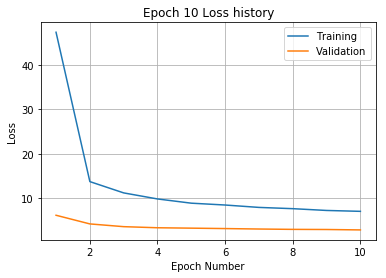

Training
Iteration 0: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.81 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 100: with minibatch training loss = 8.03 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.84 and relative error of 0.33
Iteration 140: with minibatch training loss = 4.75 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.46 and relative error of 0.32
Iteration 180: with minibatch training loss = 7.98 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.55 and relative error of 0.31
Iteration 220: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 240: with minibatch training loss = 7.2 and relativ

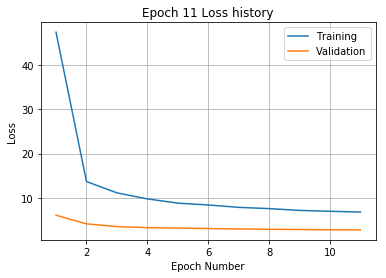

Training
Iteration 0: with minibatch training loss = 6.67 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.08 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.63 and relative error of 0.3
Iteration 60: with minibatch training loss = 9.41 and relative error of 0.36
Iteration 80: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 120: with minibatch training loss = 7.25 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.04 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.51 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 200: with minibatch training loss = 6.69 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.39 and relative e

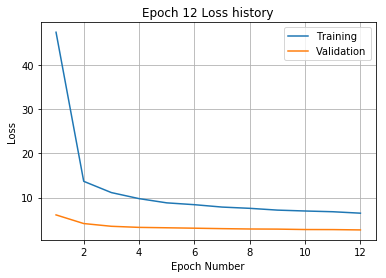

Training
Iteration 0: with minibatch training loss = 7.32 and relative error of 0.31
Iteration 20: with minibatch training loss = 8.63 and relative error of 0.34
Iteration 40: with minibatch training loss = 5.06 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.16 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.73 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 120: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.82 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.7 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.37 and relative error of 0.24
Iteration 220: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.2 and relative e

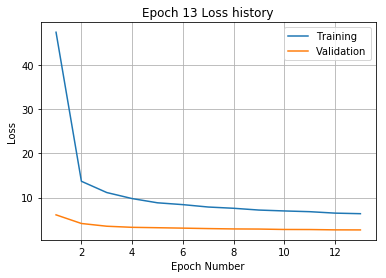

Training
Iteration 0: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 20: with minibatch training loss = 4.32 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.18 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.77 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.66 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.25 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.14 and relative error of 0.3
Iteration 240: with minibatch training loss = 5.7 and relative er

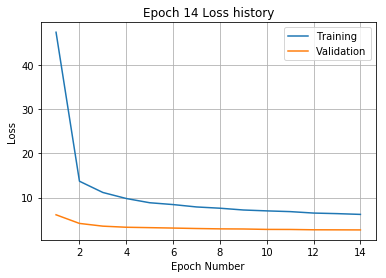

Training
Iteration 0: with minibatch training loss = 5.25 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.15 and relative error of 0.23
Iteration 40: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.98 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.23 and relative error of 0.33
Iteration 120: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 160: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 180: with minibatch training loss = 7.35 and relative error of 0.32
Iteration 200: with minibatch training loss = 5.28 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.19 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.85 and relativ

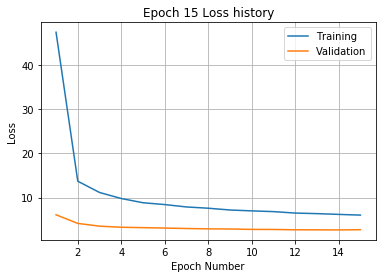

Training
Iteration 0: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 20: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.05 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.87 and relative error of 0.27
Iteration 80: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.71 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.35 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.27 and relative error of 0.23
Iteration 240: with minibatch training loss = 5.21 and relative

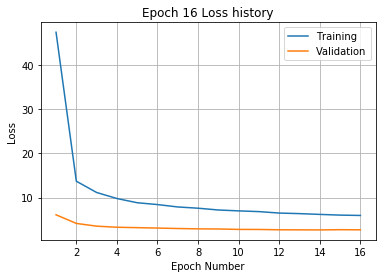

Training
Iteration 0: with minibatch training loss = 7.07 and relative error of 0.32
Iteration 20: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.32 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.04 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.15 and relative error of 0.25
Iteration 160: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 220: with minibatch training loss = 7.24 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.84 and relativ

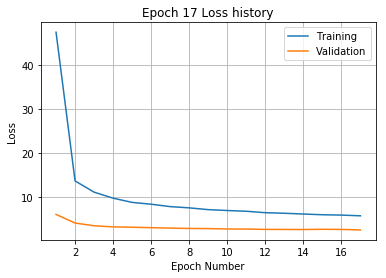

Training
Iteration 0: with minibatch training loss = 7.88 and relative error of 0.34
Iteration 20: with minibatch training loss = 8.53 and relative error of 0.33
Iteration 40: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.93 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.58 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 120: with minibatch training loss = 5 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 160: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 180: with minibatch training loss = 9.76 and relative error of 0.34
Iteration 200: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.23 and relative error of 0.23
Iteration 240: with minibatch training loss = 3.4 and relative e

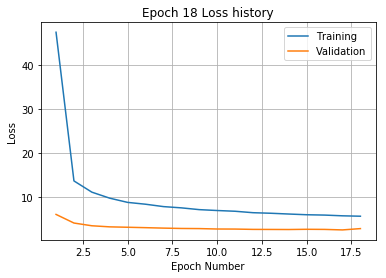

Training
Iteration 0: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.73 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.23 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.57 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.9 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.14 and relative error of 0.28
Iteration 140: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.73 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.99 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.59 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 240: with minibatch training loss = 6.8 and relative 

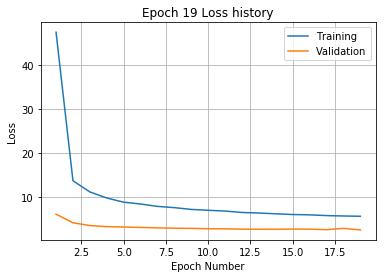

Training
Iteration 0: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.33 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.1 and relative error of 0.27
Iteration 100: with minibatch training loss = 3.75 and relative error of 0.23
Iteration 120: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.09 and relative error of 0.23
Iteration 200: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.11 and relative error of 0.28
Iteration 240: with minibatch training loss = 8.59 and relative

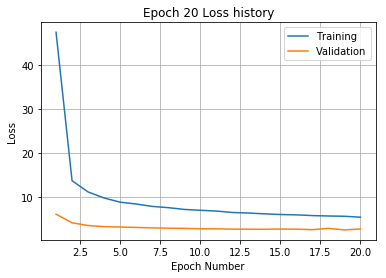

Training
Iteration 0: with minibatch training loss = 3.1 and relative error of 0.2
Iteration 20: with minibatch training loss = 3.6 and relative error of 0.21
Iteration 40: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 80: with minibatch training loss = 3.93 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.74 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.89 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 240: with minibatch training loss = 3.77 and relative err

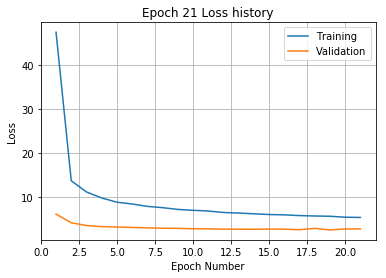

Training
Iteration 0: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 40: with minibatch training loss = 4.27 and relative error of 0.23
Iteration 60: with minibatch training loss = 3.3 and relative error of 0.21
Iteration 80: with minibatch training loss = 3.47 and relative error of 0.21
Iteration 100: with minibatch training loss = 6.44 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.56 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 160: with minibatch training loss = 3.74 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.95 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.51 and relativ

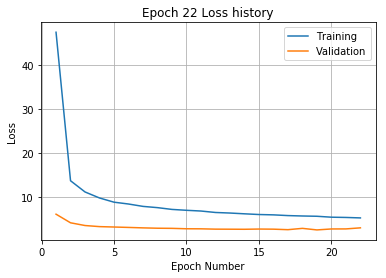

Training
Iteration 0: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.7 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.94 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 120: with minibatch training loss = 4.43 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.63 and relative error of 0.27
Iteration 160: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.79 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.2 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.52 and relative e

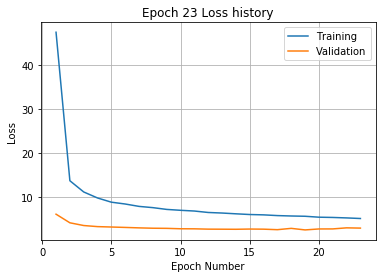

Training
Iteration 0: with minibatch training loss = 5.24 and relative error of 0.25
Iteration 20: with minibatch training loss = 3.56 and relative error of 0.22
Iteration 40: with minibatch training loss = 3.74 and relative error of 0.22
Iteration 60: with minibatch training loss = 5.66 and relative error of 0.28
Iteration 80: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 100: with minibatch training loss = 7.25 and relative error of 0.3
Iteration 120: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.11 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.34 and relative error of 0.25
Iteration 180: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 200: with minibatch training loss = 5.87 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 240: with minibatch training loss = 3.81 and relative 

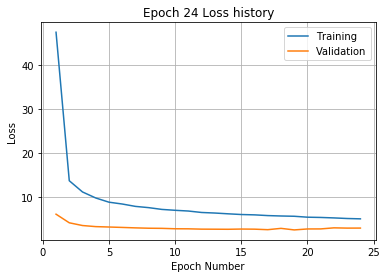

Validation error has stopped improving! Training on repetition 5 stopped!
Training
Iteration 0: with minibatch training loss = 214 and relative error of 1.7
Iteration 20: with minibatch training loss = 110 and relative error of 1.2
Iteration 40: with minibatch training loss = 54 and relative error of 0.89
Iteration 60: with minibatch training loss = 53.7 and relative error of 0.82
Iteration 80: with minibatch training loss = 37.1 and relative error of 0.69
Iteration 100: with minibatch training loss = 25.7 and relative error of 0.61
Iteration 120: with minibatch training loss = 25.5 and relative error of 0.57
Iteration 140: with minibatch training loss = 18.1 and relative error of 0.49
Iteration 160: with minibatch training loss = 19.8 and relative error of 0.52
Iteration 180: with minibatch training loss = 16.5 and relative error of 0.48
Iteration 200: with minibatch training loss = 15.5 and relative error of 0.46
Iteration 220: with minibatch training loss = 15.3 and relative error o

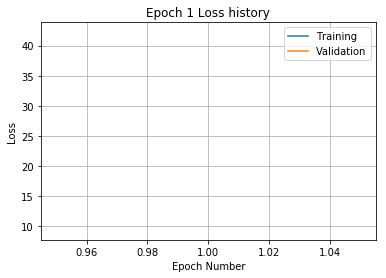

Training
Iteration 0: with minibatch training loss = 13.9 and relative error of 0.43
Iteration 20: with minibatch training loss = 13.6 and relative error of 0.41
Iteration 40: with minibatch training loss = 12.9 and relative error of 0.44
Iteration 60: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 80: with minibatch training loss = 16.6 and relative error of 0.46
Iteration 100: with minibatch training loss = 11.3 and relative error of 0.39
Iteration 120: with minibatch training loss = 11.7 and relative error of 0.41
Iteration 140: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 160: with minibatch training loss = 13.8 and relative error of 0.41
Iteration 180: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 200: with minibatch training loss = 11.9 and relative error of 0.39
Iteration 220: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 240: with minibatch training loss = 10.2 and relati

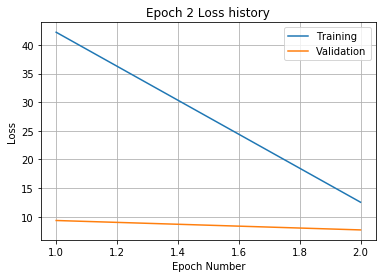

Training
Iteration 0: with minibatch training loss = 12.4 and relative error of 0.4
Iteration 20: with minibatch training loss = 14.9 and relative error of 0.44
Iteration 40: with minibatch training loss = 10.9 and relative error of 0.37
Iteration 60: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 80: with minibatch training loss = 8.42 and relative error of 0.33
Iteration 100: with minibatch training loss = 9.99 and relative error of 0.36
Iteration 120: with minibatch training loss = 7.65 and relative error of 0.31
Iteration 140: with minibatch training loss = 10.4 and relative error of 0.38
Iteration 160: with minibatch training loss = 8.26 and relative error of 0.33
Iteration 180: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 200: with minibatch training loss = 9.93 and relative error of 0.37
Iteration 220: with minibatch training loss = 7.97 and relative error of 0.32
Iteration 240: with minibatch training loss = 9.47 and relativ

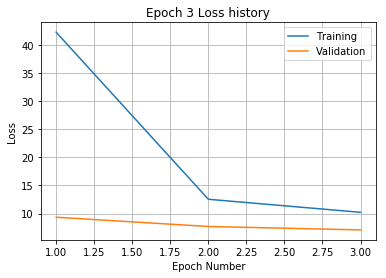

Training
Iteration 0: with minibatch training loss = 9.24 and relative error of 0.35
Iteration 20: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.93 and relative error of 0.35
Iteration 60: with minibatch training loss = 9.12 and relative error of 0.35
Iteration 80: with minibatch training loss = 10.1 and relative error of 0.36
Iteration 100: with minibatch training loss = 10.3 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.71 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.11 and relative error of 0.34
Iteration 160: with minibatch training loss = 9.85 and relative error of 0.36
Iteration 180: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 200: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 220: with minibatch training loss = 9.81 and relative error of 0.37
Iteration 240: with minibatch training loss = 9.59 and relati

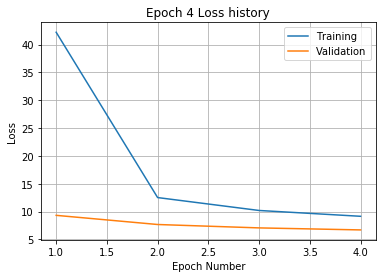

Training
Iteration 0: with minibatch training loss = 9.37 and relative error of 0.35
Iteration 20: with minibatch training loss = 6.89 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.69 and relative error of 0.35
Iteration 80: with minibatch training loss = 10.4 and relative error of 0.36
Iteration 100: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 120: with minibatch training loss = 11.8 and relative error of 0.41
Iteration 140: with minibatch training loss = 7.94 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.3 and relative error of 0.28
Iteration 180: with minibatch training loss = 9.29 and relative error of 0.35
Iteration 200: with minibatch training loss = 6.58 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.18 and relative error of 0.34
Iteration 240: with minibatch training loss = 7.79 and relative

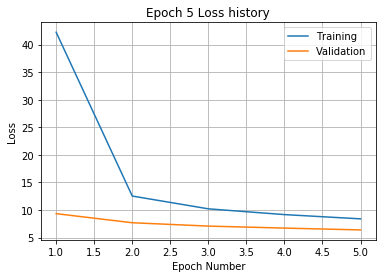

Training
Iteration 0: with minibatch training loss = 6.17 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.83 and relative error of 0.33
Iteration 40: with minibatch training loss = 6.43 and relative error of 0.28
Iteration 60: with minibatch training loss = 8.53 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.48 and relative error of 0.34
Iteration 100: with minibatch training loss = 9.62 and relative error of 0.36
Iteration 120: with minibatch training loss = 8.48 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.77 and relative error of 0.36
Iteration 160: with minibatch training loss = 7 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.56 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 240: with minibatch training loss = 8.34 and relative e

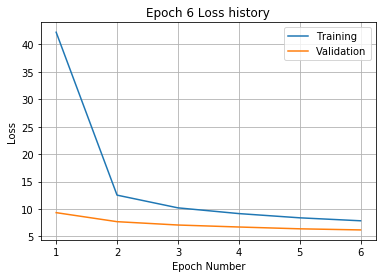

Training
Iteration 0: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 20: with minibatch training loss = 8.81 and relative error of 0.34
Iteration 40: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 60: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 80: with minibatch training loss = 8.2 and relative error of 0.33
Iteration 100: with minibatch training loss = 5.15 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.91 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.81 and relative error of 0.32
Iteration 180: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.81 and relative error of 0.33
Iteration 220: with minibatch training loss = 6.56 and relative error of 0.28
Iteration 240: with minibatch training loss = 7.51 and relative

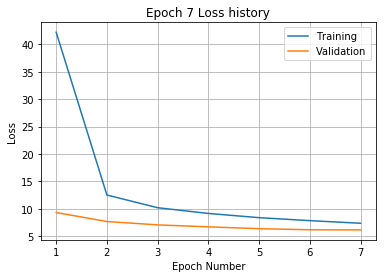

Training
Iteration 0: with minibatch training loss = 9.58 and relative error of 0.35
Iteration 20: with minibatch training loss = 8.67 and relative error of 0.33
Iteration 40: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 60: with minibatch training loss = 8.8 and relative error of 0.33
Iteration 80: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.97 and relative error of 0.31
Iteration 160: with minibatch training loss = 6 and relative error of 0.28
Iteration 180: with minibatch training loss = 9.24 and relative error of 0.34
Iteration 200: with minibatch training loss = 6.43 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.18 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.92 and relative e

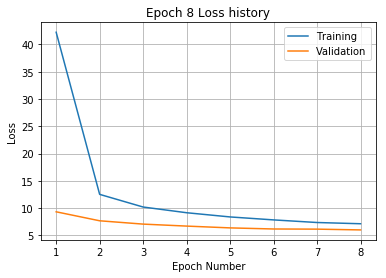

Training
Iteration 0: with minibatch training loss = 8.56 and relative error of 0.34
Iteration 20: with minibatch training loss = 7.51 and relative error of 0.32
Iteration 40: with minibatch training loss = 8.19 and relative error of 0.34
Iteration 60: with minibatch training loss = 5.67 and relative error of 0.28
Iteration 80: with minibatch training loss = 8.1 and relative error of 0.32
Iteration 100: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.82 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 160: with minibatch training loss = 8.81 and relative error of 0.35
Iteration 180: with minibatch training loss = 6.63 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.38 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.68 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.96 and relative

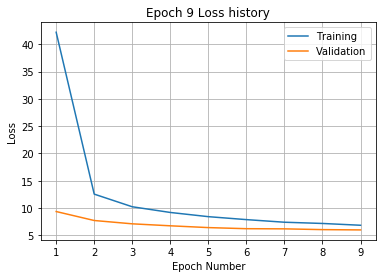

Training
Iteration 0: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.38 and relative error of 0.25
Iteration 40: with minibatch training loss = 8.34 and relative error of 0.34
Iteration 60: with minibatch training loss = 8.88 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.13 and relative error of 0.31
Iteration 100: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.76 and relative error of 0.31
Iteration 140: with minibatch training loss = 4.79 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.77 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 200: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 220: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 240: with minibatch training loss = 6 and relative er

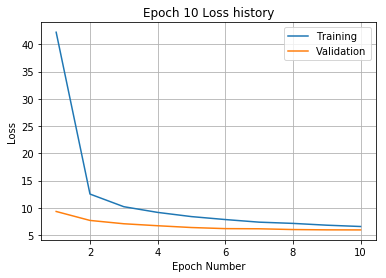

Training
Iteration 0: with minibatch training loss = 5.78 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.31 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.41 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 100: with minibatch training loss = 8.59 and relative error of 0.34
Iteration 120: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.73 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.28 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 220: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.76 and relative

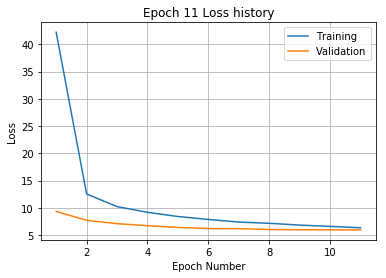

Training
Iteration 0: with minibatch training loss = 6.4 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 40: with minibatch training loss = 8.29 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.11 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.32 and relative error of 0.23
Iteration 140: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 180: with minibatch training loss = 5.28 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.03 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 240: with minibatch training loss = 6.33 and relativ

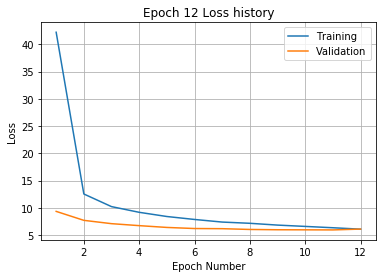

Training
Iteration 0: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.11 and relative error of 0.24
Iteration 140: with minibatch training loss = 6.75 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.85 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.76 and relative e

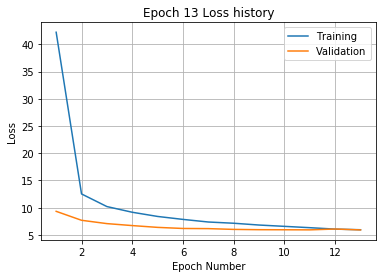

Training
Iteration 0: with minibatch training loss = 4.64 and relative error of 0.25
Iteration 20: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.56 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.87 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.25 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.42 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.37 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.66 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.5 and relative

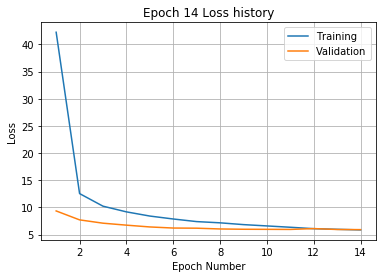

Training
Iteration 0: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 20: with minibatch training loss = 4.84 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.41 and relative error of 0.31
Iteration 60: with minibatch training loss = 5.75 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.29 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.65 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.82 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.37 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.87 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 200: with minibatch training loss = 4.98 and relative error of 0.27
Iteration 220: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 240: with minibatch training loss = 5.39 and relativ

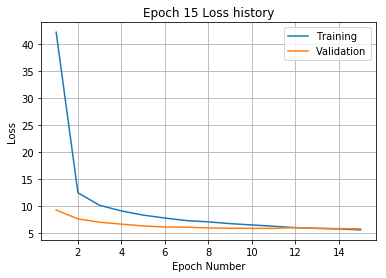

Training
Iteration 0: with minibatch training loss = 6 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.98 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.42 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.9 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.23 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 180: with minibatch training loss = 6.07 and relative error of 0.29
Iteration 200: with minibatch training loss = 6 and relative error of 0.28
Iteration 220: with minibatch training loss = 6.66 and relative error of 0.28
Iteration 240: with minibatch training loss = 6.34 and relative error

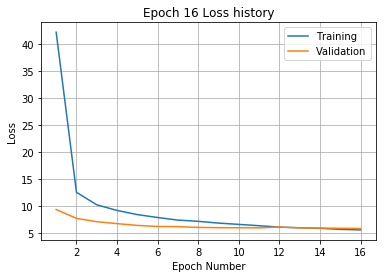

Training
Iteration 0: with minibatch training loss = 5.14 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.43 and relative error of 0.28
Iteration 40: with minibatch training loss = 7.07 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.64 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.24 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.46 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.14 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.26 and relative error of 0.26
Iteration 180: with minibatch training loss = 4.02 and relative error of 0.24
Iteration 200: with minibatch training loss = 7.16 and relative error of 0.32
Iteration 220: with minibatch training loss = 3.81 and relative error of 0.22
Iteration 240: with minibatch training loss = 4.14 and relativ

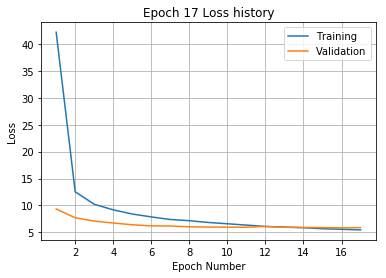

Training
Iteration 0: with minibatch training loss = 4.91 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.34 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 80: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 100: with minibatch training loss = 3.61 and relative error of 0.21
Iteration 120: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.05 and relative error of 0.25
Iteration 160: with minibatch training loss = 4.91 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.57 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 220: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.95 and relativ

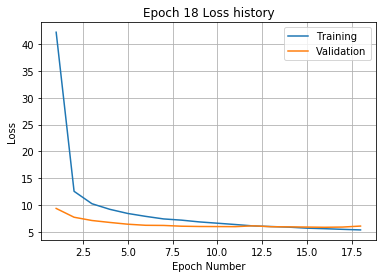

Training
Iteration 0: with minibatch training loss = 4.09 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.62 and relative error of 0.21
Iteration 40: with minibatch training loss = 3.01 and relative error of 0.19
Iteration 60: with minibatch training loss = 3.54 and relative error of 0.22
Iteration 80: with minibatch training loss = 5.1 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.53 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.63 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.02 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.31 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.52 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.55 and relative

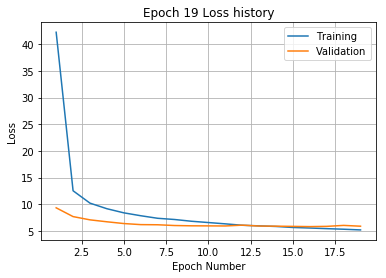

Training
Iteration 0: with minibatch training loss = 5.82 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 40: with minibatch training loss = 5.88 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.66 and relative error of 0.24
Iteration 100: with minibatch training loss = 4.71 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.01 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.53 and relative error of 0.28
Iteration 160: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.54 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 220: with minibatch training loss = 5.2 and relative error of 0.26
Iteration 240: with minibatch training loss = 6.29 and relative

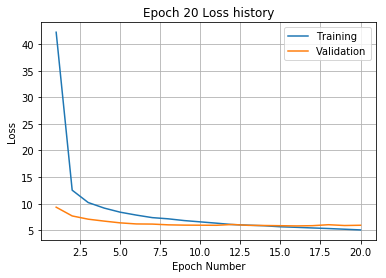

Training
Iteration 0: with minibatch training loss = 4.91 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.64 and relative error of 0.24
Iteration 40: with minibatch training loss = 3.19 and relative error of 0.21
Iteration 60: with minibatch training loss = 4.29 and relative error of 0.24
Iteration 80: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.69 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.89 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.23 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.23 and relati

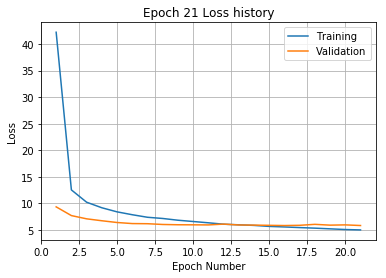

Validation error has stopped improving! Training on repetition 6 stopped!
Training
Iteration 0: with minibatch training loss = 257 and relative error of 1.8
Iteration 20: with minibatch training loss = 123 and relative error of 1.3
Iteration 40: with minibatch training loss = 78.9 and relative error of 1.1
Iteration 60: with minibatch training loss = 53.9 and relative error of 0.83
Iteration 80: with minibatch training loss = 42.4 and relative error of 0.75
Iteration 100: with minibatch training loss = 34.1 and relative error of 0.67
Iteration 120: with minibatch training loss = 28.4 and relative error of 0.61
Iteration 140: with minibatch training loss = 23 and relative error of 0.54
Iteration 160: with minibatch training loss = 20.9 and relative error of 0.51
Iteration 180: with minibatch training loss = 17.2 and relative error of 0.47
Iteration 200: with minibatch training loss = 17.3 and relative error of 0.47
Iteration 220: with minibatch training loss = 17.3 and relative error of

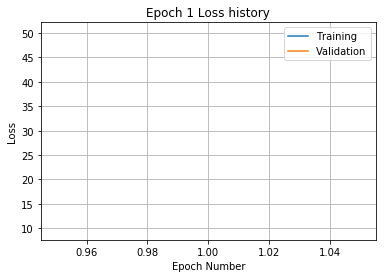

Training
Iteration 0: with minibatch training loss = 16.5 and relative error of 0.47
Iteration 20: with minibatch training loss = 14.9 and relative error of 0.43
Iteration 40: with minibatch training loss = 13.6 and relative error of 0.41
Iteration 60: with minibatch training loss = 18.1 and relative error of 0.49
Iteration 80: with minibatch training loss = 14 and relative error of 0.43
Iteration 100: with minibatch training loss = 13 and relative error of 0.42
Iteration 120: with minibatch training loss = 10.7 and relative error of 0.36
Iteration 140: with minibatch training loss = 11.9 and relative error of 0.4
Iteration 160: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 180: with minibatch training loss = 11.8 and relative error of 0.39
Iteration 200: with minibatch training loss = 13.2 and relative error of 0.42
Iteration 220: with minibatch training loss = 12.9 and relative error of 0.4
Iteration 240: with minibatch training loss = 14.1 and relative err

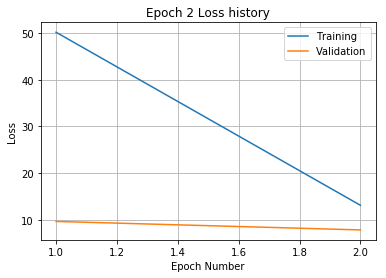

Training
Iteration 0: with minibatch training loss = 12.9 and relative error of 0.41
Iteration 20: with minibatch training loss = 12 and relative error of 0.41
Iteration 40: with minibatch training loss = 8.91 and relative error of 0.37
Iteration 60: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 80: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 100: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 120: with minibatch training loss = 10.2 and relative error of 0.38
Iteration 140: with minibatch training loss = 9.64 and relative error of 0.36
Iteration 160: with minibatch training loss = 9.24 and relative error of 0.34
Iteration 180: with minibatch training loss = 8.82 and relative error of 0.35
Iteration 200: with minibatch training loss = 9.78 and relative error of 0.36
Iteration 220: with minibatch training loss = 9.25 and relative error of 0.34
Iteration 240: with minibatch training loss = 9.89 and relative

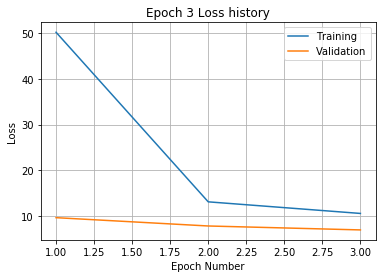

Training
Iteration 0: with minibatch training loss = 10.9 and relative error of 0.38
Iteration 20: with minibatch training loss = 8.84 and relative error of 0.35
Iteration 40: with minibatch training loss = 9.79 and relative error of 0.37
Iteration 60: with minibatch training loss = 10.8 and relative error of 0.38
Iteration 80: with minibatch training loss = 11.4 and relative error of 0.38
Iteration 100: with minibatch training loss = 7.58 and relative error of 0.32
Iteration 120: with minibatch training loss = 8.43 and relative error of 0.33
Iteration 140: with minibatch training loss = 9.17 and relative error of 0.36
Iteration 160: with minibatch training loss = 9.48 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.61 and relative error of 0.37
Iteration 200: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 220: with minibatch training loss = 8.53 and relative error of 0.35
Iteration 240: with minibatch training loss = 8.53 and relati

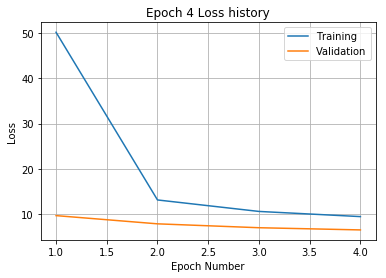

Training
Iteration 0: with minibatch training loss = 9.73 and relative error of 0.36
Iteration 20: with minibatch training loss = 9.29 and relative error of 0.36
Iteration 40: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 60: with minibatch training loss = 8.28 and relative error of 0.33
Iteration 80: with minibatch training loss = 9.63 and relative error of 0.36
Iteration 100: with minibatch training loss = 11.7 and relative error of 0.39
Iteration 120: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.92 and relative error of 0.34
Iteration 160: with minibatch training loss = 6.19 and relative error of 0.28
Iteration 180: with minibatch training loss = 9.35 and relative error of 0.34
Iteration 200: with minibatch training loss = 7.95 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.03 and relative error of 0.35
Iteration 240: with minibatch training loss = 7.72 and relati

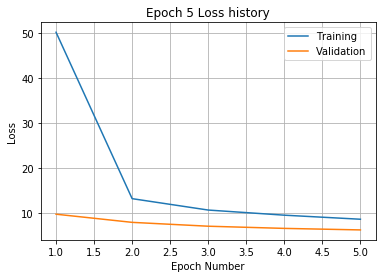

Training
Iteration 0: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.6 and relative error of 0.31
Iteration 40: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.98 and relative error of 0.33
Iteration 80: with minibatch training loss = 8.96 and relative error of 0.35
Iteration 100: with minibatch training loss = 10.5 and relative error of 0.38
Iteration 120: with minibatch training loss = 8.35 and relative error of 0.33
Iteration 140: with minibatch training loss = 10.6 and relative error of 0.38
Iteration 160: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.38 and relative error of 0.32
Iteration 200: with minibatch training loss = 8.38 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.99 and relative error of 0.37
Iteration 240: with minibatch training loss = 5.93 and relative

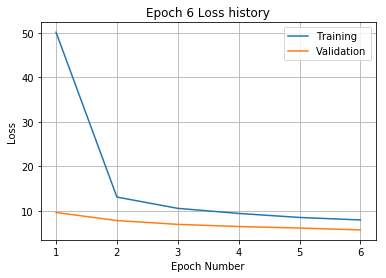

Training
Iteration 0: with minibatch training loss = 7.4 and relative error of 0.31
Iteration 20: with minibatch training loss = 7.36 and relative error of 0.31
Iteration 40: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 60: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 100: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.46 and relative error of 0.33
Iteration 140: with minibatch training loss = 5.81 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.7 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.52 and relative error of 0.32
Iteration 200: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 220: with minibatch training loss = 7.71 and relative error of 0.33
Iteration 240: with minibatch training loss = 6.07 and relative e

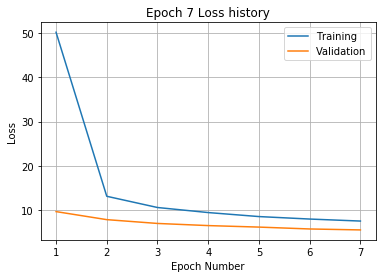

Training
Iteration 0: with minibatch training loss = 7.03 and relative error of 0.31
Iteration 20: with minibatch training loss = 9.45 and relative error of 0.34
Iteration 40: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 60: with minibatch training loss = 9.45 and relative error of 0.35
Iteration 80: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.4 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.94 and relative error of 0.31
Iteration 140: with minibatch training loss = 7.06 and relative error of 0.29
Iteration 160: with minibatch training loss = 6.82 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.84 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.76 and relative error of 0.27
Iteration 220: with minibatch training loss = 8.98 and relative error of 0.36
Iteration 240: with minibatch training loss = 8 and relative error

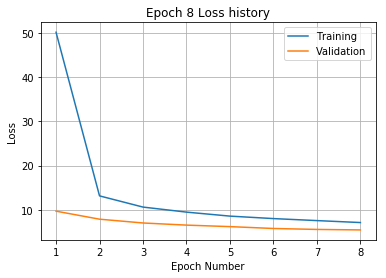

Training
Iteration 0: with minibatch training loss = 9.9 and relative error of 0.36
Iteration 20: with minibatch training loss = 5.43 and relative error of 0.26
Iteration 40: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 60: with minibatch training loss = 11 and relative error of 0.37
Iteration 80: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 120: with minibatch training loss = 8.34 and relative error of 0.32
Iteration 140: with minibatch training loss = 9.59 and relative error of 0.36
Iteration 160: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.57 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 240: with minibatch training loss = 8.72 and relative er

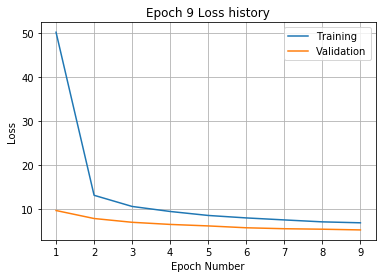

Training
Iteration 0: with minibatch training loss = 7.9 and relative error of 0.33
Iteration 20: with minibatch training loss = 9.04 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.26 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.32 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.13 and relative error of 0.29
Iteration 120: with minibatch training loss = 8.29 and relative error of 0.33
Iteration 140: with minibatch training loss = 7.25 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.8 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.39 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.46 and relative error of 0.31
Iteration 240: with minibatch training loss = 9.07 and relative er

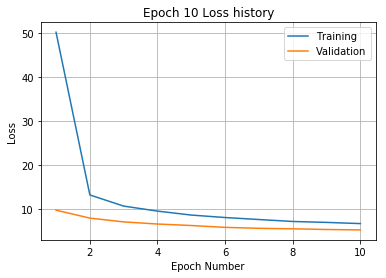

Training
Iteration 0: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 40: with minibatch training loss = 8.17 and relative error of 0.33
Iteration 60: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.82 and relative error of 0.27
Iteration 100: with minibatch training loss = 6.63 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.5 and relative error of 0.28
Iteration 140: with minibatch training loss = 4.7 and relative error of 0.24
Iteration 160: with minibatch training loss = 6.54 and relative error of 0.29
Iteration 180: with minibatch training loss = 6.1 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.14 and relative error of 0.31
Iteration 220: with minibatch training loss = 9.29 and relative error of 0.35
Iteration 240: with minibatch training loss = 4.51 and relative e

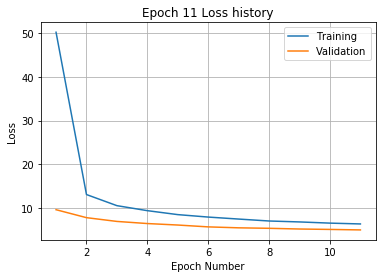

Training
Iteration 0: with minibatch training loss = 5.45 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.99 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.6 and relative error of 0.29
Iteration 60: with minibatch training loss = 7.79 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.48 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.91 and relative error of 0.26
Iteration 120: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 140: with minibatch training loss = 6.14 and relative error of 0.29
Iteration 160: with minibatch training loss = 8.73 and relative error of 0.33
Iteration 180: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 240: with minibatch training loss = 6.89 and relative

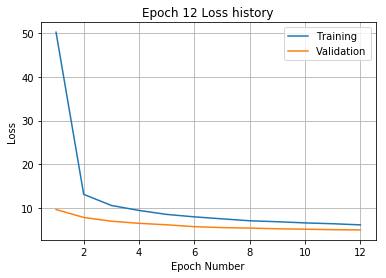

Training
Iteration 0: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.76 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 80: with minibatch training loss = 5.9 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.48 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.49 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 220: with minibatch training loss = 7.6 and relative error of 0.31
Iteration 240: with minibatch training loss = 5.64 and relative e

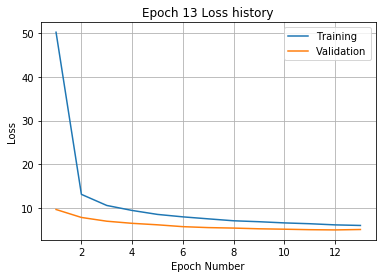

Training
Iteration 0: with minibatch training loss = 4.64 and relative error of 0.24
Iteration 20: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 40: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 100: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.26 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 160: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 180: with minibatch training loss = 5.51 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.28 and relative error of 0.28
Iteration 220: with minibatch training loss = 8.75 and relative error of 0.33
Iteration 240: with minibatch training loss = 5.93 and relative e

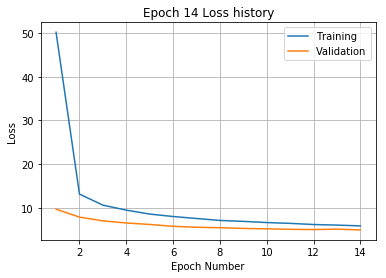

Training
Iteration 0: with minibatch training loss = 4.8 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 40: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.9 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.81 and relative error of 0.26
Iteration 120: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 140: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.12 and relative error of 0.28
Iteration 200: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.48 and relative error of 0.27
Iteration 240: with minibatch training loss = 8.5 and relative er

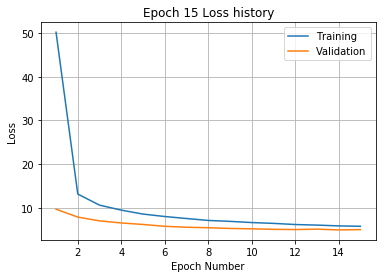

Training
Iteration 0: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.88 and relative error of 0.32
Iteration 40: with minibatch training loss = 4.47 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 80: with minibatch training loss = 5.47 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 120: with minibatch training loss = 7.31 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.12 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 180: with minibatch training loss = 5.14 and relative error of 0.25
Iteration 200: with minibatch training loss = 5.76 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.3 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.59 and relative 

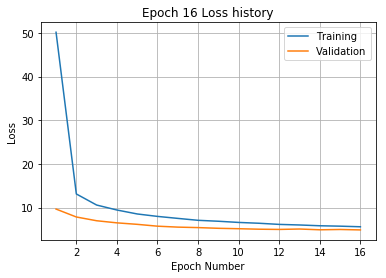

Training
Iteration 0: with minibatch training loss = 4.46 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.08 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.86 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.61 and relative error of 0.28
Iteration 120: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 140: with minibatch training loss = 6.31 and relative error of 0.29
Iteration 160: with minibatch training loss = 5.01 and relative error of 0.26
Iteration 180: with minibatch training loss = 6.33 and relative error of 0.29
Iteration 200: with minibatch training loss = 4.38 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.41 and relativ

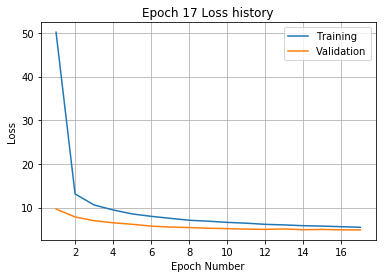

Training
Iteration 0: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.55 and relative error of 0.24
Iteration 40: with minibatch training loss = 6.53 and relative error of 0.28
Iteration 60: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 80: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.94 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.97 and relative error of 0.25
Iteration 140: with minibatch training loss = 5.67 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.54 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.65 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.73 and relative

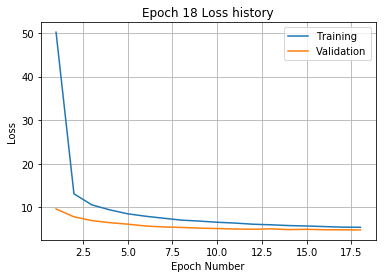

Training
Iteration 0: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 40: with minibatch training loss = 4.82 and relative error of 0.26
Iteration 60: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.18 and relative error of 0.23
Iteration 100: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 120: with minibatch training loss = 4.66 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.27 and relative error of 0.29
Iteration 180: with minibatch training loss = 3.52 and relative error of 0.21
Iteration 200: with minibatch training loss = 6.53 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 240: with minibatch training loss = 5.72 and relative 

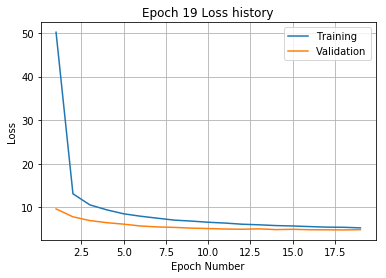

Training
Iteration 0: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.63 and relative error of 0.29
Iteration 40: with minibatch training loss = 3.56 and relative error of 0.21
Iteration 60: with minibatch training loss = 5.16 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 100: with minibatch training loss = 4.57 and relative error of 0.25
Iteration 120: with minibatch training loss = 3.89 and relative error of 0.23
Iteration 140: with minibatch training loss = 5.09 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.97 and relative error of 0.28
Iteration 180: with minibatch training loss = 3.37 and relative error of 0.21
Iteration 200: with minibatch training loss = 5.72 and relative error of 0.26
Iteration 220: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 240: with minibatch training loss = 4.75 and relati

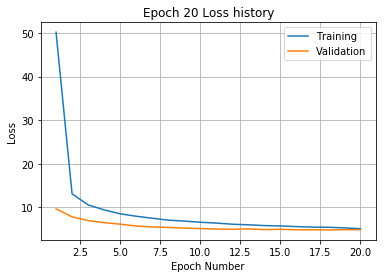

Training
Iteration 0: with minibatch training loss = 4.5 and relative error of 0.25
Iteration 20: with minibatch training loss = 3.11 and relative error of 0.21
Iteration 40: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 80: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 120: with minibatch training loss = 3.55 and relative error of 0.21
Iteration 140: with minibatch training loss = 5.62 and relative error of 0.27
Iteration 160: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.96 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.41 and relative error of 0.27
Iteration 220: with minibatch training loss = 3.72 and relative error of 0.22
Iteration 240: with minibatch training loss = 6.31 and relative

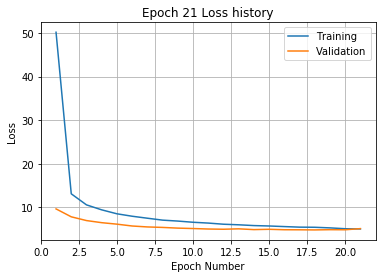

Training
Iteration 0: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 20: with minibatch training loss = 4.14 and relative error of 0.23
Iteration 40: with minibatch training loss = 3.84 and relative error of 0.22
Iteration 60: with minibatch training loss = 3.97 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 100: with minibatch training loss = 6.01 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.91 and relative error of 0.25
Iteration 140: with minibatch training loss = 3.88 and relative error of 0.22
Iteration 160: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.13 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.68 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.96 and relative error of 0.27
Iteration 240: with minibatch training loss = 3.33 and relativ

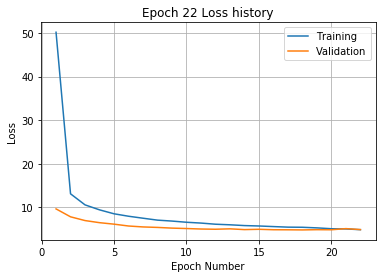

Training
Iteration 0: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 20: with minibatch training loss = 4 and relative error of 0.23
Iteration 40: with minibatch training loss = 4.96 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.37 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.04 and relative error of 0.23
Iteration 100: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.23 and relative error of 0.2
Iteration 160: with minibatch training loss = 3.79 and relative error of 0.22
Iteration 180: with minibatch training loss = 4.21 and relative error of 0.23
Iteration 200: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 220: with minibatch training loss = 3.63 and relative error of 0.21
Iteration 240: with minibatch training loss = 4.9 and relative er

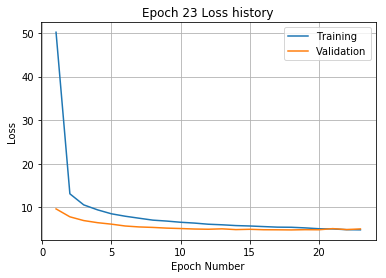

Validation error has stopped improving! Training on repetition 7 stopped!
Training
Iteration 0: with minibatch training loss = 251 and relative error of 1.8
Iteration 20: with minibatch training loss = 129 and relative error of 1.3
Iteration 40: with minibatch training loss = 97.8 and relative error of 1.1
Iteration 60: with minibatch training loss = 67.3 and relative error of 0.94
Iteration 80: with minibatch training loss = 49.1 and relative error of 0.8
Iteration 100: with minibatch training loss = 34.4 and relative error of 0.68
Iteration 120: with minibatch training loss = 26.2 and relative error of 0.58
Iteration 140: with minibatch training loss = 24 and relative error of 0.56
Iteration 160: with minibatch training loss = 17.1 and relative error of 0.46
Iteration 180: with minibatch training loss = 15 and relative error of 0.45
Iteration 200: with minibatch training loss = 20 and relative error of 0.51
Iteration 220: with minibatch training loss = 12.6 and relative error of 0.4


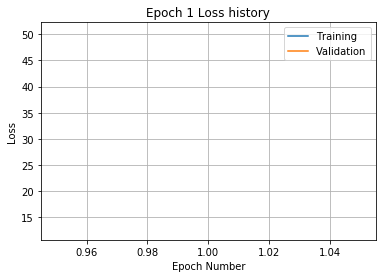

Training
Iteration 0: with minibatch training loss = 13.6 and relative error of 0.42
Iteration 20: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 40: with minibatch training loss = 13.7 and relative error of 0.43
Iteration 60: with minibatch training loss = 13.8 and relative error of 0.42
Iteration 80: with minibatch training loss = 14.8 and relative error of 0.43
Iteration 100: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 120: with minibatch training loss = 13.2 and relative error of 0.43
Iteration 140: with minibatch training loss = 13.1 and relative error of 0.42
Iteration 160: with minibatch training loss = 12.7 and relative error of 0.43
Iteration 180: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 200: with minibatch training loss = 14.6 and relative error of 0.45
Iteration 220: with minibatch training loss = 12.2 and relative error of 0.4
Iteration 240: with minibatch training loss = 10 and relative 

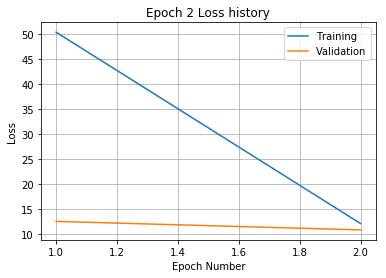

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 20: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 40: with minibatch training loss = 15.1 and relative error of 0.45
Iteration 60: with minibatch training loss = 9.35 and relative error of 0.36
Iteration 80: with minibatch training loss = 10.8 and relative error of 0.39
Iteration 100: with minibatch training loss = 8.34 and relative error of 0.33
Iteration 120: with minibatch training loss = 7.78 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.57 and relative error of 0.33
Iteration 160: with minibatch training loss = 8.46 and relative error of 0.34
Iteration 180: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 200: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 220: with minibatch training loss = 10.6 and relative error of 0.37
Iteration 240: with minibatch training loss = 7.86 and relati

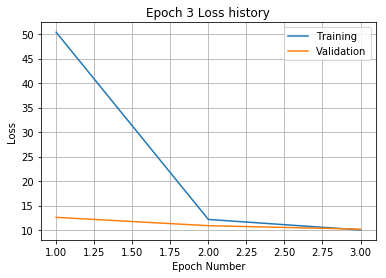

Training
Iteration 0: with minibatch training loss = 8.5 and relative error of 0.33
Iteration 20: with minibatch training loss = 10.6 and relative error of 0.39
Iteration 40: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 60: with minibatch training loss = 8.98 and relative error of 0.34
Iteration 80: with minibatch training loss = 9.28 and relative error of 0.36
Iteration 100: with minibatch training loss = 8.11 and relative error of 0.34
Iteration 120: with minibatch training loss = 6.25 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 180: with minibatch training loss = 10.6 and relative error of 0.39
Iteration 200: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 220: with minibatch training loss = 7.76 and relative error of 0.32
Iteration 240: with minibatch training loss = 6.74 and relative 

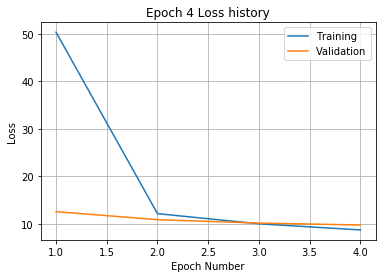

Training
Iteration 0: with minibatch training loss = 8.68 and relative error of 0.34
Iteration 20: with minibatch training loss = 6.93 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.56 and relative error of 0.33
Iteration 60: with minibatch training loss = 6.77 and relative error of 0.29
Iteration 80: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 100: with minibatch training loss = 7.97 and relative error of 0.31
Iteration 120: with minibatch training loss = 7.33 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.93 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.29 and relative error of 0.3
Iteration 180: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.92 and relative error of 0.29
Iteration 220: with minibatch training loss = 9.24 and relative error of 0.34
Iteration 240: with minibatch training loss = 5.91 and relative e

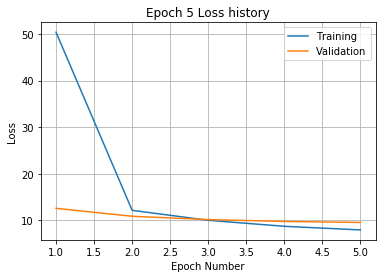

Training
Iteration 0: with minibatch training loss = 5.94 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.86 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.96 and relative error of 0.28
Iteration 60: with minibatch training loss = 9.52 and relative error of 0.35
Iteration 80: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 100: with minibatch training loss = 7.83 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.35 and relative error of 0.3
Iteration 180: with minibatch training loss = 8.24 and relative error of 0.32
Iteration 200: with minibatch training loss = 9.43 and relative error of 0.36
Iteration 220: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 240: with minibatch training loss = 6.36 and relative e

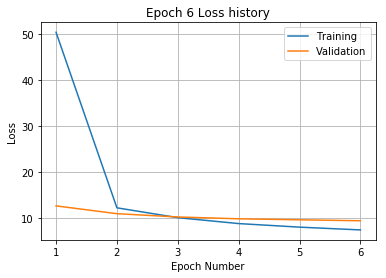

Training
Iteration 0: with minibatch training loss = 7.73 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.18 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.93 and relative error of 0.31
Iteration 60: with minibatch training loss = 8.18 and relative error of 0.32
Iteration 80: with minibatch training loss = 6.87 and relative error of 0.31
Iteration 100: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.72 and relative error of 0.3
Iteration 140: with minibatch training loss = 8.17 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.11 and relative error of 0.31
Iteration 180: with minibatch training loss = 11.2 and relative error of 0.38
Iteration 200: with minibatch training loss = 8.06 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.06 and relative error of 0.32
Iteration 240: with minibatch training loss = 6.7 and relative

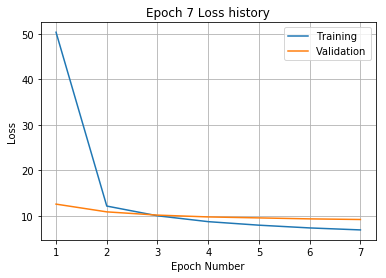

Training
Iteration 0: with minibatch training loss = 6.56 and relative error of 0.31
Iteration 20: with minibatch training loss = 9.12 and relative error of 0.35
Iteration 40: with minibatch training loss = 5.47 and relative error of 0.26
Iteration 60: with minibatch training loss = 7.12 and relative error of 0.3
Iteration 80: with minibatch training loss = 7.44 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.41 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 140: with minibatch training loss = 7.67 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.09 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 200: with minibatch training loss = 5.91 and relative error of 0.29
Iteration 220: with minibatch training loss = 4.85 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.67 and relativ

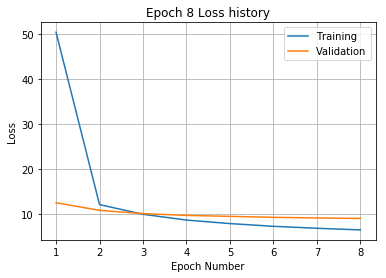

Training
Iteration 0: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 20: with minibatch training loss = 7.65 and relative error of 0.32
Iteration 40: with minibatch training loss = 5.33 and relative error of 0.27
Iteration 60: with minibatch training loss = 4.83 and relative error of 0.26
Iteration 80: with minibatch training loss = 8.31 and relative error of 0.35
Iteration 100: with minibatch training loss = 6.13 and relative error of 0.28
Iteration 120: with minibatch training loss = 7.08 and relative error of 0.3
Iteration 140: with minibatch training loss = 6.95 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.52 and relative error of 0.29
Iteration 180: with minibatch training loss = 4.75 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.29 and relative error of 0.23
Iteration 220: with minibatch training loss = 4.07 and relative error of 0.22
Iteration 240: with minibatch training loss = 6.66 and relativ

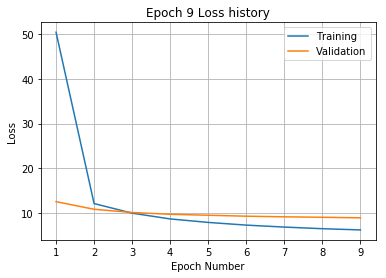

Training
Iteration 0: with minibatch training loss = 5.04 and relative error of 0.26
Iteration 20: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.58 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.98 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.71 and relative error of 0.29
Iteration 140: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 160: with minibatch training loss = 7 and relative error of 0.31
Iteration 180: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 200: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 220: with minibatch training loss = 3.82 and relative error of 0.22
Iteration 240: with minibatch training loss = 5.9 and relative err

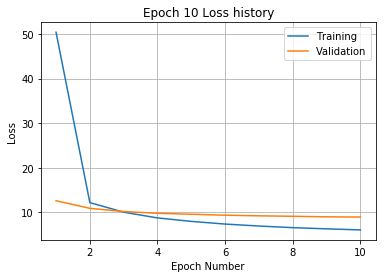

Training
Iteration 0: with minibatch training loss = 5.35 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.83 and relative error of 0.29
Iteration 40: with minibatch training loss = 5.72 and relative error of 0.28
Iteration 60: with minibatch training loss = 6.43 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.82 and relative error of 0.29
Iteration 100: with minibatch training loss = 4.51 and relative error of 0.25
Iteration 120: with minibatch training loss = 6.74 and relative error of 0.29
Iteration 140: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.65 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.87 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.51 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.54 and relative

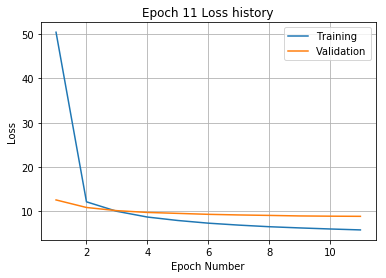

Training
Iteration 0: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 20: with minibatch training loss = 5.91 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 60: with minibatch training loss = 8.97 and relative error of 0.34
Iteration 80: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 100: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 120: with minibatch training loss = 6.28 and relative error of 0.29
Iteration 140: with minibatch training loss = 3.92 and relative error of 0.22
Iteration 160: with minibatch training loss = 7.21 and relative error of 0.3
Iteration 180: with minibatch training loss = 4.25 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.9 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 240: with minibatch training loss = 7.12 and relative

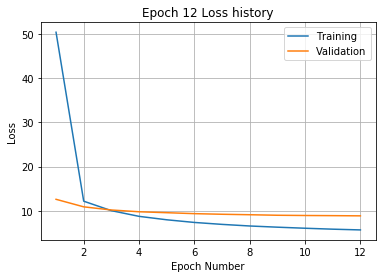

Training
Iteration 0: with minibatch training loss = 5.13 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.42 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.14 and relative error of 0.3
Iteration 60: with minibatch training loss = 6.51 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.72 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.9 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.65 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 180: with minibatch training loss = 8.94 and relative error of 0.35
Iteration 200: with minibatch training loss = 7.01 and relative error of 0.3
Iteration 220: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 240: with minibatch training loss = 6.42 and relative e

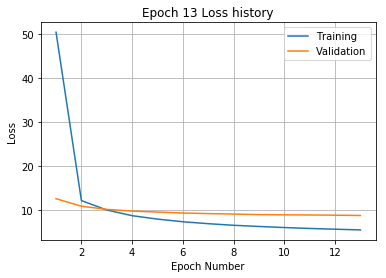

Training
Iteration 0: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 20: with minibatch training loss = 4.48 and relative error of 0.25
Iteration 40: with minibatch training loss = 4.49 and relative error of 0.25
Iteration 60: with minibatch training loss = 5.44 and relative error of 0.26
Iteration 80: with minibatch training loss = 4.95 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.05 and relative error of 0.23
Iteration 120: with minibatch training loss = 6.17 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.29 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.92 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 200: with minibatch training loss = 3.68 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.24 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.91 and relativ

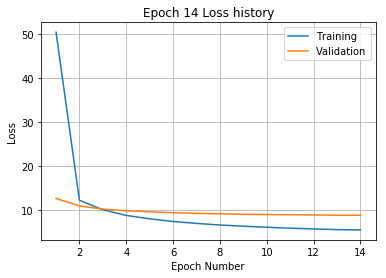

Training
Iteration 0: with minibatch training loss = 4.88 and relative error of 0.25
Iteration 20: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 40: with minibatch training loss = 5 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.97 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.97 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.21 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.49 and relative error of 0.23
Iteration 160: with minibatch training loss = 4.61 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.24 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.48 and relative error of 0.32
Iteration 220: with minibatch training loss = 3.67 and relative error of 0.21
Iteration 240: with minibatch training loss = 5.78 and relative er

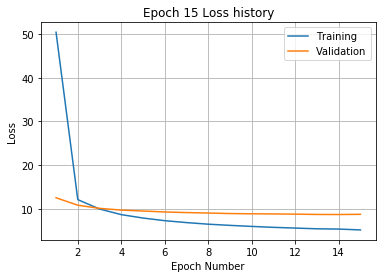

Training
Iteration 0: with minibatch training loss = 4.62 and relative error of 0.24
Iteration 20: with minibatch training loss = 5.7 and relative error of 0.27
Iteration 40: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 60: with minibatch training loss = 4.45 and relative error of 0.24
Iteration 80: with minibatch training loss = 3.76 and relative error of 0.23
Iteration 100: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.22 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.34 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 180: with minibatch training loss = 3.72 and relative error of 0.23
Iteration 200: with minibatch training loss = 6.08 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.16 and relative error of 0.23
Iteration 240: with minibatch training loss = 4.56 and relativ

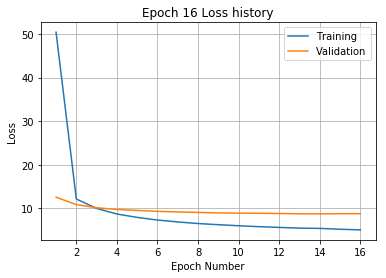

Training
Iteration 0: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 20: with minibatch training loss = 3.8 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.74 and relative error of 0.25
Iteration 60: with minibatch training loss = 7.48 and relative error of 0.31
Iteration 80: with minibatch training loss = 4.31 and relative error of 0.24
Iteration 100: with minibatch training loss = 3.5 and relative error of 0.22
Iteration 120: with minibatch training loss = 4.06 and relative error of 0.22
Iteration 140: with minibatch training loss = 7.15 and relative error of 0.3
Iteration 160: with minibatch training loss = 4.93 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.55 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.8 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.94 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.09 and relative e

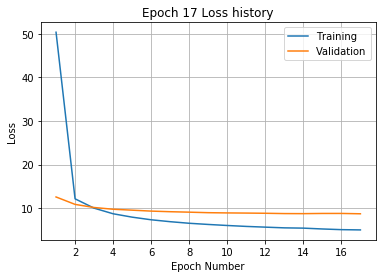

Training
Iteration 0: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.71 and relative error of 0.28
Iteration 40: with minibatch training loss = 4.06 and relative error of 0.22
Iteration 60: with minibatch training loss = 3.85 and relative error of 0.22
Iteration 80: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 100: with minibatch training loss = 5 and relative error of 0.26
Iteration 120: with minibatch training loss = 4.11 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.11 and relative error of 0.26
Iteration 160: with minibatch training loss = 3.83 and relative error of 0.21
Iteration 180: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 200: with minibatch training loss = 3.7 and relative error of 0.22
Iteration 220: with minibatch training loss = 4.72 and relative error of 0.24
Iteration 240: with minibatch training loss = 3.44 and relative e

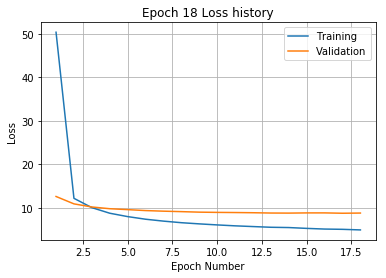

Training
Iteration 0: with minibatch training loss = 3 and relative error of 0.19
Iteration 20: with minibatch training loss = 4.53 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.88 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 80: with minibatch training loss = 5.75 and relative error of 0.27
Iteration 100: with minibatch training loss = 5.16 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.59 and relative error of 0.24
Iteration 140: with minibatch training loss = 4.52 and relative error of 0.24
Iteration 160: with minibatch training loss = 5.33 and relative error of 0.25
Iteration 180: with minibatch training loss = 5 and relative error of 0.25
Iteration 200: with minibatch training loss = 3.73 and relative error of 0.22
Iteration 220: with minibatch training loss = 5.98 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.73 and relative err

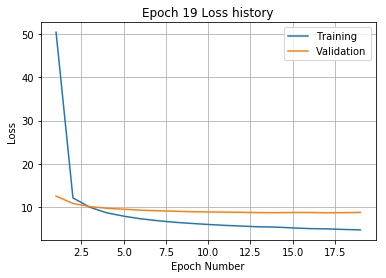

Training
Iteration 0: with minibatch training loss = 4.07 and relative error of 0.23
Iteration 20: with minibatch training loss = 3.27 and relative error of 0.22
Iteration 40: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 60: with minibatch training loss = 5.84 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 100: with minibatch training loss = 4.47 and relative error of 0.24
Iteration 120: with minibatch training loss = 4.66 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.91 and relative error of 0.31
Iteration 160: with minibatch training loss = 4.39 and relative error of 0.24
Iteration 180: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.77 and relative error of 0.28
Iteration 220: with minibatch training loss = 4.89 and relative error of 0.25
Iteration 240: with minibatch training loss = 5.64 and relative

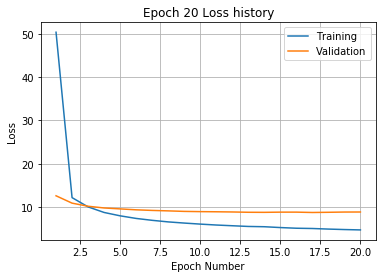

Training
Iteration 0: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.3 and relative error of 0.24
Iteration 40: with minibatch training loss = 4 and relative error of 0.23
Iteration 60: with minibatch training loss = 3.66 and relative error of 0.22
Iteration 80: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 100: with minibatch training loss = 4.82 and relative error of 0.25
Iteration 120: with minibatch training loss = 4.72 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.17 and relative error of 0.26
Iteration 160: with minibatch training loss = 5.21 and relative error of 0.25
Iteration 180: with minibatch training loss = 4.48 and relative error of 0.24
Iteration 200: with minibatch training loss = 5.66 and relative error of 0.27
Iteration 220: with minibatch training loss = 6.21 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.12 and relative er

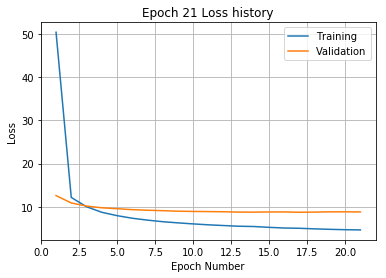

Training
Iteration 0: with minibatch training loss = 3.79 and relative error of 0.22
Iteration 20: with minibatch training loss = 3.98 and relative error of 0.24
Iteration 40: with minibatch training loss = 5.4 and relative error of 0.26
Iteration 60: with minibatch training loss = 6.29 and relative error of 0.28
Iteration 80: with minibatch training loss = 4.55 and relative error of 0.25
Iteration 100: with minibatch training loss = 3.05 and relative error of 0.2
Iteration 120: with minibatch training loss = 4.5 and relative error of 0.25
Iteration 140: with minibatch training loss = 3.8 and relative error of 0.21
Iteration 160: with minibatch training loss = 4.12 and relative error of 0.23
Iteration 180: with minibatch training loss = 5.84 and relative error of 0.27
Iteration 200: with minibatch training loss = 4.78 and relative error of 0.25
Iteration 220: with minibatch training loss = 6.59 and relative error of 0.29
Iteration 240: with minibatch training loss = 4.04 and relative e

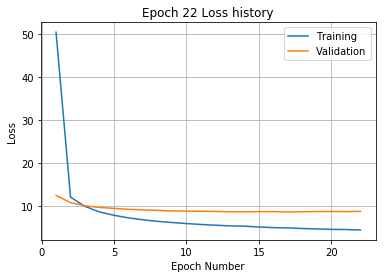

Validation error has stopped improving! Training on repetition 8 stopped!
Training
Iteration 0: with minibatch training loss = 229 and relative error of 1.7
Iteration 20: with minibatch training loss = 116 and relative error of 1.3
Iteration 40: with minibatch training loss = 81.4 and relative error of 1
Iteration 60: with minibatch training loss = 61.7 and relative error of 0.88
Iteration 80: with minibatch training loss = 42.4 and relative error of 0.76
Iteration 100: with minibatch training loss = 31.7 and relative error of 0.65
Iteration 120: with minibatch training loss = 25.9 and relative error of 0.58
Iteration 140: with minibatch training loss = 22.4 and relative error of 0.52
Iteration 160: with minibatch training loss = 17.6 and relative error of 0.48
Iteration 180: with minibatch training loss = 18.1 and relative error of 0.47
Iteration 200: with minibatch training loss = 18.3 and relative error of 0.47
Iteration 220: with minibatch training loss = 16 and relative error of 0

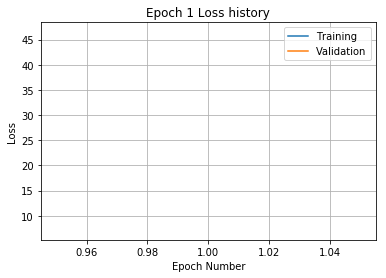

Training
Iteration 0: with minibatch training loss = 14.5 and relative error of 0.44
Iteration 20: with minibatch training loss = 15.3 and relative error of 0.44
Iteration 40: with minibatch training loss = 15.1 and relative error of 0.45
Iteration 60: with minibatch training loss = 11.4 and relative error of 0.39
Iteration 80: with minibatch training loss = 13.7 and relative error of 0.42
Iteration 100: with minibatch training loss = 11.8 and relative error of 0.4
Iteration 120: with minibatch training loss = 11.7 and relative error of 0.4
Iteration 140: with minibatch training loss = 13.9 and relative error of 0.44
Iteration 160: with minibatch training loss = 10.7 and relative error of 0.39
Iteration 180: with minibatch training loss = 11.3 and relative error of 0.38
Iteration 200: with minibatch training loss = 9.83 and relative error of 0.36
Iteration 220: with minibatch training loss = 10.5 and relative error of 0.37
Iteration 240: with minibatch training loss = 14.1 and relative

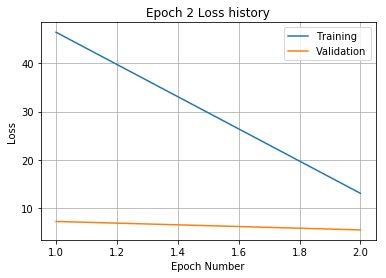

Training
Iteration 0: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 20: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 40: with minibatch training loss = 12.5 and relative error of 0.42
Iteration 60: with minibatch training loss = 11 and relative error of 0.37
Iteration 80: with minibatch training loss = 8.48 and relative error of 0.34
Iteration 100: with minibatch training loss = 10.8 and relative error of 0.37
Iteration 120: with minibatch training loss = 8.73 and relative error of 0.33
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.37
Iteration 160: with minibatch training loss = 9.73 and relative error of 0.36
Iteration 180: with minibatch training loss = 11.5 and relative error of 0.39
Iteration 200: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 220: with minibatch training loss = 8.78 and relative error of 0.34
Iteration 240: with minibatch training loss = 9.89 and relative 

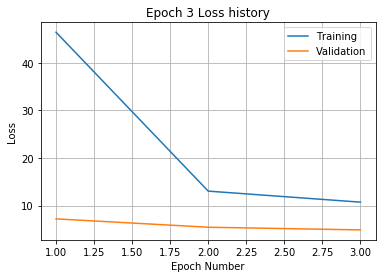

Training
Iteration 0: with minibatch training loss = 9.21 and relative error of 0.34
Iteration 20: with minibatch training loss = 11.6 and relative error of 0.39
Iteration 40: with minibatch training loss = 9.42 and relative error of 0.36
Iteration 60: with minibatch training loss = 8.47 and relative error of 0.34
Iteration 80: with minibatch training loss = 12 and relative error of 0.39
Iteration 100: with minibatch training loss = 8.07 and relative error of 0.33
Iteration 120: with minibatch training loss = 8.84 and relative error of 0.36
Iteration 140: with minibatch training loss = 9.69 and relative error of 0.36
Iteration 160: with minibatch training loss = 9.08 and relative error of 0.35
Iteration 180: with minibatch training loss = 7.2 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.03 and relative error of 0.28
Iteration 220: with minibatch training loss = 8.66 and relative error of 0.34
Iteration 240: with minibatch training loss = 7.88 and relative 

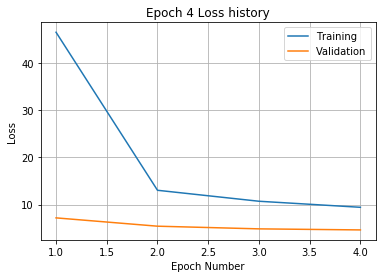

Training
Iteration 0: with minibatch training loss = 10.3 and relative error of 0.39
Iteration 20: with minibatch training loss = 10 and relative error of 0.37
Iteration 40: with minibatch training loss = 7.36 and relative error of 0.31
Iteration 60: with minibatch training loss = 9.84 and relative error of 0.36
Iteration 80: with minibatch training loss = 7.43 and relative error of 0.33
Iteration 100: with minibatch training loss = 7.77 and relative error of 0.34
Iteration 120: with minibatch training loss = 8.28 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.74 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.86 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.9 and relative error of 0.31
Iteration 200: with minibatch training loss = 10.4 and relative error of 0.39
Iteration 220: with minibatch training loss = 6.42 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.88 and relative e

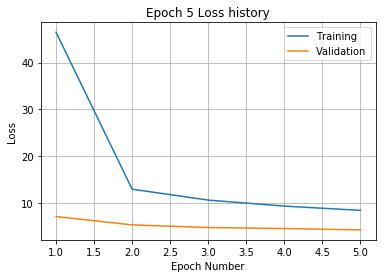

Training
Iteration 0: with minibatch training loss = 8.34 and relative error of 0.32
Iteration 20: with minibatch training loss = 6.23 and relative error of 0.28
Iteration 40: with minibatch training loss = 8.51 and relative error of 0.34
Iteration 60: with minibatch training loss = 11.2 and relative error of 0.39
Iteration 80: with minibatch training loss = 6.68 and relative error of 0.3
Iteration 100: with minibatch training loss = 8.16 and relative error of 0.33
Iteration 120: with minibatch training loss = 6.54 and relative error of 0.3
Iteration 140: with minibatch training loss = 7.16 and relative error of 0.31
Iteration 160: with minibatch training loss = 7.66 and relative error of 0.31
Iteration 180: with minibatch training loss = 8.76 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.44 and relative error of 0.31
Iteration 220: with minibatch training loss = 9.79 and relative error of 0.36
Iteration 240: with minibatch training loss = 10.4 and relative

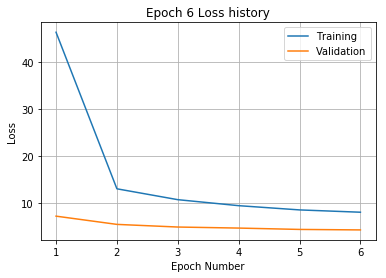

Training
Iteration 0: with minibatch training loss = 5.83 and relative error of 0.28
Iteration 20: with minibatch training loss = 7.93 and relative error of 0.33
Iteration 40: with minibatch training loss = 9.01 and relative error of 0.34
Iteration 60: with minibatch training loss = 7.06 and relative error of 0.3
Iteration 80: with minibatch training loss = 5.93 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.7 and relative error of 0.29
Iteration 140: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 160: with minibatch training loss = 6.55 and relative error of 0.29
Iteration 180: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 200: with minibatch training loss = 6.64 and relative error of 0.29
Iteration 220: with minibatch training loss = 8.04 and relative error of 0.32
Iteration 240: with minibatch training loss = 6.99 and relative

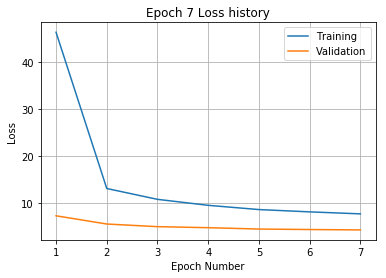

Training
Iteration 0: with minibatch training loss = 10.7 and relative error of 0.38
Iteration 20: with minibatch training loss = 7.88 and relative error of 0.34
Iteration 40: with minibatch training loss = 5.92 and relative error of 0.28
Iteration 60: with minibatch training loss = 7.22 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.14 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.45 and relative error of 0.32
Iteration 120: with minibatch training loss = 7.37 and relative error of 0.32
Iteration 140: with minibatch training loss = 7.45 and relative error of 0.33
Iteration 160: with minibatch training loss = 8.54 and relative error of 0.33
Iteration 180: with minibatch training loss = 6.3 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.84 and relative error of 0.33
Iteration 220: with minibatch training loss = 8.17 and relative error of 0.33
Iteration 240: with minibatch training loss = 5.86 and relativ

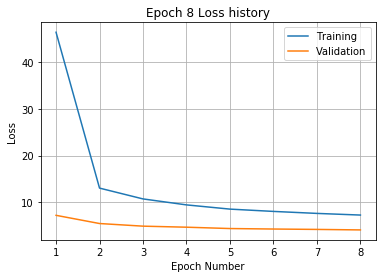

Training
Iteration 0: with minibatch training loss = 7.5 and relative error of 0.32
Iteration 20: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 40: with minibatch training loss = 9.53 and relative error of 0.34
Iteration 60: with minibatch training loss = 6.96 and relative error of 0.3
Iteration 80: with minibatch training loss = 6.8 and relative error of 0.29
Iteration 100: with minibatch training loss = 6.53 and relative error of 0.3
Iteration 120: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 140: with minibatch training loss = 6.07 and relative error of 0.28
Iteration 160: with minibatch training loss = 9.95 and relative error of 0.36
Iteration 180: with minibatch training loss = 5.73 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.66 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.36 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.48 and relative err

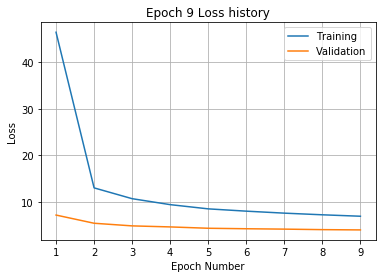

Training
Iteration 0: with minibatch training loss = 5.45 and relative error of 0.28
Iteration 20: with minibatch training loss = 6.76 and relative error of 0.3
Iteration 40: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 60: with minibatch training loss = 5.52 and relative error of 0.28
Iteration 80: with minibatch training loss = 6.37 and relative error of 0.28
Iteration 100: with minibatch training loss = 6.52 and relative error of 0.3
Iteration 120: with minibatch training loss = 6.96 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.27 and relative error of 0.3
Iteration 160: with minibatch training loss = 6.34 and relative error of 0.29
Iteration 180: with minibatch training loss = 9.46 and relative error of 0.35
Iteration 200: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 220: with minibatch training loss = 9.42 and relative error of 0.35
Iteration 240: with minibatch training loss = 6.98 and relative 

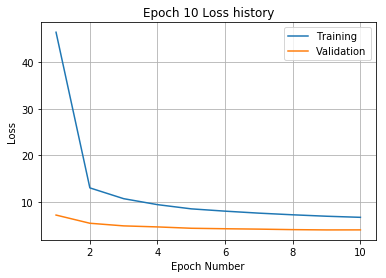

Training
Iteration 0: with minibatch training loss = 5.19 and relative error of 0.25
Iteration 20: with minibatch training loss = 5.19 and relative error of 0.27
Iteration 40: with minibatch training loss = 8.78 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.87 and relative error of 0.34
Iteration 80: with minibatch training loss = 7.02 and relative error of 0.3
Iteration 100: with minibatch training loss = 5.97 and relative error of 0.27
Iteration 120: with minibatch training loss = 4.87 and relative error of 0.25
Iteration 140: with minibatch training loss = 8.72 and relative error of 0.35
Iteration 160: with minibatch training loss = 4.74 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.48 and relative error of 0.26
Iteration 200: with minibatch training loss = 7.04 and relative error of 0.3
Iteration 220: with minibatch training loss = 6.96 and relative error of 0.31
Iteration 240: with minibatch training loss = 8.32 and relative

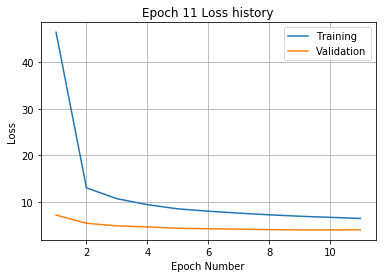

Training
Iteration 0: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.46 and relative error of 0.3
Iteration 40: with minibatch training loss = 3.77 and relative error of 0.22
Iteration 60: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 80: with minibatch training loss = 7.36 and relative error of 0.33
Iteration 100: with minibatch training loss = 5.26 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.53 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.06 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 180: with minibatch training loss = 4.51 and relative error of 0.25
Iteration 200: with minibatch training loss = 7.57 and relative error of 0.32
Iteration 220: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.86 and relativ

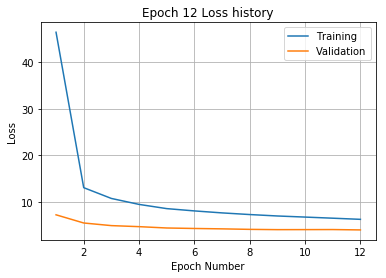

Training
Iteration 0: with minibatch training loss = 5.64 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.38 and relative error of 0.29
Iteration 40: with minibatch training loss = 4.18 and relative error of 0.24
Iteration 60: with minibatch training loss = 6.9 and relative error of 0.29
Iteration 80: with minibatch training loss = 6.66 and relative error of 0.29
Iteration 100: with minibatch training loss = 5.23 and relative error of 0.27
Iteration 120: with minibatch training loss = 6.78 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 160: with minibatch training loss = 6.45 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.33 and relative error of 0.31
Iteration 200: with minibatch training loss = 4.74 and relative error of 0.24
Iteration 220: with minibatch training loss = 7.74 and relative error of 0.34
Iteration 240: with minibatch training loss = 4.4 and relative 

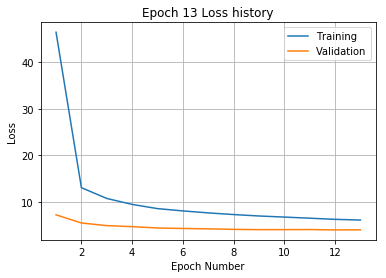

Training
Iteration 0: with minibatch training loss = 5.91 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.33 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.23 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.4 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.36 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.35 and relative error of 0.27
Iteration 140: with minibatch training loss = 5.46 and relative error of 0.27
Iteration 160: with minibatch training loss = 6.95 and relative error of 0.3
Iteration 180: with minibatch training loss = 5.13 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.86 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.35 and relative error of 0.29
Iteration 240: with minibatch training loss = 8.03 and relative 

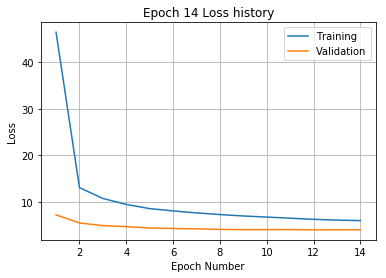

Training
Iteration 0: with minibatch training loss = 6.58 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.73 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.78 and relative error of 0.27
Iteration 60: with minibatch training loss = 6.62 and relative error of 0.3
Iteration 80: with minibatch training loss = 4.26 and relative error of 0.24
Iteration 100: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 120: with minibatch training loss = 4.59 and relative error of 0.25
Iteration 140: with minibatch training loss = 6.24 and relative error of 0.28
Iteration 160: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 180: with minibatch training loss = 5.07 and relative error of 0.26
Iteration 200: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 220: with minibatch training loss = 5.59 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.3 and relative 

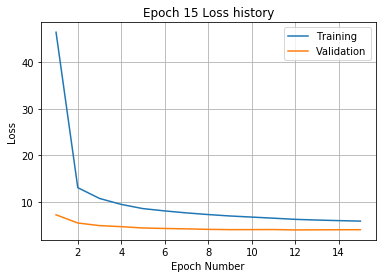

Training
Iteration 0: with minibatch training loss = 6.57 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.3 and relative error of 0.34
Iteration 40: with minibatch training loss = 6.53 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.54 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.04 and relative error of 0.28
Iteration 100: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 120: with minibatch training loss = 6.4 and relative error of 0.31
Iteration 140: with minibatch training loss = 5.72 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.02 and relative error of 0.23
Iteration 180: with minibatch training loss = 6.77 and relative error of 0.3
Iteration 200: with minibatch training loss = 6.67 and relative error of 0.3
Iteration 220: with minibatch training loss = 3.85 and relative error of 0.22
Iteration 240: with minibatch training loss = 3.63 and relative e

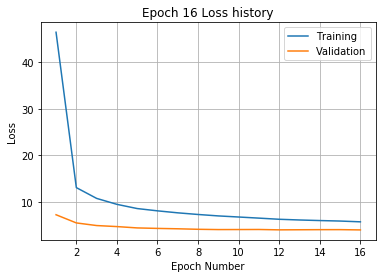

Training
Iteration 0: with minibatch training loss = 5.69 and relative error of 0.27
Iteration 20: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 40: with minibatch training loss = 3.67 and relative error of 0.22
Iteration 60: with minibatch training loss = 7.74 and relative error of 0.33
Iteration 80: with minibatch training loss = 7.51 and relative error of 0.31
Iteration 100: with minibatch training loss = 4.44 and relative error of 0.24
Iteration 120: with minibatch training loss = 5.08 and relative error of 0.26
Iteration 140: with minibatch training loss = 4.57 and relative error of 0.24
Iteration 160: with minibatch training loss = 4.86 and relative error of 0.25
Iteration 180: with minibatch training loss = 3.99 and relative error of 0.23
Iteration 200: with minibatch training loss = 5.21 and relative error of 0.26
Iteration 220: with minibatch training loss = 6.39 and relative error of 0.28
Iteration 240: with minibatch training loss = 4.99 and relati

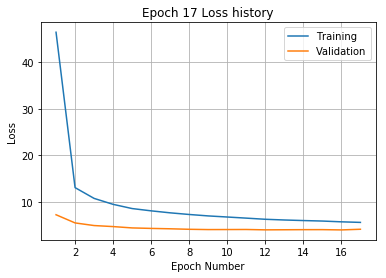

Training
Iteration 0: with minibatch training loss = 3.65 and relative error of 0.23
Iteration 20: with minibatch training loss = 6.52 and relative error of 0.28
Iteration 40: with minibatch training loss = 5.53 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.24 and relative error of 0.3
Iteration 80: with minibatch training loss = 8.3 and relative error of 0.33
Iteration 100: with minibatch training loss = 4.79 and relative error of 0.25
Iteration 120: with minibatch training loss = 4 and relative error of 0.24
Iteration 140: with minibatch training loss = 5.02 and relative error of 0.25
Iteration 160: with minibatch training loss = 5.29 and relative error of 0.26
Iteration 180: with minibatch training loss = 5.43 and relative error of 0.27
Iteration 200: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 220: with minibatch training loss = 6.16 and relative error of 0.28
Iteration 240: with minibatch training loss = 7.22 and relative er

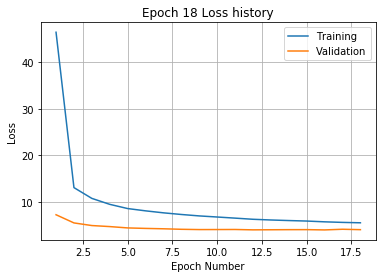

Training
Iteration 0: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 20: with minibatch training loss = 4.34 and relative error of 0.23
Iteration 40: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 60: with minibatch training loss = 5.79 and relative error of 0.27
Iteration 80: with minibatch training loss = 3.71 and relative error of 0.22
Iteration 100: with minibatch training loss = 5.71 and relative error of 0.27
Iteration 120: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 140: with minibatch training loss = 3.64 and relative error of 0.22
Iteration 160: with minibatch training loss = 5.36 and relative error of 0.27
Iteration 180: with minibatch training loss = 4.9 and relative error of 0.26
Iteration 200: with minibatch training loss = 5.68 and relative error of 0.27
Iteration 220: with minibatch training loss = 4.58 and relative error of 0.25
Iteration 240: with minibatch training loss = 4.2 and relative 

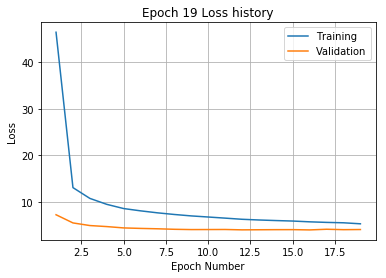

Training
Iteration 0: with minibatch training loss = 5.74 and relative error of 0.28
Iteration 20: with minibatch training loss = 5.3 and relative error of 0.26
Iteration 40: with minibatch training loss = 4.4 and relative error of 0.24
Iteration 60: with minibatch training loss = 4.11 and relative error of 0.23
Iteration 80: with minibatch training loss = 4.87 and relative error of 0.26
Iteration 100: with minibatch training loss = 4.81 and relative error of 0.25
Iteration 120: with minibatch training loss = 5.03 and relative error of 0.26
Iteration 140: with minibatch training loss = 5.95 and relative error of 0.27
Iteration 160: with minibatch training loss = 4.62 and relative error of 0.25
Iteration 180: with minibatch training loss = 6.05 and relative error of 0.3
Iteration 200: with minibatch training loss = 5.19 and relative error of 0.26
Iteration 220: with minibatch training loss = 5.31 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.72 and relative 

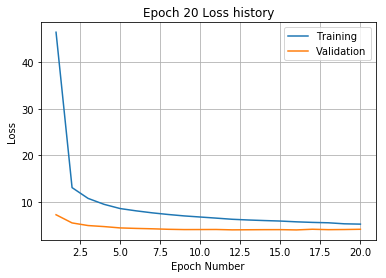

Training
Iteration 0: with minibatch training loss = 4.2 and relative error of 0.24
Iteration 20: with minibatch training loss = 6.47 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.39 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.83 and relative error of 0.25
Iteration 80: with minibatch training loss = 4.84 and relative error of 0.25
Iteration 100: with minibatch training loss = 5.49 and relative error of 0.27
Iteration 120: with minibatch training loss = 5 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.27 and relative error of 0.31
Iteration 160: with minibatch training loss = 6.48 and relative error of 0.28
Iteration 180: with minibatch training loss = 5.8 and relative error of 0.28
Iteration 200: with minibatch training loss = 5.76 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.38 and relative error of 0.26
Iteration 240: with minibatch training loss = 4.16 and relative er

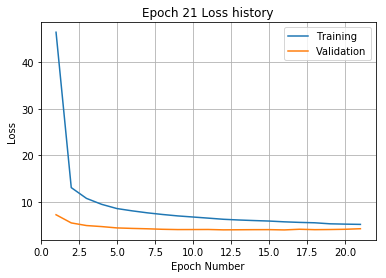

Validation error has stopped improving! Training on repetition 9 stopped!
Training
Iteration 0: with minibatch training loss = 237 and relative error of 1.7
Iteration 20: with minibatch training loss = 139 and relative error of 1.3
Iteration 40: with minibatch training loss = 80.7 and relative error of 1
Iteration 60: with minibatch training loss = 61.2 and relative error of 0.91
Iteration 80: with minibatch training loss = 46.1 and relative error of 0.79
Iteration 100: with minibatch training loss = 34.2 and relative error of 0.7
Iteration 120: with minibatch training loss = 28 and relative error of 0.59
Iteration 140: with minibatch training loss = 23.9 and relative error of 0.58
Iteration 160: with minibatch training loss = 23.1 and relative error of 0.55
Iteration 180: with minibatch training loss = 17.4 and relative error of 0.49
Iteration 200: with minibatch training loss = 13.8 and relative error of 0.43
Iteration 220: with minibatch training loss = 15.6 and relative error of 0.

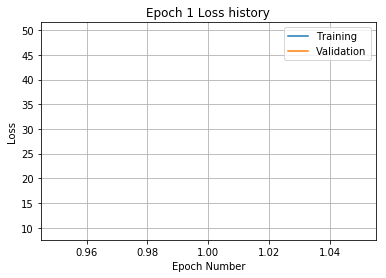

Training
Iteration 0: with minibatch training loss = 13.4 and relative error of 0.43
Iteration 20: with minibatch training loss = 14.4 and relative error of 0.44
Iteration 40: with minibatch training loss = 14.1 and relative error of 0.42
Iteration 60: with minibatch training loss = 14.3 and relative error of 0.44
Iteration 80: with minibatch training loss = 15.5 and relative error of 0.46
Iteration 100: with minibatch training loss = 15.2 and relative error of 0.44
Iteration 120: with minibatch training loss = 13.5 and relative error of 0.42
Iteration 140: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 160: with minibatch training loss = 12.9 and relative error of 0.42
Iteration 180: with minibatch training loss = 12.3 and relative error of 0.4
Iteration 200: with minibatch training loss = 14.6 and relative error of 0.43
Iteration 220: with minibatch training loss = 10.2 and relative error of 0.35
Iteration 240: with minibatch training loss = 12.2 and relative

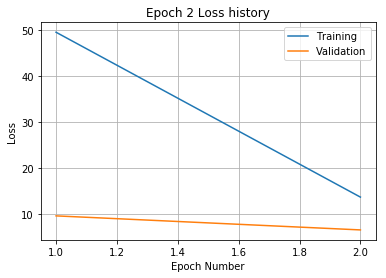

Training
Iteration 0: with minibatch training loss = 10.5 and relative error of 0.36
Iteration 20: with minibatch training loss = 9.14 and relative error of 0.35
Iteration 40: with minibatch training loss = 12 and relative error of 0.39
Iteration 60: with minibatch training loss = 10.9 and relative error of 0.39
Iteration 80: with minibatch training loss = 12.4 and relative error of 0.41
Iteration 100: with minibatch training loss = 13.5 and relative error of 0.42
Iteration 120: with minibatch training loss = 13 and relative error of 0.43
Iteration 140: with minibatch training loss = 8.03 and relative error of 0.32
Iteration 160: with minibatch training loss = 9.5 and relative error of 0.35
Iteration 180: with minibatch training loss = 11.7 and relative error of 0.39
Iteration 200: with minibatch training loss = 13.4 and relative error of 0.42
Iteration 220: with minibatch training loss = 8.65 and relative error of 0.35
Iteration 240: with minibatch training loss = 10.4 and relative er

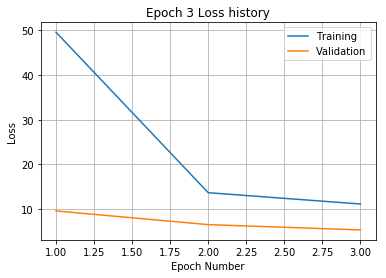

Training
Iteration 0: with minibatch training loss = 9.53 and relative error of 0.38
Iteration 20: with minibatch training loss = 6.61 and relative error of 0.3
Iteration 40: with minibatch training loss = 8.92 and relative error of 0.34
Iteration 60: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 80: with minibatch training loss = 8.11 and relative error of 0.33
Iteration 100: with minibatch training loss = 10.9 and relative error of 0.39
Iteration 120: with minibatch training loss = 7.11 and relative error of 0.3
Iteration 140: with minibatch training loss = 12.1 and relative error of 0.4
Iteration 160: with minibatch training loss = 9.26 and relative error of 0.34
Iteration 180: with minibatch training loss = 7.24 and relative error of 0.3
Iteration 200: with minibatch training loss = 8.48 and relative error of 0.33
Iteration 220: with minibatch training loss = 9.37 and relative error of 0.35
Iteration 240: with minibatch training loss = 8.92 and relative e

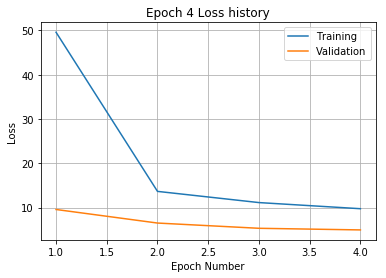

Training
Iteration 0: with minibatch training loss = 7.48 and relative error of 0.32
Iteration 20: with minibatch training loss = 9.07 and relative error of 0.33
Iteration 40: with minibatch training loss = 8.42 and relative error of 0.33
Iteration 60: with minibatch training loss = 8.7 and relative error of 0.34
Iteration 80: with minibatch training loss = 8.58 and relative error of 0.33
Iteration 100: with minibatch training loss = 8.77 and relative error of 0.34
Iteration 120: with minibatch training loss = 10.4 and relative error of 0.37
Iteration 140: with minibatch training loss = 9.59 and relative error of 0.38
Iteration 160: with minibatch training loss = 9.23 and relative error of 0.35
Iteration 180: with minibatch training loss = 9.08 and relative error of 0.36
Iteration 200: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 220: with minibatch training loss = 9.1 and relative error of 0.35
Iteration 240: with minibatch training loss = 8.46 and relative

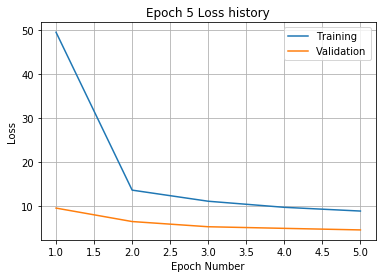

Training
Iteration 0: with minibatch training loss = 8.22 and relative error of 0.33
Iteration 20: with minibatch training loss = 7.68 and relative error of 0.33
Iteration 40: with minibatch training loss = 10.2 and relative error of 0.36
Iteration 60: with minibatch training loss = 9.15 and relative error of 0.34
Iteration 80: with minibatch training loss = 10.1 and relative error of 0.37
Iteration 100: with minibatch training loss = 9.65 and relative error of 0.38
Iteration 120: with minibatch training loss = 8.35 and relative error of 0.34
Iteration 140: with minibatch training loss = 10.3 and relative error of 0.38
Iteration 160: with minibatch training loss = 6.55 and relative error of 0.3
Iteration 180: with minibatch training loss = 7.35 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.85 and relative error of 0.31
Iteration 220: with minibatch training loss = 7.93 and relative error of 0.33
Iteration 240: with minibatch training loss = 6.79 and relativ

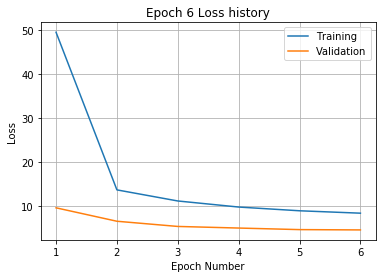

Training
Iteration 0: with minibatch training loss = 7.02 and relative error of 0.31
Iteration 20: with minibatch training loss = 6.19 and relative error of 0.29
Iteration 40: with minibatch training loss = 7.71 and relative error of 0.31
Iteration 60: with minibatch training loss = 7.33 and relative error of 0.32
Iteration 80: with minibatch training loss = 5.54 and relative error of 0.27
Iteration 100: with minibatch training loss = 8.23 and relative error of 0.32
Iteration 120: with minibatch training loss = 9.7 and relative error of 0.35
Iteration 140: with minibatch training loss = 10.3 and relative error of 0.38
Iteration 160: with minibatch training loss = 9.81 and relative error of 0.36
Iteration 180: with minibatch training loss = 7.68 and relative error of 0.32
Iteration 200: with minibatch training loss = 7.75 and relative error of 0.32
Iteration 220: with minibatch training loss = 7.57 and relative error of 0.32
Iteration 240: with minibatch training loss = 8.29 and relativ

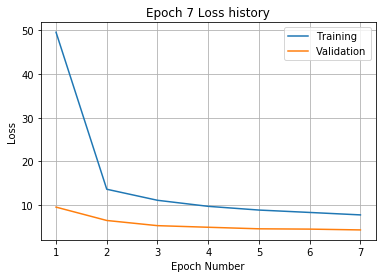

Training
Iteration 0: with minibatch training loss = 7.79 and relative error of 0.32
Iteration 20: with minibatch training loss = 9.16 and relative error of 0.35
Iteration 40: with minibatch training loss = 7.31 and relative error of 0.32
Iteration 60: with minibatch training loss = 6.82 and relative error of 0.31
Iteration 80: with minibatch training loss = 6.25 and relative error of 0.28
Iteration 100: with minibatch training loss = 7.13 and relative error of 0.31
Iteration 120: with minibatch training loss = 8.94 and relative error of 0.36
Iteration 140: with minibatch training loss = 7.84 and relative error of 0.32
Iteration 160: with minibatch training loss = 6.22 and relative error of 0.28
Iteration 180: with minibatch training loss = 7.04 and relative error of 0.29
Iteration 200: with minibatch training loss = 9.93 and relative error of 0.36
Iteration 220: with minibatch training loss = 7.96 and relative error of 0.32
Iteration 240: with minibatch training loss = 6.31 and relati

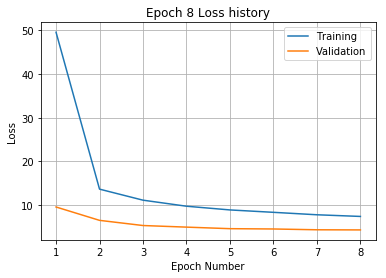

Training
Iteration 0: with minibatch training loss = 6.09 and relative error of 0.3
Iteration 20: with minibatch training loss = 7.94 and relative error of 0.32
Iteration 40: with minibatch training loss = 9.45 and relative error of 0.36
Iteration 60: with minibatch training loss = 8.36 and relative error of 0.34
Iteration 80: with minibatch training loss = 5.99 and relative error of 0.29
Iteration 100: with minibatch training loss = 10.7 and relative error of 0.37
Iteration 120: with minibatch training loss = 6.98 and relative error of 0.3
Iteration 140: with minibatch training loss = 5.34 and relative error of 0.27
Iteration 160: with minibatch training loss = 8.36 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.12 and relative error of 0.29
Iteration 200: with minibatch training loss = 6.81 and relative error of 0.3
Iteration 220: with minibatch training loss = 8.86 and relative error of 0.34
Iteration 240: with minibatch training loss = 7.66 and relative 

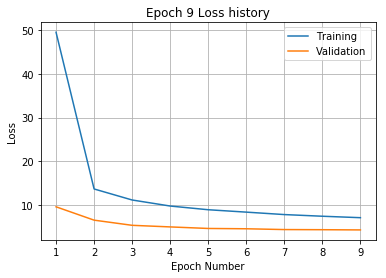

Training
Iteration 0: with minibatch training loss = 6.2 and relative error of 0.29
Iteration 20: with minibatch training loss = 8.29 and relative error of 0.32
Iteration 40: with minibatch training loss = 7.1 and relative error of 0.31
Iteration 60: with minibatch training loss = 6.17 and relative error of 0.28
Iteration 80: with minibatch training loss = 7.49 and relative error of 0.32
Iteration 100: with minibatch training loss = 5.52 and relative error of 0.27
Iteration 120: with minibatch training loss = 7.55 and relative error of 0.32
Iteration 140: with minibatch training loss = 8.32 and relative error of 0.33
Iteration 160: with minibatch training loss = 6.73 and relative error of 0.31
Iteration 180: with minibatch training loss = 7.61 and relative error of 0.33
Iteration 200: with minibatch training loss = 7.35 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.44 and relative error of 0.27
Iteration 240: with minibatch training loss = 6.62 and relative 

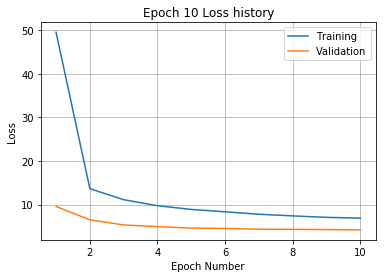

Training
Iteration 0: with minibatch training loss = 5.45 and relative error of 0.27
Iteration 20: with minibatch training loss = 6.99 and relative error of 0.3
Iteration 40: with minibatch training loss = 5.61 and relative error of 0.27
Iteration 60: with minibatch training loss = 7.09 and relative error of 0.31
Iteration 80: with minibatch training loss = 7.54 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.36 and relative error of 0.31
Iteration 120: with minibatch training loss = 6.26 and relative error of 0.28
Iteration 140: with minibatch training loss = 6.33 and relative error of 0.3
Iteration 160: with minibatch training loss = 7.26 and relative error of 0.31
Iteration 180: with minibatch training loss = 5.57 and relative error of 0.26
Iteration 200: with minibatch training loss = 6.28 and relative error of 0.3
Iteration 220: with minibatch training loss = 5.54 and relative error of 0.26
Iteration 240: with minibatch training loss = 7.08 and relative 

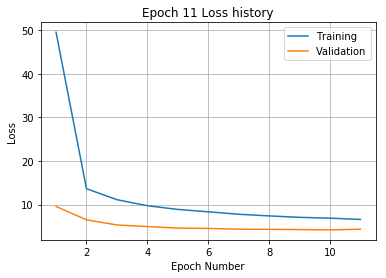

Training
Iteration 0: with minibatch training loss = 6 and relative error of 0.3
Iteration 20: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 40: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 60: with minibatch training loss = 3.95 and relative error of 0.23
Iteration 80: with minibatch training loss = 5.1 and relative error of 0.26
Iteration 100: with minibatch training loss = 5.82 and relative error of 0.28
Iteration 120: with minibatch training loss = 5.32 and relative error of 0.26
Iteration 140: with minibatch training loss = 7.57 and relative error of 0.32
Iteration 160: with minibatch training loss = 7.43 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.02 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.9 and relative error of 0.33
Iteration 220: with minibatch training loss = 7.86 and relative error of 0.33
Iteration 240: with minibatch training loss = 5.89 and relative err

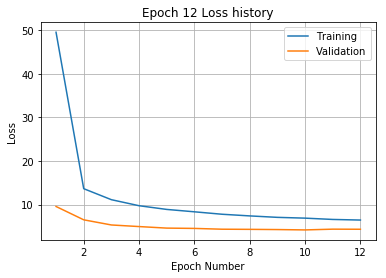

Training
Iteration 0: with minibatch training loss = 6.41 and relative error of 0.29
Iteration 20: with minibatch training loss = 5.44 and relative error of 0.28
Iteration 40: with minibatch training loss = 6.49 and relative error of 0.29
Iteration 60: with minibatch training loss = 6.74 and relative error of 0.3
Iteration 80: with minibatch training loss = 9.37 and relative error of 0.36
Iteration 100: with minibatch training loss = 9.43 and relative error of 0.36
Iteration 120: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 140: with minibatch training loss = 7.03 and relative error of 0.3
Iteration 160: with minibatch training loss = 5.4 and relative error of 0.27
Iteration 180: with minibatch training loss = 6.5 and relative error of 0.29
Iteration 200: with minibatch training loss = 7.56 and relative error of 0.31
Iteration 220: with minibatch training loss = 6.61 and relative error of 0.29
Iteration 240: with minibatch training loss = 5.51 and relative er

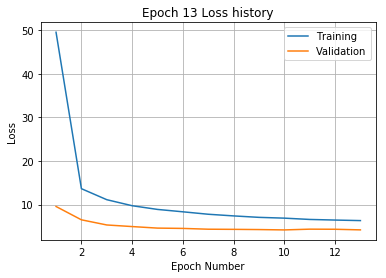

Training
Iteration 0: with minibatch training loss = 6.92 and relative error of 0.29
Iteration 20: with minibatch training loss = 7.47 and relative error of 0.32
Iteration 40: with minibatch training loss = 6.56 and relative error of 0.28
Iteration 60: with minibatch training loss = 5.8 and relative error of 0.27
Iteration 80: with minibatch training loss = 7.04 and relative error of 0.31
Iteration 100: with minibatch training loss = 7.02 and relative error of 0.32
Iteration 120: with minibatch training loss = 5.58 and relative error of 0.27
Iteration 140: with minibatch training loss = 4.53 and relative error of 0.25
Iteration 160: with minibatch training loss = 7.53 and relative error of 0.32
Iteration 180: with minibatch training loss = 6.9 and relative error of 0.31
Iteration 200: with minibatch training loss = 6.42 and relative error of 0.28
Iteration 220: with minibatch training loss = 5.5 and relative error of 0.27
Iteration 240: with minibatch training loss = 5.74 and relative 

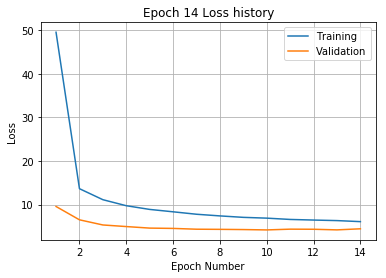

Training
Iteration 0: with minibatch training loss = 7.88 and relative error of 0.33
Iteration 20: with minibatch training loss = 5.06 and relative error of 0.26
Iteration 40: with minibatch training loss = 6.69 and relative error of 0.29
Iteration 60: with minibatch training loss = 4.99 and relative error of 0.25
Iteration 80: with minibatch training loss = 6.1 and relative error of 0.28
Iteration 100: with minibatch training loss = 5.75 and relative error of 0.28
Iteration 120: with minibatch training loss = 4.09 and relative error of 0.22
Iteration 140: with minibatch training loss = 5.04 and relative error of 0.25
Iteration 160: with minibatch training loss = 6.01 and relative error of 0.29
Iteration 180: with minibatch training loss = 7.25 and relative error of 0.32
Iteration 200: with minibatch training loss = 4.36 and relative error of 0.24
Iteration 220: with minibatch training loss = 5.09 and relative error of 0.27
Iteration 240: with minibatch training loss = 4.62 and relativ

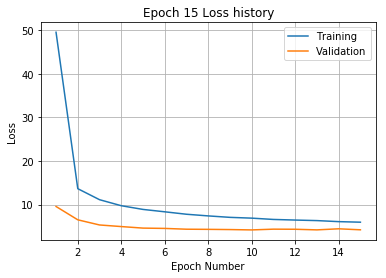

Validation error has stopped improving! Training on repetition 10 stopped!


In [5]:
# Initialization
train_loss_hist = np.zeros((len(log_interval_all),num_rep,num_epochs))
train_error_hist = np.zeros_like(train_loss_hist)
val_loss_hist = np.zeros_like(train_loss_hist)
val_error_hist = np.zeros_like(train_loss_hist)

Xy_var = [x_var, x2_var, y_var]

for i in range(len(log_interval_all)):
    
    print('log interval: ',log_interval_all[i],'seconds')
    log_interval = log_interval_all[i]

    # load and preprocess data
    data_folder = os.path.join(data_folder_parent,'log_interval_'+str(log_interval)+'s')
    [pv_log_trainval, images_trainval, pv_pred_trainval] = load_data(data_folder,'trainval')
    
    # put training data in the same list
    data_trainval = [images_trainval,pv_log_trainval,pv_pred_trainval]

    # Run training process
    save_path,training_history = run_training(num_rep, num_epochs, plotting, output_folder, model_name,"/gpu:0",
                                              Xy_var, is_training, loss_var, rel_err_var, train_step, data_trainval, 
                                              batch_size = batch_size, print_every = 20)

    # unpack the training history cache 
    [train_loss_hist[i],train_error_hist[i],val_loss_hist[i],val_error_hist[i]] = training_history
    
# Saving files
np.save(os.path.join(output_folder, "train_loss.npy"), train_loss_hist)
np.save(os.path.join(output_folder, "train_error.npy"), train_error_hist)
np.save(os.path.join(output_folder, "val_loss.npy"), val_loss_hist)
np.save(os.path.join(output_folder, "val_error.npy"), val_error_hist)


In [5]:
## Common utility for finding best performing model among the sensitivity analysis
def find_best_multiexp(output_folder):
    # Restore loss history
    train_loss = np.load(os.path.join(output_folder,"train_loss.npy"))
    val_loss = np.load(os.path.join(output_folder,"val_loss.npy"))
    
    val_best = np.zeros((val_loss.shape[0],val_loss.shape[1]))
    train_best = np.zeros_like(val_best)

    for i in range(val_loss.shape[0]):
        for j in range(val_loss.shape[1]):
            val_best[i,j] = np.amin(val_loss[i,j][val_loss[i,j]>0])
            best_idx = np.argmin(val_loss[i,j][val_loss[i,j]>0])
            train_best[i,j] = train_loss[i,j,best_idx]
            
    return train_best,val_best

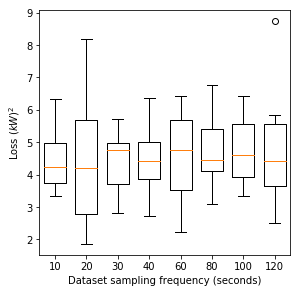

In [6]:
# Sensitivity plot on resolution
# Restore loss history
_, val_best = find_best_multiexp(output_folder)

plt.boxplot(val_best.T,labels = log_interval_all, widths= 0.7)
plt.xlabel('Log interval within each sample (seconds)')
plt.ylabel('Loss $(kW)^2$')
# plt.yscale('log')

# plt.ticklabel_format(axis='y', style='sci', scilimits=(-2,2))
plt.gcf().set_size_inches(4.5,4.5)
plt.savefig(os.path.join(output_folder,'val_loss_log_interval.png'),bbox_inches = 'tight')
plt.show()

# save the median validation loss into a txt file
np.savetxt(os.path.join(output_folder,'log_interval_mean_loss.txt'),np.mean(val_best,axis=1))

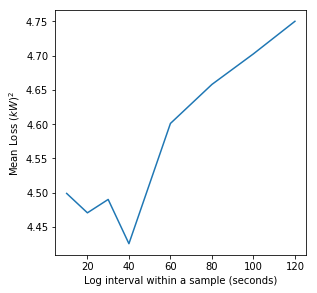

In [13]:
plt.plot(log_interval_all,np.mean(val_best,axis=1))
plt.xlabel('Log interval within a sample (seconds)')
plt.ylabel('Mean Loss $(kW)^2$')

import scipy.stats

confidence_interval = np.zeros((len(log_interval_all),2))

for i in range(len(log_interval_all)):
    confidence_interval[i] = scipy.stats.t.interval(0.75, len(val_best[i])-1, loc=np.mean(val_best[i]), scale=scipy.stats.sem(val_best[i]))

# plt.fill_between(log_interval_all,confidence_interval[:,0],confidence_interval[:,1], color = 'grey', alpha = 0.5)

plt.gcf().set_size_inches(4.5,4.5)
plt.savefig(os.path.join(output_folder,'val_loss_log_interval_mean.png'),bbox_inches = 'tight')
plt.show()